In [0]:
import matplotlib.pyplot as plt
import numpy as np
from keras.datasets import mnist
from sklearn.utils import shuffle
from sklearn.utils import shuffle
from keras.models import Model, Sequential
from keras.layers import Input, Dense, Reshape, Flatten, Dropout, Activation, BatchNormalization, LeakyReLU
from keras import optimizers
from sklearn.preprocessing import StandardScaler

In [0]:
(train_data, train_labels), (_, _) = mnist.load_data()

In [0]:
## normalization of the data
train_data = train_data / 127.5 - 1

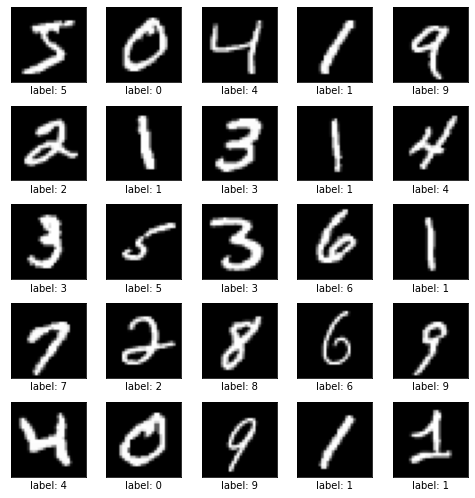

In [20]:
## plot 25 images
plt.figure(figsize=(7, 7))
for i in range(25):
  plt.subplot(5, 5, i + 1)
  plt.xticks([])
  plt.yticks([])
  plt.xlabel("label: " + str(train_labels[i]))
  plt.grid(False)
  plt.imshow(train_data[i], cmap='gray')
  plt.tight_layout(pad=1.0)
plt.show()

In [0]:
def create_generator():
  g = Sequential()
  g.add(Dense(units=256, input_dim=100))
  g.add(LeakyReLU(0.2))
  g.add(BatchNormalization(momentum=0.8))
  g.add(Dense(512))
  g.add(LeakyReLU(0.2))
  g.add(BatchNormalization(momentum=0.8))
  g.add(Dense(1024))
  g.add(LeakyReLU(0.2))
  g.add(BatchNormalization(momentum=0.8))
  g.add(Dense(784))
  g.add(Activation('tanh'))

  g.summary()

  return g

In [0]:
def create_discriminator():
  d = Sequential()

  d.add(Dense(units=512, input_dim=784))
  d.add(LeakyReLU(alpha=0.2))
  d.add(Dense(units=256))
  d.add(LeakyReLU(alpha=0.2))
  d.add(Dense(1, activation='sigmoid'))

  d.summary()
  return d

In [23]:
adm = optimizers.Adam(0.0002, 0.5)
discriminator = create_discriminator()
discriminator.compile(loss='binary_crossentropy', optimizer=adm, metrics=['accuracy'])
discriminator.trainable = False

generator = create_generator()
inpt = Input(shape=(100,))
img = generator (inpt)
out = discriminator (img)

gan = Model(inpt, out)
gan.compile(loss='binary_crossentropy', optimizer=adm)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, 512)               401920    
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 512)               0         
_________________________________________________________________
dense_9 (Dense)              (None, 256)               131328    
_________________________________________________________________
leaky_re_lu_7 (LeakyReLU)    (None, 256)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 257       
Total params: 533,505
Trainable params: 533,505
Non-trainable params: 0
_________________________________________________________________
Model: "sequential_4"
_________________________________________________________________
Layer (type)              

In [0]:
def plot_generated_img(nb, generator, batch_size, noise_size):
  '''
  plot the generated images
  nb: the current number of epoch
  generator: the generator part of the gan
  '''
  input_noise = np.random.normal(0, 1, (batch_size, noise_size))
  generated_images = generator.predict(input_noise)
  ## reshape the images: 784 -> 28x28
  generated_images = generated_images.reshape((generated_images.shape[0], 28, 28))
  plt.figure(figsize=(7, 7))
  nb_img = 25 if generated_images.shape[0] > 25 else generated_images.shape[0]
  for i in range(nb_img):
    plt.subplot(5, 5, i + 1)
    plt.imshow(generated_images[i], cmap='gray')
    plt.xticks([])
    plt.yticks([])
  plt.tight_layout()
  plt.show()

In [0]:
def get_random_img(image_train, batch_size):
  '''
  get a random set of images (with their associated label)
  image_train: image vector
  batch_size: number of image to get
  '''
  rd_imgs = image_train[np.random.randint(0, train_data.shape[0], size=batch_size)]
  return rd_imgs

In [0]:
### training parameters
epochs = 10000
batch_size = 16
noise_size = 100

Epochs nb. 1
discriminator loss: 0.6286675333976746
generator loss : 1.012574553489685

Epochs nb. 2
discriminator loss: 0.5001158118247986
generator loss : 0.9503288269042969

Epochs nb. 3
discriminator loss: 0.5442726016044617
generator loss : 0.8905714154243469

Epochs nb. 4
discriminator loss: 0.8189995288848877
generator loss : 0.9370157718658447

Epochs nb. 5
discriminator loss: 0.5659303069114685
generator loss : 0.8656629323959351

Epochs nb. 6
discriminator loss: 0.6507503390312195
generator loss : 0.88584303855896

Epochs nb. 7
discriminator loss: 0.5208251476287842
generator loss : 0.8529515266418457

Epochs nb. 8
discriminator loss: 0.5928890109062195
generator loss : 0.9663116931915283

Epochs nb. 9
discriminator loss: 0.5220475196838379
generator loss : 0.8623045682907104

Epochs nb. 10
discriminator loss: 0.6278347969055176
generator loss : 0.9833464026451111



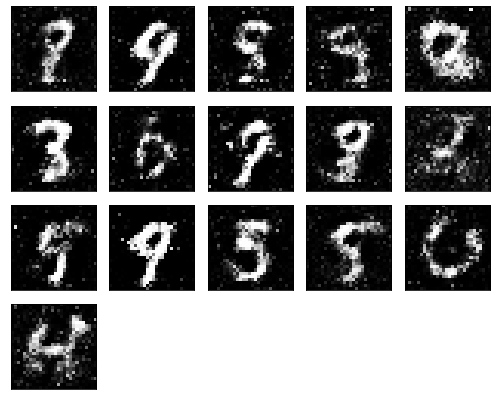

Epochs nb. 11
discriminator loss: 0.7025785446166992
generator loss : 0.9566760063171387

Epochs nb. 12
discriminator loss: 0.608731746673584
generator loss : 0.879040002822876

Epochs nb. 13
discriminator loss: 0.5664421319961548
generator loss : 0.8837854266166687

Epochs nb. 14
discriminator loss: 0.6227487921714783
generator loss : 0.9500078558921814

Epochs nb. 15
discriminator loss: 0.5527274012565613
generator loss : 1.0369478464126587

Epochs nb. 16
discriminator loss: 0.671815037727356
generator loss : 0.9572719931602478

Epochs nb. 17
discriminator loss: 0.6094358563423157
generator loss : 0.7893835306167603

Epochs nb. 18
discriminator loss: 0.5871337652206421
generator loss : 0.9038350582122803

Epochs nb. 19
discriminator loss: 0.7182084918022156
generator loss : 0.9994451999664307

Epochs nb. 20
discriminator loss: 0.5210554599761963
generator loss : 1.0087223052978516



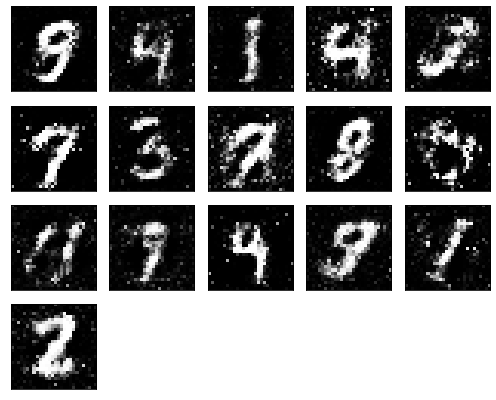

Epochs nb. 21
discriminator loss: 0.514951229095459
generator loss : 0.971080482006073

Epochs nb. 22
discriminator loss: 0.7041647434234619
generator loss : 0.9056209325790405

Epochs nb. 23
discriminator loss: 0.5957764387130737
generator loss : 0.8705626726150513

Epochs nb. 24
discriminator loss: 0.7726356983184814
generator loss : 0.9002452492713928

Epochs nb. 25
discriminator loss: 0.5467029809951782
generator loss : 0.8547444343566895

Epochs nb. 26
discriminator loss: 0.5409529805183411
generator loss : 0.9298982620239258

Epochs nb. 27
discriminator loss: 0.5329029560089111
generator loss : 0.935589611530304

Epochs nb. 28
discriminator loss: 0.6587441563606262
generator loss : 0.978522777557373

Epochs nb. 29
discriminator loss: 0.6488933563232422
generator loss : 0.9961909055709839

Epochs nb. 30
discriminator loss: 0.574618399143219
generator loss : 0.9799537062644958



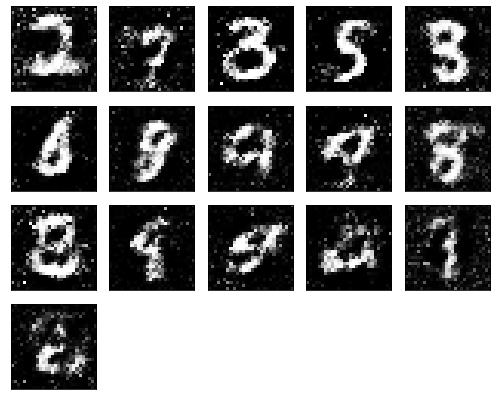

Epochs nb. 31
discriminator loss: 0.5410477519035339
generator loss : 1.0054649114608765

Epochs nb. 32
discriminator loss: 0.606781542301178
generator loss : 1.0433454513549805

Epochs nb. 33
discriminator loss: 0.6008152961730957
generator loss : 0.9838675856590271

Epochs nb. 34
discriminator loss: 0.5315037965774536
generator loss : 1.0046424865722656

Epochs nb. 35
discriminator loss: 0.5761687755584717
generator loss : 0.9767684936523438

Epochs nb. 36
discriminator loss: 0.5727956891059875
generator loss : 0.9241915941238403

Epochs nb. 37
discriminator loss: 0.7368571758270264
generator loss : 0.9197369813919067

Epochs nb. 38
discriminator loss: 0.6653710603713989
generator loss : 0.93963623046875

Epochs nb. 39
discriminator loss: 0.5370962619781494
generator loss : 0.877819299697876

Epochs nb. 40
discriminator loss: 0.5367090702056885
generator loss : 0.890958309173584



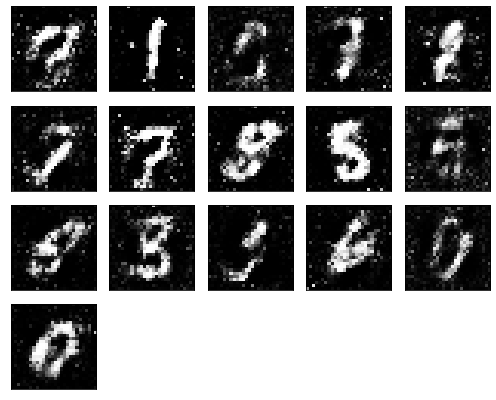

Epochs nb. 41
discriminator loss: 0.602584183216095
generator loss : 0.7795516848564148

Epochs nb. 42
discriminator loss: 0.65708327293396
generator loss : 0.8346446752548218

Epochs nb. 43
discriminator loss: 0.6262372732162476
generator loss : 0.9686763286590576

Epochs nb. 44
discriminator loss: 0.7065879106521606
generator loss : 1.0065475702285767

Epochs nb. 45
discriminator loss: 0.6175882816314697
generator loss : 0.8815540075302124

Epochs nb. 46
discriminator loss: 0.5999403595924377
generator loss : 0.7984462380409241

Epochs nb. 47
discriminator loss: 0.583193302154541
generator loss : 0.8636468052864075

Epochs nb. 48
discriminator loss: 0.5813617706298828
generator loss : 0.8661870956420898

Epochs nb. 49
discriminator loss: 0.5591341257095337
generator loss : 1.014807939529419

Epochs nb. 50
discriminator loss: 0.5747995376586914
generator loss : 0.8868129253387451



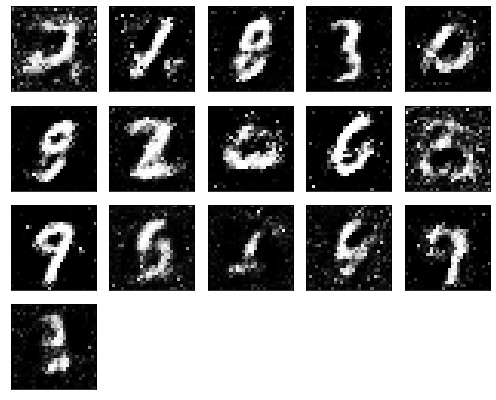

Epochs nb. 51
discriminator loss: 0.5955660343170166
generator loss : 0.8933765888214111

Epochs nb. 52
discriminator loss: 0.7408291101455688
generator loss : 0.8931528329849243

Epochs nb. 53
discriminator loss: 0.6993675231933594
generator loss : 0.8340611457824707

Epochs nb. 54
discriminator loss: 0.6116771697998047
generator loss : 0.8533489108085632

Epochs nb. 55
discriminator loss: 0.6360974311828613
generator loss : 0.9424871206283569

Epochs nb. 56
discriminator loss: 0.5777029991149902
generator loss : 0.9408242702484131

Epochs nb. 57
discriminator loss: 0.6718098521232605
generator loss : 0.987985372543335

Epochs nb. 58
discriminator loss: 0.7038049697875977
generator loss : 0.8274350762367249

Epochs nb. 59
discriminator loss: 0.6409047842025757
generator loss : 0.9909870624542236

Epochs nb. 60
discriminator loss: 0.5609865188598633
generator loss : 0.9067485332489014



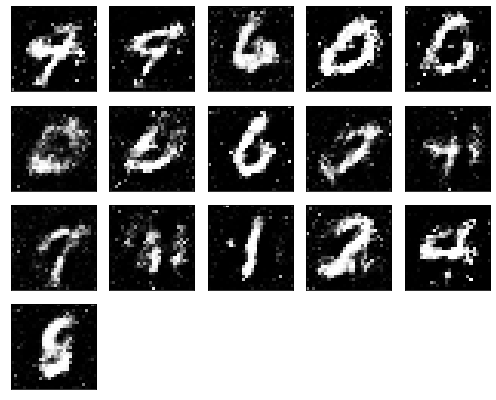

Epochs nb. 61
discriminator loss: 0.592191219329834
generator loss : 1.0037875175476074

Epochs nb. 62
discriminator loss: 0.580284595489502
generator loss : 0.7742269039154053

Epochs nb. 63
discriminator loss: 0.6255144476890564
generator loss : 0.8865460157394409

Epochs nb. 64
discriminator loss: 0.6274628639221191
generator loss : 0.9147993326187134

Epochs nb. 65
discriminator loss: 0.618039608001709
generator loss : 0.8688489198684692

Epochs nb. 66
discriminator loss: 0.6741980910301208
generator loss : 0.8682687878608704

Epochs nb. 67
discriminator loss: 0.5467706918716431
generator loss : 0.8453227877616882

Epochs nb. 68
discriminator loss: 0.5929058790206909
generator loss : 0.9111343622207642

Epochs nb. 69
discriminator loss: 0.5401290059089661
generator loss : 0.8960814476013184

Epochs nb. 70
discriminator loss: 0.628879725933075
generator loss : 0.9317965507507324



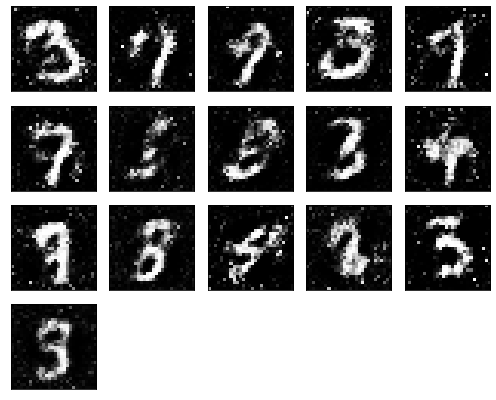

Epochs nb. 71
discriminator loss: 0.5288079977035522
generator loss : 0.9563351273536682

Epochs nb. 72
discriminator loss: 0.5485796928405762
generator loss : 0.8860074877738953

Epochs nb. 73
discriminator loss: 0.6654573082923889
generator loss : 0.8357850313186646

Epochs nb. 74
discriminator loss: 0.6081266403198242
generator loss : 0.9011217355728149

Epochs nb. 75
discriminator loss: 0.5575822591781616
generator loss : 0.7641706466674805

Epochs nb. 76
discriminator loss: 0.604905366897583
generator loss : 0.9141745567321777

Epochs nb. 77
discriminator loss: 0.8092806339263916
generator loss : 0.8716944456100464

Epochs nb. 78
discriminator loss: 0.51121985912323
generator loss : 0.9013177156448364

Epochs nb. 79
discriminator loss: 0.5592164993286133
generator loss : 0.8376079797744751

Epochs nb. 80
discriminator loss: 0.6090258955955505
generator loss : 0.9141464233398438



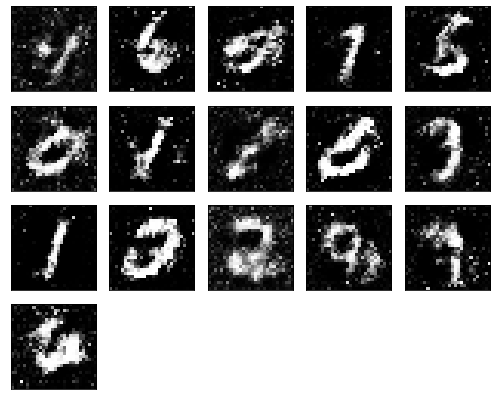

Epochs nb. 81
discriminator loss: 0.6667218208312988
generator loss : 0.8723146319389343

Epochs nb. 82
discriminator loss: 0.5086621046066284
generator loss : 0.8225963115692139

Epochs nb. 83
discriminator loss: 0.5349761247634888
generator loss : 0.9792406558990479

Epochs nb. 84
discriminator loss: 0.6531755924224854
generator loss : 1.0414986610412598

Epochs nb. 85
discriminator loss: 0.6276563405990601
generator loss : 0.9344761371612549

Epochs nb. 86
discriminator loss: 0.4908607304096222
generator loss : 1.0261025428771973

Epochs nb. 87
discriminator loss: 0.7156758308410645
generator loss : 0.9367308616638184

Epochs nb. 88
discriminator loss: 0.5240501761436462
generator loss : 1.0032386779785156

Epochs nb. 89
discriminator loss: 0.5928033590316772
generator loss : 0.9330594539642334

Epochs nb. 90
discriminator loss: 0.5851187705993652
generator loss : 0.942506730556488



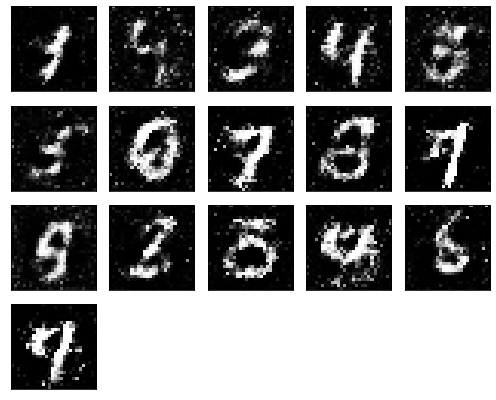

Epochs nb. 91
discriminator loss: 0.6547425985336304
generator loss : 0.8170350790023804

Epochs nb. 92
discriminator loss: 0.5191154479980469
generator loss : 0.8589751124382019

Epochs nb. 93
discriminator loss: 0.6264041662216187
generator loss : 0.9307882785797119

Epochs nb. 94
discriminator loss: 0.5366722345352173
generator loss : 0.8845416903495789

Epochs nb. 95
discriminator loss: 0.5516098737716675
generator loss : 0.9515664577484131

Epochs nb. 96
discriminator loss: 0.6111897230148315
generator loss : 1.0868959426879883

Epochs nb. 97
discriminator loss: 0.5802839398384094
generator loss : 0.9009969234466553

Epochs nb. 98
discriminator loss: 0.7051652669906616
generator loss : 1.0080626010894775

Epochs nb. 99
discriminator loss: 0.6655622720718384
generator loss : 0.9587955474853516

Epochs nb. 100
discriminator loss: 0.5541409254074097
generator loss : 0.857370138168335



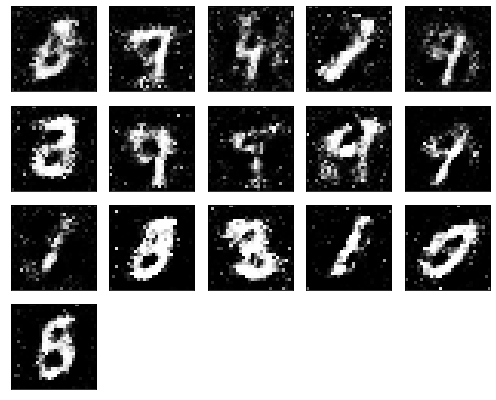

Epochs nb. 101
discriminator loss: 0.5741769075393677
generator loss : 1.0571379661560059

Epochs nb. 102
discriminator loss: 0.5355439782142639
generator loss : 0.9502501487731934

Epochs nb. 103
discriminator loss: 0.5765957832336426
generator loss : 0.9046175479888916

Epochs nb. 104
discriminator loss: 0.553536057472229
generator loss : 0.9631096124649048

Epochs nb. 105
discriminator loss: 0.6092127561569214
generator loss : 0.9195113182067871

Epochs nb. 106
discriminator loss: 0.6502842903137207
generator loss : 0.971243143081665

Epochs nb. 107
discriminator loss: 0.6539851427078247
generator loss : 0.8491010665893555

Epochs nb. 108
discriminator loss: 0.47333866357803345
generator loss : 0.9577959775924683

Epochs nb. 109
discriminator loss: 0.6449793577194214
generator loss : 1.0364197492599487

Epochs nb. 110
discriminator loss: 0.6078358292579651
generator loss : 1.0282375812530518



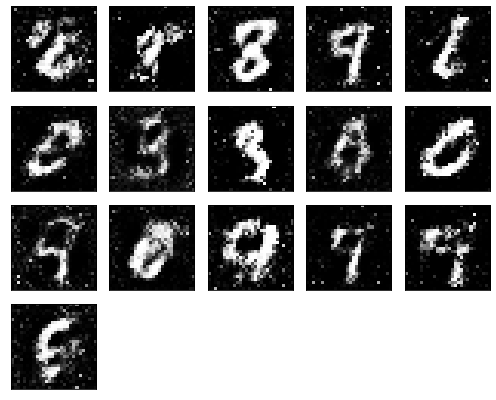

Epochs nb. 111
discriminator loss: 0.5422103404998779
generator loss : 0.9153962135314941

Epochs nb. 112
discriminator loss: 0.5762276649475098
generator loss : 0.9956932067871094

Epochs nb. 113
discriminator loss: 0.6213182210922241
generator loss : 0.8857046365737915

Epochs nb. 114
discriminator loss: 0.5040558576583862
generator loss : 0.8939234018325806

Epochs nb. 115
discriminator loss: 0.6184658408164978
generator loss : 1.0059846639633179

Epochs nb. 116
discriminator loss: 0.6360816359519958
generator loss : 0.8833904266357422

Epochs nb. 117
discriminator loss: 0.5600982904434204
generator loss : 0.9354996681213379

Epochs nb. 118
discriminator loss: 0.5843148827552795
generator loss : 0.7861893177032471

Epochs nb. 119
discriminator loss: 0.5564492344856262
generator loss : 0.7999763488769531

Epochs nb. 120
discriminator loss: 0.6422375440597534
generator loss : 0.9275182485580444



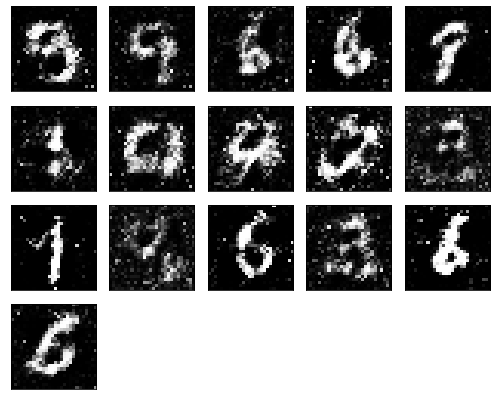

Epochs nb. 121
discriminator loss: 0.720937192440033
generator loss : 0.8920162320137024

Epochs nb. 122
discriminator loss: 0.6027658581733704
generator loss : 0.9340063333511353

Epochs nb. 123
discriminator loss: 0.530963659286499
generator loss : 0.7588223218917847

Epochs nb. 124
discriminator loss: 0.5929225087165833
generator loss : 0.858324408531189

Epochs nb. 125
discriminator loss: 0.5140993595123291
generator loss : 0.9280281662940979

Epochs nb. 126
discriminator loss: 0.5964548587799072
generator loss : 0.9615591168403625

Epochs nb. 127
discriminator loss: 0.5738852620124817
generator loss : 0.8383077383041382

Epochs nb. 128
discriminator loss: 0.5737205743789673
generator loss : 0.9512893557548523

Epochs nb. 129
discriminator loss: 0.6627013683319092
generator loss : 0.8903251886367798

Epochs nb. 130
discriminator loss: 0.5699164271354675
generator loss : 0.9323514103889465



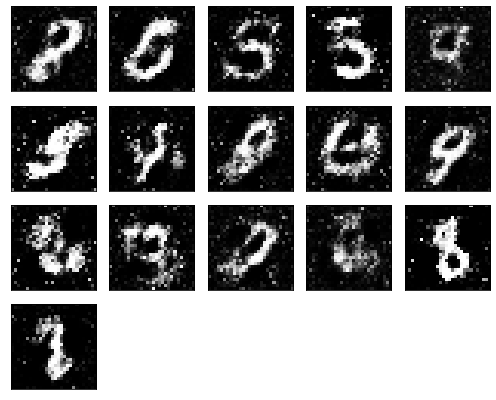

Epochs nb. 131
discriminator loss: 0.6120873689651489
generator loss : 0.9835424423217773

Epochs nb. 132
discriminator loss: 0.6461473703384399
generator loss : 0.898076057434082

Epochs nb. 133
discriminator loss: 0.5636730790138245
generator loss : 0.9062490463256836

Epochs nb. 134
discriminator loss: 0.5770407915115356
generator loss : 1.020472764968872

Epochs nb. 135
discriminator loss: 0.580341100692749
generator loss : 0.8949674367904663

Epochs nb. 136
discriminator loss: 0.573993444442749
generator loss : 0.6923781037330627

Epochs nb. 137
discriminator loss: 0.5951803922653198
generator loss : 0.7704507112503052

Epochs nb. 138
discriminator loss: 0.7009539604187012
generator loss : 0.7872509956359863

Epochs nb. 139
discriminator loss: 0.5733972787857056
generator loss : 0.8667191863059998

Epochs nb. 140
discriminator loss: 0.5777302980422974
generator loss : 0.8989248275756836



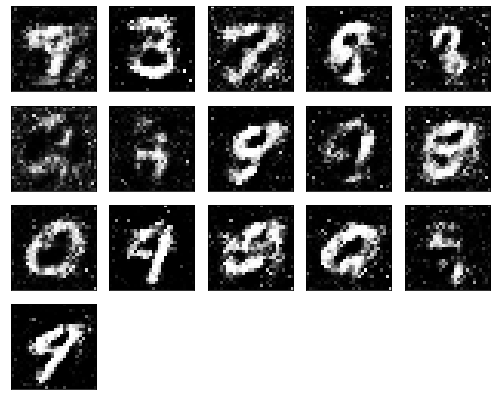

Epochs nb. 141
discriminator loss: 0.6799665689468384
generator loss : 0.8105251789093018

Epochs nb. 142
discriminator loss: 0.58084636926651
generator loss : 0.8209879398345947

Epochs nb. 143
discriminator loss: 0.6730480194091797
generator loss : 0.9205703735351562

Epochs nb. 144
discriminator loss: 0.6063488721847534
generator loss : 0.9318280816078186

Epochs nb. 145
discriminator loss: 0.5138837099075317
generator loss : 0.9164542555809021

Epochs nb. 146
discriminator loss: 0.742530345916748
generator loss : 0.8756285309791565

Epochs nb. 147
discriminator loss: 0.5434931516647339
generator loss : 0.9101541042327881

Epochs nb. 148
discriminator loss: 0.59343421459198
generator loss : 0.8359371423721313

Epochs nb. 149
discriminator loss: 0.5807338953018188
generator loss : 0.7861372232437134

Epochs nb. 150
discriminator loss: 0.5574377775192261
generator loss : 0.8183674812316895



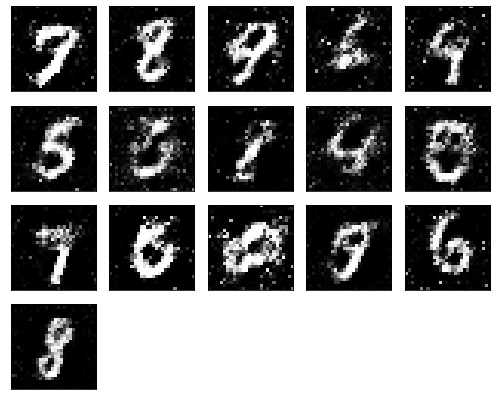

Epochs nb. 151
discriminator loss: 0.6442039608955383
generator loss : 0.8029822111129761

Epochs nb. 152
discriminator loss: 0.5181418061256409
generator loss : 0.8083603978157043

Epochs nb. 153
discriminator loss: 0.6553143858909607
generator loss : 0.8724427223205566

Epochs nb. 154
discriminator loss: 0.7009258270263672
generator loss : 0.8940250873565674

Epochs nb. 155
discriminator loss: 0.6989721059799194
generator loss : 0.938290536403656

Epochs nb. 156
discriminator loss: 0.6248981952667236
generator loss : 0.954827606678009

Epochs nb. 157
discriminator loss: 0.49843716621398926
generator loss : 0.9179125428199768

Epochs nb. 158
discriminator loss: 0.6414014101028442
generator loss : 0.8564001321792603

Epochs nb. 159
discriminator loss: 0.5232394933700562
generator loss : 0.8840574026107788

Epochs nb. 160
discriminator loss: 0.5577818155288696
generator loss : 0.8867776989936829



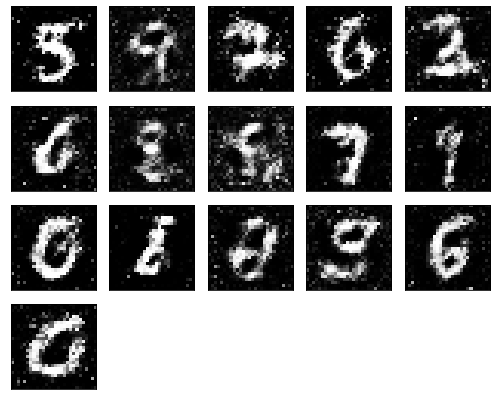

Epochs nb. 161
discriminator loss: 0.6048867702484131
generator loss : 0.7595311999320984

Epochs nb. 162
discriminator loss: 0.5521904230117798
generator loss : 0.8638692498207092

Epochs nb. 163
discriminator loss: 0.5950919389724731
generator loss : 0.7479715943336487

Epochs nb. 164
discriminator loss: 0.5408869385719299
generator loss : 1.0011491775512695

Epochs nb. 165
discriminator loss: 0.6018304824829102
generator loss : 0.8280385732650757

Epochs nb. 166
discriminator loss: 0.5876179933547974
generator loss : 0.898790717124939

Epochs nb. 167
discriminator loss: 0.6394507884979248
generator loss : 1.1256029605865479

Epochs nb. 168
discriminator loss: 0.6449099183082581
generator loss : 0.8975292444229126

Epochs nb. 169
discriminator loss: 0.5387072563171387
generator loss : 1.0211641788482666

Epochs nb. 170
discriminator loss: 0.632552444934845
generator loss : 1.0188372135162354



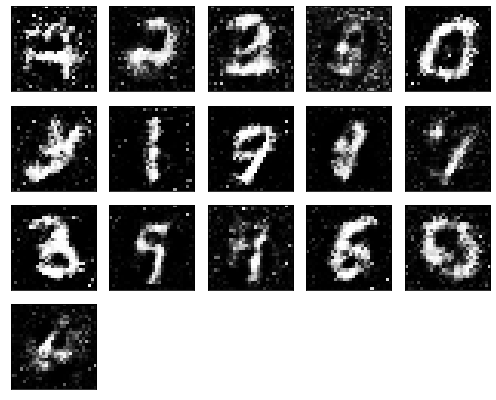

Epochs nb. 171
discriminator loss: 0.7144906520843506
generator loss : 0.878921389579773

Epochs nb. 172
discriminator loss: 0.5789315700531006
generator loss : 0.9939743280410767

Epochs nb. 173
discriminator loss: 0.6616575717926025
generator loss : 0.9207747578620911

Epochs nb. 174
discriminator loss: 0.6070660352706909
generator loss : 0.9206699132919312

Epochs nb. 175
discriminator loss: 0.5911287069320679
generator loss : 0.7734753489494324

Epochs nb. 176
discriminator loss: 0.5517430901527405
generator loss : 0.9700663089752197

Epochs nb. 177
discriminator loss: 0.56606125831604
generator loss : 0.9626525640487671

Epochs nb. 178
discriminator loss: 0.575118362903595
generator loss : 0.9343129396438599

Epochs nb. 179
discriminator loss: 0.6942945718765259
generator loss : 0.8184821605682373

Epochs nb. 180
discriminator loss: 0.6734379529953003
generator loss : 0.991466224193573



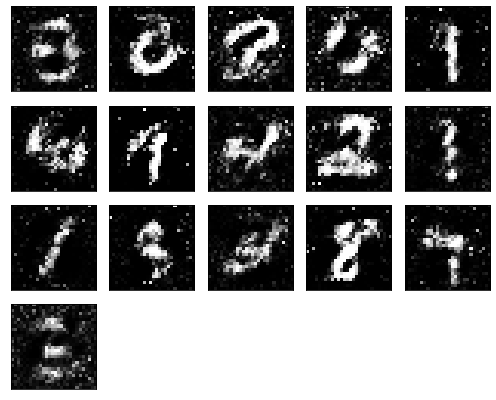

Epochs nb. 181
discriminator loss: 0.6434758901596069
generator loss : 0.9716092348098755

Epochs nb. 182
discriminator loss: 0.5803169012069702
generator loss : 0.9171743392944336

Epochs nb. 183
discriminator loss: 0.5340118408203125
generator loss : 0.9952534437179565

Epochs nb. 184
discriminator loss: 0.442413330078125
generator loss : 0.8895723819732666

Epochs nb. 185
discriminator loss: 0.6850016117095947
generator loss : 1.0294015407562256

Epochs nb. 186
discriminator loss: 0.6749564409255981
generator loss : 0.917105495929718

Epochs nb. 187
discriminator loss: 0.5948954820632935
generator loss : 0.9045076966285706

Epochs nb. 188
discriminator loss: 0.5843871235847473
generator loss : 0.8055511713027954

Epochs nb. 189
discriminator loss: 0.5602962374687195
generator loss : 0.7872049808502197

Epochs nb. 190
discriminator loss: 0.5485989451408386
generator loss : 0.8997223377227783



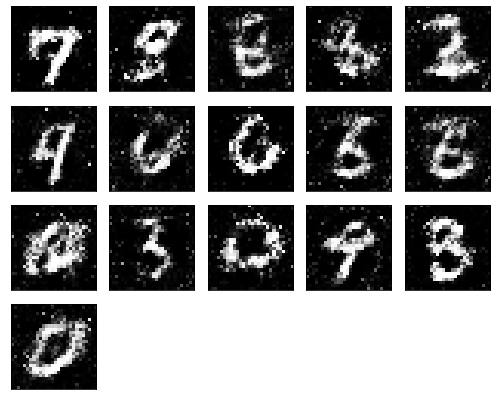

Epochs nb. 191
discriminator loss: 0.6265825033187866
generator loss : 0.8953275084495544

Epochs nb. 192
discriminator loss: 0.624873161315918
generator loss : 1.0006195306777954

Epochs nb. 193
discriminator loss: 0.6700418591499329
generator loss : 0.8649747371673584

Epochs nb. 194
discriminator loss: 0.6169818639755249
generator loss : 0.9475188255310059

Epochs nb. 195
discriminator loss: 0.6340503096580505
generator loss : 1.0559628009796143

Epochs nb. 196
discriminator loss: 0.6320801973342896
generator loss : 0.9864919185638428

Epochs nb. 197
discriminator loss: 0.6519498229026794
generator loss : 1.0240650177001953

Epochs nb. 198
discriminator loss: 0.559288501739502
generator loss : 0.9934263825416565

Epochs nb. 199
discriminator loss: 0.5414107441902161
generator loss : 0.8977847099304199

Epochs nb. 200
discriminator loss: 0.6247141361236572
generator loss : 0.794788122177124



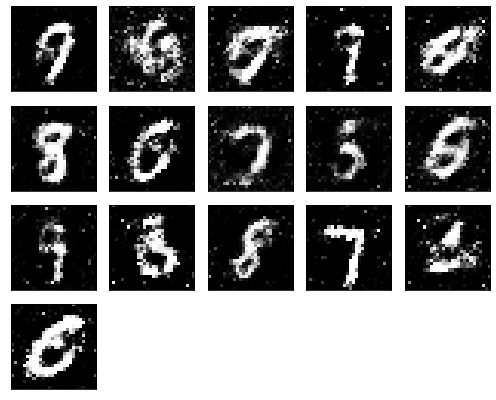

Epochs nb. 201
discriminator loss: 0.6062742471694946
generator loss : 0.7204810976982117

Epochs nb. 202
discriminator loss: 0.5474280118942261
generator loss : 0.8987112045288086

Epochs nb. 203
discriminator loss: 0.5787632465362549
generator loss : 1.0008691549301147

Epochs nb. 204
discriminator loss: 0.49898236989974976
generator loss : 0.9515138864517212

Epochs nb. 205
discriminator loss: 0.7432299852371216
generator loss : 0.9855239391326904

Epochs nb. 206
discriminator loss: 0.5973411798477173
generator loss : 0.7978075742721558

Epochs nb. 207
discriminator loss: 0.4620353877544403
generator loss : 1.0173661708831787

Epochs nb. 208
discriminator loss: 0.5933481454849243
generator loss : 0.9514905214309692

Epochs nb. 209
discriminator loss: 0.5173829793930054
generator loss : 0.8581012487411499

Epochs nb. 210
discriminator loss: 0.5487503409385681
generator loss : 0.9574284553527832



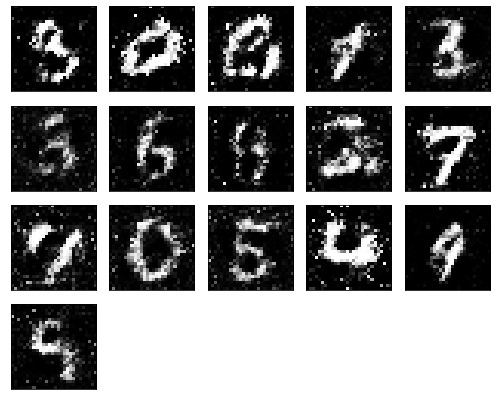

Epochs nb. 211
discriminator loss: 0.5831800699234009
generator loss : 0.7959386706352234

Epochs nb. 212
discriminator loss: 0.7152215242385864
generator loss : 0.8866270184516907

Epochs nb. 213
discriminator loss: 0.6958713531494141
generator loss : 0.9841196537017822

Epochs nb. 214
discriminator loss: 0.48009422421455383
generator loss : 0.8394996523857117

Epochs nb. 215
discriminator loss: 0.6753101348876953
generator loss : 0.9764947295188904

Epochs nb. 216
discriminator loss: 0.5704584717750549
generator loss : 0.7875409722328186

Epochs nb. 217
discriminator loss: 0.5457175970077515
generator loss : 0.8386737108230591

Epochs nb. 218
discriminator loss: 0.6713439226150513
generator loss : 0.8013885617256165

Epochs nb. 219
discriminator loss: 0.5542555451393127
generator loss : 0.921929121017456

Epochs nb. 220
discriminator loss: 0.7027649879455566
generator loss : 0.9282240867614746



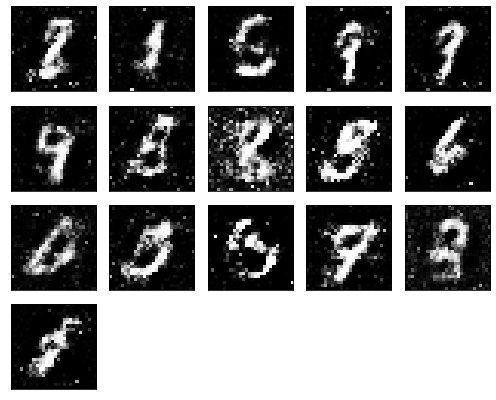

Epochs nb. 221
discriminator loss: 0.5385054349899292
generator loss : 0.90614253282547

Epochs nb. 222
discriminator loss: 0.5715563297271729
generator loss : 0.9344555139541626

Epochs nb. 223
discriminator loss: 0.5580599904060364
generator loss : 1.0021772384643555

Epochs nb. 224
discriminator loss: 0.5804240703582764
generator loss : 0.8850849866867065

Epochs nb. 225
discriminator loss: 0.6460220813751221
generator loss : 0.937062680721283

Epochs nb. 226
discriminator loss: 0.4613794684410095
generator loss : 0.9762630462646484

Epochs nb. 227
discriminator loss: 0.7192672491073608
generator loss : 0.973343014717102

Epochs nb. 228
discriminator loss: 0.6456127166748047
generator loss : 1.0568538904190063

Epochs nb. 229
discriminator loss: 0.5634053945541382
generator loss : 1.0050389766693115

Epochs nb. 230
discriminator loss: 0.6221262216567993
generator loss : 0.9984249472618103



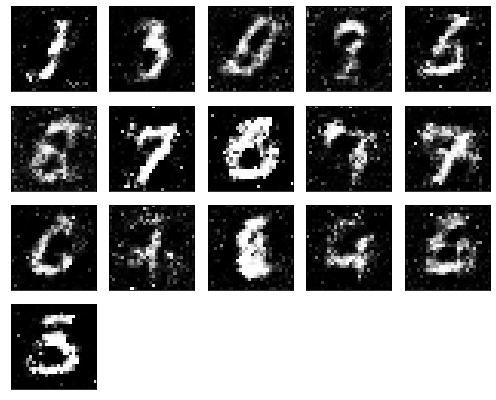

Epochs nb. 231
discriminator loss: 0.571823239326477
generator loss : 0.9423286318778992

Epochs nb. 232
discriminator loss: 0.5677238702774048
generator loss : 0.8733501434326172

Epochs nb. 233
discriminator loss: 0.5454552173614502
generator loss : 0.9649094343185425

Epochs nb. 234
discriminator loss: 0.49264222383499146
generator loss : 0.9577091932296753

Epochs nb. 235
discriminator loss: 0.5985244512557983
generator loss : 0.8782246112823486

Epochs nb. 236
discriminator loss: 0.7805140018463135
generator loss : 0.870926558971405

Epochs nb. 237
discriminator loss: 0.5989472270011902
generator loss : 0.9366403222084045

Epochs nb. 238
discriminator loss: 0.6322886347770691
generator loss : 0.9871306419372559

Epochs nb. 239
discriminator loss: 0.6906490325927734
generator loss : 1.0563058853149414

Epochs nb. 240
discriminator loss: 0.6228572726249695
generator loss : 0.9254917502403259



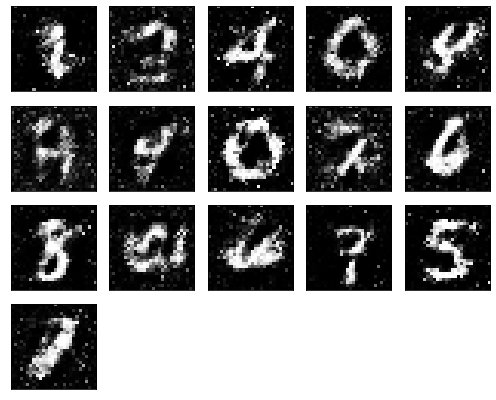

Epochs nb. 241
discriminator loss: 0.6259329915046692
generator loss : 0.9807995557785034

Epochs nb. 242
discriminator loss: 0.4743335247039795
generator loss : 0.9958983063697815

Epochs nb. 243
discriminator loss: 0.6557050347328186
generator loss : 0.9218131303787231

Epochs nb. 244
discriminator loss: 0.5779403448104858
generator loss : 0.9248239398002625

Epochs nb. 245
discriminator loss: 0.6284592747688293
generator loss : 1.0053592920303345

Epochs nb. 246
discriminator loss: 0.5570132732391357
generator loss : 0.9110677242279053

Epochs nb. 247
discriminator loss: 0.47239357233047485
generator loss : 0.8919227719306946

Epochs nb. 248
discriminator loss: 0.5746379494667053
generator loss : 0.9148129224777222

Epochs nb. 249
discriminator loss: 0.5676084756851196
generator loss : 0.878075361251831

Epochs nb. 250
discriminator loss: 0.6067694425582886
generator loss : 0.9468335509300232



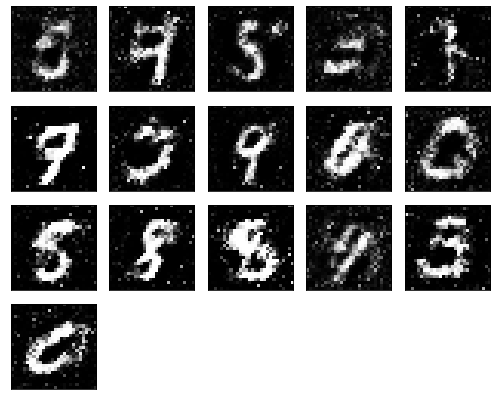

Epochs nb. 251
discriminator loss: 0.57049959897995
generator loss : 0.9373492002487183

Epochs nb. 252
discriminator loss: 0.5505039691925049
generator loss : 0.9091914892196655

Epochs nb. 253
discriminator loss: 0.5677151679992676
generator loss : 0.9686126708984375

Epochs nb. 254
discriminator loss: 0.6557621955871582
generator loss : 0.9039149284362793

Epochs nb. 255
discriminator loss: 0.6426891684532166
generator loss : 1.0471280813217163

Epochs nb. 256
discriminator loss: 0.4820423722267151
generator loss : 0.856015682220459

Epochs nb. 257
discriminator loss: 0.5108517408370972
generator loss : 0.8808175325393677

Epochs nb. 258
discriminator loss: 0.5891333222389221
generator loss : 0.7620456218719482

Epochs nb. 259
discriminator loss: 0.5702933073043823
generator loss : 0.8478198051452637

Epochs nb. 260
discriminator loss: 0.4878464937210083
generator loss : 0.9253944158554077



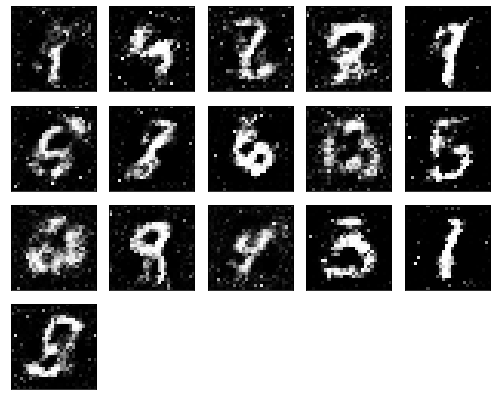

Epochs nb. 261
discriminator loss: 0.5438505411148071
generator loss : 0.986351490020752

Epochs nb. 262
discriminator loss: 0.5545514822006226
generator loss : 0.8249911069869995

Epochs nb. 263
discriminator loss: 0.6313924789428711
generator loss : 1.094205617904663

Epochs nb. 264
discriminator loss: 0.513477087020874
generator loss : 1.1172698736190796

Epochs nb. 265
discriminator loss: 0.5384812355041504
generator loss : 0.9184703826904297

Epochs nb. 266
discriminator loss: 0.5700294375419617
generator loss : 0.9515296816825867

Epochs nb. 267
discriminator loss: 0.7167481184005737
generator loss : 0.964611828327179

Epochs nb. 268
discriminator loss: 0.7776150107383728
generator loss : 0.8030655384063721

Epochs nb. 269
discriminator loss: 0.505222499370575
generator loss : 0.8201581239700317

Epochs nb. 270
discriminator loss: 0.6764092445373535
generator loss : 1.0211697816848755



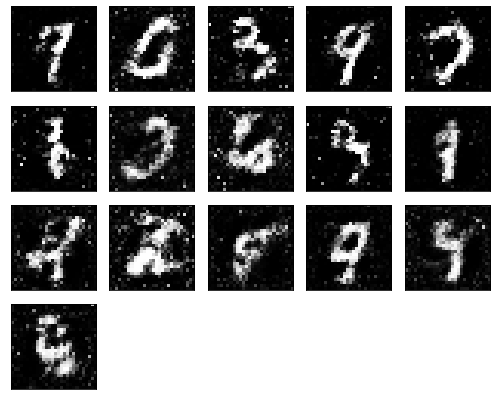

Epochs nb. 271
discriminator loss: 0.5858393907546997
generator loss : 1.046655535697937

Epochs nb. 272
discriminator loss: 0.4948791563510895
generator loss : 0.8859825134277344

Epochs nb. 273
discriminator loss: 0.5564688444137573
generator loss : 0.8870570659637451

Epochs nb. 274
discriminator loss: 0.6644147634506226
generator loss : 0.9421989917755127

Epochs nb. 275
discriminator loss: 0.4801340103149414
generator loss : 0.9021077752113342

Epochs nb. 276
discriminator loss: 0.6013233661651611
generator loss : 0.8455822467803955

Epochs nb. 277
discriminator loss: 0.5987300872802734
generator loss : 1.0018306970596313

Epochs nb. 278
discriminator loss: 0.4971389174461365
generator loss : 1.0203858613967896

Epochs nb. 279
discriminator loss: 0.5414697527885437
generator loss : 1.0003914833068848

Epochs nb. 280
discriminator loss: 0.5616624355316162
generator loss : 0.8924896121025085



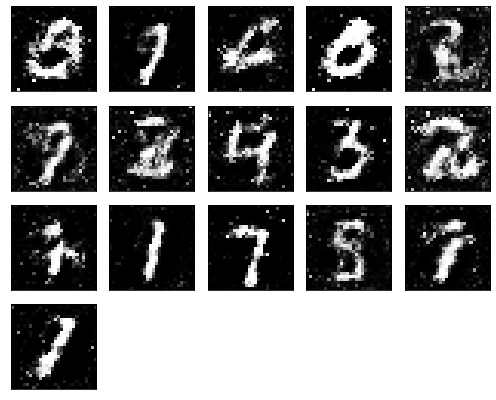

Epochs nb. 281
discriminator loss: 0.5613170862197876
generator loss : 0.8870952129364014

Epochs nb. 282
discriminator loss: 0.5350102782249451
generator loss : 0.9837666749954224

Epochs nb. 283
discriminator loss: 0.6166666150093079
generator loss : 0.9723751544952393

Epochs nb. 284
discriminator loss: 0.508177638053894
generator loss : 0.827111005783081

Epochs nb. 285
discriminator loss: 0.7211467027664185
generator loss : 0.8452578186988831

Epochs nb. 286
discriminator loss: 0.6341629028320312
generator loss : 0.8963606357574463

Epochs nb. 287
discriminator loss: 0.507855236530304
generator loss : 1.0143239498138428

Epochs nb. 288
discriminator loss: 0.5346813797950745
generator loss : 0.9187046885490417

Epochs nb. 289
discriminator loss: 0.6366190910339355
generator loss : 0.9817509055137634

Epochs nb. 290
discriminator loss: 0.7049872875213623
generator loss : 1.0080311298370361



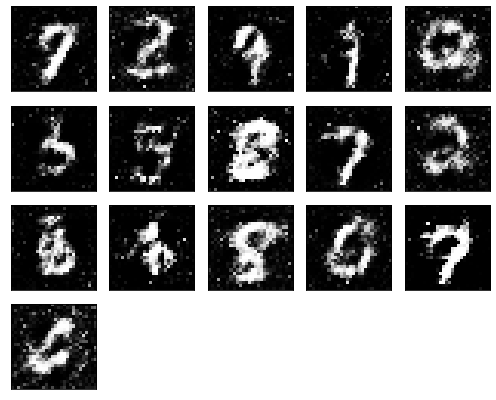

Epochs nb. 291
discriminator loss: 0.6218535304069519
generator loss : 1.0768094062805176

Epochs nb. 292
discriminator loss: 0.5565769672393799
generator loss : 0.941766619682312

Epochs nb. 293
discriminator loss: 0.6050150394439697
generator loss : 0.8778221011161804

Epochs nb. 294
discriminator loss: 0.48910588026046753
generator loss : 0.8314374089241028

Epochs nb. 295
discriminator loss: 0.5985138416290283
generator loss : 1.0007514953613281

Epochs nb. 296
discriminator loss: 0.6119874715805054
generator loss : 1.0564930438995361

Epochs nb. 297
discriminator loss: 0.6314011216163635
generator loss : 1.0054006576538086

Epochs nb. 298
discriminator loss: 0.5564374923706055
generator loss : 0.8829752802848816

Epochs nb. 299
discriminator loss: 0.5425166487693787
generator loss : 0.9880881905555725

Epochs nb. 300
discriminator loss: 0.6774505972862244
generator loss : 0.814380407333374



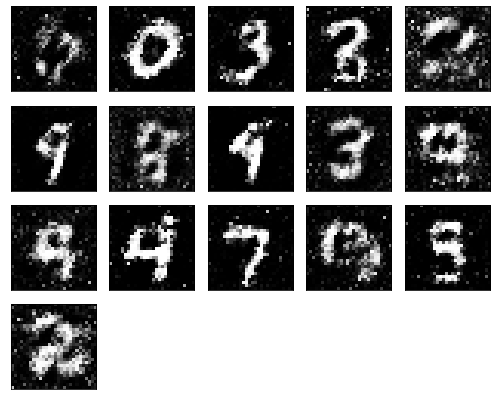

Epochs nb. 301
discriminator loss: 0.6115880608558655
generator loss : 0.980100691318512

Epochs nb. 302
discriminator loss: 0.5296202898025513
generator loss : 0.9614218473434448

Epochs nb. 303
discriminator loss: 0.577405571937561
generator loss : 0.9114155173301697

Epochs nb. 304
discriminator loss: 0.6268399953842163
generator loss : 0.9356971979141235

Epochs nb. 305
discriminator loss: 0.7061722278594971
generator loss : 0.9316794872283936

Epochs nb. 306
discriminator loss: 0.5126599073410034
generator loss : 0.9032277464866638

Epochs nb. 307
discriminator loss: 0.690589964389801
generator loss : 0.8483864068984985

Epochs nb. 308
discriminator loss: 0.6128768920898438
generator loss : 0.7260564565658569

Epochs nb. 309
discriminator loss: 0.693077802658081
generator loss : 0.7546567916870117

Epochs nb. 310
discriminator loss: 0.6583520174026489
generator loss : 0.9425727128982544



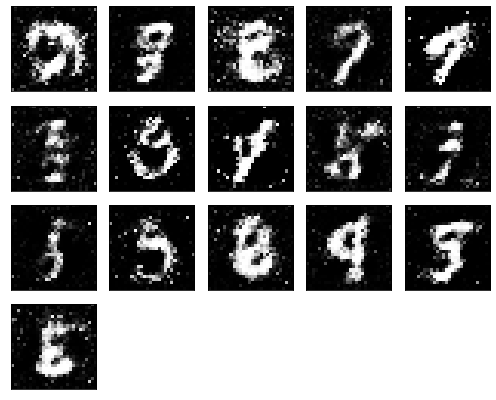

Epochs nb. 311
discriminator loss: 0.5907371640205383
generator loss : 1.1267657279968262

Epochs nb. 312
discriminator loss: 0.6796025633811951
generator loss : 0.9291037917137146

Epochs nb. 313
discriminator loss: 0.5898450016975403
generator loss : 0.9201498031616211

Epochs nb. 314
discriminator loss: 0.7139633297920227
generator loss : 1.0273925065994263

Epochs nb. 315
discriminator loss: 0.6469107866287231
generator loss : 0.9281530976295471

Epochs nb. 316
discriminator loss: 0.5598817467689514
generator loss : 0.7520068287849426

Epochs nb. 317
discriminator loss: 0.5394750237464905
generator loss : 0.9335635900497437

Epochs nb. 318
discriminator loss: 0.6235511898994446
generator loss : 0.9114705324172974

Epochs nb. 319
discriminator loss: 0.5696505904197693
generator loss : 0.8065677285194397

Epochs nb. 320
discriminator loss: 0.5997064709663391
generator loss : 0.9028851389884949



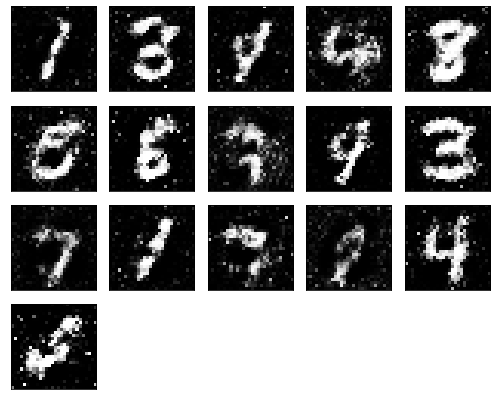

Epochs nb. 321
discriminator loss: 0.651860773563385
generator loss : 0.8681124448776245

Epochs nb. 322
discriminator loss: 0.6320915818214417
generator loss : 0.9853018522262573

Epochs nb. 323
discriminator loss: 0.6136585474014282
generator loss : 0.9630801677703857

Epochs nb. 324
discriminator loss: 0.6035670042037964
generator loss : 0.8934036493301392

Epochs nb. 325
discriminator loss: 0.5492403507232666
generator loss : 0.8788545727729797

Epochs nb. 326
discriminator loss: 0.47270768880844116
generator loss : 1.0040702819824219

Epochs nb. 327
discriminator loss: 0.5658482313156128
generator loss : 1.0233712196350098

Epochs nb. 328
discriminator loss: 0.5384860038757324
generator loss : 0.9490150213241577

Epochs nb. 329
discriminator loss: 0.5215246677398682
generator loss : 0.9657316207885742

Epochs nb. 330
discriminator loss: 0.7274420261383057
generator loss : 0.8585337400436401



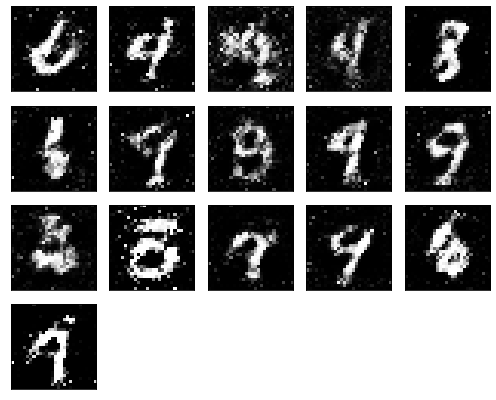

Epochs nb. 331
discriminator loss: 0.6788329482078552
generator loss : 0.8548219203948975

Epochs nb. 332
discriminator loss: 0.6045726537704468
generator loss : 0.8336149454116821

Epochs nb. 333
discriminator loss: 0.6104621887207031
generator loss : 0.8771594762802124

Epochs nb. 334
discriminator loss: 0.5321680903434753
generator loss : 1.0749950408935547

Epochs nb. 335
discriminator loss: 0.5953731536865234
generator loss : 0.8731646537780762

Epochs nb. 336
discriminator loss: 0.5479069948196411
generator loss : 0.9985111355781555

Epochs nb. 337
discriminator loss: 0.5725104212760925
generator loss : 1.0786610841751099

Epochs nb. 338
discriminator loss: 0.6785404682159424
generator loss : 1.0875213146209717

Epochs nb. 339
discriminator loss: 0.5386924743652344
generator loss : 0.9853518009185791

Epochs nb. 340
discriminator loss: 0.6304664611816406
generator loss : 1.0342460870742798



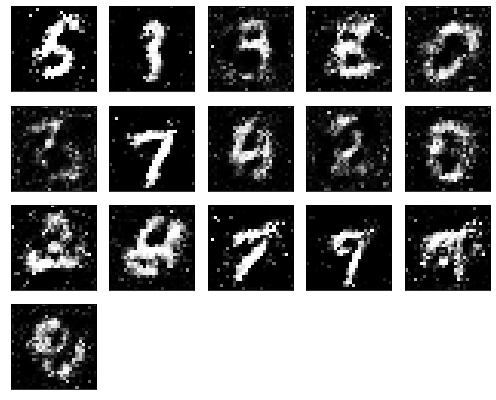

Epochs nb. 341
discriminator loss: 0.5953883528709412
generator loss : 1.1607062816619873

Epochs nb. 342
discriminator loss: 0.6372849941253662
generator loss : 1.0663578510284424

Epochs nb. 343
discriminator loss: 0.7540701627731323
generator loss : 0.9653533697128296

Epochs nb. 344
discriminator loss: 0.5715197324752808
generator loss : 0.9475116729736328

Epochs nb. 345
discriminator loss: 0.535805881023407
generator loss : 0.9483873844146729

Epochs nb. 346
discriminator loss: 0.49292898178100586
generator loss : 0.9033528566360474

Epochs nb. 347
discriminator loss: 0.788475513458252
generator loss : 0.8907556533813477

Epochs nb. 348
discriminator loss: 0.554747998714447
generator loss : 0.888251781463623

Epochs nb. 349
discriminator loss: 0.5656908750534058
generator loss : 0.826829195022583

Epochs nb. 350
discriminator loss: 0.5566364526748657
generator loss : 0.8674817085266113



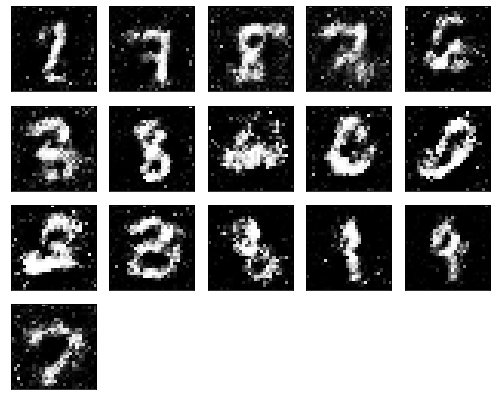

Epochs nb. 351
discriminator loss: 0.5240602493286133
generator loss : 0.825828492641449

Epochs nb. 352
discriminator loss: 0.6057568788528442
generator loss : 0.8272614479064941

Epochs nb. 353
discriminator loss: 0.4708433747291565
generator loss : 0.8586256504058838

Epochs nb. 354
discriminator loss: 0.71168053150177
generator loss : 0.9069247841835022

Epochs nb. 355
discriminator loss: 0.6010321378707886
generator loss : 0.8853309154510498

Epochs nb. 356
discriminator loss: 0.5654346942901611
generator loss : 0.8352574110031128

Epochs nb. 357
discriminator loss: 0.6644601821899414
generator loss : 0.906761646270752

Epochs nb. 358
discriminator loss: 0.6542879343032837
generator loss : 1.000901699066162

Epochs nb. 359
discriminator loss: 0.6171073913574219
generator loss : 0.8828833699226379

Epochs nb. 360
discriminator loss: 0.6042792797088623
generator loss : 0.8763952255249023



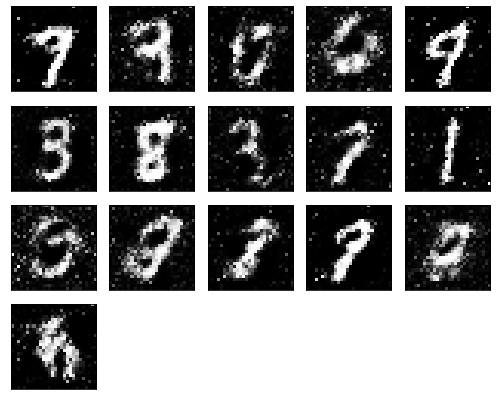

Epochs nb. 361
discriminator loss: 0.5183209180831909
generator loss : 0.9436907768249512

Epochs nb. 362
discriminator loss: 0.6140918135643005
generator loss : 1.0867112874984741

Epochs nb. 363
discriminator loss: 0.5226714015007019
generator loss : 0.943622350692749

Epochs nb. 364
discriminator loss: 0.5791706442832947
generator loss : 0.8004845380783081

Epochs nb. 365
discriminator loss: 0.6596876382827759
generator loss : 1.0848239660263062

Epochs nb. 366
discriminator loss: 0.6883232593536377
generator loss : 0.9377870559692383

Epochs nb. 367
discriminator loss: 0.6189696788787842
generator loss : 0.934266209602356

Epochs nb. 368
discriminator loss: 0.5774446725845337
generator loss : 0.7739230990409851

Epochs nb. 369
discriminator loss: 0.6550545692443848
generator loss : 0.7984492182731628

Epochs nb. 370
discriminator loss: 0.5282101035118103
generator loss : 0.831504762172699



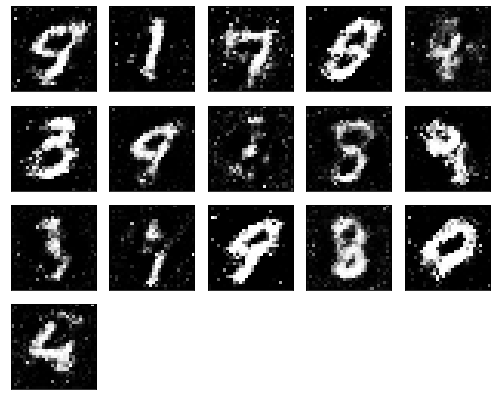

Epochs nb. 371
discriminator loss: 0.6141302585601807
generator loss : 0.890029788017273

Epochs nb. 372
discriminator loss: 0.46967166662216187
generator loss : 1.0024429559707642

Epochs nb. 373
discriminator loss: 0.5516481399536133
generator loss : 0.943097710609436

Epochs nb. 374
discriminator loss: 0.6235259771347046
generator loss : 0.9365606307983398

Epochs nb. 375
discriminator loss: 0.8668795824050903
generator loss : 0.9430608749389648

Epochs nb. 376
discriminator loss: 0.5053392648696899
generator loss : 0.7717043161392212

Epochs nb. 377
discriminator loss: 0.5396149754524231
generator loss : 0.8777839541435242

Epochs nb. 378
discriminator loss: 0.6253111362457275
generator loss : 0.9216188788414001

Epochs nb. 379
discriminator loss: 0.5853862762451172
generator loss : 1.0426602363586426

Epochs nb. 380
discriminator loss: 0.5678486824035645
generator loss : 0.9353141784667969



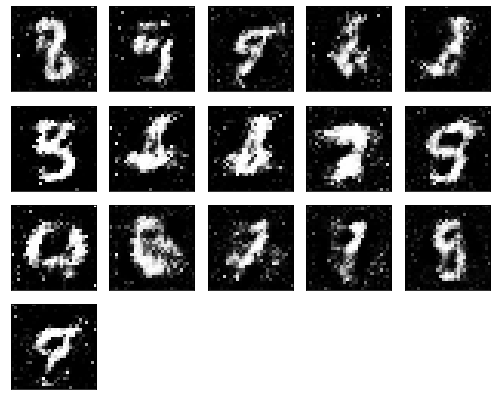

Epochs nb. 381
discriminator loss: 0.4778938889503479
generator loss : 0.9138471484184265

Epochs nb. 382
discriminator loss: 0.5337933301925659
generator loss : 1.0006002187728882

Epochs nb. 383
discriminator loss: 0.5449883937835693
generator loss : 1.0091614723205566

Epochs nb. 384
discriminator loss: 0.47763025760650635
generator loss : 0.9973597526550293

Epochs nb. 385
discriminator loss: 0.6798650622367859
generator loss : 0.8508785367012024

Epochs nb. 386
discriminator loss: 0.5883198976516724
generator loss : 0.9062739610671997

Epochs nb. 387
discriminator loss: 0.702985405921936
generator loss : 0.9189096689224243

Epochs nb. 388
discriminator loss: 0.5982759594917297
generator loss : 0.9374321699142456

Epochs nb. 389
discriminator loss: 0.7525405883789062
generator loss : 1.0006159543991089

Epochs nb. 390
discriminator loss: 0.5535910725593567
generator loss : 0.927995502948761



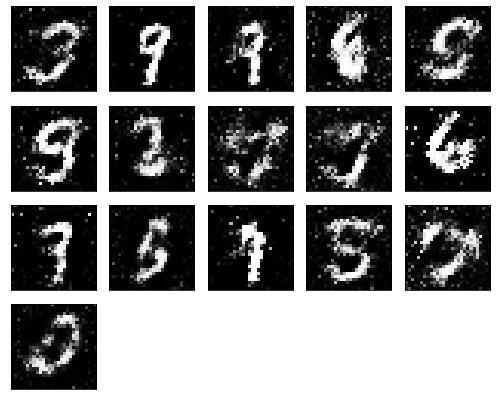

Epochs nb. 391
discriminator loss: 0.6135504841804504
generator loss : 0.8532422780990601

Epochs nb. 392
discriminator loss: 0.4549950957298279
generator loss : 0.8655988574028015

Epochs nb. 393
discriminator loss: 0.6503653526306152
generator loss : 1.0111654996871948

Epochs nb. 394
discriminator loss: 0.6400926113128662
generator loss : 1.0499902963638306

Epochs nb. 395
discriminator loss: 0.65632563829422
generator loss : 0.9613287448883057

Epochs nb. 396
discriminator loss: 0.6396016478538513
generator loss : 0.9836680293083191

Epochs nb. 397
discriminator loss: 0.6192628145217896
generator loss : 0.7871047258377075

Epochs nb. 398
discriminator loss: 0.6137053966522217
generator loss : 0.855393648147583

Epochs nb. 399
discriminator loss: 0.572879433631897
generator loss : 1.0579384565353394

Epochs nb. 400
discriminator loss: 0.5861151814460754
generator loss : 0.8551885485649109



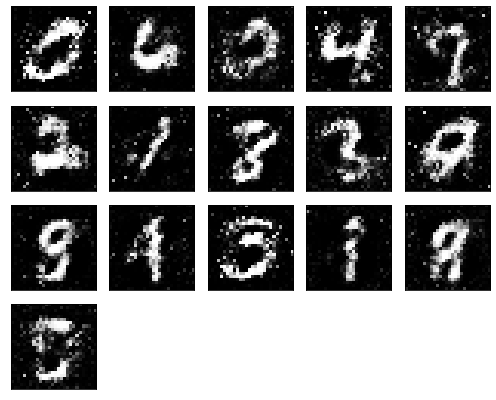

Epochs nb. 401
discriminator loss: 0.6222556233406067
generator loss : 0.8587358593940735

Epochs nb. 402
discriminator loss: 0.6479825973510742
generator loss : 0.8871243000030518

Epochs nb. 403
discriminator loss: 0.5936069488525391
generator loss : 0.9017101526260376

Epochs nb. 404
discriminator loss: 0.6459649801254272
generator loss : 1.0474499464035034

Epochs nb. 405
discriminator loss: 0.531549334526062
generator loss : 0.8184946179389954

Epochs nb. 406
discriminator loss: 0.49202674627304077
generator loss : 0.8606835603713989

Epochs nb. 407
discriminator loss: 0.6043777465820312
generator loss : 0.925950288772583

Epochs nb. 408
discriminator loss: 0.5887155532836914
generator loss : 0.8034052848815918

Epochs nb. 409
discriminator loss: 0.7460037469863892
generator loss : 0.9583081007003784

Epochs nb. 410
discriminator loss: 0.5505053997039795
generator loss : 0.7772785425186157



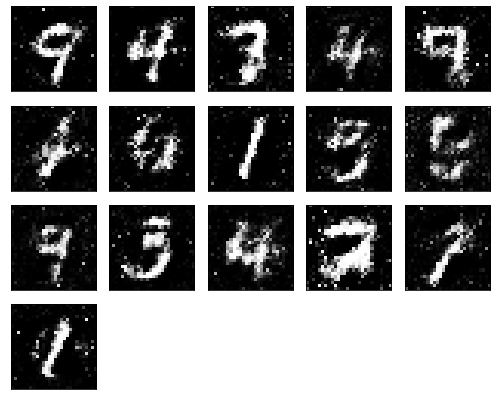

Epochs nb. 411
discriminator loss: 0.5540097951889038
generator loss : 0.9625815153121948

Epochs nb. 412
discriminator loss: 0.6241798996925354
generator loss : 0.9488503932952881

Epochs nb. 413
discriminator loss: 0.638534426689148
generator loss : 0.94781494140625

Epochs nb. 414
discriminator loss: 0.6072250604629517
generator loss : 0.9138619899749756

Epochs nb. 415
discriminator loss: 0.6303908824920654
generator loss : 1.094268560409546

Epochs nb. 416
discriminator loss: 0.5784181356430054
generator loss : 0.9249880313873291

Epochs nb. 417
discriminator loss: 0.547666609287262
generator loss : 0.9917675256729126

Epochs nb. 418
discriminator loss: 0.6014510989189148
generator loss : 0.7456039190292358

Epochs nb. 419
discriminator loss: 0.5514329671859741
generator loss : 0.7724522948265076

Epochs nb. 420
discriminator loss: 0.6072306632995605
generator loss : 0.9652436375617981



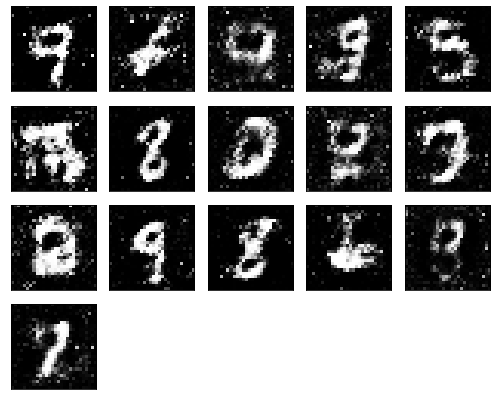

Epochs nb. 421
discriminator loss: 0.5690688490867615
generator loss : 1.0401946306228638

Epochs nb. 422
discriminator loss: 0.6197279691696167
generator loss : 0.9854628443717957

Epochs nb. 423
discriminator loss: 0.5372992753982544
generator loss : 1.002764105796814

Epochs nb. 424
discriminator loss: 0.5842907428741455
generator loss : 1.0548747777938843

Epochs nb. 425
discriminator loss: 0.6351287961006165
generator loss : 0.868126630783081

Epochs nb. 426
discriminator loss: 0.5554152727127075
generator loss : 0.9674464464187622

Epochs nb. 427
discriminator loss: 0.5557699203491211
generator loss : 0.991597056388855

Epochs nb. 428
discriminator loss: 0.6453479528427124
generator loss : 0.9372196197509766

Epochs nb. 429
discriminator loss: 0.5655186176300049
generator loss : 0.882807195186615

Epochs nb. 430
discriminator loss: 0.46496230363845825
generator loss : 0.7994824051856995



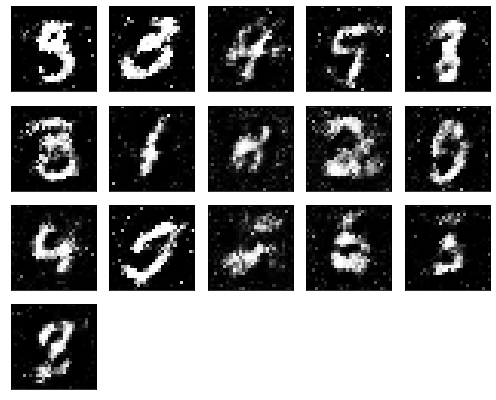

Epochs nb. 431
discriminator loss: 0.7304108142852783
generator loss : 0.9719910025596619

Epochs nb. 432
discriminator loss: 0.5425416231155396
generator loss : 0.8635097742080688

Epochs nb. 433
discriminator loss: 0.7652236223220825
generator loss : 0.8324733972549438

Epochs nb. 434
discriminator loss: 0.5931813716888428
generator loss : 0.8854284882545471

Epochs nb. 435
discriminator loss: 0.6948350667953491
generator loss : 0.897254228591919

Epochs nb. 436
discriminator loss: 0.571628212928772
generator loss : 0.9356576204299927

Epochs nb. 437
discriminator loss: 0.5719314813613892
generator loss : 0.9776533842086792

Epochs nb. 438
discriminator loss: 0.5859848856925964
generator loss : 0.9071406126022339

Epochs nb. 439
discriminator loss: 0.6234093308448792
generator loss : 0.9686868786811829

Epochs nb. 440
discriminator loss: 0.5454915165901184
generator loss : 0.9548295736312866



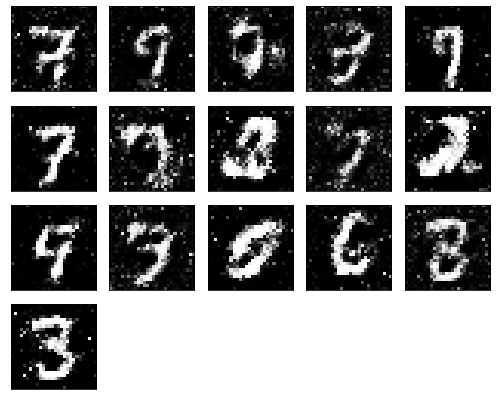

Epochs nb. 441
discriminator loss: 0.5538416504859924
generator loss : 0.8925350308418274

Epochs nb. 442
discriminator loss: 0.5389517545700073
generator loss : 0.9791625738143921

Epochs nb. 443
discriminator loss: 0.6516192555427551
generator loss : 1.048541784286499

Epochs nb. 444
discriminator loss: 0.5698724389076233
generator loss : 0.9927772879600525

Epochs nb. 445
discriminator loss: 0.6928347945213318
generator loss : 0.9004260897636414

Epochs nb. 446
discriminator loss: 0.6037212610244751
generator loss : 0.9800500273704529

Epochs nb. 447
discriminator loss: 0.667302131652832
generator loss : 0.9298263788223267

Epochs nb. 448
discriminator loss: 0.6223230957984924
generator loss : 0.8906207084655762

Epochs nb. 449
discriminator loss: 0.6166008710861206
generator loss : 0.9466094970703125

Epochs nb. 450
discriminator loss: 0.6880133152008057
generator loss : 0.7509691715240479



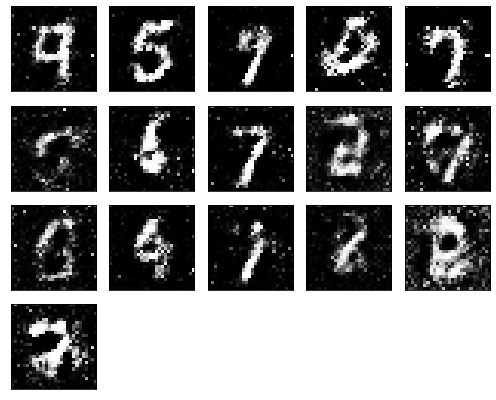

Epochs nb. 451
discriminator loss: 0.6263123750686646
generator loss : 0.9428764581680298

Epochs nb. 452
discriminator loss: 0.6077837944030762
generator loss : 0.7870842218399048

Epochs nb. 453
discriminator loss: 0.5322468280792236
generator loss : 0.9147675633430481

Epochs nb. 454
discriminator loss: 0.51646888256073
generator loss : 0.8935515284538269

Epochs nb. 455
discriminator loss: 0.6085824966430664
generator loss : 0.9870588779449463

Epochs nb. 456
discriminator loss: 0.7102912664413452
generator loss : 0.8763818740844727

Epochs nb. 457
discriminator loss: 0.640256404876709
generator loss : 0.9637056589126587

Epochs nb. 458
discriminator loss: 0.635723352432251
generator loss : 0.9537919759750366

Epochs nb. 459
discriminator loss: 0.5933074951171875
generator loss : 0.8997700810432434

Epochs nb. 460
discriminator loss: 0.6964213848114014
generator loss : 0.9311078190803528



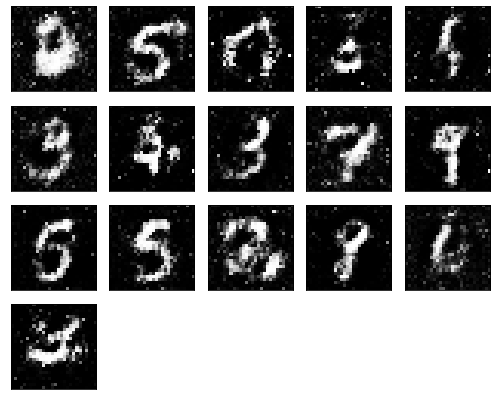

Epochs nb. 461
discriminator loss: 0.4867320656776428
generator loss : 0.8046085238456726

Epochs nb. 462
discriminator loss: 0.5501310229301453
generator loss : 0.9664357900619507

Epochs nb. 463
discriminator loss: 0.5664896368980408
generator loss : 0.8790756464004517

Epochs nb. 464
discriminator loss: 0.5446797609329224
generator loss : 0.9758180975914001

Epochs nb. 465
discriminator loss: 0.6654505133628845
generator loss : 0.9019513130187988

Epochs nb. 466
discriminator loss: 0.6153819561004639
generator loss : 0.9226785898208618

Epochs nb. 467
discriminator loss: 0.6719722151756287
generator loss : 0.9587357044219971

Epochs nb. 468
discriminator loss: 0.5903792381286621
generator loss : 0.9265305995941162

Epochs nb. 469
discriminator loss: 0.6096107959747314
generator loss : 0.9413637518882751

Epochs nb. 470
discriminator loss: 0.6025739908218384
generator loss : 0.9149502515792847



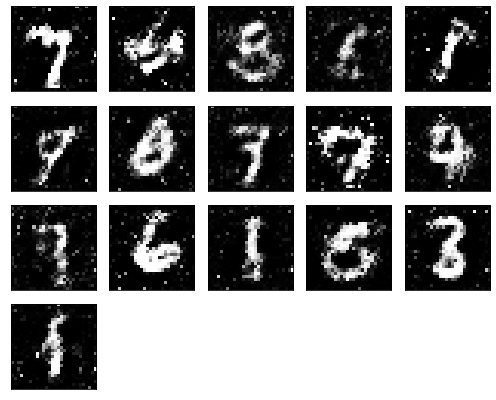

Epochs nb. 471
discriminator loss: 0.6251105070114136
generator loss : 0.8566999435424805

Epochs nb. 472
discriminator loss: 0.5241174697875977
generator loss : 0.8947506546974182

Epochs nb. 473
discriminator loss: 0.5548300743103027
generator loss : 0.9659062623977661

Epochs nb. 474
discriminator loss: 0.6184409260749817
generator loss : 0.9477928876876831

Epochs nb. 475
discriminator loss: 0.6391814947128296
generator loss : 0.8817743062973022

Epochs nb. 476
discriminator loss: 0.8026082515716553
generator loss : 0.9007232785224915

Epochs nb. 477
discriminator loss: 0.6091270446777344
generator loss : 1.0912262201309204

Epochs nb. 478
discriminator loss: 0.6471540331840515
generator loss : 0.9571137428283691

Epochs nb. 479
discriminator loss: 0.6177047491073608
generator loss : 0.9224070906639099

Epochs nb. 480
discriminator loss: 0.5929573774337769
generator loss : 0.8096292018890381



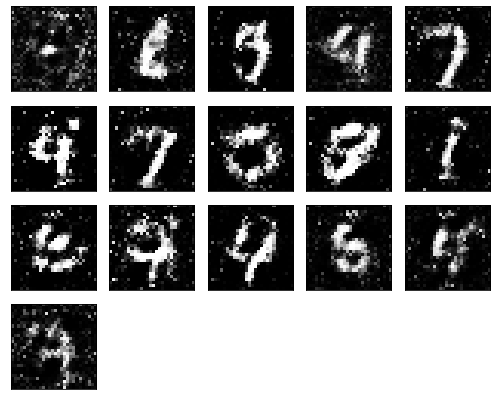

Epochs nb. 481
discriminator loss: 0.5432619452476501
generator loss : 0.8867669105529785

Epochs nb. 482
discriminator loss: 0.5815608501434326
generator loss : 0.8781514763832092

Epochs nb. 483
discriminator loss: 0.643746018409729
generator loss : 1.0165117979049683

Epochs nb. 484
discriminator loss: 0.6531351804733276
generator loss : 0.7388017177581787

Epochs nb. 485
discriminator loss: 0.6859177350997925
generator loss : 0.8269791007041931

Epochs nb. 486
discriminator loss: 0.5581730604171753
generator loss : 1.0113239288330078

Epochs nb. 487
discriminator loss: 0.5259475708007812
generator loss : 0.8778868913650513

Epochs nb. 488
discriminator loss: 0.691064178943634
generator loss : 1.0539638996124268

Epochs nb. 489
discriminator loss: 0.5779274702072144
generator loss : 0.8222030401229858

Epochs nb. 490
discriminator loss: 0.6208955645561218
generator loss : 0.9515106081962585



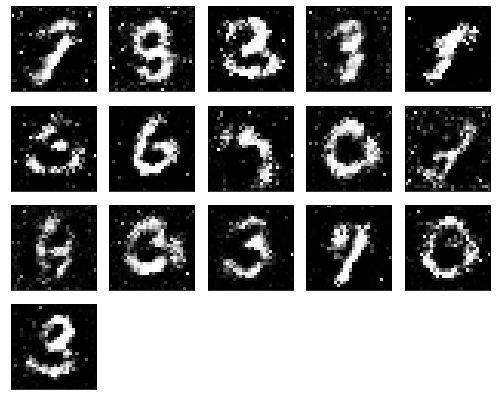

Epochs nb. 491
discriminator loss: 0.5872585773468018
generator loss : 0.858332633972168

Epochs nb. 492
discriminator loss: 0.5760559439659119
generator loss : 0.7696050405502319

Epochs nb. 493
discriminator loss: 0.7545100450515747
generator loss : 0.8603910207748413

Epochs nb. 494
discriminator loss: 0.7015824913978577
generator loss : 0.8811722993850708

Epochs nb. 495
discriminator loss: 0.5911743640899658
generator loss : 0.9127082824707031

Epochs nb. 496
discriminator loss: 0.532723605632782
generator loss : 0.850075364112854

Epochs nb. 497
discriminator loss: 0.6238025426864624
generator loss : 0.9357455372810364

Epochs nb. 498
discriminator loss: 0.6253525614738464
generator loss : 0.965875506401062

Epochs nb. 499
discriminator loss: 0.6484313011169434
generator loss : 0.8108352422714233

Epochs nb. 500
discriminator loss: 0.5900915861129761
generator loss : 0.8990638256072998



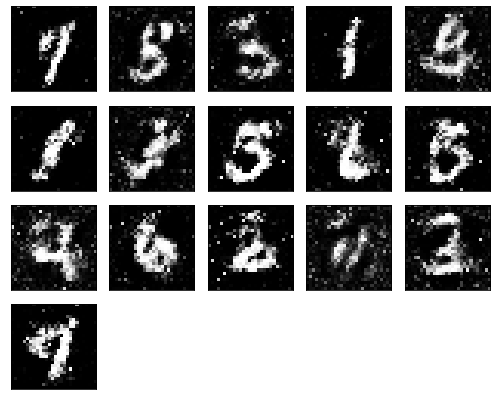

Epochs nb. 501
discriminator loss: 0.687474250793457
generator loss : 0.8864639401435852

Epochs nb. 502
discriminator loss: 0.640091061592102
generator loss : 0.9145667552947998

Epochs nb. 503
discriminator loss: 0.5239931344985962
generator loss : 0.9308075308799744

Epochs nb. 504
discriminator loss: 0.5757561922073364
generator loss : 1.0784168243408203

Epochs nb. 505
discriminator loss: 0.6385698318481445
generator loss : 0.9955845475196838

Epochs nb. 506
discriminator loss: 0.6248775124549866
generator loss : 1.0412893295288086

Epochs nb. 507
discriminator loss: 0.5886530876159668
generator loss : 0.9179619550704956

Epochs nb. 508
discriminator loss: 0.5090973377227783
generator loss : 0.8598068952560425

Epochs nb. 509
discriminator loss: 0.6576332449913025
generator loss : 0.8476819396018982

Epochs nb. 510
discriminator loss: 0.5419508814811707
generator loss : 0.8228037357330322



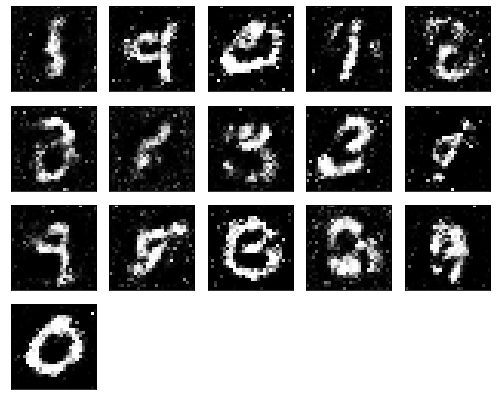

Epochs nb. 511
discriminator loss: 0.48213666677474976
generator loss : 0.8464154005050659

Epochs nb. 512
discriminator loss: 0.6447808742523193
generator loss : 0.8789551854133606

Epochs nb. 513
discriminator loss: 0.6924221515655518
generator loss : 0.9247704744338989

Epochs nb. 514
discriminator loss: 0.6970360279083252
generator loss : 0.8799387216567993

Epochs nb. 515
discriminator loss: 0.5539072751998901
generator loss : 0.9443281888961792

Epochs nb. 516
discriminator loss: 0.6178787350654602
generator loss : 0.8943793773651123

Epochs nb. 517
discriminator loss: 0.6773939728736877
generator loss : 0.9948347806930542

Epochs nb. 518
discriminator loss: 0.5611230134963989
generator loss : 1.078960657119751

Epochs nb. 519
discriminator loss: 0.7167747020721436
generator loss : 0.9132786989212036

Epochs nb. 520
discriminator loss: 0.6207997798919678
generator loss : 0.7038156986236572



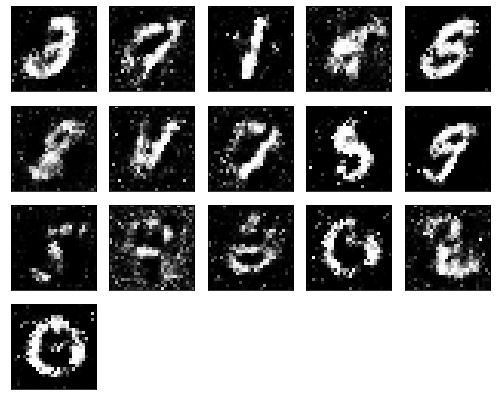

Epochs nb. 521
discriminator loss: 0.6732412576675415
generator loss : 0.7978591322898865

Epochs nb. 522
discriminator loss: 0.5567367076873779
generator loss : 0.8305050134658813

Epochs nb. 523
discriminator loss: 0.7066452503204346
generator loss : 0.8625208139419556

Epochs nb. 524
discriminator loss: 0.5790027976036072
generator loss : 0.9419254064559937

Epochs nb. 525
discriminator loss: 0.59947669506073
generator loss : 0.8300029635429382

Epochs nb. 526
discriminator loss: 0.6402271389961243
generator loss : 0.9506447315216064

Epochs nb. 527
discriminator loss: 0.6315277218818665
generator loss : 0.8722242116928101

Epochs nb. 528
discriminator loss: 0.5892534255981445
generator loss : 0.9537508487701416

Epochs nb. 529
discriminator loss: 0.5671494007110596
generator loss : 0.9266046285629272

Epochs nb. 530
discriminator loss: 0.6141406297683716
generator loss : 0.778706967830658



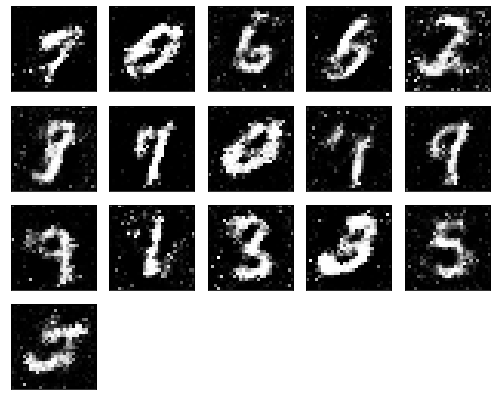

Epochs nb. 531
discriminator loss: 0.5791922807693481
generator loss : 0.9679899215698242

Epochs nb. 532
discriminator loss: 0.5722079873085022
generator loss : 0.9189964532852173

Epochs nb. 533
discriminator loss: 0.6687762141227722
generator loss : 0.9767083525657654

Epochs nb. 534
discriminator loss: 0.603778064250946
generator loss : 1.01535964012146

Epochs nb. 535
discriminator loss: 0.5731135606765747
generator loss : 0.9297520518302917

Epochs nb. 536
discriminator loss: 0.6784325838088989
generator loss : 0.931422233581543

Epochs nb. 537
discriminator loss: 0.5412496328353882
generator loss : 0.943726658821106

Epochs nb. 538
discriminator loss: 0.5582138299942017
generator loss : 0.9173797369003296

Epochs nb. 539
discriminator loss: 0.671494722366333
generator loss : 0.9508415460586548

Epochs nb. 540
discriminator loss: 0.5476421117782593
generator loss : 0.9978895783424377



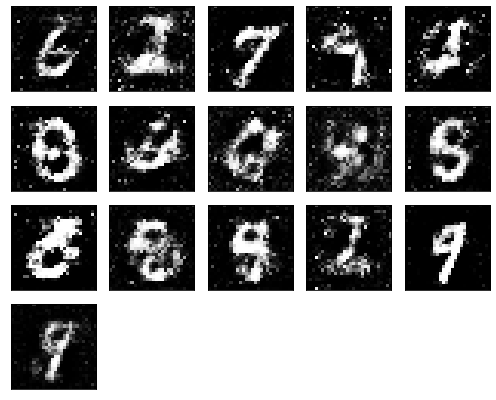

Epochs nb. 541
discriminator loss: 0.5779653191566467
generator loss : 0.8686695694923401

Epochs nb. 542
discriminator loss: 0.6301628351211548
generator loss : 0.7777280807495117

Epochs nb. 543
discriminator loss: 0.5351670384407043
generator loss : 0.9919065237045288

Epochs nb. 544
discriminator loss: 0.7278540134429932
generator loss : 1.0903708934783936

Epochs nb. 545
discriminator loss: 0.691186785697937
generator loss : 0.9606906175613403

Epochs nb. 546
discriminator loss: 0.6940507292747498
generator loss : 0.9641922116279602

Epochs nb. 547
discriminator loss: 0.6095297336578369
generator loss : 0.9218969345092773

Epochs nb. 548
discriminator loss: 0.615222156047821
generator loss : 0.9616796374320984

Epochs nb. 549
discriminator loss: 0.5308225154876709
generator loss : 0.9798431992530823

Epochs nb. 550
discriminator loss: 0.6605592966079712
generator loss : 1.0712783336639404



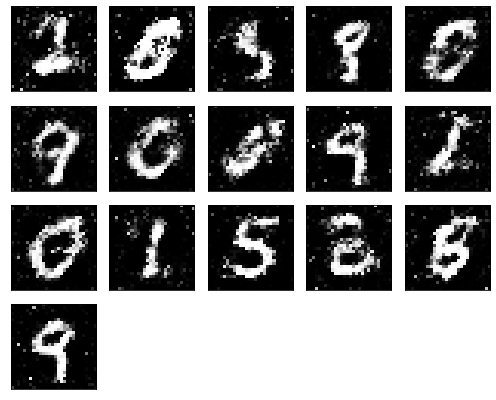

Epochs nb. 551
discriminator loss: 0.5390729904174805
generator loss : 0.9780340790748596

Epochs nb. 552
discriminator loss: 0.5594558715820312
generator loss : 1.0231585502624512

Epochs nb. 553
discriminator loss: 0.6944445371627808
generator loss : 0.9616826772689819

Epochs nb. 554
discriminator loss: 0.6319708824157715
generator loss : 0.9028668999671936

Epochs nb. 555
discriminator loss: 0.621822714805603
generator loss : 0.6951322555541992

Epochs nb. 556
discriminator loss: 0.6129945516586304
generator loss : 0.6479820609092712

Epochs nb. 557
discriminator loss: 0.5376337766647339
generator loss : 0.8972907066345215

Epochs nb. 558
discriminator loss: 0.561683177947998
generator loss : 1.0128034353256226

Epochs nb. 559
discriminator loss: 0.5926980972290039
generator loss : 0.8874046802520752

Epochs nb. 560
discriminator loss: 0.6642667055130005
generator loss : 0.8587151765823364



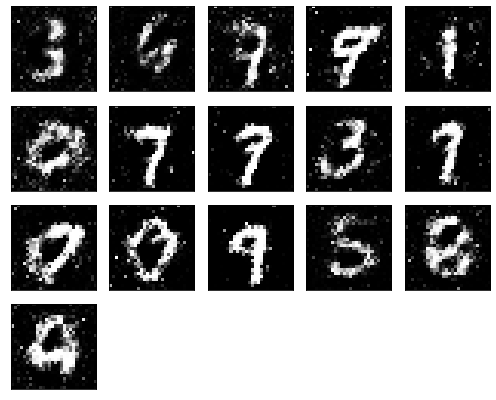

Epochs nb. 561
discriminator loss: 0.4892539978027344
generator loss : 0.9648427963256836

Epochs nb. 562
discriminator loss: 0.5553313493728638
generator loss : 0.9251359105110168

Epochs nb. 563
discriminator loss: 0.6673274040222168
generator loss : 1.0042040348052979

Epochs nb. 564
discriminator loss: 0.6362432241439819
generator loss : 0.9246691465377808

Epochs nb. 565
discriminator loss: 0.5621550679206848
generator loss : 0.832125186920166

Epochs nb. 566
discriminator loss: 0.5967776775360107
generator loss : 0.6930792331695557

Epochs nb. 567
discriminator loss: 0.6216196417808533
generator loss : 0.9449702501296997

Epochs nb. 568
discriminator loss: 0.5011418461799622
generator loss : 0.8063973188400269

Epochs nb. 569
discriminator loss: 0.5627751350402832
generator loss : 0.9166340827941895

Epochs nb. 570
discriminator loss: 0.7860313653945923
generator loss : 1.01167631149292



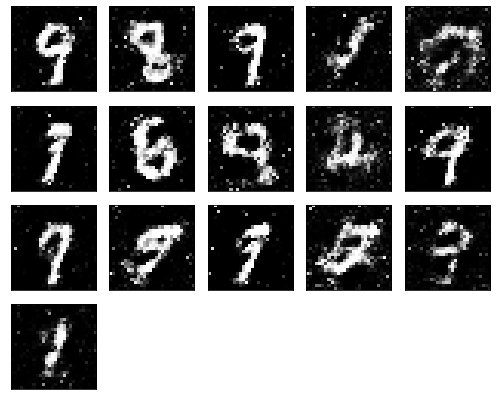

Epochs nb. 571
discriminator loss: 0.45309486985206604
generator loss : 0.9434902667999268

Epochs nb. 572
discriminator loss: 0.6902849078178406
generator loss : 0.9220162034034729

Epochs nb. 573
discriminator loss: 0.6118581295013428
generator loss : 1.0397312641143799

Epochs nb. 574
discriminator loss: 0.5186024904251099
generator loss : 1.0268536806106567

Epochs nb. 575
discriminator loss: 0.5143224000930786
generator loss : 0.9394667148590088

Epochs nb. 576
discriminator loss: 0.5679064393043518
generator loss : 0.9056752920150757

Epochs nb. 577
discriminator loss: 0.6338628530502319
generator loss : 0.9075104594230652

Epochs nb. 578
discriminator loss: 0.5742810964584351
generator loss : 0.788851261138916

Epochs nb. 579
discriminator loss: 0.6637284755706787
generator loss : 0.8750380277633667

Epochs nb. 580
discriminator loss: 0.5638801455497742
generator loss : 0.9344586133956909



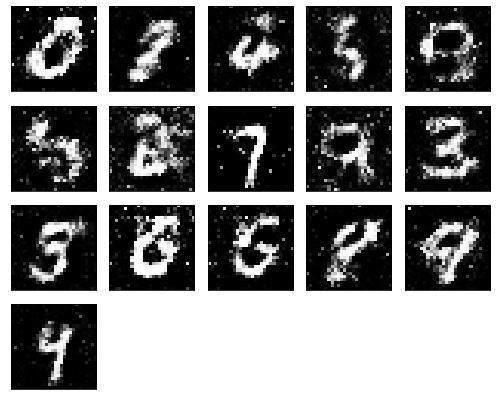

Epochs nb. 581
discriminator loss: 0.6506398916244507
generator loss : 0.9116086959838867

Epochs nb. 582
discriminator loss: 0.6389549970626831
generator loss : 0.9713577032089233

Epochs nb. 583
discriminator loss: 0.5884827971458435
generator loss : 0.8687834739685059

Epochs nb. 584
discriminator loss: 0.6842242479324341
generator loss : 1.0385611057281494

Epochs nb. 585
discriminator loss: 0.5479156970977783
generator loss : 1.060152530670166

Epochs nb. 586
discriminator loss: 0.5421667695045471
generator loss : 0.9268835783004761

Epochs nb. 587
discriminator loss: 0.6165143251419067
generator loss : 0.9807032346725464

Epochs nb. 588
discriminator loss: 0.6067018508911133
generator loss : 1.0095025300979614

Epochs nb. 589
discriminator loss: 0.5942256450653076
generator loss : 0.9890594482421875

Epochs nb. 590
discriminator loss: 0.6481157541275024
generator loss : 0.8235340118408203



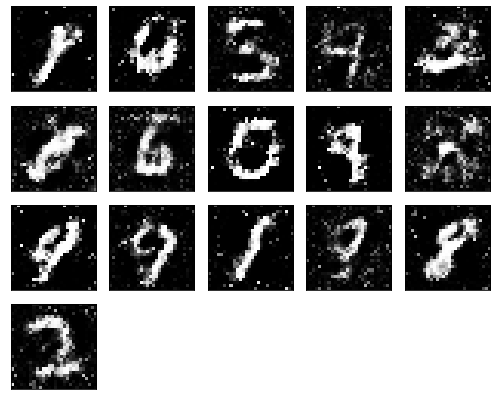

Epochs nb. 591
discriminator loss: 0.5634371042251587
generator loss : 0.9008243083953857

Epochs nb. 592
discriminator loss: 0.6007028818130493
generator loss : 1.1151924133300781

Epochs nb. 593
discriminator loss: 0.6105874180793762
generator loss : 0.8997459411621094

Epochs nb. 594
discriminator loss: 0.5176152586936951
generator loss : 0.8803730010986328

Epochs nb. 595
discriminator loss: 0.5661386847496033
generator loss : 0.9188454151153564

Epochs nb. 596
discriminator loss: 0.6186189651489258
generator loss : 0.9110504984855652

Epochs nb. 597
discriminator loss: 0.581586480140686
generator loss : 1.0498312711715698

Epochs nb. 598
discriminator loss: 0.5274159908294678
generator loss : 0.9144787192344666

Epochs nb. 599
discriminator loss: 0.5940510034561157
generator loss : 0.9245411157608032

Epochs nb. 600
discriminator loss: 0.5698177814483643
generator loss : 1.018978476524353



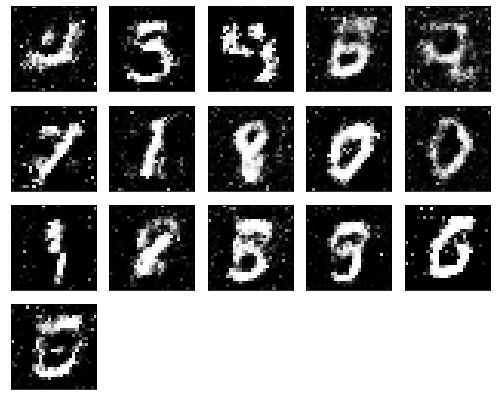

Epochs nb. 601
discriminator loss: 0.6141952872276306
generator loss : 0.91001296043396

Epochs nb. 602
discriminator loss: 0.6120260953903198
generator loss : 0.946868896484375

Epochs nb. 603
discriminator loss: 0.7272763252258301
generator loss : 0.9318657517433167

Epochs nb. 604
discriminator loss: 0.6095400452613831
generator loss : 0.9369300603866577

Epochs nb. 605
discriminator loss: 0.596104621887207
generator loss : 0.9857959151268005

Epochs nb. 606
discriminator loss: 0.6113412380218506
generator loss : 0.9069540500640869

Epochs nb. 607
discriminator loss: 0.570594072341919
generator loss : 0.9523478746414185

Epochs nb. 608
discriminator loss: 0.5725877285003662
generator loss : 1.0188096761703491

Epochs nb. 609
discriminator loss: 0.6318553686141968
generator loss : 1.025620698928833

Epochs nb. 610
discriminator loss: 0.7438539862632751
generator loss : 0.9715590476989746



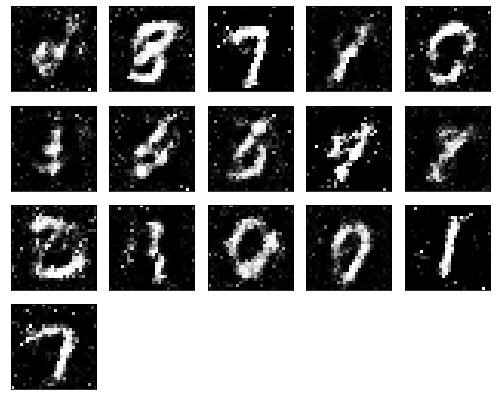

Epochs nb. 611
discriminator loss: 0.5643553733825684
generator loss : 0.9724497199058533

Epochs nb. 612
discriminator loss: 0.4962770938873291
generator loss : 0.9968488216400146

Epochs nb. 613
discriminator loss: 0.6344470977783203
generator loss : 1.1827657222747803

Epochs nb. 614
discriminator loss: 0.584726870059967
generator loss : 0.8600969314575195

Epochs nb. 615
discriminator loss: 0.48090481758117676
generator loss : 0.941238522529602

Epochs nb. 616
discriminator loss: 0.6870149374008179
generator loss : 0.9281328916549683

Epochs nb. 617
discriminator loss: 0.5285047888755798
generator loss : 0.80562424659729

Epochs nb. 618
discriminator loss: 0.5761615037918091
generator loss : 0.9682078957557678

Epochs nb. 619
discriminator loss: 0.7284606695175171
generator loss : 0.7513928413391113

Epochs nb. 620
discriminator loss: 0.691109836101532
generator loss : 0.8641242384910583



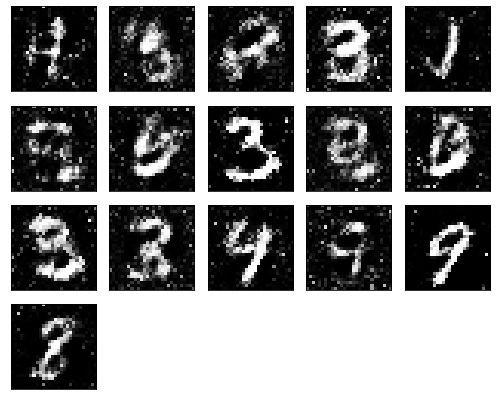

Epochs nb. 621
discriminator loss: 0.6022168397903442
generator loss : 0.9050452709197998

Epochs nb. 622
discriminator loss: 0.5932175517082214
generator loss : 0.8804382681846619

Epochs nb. 623
discriminator loss: 0.6826035380363464
generator loss : 0.8767542839050293

Epochs nb. 624
discriminator loss: 0.49187490344047546
generator loss : 0.840387761592865

Epochs nb. 625
discriminator loss: 0.5566456317901611
generator loss : 1.018826961517334

Epochs nb. 626
discriminator loss: 0.6414389610290527
generator loss : 0.9227950572967529

Epochs nb. 627
discriminator loss: 0.7877107262611389
generator loss : 0.8504520654678345

Epochs nb. 628
discriminator loss: 0.5925981402397156
generator loss : 0.968659520149231

Epochs nb. 629
discriminator loss: 0.4528810977935791
generator loss : 0.9040920734405518

Epochs nb. 630
discriminator loss: 0.7504005432128906
generator loss : 0.8936177492141724



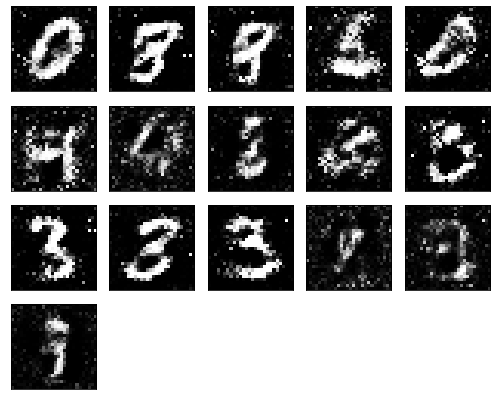

Epochs nb. 631
discriminator loss: 0.5451709628105164
generator loss : 0.981715738773346

Epochs nb. 632
discriminator loss: 0.49340590834617615
generator loss : 0.9231452345848083

Epochs nb. 633
discriminator loss: 0.6548607349395752
generator loss : 0.945432722568512

Epochs nb. 634
discriminator loss: 0.6462396383285522
generator loss : 0.8733754754066467

Epochs nb. 635
discriminator loss: 0.6076906323432922
generator loss : 0.7952610850334167

Epochs nb. 636
discriminator loss: 0.6025705337524414
generator loss : 0.908541738986969

Epochs nb. 637
discriminator loss: 0.5556297302246094
generator loss : 0.9350967407226562

Epochs nb. 638
discriminator loss: 0.595039963722229
generator loss : 0.8786893486976624

Epochs nb. 639
discriminator loss: 0.6018645167350769
generator loss : 0.7689118981361389

Epochs nb. 640
discriminator loss: 0.540675163269043
generator loss : 1.0151538848876953



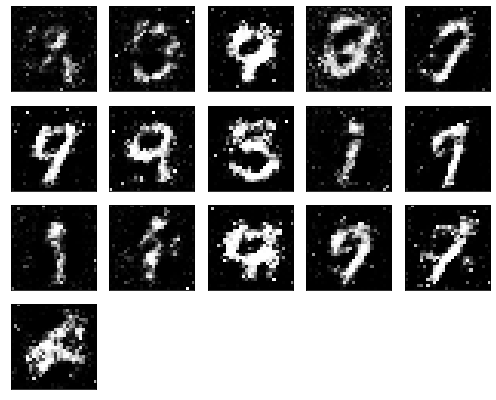

Epochs nb. 641
discriminator loss: 0.5886772871017456
generator loss : 0.9030656814575195

Epochs nb. 642
discriminator loss: 0.6442857980728149
generator loss : 0.8969202041625977

Epochs nb. 643
discriminator loss: 0.5833213329315186
generator loss : 0.9817074537277222

Epochs nb. 644
discriminator loss: 0.682828426361084
generator loss : 0.9589982032775879

Epochs nb. 645
discriminator loss: 0.7329308986663818
generator loss : 1.1249362230300903

Epochs nb. 646
discriminator loss: 0.5036145448684692
generator loss : 1.0185432434082031

Epochs nb. 647
discriminator loss: 0.5963443517684937
generator loss : 1.0758315324783325

Epochs nb. 648
discriminator loss: 0.6322582364082336
generator loss : 0.9296300411224365

Epochs nb. 649
discriminator loss: 0.6100397109985352
generator loss : 0.8500286340713501

Epochs nb. 650
discriminator loss: 0.6743857264518738
generator loss : 1.0013196468353271



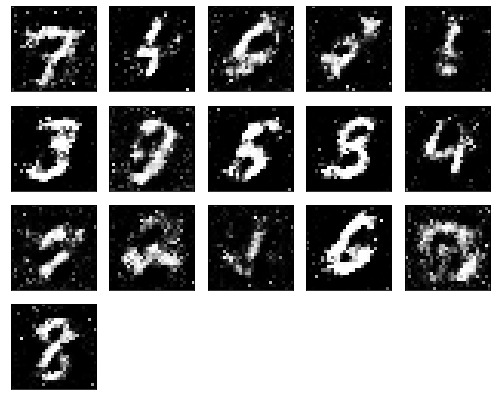

Epochs nb. 651
discriminator loss: 0.5701877474784851
generator loss : 0.8724852800369263

Epochs nb. 652
discriminator loss: 0.6775533556938171
generator loss : 0.8581044673919678

Epochs nb. 653
discriminator loss: 0.6401512622833252
generator loss : 0.9697725772857666

Epochs nb. 654
discriminator loss: 0.6632147431373596
generator loss : 0.8992898464202881

Epochs nb. 655
discriminator loss: 0.5331064462661743
generator loss : 0.9391599893569946

Epochs nb. 656
discriminator loss: 0.4790550470352173
generator loss : 0.9944190979003906

Epochs nb. 657
discriminator loss: 0.6813274621963501
generator loss : 0.9290822744369507

Epochs nb. 658
discriminator loss: 0.6563444137573242
generator loss : 0.9118434190750122

Epochs nb. 659
discriminator loss: 0.5243760347366333
generator loss : 0.7814188003540039

Epochs nb. 660
discriminator loss: 0.5985420346260071
generator loss : 0.9314919710159302



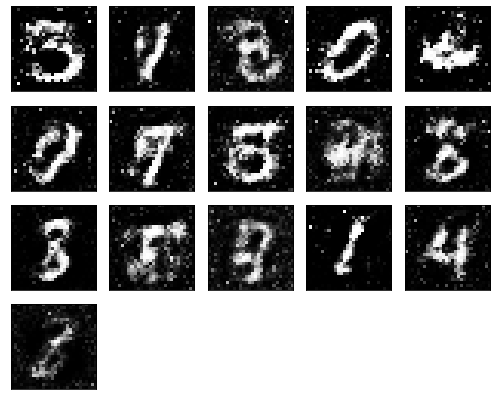

Epochs nb. 661
discriminator loss: 0.5345954895019531
generator loss : 0.9322145581245422

Epochs nb. 662
discriminator loss: 0.6114237308502197
generator loss : 0.8557130098342896

Epochs nb. 663
discriminator loss: 0.5931062698364258
generator loss : 0.9579389095306396

Epochs nb. 664
discriminator loss: 0.6213510036468506
generator loss : 0.9218042492866516

Epochs nb. 665
discriminator loss: 0.5330579876899719
generator loss : 0.9026846885681152

Epochs nb. 666
discriminator loss: 0.6093878746032715
generator loss : 0.9264827966690063

Epochs nb. 667
discriminator loss: 0.5685272812843323
generator loss : 0.8733011484146118

Epochs nb. 668
discriminator loss: 0.5864162445068359
generator loss : 0.8843629360198975

Epochs nb. 669
discriminator loss: 0.5800880193710327
generator loss : 0.8538128733634949

Epochs nb. 670
discriminator loss: 0.5890969038009644
generator loss : 0.8915301561355591



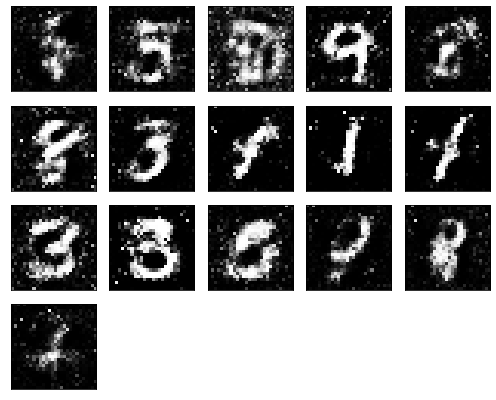

Epochs nb. 671
discriminator loss: 0.6588535904884338
generator loss : 0.8287190794944763

Epochs nb. 672
discriminator loss: 0.5594838261604309
generator loss : 0.8573068380355835

Epochs nb. 673
discriminator loss: 0.6450943946838379
generator loss : 0.9388772249221802

Epochs nb. 674
discriminator loss: 0.764799952507019
generator loss : 1.0326619148254395

Epochs nb. 675
discriminator loss: 0.7033895254135132
generator loss : 0.990655779838562

Epochs nb. 676
discriminator loss: 0.5405018329620361
generator loss : 1.0020543336868286

Epochs nb. 677
discriminator loss: 0.6528841853141785
generator loss : 1.0832113027572632

Epochs nb. 678
discriminator loss: 0.6144067049026489
generator loss : 1.0755826234817505

Epochs nb. 679
discriminator loss: 0.5640377998352051
generator loss : 0.9301133155822754

Epochs nb. 680
discriminator loss: 0.6694357395172119
generator loss : 0.8451618552207947



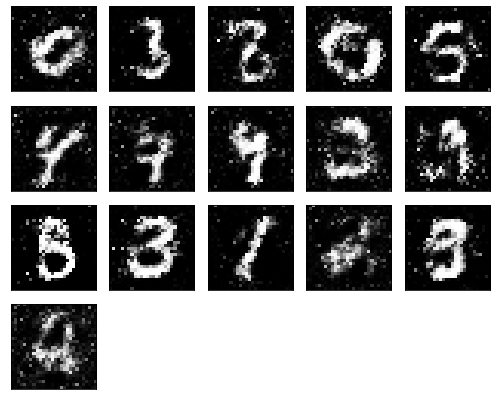

Epochs nb. 681
discriminator loss: 0.537813663482666
generator loss : 0.8993672728538513

Epochs nb. 682
discriminator loss: 0.585198163986206
generator loss : 0.8774535655975342

Epochs nb. 683
discriminator loss: 0.6033107042312622
generator loss : 0.8644019365310669

Epochs nb. 684
discriminator loss: 0.6080507040023804
generator loss : 0.8884971141815186

Epochs nb. 685
discriminator loss: 0.6675546169281006
generator loss : 0.9314652681350708

Epochs nb. 686
discriminator loss: 0.6239956617355347
generator loss : 0.9941238164901733

Epochs nb. 687
discriminator loss: 0.6534322500228882
generator loss : 0.9551692605018616

Epochs nb. 688
discriminator loss: 0.5805696249008179
generator loss : 1.0588843822479248

Epochs nb. 689
discriminator loss: 0.5354717373847961
generator loss : 1.032712697982788

Epochs nb. 690
discriminator loss: 0.5994910001754761
generator loss : 0.9641662240028381



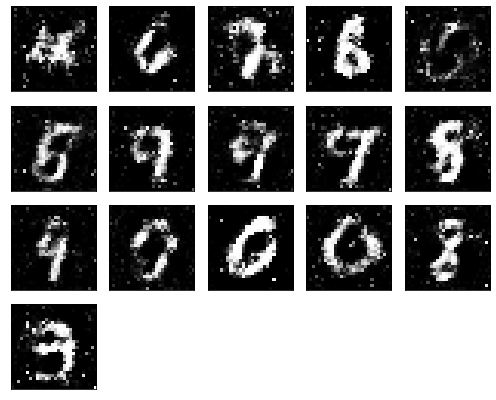

Epochs nb. 691
discriminator loss: 0.6784557104110718
generator loss : 1.0643829107284546

Epochs nb. 692
discriminator loss: 0.592042088508606
generator loss : 0.838634729385376

Epochs nb. 693
discriminator loss: 0.5966984033584595
generator loss : 0.8269152641296387

Epochs nb. 694
discriminator loss: 0.5998699069023132
generator loss : 0.9358057975769043

Epochs nb. 695
discriminator loss: 0.6189514398574829
generator loss : 0.970839262008667

Epochs nb. 696
discriminator loss: 0.5574821829795837
generator loss : 0.881534218788147

Epochs nb. 697
discriminator loss: 0.5928788781166077
generator loss : 0.8422354459762573

Epochs nb. 698
discriminator loss: 0.5708974599838257
generator loss : 0.9232243299484253

Epochs nb. 699
discriminator loss: 0.6038415431976318
generator loss : 0.9448786973953247

Epochs nb. 700
discriminator loss: 0.5385873913764954
generator loss : 0.9311662912368774



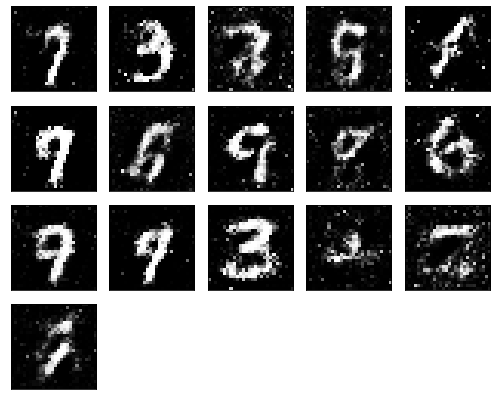

Epochs nb. 701
discriminator loss: 0.5655753016471863
generator loss : 0.8680542707443237

Epochs nb. 702
discriminator loss: 0.7181767821311951
generator loss : 0.9186104536056519

Epochs nb. 703
discriminator loss: 0.5264105796813965
generator loss : 0.9308678507804871

Epochs nb. 704
discriminator loss: 0.5940783619880676
generator loss : 0.9445734024047852

Epochs nb. 705
discriminator loss: 0.7128705382347107
generator loss : 0.9148597121238708

Epochs nb. 706
discriminator loss: 0.5908130407333374
generator loss : 0.8706969618797302

Epochs nb. 707
discriminator loss: 0.6181389093399048
generator loss : 0.996279239654541

Epochs nb. 708
discriminator loss: 0.5714485049247742
generator loss : 1.0036540031433105

Epochs nb. 709
discriminator loss: 0.5965121984481812
generator loss : 0.8756810426712036

Epochs nb. 710
discriminator loss: 0.6876572370529175
generator loss : 0.8357898592948914



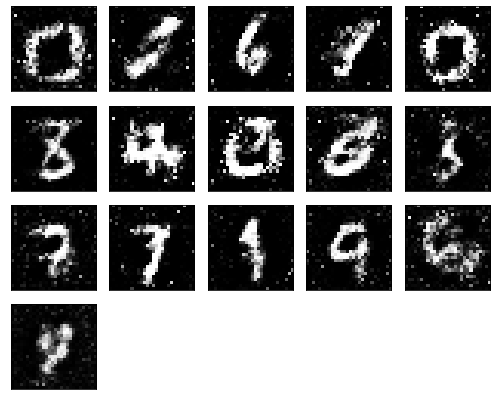

Epochs nb. 711
discriminator loss: 0.6325508952140808
generator loss : 1.1319198608398438

Epochs nb. 712
discriminator loss: 0.655665397644043
generator loss : 0.8554323315620422

Epochs nb. 713
discriminator loss: 0.5568902492523193
generator loss : 0.9410451054573059

Epochs nb. 714
discriminator loss: 0.6564735174179077
generator loss : 0.9531554579734802

Epochs nb. 715
discriminator loss: 0.5639771223068237
generator loss : 0.9786490201950073

Epochs nb. 716
discriminator loss: 0.5119318962097168
generator loss : 0.8944704532623291

Epochs nb. 717
discriminator loss: 0.7655973434448242
generator loss : 0.9721845388412476

Epochs nb. 718
discriminator loss: 0.6327924728393555
generator loss : 0.9555521011352539

Epochs nb. 719
discriminator loss: 0.5285462141036987
generator loss : 0.917191207408905

Epochs nb. 720
discriminator loss: 0.5461479425430298
generator loss : 1.0014914274215698



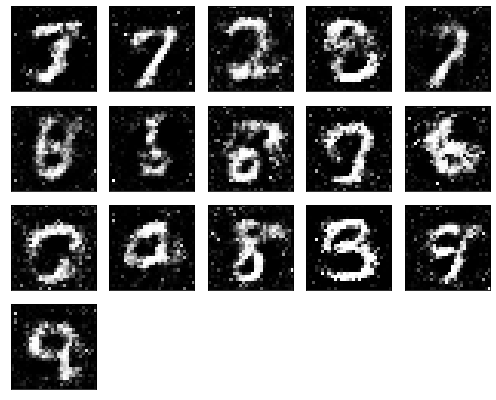

Epochs nb. 721
discriminator loss: 0.756700873374939
generator loss : 0.9893264770507812

Epochs nb. 722
discriminator loss: 0.579859733581543
generator loss : 0.971380352973938

Epochs nb. 723
discriminator loss: 0.6335412859916687
generator loss : 1.058567762374878

Epochs nb. 724
discriminator loss: 0.6672053337097168
generator loss : 0.9474437236785889

Epochs nb. 725
discriminator loss: 0.6495479345321655
generator loss : 0.9599695205688477

Epochs nb. 726
discriminator loss: 0.6497560739517212
generator loss : 0.8674878478050232

Epochs nb. 727
discriminator loss: 0.6119232177734375
generator loss : 0.994884192943573

Epochs nb. 728
discriminator loss: 0.5368981957435608
generator loss : 0.9201859831809998

Epochs nb. 729
discriminator loss: 0.6178441643714905
generator loss : 1.0015124082565308

Epochs nb. 730
discriminator loss: 0.5559017658233643
generator loss : 0.9032613635063171



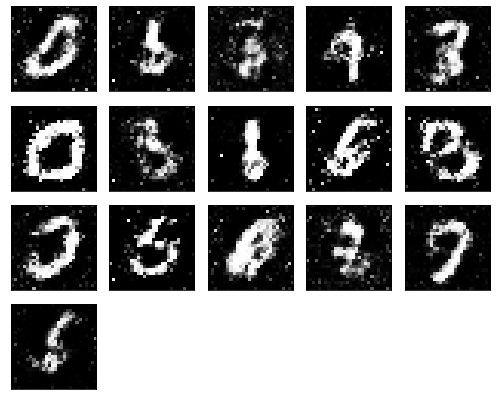

Epochs nb. 731
discriminator loss: 0.5692647695541382
generator loss : 0.9338078498840332

Epochs nb. 732
discriminator loss: 0.6010703444480896
generator loss : 0.9723681211471558

Epochs nb. 733
discriminator loss: 0.6794372797012329
generator loss : 1.001882791519165

Epochs nb. 734
discriminator loss: 0.6791856288909912
generator loss : 0.8392505645751953

Epochs nb. 735
discriminator loss: 0.5326548218727112
generator loss : 0.883101224899292

Epochs nb. 736
discriminator loss: 0.6569446325302124
generator loss : 0.9647021293640137

Epochs nb. 737
discriminator loss: 0.6388505697250366
generator loss : 1.1925101280212402

Epochs nb. 738
discriminator loss: 0.5991883277893066
generator loss : 0.8637183904647827

Epochs nb. 739
discriminator loss: 0.5823394060134888
generator loss : 0.9145218133926392

Epochs nb. 740
discriminator loss: 0.5970476269721985
generator loss : 1.0463224649429321



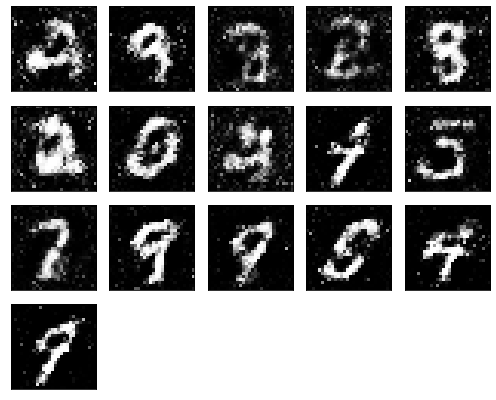

Epochs nb. 741
discriminator loss: 0.4961608350276947
generator loss : 0.8315819501876831

Epochs nb. 742
discriminator loss: 0.5627344250679016
generator loss : 0.844595193862915

Epochs nb. 743
discriminator loss: 0.6158788800239563
generator loss : 0.9018510580062866

Epochs nb. 744
discriminator loss: 0.5655134320259094
generator loss : 0.7979956865310669

Epochs nb. 745
discriminator loss: 0.7124039530754089
generator loss : 0.860744059085846

Epochs nb. 746
discriminator loss: 0.6181704998016357
generator loss : 1.0417990684509277

Epochs nb. 747
discriminator loss: 0.6216444969177246
generator loss : 0.9361269474029541

Epochs nb. 748
discriminator loss: 0.5730048418045044
generator loss : 0.9575765132904053

Epochs nb. 749
discriminator loss: 0.6901687383651733
generator loss : 0.8900423049926758

Epochs nb. 750
discriminator loss: 0.621586799621582
generator loss : 0.9090231657028198



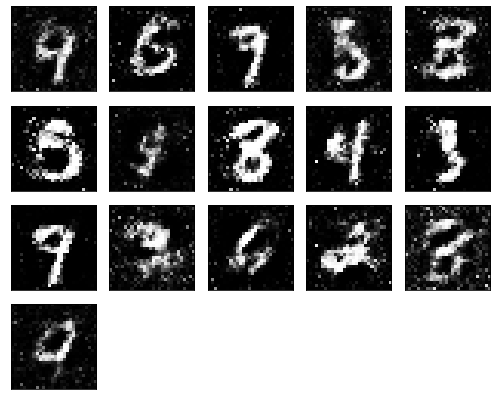

Epochs nb. 751
discriminator loss: 0.6384161114692688
generator loss : 0.8720729351043701

Epochs nb. 752
discriminator loss: 0.6607259511947632
generator loss : 0.848462700843811

Epochs nb. 753
discriminator loss: 0.6013473868370056
generator loss : 1.0585699081420898

Epochs nb. 754
discriminator loss: 0.495813250541687
generator loss : 1.1112895011901855

Epochs nb. 755
discriminator loss: 0.5534934997558594
generator loss : 0.9457990527153015

Epochs nb. 756
discriminator loss: 0.7435609698295593
generator loss : 0.9325157999992371

Epochs nb. 757
discriminator loss: 0.5420485138893127
generator loss : 0.94256991147995

Epochs nb. 758
discriminator loss: 0.6006567478179932
generator loss : 0.9543906450271606

Epochs nb. 759
discriminator loss: 0.6741283535957336
generator loss : 0.9517173767089844

Epochs nb. 760
discriminator loss: 0.5973392128944397
generator loss : 0.8711724281311035



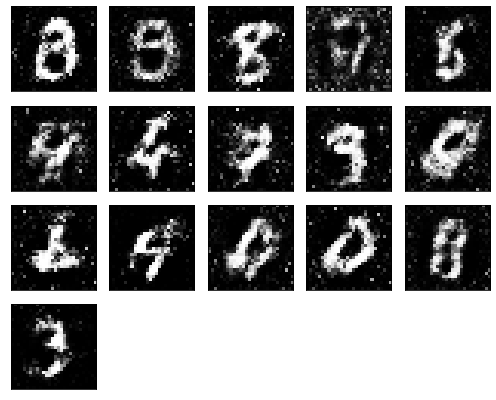

Epochs nb. 761
discriminator loss: 0.6414051651954651
generator loss : 0.9294196963310242

Epochs nb. 762
discriminator loss: 0.6221027374267578
generator loss : 0.8819950222969055

Epochs nb. 763
discriminator loss: 0.6292128562927246
generator loss : 0.8146145343780518

Epochs nb. 764
discriminator loss: 0.542334794998169
generator loss : 0.9126801490783691

Epochs nb. 765
discriminator loss: 0.5398589372634888
generator loss : 0.7321414947509766

Epochs nb. 766
discriminator loss: 0.7085250616073608
generator loss : 0.9979831576347351

Epochs nb. 767
discriminator loss: 0.6468023061752319
generator loss : 1.045531988143921

Epochs nb. 768
discriminator loss: 0.6982591152191162
generator loss : 1.016700029373169

Epochs nb. 769
discriminator loss: 0.48774629831314087
generator loss : 0.9275016188621521

Epochs nb. 770
discriminator loss: 0.5540817975997925
generator loss : 1.0057330131530762



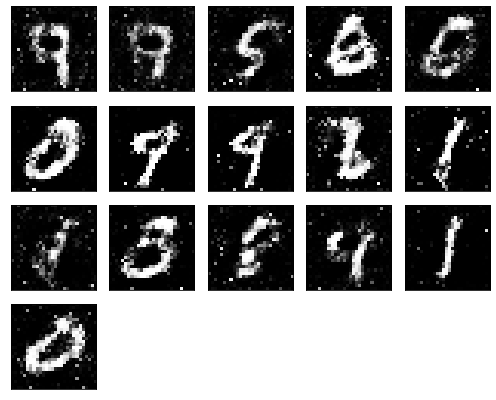

Epochs nb. 771
discriminator loss: 0.6034038066864014
generator loss : 0.9508320689201355

Epochs nb. 772
discriminator loss: 0.5676600337028503
generator loss : 0.9413825273513794

Epochs nb. 773
discriminator loss: 0.5417425632476807
generator loss : 0.889854371547699

Epochs nb. 774
discriminator loss: 0.6905758380889893
generator loss : 1.051285982131958

Epochs nb. 775
discriminator loss: 0.5201345682144165
generator loss : 1.0886040925979614

Epochs nb. 776
discriminator loss: 0.5533537864685059
generator loss : 0.9799139499664307

Epochs nb. 777
discriminator loss: 0.561569094657898
generator loss : 0.9590071439743042

Epochs nb. 778
discriminator loss: 0.6040592193603516
generator loss : 0.9358103275299072

Epochs nb. 779
discriminator loss: 0.5856095552444458
generator loss : 0.8972794413566589

Epochs nb. 780
discriminator loss: 0.5379574298858643
generator loss : 0.8785533905029297



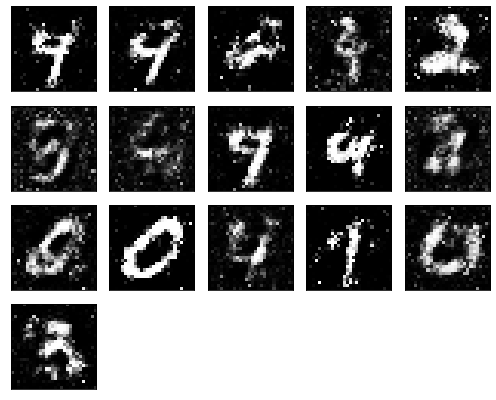

Epochs nb. 781
discriminator loss: 0.5976253151893616
generator loss : 0.8263900279998779

Epochs nb. 782
discriminator loss: 0.6159734129905701
generator loss : 0.9225428104400635

Epochs nb. 783
discriminator loss: 0.6353908777236938
generator loss : 0.9644221067428589

Epochs nb. 784
discriminator loss: 0.608795166015625
generator loss : 0.9196556210517883

Epochs nb. 785
discriminator loss: 0.5841274857521057
generator loss : 0.9476489424705505

Epochs nb. 786
discriminator loss: 0.598947286605835
generator loss : 0.9697831869125366

Epochs nb. 787
discriminator loss: 0.5102220773696899
generator loss : 0.8257112503051758

Epochs nb. 788
discriminator loss: 0.7032339572906494
generator loss : 0.8034398555755615

Epochs nb. 789
discriminator loss: 0.6113389730453491
generator loss : 0.7766317129135132

Epochs nb. 790
discriminator loss: 0.6718060970306396
generator loss : 0.8545085787773132



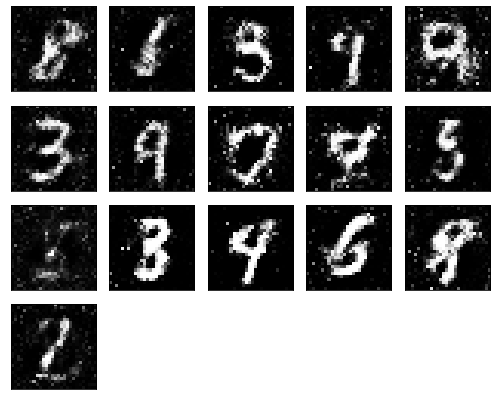

Epochs nb. 791
discriminator loss: 0.6581517457962036
generator loss : 0.7436627745628357

Epochs nb. 792
discriminator loss: 0.615696132183075
generator loss : 0.7930525541305542

Epochs nb. 793
discriminator loss: 0.5600005984306335
generator loss : 0.8424259424209595

Epochs nb. 794
discriminator loss: 0.577763557434082
generator loss : 0.8474206328392029

Epochs nb. 795
discriminator loss: 0.556022584438324
generator loss : 0.8999861478805542

Epochs nb. 796
discriminator loss: 0.6859450340270996
generator loss : 0.8913557529449463

Epochs nb. 797
discriminator loss: 0.579925537109375
generator loss : 0.7440212965011597

Epochs nb. 798
discriminator loss: 0.5899952054023743
generator loss : 0.8070707321166992

Epochs nb. 799
discriminator loss: 0.6534309983253479
generator loss : 0.963066577911377

Epochs nb. 800
discriminator loss: 0.6528563499450684
generator loss : 0.9138092994689941



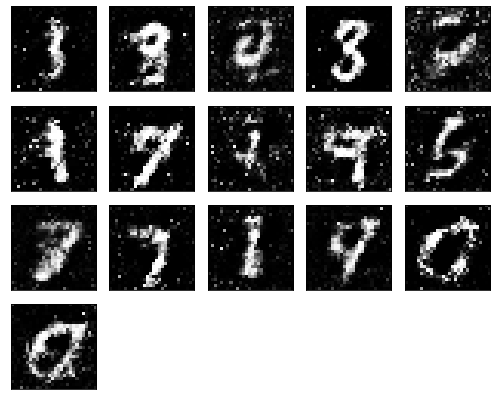

Epochs nb. 801
discriminator loss: 0.6442002058029175
generator loss : 0.8753353953361511

Epochs nb. 802
discriminator loss: 0.5403593182563782
generator loss : 0.9186000227928162

Epochs nb. 803
discriminator loss: 0.6719107627868652
generator loss : 0.8791311383247375

Epochs nb. 804
discriminator loss: 0.5574157238006592
generator loss : 0.988457202911377

Epochs nb. 805
discriminator loss: 0.5639608502388
generator loss : 0.9343892335891724

Epochs nb. 806
discriminator loss: 0.6148264408111572
generator loss : 0.9451411366462708

Epochs nb. 807
discriminator loss: 0.7199006080627441
generator loss : 1.1973719596862793

Epochs nb. 808
discriminator loss: 0.6512441635131836
generator loss : 0.9044866561889648

Epochs nb. 809
discriminator loss: 0.6595385074615479
generator loss : 0.9448343515396118

Epochs nb. 810
discriminator loss: 0.5436208844184875
generator loss : 1.0198254585266113



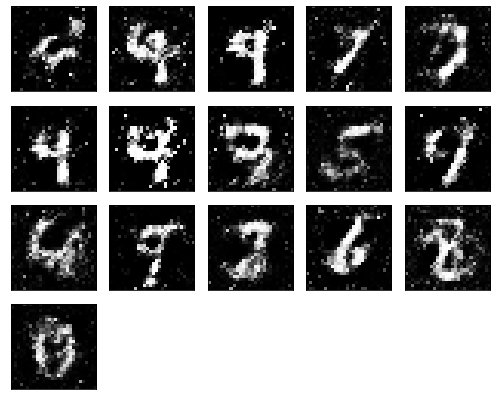

Epochs nb. 811
discriminator loss: 0.6415674686431885
generator loss : 0.9137482643127441

Epochs nb. 812
discriminator loss: 0.5972514152526855
generator loss : 0.8700425624847412

Epochs nb. 813
discriminator loss: 0.6385869979858398
generator loss : 0.9647382497787476

Epochs nb. 814
discriminator loss: 0.5903705954551697
generator loss : 1.0106260776519775

Epochs nb. 815
discriminator loss: 0.6278142333030701
generator loss : 0.943321704864502

Epochs nb. 816
discriminator loss: 0.5323517322540283
generator loss : 0.9911419153213501

Epochs nb. 817
discriminator loss: 0.6033071279525757
generator loss : 0.9574543237686157

Epochs nb. 818
discriminator loss: 0.5300208330154419
generator loss : 0.9990832805633545

Epochs nb. 819
discriminator loss: 0.5793654918670654
generator loss : 0.9804062843322754

Epochs nb. 820
discriminator loss: 0.5499176383018494
generator loss : 1.0275722742080688



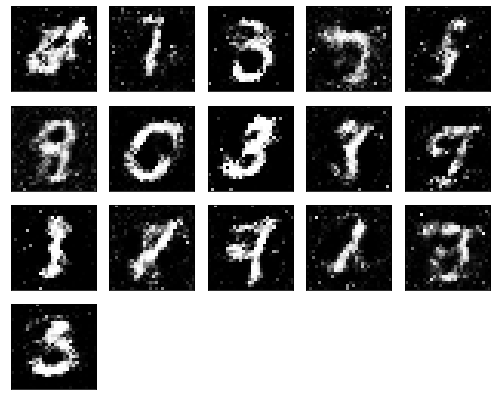

Epochs nb. 821
discriminator loss: 0.575187623500824
generator loss : 0.9102386832237244

Epochs nb. 822
discriminator loss: 0.5514291524887085
generator loss : 0.9311249256134033

Epochs nb. 823
discriminator loss: 0.5352061986923218
generator loss : 1.0432368516921997

Epochs nb. 824
discriminator loss: 0.5905384421348572
generator loss : 1.0391191244125366

Epochs nb. 825
discriminator loss: 0.6568657755851746
generator loss : 1.0456842184066772

Epochs nb. 826
discriminator loss: 0.5284025073051453
generator loss : 0.9739324450492859

Epochs nb. 827
discriminator loss: 0.5418679714202881
generator loss : 0.933555006980896

Epochs nb. 828
discriminator loss: 0.5709787011146545
generator loss : 0.9701342582702637

Epochs nb. 829
discriminator loss: 0.6423223614692688
generator loss : 0.9394371509552002

Epochs nb. 830
discriminator loss: 0.6555753350257874
generator loss : 0.9324048161506653



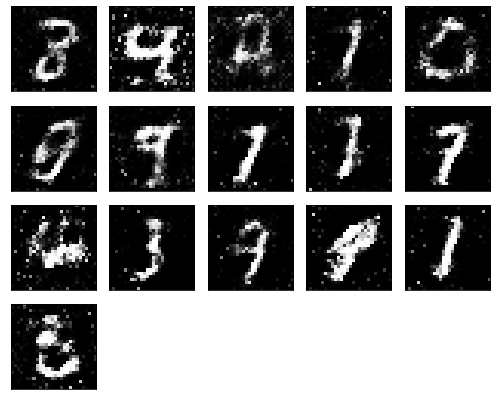

Epochs nb. 831
discriminator loss: 0.5681642293930054
generator loss : 1.024206280708313

Epochs nb. 832
discriminator loss: 0.6333556175231934
generator loss : 0.9720888733863831

Epochs nb. 833
discriminator loss: 0.6391106247901917
generator loss : 0.8867348432540894

Epochs nb. 834
discriminator loss: 0.5345698595046997
generator loss : 0.8997716307640076

Epochs nb. 835
discriminator loss: 0.5869708061218262
generator loss : 0.9469728469848633

Epochs nb. 836
discriminator loss: 0.7370513677597046
generator loss : 0.8878293037414551

Epochs nb. 837
discriminator loss: 0.5960462093353271
generator loss : 0.8292441964149475

Epochs nb. 838
discriminator loss: 0.5571892857551575
generator loss : 0.9940111041069031

Epochs nb. 839
discriminator loss: 0.5688356757164001
generator loss : 0.9466478824615479

Epochs nb. 840
discriminator loss: 0.6188081502914429
generator loss : 1.0525184869766235



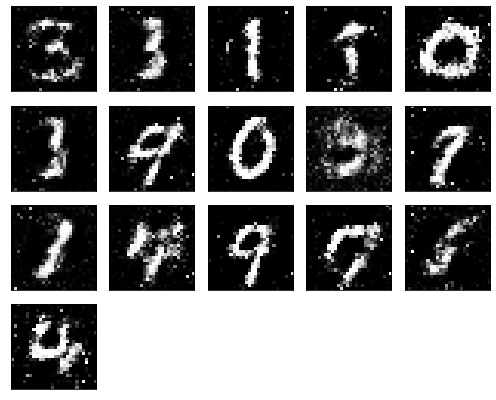

Epochs nb. 841
discriminator loss: 0.5299915075302124
generator loss : 1.0650184154510498

Epochs nb. 842
discriminator loss: 0.5444738268852234
generator loss : 0.8341178297996521

Epochs nb. 843
discriminator loss: 0.7189089059829712
generator loss : 0.8169220089912415

Epochs nb. 844
discriminator loss: 0.6962032318115234
generator loss : 0.855885922908783

Epochs nb. 845
discriminator loss: 0.5508785247802734
generator loss : 0.8784533739089966

Epochs nb. 846
discriminator loss: 0.6114215850830078
generator loss : 0.9473357200622559

Epochs nb. 847
discriminator loss: 0.599148154258728
generator loss : 0.9418066740036011

Epochs nb. 848
discriminator loss: 0.5273878574371338
generator loss : 0.8760181665420532

Epochs nb. 849
discriminator loss: 0.4883289635181427
generator loss : 0.9388728141784668

Epochs nb. 850
discriminator loss: 0.5863246917724609
generator loss : 0.9036641716957092



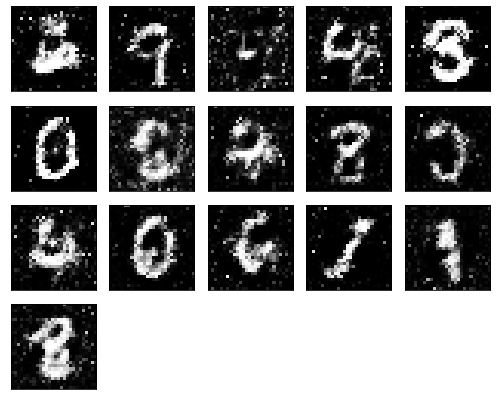

Epochs nb. 851
discriminator loss: 0.5186591148376465
generator loss : 0.854151725769043

Epochs nb. 852
discriminator loss: 0.554462194442749
generator loss : 0.8120065927505493

Epochs nb. 853
discriminator loss: 0.6252148151397705
generator loss : 0.9953637719154358

Epochs nb. 854
discriminator loss: 0.575133204460144
generator loss : 1.0136748552322388

Epochs nb. 855
discriminator loss: 0.6103992462158203
generator loss : 0.9730691313743591

Epochs nb. 856
discriminator loss: 0.6148877143859863
generator loss : 1.0267558097839355

Epochs nb. 857
discriminator loss: 0.5975949764251709
generator loss : 0.9828118085861206

Epochs nb. 858
discriminator loss: 0.6831313371658325
generator loss : 0.9185770153999329

Epochs nb. 859
discriminator loss: 0.5325741767883301
generator loss : 1.0029239654541016

Epochs nb. 860
discriminator loss: 0.7457854151725769
generator loss : 0.8964883685112



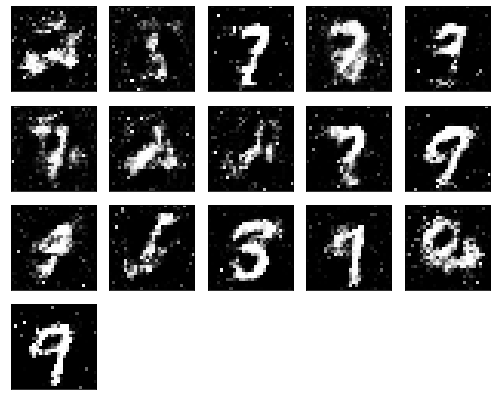

Epochs nb. 861
discriminator loss: 0.5451421737670898
generator loss : 0.9412567615509033

Epochs nb. 862
discriminator loss: 0.7675039768218994
generator loss : 1.0007514953613281

Epochs nb. 863
discriminator loss: 0.5565932393074036
generator loss : 1.057687759399414

Epochs nb. 864
discriminator loss: 0.5104547739028931
generator loss : 0.9289507865905762

Epochs nb. 865
discriminator loss: 0.6459542512893677
generator loss : 0.8389438390731812

Epochs nb. 866
discriminator loss: 0.5860942602157593
generator loss : 0.820464015007019

Epochs nb. 867
discriminator loss: 0.5770959854125977
generator loss : 0.9635348320007324

Epochs nb. 868
discriminator loss: 0.6525136828422546
generator loss : 0.8001574277877808

Epochs nb. 869
discriminator loss: 0.5140280723571777
generator loss : 0.9810426235198975

Epochs nb. 870
discriminator loss: 0.6888251304626465
generator loss : 1.0599820613861084



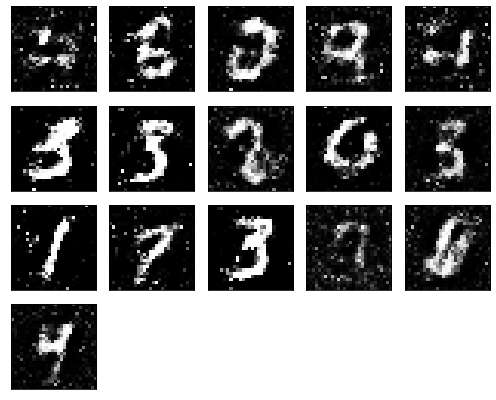

Epochs nb. 871
discriminator loss: 0.6325387954711914
generator loss : 1.0235793590545654

Epochs nb. 872
discriminator loss: 0.5869162082672119
generator loss : 1.1525118350982666

Epochs nb. 873
discriminator loss: 0.592491865158081
generator loss : 0.9206084609031677

Epochs nb. 874
discriminator loss: 0.6413118243217468
generator loss : 0.9359753727912903

Epochs nb. 875
discriminator loss: 0.5950583815574646
generator loss : 0.9311959743499756

Epochs nb. 876
discriminator loss: 0.6260560750961304
generator loss : 0.9593083262443542

Epochs nb. 877
discriminator loss: 0.7000174522399902
generator loss : 0.9658766984939575

Epochs nb. 878
discriminator loss: 0.6324288845062256
generator loss : 0.8844595551490784

Epochs nb. 879
discriminator loss: 0.5592060089111328
generator loss : 0.7847676277160645

Epochs nb. 880
discriminator loss: 0.5510169267654419
generator loss : 0.929814338684082



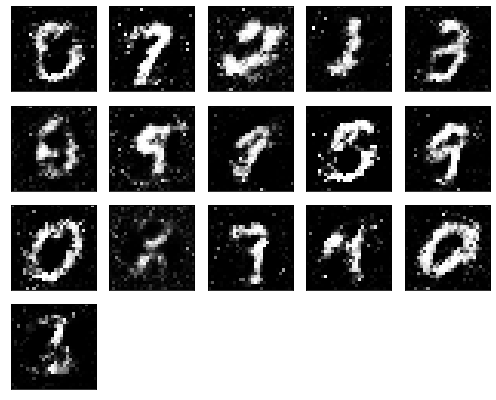

Epochs nb. 881
discriminator loss: 0.5560204982757568
generator loss : 0.9939575791358948

Epochs nb. 882
discriminator loss: 0.5343108773231506
generator loss : 0.8525309562683105

Epochs nb. 883
discriminator loss: 0.646896243095398
generator loss : 0.8094682693481445

Epochs nb. 884
discriminator loss: 0.5992996096611023
generator loss : 0.893683910369873

Epochs nb. 885
discriminator loss: 0.5359014272689819
generator loss : 0.8052093982696533

Epochs nb. 886
discriminator loss: 0.5319818258285522
generator loss : 0.8967914581298828

Epochs nb. 887
discriminator loss: 0.7120275497436523
generator loss : 0.7890430688858032

Epochs nb. 888
discriminator loss: 0.5755795240402222
generator loss : 0.9592267274856567

Epochs nb. 889
discriminator loss: 0.558996319770813
generator loss : 0.9173226356506348

Epochs nb. 890
discriminator loss: 0.5364059805870056
generator loss : 0.6971479654312134



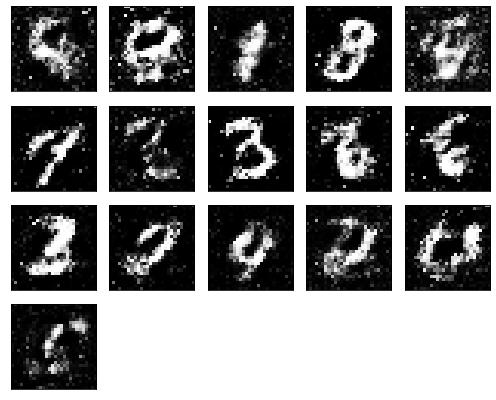

Epochs nb. 891
discriminator loss: 0.7525134086608887
generator loss : 0.9081733226776123

Epochs nb. 892
discriminator loss: 0.6483792066574097
generator loss : 0.8826572895050049

Epochs nb. 893
discriminator loss: 0.6294445991516113
generator loss : 0.829094648361206

Epochs nb. 894
discriminator loss: 0.5748694539070129
generator loss : 0.8224847316741943

Epochs nb. 895
discriminator loss: 0.5329979658126831
generator loss : 0.7028125524520874

Epochs nb. 896
discriminator loss: 0.6550693511962891
generator loss : 0.8910611271858215

Epochs nb. 897
discriminator loss: 0.5914925336837769
generator loss : 0.9846788048744202

Epochs nb. 898
discriminator loss: 0.703771710395813
generator loss : 1.0161834955215454

Epochs nb. 899
discriminator loss: 0.5249584913253784
generator loss : 0.7890759110450745

Epochs nb. 900
discriminator loss: 0.7042238116264343
generator loss : 0.8498439788818359



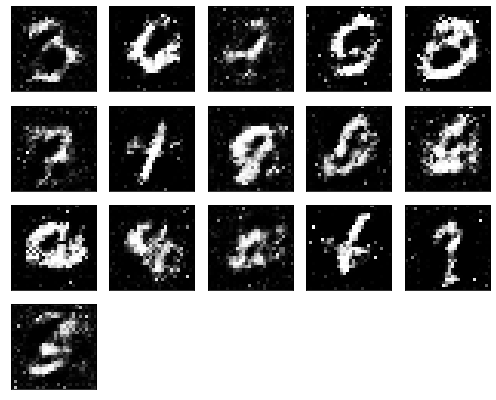

Epochs nb. 901
discriminator loss: 0.7637711763381958
generator loss : 0.7995574474334717

Epochs nb. 902
discriminator loss: 0.5661521553993225
generator loss : 0.8217706680297852

Epochs nb. 903
discriminator loss: 0.5394587516784668
generator loss : 0.7960896492004395

Epochs nb. 904
discriminator loss: 0.5941078662872314
generator loss : 1.074650526046753

Epochs nb. 905
discriminator loss: 0.6081113219261169
generator loss : 0.9514549970626831

Epochs nb. 906
discriminator loss: 0.5952660441398621
generator loss : 0.8595615029335022

Epochs nb. 907
discriminator loss: 0.5797927379608154
generator loss : 0.7324869632720947

Epochs nb. 908
discriminator loss: 0.7409632205963135
generator loss : 0.9459653496742249

Epochs nb. 909
discriminator loss: 0.6756993532180786
generator loss : 0.8748220205307007

Epochs nb. 910
discriminator loss: 0.6061350107192993
generator loss : 0.850883424282074



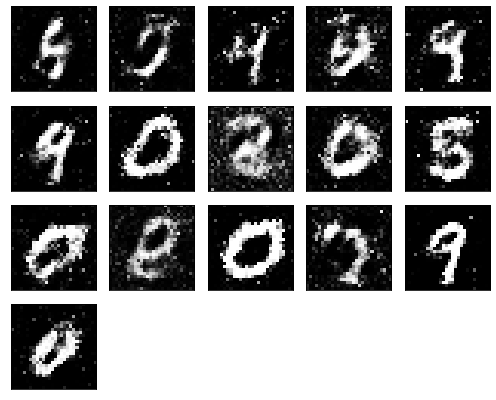

Epochs nb. 911
discriminator loss: 0.6820412874221802
generator loss : 0.9234211444854736

Epochs nb. 912
discriminator loss: 0.568084180355072
generator loss : 0.8888813257217407

Epochs nb. 913
discriminator loss: 0.6227877736091614
generator loss : 1.0123262405395508

Epochs nb. 914
discriminator loss: 0.5651620030403137
generator loss : 0.9753645658493042

Epochs nb. 915
discriminator loss: 0.5370380878448486
generator loss : 1.0561493635177612

Epochs nb. 916
discriminator loss: 0.48611900210380554
generator loss : 1.0978503227233887

Epochs nb. 917
discriminator loss: 0.561725378036499
generator loss : 1.0095984935760498

Epochs nb. 918
discriminator loss: 0.5194830894470215
generator loss : 0.769303023815155

Epochs nb. 919
discriminator loss: 0.648390531539917
generator loss : 0.9910362362861633

Epochs nb. 920
discriminator loss: 0.6285141110420227
generator loss : 0.9113174676895142



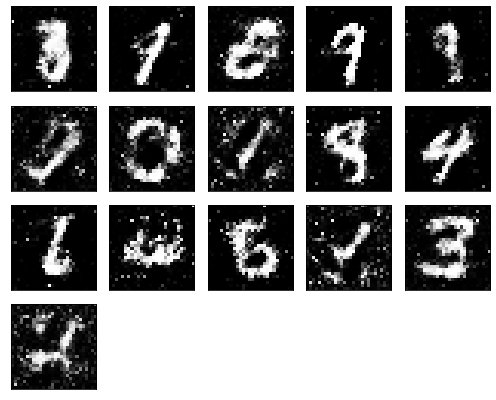

Epochs nb. 921
discriminator loss: 0.586211085319519
generator loss : 0.8798273205757141

Epochs nb. 922
discriminator loss: 0.6311542987823486
generator loss : 0.9193337559700012

Epochs nb. 923
discriminator loss: 0.5536386966705322
generator loss : 1.006868839263916

Epochs nb. 924
discriminator loss: 0.5555527210235596
generator loss : 0.892428457736969

Epochs nb. 925
discriminator loss: 0.6815235614776611
generator loss : 0.994575023651123

Epochs nb. 926
discriminator loss: 0.6305050849914551
generator loss : 0.8261665105819702

Epochs nb. 927
discriminator loss: 0.5342376232147217
generator loss : 0.9294580221176147

Epochs nb. 928
discriminator loss: 0.6296839714050293
generator loss : 0.9354586005210876

Epochs nb. 929
discriminator loss: 0.6325556039810181
generator loss : 0.8183432817459106

Epochs nb. 930
discriminator loss: 0.6119396090507507
generator loss : 1.0012104511260986



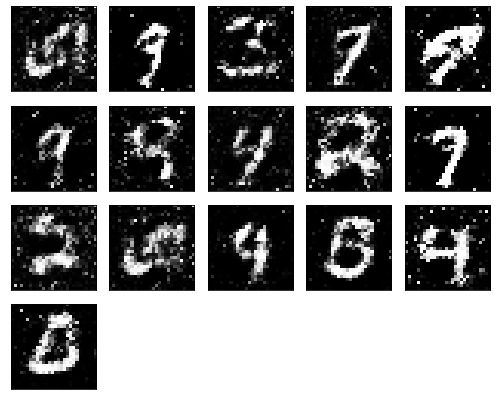

Epochs nb. 931
discriminator loss: 0.49576547741889954
generator loss : 0.9850852489471436

Epochs nb. 932
discriminator loss: 0.5817083120346069
generator loss : 1.0567142963409424

Epochs nb. 933
discriminator loss: 0.6024653911590576
generator loss : 1.0196008682250977

Epochs nb. 934
discriminator loss: 0.47241175174713135
generator loss : 0.8518595695495605

Epochs nb. 935
discriminator loss: 0.6167643070220947
generator loss : 0.860313892364502

Epochs nb. 936
discriminator loss: 0.6105756759643555
generator loss : 0.7147579193115234

Epochs nb. 937
discriminator loss: 0.5582732558250427
generator loss : 0.840463399887085

Epochs nb. 938
discriminator loss: 0.7428947687149048
generator loss : 0.994451105594635

Epochs nb. 939
discriminator loss: 0.5475174784660339
generator loss : 0.9376484155654907

Epochs nb. 940
discriminator loss: 0.5878120064735413
generator loss : 0.8657740354537964



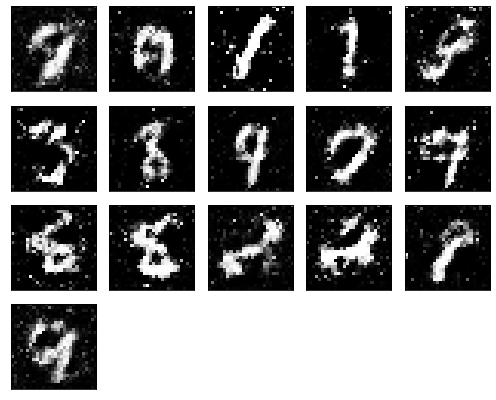

Epochs nb. 941
discriminator loss: 0.6411644220352173
generator loss : 0.9111699461936951

Epochs nb. 942
discriminator loss: 0.4753701686859131
generator loss : 0.8659067153930664

Epochs nb. 943
discriminator loss: 0.5080234408378601
generator loss : 0.8035110235214233

Epochs nb. 944
discriminator loss: 0.5679330825805664
generator loss : 0.8309963941574097

Epochs nb. 945
discriminator loss: 0.703260064125061
generator loss : 0.8555874824523926

Epochs nb. 946
discriminator loss: 0.5191186666488647
generator loss : 1.0873864889144897

Epochs nb. 947
discriminator loss: 0.8024358153343201
generator loss : 1.028043508529663

Epochs nb. 948
discriminator loss: 0.5241928100585938
generator loss : 1.0352962017059326

Epochs nb. 949
discriminator loss: 0.5146944522857666
generator loss : 0.9513530135154724

Epochs nb. 950
discriminator loss: 0.577190637588501
generator loss : 1.066556453704834



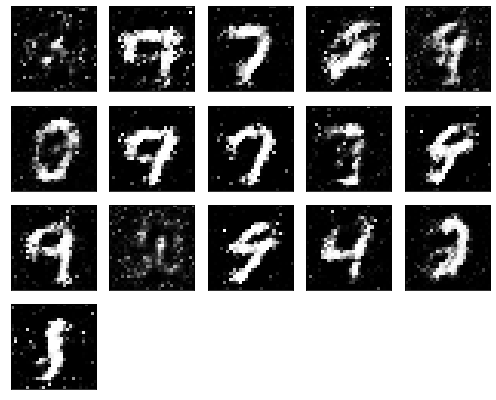

Epochs nb. 951
discriminator loss: 0.7163788080215454
generator loss : 0.8917850852012634

Epochs nb. 952
discriminator loss: 0.6345288753509521
generator loss : 1.017457127571106

Epochs nb. 953
discriminator loss: 0.5399870872497559
generator loss : 1.023300290107727

Epochs nb. 954
discriminator loss: 0.6457669734954834
generator loss : 0.9199144244194031

Epochs nb. 955
discriminator loss: 0.5699859857559204
generator loss : 1.0081977844238281

Epochs nb. 956
discriminator loss: 0.643222451210022
generator loss : 1.0086497068405151

Epochs nb. 957
discriminator loss: 0.6179364919662476
generator loss : 0.9682859182357788

Epochs nb. 958
discriminator loss: 0.574074387550354
generator loss : 1.0104105472564697

Epochs nb. 959
discriminator loss: 0.6116880178451538
generator loss : 1.0021741390228271

Epochs nb. 960
discriminator loss: 0.6681193113327026
generator loss : 0.9797384738922119



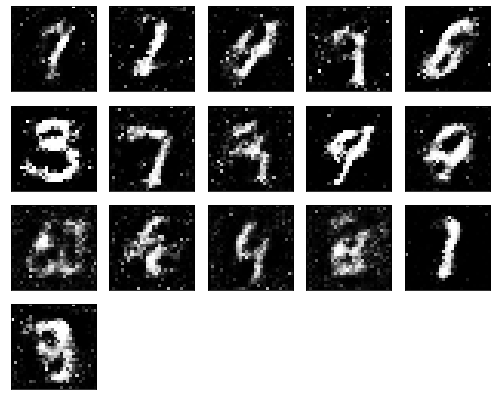

Epochs nb. 961
discriminator loss: 0.6647040843963623
generator loss : 0.9734073877334595

Epochs nb. 962
discriminator loss: 0.5790516138076782
generator loss : 0.9878628849983215

Epochs nb. 963
discriminator loss: 0.5923370718955994
generator loss : 0.8668274879455566

Epochs nb. 964
discriminator loss: 0.6613768339157104
generator loss : 0.9027671217918396

Epochs nb. 965
discriminator loss: 0.5989046692848206
generator loss : 0.890805721282959

Epochs nb. 966
discriminator loss: 0.7106860876083374
generator loss : 1.0115535259246826

Epochs nb. 967
discriminator loss: 0.5245563983917236
generator loss : 0.8575668334960938

Epochs nb. 968
discriminator loss: 0.651357114315033
generator loss : 0.859586775302887

Epochs nb. 969
discriminator loss: 0.6620383262634277
generator loss : 0.858659029006958

Epochs nb. 970
discriminator loss: 0.550782322883606
generator loss : 0.8824130892753601



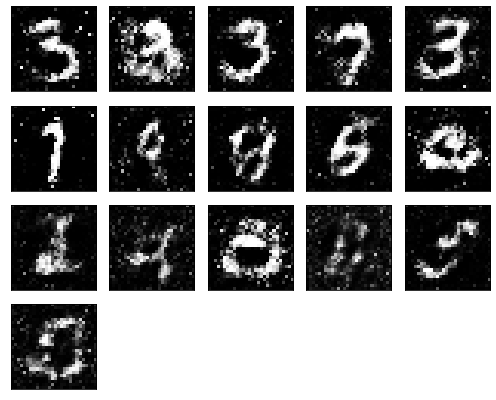

Epochs nb. 971
discriminator loss: 0.609145998954773
generator loss : 0.9948859214782715

Epochs nb. 972
discriminator loss: 0.5554208755493164
generator loss : 0.8491424322128296

Epochs nb. 973
discriminator loss: 0.5946706533432007
generator loss : 0.8878910541534424

Epochs nb. 974
discriminator loss: 0.6226025819778442
generator loss : 0.9258794784545898

Epochs nb. 975
discriminator loss: 0.63211590051651
generator loss : 0.9017185568809509

Epochs nb. 976
discriminator loss: 0.5490846633911133
generator loss : 0.8675855994224548

Epochs nb. 977
discriminator loss: 0.5917041301727295
generator loss : 1.0830051898956299

Epochs nb. 978
discriminator loss: 0.6114382743835449
generator loss : 1.0078893899917603

Epochs nb. 979
discriminator loss: 0.6139090061187744
generator loss : 0.8428760170936584

Epochs nb. 980
discriminator loss: 0.492522269487381
generator loss : 0.836333692073822



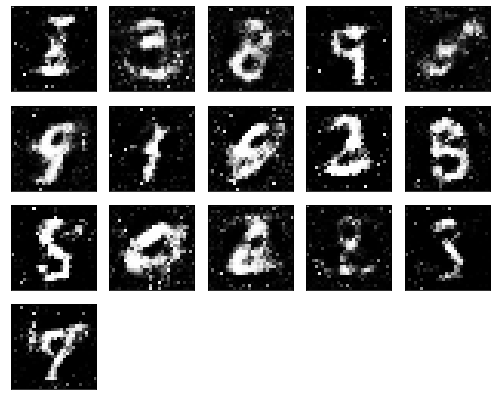

Epochs nb. 981
discriminator loss: 0.6217923760414124
generator loss : 0.8958528637886047

Epochs nb. 982
discriminator loss: 0.5304098725318909
generator loss : 0.8217043876647949

Epochs nb. 983
discriminator loss: 0.5578405261039734
generator loss : 0.8442559242248535

Epochs nb. 984
discriminator loss: 0.6141514778137207
generator loss : 1.0367848873138428

Epochs nb. 985
discriminator loss: 0.7141391038894653
generator loss : 1.0396831035614014

Epochs nb. 986
discriminator loss: 0.6416342854499817
generator loss : 1.0734074115753174

Epochs nb. 987
discriminator loss: 0.6030125617980957
generator loss : 0.9889277219772339

Epochs nb. 988
discriminator loss: 0.6076405048370361
generator loss : 1.0300514698028564

Epochs nb. 989
discriminator loss: 0.6177991628646851
generator loss : 0.917523980140686

Epochs nb. 990
discriminator loss: 0.6115270853042603
generator loss : 1.0119974613189697



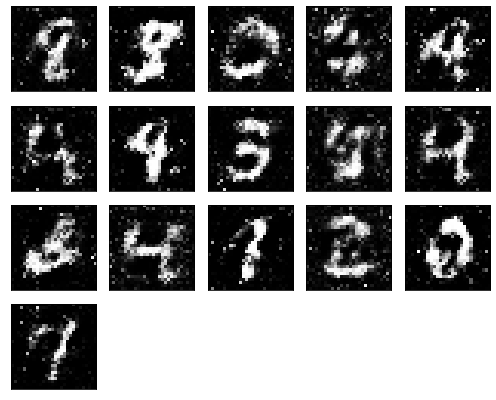

Epochs nb. 991
discriminator loss: 0.5892232656478882
generator loss : 1.0242090225219727

Epochs nb. 992
discriminator loss: 0.45089226961135864
generator loss : 0.8601027727127075

Epochs nb. 993
discriminator loss: 0.6011173725128174
generator loss : 1.0745149850845337

Epochs nb. 994
discriminator loss: 0.8049455285072327
generator loss : 1.0141360759735107

Epochs nb. 995
discriminator loss: 0.6362459659576416
generator loss : 0.9039918780326843

Epochs nb. 996
discriminator loss: 0.5894080400466919
generator loss : 1.0266574621200562

Epochs nb. 997
discriminator loss: 0.5736199617385864
generator loss : 1.0255018472671509

Epochs nb. 998
discriminator loss: 0.5002334117889404
generator loss : 1.0220128297805786

Epochs nb. 999
discriminator loss: 0.6127742528915405
generator loss : 0.9066152572631836

Epochs nb. 1000
discriminator loss: 0.5262205600738525
generator loss : 0.817916750907898



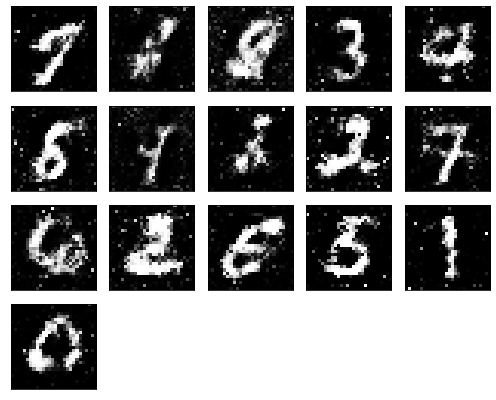

Epochs nb. 1001
discriminator loss: 0.5969198942184448
generator loss : 0.9079849720001221

Epochs nb. 1002
discriminator loss: 0.5242075324058533
generator loss : 0.8907268643379211

Epochs nb. 1003
discriminator loss: 0.608264684677124
generator loss : 0.9585439562797546

Epochs nb. 1004
discriminator loss: 0.585362434387207
generator loss : 0.9295729994773865

Epochs nb. 1005
discriminator loss: 0.679693877696991
generator loss : 0.8700083494186401

Epochs nb. 1006
discriminator loss: 0.5380142331123352
generator loss : 0.8760398626327515

Epochs nb. 1007
discriminator loss: 0.4951576292514801
generator loss : 0.8902714252471924

Epochs nb. 1008
discriminator loss: 0.4972617030143738
generator loss : 0.8822330832481384

Epochs nb. 1009
discriminator loss: 0.6157480478286743
generator loss : 0.9558745622634888

Epochs nb. 1010
discriminator loss: 0.5822497606277466
generator loss : 0.883760929107666



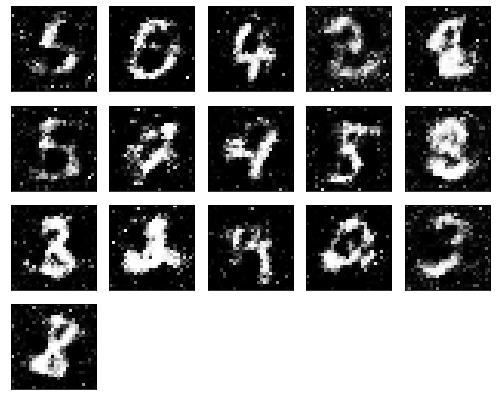

Epochs nb. 1011
discriminator loss: 0.605785608291626
generator loss : 0.9028461575508118

Epochs nb. 1012
discriminator loss: 0.5678538084030151
generator loss : 0.891334593296051

Epochs nb. 1013
discriminator loss: 0.5284372568130493
generator loss : 0.8803847432136536

Epochs nb. 1014
discriminator loss: 0.5636156797409058
generator loss : 0.9253559708595276

Epochs nb. 1015
discriminator loss: 0.5531634092330933
generator loss : 0.910319447517395

Epochs nb. 1016
discriminator loss: 0.6775909662246704
generator loss : 0.8608270883560181

Epochs nb. 1017
discriminator loss: 0.6199078559875488
generator loss : 0.8842604756355286

Epochs nb. 1018
discriminator loss: 0.6256957650184631
generator loss : 0.9098386764526367

Epochs nb. 1019
discriminator loss: 0.5478379726409912
generator loss : 0.9188292622566223

Epochs nb. 1020
discriminator loss: 0.6297561526298523
generator loss : 1.0376503467559814



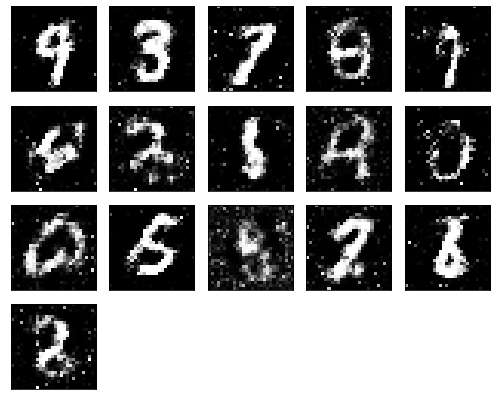

Epochs nb. 1021
discriminator loss: 0.5926216244697571
generator loss : 0.9777461886405945

Epochs nb. 1022
discriminator loss: 0.6625272035598755
generator loss : 1.067606806755066

Epochs nb. 1023
discriminator loss: 0.6839393377304077
generator loss : 1.1427369117736816

Epochs nb. 1024
discriminator loss: 0.5336990356445312
generator loss : 0.8457714319229126

Epochs nb. 1025
discriminator loss: 0.5676454305648804
generator loss : 0.8475360870361328

Epochs nb. 1026
discriminator loss: 0.6352247595787048
generator loss : 0.8508111238479614

Epochs nb. 1027
discriminator loss: 0.6364920735359192
generator loss : 0.9412840604782104

Epochs nb. 1028
discriminator loss: 0.6598941087722778
generator loss : 0.9960302114486694

Epochs nb. 1029
discriminator loss: 0.624646782875061
generator loss : 0.8927101492881775

Epochs nb. 1030
discriminator loss: 0.610668420791626
generator loss : 0.6621772050857544



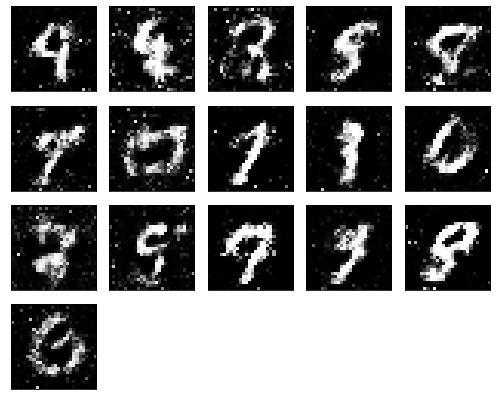

Epochs nb. 1031
discriminator loss: 0.7190722227096558
generator loss : 0.8878867626190186

Epochs nb. 1032
discriminator loss: 0.6354634761810303
generator loss : 0.8557629585266113

Epochs nb. 1033
discriminator loss: 0.6794424653053284
generator loss : 0.9666664600372314

Epochs nb. 1034
discriminator loss: 0.5582699775695801
generator loss : 0.9979211688041687

Epochs nb. 1035
discriminator loss: 0.6150951385498047
generator loss : 1.0196964740753174

Epochs nb. 1036
discriminator loss: 0.6446114182472229
generator loss : 0.8339313268661499

Epochs nb. 1037
discriminator loss: 0.5254079103469849
generator loss : 1.0447700023651123

Epochs nb. 1038
discriminator loss: 0.6059747934341431
generator loss : 0.9416764974594116

Epochs nb. 1039
discriminator loss: 0.5432620048522949
generator loss : 0.8887851238250732

Epochs nb. 1040
discriminator loss: 0.671217679977417
generator loss : 0.8773931264877319



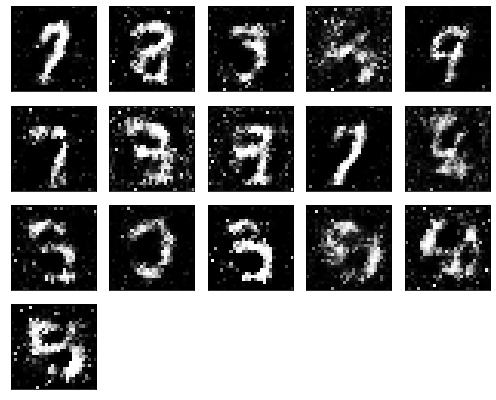

Epochs nb. 1041
discriminator loss: 0.5646497011184692
generator loss : 0.7975150346755981

Epochs nb. 1042
discriminator loss: 0.5409034490585327
generator loss : 0.7774544358253479

Epochs nb. 1043
discriminator loss: 0.5170315504074097
generator loss : 0.8070917129516602

Epochs nb. 1044
discriminator loss: 0.5746017694473267
generator loss : 0.8441113233566284

Epochs nb. 1045
discriminator loss: 0.5214791297912598
generator loss : 0.7977249622344971

Epochs nb. 1046
discriminator loss: 0.6115185022354126
generator loss : 0.976138710975647

Epochs nb. 1047
discriminator loss: 0.5743424892425537
generator loss : 0.7780554294586182

Epochs nb. 1048
discriminator loss: 0.5849112868309021
generator loss : 0.8903822898864746

Epochs nb. 1049
discriminator loss: 0.5140687227249146
generator loss : 0.963239312171936

Epochs nb. 1050
discriminator loss: 0.5020244717597961
generator loss : 0.9719901084899902



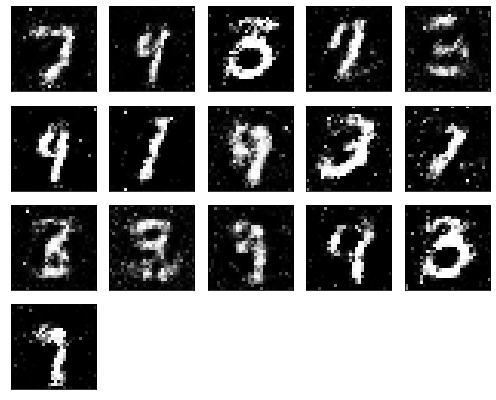

Epochs nb. 1051
discriminator loss: 0.5941690802574158
generator loss : 0.8718452453613281

Epochs nb. 1052
discriminator loss: 0.6006277799606323
generator loss : 0.9170623421669006

Epochs nb. 1053
discriminator loss: 0.5791651010513306
generator loss : 0.736911416053772

Epochs nb. 1054
discriminator loss: 0.6112115383148193
generator loss : 0.8332486152648926

Epochs nb. 1055
discriminator loss: 0.6985917091369629
generator loss : 0.9875444173812866

Epochs nb. 1056
discriminator loss: 0.5313156843185425
generator loss : 0.807698130607605

Epochs nb. 1057
discriminator loss: 0.6741472482681274
generator loss : 0.941207766532898

Epochs nb. 1058
discriminator loss: 0.7750764489173889
generator loss : 0.8750312328338623

Epochs nb. 1059
discriminator loss: 0.5933076739311218
generator loss : 0.7186082601547241

Epochs nb. 1060
discriminator loss: 0.6711480021476746
generator loss : 0.9571118354797363



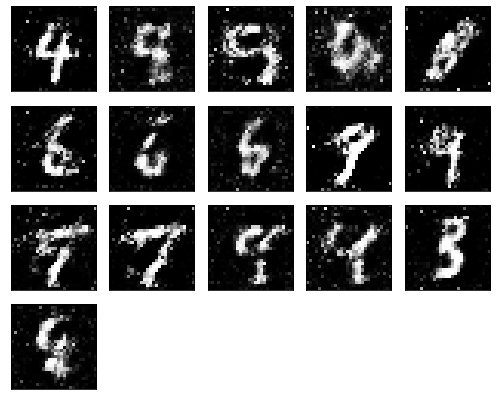

Epochs nb. 1061
discriminator loss: 0.6020902991294861
generator loss : 0.9231609106063843

Epochs nb. 1062
discriminator loss: 0.6419713497161865
generator loss : 0.9506881237030029

Epochs nb. 1063
discriminator loss: 0.4889090955257416
generator loss : 0.9464031457901001

Epochs nb. 1064
discriminator loss: 0.5919341444969177
generator loss : 0.9613734483718872

Epochs nb. 1065
discriminator loss: 0.5643140077590942
generator loss : 0.9139935374259949

Epochs nb. 1066
discriminator loss: 0.5649358630180359
generator loss : 0.875112771987915

Epochs nb. 1067
discriminator loss: 0.574631929397583
generator loss : 0.9379647374153137

Epochs nb. 1068
discriminator loss: 0.6005294919013977
generator loss : 0.9827007055282593

Epochs nb. 1069
discriminator loss: 0.619219958782196
generator loss : 0.8355214595794678

Epochs nb. 1070
discriminator loss: 0.7035649418830872
generator loss : 0.9103330373764038



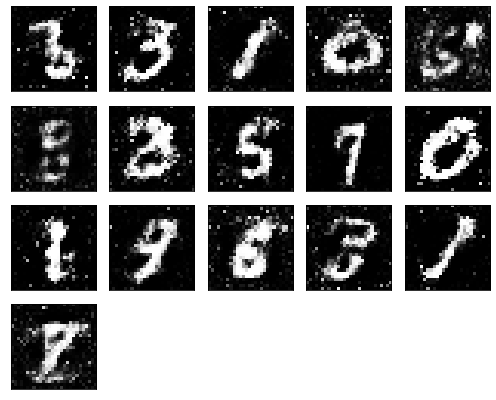

Epochs nb. 1071
discriminator loss: 0.6008045673370361
generator loss : 0.882701575756073

Epochs nb. 1072
discriminator loss: 0.7164795398712158
generator loss : 0.8564987182617188

Epochs nb. 1073
discriminator loss: 0.6409616470336914
generator loss : 0.8995079398155212

Epochs nb. 1074
discriminator loss: 0.5606450438499451
generator loss : 0.8640915155410767

Epochs nb. 1075
discriminator loss: 0.587928295135498
generator loss : 0.8173794150352478

Epochs nb. 1076
discriminator loss: 0.5382381677627563
generator loss : 0.8725394010543823

Epochs nb. 1077
discriminator loss: 0.5475310683250427
generator loss : 0.917220950126648

Epochs nb. 1078
discriminator loss: 0.6107544898986816
generator loss : 1.0252363681793213

Epochs nb. 1079
discriminator loss: 0.5255848169326782
generator loss : 1.0102651119232178

Epochs nb. 1080
discriminator loss: 0.5772478580474854
generator loss : 0.8987228274345398



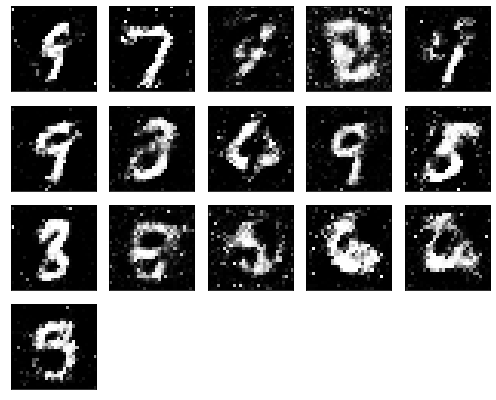

Epochs nb. 1081
discriminator loss: 0.6985363364219666
generator loss : 0.9273721575737

Epochs nb. 1082
discriminator loss: 0.7242358326911926
generator loss : 1.014012336730957

Epochs nb. 1083
discriminator loss: 0.5584298968315125
generator loss : 1.0205820798873901

Epochs nb. 1084
discriminator loss: 0.6492229700088501
generator loss : 0.9792132377624512

Epochs nb. 1085
discriminator loss: 0.5762712955474854
generator loss : 1.100890874862671

Epochs nb. 1086
discriminator loss: 0.6597120761871338
generator loss : 1.1436599493026733

Epochs nb. 1087
discriminator loss: 0.7553322315216064
generator loss : 1.0022927522659302

Epochs nb. 1088
discriminator loss: 0.6258796453475952
generator loss : 0.9926682114601135

Epochs nb. 1089
discriminator loss: 0.5222535133361816
generator loss : 1.1066668033599854

Epochs nb. 1090
discriminator loss: 0.5213034152984619
generator loss : 0.7933913469314575



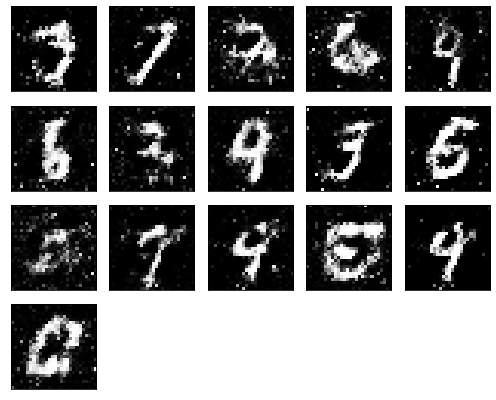

Epochs nb. 1091
discriminator loss: 0.4465370774269104
generator loss : 0.9319998621940613

Epochs nb. 1092
discriminator loss: 0.7046990394592285
generator loss : 0.9532718062400818

Epochs nb. 1093
discriminator loss: 0.6233002543449402
generator loss : 1.0410547256469727

Epochs nb. 1094
discriminator loss: 0.5696210861206055
generator loss : 0.9192674160003662

Epochs nb. 1095
discriminator loss: 0.6153193712234497
generator loss : 0.8831932544708252

Epochs nb. 1096
discriminator loss: 0.5255885124206543
generator loss : 0.9106895923614502

Epochs nb. 1097
discriminator loss: 0.5340291261672974
generator loss : 0.9169843196868896

Epochs nb. 1098
discriminator loss: 0.7125431299209595
generator loss : 0.99732506275177

Epochs nb. 1099
discriminator loss: 0.5903232097625732
generator loss : 0.8737106323242188

Epochs nb. 1100
discriminator loss: 0.6993342041969299
generator loss : 0.8823063373565674



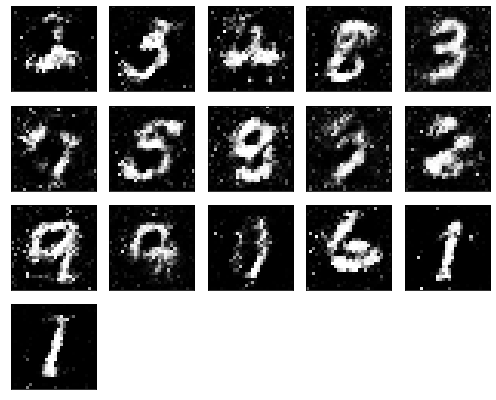

Epochs nb. 1101
discriminator loss: 0.5237817764282227
generator loss : 0.8411802053451538

Epochs nb. 1102
discriminator loss: 0.6012006998062134
generator loss : 0.7181516885757446

Epochs nb. 1103
discriminator loss: 0.5714789032936096
generator loss : 0.8386971950531006

Epochs nb. 1104
discriminator loss: 0.6651397943496704
generator loss : 0.8628482818603516

Epochs nb. 1105
discriminator loss: 0.6797490119934082
generator loss : 1.033225178718567

Epochs nb. 1106
discriminator loss: 0.5348557233810425
generator loss : 0.948641300201416

Epochs nb. 1107
discriminator loss: 0.5651446580886841
generator loss : 0.9449309706687927

Epochs nb. 1108
discriminator loss: 0.5603482127189636
generator loss : 0.9373043775558472

Epochs nb. 1109
discriminator loss: 0.5738236308097839
generator loss : 0.8384308815002441

Epochs nb. 1110
discriminator loss: 0.7038636207580566
generator loss : 0.9391219615936279



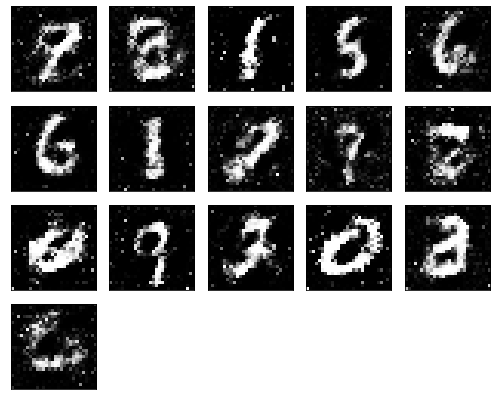

Epochs nb. 1111
discriminator loss: 0.5677404999732971
generator loss : 0.732945442199707

Epochs nb. 1112
discriminator loss: 0.7505088448524475
generator loss : 0.8238487839698792

Epochs nb. 1113
discriminator loss: 0.7251502275466919
generator loss : 1.0291121006011963

Epochs nb. 1114
discriminator loss: 0.5254870057106018
generator loss : 1.1104514598846436

Epochs nb. 1115
discriminator loss: 0.7183132171630859
generator loss : 1.1640311479568481

Epochs nb. 1116
discriminator loss: 0.7846101522445679
generator loss : 0.7941532135009766

Epochs nb. 1117
discriminator loss: 0.5055505037307739
generator loss : 0.8578643798828125

Epochs nb. 1118
discriminator loss: 0.6938408613204956
generator loss : 0.825761079788208

Epochs nb. 1119
discriminator loss: 0.553952693939209
generator loss : 1.051581621170044

Epochs nb. 1120
discriminator loss: 0.7496733069419861
generator loss : 0.8675605654716492



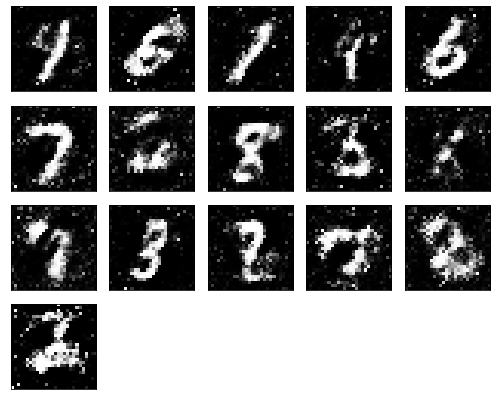

Epochs nb. 1121
discriminator loss: 0.6727933883666992
generator loss : 0.7051652073860168

Epochs nb. 1122
discriminator loss: 0.5647928714752197
generator loss : 0.8830485939979553

Epochs nb. 1123
discriminator loss: 0.579611599445343
generator loss : 0.8971147537231445

Epochs nb. 1124
discriminator loss: 0.595674991607666
generator loss : 0.9099510312080383

Epochs nb. 1125
discriminator loss: 0.5367603898048401
generator loss : 0.9861204028129578

Epochs nb. 1126
discriminator loss: 0.557524561882019
generator loss : 0.9056129455566406

Epochs nb. 1127
discriminator loss: 0.6314256191253662
generator loss : 0.9432873725891113

Epochs nb. 1128
discriminator loss: 0.5854132175445557
generator loss : 0.8746777772903442

Epochs nb. 1129
discriminator loss: 0.5829746723175049
generator loss : 0.9739081859588623

Epochs nb. 1130
discriminator loss: 0.5565530061721802
generator loss : 0.8909103274345398



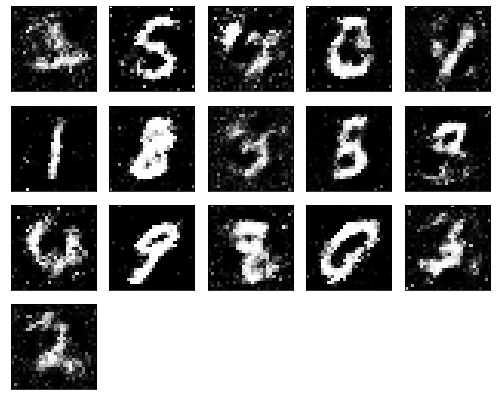

Epochs nb. 1131
discriminator loss: 0.6735475063323975
generator loss : 1.0702011585235596

Epochs nb. 1132
discriminator loss: 0.5779946446418762
generator loss : 1.0427122116088867

Epochs nb. 1133
discriminator loss: 0.5937793254852295
generator loss : 0.8699396848678589

Epochs nb. 1134
discriminator loss: 0.4393188953399658
generator loss : 0.835875391960144

Epochs nb. 1135
discriminator loss: 0.660136342048645
generator loss : 0.9680006504058838

Epochs nb. 1136
discriminator loss: 0.5379174947738647
generator loss : 0.9725357890129089

Epochs nb. 1137
discriminator loss: 0.4886019229888916
generator loss : 0.9273828864097595

Epochs nb. 1138
discriminator loss: 0.5957533717155457
generator loss : 0.861225962638855

Epochs nb. 1139
discriminator loss: 0.6114758253097534
generator loss : 0.872592568397522

Epochs nb. 1140
discriminator loss: 0.49840888381004333
generator loss : 0.83476722240448



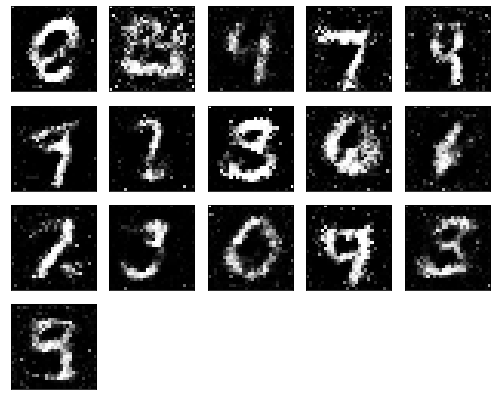

Epochs nb. 1141
discriminator loss: 0.6364384889602661
generator loss : 0.8741621971130371

Epochs nb. 1142
discriminator loss: 0.6656781435012817
generator loss : 0.9587055444717407

Epochs nb. 1143
discriminator loss: 0.5984963178634644
generator loss : 0.7966859936714172

Epochs nb. 1144
discriminator loss: 0.7126973867416382
generator loss : 0.862380862236023

Epochs nb. 1145
discriminator loss: 0.6446237564086914
generator loss : 0.8003415465354919

Epochs nb. 1146
discriminator loss: 0.6649101376533508
generator loss : 0.8125200271606445

Epochs nb. 1147
discriminator loss: 0.5199599862098694
generator loss : 0.8904260396957397

Epochs nb. 1148
discriminator loss: 0.597983717918396
generator loss : 1.0964939594268799

Epochs nb. 1149
discriminator loss: 0.5645459890365601
generator loss : 0.9386301040649414

Epochs nb. 1150
discriminator loss: 0.5997381210327148
generator loss : 0.939235508441925



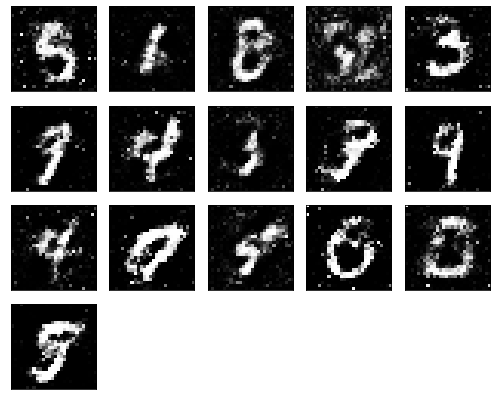

Epochs nb. 1151
discriminator loss: 0.6237707734107971
generator loss : 0.996333122253418

Epochs nb. 1152
discriminator loss: 0.5524044036865234
generator loss : 1.0410760641098022

Epochs nb. 1153
discriminator loss: 0.6136230230331421
generator loss : 1.1182371377944946

Epochs nb. 1154
discriminator loss: 0.5907496213912964
generator loss : 0.9086239337921143

Epochs nb. 1155
discriminator loss: 0.5673023462295532
generator loss : 0.8805432319641113

Epochs nb. 1156
discriminator loss: 0.5659068822860718
generator loss : 0.915391206741333

Epochs nb. 1157
discriminator loss: 0.5668833255767822
generator loss : 0.8889085054397583

Epochs nb. 1158
discriminator loss: 0.576341986656189
generator loss : 1.0025410652160645

Epochs nb. 1159
discriminator loss: 0.5552846193313599
generator loss : 0.90370774269104

Epochs nb. 1160
discriminator loss: 0.5495798587799072
generator loss : 0.8904273509979248



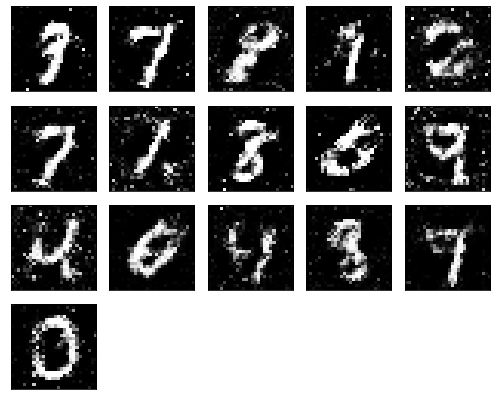

Epochs nb. 1161
discriminator loss: 0.5334733724594116
generator loss : 0.9468727111816406

Epochs nb. 1162
discriminator loss: 0.5475518703460693
generator loss : 0.8322527408599854

Epochs nb. 1163
discriminator loss: 0.6892074942588806
generator loss : 0.8240141272544861

Epochs nb. 1164
discriminator loss: 0.4690365195274353
generator loss : 0.9109020233154297

Epochs nb. 1165
discriminator loss: 0.6167912483215332
generator loss : 0.7549005746841431

Epochs nb. 1166
discriminator loss: 0.6432717442512512
generator loss : 1.0241358280181885

Epochs nb. 1167
discriminator loss: 0.6632392406463623
generator loss : 0.9692457914352417

Epochs nb. 1168
discriminator loss: 0.49784573912620544
generator loss : 1.0306966304779053

Epochs nb. 1169
discriminator loss: 0.6013583540916443
generator loss : 1.1096895933151245

Epochs nb. 1170
discriminator loss: 0.7056622505187988
generator loss : 1.0575294494628906



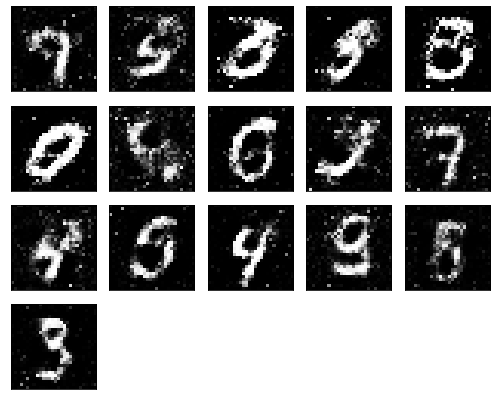

Epochs nb. 1171
discriminator loss: 0.5899360179901123
generator loss : 0.9619231224060059

Epochs nb. 1172
discriminator loss: 0.6650465726852417
generator loss : 0.8967465162277222

Epochs nb. 1173
discriminator loss: 0.5792089700698853
generator loss : 0.6864422559738159

Epochs nb. 1174
discriminator loss: 0.5889500379562378
generator loss : 0.8739620447158813

Epochs nb. 1175
discriminator loss: 0.5969580411911011
generator loss : 0.8682332038879395

Epochs nb. 1176
discriminator loss: 0.5368332862854004
generator loss : 0.8884809017181396

Epochs nb. 1177
discriminator loss: 0.5948586463928223
generator loss : 0.8527225852012634

Epochs nb. 1178
discriminator loss: 0.5242466330528259
generator loss : 0.9326627850532532

Epochs nb. 1179
discriminator loss: 0.5270242691040039
generator loss : 0.9818342924118042

Epochs nb. 1180
discriminator loss: 0.5511713624000549
generator loss : 1.0444602966308594



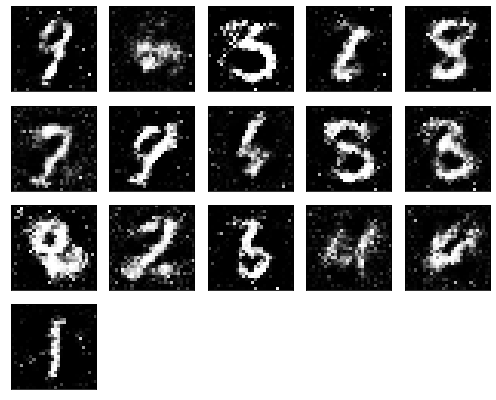

Epochs nb. 1181
discriminator loss: 0.4246782958507538
generator loss : 0.9436255693435669

Epochs nb. 1182
discriminator loss: 0.6072108745574951
generator loss : 0.9116337299346924

Epochs nb. 1183
discriminator loss: 0.5414165258407593
generator loss : 1.0930147171020508

Epochs nb. 1184
discriminator loss: 0.6535796523094177
generator loss : 0.8735476732254028

Epochs nb. 1185
discriminator loss: 0.5472474098205566
generator loss : 0.8970378041267395

Epochs nb. 1186
discriminator loss: 0.6078935861587524
generator loss : 0.7920422554016113

Epochs nb. 1187
discriminator loss: 0.5829747915267944
generator loss : 0.9361532926559448

Epochs nb. 1188
discriminator loss: 0.5403686761856079
generator loss : 0.9106751680374146

Epochs nb. 1189
discriminator loss: 0.6948920488357544
generator loss : 0.9042741656303406

Epochs nb. 1190
discriminator loss: 0.5271179676055908
generator loss : 0.9323657751083374



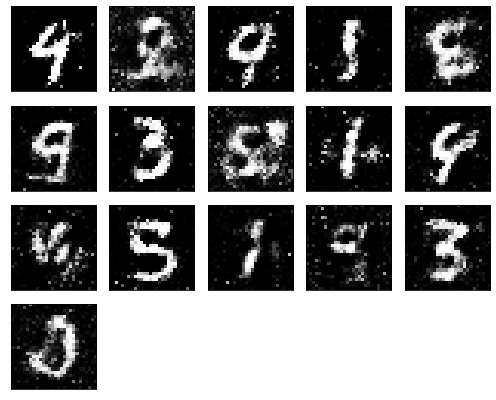

Epochs nb. 1191
discriminator loss: 0.6091203093528748
generator loss : 0.930263876914978

Epochs nb. 1192
discriminator loss: 0.5126364231109619
generator loss : 0.9771044850349426

Epochs nb. 1193
discriminator loss: 0.6501544713973999
generator loss : 1.1170419454574585

Epochs nb. 1194
discriminator loss: 0.5982159376144409
generator loss : 0.8789921402931213

Epochs nb. 1195
discriminator loss: 0.5528719425201416
generator loss : 0.8182662725448608

Epochs nb. 1196
discriminator loss: 0.5945500135421753
generator loss : 0.9461439847946167

Epochs nb. 1197
discriminator loss: 0.637895941734314
generator loss : 1.0025427341461182

Epochs nb. 1198
discriminator loss: 0.6200767755508423
generator loss : 0.9734251499176025

Epochs nb. 1199
discriminator loss: 0.6164135932922363
generator loss : 0.9406779408454895

Epochs nb. 1200
discriminator loss: 0.6715831756591797
generator loss : 0.9311912059783936



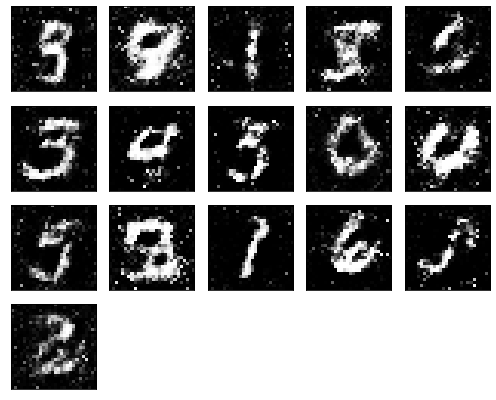

Epochs nb. 1201
discriminator loss: 0.440123975276947
generator loss : 0.9380718469619751

Epochs nb. 1202
discriminator loss: 0.466213196516037
generator loss : 1.0677995681762695

Epochs nb. 1203
discriminator loss: 0.5648519992828369
generator loss : 0.9591502547264099

Epochs nb. 1204
discriminator loss: 0.6327395439147949
generator loss : 1.0136983394622803

Epochs nb. 1205
discriminator loss: 0.5961761474609375
generator loss : 0.9584313631057739

Epochs nb. 1206
discriminator loss: 0.7033528685569763
generator loss : 0.9789764881134033

Epochs nb. 1207
discriminator loss: 0.6051210165023804
generator loss : 0.8055582046508789

Epochs nb. 1208
discriminator loss: 0.5684049725532532
generator loss : 0.8361965417861938

Epochs nb. 1209
discriminator loss: 0.601189374923706
generator loss : 0.8595146536827087

Epochs nb. 1210
discriminator loss: 0.6553102731704712
generator loss : 0.9380438327789307



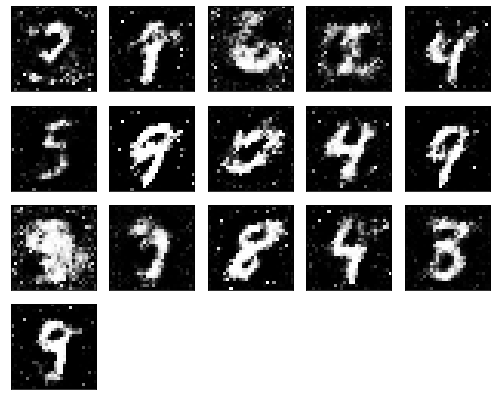

Epochs nb. 1211
discriminator loss: 0.5076513886451721
generator loss : 0.9040261507034302

Epochs nb. 1212
discriminator loss: 0.7829523682594299
generator loss : 0.978142499923706

Epochs nb. 1213
discriminator loss: 0.6167869567871094
generator loss : 0.8755735754966736

Epochs nb. 1214
discriminator loss: 0.5406820178031921
generator loss : 0.873476505279541

Epochs nb. 1215
discriminator loss: 0.5608048439025879
generator loss : 1.0126882791519165

Epochs nb. 1216
discriminator loss: 0.5725579261779785
generator loss : 1.0120880603790283

Epochs nb. 1217
discriminator loss: 0.6849400997161865
generator loss : 0.9729715585708618

Epochs nb. 1218
discriminator loss: 0.5356508493423462
generator loss : 0.9913153648376465

Epochs nb. 1219
discriminator loss: 0.7060412764549255
generator loss : 0.9860992431640625

Epochs nb. 1220
discriminator loss: 0.6174755096435547
generator loss : 0.8534628748893738



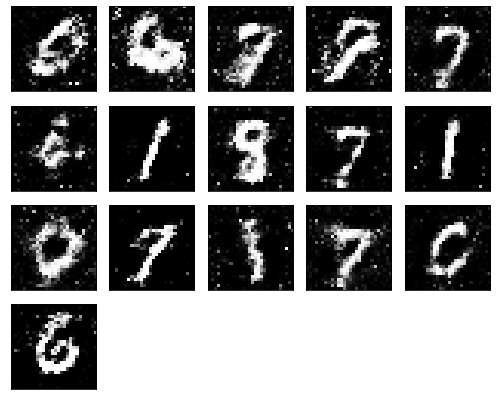

Epochs nb. 1221
discriminator loss: 0.6181457042694092
generator loss : 1.0097869634628296

Epochs nb. 1222
discriminator loss: 0.6029761433601379
generator loss : 0.9345521926879883

Epochs nb. 1223
discriminator loss: 0.6304737329483032
generator loss : 0.8829530477523804

Epochs nb. 1224
discriminator loss: 0.5549068450927734
generator loss : 0.8343702554702759

Epochs nb. 1225
discriminator loss: 0.628443717956543
generator loss : 0.8596558570861816

Epochs nb. 1226
discriminator loss: 0.6456809043884277
generator loss : 0.9795070290565491

Epochs nb. 1227
discriminator loss: 0.5290548801422119
generator loss : 1.0856539011001587

Epochs nb. 1228
discriminator loss: 0.6930716037750244
generator loss : 1.0375447273254395

Epochs nb. 1229
discriminator loss: 0.5529177188873291
generator loss : 0.9175159931182861

Epochs nb. 1230
discriminator loss: 0.6767780780792236
generator loss : 0.9818013906478882



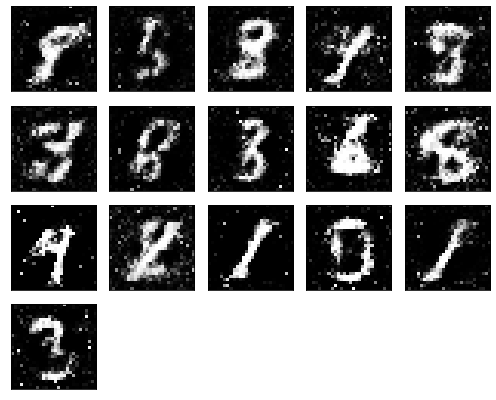

Epochs nb. 1231
discriminator loss: 0.5928988456726074
generator loss : 0.8333375453948975

Epochs nb. 1232
discriminator loss: 0.48889920115470886
generator loss : 0.8956109881401062

Epochs nb. 1233
discriminator loss: 0.6150012612342834
generator loss : 0.9196711778640747

Epochs nb. 1234
discriminator loss: 0.6093553900718689
generator loss : 0.8251922130584717

Epochs nb. 1235
discriminator loss: 0.708509087562561
generator loss : 0.8724563121795654

Epochs nb. 1236
discriminator loss: 0.6679943799972534
generator loss : 0.8324010968208313

Epochs nb. 1237
discriminator loss: 0.6004899144172668
generator loss : 1.024731159210205

Epochs nb. 1238
discriminator loss: 0.5915616750717163
generator loss : 1.2127279043197632

Epochs nb. 1239
discriminator loss: 0.6068844199180603
generator loss : 0.8928310871124268

Epochs nb. 1240
discriminator loss: 0.6704457998275757
generator loss : 0.967557430267334



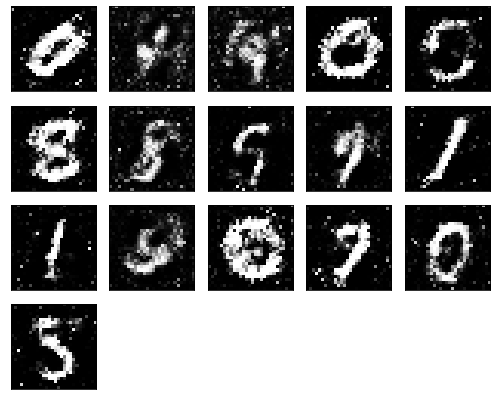

Epochs nb. 1241
discriminator loss: 0.5840046405792236
generator loss : 1.0040289163589478

Epochs nb. 1242
discriminator loss: 0.5377432107925415
generator loss : 0.9106788039207458

Epochs nb. 1243
discriminator loss: 0.5640723705291748
generator loss : 0.9261850118637085

Epochs nb. 1244
discriminator loss: 0.5116310119628906
generator loss : 0.9408789873123169

Epochs nb. 1245
discriminator loss: 0.576737642288208
generator loss : 0.9611607193946838

Epochs nb. 1246
discriminator loss: 0.6462109088897705
generator loss : 0.8412823677062988

Epochs nb. 1247
discriminator loss: 0.5524996519088745
generator loss : 0.8707118630409241

Epochs nb. 1248
discriminator loss: 0.6024057269096375
generator loss : 0.8627991676330566

Epochs nb. 1249
discriminator loss: 0.5565862655639648
generator loss : 1.014465093612671

Epochs nb. 1250
discriminator loss: 0.59424889087677
generator loss : 0.9519093036651611



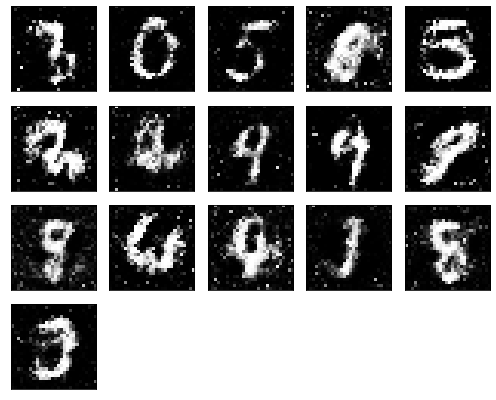

Epochs nb. 1251
discriminator loss: 0.53103107213974
generator loss : 0.8700844049453735

Epochs nb. 1252
discriminator loss: 0.6796590089797974
generator loss : 0.9519299268722534

Epochs nb. 1253
discriminator loss: 0.6208516359329224
generator loss : 0.7916980385780334

Epochs nb. 1254
discriminator loss: 0.5166922807693481
generator loss : 0.8271608352661133

Epochs nb. 1255
discriminator loss: 0.6362316608428955
generator loss : 0.8792709112167358

Epochs nb. 1256
discriminator loss: 0.5499379634857178
generator loss : 0.7024202346801758

Epochs nb. 1257
discriminator loss: 0.6377728581428528
generator loss : 0.8447930812835693

Epochs nb. 1258
discriminator loss: 0.5382222533226013
generator loss : 0.9467257261276245

Epochs nb. 1259
discriminator loss: 0.657069981098175
generator loss : 0.9524816274642944

Epochs nb. 1260
discriminator loss: 0.5766428709030151
generator loss : 0.8494442105293274



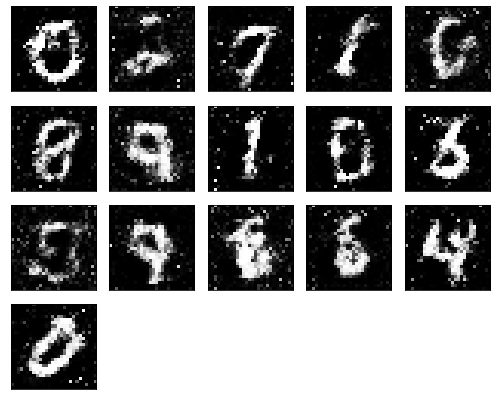

Epochs nb. 1261
discriminator loss: 0.6490386724472046
generator loss : 1.0111308097839355

Epochs nb. 1262
discriminator loss: 0.43638354539871216
generator loss : 0.9682479500770569

Epochs nb. 1263
discriminator loss: 0.6394357681274414
generator loss : 0.9269874095916748

Epochs nb. 1264
discriminator loss: 0.5086284875869751
generator loss : 0.9598075151443481

Epochs nb. 1265
discriminator loss: 0.6600409150123596
generator loss : 0.978047251701355

Epochs nb. 1266
discriminator loss: 0.5015823245048523
generator loss : 0.8855473399162292

Epochs nb. 1267
discriminator loss: 0.5124181509017944
generator loss : 0.8945567011833191

Epochs nb. 1268
discriminator loss: 0.4690321385860443
generator loss : 0.9720668196678162

Epochs nb. 1269
discriminator loss: 0.5567999482154846
generator loss : 0.8673560619354248

Epochs nb. 1270
discriminator loss: 0.6269757747650146
generator loss : 0.8325060606002808



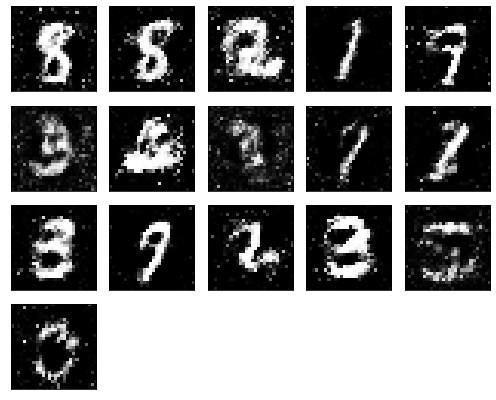

Epochs nb. 1271
discriminator loss: 0.5398578643798828
generator loss : 0.808184802532196

Epochs nb. 1272
discriminator loss: 0.5497140288352966
generator loss : 0.9006705284118652

Epochs nb. 1273
discriminator loss: 0.5861812233924866
generator loss : 0.8995856046676636

Epochs nb. 1274
discriminator loss: 0.5475617051124573
generator loss : 1.0134251117706299

Epochs nb. 1275
discriminator loss: 0.6291215419769287
generator loss : 0.9640318155288696

Epochs nb. 1276
discriminator loss: 0.5919538736343384
generator loss : 0.9058714509010315

Epochs nb. 1277
discriminator loss: 0.5906217694282532
generator loss : 0.9200736880302429

Epochs nb. 1278
discriminator loss: 0.6973882913589478
generator loss : 0.9401698112487793

Epochs nb. 1279
discriminator loss: 0.6059144735336304
generator loss : 0.9378237724304199

Epochs nb. 1280
discriminator loss: 0.5711572170257568
generator loss : 1.0117974281311035



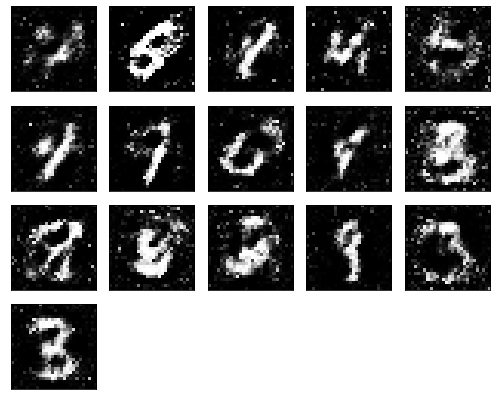

Epochs nb. 1281
discriminator loss: 0.5551744103431702
generator loss : 0.9649962186813354

Epochs nb. 1282
discriminator loss: 0.5785241723060608
generator loss : 0.9840777516365051

Epochs nb. 1283
discriminator loss: 0.5836591124534607
generator loss : 1.023188591003418

Epochs nb. 1284
discriminator loss: 0.6110049486160278
generator loss : 1.1248204708099365

Epochs nb. 1285
discriminator loss: 0.6472122073173523
generator loss : 1.094820499420166

Epochs nb. 1286
discriminator loss: 0.6639982461929321
generator loss : 0.9639981985092163

Epochs nb. 1287
discriminator loss: 0.45995843410491943
generator loss : 1.041472315788269

Epochs nb. 1288
discriminator loss: 0.6791696548461914
generator loss : 1.0896050930023193

Epochs nb. 1289
discriminator loss: 0.6338446140289307
generator loss : 1.0226366519927979

Epochs nb. 1290
discriminator loss: 0.5783035755157471
generator loss : 1.0650713443756104



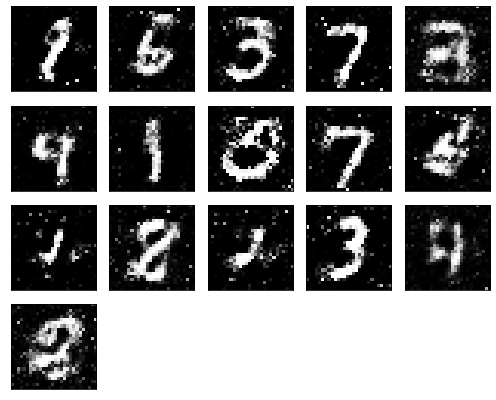

Epochs nb. 1291
discriminator loss: 0.5632935762405396
generator loss : 1.1434900760650635

Epochs nb. 1292
discriminator loss: 0.6307826042175293
generator loss : 0.9472383856773376

Epochs nb. 1293
discriminator loss: 0.6217880249023438
generator loss : 0.8712431788444519

Epochs nb. 1294
discriminator loss: 0.6763575673103333
generator loss : 1.025395393371582

Epochs nb. 1295
discriminator loss: 0.5548230409622192
generator loss : 0.9539797902107239

Epochs nb. 1296
discriminator loss: 0.5056051015853882
generator loss : 1.0200324058532715

Epochs nb. 1297
discriminator loss: 0.5447260737419128
generator loss : 1.0711710453033447

Epochs nb. 1298
discriminator loss: 0.6489496231079102
generator loss : 0.9372346997261047

Epochs nb. 1299
discriminator loss: 0.654144823551178
generator loss : 0.9018988013267517

Epochs nb. 1300
discriminator loss: 0.576318621635437
generator loss : 0.9235787391662598



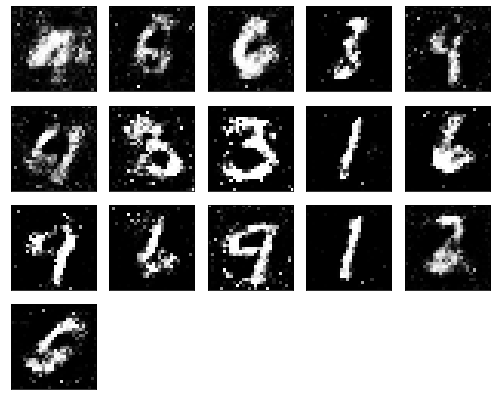

Epochs nb. 1301
discriminator loss: 0.5410257577896118
generator loss : 0.8837342262268066

Epochs nb. 1302
discriminator loss: 0.6337040066719055
generator loss : 0.8882349133491516

Epochs nb. 1303
discriminator loss: 0.6430820226669312
generator loss : 0.8411346673965454

Epochs nb. 1304
discriminator loss: 0.5338319540023804
generator loss : 0.9378394484519958

Epochs nb. 1305
discriminator loss: 0.7066967487335205
generator loss : 1.0292471647262573

Epochs nb. 1306
discriminator loss: 0.5718532800674438
generator loss : 1.076180100440979

Epochs nb. 1307
discriminator loss: 0.6461549997329712
generator loss : 0.9489274024963379

Epochs nb. 1308
discriminator loss: 0.48874717950820923
generator loss : 0.9729574918746948

Epochs nb. 1309
discriminator loss: 0.5981626510620117
generator loss : 0.9831230640411377

Epochs nb. 1310
discriminator loss: 0.56850266456604
generator loss : 1.0217121839523315



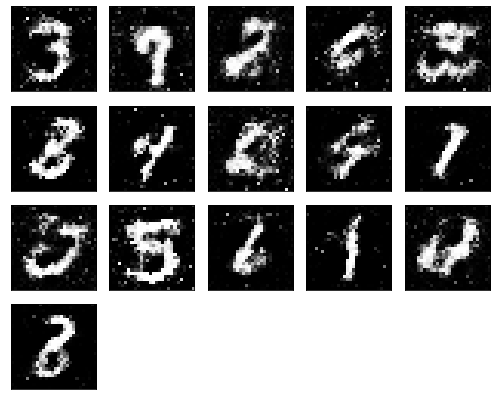

Epochs nb. 1311
discriminator loss: 0.58503258228302
generator loss : 0.9861782789230347

Epochs nb. 1312
discriminator loss: 0.6736191511154175
generator loss : 0.9356810450553894

Epochs nb. 1313
discriminator loss: 0.5273804068565369
generator loss : 0.9064329266548157

Epochs nb. 1314
discriminator loss: 0.5384766459465027
generator loss : 0.9729584455490112

Epochs nb. 1315
discriminator loss: 0.5399469137191772
generator loss : 1.011518955230713

Epochs nb. 1316
discriminator loss: 0.5787349343299866
generator loss : 1.0068796873092651

Epochs nb. 1317
discriminator loss: 0.5756984949111938
generator loss : 0.954411506652832

Epochs nb. 1318
discriminator loss: 0.509476363658905
generator loss : 1.0066368579864502

Epochs nb. 1319
discriminator loss: 0.44354236125946045
generator loss : 1.0586283206939697

Epochs nb. 1320
discriminator loss: 0.6061257123947144
generator loss : 0.9166131019592285



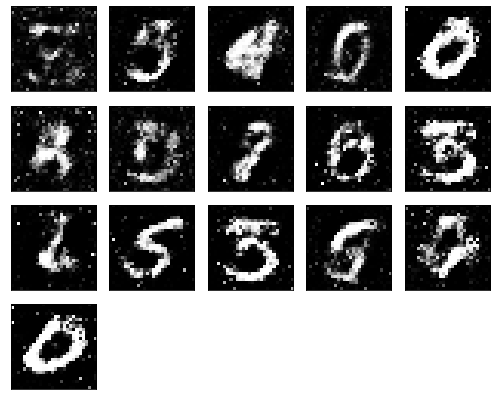

Epochs nb. 1321
discriminator loss: 0.6314774751663208
generator loss : 0.8756174445152283

Epochs nb. 1322
discriminator loss: 0.6424968838691711
generator loss : 0.9300060272216797

Epochs nb. 1323
discriminator loss: 0.6245967149734497
generator loss : 1.0303658246994019

Epochs nb. 1324
discriminator loss: 0.5657486915588379
generator loss : 0.7715129852294922

Epochs nb. 1325
discriminator loss: 0.5241991281509399
generator loss : 0.9719046354293823

Epochs nb. 1326
discriminator loss: 0.6492120027542114
generator loss : 1.091147780418396

Epochs nb. 1327
discriminator loss: 0.5757564902305603
generator loss : 0.776561439037323

Epochs nb. 1328
discriminator loss: 0.5762690305709839
generator loss : 0.9699223041534424

Epochs nb. 1329
discriminator loss: 0.5777236819267273
generator loss : 0.9481214880943298

Epochs nb. 1330
discriminator loss: 0.6442774534225464
generator loss : 0.9908991456031799



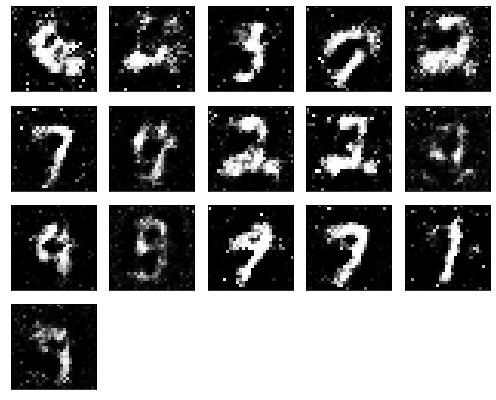

Epochs nb. 1331
discriminator loss: 0.5980891585350037
generator loss : 1.0792713165283203

Epochs nb. 1332
discriminator loss: 0.5352140665054321
generator loss : 0.8665368556976318

Epochs nb. 1333
discriminator loss: 0.7017557621002197
generator loss : 1.1311421394348145

Epochs nb. 1334
discriminator loss: 0.5143950581550598
generator loss : 0.8525545597076416

Epochs nb. 1335
discriminator loss: 0.6565951108932495
generator loss : 0.9531904458999634

Epochs nb. 1336
discriminator loss: 0.5453068017959595
generator loss : 0.8765885829925537

Epochs nb. 1337
discriminator loss: 0.6974587440490723
generator loss : 0.9812019467353821

Epochs nb. 1338
discriminator loss: 0.5347695350646973
generator loss : 0.9651994705200195

Epochs nb. 1339
discriminator loss: 0.5594770312309265
generator loss : 1.0715343952178955

Epochs nb. 1340
discriminator loss: 0.6605545282363892
generator loss : 0.937303900718689



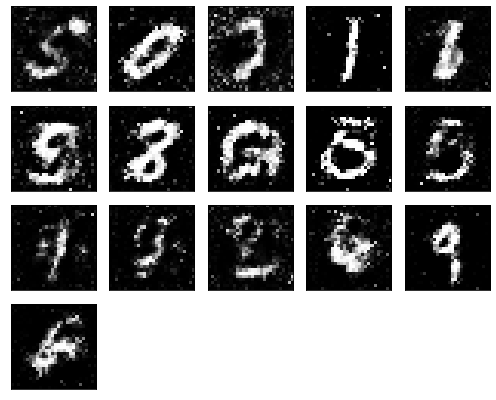

Epochs nb. 1341
discriminator loss: 0.5948382616043091
generator loss : 0.9377508759498596

Epochs nb. 1342
discriminator loss: 0.6309823393821716
generator loss : 1.043580412864685

Epochs nb. 1343
discriminator loss: 0.5837671756744385
generator loss : 1.0679116249084473

Epochs nb. 1344
discriminator loss: 0.7255993485450745
generator loss : 0.8947528600692749

Epochs nb. 1345
discriminator loss: 0.5499217510223389
generator loss : 0.9821834564208984

Epochs nb. 1346
discriminator loss: 0.6783503890037537
generator loss : 0.8752200603485107

Epochs nb. 1347
discriminator loss: 0.6231966018676758
generator loss : 1.0531888008117676

Epochs nb. 1348
discriminator loss: 0.6699785590171814
generator loss : 0.9658008217811584

Epochs nb. 1349
discriminator loss: 0.5390751361846924
generator loss : 0.925262451171875

Epochs nb. 1350
discriminator loss: 0.5391986966133118
generator loss : 0.6881182789802551



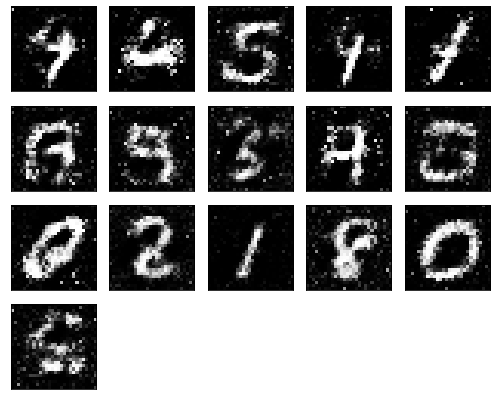

Epochs nb. 1351
discriminator loss: 0.5464112162590027
generator loss : 0.762217104434967

Epochs nb. 1352
discriminator loss: 0.5916604399681091
generator loss : 0.7897621393203735

Epochs nb. 1353
discriminator loss: 0.6997885704040527
generator loss : 0.9043344259262085

Epochs nb. 1354
discriminator loss: 0.5889606475830078
generator loss : 1.0023359060287476

Epochs nb. 1355
discriminator loss: 0.572037935256958
generator loss : 0.916725754737854

Epochs nb. 1356
discriminator loss: 0.6147787570953369
generator loss : 0.8806204795837402

Epochs nb. 1357
discriminator loss: 0.5573421716690063
generator loss : 1.0012495517730713

Epochs nb. 1358
discriminator loss: 0.6416265964508057
generator loss : 0.9160466194152832

Epochs nb. 1359
discriminator loss: 0.5472519397735596
generator loss : 0.9593849778175354

Epochs nb. 1360
discriminator loss: 0.6382042765617371
generator loss : 0.8135460019111633



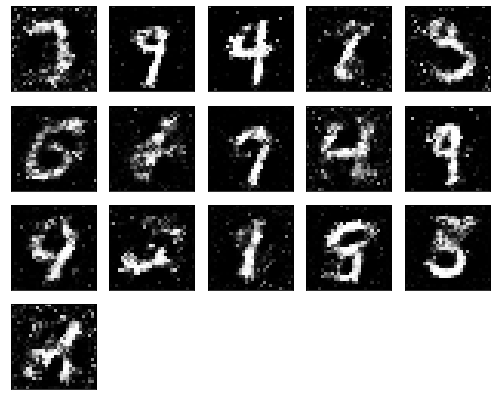

Epochs nb. 1361
discriminator loss: 0.585096538066864
generator loss : 0.875028133392334

Epochs nb. 1362
discriminator loss: 0.6162107586860657
generator loss : 0.8792264461517334

Epochs nb. 1363
discriminator loss: 0.6540465354919434
generator loss : 0.9582979679107666

Epochs nb. 1364
discriminator loss: 0.5625139474868774
generator loss : 0.8907042145729065

Epochs nb. 1365
discriminator loss: 0.6085139513015747
generator loss : 0.9220346212387085

Epochs nb. 1366
discriminator loss: 0.49998193979263306
generator loss : 0.9555561542510986

Epochs nb. 1367
discriminator loss: 0.486201673746109
generator loss : 0.8742773532867432

Epochs nb. 1368
discriminator loss: 0.5847736597061157
generator loss : 1.1750140190124512

Epochs nb. 1369
discriminator loss: 0.5299439430236816
generator loss : 0.8914245367050171

Epochs nb. 1370
discriminator loss: 0.5481534004211426
generator loss : 0.9459744691848755



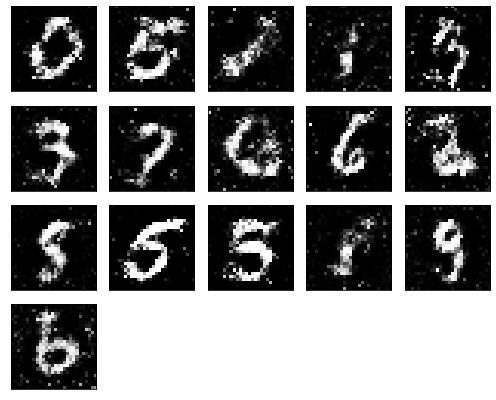

Epochs nb. 1371
discriminator loss: 0.6278467178344727
generator loss : 0.9977642297744751

Epochs nb. 1372
discriminator loss: 0.44971519708633423
generator loss : 0.8910830616950989

Epochs nb. 1373
discriminator loss: 0.6134629249572754
generator loss : 0.9703205823898315

Epochs nb. 1374
discriminator loss: 0.5856497883796692
generator loss : 1.176397681236267

Epochs nb. 1375
discriminator loss: 0.6234877109527588
generator loss : 0.9576552510261536

Epochs nb. 1376
discriminator loss: 0.5886857509613037
generator loss : 0.735425591468811

Epochs nb. 1377
discriminator loss: 0.6899054050445557
generator loss : 0.953244686126709

Epochs nb. 1378
discriminator loss: 0.6301959156990051
generator loss : 0.7752419710159302

Epochs nb. 1379
discriminator loss: 0.6682933568954468
generator loss : 0.9032716155052185

Epochs nb. 1380
discriminator loss: 0.5807710886001587
generator loss : 1.065373182296753



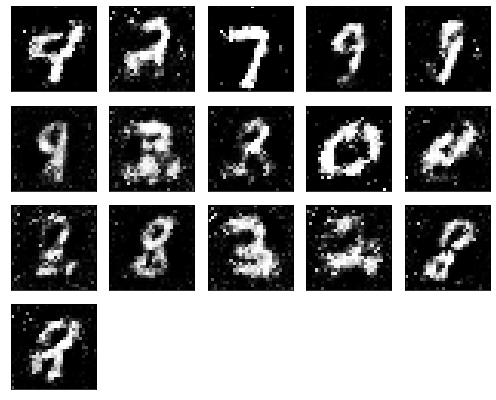

Epochs nb. 1381
discriminator loss: 0.5711119771003723
generator loss : 0.8839155435562134

Epochs nb. 1382
discriminator loss: 0.5842626094818115
generator loss : 0.9421095848083496

Epochs nb. 1383
discriminator loss: 0.4993096590042114
generator loss : 0.859458863735199

Epochs nb. 1384
discriminator loss: 0.6491051912307739
generator loss : 0.9021954536437988

Epochs nb. 1385
discriminator loss: 0.6404086351394653
generator loss : 0.9109299778938293

Epochs nb. 1386
discriminator loss: 0.6502385139465332
generator loss : 0.847526490688324

Epochs nb. 1387
discriminator loss: 0.5071444511413574
generator loss : 0.8758429288864136

Epochs nb. 1388
discriminator loss: 0.6049286723136902
generator loss : 0.9746584892272949

Epochs nb. 1389
discriminator loss: 0.4934960603713989
generator loss : 0.9001120328903198

Epochs nb. 1390
discriminator loss: 0.7071024179458618
generator loss : 0.9289063215255737



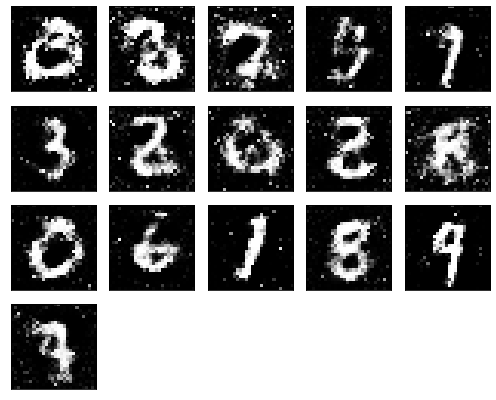

Epochs nb. 1391
discriminator loss: 0.6850265860557556
generator loss : 1.145728588104248

Epochs nb. 1392
discriminator loss: 0.6086527109146118
generator loss : 0.9318287372589111

Epochs nb. 1393
discriminator loss: 0.6044028997421265
generator loss : 1.0689947605133057

Epochs nb. 1394
discriminator loss: 0.5988662242889404
generator loss : 1.0260865688323975

Epochs nb. 1395
discriminator loss: 0.5795303583145142
generator loss : 1.0508562326431274

Epochs nb. 1396
discriminator loss: 0.5007096529006958
generator loss : 0.9129152894020081

Epochs nb. 1397
discriminator loss: 0.5450118184089661
generator loss : 1.0119967460632324

Epochs nb. 1398
discriminator loss: 0.5975608825683594
generator loss : 1.0206602811813354

Epochs nb. 1399
discriminator loss: 0.5289199352264404
generator loss : 0.8029710054397583

Epochs nb. 1400
discriminator loss: 0.5911425352096558
generator loss : 1.0380918979644775



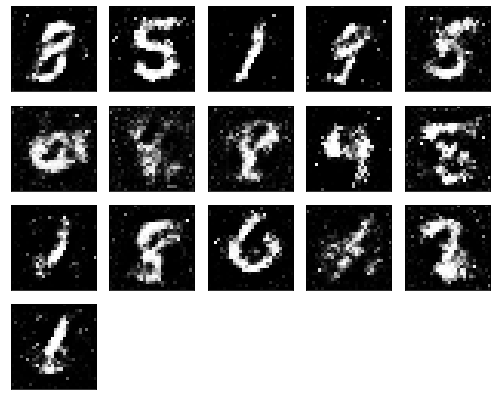

Epochs nb. 1401
discriminator loss: 0.5982190370559692
generator loss : 0.9929330945014954

Epochs nb. 1402
discriminator loss: 0.5672620534896851
generator loss : 1.0417606830596924

Epochs nb. 1403
discriminator loss: 0.672176718711853
generator loss : 1.1063828468322754

Epochs nb. 1404
discriminator loss: 0.603766918182373
generator loss : 1.124895453453064

Epochs nb. 1405
discriminator loss: 0.6724854707717896
generator loss : 0.9554641842842102

Epochs nb. 1406
discriminator loss: 0.517279863357544
generator loss : 1.063195824623108

Epochs nb. 1407
discriminator loss: 0.5389617681503296
generator loss : 0.858436107635498

Epochs nb. 1408
discriminator loss: 0.5359228253364563
generator loss : 1.0937533378601074

Epochs nb. 1409
discriminator loss: 0.6735484600067139
generator loss : 0.947754979133606

Epochs nb. 1410
discriminator loss: 0.5735577344894409
generator loss : 1.0097260475158691



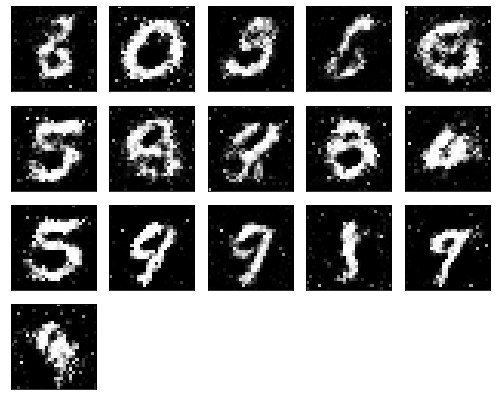

Epochs nb. 1411
discriminator loss: 0.5684431791305542
generator loss : 1.0361930131912231

Epochs nb. 1412
discriminator loss: 0.49273890256881714
generator loss : 0.8948186635971069

Epochs nb. 1413
discriminator loss: 0.6743061542510986
generator loss : 0.8232312202453613

Epochs nb. 1414
discriminator loss: 0.5431048274040222
generator loss : 0.8992276787757874

Epochs nb. 1415
discriminator loss: 0.5391583442687988
generator loss : 1.0693914890289307

Epochs nb. 1416
discriminator loss: 0.602121114730835
generator loss : 0.911221444606781

Epochs nb. 1417
discriminator loss: 0.6645869612693787
generator loss : 1.0078814029693604

Epochs nb. 1418
discriminator loss: 0.5963115096092224
generator loss : 0.9911987781524658

Epochs nb. 1419
discriminator loss: 0.6656525135040283
generator loss : 1.0127813816070557

Epochs nb. 1420
discriminator loss: 0.6480194330215454
generator loss : 0.9332233667373657



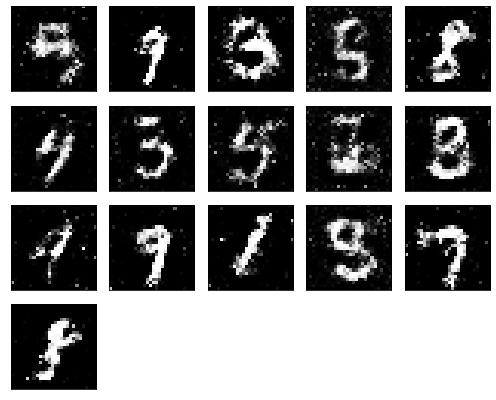

Epochs nb. 1421
discriminator loss: 0.5851296186447144
generator loss : 0.9452700614929199

Epochs nb. 1422
discriminator loss: 0.6119359731674194
generator loss : 0.8832988739013672

Epochs nb. 1423
discriminator loss: 0.6602679491043091
generator loss : 1.0038981437683105

Epochs nb. 1424
discriminator loss: 0.5416312217712402
generator loss : 0.983434796333313

Epochs nb. 1425
discriminator loss: 0.60553377866745
generator loss : 0.86234450340271

Epochs nb. 1426
discriminator loss: 0.7210653424263
generator loss : 0.8959823250770569

Epochs nb. 1427
discriminator loss: 0.6125295162200928
generator loss : 0.8912726044654846

Epochs nb. 1428
discriminator loss: 0.5305534601211548
generator loss : 0.9856003522872925

Epochs nb. 1429
discriminator loss: 0.6493773460388184
generator loss : 0.878106951713562

Epochs nb. 1430
discriminator loss: 0.44847729802131653
generator loss : 0.9754102230072021



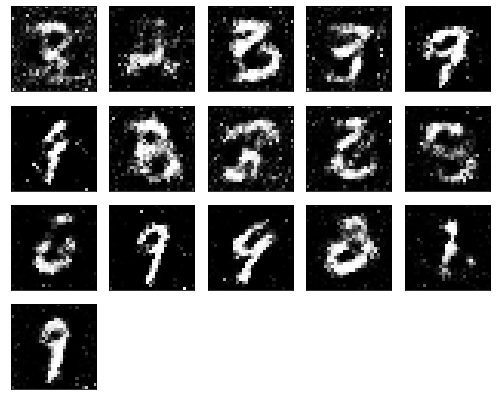

Epochs nb. 1431
discriminator loss: 0.7509139776229858
generator loss : 0.8212844133377075

Epochs nb. 1432
discriminator loss: 0.7587789297103882
generator loss : 0.9760749340057373

Epochs nb. 1433
discriminator loss: 0.6265319585800171
generator loss : 0.9570095539093018

Epochs nb. 1434
discriminator loss: 0.4900912642478943
generator loss : 0.8495335578918457

Epochs nb. 1435
discriminator loss: 0.5095269680023193
generator loss : 0.9141930341720581

Epochs nb. 1436
discriminator loss: 0.5709232091903687
generator loss : 0.8719311952590942

Epochs nb. 1437
discriminator loss: 0.5430908203125
generator loss : 1.040979266166687

Epochs nb. 1438
discriminator loss: 0.6134904026985168
generator loss : 0.955991804599762

Epochs nb. 1439
discriminator loss: 0.5672404766082764
generator loss : 0.9805126190185547

Epochs nb. 1440
discriminator loss: 0.5271580219268799
generator loss : 1.079542875289917



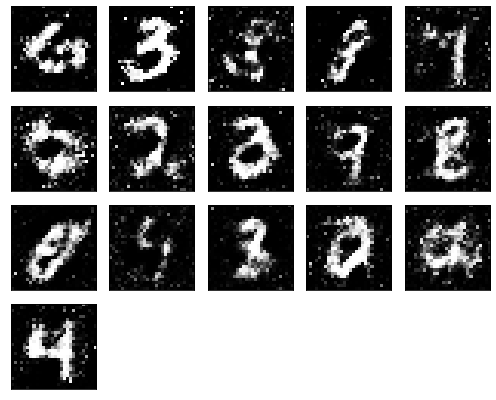

Epochs nb. 1441
discriminator loss: 0.6448866128921509
generator loss : 0.9840731024742126

Epochs nb. 1442
discriminator loss: 0.6137968301773071
generator loss : 0.9732447862625122

Epochs nb. 1443
discriminator loss: 0.5260314345359802
generator loss : 0.8271824717521667

Epochs nb. 1444
discriminator loss: 0.6607004404067993
generator loss : 1.0083916187286377

Epochs nb. 1445
discriminator loss: 0.6332718133926392
generator loss : 0.9611183404922485

Epochs nb. 1446
discriminator loss: 0.6671955585479736
generator loss : 0.8877850770950317

Epochs nb. 1447
discriminator loss: 0.6758317947387695
generator loss : 0.913559079170227

Epochs nb. 1448
discriminator loss: 0.561313271522522
generator loss : 0.8615437746047974

Epochs nb. 1449
discriminator loss: 0.5725015997886658
generator loss : 0.7842446565628052

Epochs nb. 1450
discriminator loss: 0.6259868741035461
generator loss : 0.8911266326904297



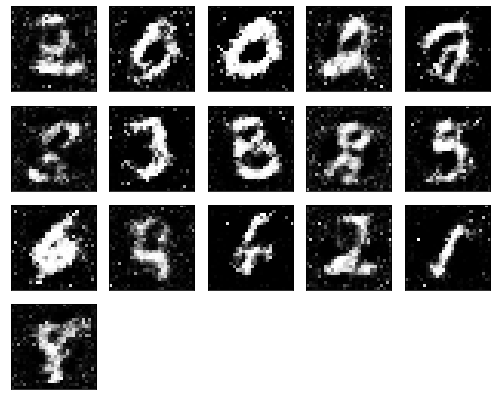

Epochs nb. 1451
discriminator loss: 0.636134922504425
generator loss : 0.9176613092422485

Epochs nb. 1452
discriminator loss: 0.5422662496566772
generator loss : 0.8248709440231323

Epochs nb. 1453
discriminator loss: 0.6954876780509949
generator loss : 0.8616401553153992

Epochs nb. 1454
discriminator loss: 0.6345528364181519
generator loss : 0.8842676877975464

Epochs nb. 1455
discriminator loss: 0.6022205948829651
generator loss : 0.8906726241111755

Epochs nb. 1456
discriminator loss: 0.5591026544570923
generator loss : 0.9415147304534912

Epochs nb. 1457
discriminator loss: 0.594031572341919
generator loss : 0.937846302986145

Epochs nb. 1458
discriminator loss: 0.5272055864334106
generator loss : 0.8607592582702637

Epochs nb. 1459
discriminator loss: 0.6553570628166199
generator loss : 0.8971863985061646

Epochs nb. 1460
discriminator loss: 0.6188077926635742
generator loss : 0.8911423683166504



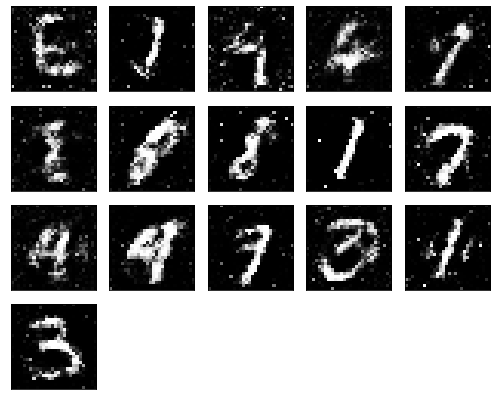

Epochs nb. 1461
discriminator loss: 0.5843541622161865
generator loss : 0.8038286566734314

Epochs nb. 1462
discriminator loss: 0.6016941070556641
generator loss : 0.7618331909179688

Epochs nb. 1463
discriminator loss: 0.588676929473877
generator loss : 0.9435667395591736

Epochs nb. 1464
discriminator loss: 0.5076576471328735
generator loss : 0.8850050568580627

Epochs nb. 1465
discriminator loss: 0.6346843242645264
generator loss : 0.8635529279708862

Epochs nb. 1466
discriminator loss: 0.628990113735199
generator loss : 0.9189183712005615

Epochs nb. 1467
discriminator loss: 0.604114830493927
generator loss : 0.9204779863357544

Epochs nb. 1468
discriminator loss: 0.6430174112319946
generator loss : 0.9602757692337036

Epochs nb. 1469
discriminator loss: 0.6322472095489502
generator loss : 0.9651601314544678

Epochs nb. 1470
discriminator loss: 0.6262173652648926
generator loss : 0.7970834970474243



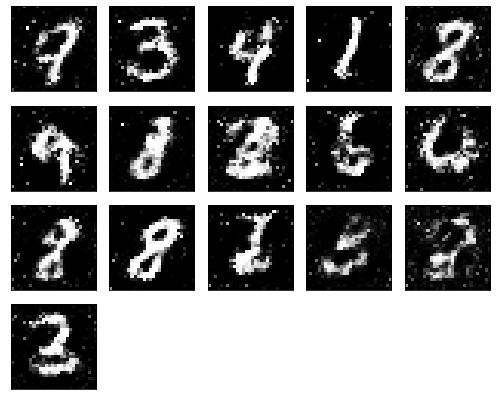

Epochs nb. 1471
discriminator loss: 0.6439521312713623
generator loss : 0.9302077293395996

Epochs nb. 1472
discriminator loss: 0.571923017501831
generator loss : 1.0072600841522217

Epochs nb. 1473
discriminator loss: 0.5117812752723694
generator loss : 0.7862426042556763

Epochs nb. 1474
discriminator loss: 0.5893419981002808
generator loss : 0.9130604267120361

Epochs nb. 1475
discriminator loss: 0.575192928314209
generator loss : 1.0156183242797852

Epochs nb. 1476
discriminator loss: 0.5435534715652466
generator loss : 0.9090079069137573

Epochs nb. 1477
discriminator loss: 0.6349473595619202
generator loss : 0.9352778196334839

Epochs nb. 1478
discriminator loss: 0.7221543192863464
generator loss : 0.9647024869918823

Epochs nb. 1479
discriminator loss: 0.6238684058189392
generator loss : 0.8523142337799072

Epochs nb. 1480
discriminator loss: 0.5601202249526978
generator loss : 1.0943732261657715



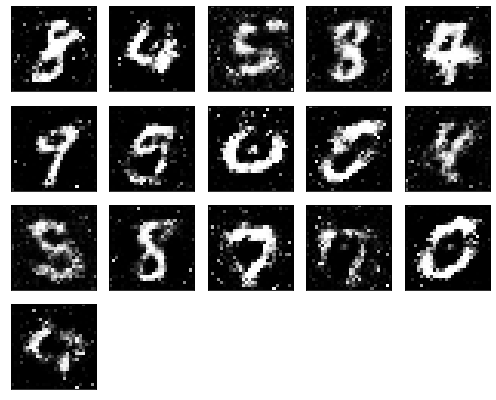

Epochs nb. 1481
discriminator loss: 0.5822849273681641
generator loss : 0.9990990161895752

Epochs nb. 1482
discriminator loss: 0.5355842113494873
generator loss : 0.9246522784233093

Epochs nb. 1483
discriminator loss: 0.5878136157989502
generator loss : 1.024669885635376

Epochs nb. 1484
discriminator loss: 0.6436880826950073
generator loss : 0.8876388072967529

Epochs nb. 1485
discriminator loss: 0.6041044592857361
generator loss : 1.0140681266784668

Epochs nb. 1486
discriminator loss: 0.6574579477310181
generator loss : 0.9403828382492065

Epochs nb. 1487
discriminator loss: 0.5198917984962463
generator loss : 0.9732195734977722

Epochs nb. 1488
discriminator loss: 0.6223317384719849
generator loss : 1.0210654735565186

Epochs nb. 1489
discriminator loss: 0.6397745013237
generator loss : 1.1057454347610474

Epochs nb. 1490
discriminator loss: 0.7220303416252136
generator loss : 1.0650615692138672



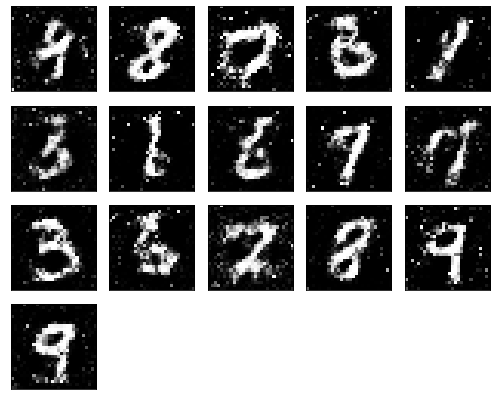

Epochs nb. 1491
discriminator loss: 0.5810378789901733
generator loss : 0.8931276798248291

Epochs nb. 1492
discriminator loss: 0.5787584185600281
generator loss : 1.0166724920272827

Epochs nb. 1493
discriminator loss: 0.592859148979187
generator loss : 0.9252878427505493

Epochs nb. 1494
discriminator loss: 0.464076429605484
generator loss : 1.1110442876815796

Epochs nb. 1495
discriminator loss: 0.5432814359664917
generator loss : 0.9025259017944336

Epochs nb. 1496
discriminator loss: 0.601465106010437
generator loss : 0.7529951333999634

Epochs nb. 1497
discriminator loss: 0.6736246347427368
generator loss : 0.990588903427124

Epochs nb. 1498
discriminator loss: 0.5248186588287354
generator loss : 1.0228819847106934

Epochs nb. 1499
discriminator loss: 0.5612066984176636
generator loss : 0.9118801355361938

Epochs nb. 1500
discriminator loss: 0.5684055685997009
generator loss : 0.8905439376831055



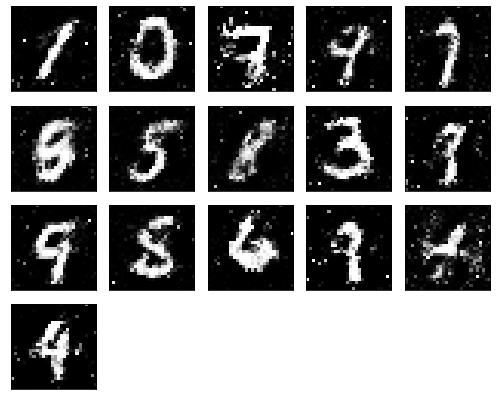

Epochs nb. 1501
discriminator loss: 0.5762687921524048
generator loss : 0.8435264229774475

Epochs nb. 1502
discriminator loss: 0.5777610540390015
generator loss : 0.8764136433601379

Epochs nb. 1503
discriminator loss: 0.6728192567825317
generator loss : 0.9639338254928589

Epochs nb. 1504
discriminator loss: 0.7131165266036987
generator loss : 0.9897051453590393

Epochs nb. 1505
discriminator loss: 0.5000267028808594
generator loss : 0.9916896820068359

Epochs nb. 1506
discriminator loss: 0.6384701728820801
generator loss : 0.8389204740524292

Epochs nb. 1507
discriminator loss: 0.5635032653808594
generator loss : 0.8761191368103027

Epochs nb. 1508
discriminator loss: 0.5878387689590454
generator loss : 1.0744402408599854

Epochs nb. 1509
discriminator loss: 0.6145733594894409
generator loss : 0.9576317071914673

Epochs nb. 1510
discriminator loss: 0.6062912940979004
generator loss : 1.056123971939087



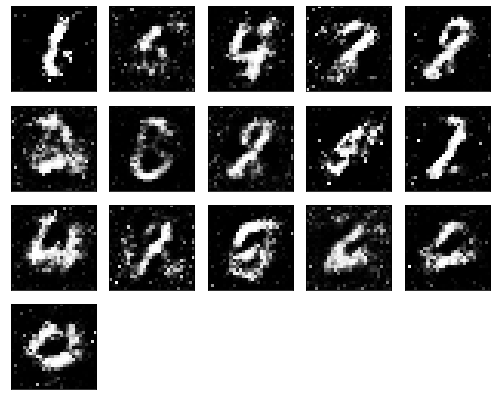

Epochs nb. 1511
discriminator loss: 0.6072492003440857
generator loss : 1.0101304054260254

Epochs nb. 1512
discriminator loss: 0.5930172204971313
generator loss : 0.9736838936805725

Epochs nb. 1513
discriminator loss: 0.5857565999031067
generator loss : 0.9049122333526611

Epochs nb. 1514
discriminator loss: 0.5269566774368286
generator loss : 1.1653943061828613

Epochs nb. 1515
discriminator loss: 0.6129048466682434
generator loss : 1.1025428771972656

Epochs nb. 1516
discriminator loss: 0.6578160524368286
generator loss : 0.8549689054489136

Epochs nb. 1517
discriminator loss: 0.5072852373123169
generator loss : 0.8720757365226746

Epochs nb. 1518
discriminator loss: 0.5981417894363403
generator loss : 0.9242491722106934

Epochs nb. 1519
discriminator loss: 0.6541075706481934
generator loss : 0.9582369327545166

Epochs nb. 1520
discriminator loss: 0.6073867082595825
generator loss : 0.860968828201294



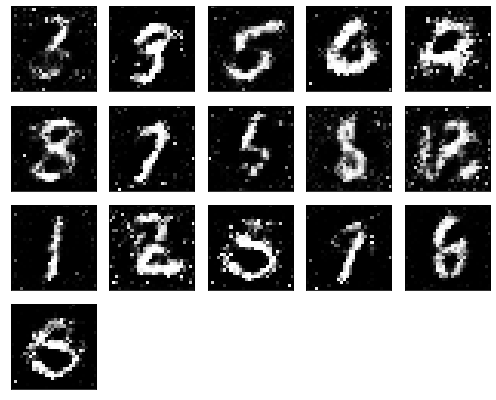

Epochs nb. 1521
discriminator loss: 0.7527974843978882
generator loss : 1.0679895877838135

Epochs nb. 1522
discriminator loss: 0.5429725646972656
generator loss : 0.9968047738075256

Epochs nb. 1523
discriminator loss: 0.6247744560241699
generator loss : 0.9041609764099121

Epochs nb. 1524
discriminator loss: 0.6736571192741394
generator loss : 0.9524304866790771

Epochs nb. 1525
discriminator loss: 0.5951938629150391
generator loss : 0.9385088682174683

Epochs nb. 1526
discriminator loss: 0.6312034130096436
generator loss : 1.1429178714752197

Epochs nb. 1527
discriminator loss: 0.6054853796958923
generator loss : 0.9326610565185547

Epochs nb. 1528
discriminator loss: 0.6647701263427734
generator loss : 1.0345017910003662

Epochs nb. 1529
discriminator loss: 0.5204583406448364
generator loss : 0.9962244033813477

Epochs nb. 1530
discriminator loss: 0.6138543486595154
generator loss : 0.916926383972168



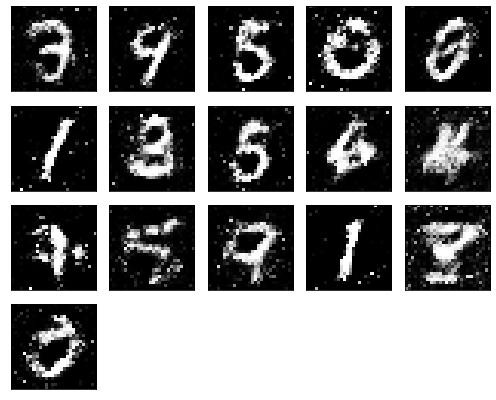

Epochs nb. 1531
discriminator loss: 0.6096073389053345
generator loss : 0.8498063087463379

Epochs nb. 1532
discriminator loss: 0.5856850147247314
generator loss : 0.9104942083358765

Epochs nb. 1533
discriminator loss: 0.7491766810417175
generator loss : 0.9162492752075195

Epochs nb. 1534
discriminator loss: 0.5816819071769714
generator loss : 0.9282476902008057

Epochs nb. 1535
discriminator loss: 0.6693674325942993
generator loss : 0.9235417246818542

Epochs nb. 1536
discriminator loss: 0.6310649514198303
generator loss : 1.0758869647979736

Epochs nb. 1537
discriminator loss: 0.6756196618080139
generator loss : 0.8941348791122437

Epochs nb. 1538
discriminator loss: 0.6716067790985107
generator loss : 1.0953364372253418

Epochs nb. 1539
discriminator loss: 0.6459751129150391
generator loss : 0.9093801379203796

Epochs nb. 1540
discriminator loss: 0.5627580881118774
generator loss : 0.7146046161651611



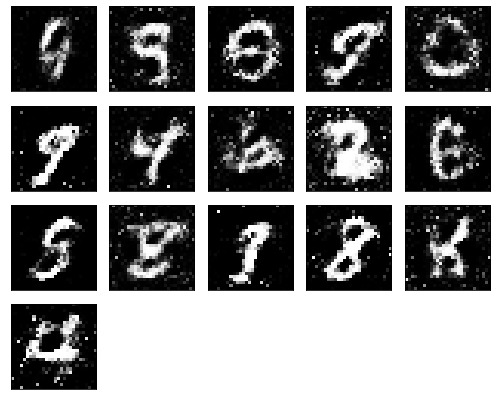

Epochs nb. 1541
discriminator loss: 0.5690160989761353
generator loss : 0.95332932472229

Epochs nb. 1542
discriminator loss: 0.5816277265548706
generator loss : 0.8880893588066101

Epochs nb. 1543
discriminator loss: 0.6429169178009033
generator loss : 0.9090150594711304

Epochs nb. 1544
discriminator loss: 0.6068083047866821
generator loss : 0.8095453381538391

Epochs nb. 1545
discriminator loss: 0.5608754754066467
generator loss : 0.8729625940322876

Epochs nb. 1546
discriminator loss: 0.615541934967041
generator loss : 0.9138913154602051

Epochs nb. 1547
discriminator loss: 0.6803774833679199
generator loss : 1.0892951488494873

Epochs nb. 1548
discriminator loss: 0.6421201229095459
generator loss : 1.02718186378479

Epochs nb. 1549
discriminator loss: 0.7895709872245789
generator loss : 0.8655492663383484

Epochs nb. 1550
discriminator loss: 0.5497982501983643
generator loss : 1.019322156906128



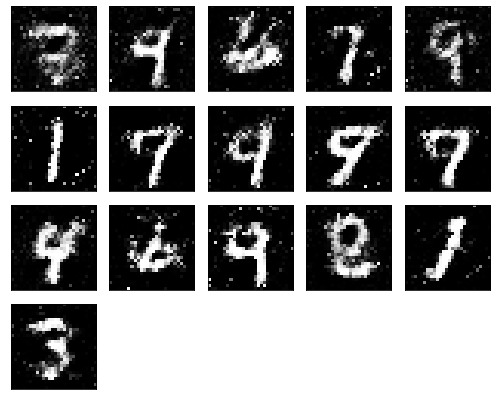

Epochs nb. 1551
discriminator loss: 0.5729705691337585
generator loss : 0.9703918695449829

Epochs nb. 1552
discriminator loss: 0.5659580230712891
generator loss : 1.0585118532180786

Epochs nb. 1553
discriminator loss: 0.49089476466178894
generator loss : 1.0620296001434326

Epochs nb. 1554
discriminator loss: 0.7074379324913025
generator loss : 0.7840575575828552

Epochs nb. 1555
discriminator loss: 0.5524790287017822
generator loss : 1.0009217262268066

Epochs nb. 1556
discriminator loss: 0.618328332901001
generator loss : 1.0139405727386475

Epochs nb. 1557
discriminator loss: 0.6140702962875366
generator loss : 1.118860125541687

Epochs nb. 1558
discriminator loss: 0.5500840544700623
generator loss : 0.9967800974845886

Epochs nb. 1559
discriminator loss: 0.5561505556106567
generator loss : 1.1496495008468628

Epochs nb. 1560
discriminator loss: 0.6582556962966919
generator loss : 1.010840892791748



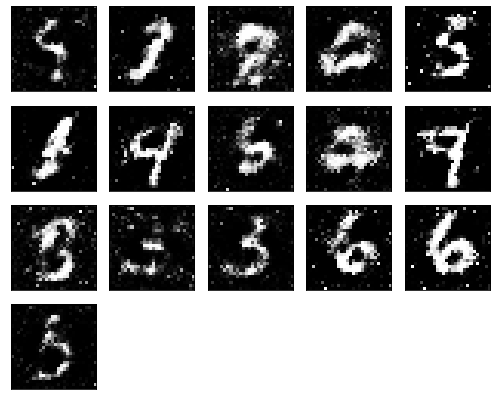

Epochs nb. 1561
discriminator loss: 0.5430302619934082
generator loss : 0.9225050210952759

Epochs nb. 1562
discriminator loss: 0.6923558115959167
generator loss : 1.1600277423858643

Epochs nb. 1563
discriminator loss: 0.540989875793457
generator loss : 0.8654295206069946

Epochs nb. 1564
discriminator loss: 0.6328064203262329
generator loss : 0.867562472820282

Epochs nb. 1565
discriminator loss: 0.5194458961486816
generator loss : 0.783320426940918

Epochs nb. 1566
discriminator loss: 0.5419913530349731
generator loss : 0.9307683110237122

Epochs nb. 1567
discriminator loss: 0.7026748657226562
generator loss : 1.1106719970703125

Epochs nb. 1568
discriminator loss: 0.6426100730895996
generator loss : 0.9224566221237183

Epochs nb. 1569
discriminator loss: 0.5443297028541565
generator loss : 0.920670747756958

Epochs nb. 1570
discriminator loss: 0.5147700905799866
generator loss : 0.9600344896316528



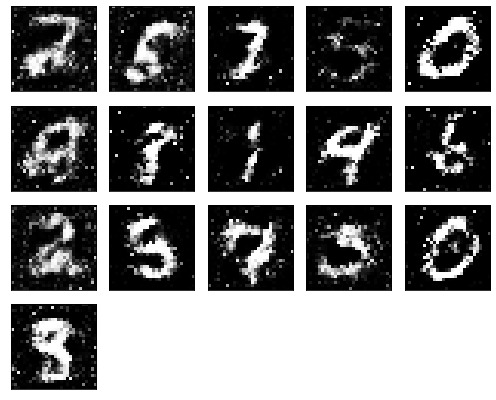

Epochs nb. 1571
discriminator loss: 0.48125484585762024
generator loss : 1.0725668668746948

Epochs nb. 1572
discriminator loss: 0.6428688764572144
generator loss : 1.0414111614227295

Epochs nb. 1573
discriminator loss: 0.6449471712112427
generator loss : 1.026646614074707

Epochs nb. 1574
discriminator loss: 0.6358945965766907
generator loss : 1.0157482624053955

Epochs nb. 1575
discriminator loss: 0.6075574159622192
generator loss : 1.0720598697662354

Epochs nb. 1576
discriminator loss: 0.5588464736938477
generator loss : 0.8613764047622681

Epochs nb. 1577
discriminator loss: 0.6127218008041382
generator loss : 0.8427850604057312

Epochs nb. 1578
discriminator loss: 0.5850553512573242
generator loss : 0.859539806842804

Epochs nb. 1579
discriminator loss: 0.5079631805419922
generator loss : 0.8698835372924805

Epochs nb. 1580
discriminator loss: 0.5298144817352295
generator loss : 1.037250280380249



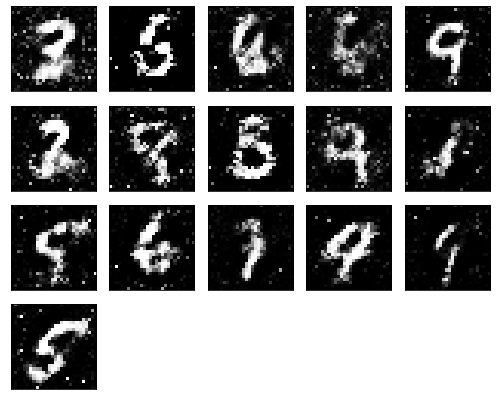

Epochs nb. 1581
discriminator loss: 0.5684764385223389
generator loss : 0.9098740220069885

Epochs nb. 1582
discriminator loss: 0.6404070258140564
generator loss : 0.9600536823272705

Epochs nb. 1583
discriminator loss: 0.5979260802268982
generator loss : 0.9118307828903198

Epochs nb. 1584
discriminator loss: 0.5827914476394653
generator loss : 0.8578872680664062

Epochs nb. 1585
discriminator loss: 0.5691444873809814
generator loss : 0.9322600364685059

Epochs nb. 1586
discriminator loss: 0.6004406213760376
generator loss : 0.9231189489364624

Epochs nb. 1587
discriminator loss: 0.49694162607192993
generator loss : 0.9973388910293579

Epochs nb. 1588
discriminator loss: 0.7134084701538086
generator loss : 0.9226775169372559

Epochs nb. 1589
discriminator loss: 0.6882575750350952
generator loss : 0.9564454555511475

Epochs nb. 1590
discriminator loss: 0.5897645354270935
generator loss : 0.9921553134918213



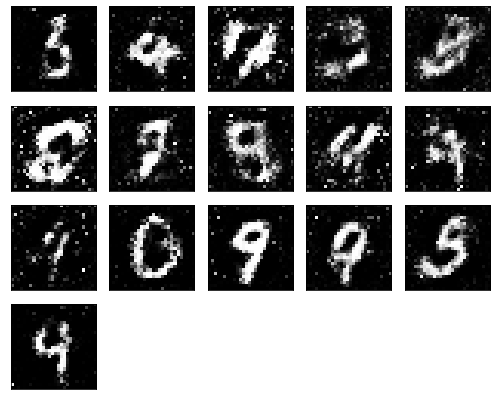

Epochs nb. 1591
discriminator loss: 0.4575735330581665
generator loss : 0.887687087059021

Epochs nb. 1592
discriminator loss: 0.5053144097328186
generator loss : 1.016631007194519

Epochs nb. 1593
discriminator loss: 0.5927587747573853
generator loss : 0.9055467844009399

Epochs nb. 1594
discriminator loss: 0.561869740486145
generator loss : 0.8751953840255737

Epochs nb. 1595
discriminator loss: 0.6503119468688965
generator loss : 0.9303292036056519

Epochs nb. 1596
discriminator loss: 0.5438422560691833
generator loss : 0.9790601134300232

Epochs nb. 1597
discriminator loss: 0.5034266710281372
generator loss : 0.8730261325836182

Epochs nb. 1598
discriminator loss: 0.5621116161346436
generator loss : 0.9111679792404175

Epochs nb. 1599
discriminator loss: 0.5345505475997925
generator loss : 0.8137311339378357

Epochs nb. 1600
discriminator loss: 0.5471103191375732
generator loss : 0.8491687774658203



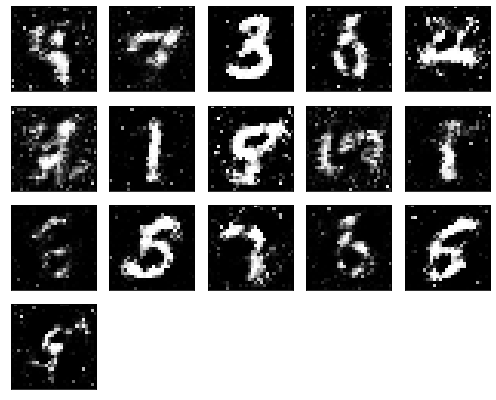

Epochs nb. 1601
discriminator loss: 0.6598379611968994
generator loss : 0.9388832449913025

Epochs nb. 1602
discriminator loss: 0.6909120082855225
generator loss : 0.9272432923316956

Epochs nb. 1603
discriminator loss: 0.5192245244979858
generator loss : 0.9072586894035339

Epochs nb. 1604
discriminator loss: 0.5274257063865662
generator loss : 1.0825040340423584

Epochs nb. 1605
discriminator loss: 0.5876204967498779
generator loss : 0.7964165806770325

Epochs nb. 1606
discriminator loss: 0.496712327003479
generator loss : 1.0762803554534912

Epochs nb. 1607
discriminator loss: 0.5356094837188721
generator loss : 1.0741658210754395

Epochs nb. 1608
discriminator loss: 0.5869570970535278
generator loss : 0.8922050595283508

Epochs nb. 1609
discriminator loss: 0.5971885919570923
generator loss : 0.8857775926589966

Epochs nb. 1610
discriminator loss: 0.6701340675354004
generator loss : 1.0060850381851196



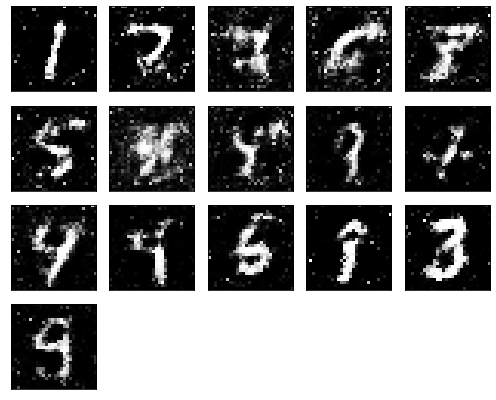

Epochs nb. 1611
discriminator loss: 0.5682523250579834
generator loss : 0.8992982506752014

Epochs nb. 1612
discriminator loss: 0.5085837244987488
generator loss : 0.9752441644668579

Epochs nb. 1613
discriminator loss: 0.6570878624916077
generator loss : 1.082260251045227

Epochs nb. 1614
discriminator loss: 0.5936393141746521
generator loss : 0.9718109369277954

Epochs nb. 1615
discriminator loss: 0.5906527042388916
generator loss : 1.0097737312316895

Epochs nb. 1616
discriminator loss: 0.5452813506126404
generator loss : 0.8644425272941589

Epochs nb. 1617
discriminator loss: 0.6682693958282471
generator loss : 1.040510654449463

Epochs nb. 1618
discriminator loss: 0.5660905838012695
generator loss : 0.8150008320808411

Epochs nb. 1619
discriminator loss: 0.5694109201431274
generator loss : 0.9726969599723816

Epochs nb. 1620
discriminator loss: 0.5041666626930237
generator loss : 0.9593260288238525



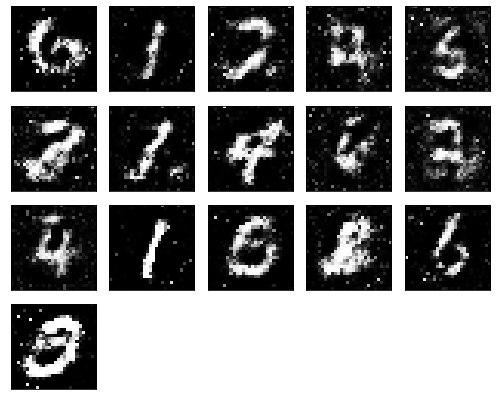

Epochs nb. 1621
discriminator loss: 0.49673670530319214
generator loss : 0.8413687944412231

Epochs nb. 1622
discriminator loss: 0.5387920141220093
generator loss : 0.9739812612533569

Epochs nb. 1623
discriminator loss: 0.6495803594589233
generator loss : 1.02302885055542

Epochs nb. 1624
discriminator loss: 0.5571107864379883
generator loss : 1.0764071941375732

Epochs nb. 1625
discriminator loss: 0.8499518632888794
generator loss : 1.0491294860839844

Epochs nb. 1626
discriminator loss: 0.5873017907142639
generator loss : 0.8795177936553955

Epochs nb. 1627
discriminator loss: 0.47938448190689087
generator loss : 0.9759602546691895

Epochs nb. 1628
discriminator loss: 0.5160257816314697
generator loss : 0.9555299282073975

Epochs nb. 1629
discriminator loss: 0.5501150488853455
generator loss : 0.9188873767852783

Epochs nb. 1630
discriminator loss: 0.7156652808189392
generator loss : 0.9614240527153015



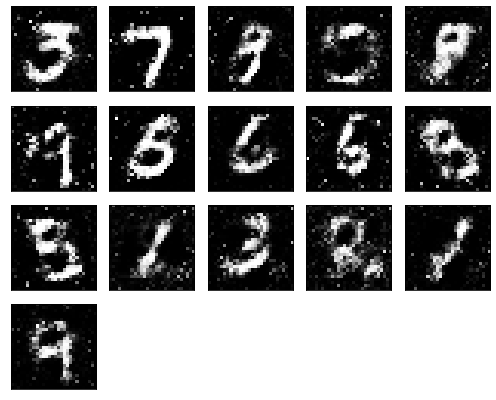

Epochs nb. 1631
discriminator loss: 0.6655441522598267
generator loss : 1.0013267993927002

Epochs nb. 1632
discriminator loss: 0.5465761423110962
generator loss : 0.9663350582122803

Epochs nb. 1633
discriminator loss: 0.5310977101325989
generator loss : 1.0220304727554321

Epochs nb. 1634
discriminator loss: 0.7220072150230408
generator loss : 1.0290491580963135

Epochs nb. 1635
discriminator loss: 0.61445152759552
generator loss : 0.9649620056152344

Epochs nb. 1636
discriminator loss: 0.5535705089569092
generator loss : 0.9908599853515625

Epochs nb. 1637
discriminator loss: 0.55256587266922
generator loss : 1.0317761898040771

Epochs nb. 1638
discriminator loss: 0.5987874269485474
generator loss : 0.9208706021308899

Epochs nb. 1639
discriminator loss: 0.49332642555236816
generator loss : 0.9176902174949646

Epochs nb. 1640
discriminator loss: 0.507473349571228
generator loss : 0.9401068687438965



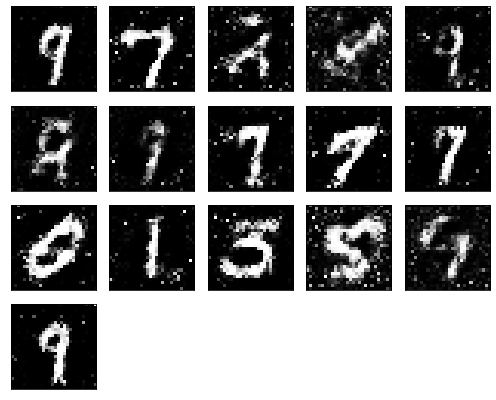

Epochs nb. 1641
discriminator loss: 0.7303336262702942
generator loss : 1.1163020133972168

Epochs nb. 1642
discriminator loss: 0.5767778158187866
generator loss : 1.0669972896575928

Epochs nb. 1643
discriminator loss: 0.588405430316925
generator loss : 0.999100923538208

Epochs nb. 1644
discriminator loss: 0.49826374650001526
generator loss : 0.9412263631820679

Epochs nb. 1645
discriminator loss: 0.6266760230064392
generator loss : 0.9457591772079468

Epochs nb. 1646
discriminator loss: 0.5840390920639038
generator loss : 0.8460856080055237

Epochs nb. 1647
discriminator loss: 0.5708499550819397
generator loss : 0.865251362323761

Epochs nb. 1648
discriminator loss: 0.5236608982086182
generator loss : 0.8391110897064209

Epochs nb. 1649
discriminator loss: 0.662020742893219
generator loss : 0.8554872274398804

Epochs nb. 1650
discriminator loss: 0.6555992364883423
generator loss : 0.903822124004364



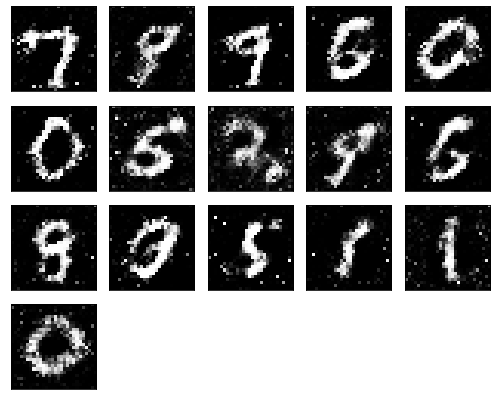

Epochs nb. 1651
discriminator loss: 0.6647420525550842
generator loss : 1.0297808647155762

Epochs nb. 1652
discriminator loss: 0.7413369417190552
generator loss : 0.9504649639129639

Epochs nb. 1653
discriminator loss: 0.5941407084465027
generator loss : 0.9348787069320679

Epochs nb. 1654
discriminator loss: 0.635023832321167
generator loss : 0.9130972027778625

Epochs nb. 1655
discriminator loss: 0.5717098712921143
generator loss : 0.9922748804092407

Epochs nb. 1656
discriminator loss: 0.6030914783477783
generator loss : 0.9056627750396729

Epochs nb. 1657
discriminator loss: 0.5461069941520691
generator loss : 0.9887701869010925

Epochs nb. 1658
discriminator loss: 0.6949511766433716
generator loss : 0.9490418434143066

Epochs nb. 1659
discriminator loss: 0.6741005182266235
generator loss : 0.9650005102157593

Epochs nb. 1660
discriminator loss: 0.5614908933639526
generator loss : 0.8283400535583496



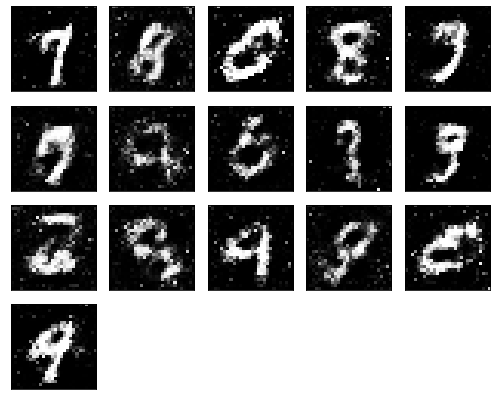

Epochs nb. 1661
discriminator loss: 0.6257398724555969
generator loss : 0.8014366626739502

Epochs nb. 1662
discriminator loss: 0.6534202098846436
generator loss : 0.7944110035896301

Epochs nb. 1663
discriminator loss: 0.5696402788162231
generator loss : 0.9211468696594238

Epochs nb. 1664
discriminator loss: 0.498266339302063
generator loss : 0.9693382978439331

Epochs nb. 1665
discriminator loss: 0.5249049663543701
generator loss : 0.912590503692627

Epochs nb. 1666
discriminator loss: 0.591602623462677
generator loss : 1.184248447418213

Epochs nb. 1667
discriminator loss: 0.5964292883872986
generator loss : 1.0130650997161865

Epochs nb. 1668
discriminator loss: 0.6006710529327393
generator loss : 0.9649014472961426

Epochs nb. 1669
discriminator loss: 0.6115576028823853
generator loss : 0.9560894966125488

Epochs nb. 1670
discriminator loss: 0.5733839869499207
generator loss : 1.0869815349578857



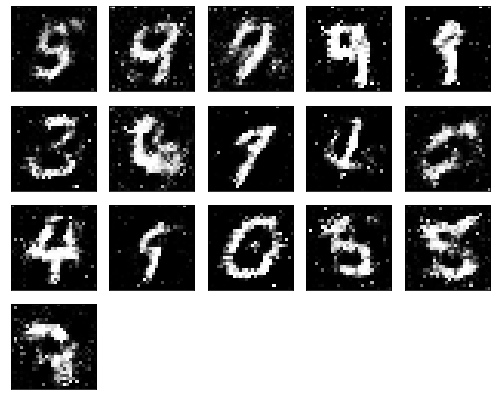

Epochs nb. 1671
discriminator loss: 0.6349446773529053
generator loss : 0.9633012413978577

Epochs nb. 1672
discriminator loss: 0.6364356875419617
generator loss : 1.1445364952087402

Epochs nb. 1673
discriminator loss: 0.4937761425971985
generator loss : 0.9138933420181274

Epochs nb. 1674
discriminator loss: 0.5257117748260498
generator loss : 1.0703887939453125

Epochs nb. 1675
discriminator loss: 0.5787577629089355
generator loss : 0.9712499976158142

Epochs nb. 1676
discriminator loss: 0.5484008193016052
generator loss : 0.9060969352722168

Epochs nb. 1677
discriminator loss: 0.6150656938552856
generator loss : 1.024491310119629

Epochs nb. 1678
discriminator loss: 0.5787516236305237
generator loss : 0.8724303245544434

Epochs nb. 1679
discriminator loss: 0.6480875611305237
generator loss : 1.0781742334365845

Epochs nb. 1680
discriminator loss: 0.609347403049469
generator loss : 0.8510016202926636



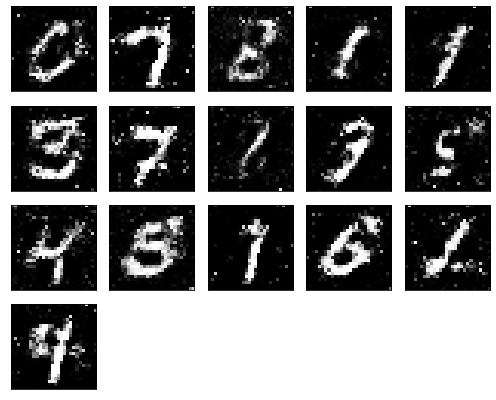

Epochs nb. 1681
discriminator loss: 0.6069880723953247
generator loss : 0.7741611003875732

Epochs nb. 1682
discriminator loss: 0.6525218486785889
generator loss : 0.9768339991569519

Epochs nb. 1683
discriminator loss: 0.5774203538894653
generator loss : 0.8081331253051758

Epochs nb. 1684
discriminator loss: 0.6204930543899536
generator loss : 0.9989184141159058

Epochs nb. 1685
discriminator loss: 0.618004322052002
generator loss : 0.9554881453514099

Epochs nb. 1686
discriminator loss: 0.5659967660903931
generator loss : 0.9337242841720581

Epochs nb. 1687
discriminator loss: 0.6119484305381775
generator loss : 0.962982177734375

Epochs nb. 1688
discriminator loss: 0.604722261428833
generator loss : 1.0525872707366943

Epochs nb. 1689
discriminator loss: 0.6473671197891235
generator loss : 0.7792524099349976

Epochs nb. 1690
discriminator loss: 0.5896032452583313
generator loss : 0.8869466781616211



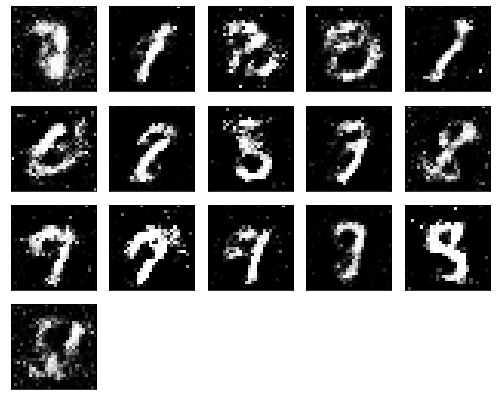

Epochs nb. 1691
discriminator loss: 0.6488915085792542
generator loss : 0.8273013830184937

Epochs nb. 1692
discriminator loss: 0.5540168285369873
generator loss : 0.8211188316345215

Epochs nb. 1693
discriminator loss: 0.560274600982666
generator loss : 0.9024785161018372

Epochs nb. 1694
discriminator loss: 0.6591076850891113
generator loss : 1.0123939514160156

Epochs nb. 1695
discriminator loss: 0.633712649345398
generator loss : 1.0997765064239502

Epochs nb. 1696
discriminator loss: 0.533053994178772
generator loss : 0.9633950591087341

Epochs nb. 1697
discriminator loss: 0.566615104675293
generator loss : 0.9581551551818848

Epochs nb. 1698
discriminator loss: 0.523217499256134
generator loss : 0.9578953981399536

Epochs nb. 1699
discriminator loss: 0.5765252113342285
generator loss : 0.9071879386901855

Epochs nb. 1700
discriminator loss: 0.6431736946105957
generator loss : 0.7475515007972717



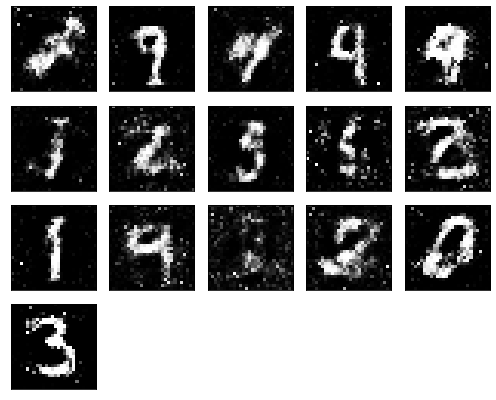

Epochs nb. 1701
discriminator loss: 0.5611433386802673
generator loss : 0.845105767250061

Epochs nb. 1702
discriminator loss: 0.6711376905441284
generator loss : 0.9101200699806213

Epochs nb. 1703
discriminator loss: 0.5776827335357666
generator loss : 0.9504334330558777

Epochs nb. 1704
discriminator loss: 0.6665596961975098
generator loss : 1.0269770622253418

Epochs nb. 1705
discriminator loss: 0.5935852527618408
generator loss : 1.098362684249878

Epochs nb. 1706
discriminator loss: 0.5324521064758301
generator loss : 0.9155653715133667

Epochs nb. 1707
discriminator loss: 0.5673068761825562
generator loss : 0.9000284075737

Epochs nb. 1708
discriminator loss: 0.6890509724617004
generator loss : 0.8539974689483643

Epochs nb. 1709
discriminator loss: 0.4927217662334442
generator loss : 1.0494403839111328

Epochs nb. 1710
discriminator loss: 0.6725469827651978
generator loss : 0.9708026647567749



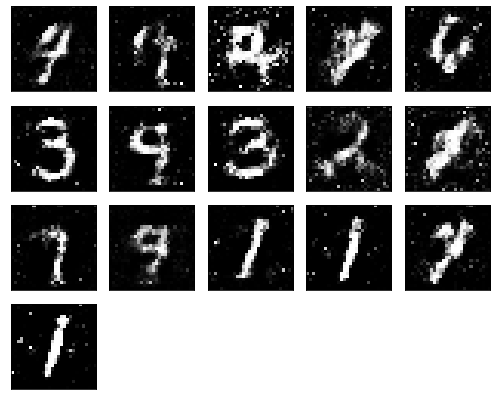

Epochs nb. 1711
discriminator loss: 0.6509943008422852
generator loss : 0.9452172517776489

Epochs nb. 1712
discriminator loss: 0.5577732920646667
generator loss : 0.8981579542160034

Epochs nb. 1713
discriminator loss: 0.6516034603118896
generator loss : 0.93436598777771

Epochs nb. 1714
discriminator loss: 0.5628792643547058
generator loss : 0.8809564113616943

Epochs nb. 1715
discriminator loss: 0.6538400053977966
generator loss : 0.9158596396446228

Epochs nb. 1716
discriminator loss: 0.5856560468673706
generator loss : 1.1272028684616089

Epochs nb. 1717
discriminator loss: 0.6158163547515869
generator loss : 0.8988065719604492

Epochs nb. 1718
discriminator loss: 0.6100949048995972
generator loss : 1.0336132049560547

Epochs nb. 1719
discriminator loss: 0.554032027721405
generator loss : 0.884817361831665

Epochs nb. 1720
discriminator loss: 0.684709906578064
generator loss : 1.0741729736328125



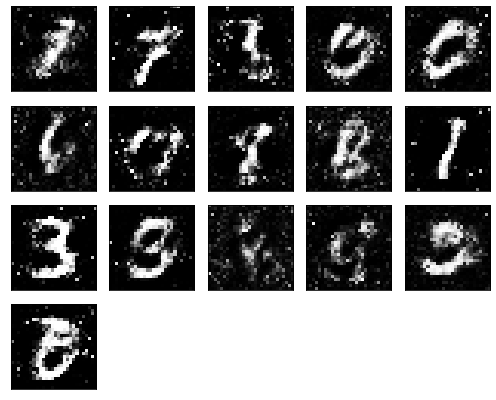

Epochs nb. 1721
discriminator loss: 0.6778159141540527
generator loss : 0.922402024269104

Epochs nb. 1722
discriminator loss: 0.5557611584663391
generator loss : 0.8797658681869507

Epochs nb. 1723
discriminator loss: 0.5626497864723206
generator loss : 0.8259322643280029

Epochs nb. 1724
discriminator loss: 0.5995879173278809
generator loss : 0.971786618232727

Epochs nb. 1725
discriminator loss: 0.6139168739318848
generator loss : 0.840198278427124

Epochs nb. 1726
discriminator loss: 0.5879544019699097
generator loss : 0.9794727563858032

Epochs nb. 1727
discriminator loss: 0.6245076656341553
generator loss : 0.980320930480957

Epochs nb. 1728
discriminator loss: 0.7052345871925354
generator loss : 0.9364590644836426

Epochs nb. 1729
discriminator loss: 0.4286876320838928
generator loss : 0.8197864294052124

Epochs nb. 1730
discriminator loss: 0.7278475761413574
generator loss : 0.9749993681907654



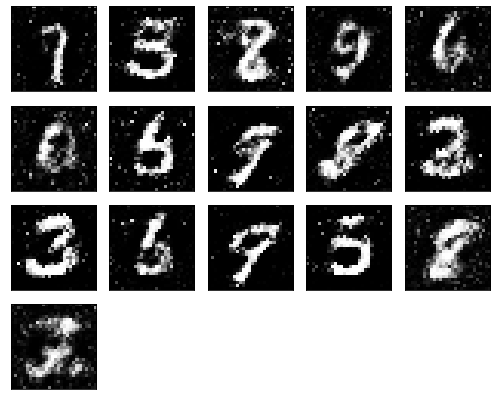

Epochs nb. 1731
discriminator loss: 0.5457437038421631
generator loss : 1.0510601997375488

Epochs nb. 1732
discriminator loss: 0.6730222105979919
generator loss : 0.869935929775238

Epochs nb. 1733
discriminator loss: 0.5206984877586365
generator loss : 0.8024781942367554

Epochs nb. 1734
discriminator loss: 0.5400011539459229
generator loss : 0.961552619934082

Epochs nb. 1735
discriminator loss: 0.5419244170188904
generator loss : 1.0218476057052612

Epochs nb. 1736
discriminator loss: 0.5219108462333679
generator loss : 0.8926055431365967

Epochs nb. 1737
discriminator loss: 0.6728044748306274
generator loss : 0.9712457656860352

Epochs nb. 1738
discriminator loss: 0.4889414310455322
generator loss : 0.9130491018295288

Epochs nb. 1739
discriminator loss: 0.7942802309989929
generator loss : 1.0321555137634277

Epochs nb. 1740
discriminator loss: 0.5254255533218384
generator loss : 0.944277822971344



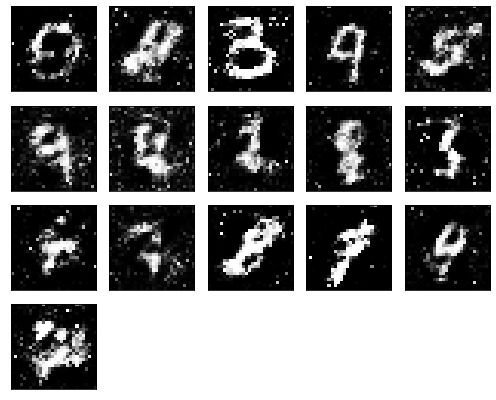

Epochs nb. 1741
discriminator loss: 0.46087339520454407
generator loss : 1.0568854808807373

Epochs nb. 1742
discriminator loss: 0.6505590677261353
generator loss : 1.0024473667144775

Epochs nb. 1743
discriminator loss: 0.650600254535675
generator loss : 1.0400512218475342

Epochs nb. 1744
discriminator loss: 0.6114052534103394
generator loss : 0.9702332019805908

Epochs nb. 1745
discriminator loss: 0.5971511602401733
generator loss : 0.9613062143325806

Epochs nb. 1746
discriminator loss: 0.5424385070800781
generator loss : 0.8864389657974243

Epochs nb. 1747
discriminator loss: 0.4996837079524994
generator loss : 0.913748025894165

Epochs nb. 1748
discriminator loss: 0.575080156326294
generator loss : 1.052358627319336

Epochs nb. 1749
discriminator loss: 0.5279240608215332
generator loss : 0.9640614986419678

Epochs nb. 1750
discriminator loss: 0.4494793713092804
generator loss : 0.8197281360626221



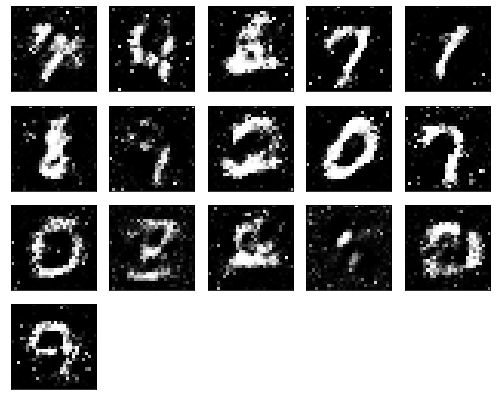

Epochs nb. 1751
discriminator loss: 0.570460319519043
generator loss : 0.8983547687530518

Epochs nb. 1752
discriminator loss: 0.42158403992652893
generator loss : 1.0081331729888916

Epochs nb. 1753
discriminator loss: 0.5834982395172119
generator loss : 1.0552802085876465

Epochs nb. 1754
discriminator loss: 0.5089778900146484
generator loss : 1.1414515972137451

Epochs nb. 1755
discriminator loss: 0.6332666873931885
generator loss : 1.008145809173584

Epochs nb. 1756
discriminator loss: 0.5583367347717285
generator loss : 0.932403564453125

Epochs nb. 1757
discriminator loss: 0.6759121417999268
generator loss : 0.8803883790969849

Epochs nb. 1758
discriminator loss: 0.6364346742630005
generator loss : 1.0482044219970703

Epochs nb. 1759
discriminator loss: 0.5351527333259583
generator loss : 1.0505821704864502

Epochs nb. 1760
discriminator loss: 0.5785850286483765
generator loss : 0.8581886291503906



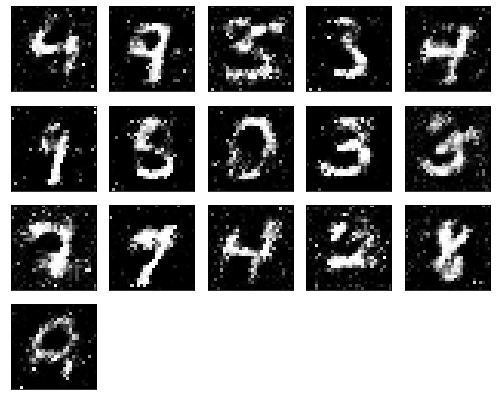

Epochs nb. 1761
discriminator loss: 0.5153077840805054
generator loss : 0.9310106039047241

Epochs nb. 1762
discriminator loss: 0.5566451549530029
generator loss : 0.9847691059112549

Epochs nb. 1763
discriminator loss: 0.5150504112243652
generator loss : 0.853775680065155

Epochs nb. 1764
discriminator loss: 0.6388616561889648
generator loss : 1.023323655128479

Epochs nb. 1765
discriminator loss: 0.5658747553825378
generator loss : 0.9588990807533264

Epochs nb. 1766
discriminator loss: 0.6307594776153564
generator loss : 1.1418894529342651

Epochs nb. 1767
discriminator loss: 0.5734426975250244
generator loss : 1.0255770683288574

Epochs nb. 1768
discriminator loss: 0.4952351748943329
generator loss : 0.9395224452018738

Epochs nb. 1769
discriminator loss: 0.5723170042037964
generator loss : 0.9035359621047974

Epochs nb. 1770
discriminator loss: 0.4808390140533447
generator loss : 0.9311679005622864



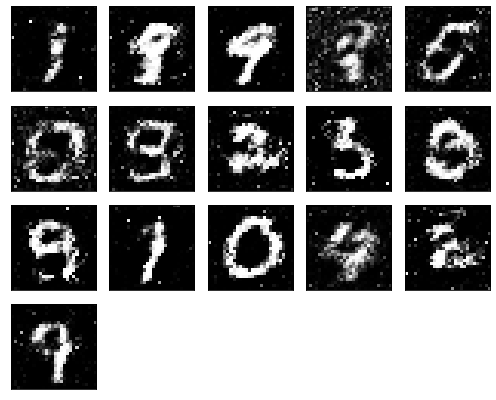

Epochs nb. 1771
discriminator loss: 0.6583858728408813
generator loss : 1.0873644351959229

Epochs nb. 1772
discriminator loss: 0.5625990629196167
generator loss : 1.0089843273162842

Epochs nb. 1773
discriminator loss: 0.5840407609939575
generator loss : 0.9614477157592773

Epochs nb. 1774
discriminator loss: 0.649144172668457
generator loss : 1.0162955522537231

Epochs nb. 1775
discriminator loss: 0.6376947164535522
generator loss : 1.0163525342941284

Epochs nb. 1776
discriminator loss: 0.7451850175857544
generator loss : 0.9436826705932617

Epochs nb. 1777
discriminator loss: 0.541685938835144
generator loss : 1.0230852365493774

Epochs nb. 1778
discriminator loss: 0.5885633230209351
generator loss : 1.140936017036438

Epochs nb. 1779
discriminator loss: 0.6012109518051147
generator loss : 1.0972509384155273

Epochs nb. 1780
discriminator loss: 0.5566544532775879
generator loss : 0.937441885471344



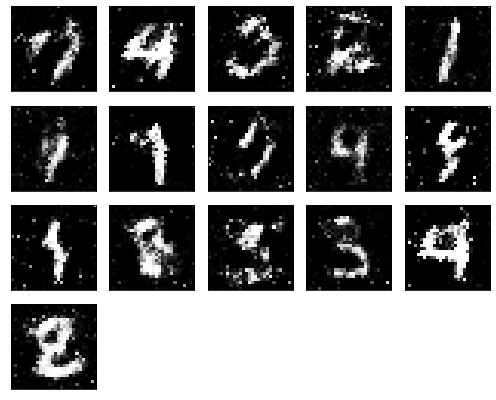

Epochs nb. 1781
discriminator loss: 0.6165598034858704
generator loss : 0.8684009313583374

Epochs nb. 1782
discriminator loss: 0.5889568328857422
generator loss : 0.9593005180358887

Epochs nb. 1783
discriminator loss: 0.578339695930481
generator loss : 0.8600537776947021

Epochs nb. 1784
discriminator loss: 0.5509994029998779
generator loss : 0.8117287158966064

Epochs nb. 1785
discriminator loss: 0.5397590398788452
generator loss : 1.077189564704895

Epochs nb. 1786
discriminator loss: 0.63546222448349
generator loss : 1.2202582359313965

Epochs nb. 1787
discriminator loss: 0.5542258024215698
generator loss : 1.1948132514953613

Epochs nb. 1788
discriminator loss: 0.4719884991645813
generator loss : 0.9196330308914185

Epochs nb. 1789
discriminator loss: 0.6595556735992432
generator loss : 0.8586617708206177

Epochs nb. 1790
discriminator loss: 0.5887299180030823
generator loss : 1.000458002090454



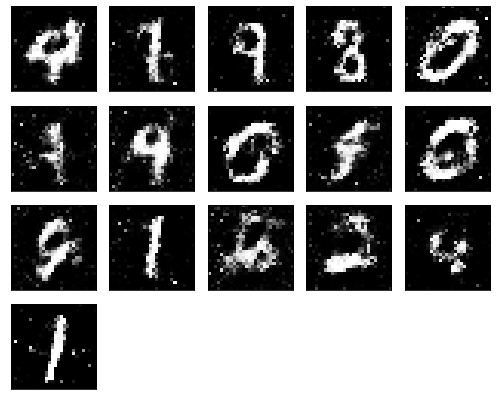

Epochs nb. 1791
discriminator loss: 0.6315723657608032
generator loss : 1.018378734588623

Epochs nb. 1792
discriminator loss: 0.5770164728164673
generator loss : 0.9878814220428467

Epochs nb. 1793
discriminator loss: 0.6875694990158081
generator loss : 0.9484360218048096

Epochs nb. 1794
discriminator loss: 0.5039533972740173
generator loss : 1.061115026473999

Epochs nb. 1795
discriminator loss: 0.5860318541526794
generator loss : 1.0708025693893433

Epochs nb. 1796
discriminator loss: 0.5518850088119507
generator loss : 1.074662685394287

Epochs nb. 1797
discriminator loss: 0.5715762376785278
generator loss : 0.9366129040718079

Epochs nb. 1798
discriminator loss: 0.4899568557739258
generator loss : 1.0969822406768799

Epochs nb. 1799
discriminator loss: 0.6557670831680298
generator loss : 1.0232051610946655

Epochs nb. 1800
discriminator loss: 0.6274967193603516
generator loss : 1.0687576532363892



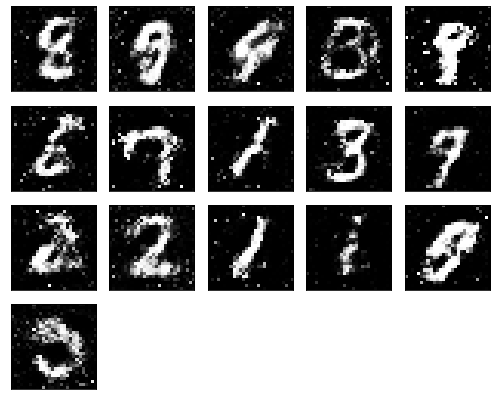

Epochs nb. 1801
discriminator loss: 0.7131438255310059
generator loss : 0.9244108200073242

Epochs nb. 1802
discriminator loss: 0.557673990726471
generator loss : 0.8612363338470459

Epochs nb. 1803
discriminator loss: 0.6713364124298096
generator loss : 1.0090644359588623

Epochs nb. 1804
discriminator loss: 0.4340096116065979
generator loss : 0.951905369758606

Epochs nb. 1805
discriminator loss: 0.7333178520202637
generator loss : 0.86374431848526

Epochs nb. 1806
discriminator loss: 0.6543633341789246
generator loss : 0.9566780924797058

Epochs nb. 1807
discriminator loss: 0.5453720092773438
generator loss : 0.7769918441772461

Epochs nb. 1808
discriminator loss: 0.674536406993866
generator loss : 0.9793136119842529

Epochs nb. 1809
discriminator loss: 0.6266764998435974
generator loss : 0.9449942111968994

Epochs nb. 1810
discriminator loss: 0.5277127623558044
generator loss : 1.0373001098632812



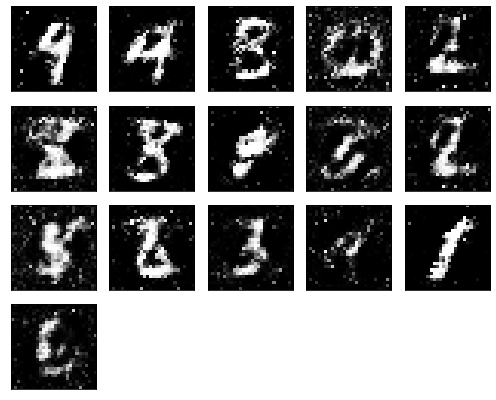

Epochs nb. 1811
discriminator loss: 0.611527681350708
generator loss : 1.1285903453826904

Epochs nb. 1812
discriminator loss: 0.6043623685836792
generator loss : 0.9338832497596741

Epochs nb. 1813
discriminator loss: 0.6983466148376465
generator loss : 0.9393547773361206

Epochs nb. 1814
discriminator loss: 0.7406184673309326
generator loss : 0.9603753685951233

Epochs nb. 1815
discriminator loss: 0.5741622447967529
generator loss : 0.8935708999633789

Epochs nb. 1816
discriminator loss: 0.5042152404785156
generator loss : 0.996208667755127

Epochs nb. 1817
discriminator loss: 0.5310394167900085
generator loss : 1.0261046886444092

Epochs nb. 1818
discriminator loss: 0.4984198808670044
generator loss : 1.000319004058838

Epochs nb. 1819
discriminator loss: 0.6056098937988281
generator loss : 0.8441915512084961

Epochs nb. 1820
discriminator loss: 0.558890163898468
generator loss : 1.0167171955108643



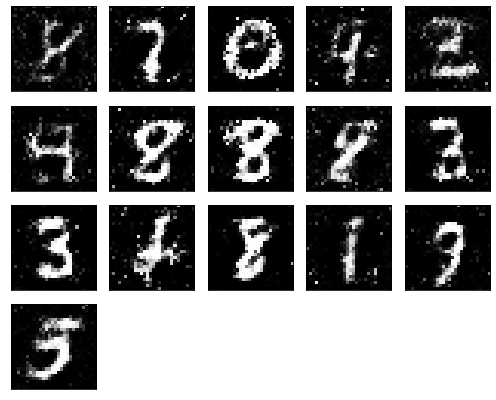

Epochs nb. 1821
discriminator loss: 0.7415339946746826
generator loss : 1.0580685138702393

Epochs nb. 1822
discriminator loss: 0.5647228956222534
generator loss : 1.0649640560150146

Epochs nb. 1823
discriminator loss: 0.63362717628479
generator loss : 1.0448049306869507

Epochs nb. 1824
discriminator loss: 0.5617727041244507
generator loss : 0.9276061058044434

Epochs nb. 1825
discriminator loss: 0.5560752153396606
generator loss : 0.9162232875823975

Epochs nb. 1826
discriminator loss: 0.5255513787269592
generator loss : 0.972785234451294

Epochs nb. 1827
discriminator loss: 0.5644614696502686
generator loss : 0.8171436786651611

Epochs nb. 1828
discriminator loss: 0.4942454695701599
generator loss : 0.9946960210800171

Epochs nb. 1829
discriminator loss: 0.6169335842132568
generator loss : 0.8852700591087341

Epochs nb. 1830
discriminator loss: 0.5931222438812256
generator loss : 0.8820800185203552



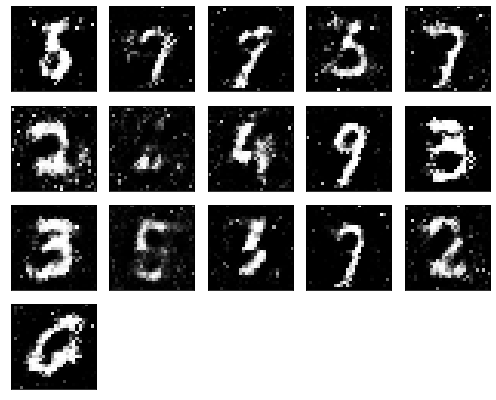

Epochs nb. 1831
discriminator loss: 0.6206777095794678
generator loss : 1.0030771493911743

Epochs nb. 1832
discriminator loss: 0.5312699675559998
generator loss : 0.8554893732070923

Epochs nb. 1833
discriminator loss: 0.5617482662200928
generator loss : 0.9551663398742676

Epochs nb. 1834
discriminator loss: 0.6295368671417236
generator loss : 0.9908175468444824

Epochs nb. 1835
discriminator loss: 0.6394236087799072
generator loss : 0.846203625202179

Epochs nb. 1836
discriminator loss: 0.549274206161499
generator loss : 0.9227388501167297

Epochs nb. 1837
discriminator loss: 0.5625627040863037
generator loss : 1.1060388088226318

Epochs nb. 1838
discriminator loss: 0.645431637763977
generator loss : 0.7534469962120056

Epochs nb. 1839
discriminator loss: 0.5787808299064636
generator loss : 0.8864767551422119

Epochs nb. 1840
discriminator loss: 0.4941435754299164
generator loss : 1.1320654153823853



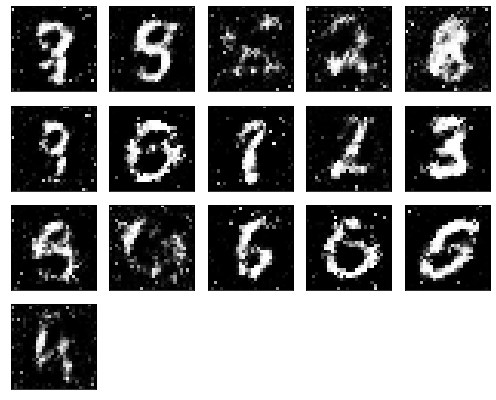

Epochs nb. 1841
discriminator loss: 0.5711389780044556
generator loss : 1.0639469623565674

Epochs nb. 1842
discriminator loss: 0.5348747968673706
generator loss : 1.03414785861969

Epochs nb. 1843
discriminator loss: 0.6049972772598267
generator loss : 1.0412989854812622

Epochs nb. 1844
discriminator loss: 0.5262359380722046
generator loss : 1.0116240978240967

Epochs nb. 1845
discriminator loss: 0.6654796600341797
generator loss : 0.8922680616378784

Epochs nb. 1846
discriminator loss: 0.6692280769348145
generator loss : 0.9205443263053894

Epochs nb. 1847
discriminator loss: 0.6519476175308228
generator loss : 0.9123517274856567

Epochs nb. 1848
discriminator loss: 0.5425485372543335
generator loss : 1.021105408668518

Epochs nb. 1849
discriminator loss: 0.6145727634429932
generator loss : 1.0094020366668701

Epochs nb. 1850
discriminator loss: 0.5619098544120789
generator loss : 0.9535834789276123



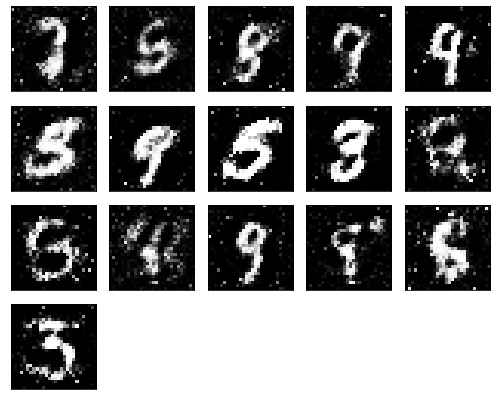

Epochs nb. 1851
discriminator loss: 0.579082727432251
generator loss : 0.9424550533294678

Epochs nb. 1852
discriminator loss: 0.5834911465644836
generator loss : 1.0031509399414062

Epochs nb. 1853
discriminator loss: 0.554389476776123
generator loss : 0.8631560802459717

Epochs nb. 1854
discriminator loss: 0.5940661430358887
generator loss : 0.9195942878723145

Epochs nb. 1855
discriminator loss: 0.5563664436340332
generator loss : 1.10826575756073

Epochs nb. 1856
discriminator loss: 0.5275552272796631
generator loss : 1.0949084758758545

Epochs nb. 1857
discriminator loss: 0.5731450319290161
generator loss : 1.0892002582550049

Epochs nb. 1858
discriminator loss: 0.5157800912857056
generator loss : 1.0055184364318848

Epochs nb. 1859
discriminator loss: 0.5482292175292969
generator loss : 1.0877456665039062

Epochs nb. 1860
discriminator loss: 0.4942794442176819
generator loss : 1.1458684206008911



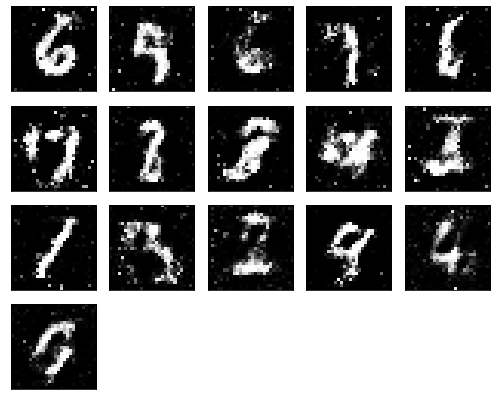

Epochs nb. 1861
discriminator loss: 0.6093512773513794
generator loss : 1.024275541305542

Epochs nb. 1862
discriminator loss: 0.41891711950302124
generator loss : 1.0553183555603027

Epochs nb. 1863
discriminator loss: 0.5880152583122253
generator loss : 1.004629135131836

Epochs nb. 1864
discriminator loss: 0.5743568539619446
generator loss : 0.996920108795166

Epochs nb. 1865
discriminator loss: 0.5717346668243408
generator loss : 1.0136475563049316

Epochs nb. 1866
discriminator loss: 0.5655564665794373
generator loss : 1.1039119958877563

Epochs nb. 1867
discriminator loss: 0.45231544971466064
generator loss : 1.1362168788909912

Epochs nb. 1868
discriminator loss: 0.7074897289276123
generator loss : 0.9875713586807251

Epochs nb. 1869
discriminator loss: 0.5206912755966187
generator loss : 0.9187488555908203

Epochs nb. 1870
discriminator loss: 0.6743484139442444
generator loss : 0.972899854183197



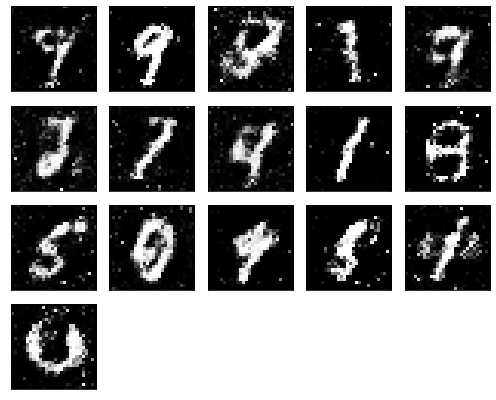

Epochs nb. 1871
discriminator loss: 0.5684328079223633
generator loss : 0.9467098712921143

Epochs nb. 1872
discriminator loss: 0.5885190367698669
generator loss : 1.1720314025878906

Epochs nb. 1873
discriminator loss: 0.585013210773468
generator loss : 0.804061233997345

Epochs nb. 1874
discriminator loss: 0.5249588489532471
generator loss : 1.0187113285064697

Epochs nb. 1875
discriminator loss: 0.5366827249526978
generator loss : 1.0513572692871094

Epochs nb. 1876
discriminator loss: 0.6697162389755249
generator loss : 0.8572708368301392

Epochs nb. 1877
discriminator loss: 0.572575032711029
generator loss : 1.0215661525726318

Epochs nb. 1878
discriminator loss: 0.6139904856681824
generator loss : 0.973279595375061

Epochs nb. 1879
discriminator loss: 0.5274982452392578
generator loss : 0.8747280836105347

Epochs nb. 1880
discriminator loss: 0.6599870920181274
generator loss : 0.8914315700531006



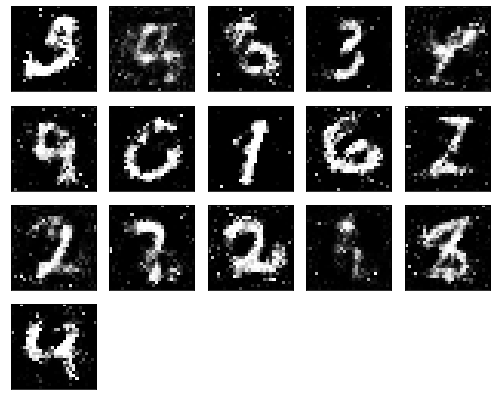

Epochs nb. 1881
discriminator loss: 0.556218683719635
generator loss : 0.8755751848220825

Epochs nb. 1882
discriminator loss: 0.5277131199836731
generator loss : 0.971598207950592

Epochs nb. 1883
discriminator loss: 0.5691470503807068
generator loss : 0.9535421133041382

Epochs nb. 1884
discriminator loss: 0.5593624711036682
generator loss : 1.0965847969055176

Epochs nb. 1885
discriminator loss: 0.45989370346069336
generator loss : 0.877009391784668

Epochs nb. 1886
discriminator loss: 0.6602734327316284
generator loss : 0.9159773588180542

Epochs nb. 1887
discriminator loss: 0.5637415647506714
generator loss : 1.0265834331512451

Epochs nb. 1888
discriminator loss: 0.620629072189331
generator loss : 0.9544937610626221

Epochs nb. 1889
discriminator loss: 0.7608352899551392
generator loss : 0.9312723875045776

Epochs nb. 1890
discriminator loss: 0.6168779730796814
generator loss : 0.9337097406387329



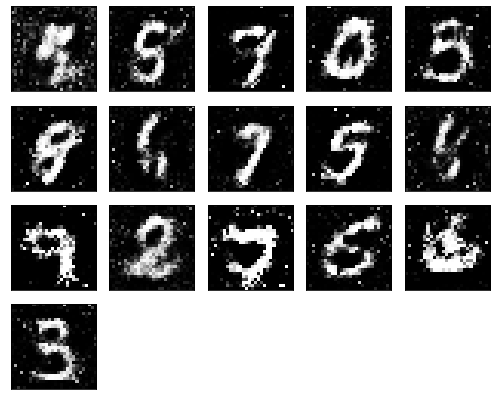

Epochs nb. 1891
discriminator loss: 0.6179513335227966
generator loss : 0.7716897130012512

Epochs nb. 1892
discriminator loss: 0.6404323577880859
generator loss : 0.7308670878410339

Epochs nb. 1893
discriminator loss: 0.5458333492279053
generator loss : 0.8086966872215271

Epochs nb. 1894
discriminator loss: 0.7133148312568665
generator loss : 0.9131710529327393

Epochs nb. 1895
discriminator loss: 0.6535419821739197
generator loss : 1.1563541889190674

Epochs nb. 1896
discriminator loss: 0.6001639366149902
generator loss : 1.0185421705245972

Epochs nb. 1897
discriminator loss: 0.6085256934165955
generator loss : 1.0351660251617432

Epochs nb. 1898
discriminator loss: 0.6977731585502625
generator loss : 0.8946695327758789

Epochs nb. 1899
discriminator loss: 0.6035754084587097
generator loss : 0.9230186939239502

Epochs nb. 1900
discriminator loss: 0.5452559590339661
generator loss : 0.9551252126693726



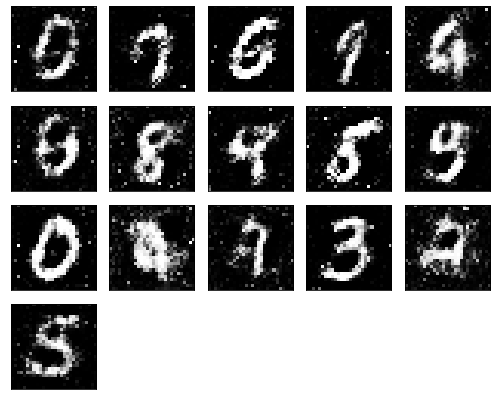

Epochs nb. 1901
discriminator loss: 0.6289376020431519
generator loss : 0.8931475877761841

Epochs nb. 1902
discriminator loss: 0.5635057687759399
generator loss : 1.0005548000335693

Epochs nb. 1903
discriminator loss: 0.5434542894363403
generator loss : 0.9174858927726746

Epochs nb. 1904
discriminator loss: 0.5601247549057007
generator loss : 0.9082331657409668

Epochs nb. 1905
discriminator loss: 0.546513020992279
generator loss : 0.777920126914978

Epochs nb. 1906
discriminator loss: 0.5558021068572998
generator loss : 0.8435516357421875

Epochs nb. 1907
discriminator loss: 0.7059162855148315
generator loss : 0.9511028528213501

Epochs nb. 1908
discriminator loss: 0.6475680470466614
generator loss : 0.8767340779304504

Epochs nb. 1909
discriminator loss: 0.6827847361564636
generator loss : 0.9311298727989197

Epochs nb. 1910
discriminator loss: 0.7037991285324097
generator loss : 0.7607388496398926



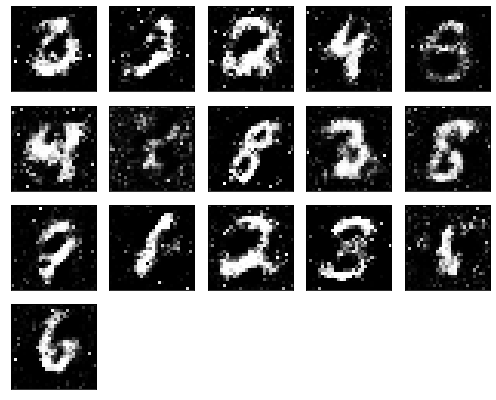

Epochs nb. 1911
discriminator loss: 0.6856411695480347
generator loss : 0.8404260873794556

Epochs nb. 1912
discriminator loss: 0.6596665382385254
generator loss : 0.8364253044128418

Epochs nb. 1913
discriminator loss: 0.4763341546058655
generator loss : 0.7471950054168701

Epochs nb. 1914
discriminator loss: 0.6937799453735352
generator loss : 0.8724862337112427

Epochs nb. 1915
discriminator loss: 0.5563162565231323
generator loss : 0.8418880701065063

Epochs nb. 1916
discriminator loss: 0.7101008892059326
generator loss : 0.9177408814430237

Epochs nb. 1917
discriminator loss: 0.5725001096725464
generator loss : 1.0842170715332031

Epochs nb. 1918
discriminator loss: 0.6158760190010071
generator loss : 0.931462824344635

Epochs nb. 1919
discriminator loss: 0.6243455410003662
generator loss : 0.9048063158988953

Epochs nb. 1920
discriminator loss: 0.6172155141830444
generator loss : 0.982464075088501



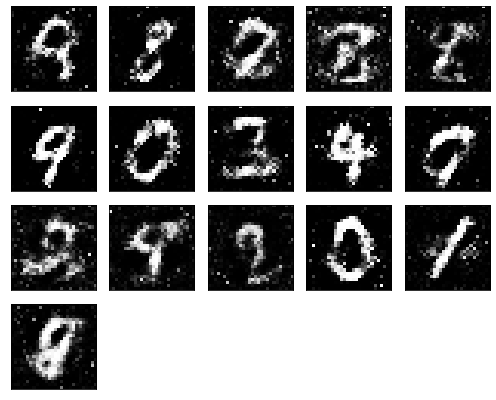

Epochs nb. 1921
discriminator loss: 0.7429683804512024
generator loss : 0.9916899800300598

Epochs nb. 1922
discriminator loss: 0.5660404562950134
generator loss : 1.1294647455215454

Epochs nb. 1923
discriminator loss: 0.5114679932594299
generator loss : 1.018080472946167

Epochs nb. 1924
discriminator loss: 0.7866626977920532
generator loss : 0.9768152832984924

Epochs nb. 1925
discriminator loss: 0.6112658381462097
generator loss : 0.9168828725814819

Epochs nb. 1926
discriminator loss: 0.6016402244567871
generator loss : 0.8751496076583862

Epochs nb. 1927
discriminator loss: 0.6208470463752747
generator loss : 0.830844521522522

Epochs nb. 1928
discriminator loss: 0.530185878276825
generator loss : 0.789780855178833

Epochs nb. 1929
discriminator loss: 0.5700883865356445
generator loss : 0.989078164100647

Epochs nb. 1930
discriminator loss: 0.6145747900009155
generator loss : 0.9331040382385254



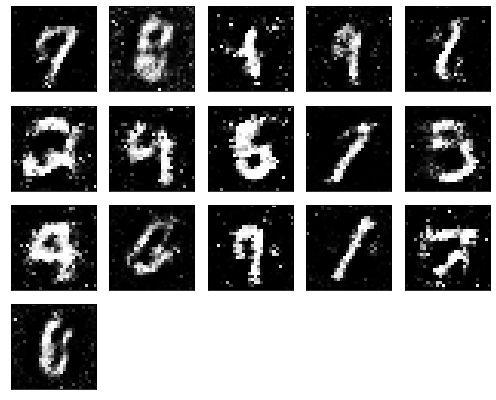

Epochs nb. 1931
discriminator loss: 0.5203386545181274
generator loss : 0.9342529773712158

Epochs nb. 1932
discriminator loss: 0.6693835258483887
generator loss : 0.901106595993042

Epochs nb. 1933
discriminator loss: 0.49586957693099976
generator loss : 1.1016058921813965

Epochs nb. 1934
discriminator loss: 0.7061606645584106
generator loss : 0.9755516052246094

Epochs nb. 1935
discriminator loss: 0.704409122467041
generator loss : 0.9728080630302429

Epochs nb. 1936
discriminator loss: 0.5442366003990173
generator loss : 1.0135568380355835

Epochs nb. 1937
discriminator loss: 0.6473596096038818
generator loss : 1.0067640542984009

Epochs nb. 1938
discriminator loss: 0.6618332862854004
generator loss : 0.9333394169807434

Epochs nb. 1939
discriminator loss: 0.6566938161849976
generator loss : 0.9422528743743896

Epochs nb. 1940
discriminator loss: 0.5369399785995483
generator loss : 0.9475568532943726



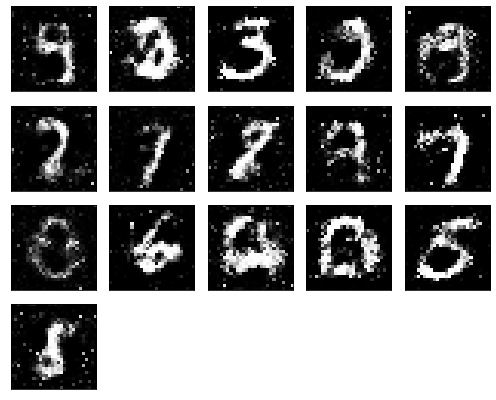

Epochs nb. 1941
discriminator loss: 0.6298907995223999
generator loss : 0.9323264360427856

Epochs nb. 1942
discriminator loss: 0.4941333532333374
generator loss : 1.1046764850616455

Epochs nb. 1943
discriminator loss: 0.6106809973716736
generator loss : 0.9583728313446045

Epochs nb. 1944
discriminator loss: 0.5253265500068665
generator loss : 0.978326678276062

Epochs nb. 1945
discriminator loss: 0.6375167965888977
generator loss : 1.0906226634979248

Epochs nb. 1946
discriminator loss: 0.5487236976623535
generator loss : 0.8670650720596313

Epochs nb. 1947
discriminator loss: 0.5759136080741882
generator loss : 1.003486156463623

Epochs nb. 1948
discriminator loss: 0.5804689526557922
generator loss : 1.1494766473770142

Epochs nb. 1949
discriminator loss: 0.5552648305892944
generator loss : 0.9403177499771118

Epochs nb. 1950
discriminator loss: 0.6290286779403687
generator loss : 0.8621463775634766



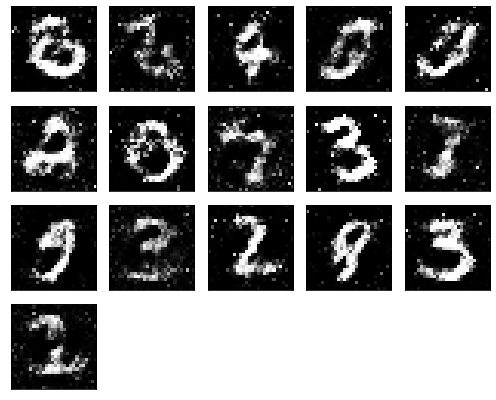

Epochs nb. 1951
discriminator loss: 0.47070538997650146
generator loss : 0.8387826681137085

Epochs nb. 1952
discriminator loss: 0.620343029499054
generator loss : 0.8971600532531738

Epochs nb. 1953
discriminator loss: 0.6252988576889038
generator loss : 0.9388729333877563

Epochs nb. 1954
discriminator loss: 0.7549487352371216
generator loss : 1.1135444641113281

Epochs nb. 1955
discriminator loss: 0.5601697564125061
generator loss : 1.0742926597595215

Epochs nb. 1956
discriminator loss: 0.45485544204711914
generator loss : 0.979597806930542

Epochs nb. 1957
discriminator loss: 0.6446608901023865
generator loss : 1.003006935119629

Epochs nb. 1958
discriminator loss: 0.6897566914558411
generator loss : 0.7704656720161438

Epochs nb. 1959
discriminator loss: 0.6572138667106628
generator loss : 1.0258491039276123

Epochs nb. 1960
discriminator loss: 0.6177112460136414
generator loss : 0.8744763135910034



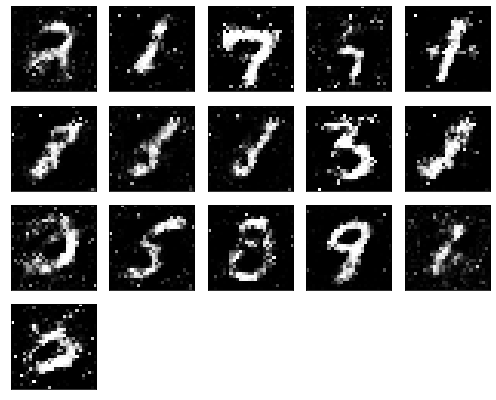

Epochs nb. 1961
discriminator loss: 0.5799797773361206
generator loss : 1.023191213607788

Epochs nb. 1962
discriminator loss: 0.5541645288467407
generator loss : 1.1347538232803345

Epochs nb. 1963
discriminator loss: 0.5096489191055298
generator loss : 1.14158296585083

Epochs nb. 1964
discriminator loss: 0.6578755378723145
generator loss : 1.0139174461364746

Epochs nb. 1965
discriminator loss: 0.5789334774017334
generator loss : 0.9187586903572083

Epochs nb. 1966
discriminator loss: 0.7082419991493225
generator loss : 1.1421568393707275

Epochs nb. 1967
discriminator loss: 0.6113965511322021
generator loss : 0.9822224378585815

Epochs nb. 1968
discriminator loss: 0.6333467960357666
generator loss : 0.8876063823699951

Epochs nb. 1969
discriminator loss: 0.4979352355003357
generator loss : 1.0878337621688843

Epochs nb. 1970
discriminator loss: 0.5799427628517151
generator loss : 0.9773833155632019



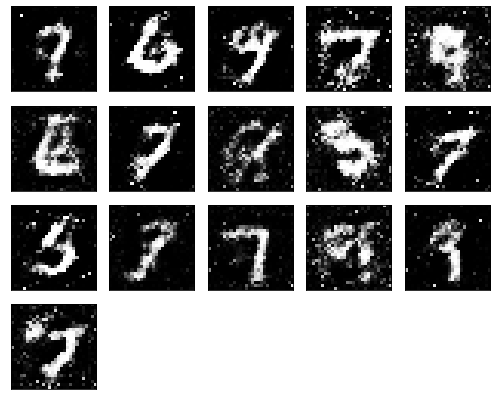

Epochs nb. 1971
discriminator loss: 0.531871497631073
generator loss : 1.0320533514022827

Epochs nb. 1972
discriminator loss: 0.5288252830505371
generator loss : 1.0458587408065796

Epochs nb. 1973
discriminator loss: 0.5053918957710266
generator loss : 1.0181242227554321

Epochs nb. 1974
discriminator loss: 0.6156838536262512
generator loss : 0.9097557663917542

Epochs nb. 1975
discriminator loss: 0.5991252064704895
generator loss : 1.0926162004470825

Epochs nb. 1976
discriminator loss: 0.6226206421852112
generator loss : 0.8910806179046631

Epochs nb. 1977
discriminator loss: 0.6013518571853638
generator loss : 0.9877152442932129

Epochs nb. 1978
discriminator loss: 0.6082427501678467
generator loss : 1.0444821119308472

Epochs nb. 1979
discriminator loss: 0.5831749439239502
generator loss : 1.0950512886047363

Epochs nb. 1980
discriminator loss: 0.524116039276123
generator loss : 0.9722731113433838



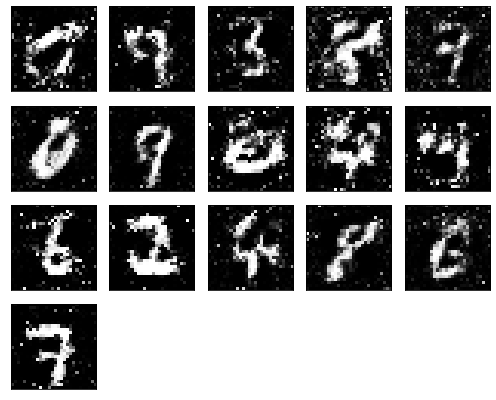

Epochs nb. 1981
discriminator loss: 0.6228840351104736
generator loss : 0.9634369611740112

Epochs nb. 1982
discriminator loss: 0.515769898891449
generator loss : 0.9914151430130005

Epochs nb. 1983
discriminator loss: 0.6401281356811523
generator loss : 0.9347335696220398

Epochs nb. 1984
discriminator loss: 0.6028003692626953
generator loss : 1.019729495048523

Epochs nb. 1985
discriminator loss: 0.5776019096374512
generator loss : 0.9646821022033691

Epochs nb. 1986
discriminator loss: 0.6667782068252563
generator loss : 0.864853024482727

Epochs nb. 1987
discriminator loss: 0.4763418436050415
generator loss : 0.9365909099578857

Epochs nb. 1988
discriminator loss: 0.630882740020752
generator loss : 0.8698595762252808

Epochs nb. 1989
discriminator loss: 0.5177720785140991
generator loss : 1.0888175964355469

Epochs nb. 1990
discriminator loss: 0.7022112011909485
generator loss : 1.085937261581421



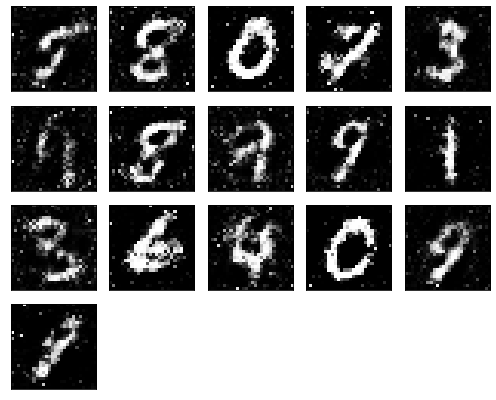

Epochs nb. 1991
discriminator loss: 0.5820879936218262
generator loss : 1.0619038343429565

Epochs nb. 1992
discriminator loss: 0.4884324073791504
generator loss : 1.0139918327331543

Epochs nb. 1993
discriminator loss: 0.5228605270385742
generator loss : 1.0038388967514038

Epochs nb. 1994
discriminator loss: 0.5491580367088318
generator loss : 1.0916025638580322

Epochs nb. 1995
discriminator loss: 0.6736500263214111
generator loss : 1.0694987773895264

Epochs nb. 1996
discriminator loss: 0.6244267225265503
generator loss : 0.8576832413673401

Epochs nb. 1997
discriminator loss: 0.6976879835128784
generator loss : 0.8098949790000916

Epochs nb. 1998
discriminator loss: 0.5948501825332642
generator loss : 0.7948238253593445

Epochs nb. 1999
discriminator loss: 0.7095015048980713
generator loss : 0.9050781726837158

Epochs nb. 2000
discriminator loss: 0.5302808284759521
generator loss : 0.9702014327049255



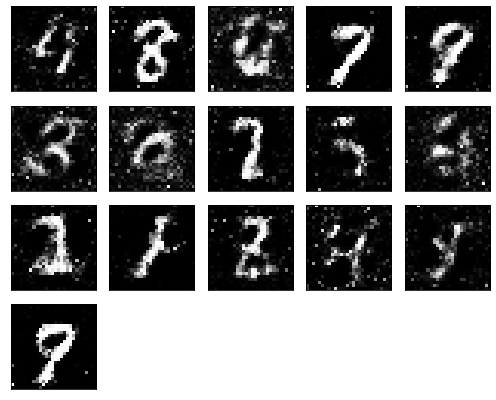

Epochs nb. 2001
discriminator loss: 0.44497573375701904
generator loss : 0.8413355350494385

Epochs nb. 2002
discriminator loss: 0.5615660548210144
generator loss : 1.0438108444213867

Epochs nb. 2003
discriminator loss: 0.7044320702552795
generator loss : 0.7811254262924194

Epochs nb. 2004
discriminator loss: 0.5640497207641602
generator loss : 0.8238216042518616

Epochs nb. 2005
discriminator loss: 0.5627419948577881
generator loss : 1.053168773651123

Epochs nb. 2006
discriminator loss: 0.5926204919815063
generator loss : 0.89888596534729

Epochs nb. 2007
discriminator loss: 0.675308346748352
generator loss : 0.8857210874557495

Epochs nb. 2008
discriminator loss: 0.5310731530189514
generator loss : 0.9665783643722534

Epochs nb. 2009
discriminator loss: 0.6648416519165039
generator loss : 1.0658472776412964

Epochs nb. 2010
discriminator loss: 0.5420730113983154
generator loss : 0.9475157260894775



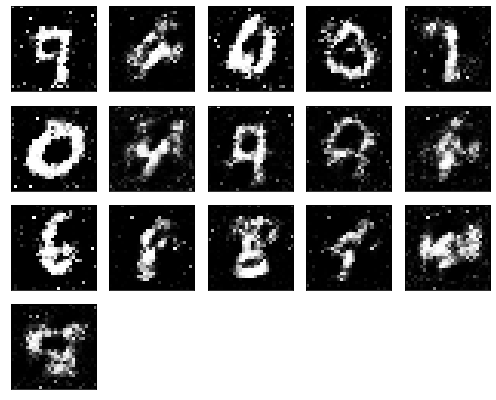

Epochs nb. 2011
discriminator loss: 0.593320369720459
generator loss : 1.080160140991211

Epochs nb. 2012
discriminator loss: 0.5941157341003418
generator loss : 1.1031630039215088

Epochs nb. 2013
discriminator loss: 0.5569786429405212
generator loss : 0.8968144655227661

Epochs nb. 2014
discriminator loss: 0.6184008121490479
generator loss : 1.0292084217071533

Epochs nb. 2015
discriminator loss: 0.6384440660476685
generator loss : 0.955322265625

Epochs nb. 2016
discriminator loss: 0.62856125831604
generator loss : 1.0605249404907227

Epochs nb. 2017
discriminator loss: 0.6469415426254272
generator loss : 1.0667316913604736

Epochs nb. 2018
discriminator loss: 0.5995585918426514
generator loss : 0.9848625659942627

Epochs nb. 2019
discriminator loss: 0.5253970623016357
generator loss : 1.0378836393356323

Epochs nb. 2020
discriminator loss: 0.5528476238250732
generator loss : 0.9154220819473267



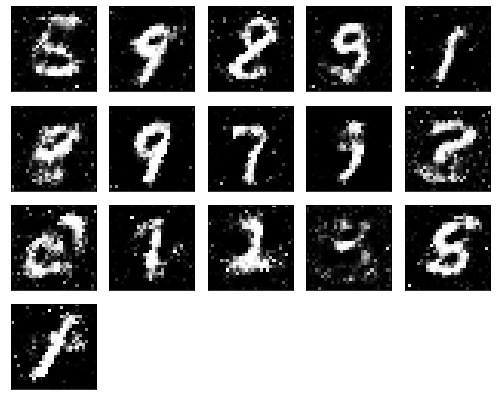

Epochs nb. 2021
discriminator loss: 0.5951306223869324
generator loss : 0.9507614374160767

Epochs nb. 2022
discriminator loss: 0.658515453338623
generator loss : 0.8960561752319336

Epochs nb. 2023
discriminator loss: 0.6082294583320618
generator loss : 0.6715538501739502

Epochs nb. 2024
discriminator loss: 0.6469399333000183
generator loss : 0.924229621887207

Epochs nb. 2025
discriminator loss: 0.7299239039421082
generator loss : 1.0049028396606445

Epochs nb. 2026
discriminator loss: 0.5119460821151733
generator loss : 0.892509937286377

Epochs nb. 2027
discriminator loss: 0.623701274394989
generator loss : 0.9280225038528442

Epochs nb. 2028
discriminator loss: 0.7608926296234131
generator loss : 0.8587907552719116

Epochs nb. 2029
discriminator loss: 0.5463513135910034
generator loss : 0.8264821767807007

Epochs nb. 2030
discriminator loss: 0.6188530921936035
generator loss : 0.9632573127746582



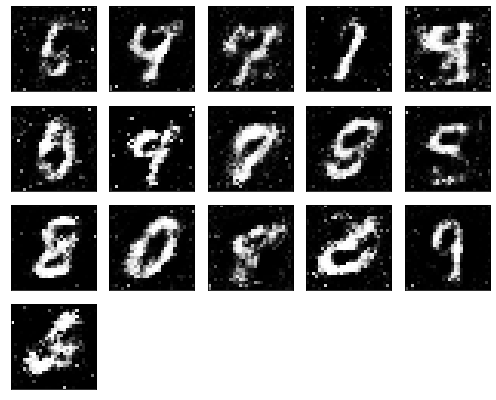

Epochs nb. 2031
discriminator loss: 0.6515357494354248
generator loss : 0.8091115951538086

Epochs nb. 2032
discriminator loss: 0.5474371314048767
generator loss : 0.7649441361427307

Epochs nb. 2033
discriminator loss: 0.6300540566444397
generator loss : 0.9446351528167725

Epochs nb. 2034
discriminator loss: 0.5676882266998291
generator loss : 0.9755507111549377

Epochs nb. 2035
discriminator loss: 0.6890954971313477
generator loss : 0.9813176393508911

Epochs nb. 2036
discriminator loss: 0.7089948654174805
generator loss : 0.9645247459411621

Epochs nb. 2037
discriminator loss: 0.6673530340194702
generator loss : 1.0364699363708496

Epochs nb. 2038
discriminator loss: 0.6298427581787109
generator loss : 0.8269172310829163

Epochs nb. 2039
discriminator loss: 0.6418430209159851
generator loss : 0.9885395765304565

Epochs nb. 2040
discriminator loss: 0.7052651643753052
generator loss : 0.908290445804596



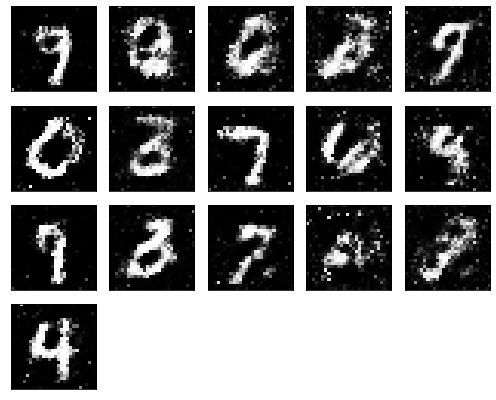

Epochs nb. 2041
discriminator loss: 0.7474421262741089
generator loss : 0.8867558240890503

Epochs nb. 2042
discriminator loss: 0.42810460925102234
generator loss : 0.8349622488021851

Epochs nb. 2043
discriminator loss: 0.5921341180801392
generator loss : 0.7581349611282349

Epochs nb. 2044
discriminator loss: 0.657049834728241
generator loss : 0.9053826332092285

Epochs nb. 2045
discriminator loss: 0.6599564552307129
generator loss : 0.856755793094635

Epochs nb. 2046
discriminator loss: 0.5622711181640625
generator loss : 0.9594845175743103

Epochs nb. 2047
discriminator loss: 0.5653787851333618
generator loss : 1.008865475654602

Epochs nb. 2048
discriminator loss: 0.6347930431365967
generator loss : 0.9070556163787842

Epochs nb. 2049
discriminator loss: 0.49084675312042236
generator loss : 0.7784814238548279

Epochs nb. 2050
discriminator loss: 0.6477069854736328
generator loss : 0.9137516021728516



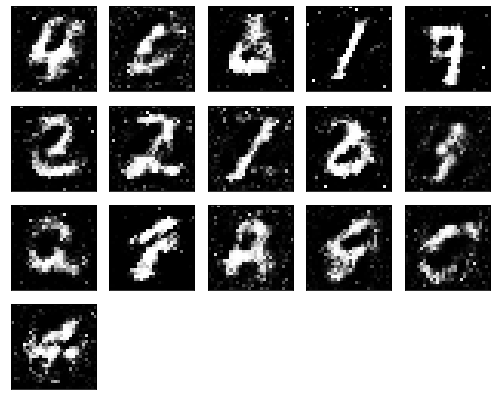

Epochs nb. 2051
discriminator loss: 0.4895438551902771
generator loss : 1.0647273063659668

Epochs nb. 2052
discriminator loss: 0.6341217756271362
generator loss : 1.1763957738876343

Epochs nb. 2053
discriminator loss: 0.5029024481773376
generator loss : 0.9869733452796936

Epochs nb. 2054
discriminator loss: 0.551761269569397
generator loss : 1.0281362533569336

Epochs nb. 2055
discriminator loss: 0.5192842483520508
generator loss : 0.9997037649154663

Epochs nb. 2056
discriminator loss: 0.6651273965835571
generator loss : 0.943290114402771

Epochs nb. 2057
discriminator loss: 0.47972896695137024
generator loss : 1.1204171180725098

Epochs nb. 2058
discriminator loss: 0.7393937110900879
generator loss : 0.9566776752471924

Epochs nb. 2059
discriminator loss: 0.570792555809021
generator loss : 0.8410397171974182

Epochs nb. 2060
discriminator loss: 0.5503244996070862
generator loss : 0.7768471837043762



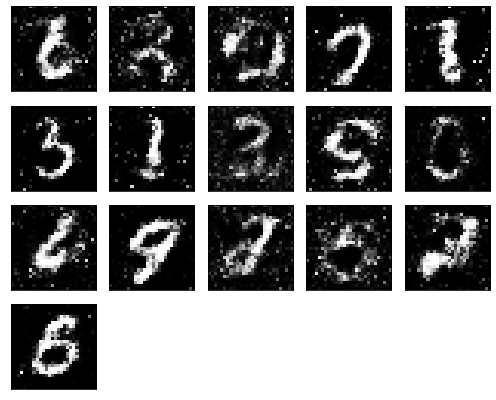

Epochs nb. 2061
discriminator loss: 0.7119507789611816
generator loss : 1.0288124084472656

Epochs nb. 2062
discriminator loss: 0.5748268365859985
generator loss : 0.869361162185669

Epochs nb. 2063
discriminator loss: 0.5426738858222961
generator loss : 0.9194536209106445

Epochs nb. 2064
discriminator loss: 0.6747766733169556
generator loss : 0.9548376798629761

Epochs nb. 2065
discriminator loss: 0.5912395715713501
generator loss : 0.8630908727645874

Epochs nb. 2066
discriminator loss: 0.6413438320159912
generator loss : 0.8690426349639893

Epochs nb. 2067
discriminator loss: 0.7378925085067749
generator loss : 0.9833710193634033

Epochs nb. 2068
discriminator loss: 0.4891180396080017
generator loss : 0.7885172367095947

Epochs nb. 2069
discriminator loss: 0.629285454750061
generator loss : 0.9664665460586548

Epochs nb. 2070
discriminator loss: 0.5303637981414795
generator loss : 0.8159728050231934



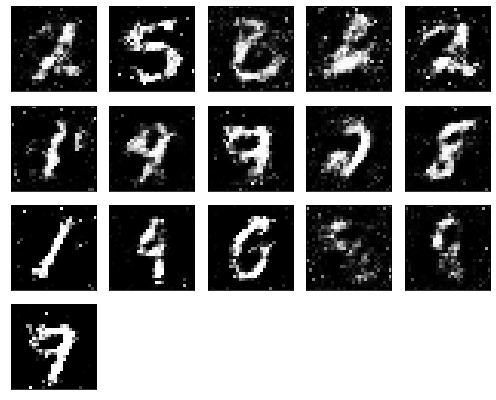

Epochs nb. 2071
discriminator loss: 0.7156282663345337
generator loss : 0.8250426650047302

Epochs nb. 2072
discriminator loss: 0.6137971878051758
generator loss : 0.974953293800354

Epochs nb. 2073
discriminator loss: 0.5745289325714111
generator loss : 1.0439178943634033

Epochs nb. 2074
discriminator loss: 0.5559945106506348
generator loss : 0.917148232460022

Epochs nb. 2075
discriminator loss: 0.7212914228439331
generator loss : 0.9765793085098267

Epochs nb. 2076
discriminator loss: 0.5958867073059082
generator loss : 0.8882233500480652

Epochs nb. 2077
discriminator loss: 0.5718925595283508
generator loss : 0.8685053586959839

Epochs nb. 2078
discriminator loss: 0.6445363759994507
generator loss : 0.9003188610076904

Epochs nb. 2079
discriminator loss: 0.5005127191543579
generator loss : 0.8933323621749878

Epochs nb. 2080
discriminator loss: 0.4955933690071106
generator loss : 0.8246183395385742



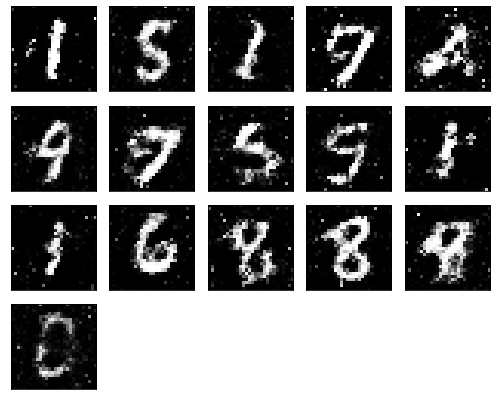

Epochs nb. 2081
discriminator loss: 0.5573000907897949
generator loss : 0.8125312924385071

Epochs nb. 2082
discriminator loss: 0.5817723274230957
generator loss : 0.9308251738548279

Epochs nb. 2083
discriminator loss: 0.597649335861206
generator loss : 1.0116214752197266

Epochs nb. 2084
discriminator loss: 0.5803510546684265
generator loss : 1.0776612758636475

Epochs nb. 2085
discriminator loss: 0.5517475605010986
generator loss : 0.9556258916854858

Epochs nb. 2086
discriminator loss: 0.6338940858840942
generator loss : 1.1336113214492798

Epochs nb. 2087
discriminator loss: 0.5545451045036316
generator loss : 1.1284055709838867

Epochs nb. 2088
discriminator loss: 0.5632232427597046
generator loss : 0.9407799243927002

Epochs nb. 2089
discriminator loss: 0.5833727121353149
generator loss : 0.9010964632034302

Epochs nb. 2090
discriminator loss: 0.6186008453369141
generator loss : 0.9560030102729797



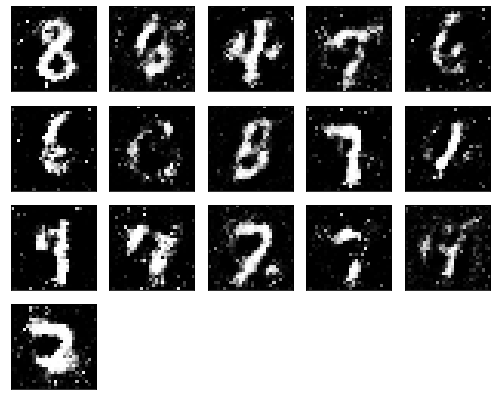

Epochs nb. 2091
discriminator loss: 0.5914466381072998
generator loss : 0.8143322467803955

Epochs nb. 2092
discriminator loss: 0.687043309211731
generator loss : 0.8549407720565796

Epochs nb. 2093
discriminator loss: 0.6095709800720215
generator loss : 0.8232897520065308

Epochs nb. 2094
discriminator loss: 0.5588226318359375
generator loss : 0.80245041847229

Epochs nb. 2095
discriminator loss: 0.6427581906318665
generator loss : 0.9356008768081665

Epochs nb. 2096
discriminator loss: 0.6754432320594788
generator loss : 0.9221717119216919

Epochs nb. 2097
discriminator loss: 0.5484157800674438
generator loss : 0.940522313117981

Epochs nb. 2098
discriminator loss: 0.6510194540023804
generator loss : 0.8373898267745972

Epochs nb. 2099
discriminator loss: 0.6434109210968018
generator loss : 0.7932447791099548

Epochs nb. 2100
discriminator loss: 0.6078838109970093
generator loss : 0.8737982511520386



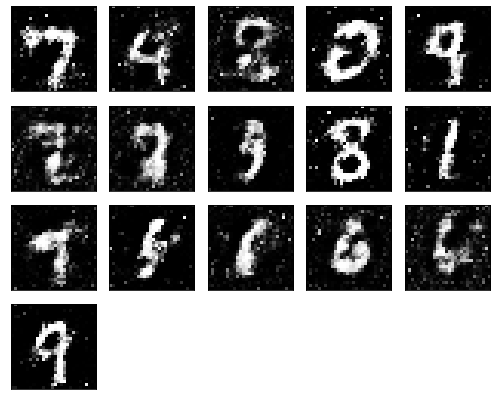

Epochs nb. 2101
discriminator loss: 0.5384106040000916
generator loss : 0.7933631539344788

Epochs nb. 2102
discriminator loss: 0.6279135346412659
generator loss : 1.0417041778564453

Epochs nb. 2103
discriminator loss: 0.6847271919250488
generator loss : 0.8954136371612549

Epochs nb. 2104
discriminator loss: 0.6140046119689941
generator loss : 1.0073235034942627

Epochs nb. 2105
discriminator loss: 0.5444014072418213
generator loss : 0.9884041547775269

Epochs nb. 2106
discriminator loss: 0.5569354891777039
generator loss : 0.9731125831604004

Epochs nb. 2107
discriminator loss: 0.5718145370483398
generator loss : 0.8412545919418335

Epochs nb. 2108
discriminator loss: 0.5190812349319458
generator loss : 0.8036563396453857

Epochs nb. 2109
discriminator loss: 0.6043335795402527
generator loss : 0.7621437311172485

Epochs nb. 2110
discriminator loss: 0.5795585513114929
generator loss : 0.9558496475219727



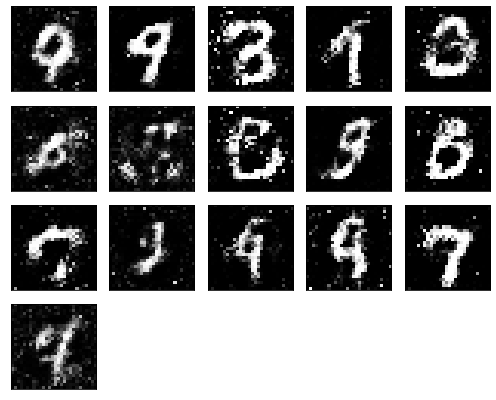

Epochs nb. 2111
discriminator loss: 0.5433152914047241
generator loss : 0.9957311153411865

Epochs nb. 2112
discriminator loss: 0.7009223699569702
generator loss : 0.9485539197921753

Epochs nb. 2113
discriminator loss: 0.5185856819152832
generator loss : 0.9742563962936401

Epochs nb. 2114
discriminator loss: 0.4868118166923523
generator loss : 0.9529895782470703

Epochs nb. 2115
discriminator loss: 0.4721373915672302
generator loss : 1.084514856338501

Epochs nb. 2116
discriminator loss: 0.7181651592254639
generator loss : 1.1436799764633179

Epochs nb. 2117
discriminator loss: 0.5115863084793091
generator loss : 1.0390841960906982

Epochs nb. 2118
discriminator loss: 0.5291445851325989
generator loss : 0.9105688333511353

Epochs nb. 2119
discriminator loss: 0.7069284915924072
generator loss : 1.03361177444458

Epochs nb. 2120
discriminator loss: 0.5867238640785217
generator loss : 0.8949999809265137



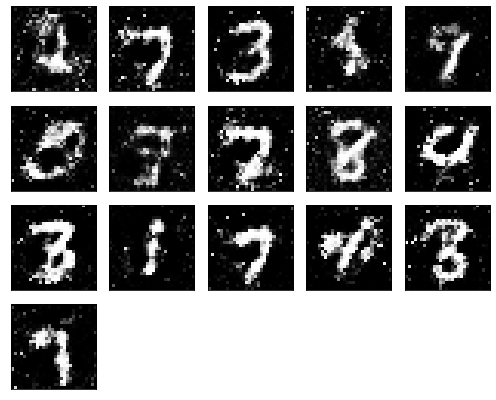

Epochs nb. 2121
discriminator loss: 0.6855641603469849
generator loss : 0.8187251091003418

Epochs nb. 2122
discriminator loss: 0.5325196981430054
generator loss : 1.1154296398162842

Epochs nb. 2123
discriminator loss: 0.6502940654754639
generator loss : 1.0263745784759521

Epochs nb. 2124
discriminator loss: 0.5190106630325317
generator loss : 0.9117774963378906

Epochs nb. 2125
discriminator loss: 0.5758551359176636
generator loss : 0.888352632522583

Epochs nb. 2126
discriminator loss: 0.6479669213294983
generator loss : 0.9019085764884949

Epochs nb. 2127
discriminator loss: 0.656731128692627
generator loss : 1.0017321109771729

Epochs nb. 2128
discriminator loss: 0.6576040387153625
generator loss : 0.8228566646575928

Epochs nb. 2129
discriminator loss: 0.5945936441421509
generator loss : 1.0184913873672485

Epochs nb. 2130
discriminator loss: 0.6575134992599487
generator loss : 0.8403913974761963



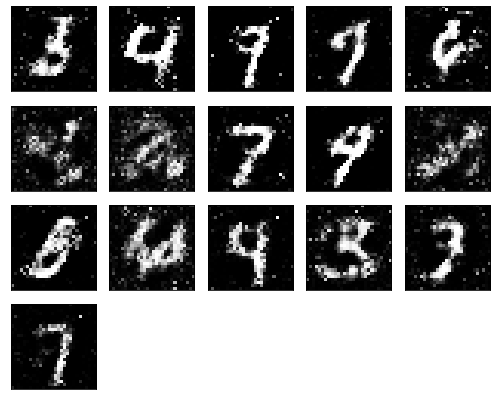

Epochs nb. 2131
discriminator loss: 0.5039000511169434
generator loss : 0.9934693574905396

Epochs nb. 2132
discriminator loss: 0.6837706565856934
generator loss : 0.9182087182998657

Epochs nb. 2133
discriminator loss: 0.5524575710296631
generator loss : 0.9747458696365356

Epochs nb. 2134
discriminator loss: 0.5802855491638184
generator loss : 0.9266539216041565

Epochs nb. 2135
discriminator loss: 0.6648489236831665
generator loss : 0.6897667646408081

Epochs nb. 2136
discriminator loss: 0.6156825423240662
generator loss : 0.8898607492446899

Epochs nb. 2137
discriminator loss: 0.5938673615455627
generator loss : 0.8477413654327393

Epochs nb. 2138
discriminator loss: 0.5258690118789673
generator loss : 0.8823596239089966

Epochs nb. 2139
discriminator loss: 0.7314537763595581
generator loss : 0.8944740891456604

Epochs nb. 2140
discriminator loss: 0.5572909712791443
generator loss : 0.9660745859146118



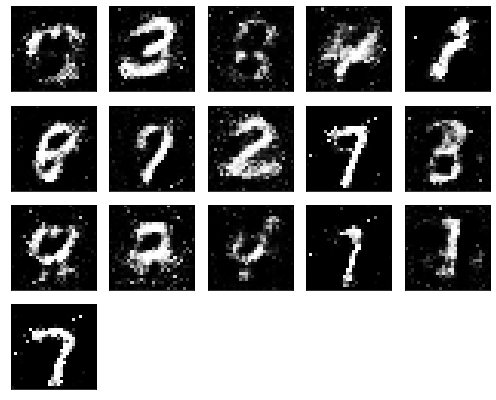

Epochs nb. 2141
discriminator loss: 0.48966091871261597
generator loss : 0.7192997932434082

Epochs nb. 2142
discriminator loss: 0.629423975944519
generator loss : 0.834565281867981

Epochs nb. 2143
discriminator loss: 0.5935521125793457
generator loss : 0.6985363960266113

Epochs nb. 2144
discriminator loss: 0.5929578542709351
generator loss : 0.7700787782669067

Epochs nb. 2145
discriminator loss: 0.6111286282539368
generator loss : 1.0030677318572998

Epochs nb. 2146
discriminator loss: 0.48968005180358887
generator loss : 1.1044769287109375

Epochs nb. 2147
discriminator loss: 0.6344092488288879
generator loss : 0.9624139070510864

Epochs nb. 2148
discriminator loss: 0.5266110897064209
generator loss : 0.9670076966285706

Epochs nb. 2149
discriminator loss: 0.5472211837768555
generator loss : 1.1299432516098022

Epochs nb. 2150
discriminator loss: 0.7063710689544678
generator loss : 0.9127854108810425



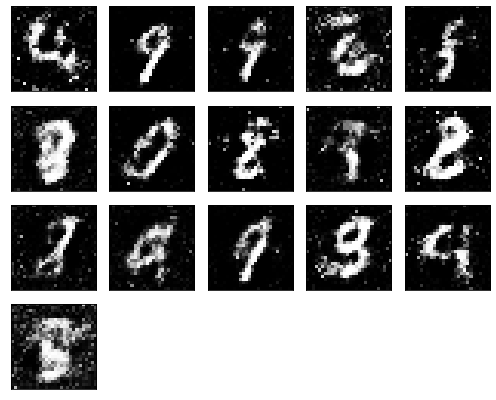

Epochs nb. 2151
discriminator loss: 0.7366738319396973
generator loss : 0.8421715497970581

Epochs nb. 2152
discriminator loss: 0.6808534860610962
generator loss : 0.9391550421714783

Epochs nb. 2153
discriminator loss: 0.609161376953125
generator loss : 0.9365779161453247

Epochs nb. 2154
discriminator loss: 0.5712836980819702
generator loss : 1.0521574020385742

Epochs nb. 2155
discriminator loss: 0.5596151351928711
generator loss : 1.0155560970306396

Epochs nb. 2156
discriminator loss: 0.6018399000167847
generator loss : 1.0802602767944336

Epochs nb. 2157
discriminator loss: 0.515903651714325
generator loss : 0.9437566995620728

Epochs nb. 2158
discriminator loss: 0.5712152719497681
generator loss : 0.9830601215362549

Epochs nb. 2159
discriminator loss: 0.6601330041885376
generator loss : 0.8404440879821777

Epochs nb. 2160
discriminator loss: 0.515979528427124
generator loss : 0.860609769821167



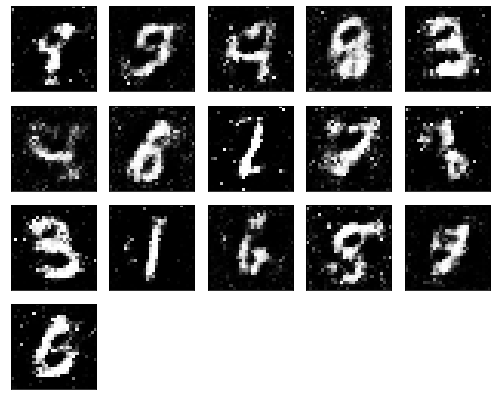

Epochs nb. 2161
discriminator loss: 0.5875041484832764
generator loss : 0.8974533081054688

Epochs nb. 2162
discriminator loss: 0.5453356504440308
generator loss : 0.9583415985107422

Epochs nb. 2163
discriminator loss: 0.5178617238998413
generator loss : 0.9345014691352844

Epochs nb. 2164
discriminator loss: 0.6383142471313477
generator loss : 0.9552749395370483

Epochs nb. 2165
discriminator loss: 0.6153841018676758
generator loss : 1.0858254432678223

Epochs nb. 2166
discriminator loss: 0.6374725699424744
generator loss : 1.0461878776550293

Epochs nb. 2167
discriminator loss: 0.8354421854019165
generator loss : 1.098755121231079

Epochs nb. 2168
discriminator loss: 0.5248326063156128
generator loss : 1.0658223628997803

Epochs nb. 2169
discriminator loss: 0.4764299690723419
generator loss : 0.927474856376648

Epochs nb. 2170
discriminator loss: 0.52420574426651
generator loss : 1.0213966369628906



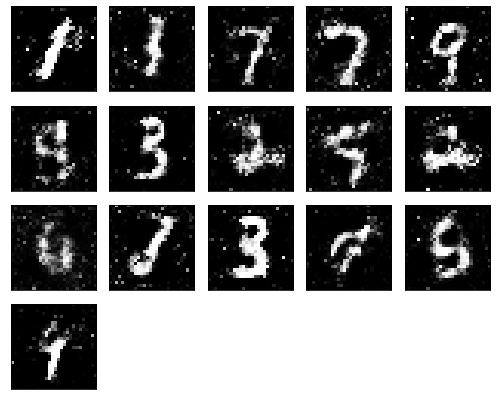

Epochs nb. 2171
discriminator loss: 0.5466422438621521
generator loss : 1.056573510169983

Epochs nb. 2172
discriminator loss: 0.5781806707382202
generator loss : 0.9492207169532776

Epochs nb. 2173
discriminator loss: 0.7019945383071899
generator loss : 0.7823358774185181

Epochs nb. 2174
discriminator loss: 0.43268030881881714
generator loss : 0.7997411489486694

Epochs nb. 2175
discriminator loss: 0.5980868339538574
generator loss : 0.9697471857070923

Epochs nb. 2176
discriminator loss: 0.6453163623809814
generator loss : 1.01340651512146

Epochs nb. 2177
discriminator loss: 0.5988867282867432
generator loss : 1.057237148284912

Epochs nb. 2178
discriminator loss: 0.6180810928344727
generator loss : 1.1860195398330688

Epochs nb. 2179
discriminator loss: 0.6348531246185303
generator loss : 1.0902844667434692

Epochs nb. 2180
discriminator loss: 0.6211074590682983
generator loss : 1.1477627754211426



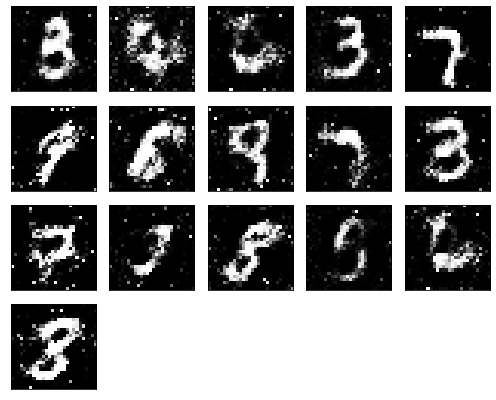

Epochs nb. 2181
discriminator loss: 0.5387383699417114
generator loss : 1.1888781785964966

Epochs nb. 2182
discriminator loss: 0.5775612592697144
generator loss : 1.2976216077804565

Epochs nb. 2183
discriminator loss: 0.5122972726821899
generator loss : 0.9115099906921387

Epochs nb. 2184
discriminator loss: 0.6175740957260132
generator loss : 0.9103544354438782

Epochs nb. 2185
discriminator loss: 0.6886405944824219
generator loss : 0.946898341178894

Epochs nb. 2186
discriminator loss: 0.5609928369522095
generator loss : 1.0865193605422974

Epochs nb. 2187
discriminator loss: 0.5830237865447998
generator loss : 0.9728848934173584

Epochs nb. 2188
discriminator loss: 0.5302450656890869
generator loss : 0.9415421485900879

Epochs nb. 2189
discriminator loss: 0.6201953887939453
generator loss : 0.9249761700630188

Epochs nb. 2190
discriminator loss: 0.6129072904586792
generator loss : 0.9516088962554932



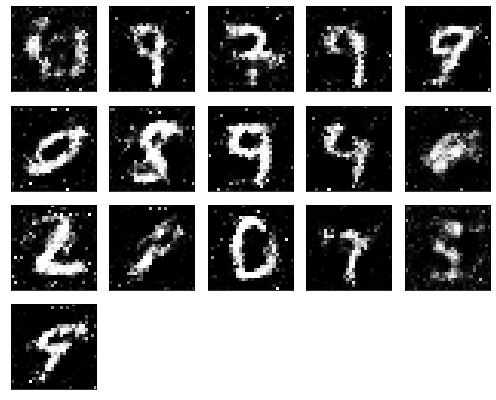

Epochs nb. 2191
discriminator loss: 0.541295051574707
generator loss : 0.9840864539146423

Epochs nb. 2192
discriminator loss: 0.5946581363677979
generator loss : 0.8260427713394165

Epochs nb. 2193
discriminator loss: 0.6038536429405212
generator loss : 0.9083715081214905

Epochs nb. 2194
discriminator loss: 0.6073492765426636
generator loss : 0.9307026863098145

Epochs nb. 2195
discriminator loss: 0.6171764135360718
generator loss : 0.788433313369751

Epochs nb. 2196
discriminator loss: 0.6243200302124023
generator loss : 1.0382224321365356

Epochs nb. 2197
discriminator loss: 0.6341081857681274
generator loss : 0.9514877796173096

Epochs nb. 2198
discriminator loss: 0.6862214207649231
generator loss : 1.0138046741485596

Epochs nb. 2199
discriminator loss: 0.6361103653907776
generator loss : 1.0146812200546265

Epochs nb. 2200
discriminator loss: 0.5704121589660645
generator loss : 0.8312724232673645



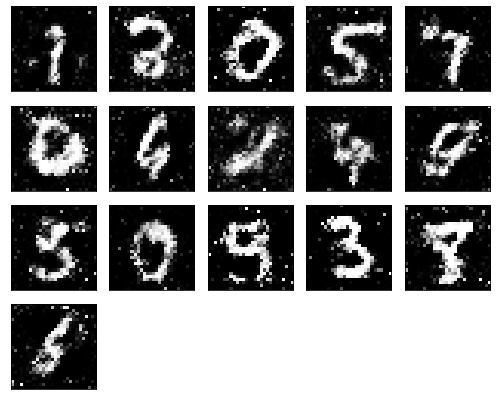

Epochs nb. 2201
discriminator loss: 0.5470309853553772
generator loss : 0.8950929045677185

Epochs nb. 2202
discriminator loss: 0.5981446504592896
generator loss : 1.003021240234375

Epochs nb. 2203
discriminator loss: 0.53547203540802
generator loss : 0.9160992503166199

Epochs nb. 2204
discriminator loss: 0.41631636023521423
generator loss : 1.1067280769348145

Epochs nb. 2205
discriminator loss: 0.7501713037490845
generator loss : 0.9388299584388733

Epochs nb. 2206
discriminator loss: 0.5427507758140564
generator loss : 1.0220637321472168

Epochs nb. 2207
discriminator loss: 0.47993630170822144
generator loss : 0.9745573997497559

Epochs nb. 2208
discriminator loss: 0.7741799354553223
generator loss : 0.8434249758720398

Epochs nb. 2209
discriminator loss: 0.5408878922462463
generator loss : 0.8241001963615417

Epochs nb. 2210
discriminator loss: 0.5560261607170105
generator loss : 0.8070775270462036



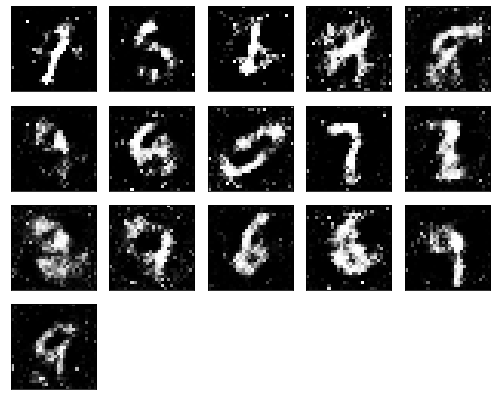

Epochs nb. 2211
discriminator loss: 0.6404911279678345
generator loss : 0.9733911752700806

Epochs nb. 2212
discriminator loss: 0.5729809403419495
generator loss : 0.905977189540863

Epochs nb. 2213
discriminator loss: 0.5869313478469849
generator loss : 0.9250943660736084

Epochs nb. 2214
discriminator loss: 0.7577519416809082
generator loss : 1.0677247047424316

Epochs nb. 2215
discriminator loss: 0.6213569045066833
generator loss : 0.9170960187911987

Epochs nb. 2216
discriminator loss: 0.5457345843315125
generator loss : 0.9503257274627686

Epochs nb. 2217
discriminator loss: 0.4521661400794983
generator loss : 1.087525486946106

Epochs nb. 2218
discriminator loss: 0.8636062145233154
generator loss : 0.825559675693512

Epochs nb. 2219
discriminator loss: 0.5819535851478577
generator loss : 1.0670355558395386

Epochs nb. 2220
discriminator loss: 0.613329291343689
generator loss : 0.9328644275665283



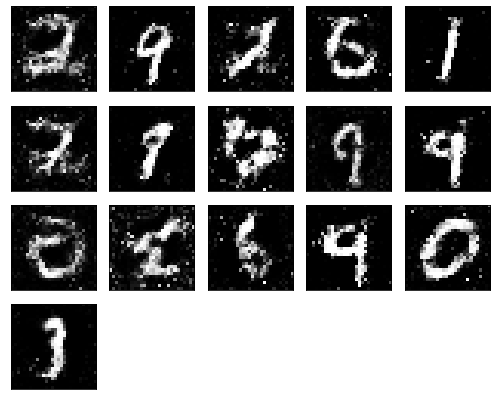

Epochs nb. 2221
discriminator loss: 0.559102475643158
generator loss : 1.0759962797164917

Epochs nb. 2222
discriminator loss: 0.551659107208252
generator loss : 0.9290899634361267

Epochs nb. 2223
discriminator loss: 0.7524101734161377
generator loss : 0.9249659180641174

Epochs nb. 2224
discriminator loss: 0.5285435318946838
generator loss : 0.9064608812332153

Epochs nb. 2225
discriminator loss: 0.5925797820091248
generator loss : 0.9855051636695862

Epochs nb. 2226
discriminator loss: 0.5635242462158203
generator loss : 0.9537909626960754

Epochs nb. 2227
discriminator loss: 0.6038092374801636
generator loss : 0.8618038892745972

Epochs nb. 2228
discriminator loss: 0.6402696371078491
generator loss : 0.9002062678337097

Epochs nb. 2229
discriminator loss: 0.6138956546783447
generator loss : 0.9306182861328125

Epochs nb. 2230
discriminator loss: 0.637382447719574
generator loss : 0.9978863000869751



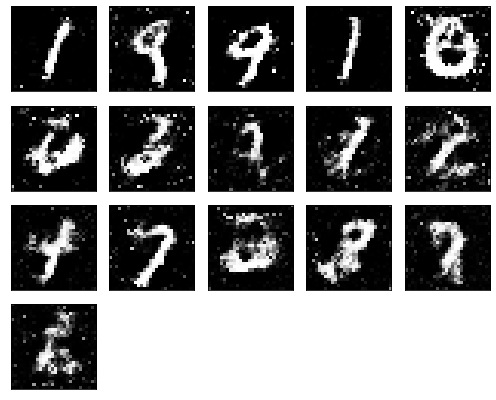

Epochs nb. 2231
discriminator loss: 0.6887909770011902
generator loss : 1.0395469665527344

Epochs nb. 2232
discriminator loss: 0.5457109212875366
generator loss : 1.1355504989624023

Epochs nb. 2233
discriminator loss: 0.7931914329528809
generator loss : 1.0499627590179443

Epochs nb. 2234
discriminator loss: 0.49840566515922546
generator loss : 0.9076042175292969

Epochs nb. 2235
discriminator loss: 0.5439004898071289
generator loss : 0.9816911220550537

Epochs nb. 2236
discriminator loss: 0.6527280807495117
generator loss : 1.0028890371322632

Epochs nb. 2237
discriminator loss: 0.4942302405834198
generator loss : 0.9012736082077026

Epochs nb. 2238
discriminator loss: 0.7418497800827026
generator loss : 0.8963783383369446

Epochs nb. 2239
discriminator loss: 0.5914722681045532
generator loss : 0.9940852522850037

Epochs nb. 2240
discriminator loss: 0.6483466029167175
generator loss : 0.9760949015617371



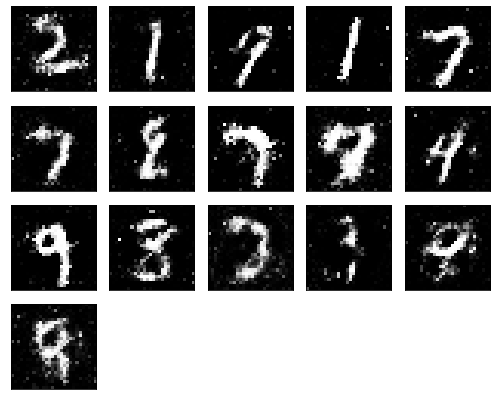

Epochs nb. 2241
discriminator loss: 0.505699098110199
generator loss : 1.0279639959335327

Epochs nb. 2242
discriminator loss: 0.5257951021194458
generator loss : 1.100525140762329

Epochs nb. 2243
discriminator loss: 0.5759665966033936
generator loss : 0.8867490291595459

Epochs nb. 2244
discriminator loss: 0.5821384191513062
generator loss : 0.8748133182525635

Epochs nb. 2245
discriminator loss: 0.6819689273834229
generator loss : 1.2413780689239502

Epochs nb. 2246
discriminator loss: 0.5735095739364624
generator loss : 1.122527837753296

Epochs nb. 2247
discriminator loss: 0.48722150921821594
generator loss : 0.9218806028366089

Epochs nb. 2248
discriminator loss: 0.6055175065994263
generator loss : 1.1264123916625977

Epochs nb. 2249
discriminator loss: 0.47187238931655884
generator loss : 0.9848328232765198

Epochs nb. 2250
discriminator loss: 0.4878198206424713
generator loss : 0.9595515131950378



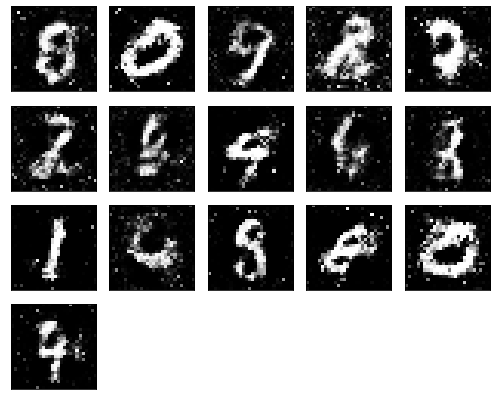

Epochs nb. 2251
discriminator loss: 0.626742422580719
generator loss : 0.9987633228302002

Epochs nb. 2252
discriminator loss: 0.48060518503189087
generator loss : 0.9068295955657959

Epochs nb. 2253
discriminator loss: 0.6596283316612244
generator loss : 0.9619302749633789

Epochs nb. 2254
discriminator loss: 0.5487209558486938
generator loss : 0.8090582489967346

Epochs nb. 2255
discriminator loss: 0.6348696947097778
generator loss : 0.85019850730896

Epochs nb. 2256
discriminator loss: 0.6917929649353027
generator loss : 0.9565486907958984

Epochs nb. 2257
discriminator loss: 0.48515498638153076
generator loss : 0.9410927891731262

Epochs nb. 2258
discriminator loss: 0.6163861751556396
generator loss : 0.9591342210769653

Epochs nb. 2259
discriminator loss: 0.5558977127075195
generator loss : 1.0233001708984375

Epochs nb. 2260
discriminator loss: 0.6570500135421753
generator loss : 0.9149439930915833



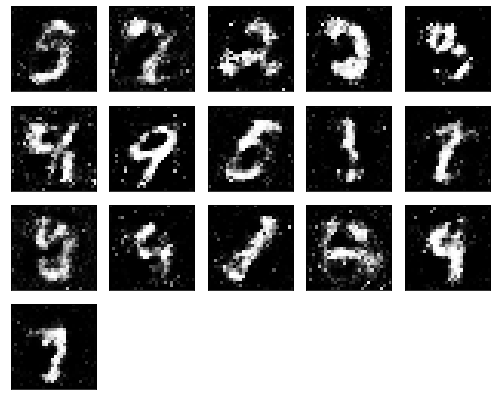

Epochs nb. 2261
discriminator loss: 0.5401644110679626
generator loss : 0.9761989712715149

Epochs nb. 2262
discriminator loss: 0.638931155204773
generator loss : 0.7463505268096924

Epochs nb. 2263
discriminator loss: 0.756186842918396
generator loss : 1.0486252307891846

Epochs nb. 2264
discriminator loss: 0.6538453698158264
generator loss : 1.1521865129470825

Epochs nb. 2265
discriminator loss: 0.689444363117218
generator loss : 1.023345708847046

Epochs nb. 2266
discriminator loss: 0.484222948551178
generator loss : 1.094572901725769

Epochs nb. 2267
discriminator loss: 0.5400230884552002
generator loss : 0.9494529962539673

Epochs nb. 2268
discriminator loss: 0.6548837423324585
generator loss : 0.8970064520835876

Epochs nb. 2269
discriminator loss: 0.6526643633842468
generator loss : 0.8812175989151001

Epochs nb. 2270
discriminator loss: 0.6176955103874207
generator loss : 0.9721677303314209



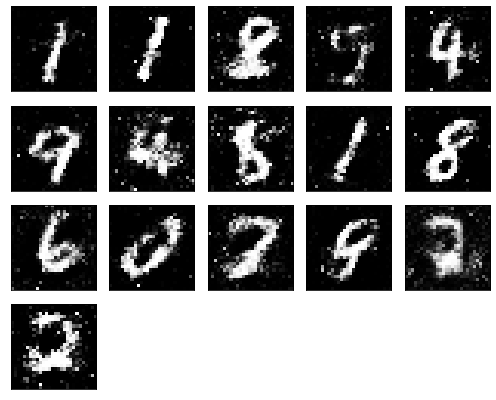

Epochs nb. 2271
discriminator loss: 0.5868568420410156
generator loss : 0.9853992462158203

Epochs nb. 2272
discriminator loss: 0.5375197529792786
generator loss : 1.0411601066589355

Epochs nb. 2273
discriminator loss: 0.558875322341919
generator loss : 0.9106199145317078

Epochs nb. 2274
discriminator loss: 0.5434601902961731
generator loss : 0.8795118927955627

Epochs nb. 2275
discriminator loss: 0.6311607360839844
generator loss : 1.1315233707427979

Epochs nb. 2276
discriminator loss: 0.5109072327613831
generator loss : 1.1747972965240479

Epochs nb. 2277
discriminator loss: 0.6196873784065247
generator loss : 1.076045274734497

Epochs nb. 2278
discriminator loss: 0.6046561002731323
generator loss : 0.8798184990882874

Epochs nb. 2279
discriminator loss: 0.5683446526527405
generator loss : 1.0356478691101074

Epochs nb. 2280
discriminator loss: 0.6085326671600342
generator loss : 1.051976203918457



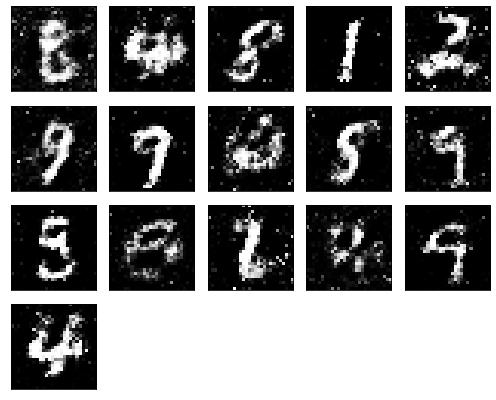

Epochs nb. 2281
discriminator loss: 0.7109473347663879
generator loss : 1.0165235996246338

Epochs nb. 2282
discriminator loss: 0.5506727695465088
generator loss : 0.9418951272964478

Epochs nb. 2283
discriminator loss: 0.5081834197044373
generator loss : 1.0778915882110596

Epochs nb. 2284
discriminator loss: 0.5629273056983948
generator loss : 0.9465289115905762

Epochs nb. 2285
discriminator loss: 0.5937092304229736
generator loss : 1.0641367435455322

Epochs nb. 2286
discriminator loss: 0.6852295398712158
generator loss : 0.8815727233886719

Epochs nb. 2287
discriminator loss: 0.599495530128479
generator loss : 0.9158068895339966

Epochs nb. 2288
discriminator loss: 0.7026528120040894
generator loss : 1.0367703437805176

Epochs nb. 2289
discriminator loss: 0.6558297872543335
generator loss : 1.016442060470581

Epochs nb. 2290
discriminator loss: 0.6768383383750916
generator loss : 0.9084968566894531



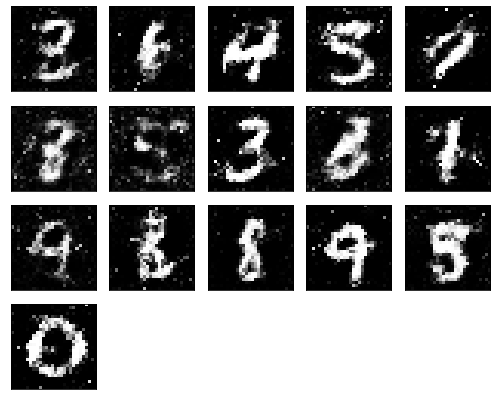

Epochs nb. 2291
discriminator loss: 0.5444056987762451
generator loss : 0.8456302881240845

Epochs nb. 2292
discriminator loss: 0.48399436473846436
generator loss : 0.8916803598403931

Epochs nb. 2293
discriminator loss: 0.6436877250671387
generator loss : 0.9873427152633667

Epochs nb. 2294
discriminator loss: 0.5673395991325378
generator loss : 0.939407467842102

Epochs nb. 2295
discriminator loss: 0.6208339333534241
generator loss : 1.0135931968688965

Epochs nb. 2296
discriminator loss: 0.8004368543624878
generator loss : 1.114802360534668

Epochs nb. 2297
discriminator loss: 0.6127898097038269
generator loss : 0.8051704168319702

Epochs nb. 2298
discriminator loss: 0.5191106200218201
generator loss : 0.8836489319801331

Epochs nb. 2299
discriminator loss: 0.6539917588233948
generator loss : 1.0094101428985596

Epochs nb. 2300
discriminator loss: 0.5360767841339111
generator loss : 0.9184991717338562



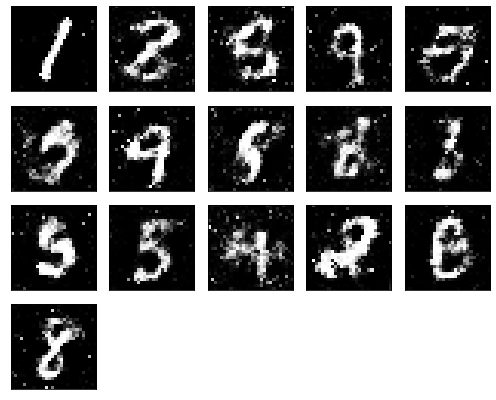

Epochs nb. 2301
discriminator loss: 0.5484929084777832
generator loss : 0.892475426197052

Epochs nb. 2302
discriminator loss: 0.6437838673591614
generator loss : 1.0289833545684814

Epochs nb. 2303
discriminator loss: 0.6629220247268677
generator loss : 0.7535305023193359

Epochs nb. 2304
discriminator loss: 0.5741868019104004
generator loss : 0.8809877038002014

Epochs nb. 2305
discriminator loss: 0.7297461032867432
generator loss : 0.8968207836151123

Epochs nb. 2306
discriminator loss: 0.6257905960083008
generator loss : 0.861168622970581

Epochs nb. 2307
discriminator loss: 0.6850752234458923
generator loss : 0.9417818784713745

Epochs nb. 2308
discriminator loss: 0.5118901133537292
generator loss : 0.9032477140426636

Epochs nb. 2309
discriminator loss: 0.6091232299804688
generator loss : 0.8941298723220825

Epochs nb. 2310
discriminator loss: 0.5472428798675537
generator loss : 0.8980383276939392



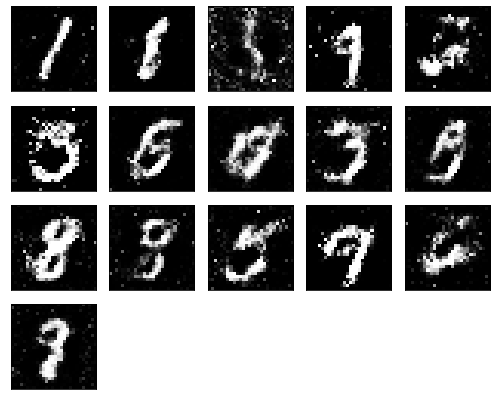

Epochs nb. 2311
discriminator loss: 0.534095823764801
generator loss : 1.0348055362701416

Epochs nb. 2312
discriminator loss: 0.6323438882827759
generator loss : 0.8929105997085571

Epochs nb. 2313
discriminator loss: 0.5773622989654541
generator loss : 0.9359645843505859

Epochs nb. 2314
discriminator loss: 0.5651680827140808
generator loss : 1.070813775062561

Epochs nb. 2315
discriminator loss: 0.7292860746383667
generator loss : 1.0453877449035645

Epochs nb. 2316
discriminator loss: 0.6144397258758545
generator loss : 1.058543086051941

Epochs nb. 2317
discriminator loss: 0.5397914052009583
generator loss : 1.093716025352478

Epochs nb. 2318
discriminator loss: 0.7835853695869446
generator loss : 1.1460630893707275

Epochs nb. 2319
discriminator loss: 0.634506106376648
generator loss : 1.1713228225708008

Epochs nb. 2320
discriminator loss: 0.515252411365509
generator loss : 1.0267153978347778



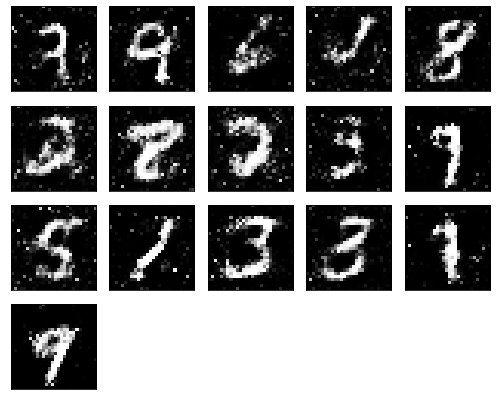

Epochs nb. 2321
discriminator loss: 0.5222476720809937
generator loss : 0.9421555995941162

Epochs nb. 2322
discriminator loss: 0.6610191464424133
generator loss : 0.8362767696380615

Epochs nb. 2323
discriminator loss: 0.6158342361450195
generator loss : 0.9580148458480835

Epochs nb. 2324
discriminator loss: 0.49431708455085754
generator loss : 0.9609769582748413

Epochs nb. 2325
discriminator loss: 0.5777169466018677
generator loss : 0.8511180281639099

Epochs nb. 2326
discriminator loss: 0.541107177734375
generator loss : 1.077338695526123

Epochs nb. 2327
discriminator loss: 0.5341826677322388
generator loss : 0.9195104837417603

Epochs nb. 2328
discriminator loss: 0.6608608961105347
generator loss : 0.7795543670654297

Epochs nb. 2329
discriminator loss: 0.6902105808258057
generator loss : 1.0006461143493652

Epochs nb. 2330
discriminator loss: 0.5908607244491577
generator loss : 1.0808440446853638



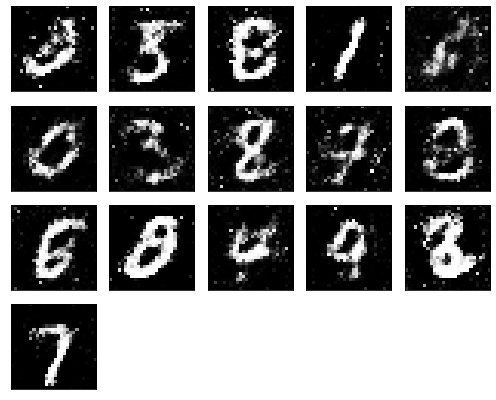

Epochs nb. 2331
discriminator loss: 0.5475354790687561
generator loss : 1.0461065769195557

Epochs nb. 2332
discriminator loss: 0.687035083770752
generator loss : 0.9942164421081543

Epochs nb. 2333
discriminator loss: 0.587407112121582
generator loss : 1.0716760158538818

Epochs nb. 2334
discriminator loss: 0.5760623812675476
generator loss : 1.1014132499694824

Epochs nb. 2335
discriminator loss: 0.6754986047744751
generator loss : 0.802146315574646

Epochs nb. 2336
discriminator loss: 0.6458262205123901
generator loss : 0.9710439443588257

Epochs nb. 2337
discriminator loss: 0.5550548434257507
generator loss : 0.9743742942810059

Epochs nb. 2338
discriminator loss: 0.6237877011299133
generator loss : 0.9423425197601318

Epochs nb. 2339
discriminator loss: 0.6440794467926025
generator loss : 1.0946979522705078

Epochs nb. 2340
discriminator loss: 0.5475151538848877
generator loss : 1.023177146911621



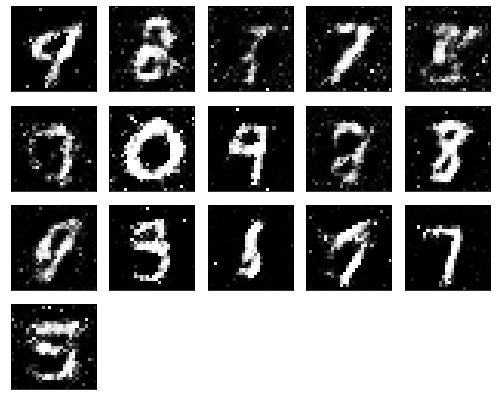

Epochs nb. 2341
discriminator loss: 0.6516132354736328
generator loss : 1.0516595840454102

Epochs nb. 2342
discriminator loss: 0.5152558088302612
generator loss : 0.8213380575180054

Epochs nb. 2343
discriminator loss: 0.5520771145820618
generator loss : 0.9643248319625854

Epochs nb. 2344
discriminator loss: 0.4869592785835266
generator loss : 0.9398601055145264

Epochs nb. 2345
discriminator loss: 0.6211345195770264
generator loss : 0.8093662261962891

Epochs nb. 2346
discriminator loss: 0.5928894281387329
generator loss : 0.8010857701301575

Epochs nb. 2347
discriminator loss: 0.6382920742034912
generator loss : 0.9488734602928162

Epochs nb. 2348
discriminator loss: 0.7236794233322144
generator loss : 0.935077965259552

Epochs nb. 2349
discriminator loss: 0.5953955054283142
generator loss : 1.0133213996887207

Epochs nb. 2350
discriminator loss: 0.6501824855804443
generator loss : 1.0500119924545288



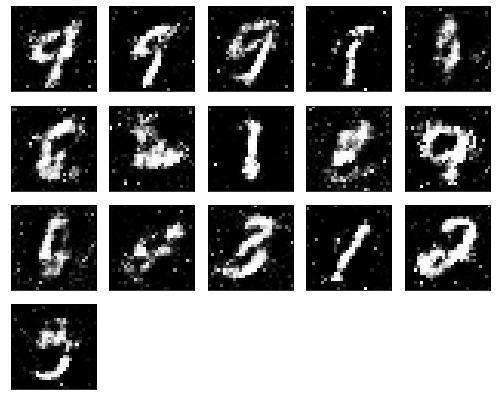

Epochs nb. 2351
discriminator loss: 0.5418351292610168
generator loss : 0.952010989189148

Epochs nb. 2352
discriminator loss: 0.593614935874939
generator loss : 0.957463264465332

Epochs nb. 2353
discriminator loss: 0.5342773199081421
generator loss : 0.8579902648925781

Epochs nb. 2354
discriminator loss: 0.7211571931838989
generator loss : 0.9196288585662842

Epochs nb. 2355
discriminator loss: 0.6371683478355408
generator loss : 0.9785265922546387

Epochs nb. 2356
discriminator loss: 0.6400592923164368
generator loss : 0.8660544753074646

Epochs nb. 2357
discriminator loss: 0.6424739956855774
generator loss : 0.8248645067214966

Epochs nb. 2358
discriminator loss: 0.8199489116668701
generator loss : 0.9592039585113525

Epochs nb. 2359
discriminator loss: 0.5598275661468506
generator loss : 0.9455581903457642

Epochs nb. 2360
discriminator loss: 0.5961308479309082
generator loss : 0.9466285705566406



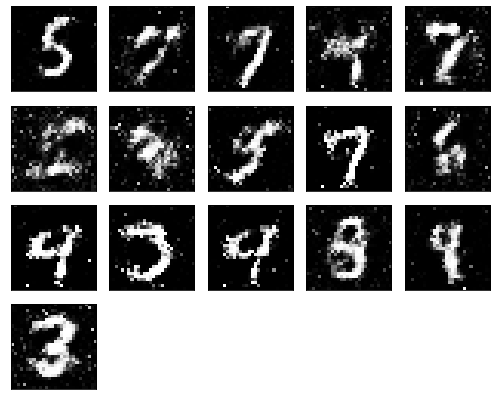

Epochs nb. 2361
discriminator loss: 0.5614984035491943
generator loss : 0.9145983457565308

Epochs nb. 2362
discriminator loss: 0.6109489798545837
generator loss : 0.8340011835098267

Epochs nb. 2363
discriminator loss: 0.8104500770568848
generator loss : 0.8817185163497925

Epochs nb. 2364
discriminator loss: 0.6837786436080933
generator loss : 0.8016364574432373

Epochs nb. 2365
discriminator loss: 0.6081923842430115
generator loss : 0.9473770260810852

Epochs nb. 2366
discriminator loss: 0.5416996479034424
generator loss : 0.886960506439209

Epochs nb. 2367
discriminator loss: 0.6500815749168396
generator loss : 0.8270099759101868

Epochs nb. 2368
discriminator loss: 0.5806496143341064
generator loss : 0.8555744886398315

Epochs nb. 2369
discriminator loss: 0.614772617816925
generator loss : 0.9023135304450989

Epochs nb. 2370
discriminator loss: 0.5621073246002197
generator loss : 1.105698585510254



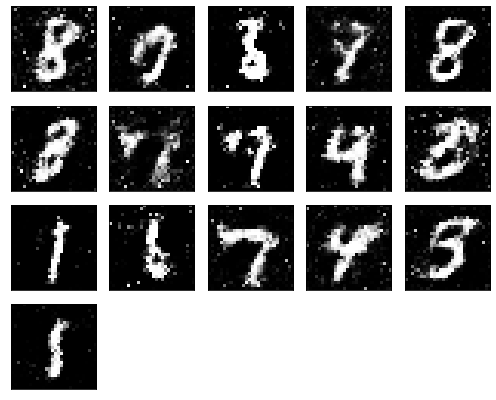

Epochs nb. 2371
discriminator loss: 0.6358147859573364
generator loss : 0.9003459215164185

Epochs nb. 2372
discriminator loss: 0.6323060393333435
generator loss : 0.9795495867729187

Epochs nb. 2373
discriminator loss: 0.5858328342437744
generator loss : 0.9590923190116882

Epochs nb. 2374
discriminator loss: 0.6148114204406738
generator loss : 0.9786832332611084

Epochs nb. 2375
discriminator loss: 0.5808720588684082
generator loss : 0.7701234817504883

Epochs nb. 2376
discriminator loss: 0.6341478228569031
generator loss : 0.9096052050590515

Epochs nb. 2377
discriminator loss: 0.5403153896331787
generator loss : 0.8160507678985596

Epochs nb. 2378
discriminator loss: 0.6091439723968506
generator loss : 0.7882463932037354

Epochs nb. 2379
discriminator loss: 0.5937994718551636
generator loss : 0.9155317544937134

Epochs nb. 2380
discriminator loss: 0.6480716466903687
generator loss : 1.0217703580856323



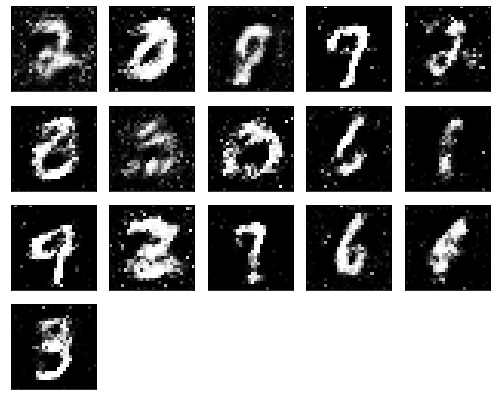

Epochs nb. 2381
discriminator loss: 0.6576429009437561
generator loss : 1.1710937023162842

Epochs nb. 2382
discriminator loss: 0.7108688354492188
generator loss : 1.014425277709961

Epochs nb. 2383
discriminator loss: 0.6124719381332397
generator loss : 0.9346041679382324

Epochs nb. 2384
discriminator loss: 0.4754374027252197
generator loss : 0.8804290294647217

Epochs nb. 2385
discriminator loss: 0.4415290355682373
generator loss : 1.0671303272247314

Epochs nb. 2386
discriminator loss: 0.6852190494537354
generator loss : 0.9368577003479004

Epochs nb. 2387
discriminator loss: 0.5668999552726746
generator loss : 1.0310766696929932

Epochs nb. 2388
discriminator loss: 0.5644908547401428
generator loss : 0.9312538504600525

Epochs nb. 2389
discriminator loss: 0.6224068403244019
generator loss : 1.0219147205352783

Epochs nb. 2390
discriminator loss: 0.606889009475708
generator loss : 1.09938383102417



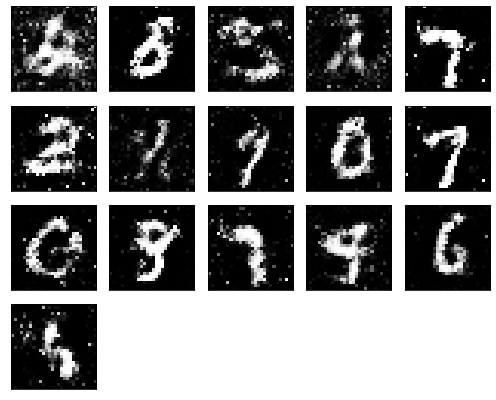

Epochs nb. 2391
discriminator loss: 0.4798101782798767
generator loss : 0.8490209579467773

Epochs nb. 2392
discriminator loss: 0.6056041717529297
generator loss : 0.9315915107727051

Epochs nb. 2393
discriminator loss: 0.5627872943878174
generator loss : 0.8045285940170288

Epochs nb. 2394
discriminator loss: 0.5966792106628418
generator loss : 0.7735186815261841

Epochs nb. 2395
discriminator loss: 0.6475974321365356
generator loss : 0.8644095659255981

Epochs nb. 2396
discriminator loss: 0.5964144468307495
generator loss : 0.983360767364502

Epochs nb. 2397
discriminator loss: 0.5896140336990356
generator loss : 0.8904181718826294

Epochs nb. 2398
discriminator loss: 0.5144582390785217
generator loss : 0.949193000793457

Epochs nb. 2399
discriminator loss: 0.47594714164733887
generator loss : 0.9356430768966675

Epochs nb. 2400
discriminator loss: 0.5716546177864075
generator loss : 1.0451347827911377



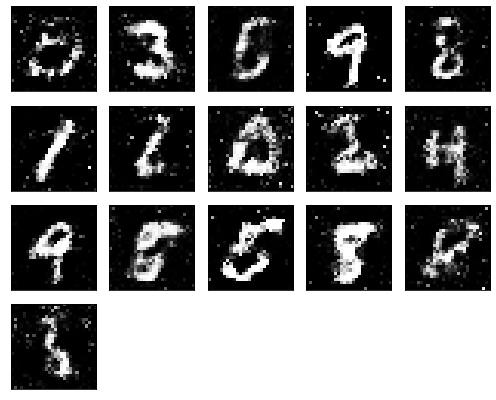

Epochs nb. 2401
discriminator loss: 0.6475493907928467
generator loss : 1.1342341899871826

Epochs nb. 2402
discriminator loss: 0.5066133737564087
generator loss : 1.062955379486084

Epochs nb. 2403
discriminator loss: 0.5635912418365479
generator loss : 0.8922406435012817

Epochs nb. 2404
discriminator loss: 0.5908215641975403
generator loss : 0.9604178667068481

Epochs nb. 2405
discriminator loss: 0.5854913592338562
generator loss : 0.8934381008148193

Epochs nb. 2406
discriminator loss: 0.5718090534210205
generator loss : 1.0976847410202026

Epochs nb. 2407
discriminator loss: 0.5907399654388428
generator loss : 1.007908821105957

Epochs nb. 2408
discriminator loss: 0.6105047464370728
generator loss : 1.0694854259490967

Epochs nb. 2409
discriminator loss: 0.575014591217041
generator loss : 0.8628344535827637

Epochs nb. 2410
discriminator loss: 0.5704749226570129
generator loss : 0.9812815189361572



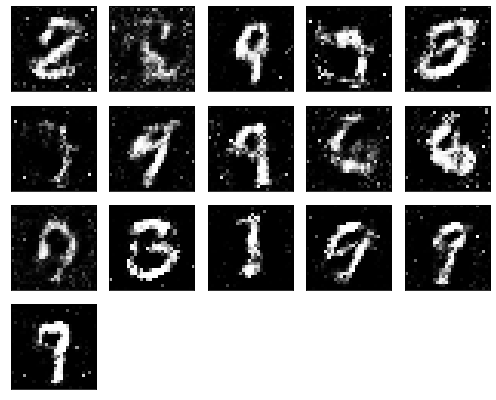

Epochs nb. 2411
discriminator loss: 0.6187772750854492
generator loss : 0.9771641492843628

Epochs nb. 2412
discriminator loss: 0.7308521866798401
generator loss : 0.9399974346160889

Epochs nb. 2413
discriminator loss: 0.5535290241241455
generator loss : 0.9900461435317993

Epochs nb. 2414
discriminator loss: 0.47878435254096985
generator loss : 0.9177924990653992

Epochs nb. 2415
discriminator loss: 0.682924747467041
generator loss : 0.9560442566871643

Epochs nb. 2416
discriminator loss: 0.6320475935935974
generator loss : 0.8830640316009521

Epochs nb. 2417
discriminator loss: 0.6357165575027466
generator loss : 0.8985214233398438

Epochs nb. 2418
discriminator loss: 0.6144520044326782
generator loss : 0.9492851495742798

Epochs nb. 2419
discriminator loss: 0.5763112306594849
generator loss : 1.0111198425292969

Epochs nb. 2420
discriminator loss: 0.6522884368896484
generator loss : 0.8511238098144531



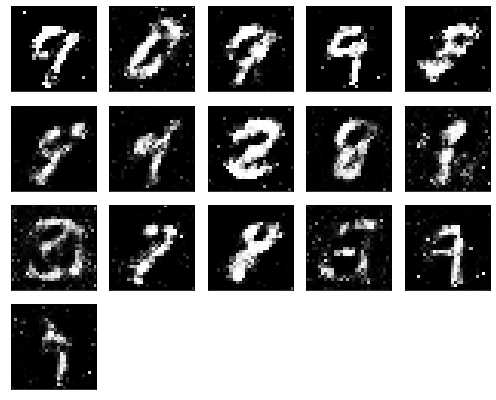

Epochs nb. 2421
discriminator loss: 0.5463666915893555
generator loss : 0.704849123954773

Epochs nb. 2422
discriminator loss: 0.6146523356437683
generator loss : 0.9358780980110168

Epochs nb. 2423
discriminator loss: 0.598906397819519
generator loss : 1.0826919078826904

Epochs nb. 2424
discriminator loss: 0.5505863428115845
generator loss : 1.000795602798462

Epochs nb. 2425
discriminator loss: 0.4815647006034851
generator loss : 0.9552677869796753

Epochs nb. 2426
discriminator loss: 0.6938924789428711
generator loss : 1.0718507766723633

Epochs nb. 2427
discriminator loss: 0.5524061918258667
generator loss : 1.1289927959442139

Epochs nb. 2428
discriminator loss: 0.6133132576942444
generator loss : 0.9900727868080139

Epochs nb. 2429
discriminator loss: 0.5868225693702698
generator loss : 1.2145357131958008

Epochs nb. 2430
discriminator loss: 0.6480197906494141
generator loss : 1.0681674480438232



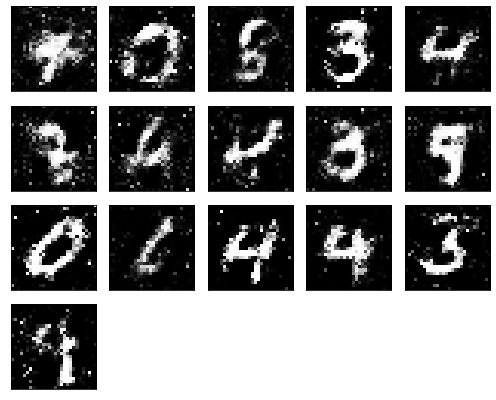

Epochs nb. 2431
discriminator loss: 0.5360937118530273
generator loss : 0.9077232480049133

Epochs nb. 2432
discriminator loss: 0.5638749003410339
generator loss : 0.9240844249725342

Epochs nb. 2433
discriminator loss: 0.5035678148269653
generator loss : 1.05903959274292

Epochs nb. 2434
discriminator loss: 0.5876297950744629
generator loss : 1.0587962865829468

Epochs nb. 2435
discriminator loss: 0.6017827987670898
generator loss : 1.1067850589752197

Epochs nb. 2436
discriminator loss: 0.5938462018966675
generator loss : 1.1131523847579956

Epochs nb. 2437
discriminator loss: 0.4991813004016876
generator loss : 0.9853733777999878

Epochs nb. 2438
discriminator loss: 0.6492407321929932
generator loss : 0.998958945274353

Epochs nb. 2439
discriminator loss: 0.7150918245315552
generator loss : 0.9023547172546387

Epochs nb. 2440
discriminator loss: 0.5383954644203186
generator loss : 1.0021761655807495



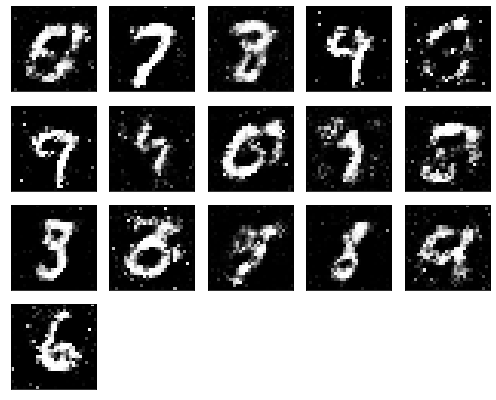

Epochs nb. 2441
discriminator loss: 0.5318251848220825
generator loss : 0.9792038798332214

Epochs nb. 2442
discriminator loss: 0.5251705646514893
generator loss : 1.0443497896194458

Epochs nb. 2443
discriminator loss: 0.6262004971504211
generator loss : 0.9214802384376526

Epochs nb. 2444
discriminator loss: 0.39923182129859924
generator loss : 1.0952121019363403

Epochs nb. 2445
discriminator loss: 0.5044541954994202
generator loss : 0.9732650518417358

Epochs nb. 2446
discriminator loss: 0.7534703016281128
generator loss : 1.102132797241211

Epochs nb. 2447
discriminator loss: 0.5602898597717285
generator loss : 1.0031293630599976

Epochs nb. 2448
discriminator loss: 0.5711190700531006
generator loss : 1.099808692932129

Epochs nb. 2449
discriminator loss: 0.6555022597312927
generator loss : 1.016036868095398

Epochs nb. 2450
discriminator loss: 0.5528581738471985
generator loss : 0.996810793876648



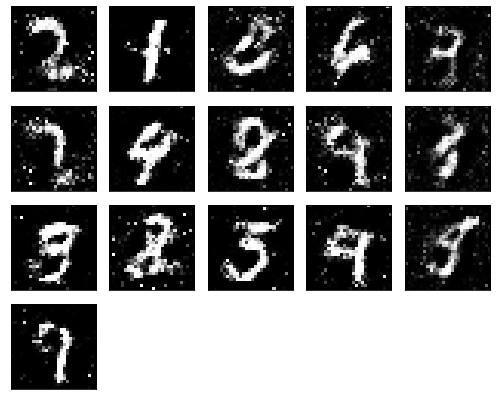

Epochs nb. 2451
discriminator loss: 0.4667891263961792
generator loss : 1.0336027145385742

Epochs nb. 2452
discriminator loss: 0.6817208528518677
generator loss : 0.9665232300758362

Epochs nb. 2453
discriminator loss: 0.580207884311676
generator loss : 0.8731251955032349

Epochs nb. 2454
discriminator loss: 0.5082980394363403
generator loss : 1.042466402053833

Epochs nb. 2455
discriminator loss: 0.6942817568778992
generator loss : 0.9695395827293396

Epochs nb. 2456
discriminator loss: 0.6384537220001221
generator loss : 0.9771732687950134

Epochs nb. 2457
discriminator loss: 0.5687434077262878
generator loss : 1.0229768753051758

Epochs nb. 2458
discriminator loss: 0.5339081287384033
generator loss : 0.9076119065284729

Epochs nb. 2459
discriminator loss: 0.6025272607803345
generator loss : 1.0174826383590698

Epochs nb. 2460
discriminator loss: 0.5488231778144836
generator loss : 0.8170958161354065



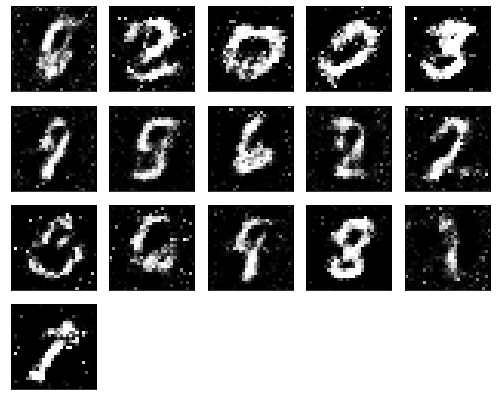

Epochs nb. 2461
discriminator loss: 0.4805932939052582
generator loss : 0.8656793236732483

Epochs nb. 2462
discriminator loss: 0.4878799021244049
generator loss : 0.8218077421188354

Epochs nb. 2463
discriminator loss: 0.6172362565994263
generator loss : 0.7891013622283936

Epochs nb. 2464
discriminator loss: 0.5219351053237915
generator loss : 0.9497489333152771

Epochs nb. 2465
discriminator loss: 0.6306030750274658
generator loss : 1.2379306554794312

Epochs nb. 2466
discriminator loss: 0.6018640995025635
generator loss : 0.9233106374740601

Epochs nb. 2467
discriminator loss: 0.5077949166297913
generator loss : 0.9683430194854736

Epochs nb. 2468
discriminator loss: 0.4884435832500458
generator loss : 1.0315619707107544

Epochs nb. 2469
discriminator loss: 0.6018099188804626
generator loss : 1.0692998170852661

Epochs nb. 2470
discriminator loss: 0.7340123653411865
generator loss : 1.0460102558135986



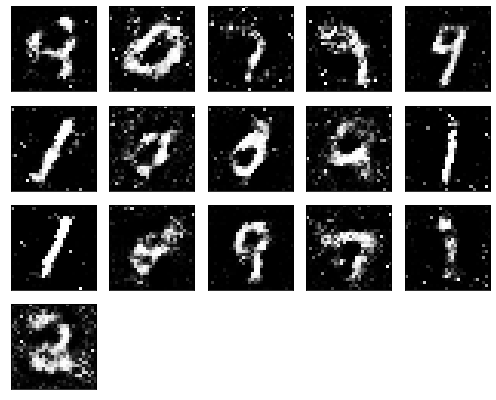

Epochs nb. 2471
discriminator loss: 0.5194215178489685
generator loss : 0.9651994705200195

Epochs nb. 2472
discriminator loss: 0.6685376167297363
generator loss : 0.8355574011802673

Epochs nb. 2473
discriminator loss: 0.5902514457702637
generator loss : 1.032012939453125

Epochs nb. 2474
discriminator loss: 0.5134016275405884
generator loss : 0.9154171943664551

Epochs nb. 2475
discriminator loss: 0.6348886489868164
generator loss : 1.024620771408081

Epochs nb. 2476
discriminator loss: 0.581816554069519
generator loss : 0.9735556244850159

Epochs nb. 2477
discriminator loss: 0.5685713291168213
generator loss : 0.9302753210067749

Epochs nb. 2478
discriminator loss: 0.5238732099533081
generator loss : 1.0159821510314941

Epochs nb. 2479
discriminator loss: 0.6328839063644409
generator loss : 0.9565837979316711

Epochs nb. 2480
discriminator loss: 0.6308191418647766
generator loss : 0.9806342124938965



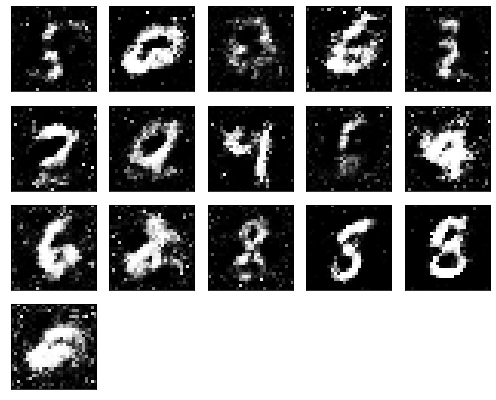

Epochs nb. 2481
discriminator loss: 0.6407890319824219
generator loss : 1.0412449836730957

Epochs nb. 2482
discriminator loss: 0.4306063652038574
generator loss : 0.8311893939971924

Epochs nb. 2483
discriminator loss: 0.46890246868133545
generator loss : 0.9435612559318542

Epochs nb. 2484
discriminator loss: 0.5112625360488892
generator loss : 0.9213141202926636

Epochs nb. 2485
discriminator loss: 0.502682626247406
generator loss : 1.090343713760376

Epochs nb. 2486
discriminator loss: 0.8123559951782227
generator loss : 1.0214194059371948

Epochs nb. 2487
discriminator loss: 0.47201788425445557
generator loss : 0.8997825980186462

Epochs nb. 2488
discriminator loss: 0.6327613592147827
generator loss : 0.8564214706420898

Epochs nb. 2489
discriminator loss: 0.6772432327270508
generator loss : 1.0495414733886719

Epochs nb. 2490
discriminator loss: 0.6420149803161621
generator loss : 1.0174189805984497



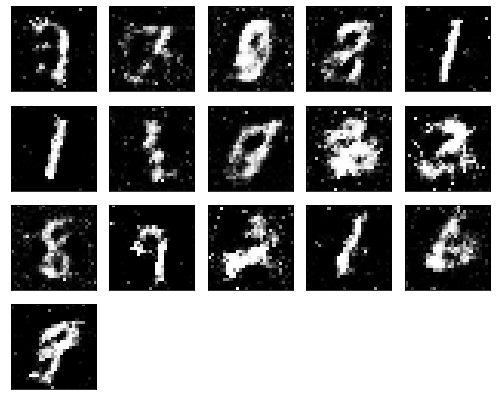

Epochs nb. 2491
discriminator loss: 0.5319766998291016
generator loss : 0.9669153094291687

Epochs nb. 2492
discriminator loss: 0.4701990485191345
generator loss : 0.8273961544036865

Epochs nb. 2493
discriminator loss: 0.6376196146011353
generator loss : 1.0147957801818848

Epochs nb. 2494
discriminator loss: 0.5825401544570923
generator loss : 1.0970805883407593

Epochs nb. 2495
discriminator loss: 0.5411858558654785
generator loss : 1.0698140859603882

Epochs nb. 2496
discriminator loss: 0.650212287902832
generator loss : 1.0564383268356323

Epochs nb. 2497
discriminator loss: 0.4892638325691223
generator loss : 0.9311924576759338

Epochs nb. 2498
discriminator loss: 0.6951301097869873
generator loss : 0.9788299202919006

Epochs nb. 2499
discriminator loss: 0.4293975234031677
generator loss : 0.9534035921096802

Epochs nb. 2500
discriminator loss: 0.5123987793922424
generator loss : 0.8825022578239441



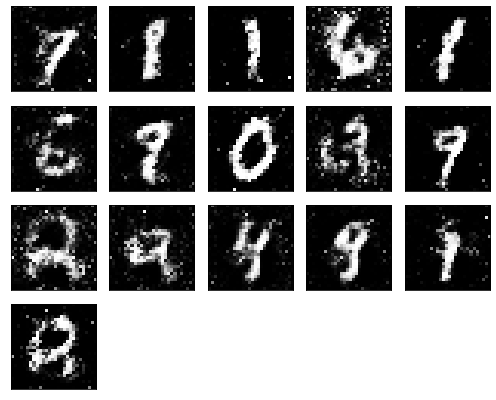

Epochs nb. 2501
discriminator loss: 0.5863549709320068
generator loss : 1.0576777458190918

Epochs nb. 2502
discriminator loss: 0.75001060962677
generator loss : 1.0690255165100098

Epochs nb. 2503
discriminator loss: 0.6125929355621338
generator loss : 0.9494051337242126

Epochs nb. 2504
discriminator loss: 0.6432664394378662
generator loss : 1.0357301235198975

Epochs nb. 2505
discriminator loss: 0.6649864912033081
generator loss : 1.0015019178390503

Epochs nb. 2506
discriminator loss: 0.5492318868637085
generator loss : 0.8940550088882446

Epochs nb. 2507
discriminator loss: 0.7321526408195496
generator loss : 1.0162633657455444

Epochs nb. 2508
discriminator loss: 0.6114752292633057
generator loss : 0.9281231164932251

Epochs nb. 2509
discriminator loss: 0.5572385787963867
generator loss : 0.8932485580444336

Epochs nb. 2510
discriminator loss: 0.6603870391845703
generator loss : 1.0317989587783813



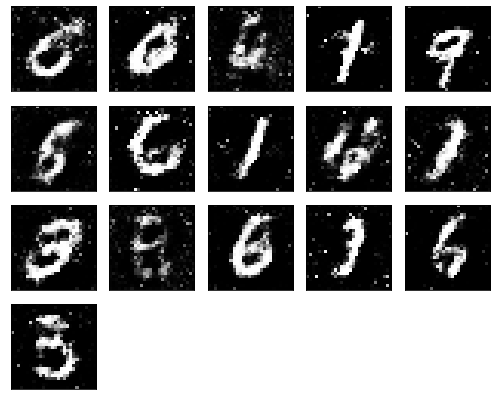

Epochs nb. 2511
discriminator loss: 0.46676939725875854
generator loss : 1.0522503852844238

Epochs nb. 2512
discriminator loss: 0.4970977306365967
generator loss : 1.0917918682098389

Epochs nb. 2513
discriminator loss: 0.5260578393936157
generator loss : 1.1376162767410278

Epochs nb. 2514
discriminator loss: 0.6731670498847961
generator loss : 0.9443149566650391

Epochs nb. 2515
discriminator loss: 0.612395167350769
generator loss : 1.0098813772201538

Epochs nb. 2516
discriminator loss: 0.5473194718360901
generator loss : 0.9561594128608704

Epochs nb. 2517
discriminator loss: 0.5885004997253418
generator loss : 0.9944033622741699

Epochs nb. 2518
discriminator loss: 0.6772503852844238
generator loss : 1.0137712955474854

Epochs nb. 2519
discriminator loss: 0.6028026342391968
generator loss : 0.9016206860542297

Epochs nb. 2520
discriminator loss: 0.4861523509025574
generator loss : 1.0716521739959717



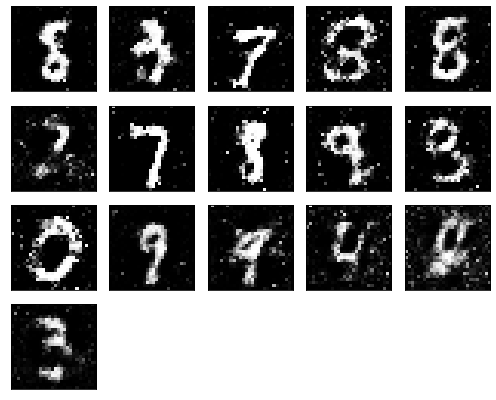

Epochs nb. 2521
discriminator loss: 0.5459138751029968
generator loss : 0.9992098808288574

Epochs nb. 2522
discriminator loss: 0.6497392058372498
generator loss : 1.1593283414840698

Epochs nb. 2523
discriminator loss: 0.5926660299301147
generator loss : 0.9964873194694519

Epochs nb. 2524
discriminator loss: 0.5859304666519165
generator loss : 0.7864316701889038

Epochs nb. 2525
discriminator loss: 0.5152602195739746
generator loss : 0.8024450540542603

Epochs nb. 2526
discriminator loss: 0.5364755392074585
generator loss : 0.9443171620368958

Epochs nb. 2527
discriminator loss: 0.6733719110488892
generator loss : 0.942471981048584

Epochs nb. 2528
discriminator loss: 0.5603753328323364
generator loss : 0.8243874907493591

Epochs nb. 2529
discriminator loss: 0.5550704598426819
generator loss : 0.9496786594390869

Epochs nb. 2530
discriminator loss: 0.5457233786582947
generator loss : 0.9839532971382141



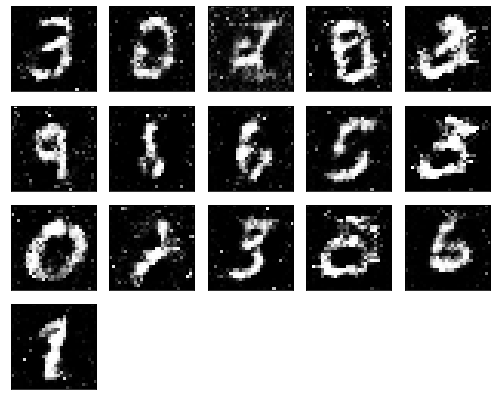

Epochs nb. 2531
discriminator loss: 0.5244433879852295
generator loss : 1.1183445453643799

Epochs nb. 2532
discriminator loss: 0.6294788122177124
generator loss : 0.9833225607872009

Epochs nb. 2533
discriminator loss: 0.6509449481964111
generator loss : 0.9396135807037354

Epochs nb. 2534
discriminator loss: 0.4890020787715912
generator loss : 0.899228572845459

Epochs nb. 2535
discriminator loss: 0.520710825920105
generator loss : 0.8243935108184814

Epochs nb. 2536
discriminator loss: 0.5315650701522827
generator loss : 0.9618473649024963

Epochs nb. 2537
discriminator loss: 0.6995561122894287
generator loss : 1.0079474449157715

Epochs nb. 2538
discriminator loss: 0.689662754535675
generator loss : 1.0277314186096191

Epochs nb. 2539
discriminator loss: 0.6225839853286743
generator loss : 1.1375423669815063

Epochs nb. 2540
discriminator loss: 0.6690186858177185
generator loss : 1.009793758392334



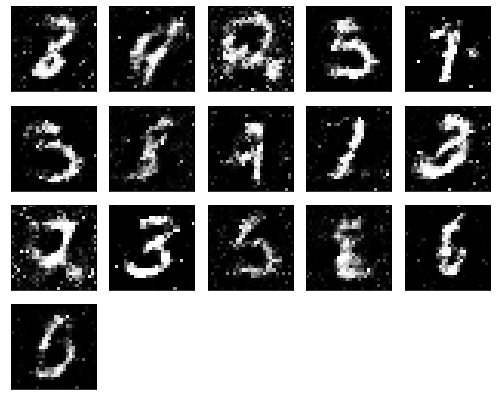

Epochs nb. 2541
discriminator loss: 0.6068031787872314
generator loss : 1.060063362121582

Epochs nb. 2542
discriminator loss: 0.569587767124176
generator loss : 1.0100200176239014

Epochs nb. 2543
discriminator loss: 0.509251058101654
generator loss : 0.9837179183959961

Epochs nb. 2544
discriminator loss: 0.5051205158233643
generator loss : 0.9522148966789246

Epochs nb. 2545
discriminator loss: 0.5197015404701233
generator loss : 1.217516541481018

Epochs nb. 2546
discriminator loss: 0.5817543864250183
generator loss : 0.8470633029937744

Epochs nb. 2547
discriminator loss: 0.632000207901001
generator loss : 0.8558600544929504

Epochs nb. 2548
discriminator loss: 0.5758312940597534
generator loss : 0.8405745625495911

Epochs nb. 2549
discriminator loss: 0.6091079115867615
generator loss : 0.9763495326042175

Epochs nb. 2550
discriminator loss: 0.5538355708122253
generator loss : 1.0256249904632568



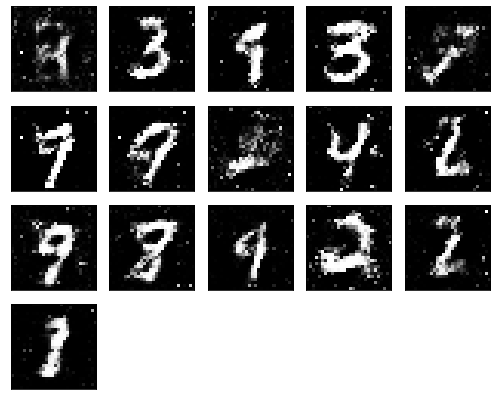

Epochs nb. 2551
discriminator loss: 0.5984659194946289
generator loss : 0.8862749338150024

Epochs nb. 2552
discriminator loss: 0.523632287979126
generator loss : 1.0070412158966064

Epochs nb. 2553
discriminator loss: 0.6136879920959473
generator loss : 1.007798194885254

Epochs nb. 2554
discriminator loss: 0.5940919518470764
generator loss : 0.9631160497665405

Epochs nb. 2555
discriminator loss: 0.6941876411437988
generator loss : 1.0272401571273804

Epochs nb. 2556
discriminator loss: 0.5840493440628052
generator loss : 0.9390223026275635

Epochs nb. 2557
discriminator loss: 0.6292335987091064
generator loss : 0.8725826740264893

Epochs nb. 2558
discriminator loss: 0.7599087953567505
generator loss : 1.0617952346801758

Epochs nb. 2559
discriminator loss: 0.5441646575927734
generator loss : 0.9404247403144836

Epochs nb. 2560
discriminator loss: 0.6953914165496826
generator loss : 1.230700135231018



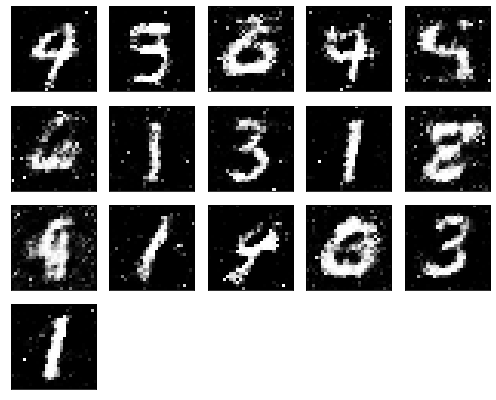

Epochs nb. 2561
discriminator loss: 0.49663275480270386
generator loss : 1.0483052730560303

Epochs nb. 2562
discriminator loss: 0.6093956232070923
generator loss : 1.0303481817245483

Epochs nb. 2563
discriminator loss: 0.5908446311950684
generator loss : 1.1487298011779785

Epochs nb. 2564
discriminator loss: 0.5904676914215088
generator loss : 0.9387774467468262

Epochs nb. 2565
discriminator loss: 0.6110931634902954
generator loss : 0.8754974603652954

Epochs nb. 2566
discriminator loss: 0.617310106754303
generator loss : 0.9119733572006226

Epochs nb. 2567
discriminator loss: 0.6812986135482788
generator loss : 0.7483242750167847

Epochs nb. 2568
discriminator loss: 0.6193545460700989
generator loss : 1.091030478477478

Epochs nb. 2569
discriminator loss: 0.5757443904876709
generator loss : 0.8822355270385742

Epochs nb. 2570
discriminator loss: 0.6976418495178223
generator loss : 0.8946384787559509



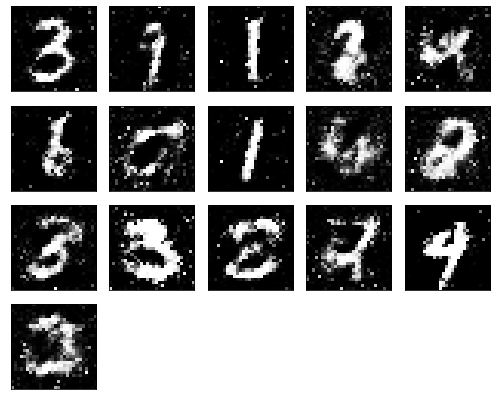

Epochs nb. 2571
discriminator loss: 0.5541293621063232
generator loss : 0.9512459635734558

Epochs nb. 2572
discriminator loss: 0.5554314851760864
generator loss : 1.0755786895751953

Epochs nb. 2573
discriminator loss: 0.5813195705413818
generator loss : 0.9708033800125122

Epochs nb. 2574
discriminator loss: 0.5787165760993958
generator loss : 0.8436293005943298

Epochs nb. 2575
discriminator loss: 0.6606754660606384
generator loss : 0.8737800717353821

Epochs nb. 2576
discriminator loss: 0.5572394132614136
generator loss : 1.0016722679138184

Epochs nb. 2577
discriminator loss: 0.6005449295043945
generator loss : 0.9989921450614929

Epochs nb. 2578
discriminator loss: 0.6952790021896362
generator loss : 0.839019775390625

Epochs nb. 2579
discriminator loss: 0.6330079436302185
generator loss : 0.8545655012130737

Epochs nb. 2580
discriminator loss: 0.4899711012840271
generator loss : 0.9143873453140259



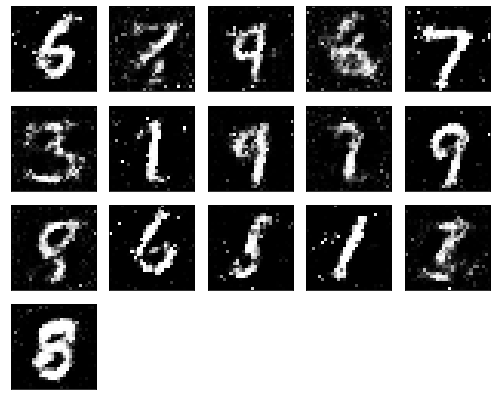

Epochs nb. 2581
discriminator loss: 0.6640579104423523
generator loss : 0.7916221618652344

Epochs nb. 2582
discriminator loss: 0.5844155550003052
generator loss : 0.8407686948776245

Epochs nb. 2583
discriminator loss: 0.5774326324462891
generator loss : 1.034796953201294

Epochs nb. 2584
discriminator loss: 0.66555255651474
generator loss : 1.0419992208480835

Epochs nb. 2585
discriminator loss: 0.5547437071800232
generator loss : 0.8617638945579529

Epochs nb. 2586
discriminator loss: 0.4897812008857727
generator loss : 1.0365922451019287

Epochs nb. 2587
discriminator loss: 0.6051051616668701
generator loss : 1.1460559368133545

Epochs nb. 2588
discriminator loss: 0.6365229487419128
generator loss : 1.0276445150375366

Epochs nb. 2589
discriminator loss: 0.6288539171218872
generator loss : 0.9628036022186279

Epochs nb. 2590
discriminator loss: 0.5607309937477112
generator loss : 0.9381873607635498



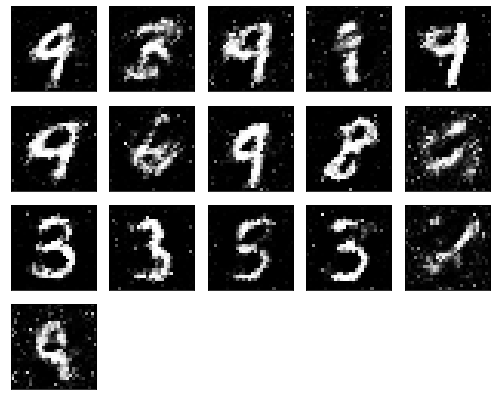

Epochs nb. 2591
discriminator loss: 0.5424655675888062
generator loss : 0.8153210878372192

Epochs nb. 2592
discriminator loss: 0.5545109510421753
generator loss : 0.9199405908584595

Epochs nb. 2593
discriminator loss: 0.5360777378082275
generator loss : 0.9784029126167297

Epochs nb. 2594
discriminator loss: 0.5807551145553589
generator loss : 0.9562434554100037

Epochs nb. 2595
discriminator loss: 0.6733007431030273
generator loss : 1.0206233263015747

Epochs nb. 2596
discriminator loss: 0.44890737533569336
generator loss : 0.9589190483093262

Epochs nb. 2597
discriminator loss: 0.6194553375244141
generator loss : 1.1013699769973755

Epochs nb. 2598
discriminator loss: 0.5085480809211731
generator loss : 0.9731581211090088

Epochs nb. 2599
discriminator loss: 0.4555079936981201
generator loss : 0.9409548044204712

Epochs nb. 2600
discriminator loss: 0.5659855604171753
generator loss : 0.9307594299316406



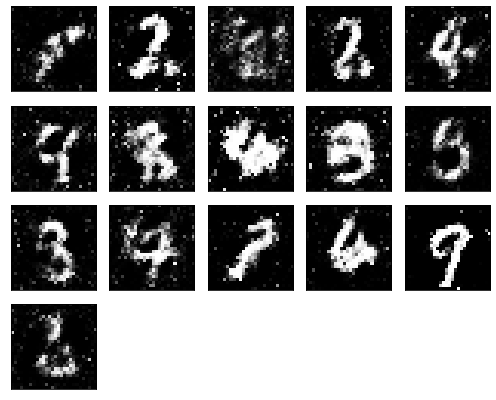

Epochs nb. 2601
discriminator loss: 0.6490360498428345
generator loss : 1.1477117538452148

Epochs nb. 2602
discriminator loss: 0.5821616649627686
generator loss : 0.9151979684829712

Epochs nb. 2603
discriminator loss: 0.5145975947380066
generator loss : 0.8866974115371704

Epochs nb. 2604
discriminator loss: 0.660610556602478
generator loss : 0.89773029088974

Epochs nb. 2605
discriminator loss: 0.6425777673721313
generator loss : 1.0442348718643188

Epochs nb. 2606
discriminator loss: 0.6576353311538696
generator loss : 1.0335134267807007

Epochs nb. 2607
discriminator loss: 0.5885359048843384
generator loss : 0.9359488487243652

Epochs nb. 2608
discriminator loss: 0.6836141347885132
generator loss : 0.8434104323387146

Epochs nb. 2609
discriminator loss: 0.6387743949890137
generator loss : 0.9276271462440491

Epochs nb. 2610
discriminator loss: 0.6478164792060852
generator loss : 0.8202924728393555



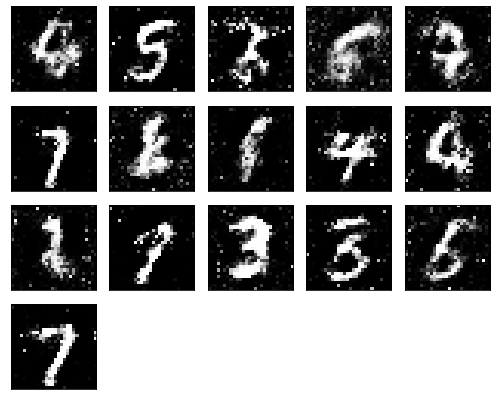

Epochs nb. 2611
discriminator loss: 0.6729695200920105
generator loss : 1.1529204845428467

Epochs nb. 2612
discriminator loss: 0.5843717455863953
generator loss : 1.0112252235412598

Epochs nb. 2613
discriminator loss: 0.5733232498168945
generator loss : 0.9604567289352417

Epochs nb. 2614
discriminator loss: 0.6416009664535522
generator loss : 0.7913538217544556

Epochs nb. 2615
discriminator loss: 0.62107253074646
generator loss : 0.9807987809181213

Epochs nb. 2616
discriminator loss: 0.6712139844894409
generator loss : 1.0236222743988037

Epochs nb. 2617
discriminator loss: 0.6408224105834961
generator loss : 1.0738592147827148

Epochs nb. 2618
discriminator loss: 0.662811279296875
generator loss : 1.0076712369918823

Epochs nb. 2619
discriminator loss: 0.5786197185516357
generator loss : 0.854935884475708

Epochs nb. 2620
discriminator loss: 0.5547573566436768
generator loss : 1.091217041015625



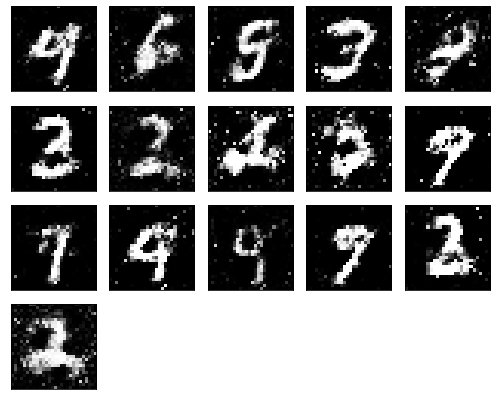

Epochs nb. 2621
discriminator loss: 0.6067240238189697
generator loss : 0.8573363423347473

Epochs nb. 2622
discriminator loss: 0.5894347429275513
generator loss : 1.0188363790512085

Epochs nb. 2623
discriminator loss: 0.5532364845275879
generator loss : 1.0363565683364868

Epochs nb. 2624
discriminator loss: 0.5744985342025757
generator loss : 0.9649621248245239

Epochs nb. 2625
discriminator loss: 0.5246052742004395
generator loss : 0.9739630222320557

Epochs nb. 2626
discriminator loss: 0.5537369251251221
generator loss : 0.9596450328826904

Epochs nb. 2627
discriminator loss: 0.5756758451461792
generator loss : 1.0243895053863525

Epochs nb. 2628
discriminator loss: 0.6121401786804199
generator loss : 1.1119394302368164

Epochs nb. 2629
discriminator loss: 0.48372596502304077
generator loss : 0.9331341981887817

Epochs nb. 2630
discriminator loss: 0.5619528889656067
generator loss : 0.939150869846344



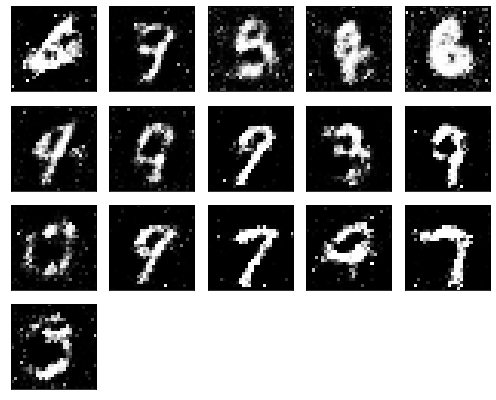

Epochs nb. 2631
discriminator loss: 0.574864387512207
generator loss : 1.0707165002822876

Epochs nb. 2632
discriminator loss: 0.5575310587882996
generator loss : 1.0105619430541992

Epochs nb. 2633
discriminator loss: 0.6860837936401367
generator loss : 0.9821858406066895

Epochs nb. 2634
discriminator loss: 0.6061424016952515
generator loss : 1.0199732780456543

Epochs nb. 2635
discriminator loss: 0.5745782852172852
generator loss : 1.0575584173202515

Epochs nb. 2636
discriminator loss: 0.4552587568759918
generator loss : 1.0832641124725342

Epochs nb. 2637
discriminator loss: 0.6052938103675842
generator loss : 1.0712352991104126

Epochs nb. 2638
discriminator loss: 0.5663923025131226
generator loss : 0.9789975881576538

Epochs nb. 2639
discriminator loss: 0.5930280685424805
generator loss : 1.066356897354126

Epochs nb. 2640
discriminator loss: 0.5895223617553711
generator loss : 1.0941426753997803



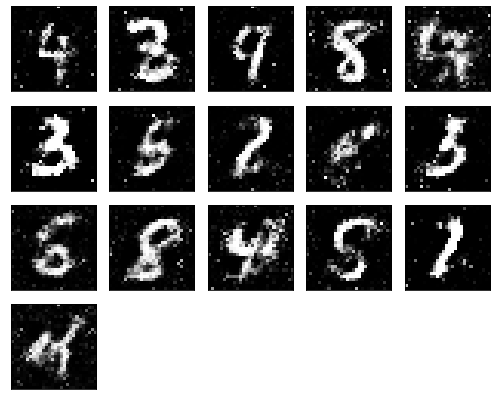

Epochs nb. 2641
discriminator loss: 0.4740675091743469
generator loss : 1.0074224472045898

Epochs nb. 2642
discriminator loss: 0.5440464019775391
generator loss : 0.8989132642745972

Epochs nb. 2643
discriminator loss: 0.7216452956199646
generator loss : 0.9501768946647644

Epochs nb. 2644
discriminator loss: 0.5011489391326904
generator loss : 1.0346729755401611

Epochs nb. 2645
discriminator loss: 0.5429928302764893
generator loss : 0.977810263633728

Epochs nb. 2646
discriminator loss: 0.5565035343170166
generator loss : 0.9356903433799744

Epochs nb. 2647
discriminator loss: 0.7293075919151306
generator loss : 1.0356850624084473

Epochs nb. 2648
discriminator loss: 0.6893253326416016
generator loss : 0.8050684332847595

Epochs nb. 2649
discriminator loss: 0.5907953977584839
generator loss : 0.9319748282432556

Epochs nb. 2650
discriminator loss: 0.4649217426776886
generator loss : 1.04323148727417



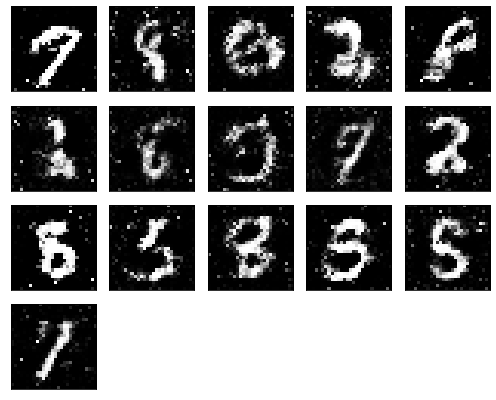

Epochs nb. 2651
discriminator loss: 0.5319637060165405
generator loss : 0.9990290403366089

Epochs nb. 2652
discriminator loss: 0.6900274753570557
generator loss : 0.9494619369506836

Epochs nb. 2653
discriminator loss: 0.6232780814170837
generator loss : 0.9430458545684814

Epochs nb. 2654
discriminator loss: 0.5638256072998047
generator loss : 0.9098567962646484

Epochs nb. 2655
discriminator loss: 0.6328915357589722
generator loss : 0.9645899534225464

Epochs nb. 2656
discriminator loss: 0.5657769441604614
generator loss : 1.0260026454925537

Epochs nb. 2657
discriminator loss: 0.5057231187820435
generator loss : 0.983820378780365

Epochs nb. 2658
discriminator loss: 0.6024748086929321
generator loss : 0.9076222777366638

Epochs nb. 2659
discriminator loss: 0.6325239539146423
generator loss : 0.9445441961288452

Epochs nb. 2660
discriminator loss: 0.45416370034217834
generator loss : 0.9146464467048645



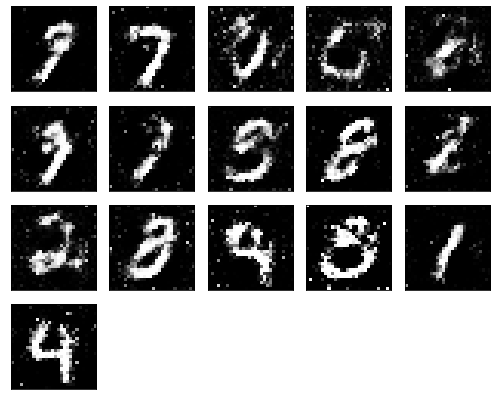

Epochs nb. 2661
discriminator loss: 0.6530386209487915
generator loss : 1.0070911645889282

Epochs nb. 2662
discriminator loss: 0.689183235168457
generator loss : 1.0349704027175903

Epochs nb. 2663
discriminator loss: 0.5672940015792847
generator loss : 0.9562202095985413

Epochs nb. 2664
discriminator loss: 0.5887629389762878
generator loss : 0.9559670686721802

Epochs nb. 2665
discriminator loss: 0.5869472026824951
generator loss : 0.9315309524536133

Epochs nb. 2666
discriminator loss: 0.5239092111587524
generator loss : 1.0795457363128662

Epochs nb. 2667
discriminator loss: 0.7448830604553223
generator loss : 0.9679850935935974

Epochs nb. 2668
discriminator loss: 0.718998908996582
generator loss : 0.8737255334854126

Epochs nb. 2669
discriminator loss: 0.6003270745277405
generator loss : 0.9737017154693604

Epochs nb. 2670
discriminator loss: 0.5207847356796265
generator loss : 0.9175912737846375



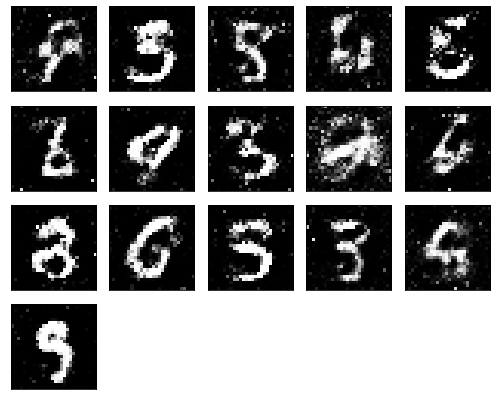

Epochs nb. 2671
discriminator loss: 0.5147258043289185
generator loss : 0.9430210590362549

Epochs nb. 2672
discriminator loss: 0.583895742893219
generator loss : 1.025298833847046

Epochs nb. 2673
discriminator loss: 0.6197565197944641
generator loss : 0.9197413921356201

Epochs nb. 2674
discriminator loss: 0.6271470785140991
generator loss : 0.856520414352417

Epochs nb. 2675
discriminator loss: 0.5189141631126404
generator loss : 1.0258028507232666

Epochs nb. 2676
discriminator loss: 0.5550448298454285
generator loss : 0.9564964175224304

Epochs nb. 2677
discriminator loss: 0.5740848779678345
generator loss : 0.8685805797576904

Epochs nb. 2678
discriminator loss: 0.5595642328262329
generator loss : 0.9028422236442566

Epochs nb. 2679
discriminator loss: 0.5139303207397461
generator loss : 0.9731780290603638

Epochs nb. 2680
discriminator loss: 0.5874379873275757
generator loss : 0.9914326071739197



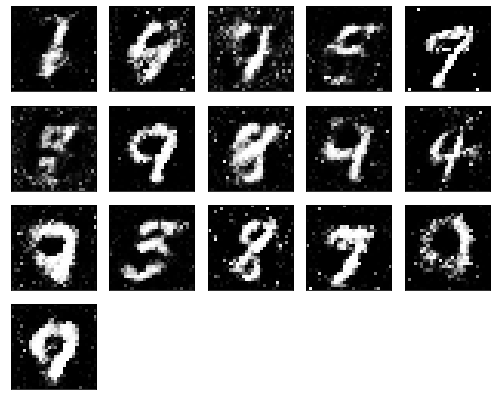

Epochs nb. 2681
discriminator loss: 0.5531736612319946
generator loss : 0.9836382269859314

Epochs nb. 2682
discriminator loss: 0.8052026629447937
generator loss : 1.037326693534851

Epochs nb. 2683
discriminator loss: 0.5702311992645264
generator loss : 0.8483065366744995

Epochs nb. 2684
discriminator loss: 0.505078911781311
generator loss : 1.088655948638916

Epochs nb. 2685
discriminator loss: 0.5718725919723511
generator loss : 0.9724199771881104

Epochs nb. 2686
discriminator loss: 0.6255003213882446
generator loss : 1.1104283332824707

Epochs nb. 2687
discriminator loss: 0.5967443585395813
generator loss : 1.1049678325653076

Epochs nb. 2688
discriminator loss: 0.5114632844924927
generator loss : 0.8672868609428406

Epochs nb. 2689
discriminator loss: 0.6181141138076782
generator loss : 1.0710004568099976

Epochs nb. 2690
discriminator loss: 0.6324721574783325
generator loss : 0.833320140838623



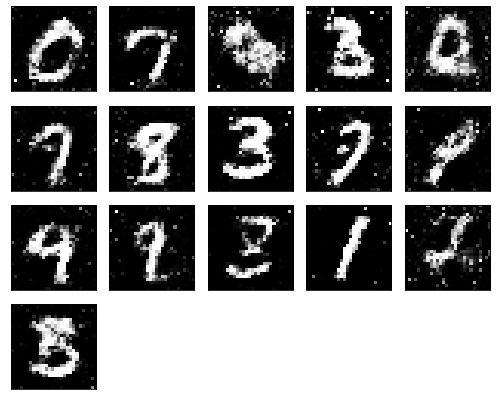

Epochs nb. 2691
discriminator loss: 0.5481489896774292
generator loss : 0.9877204298973083

Epochs nb. 2692
discriminator loss: 0.6046573519706726
generator loss : 1.1067590713500977

Epochs nb. 2693
discriminator loss: 0.5568658113479614
generator loss : 1.0730164051055908

Epochs nb. 2694
discriminator loss: 0.5585708618164062
generator loss : 1.0054343938827515

Epochs nb. 2695
discriminator loss: 0.4624287486076355
generator loss : 0.9886652827262878

Epochs nb. 2696
discriminator loss: 0.671025276184082
generator loss : 1.2373926639556885

Epochs nb. 2697
discriminator loss: 0.5669794678688049
generator loss : 1.010331392288208

Epochs nb. 2698
discriminator loss: 0.6144770979881287
generator loss : 1.0902855396270752

Epochs nb. 2699
discriminator loss: 0.6362447738647461
generator loss : 1.1072754859924316

Epochs nb. 2700
discriminator loss: 0.5678713917732239
generator loss : 0.9022592306137085



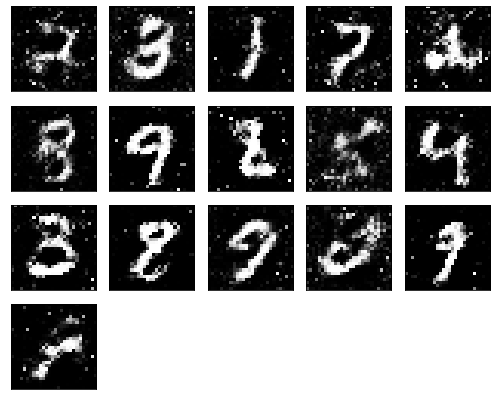

Epochs nb. 2701
discriminator loss: 0.5416601896286011
generator loss : 0.8938813209533691

Epochs nb. 2702
discriminator loss: 0.6412115693092346
generator loss : 1.0040497779846191

Epochs nb. 2703
discriminator loss: 0.5793814063072205
generator loss : 1.1515506505966187

Epochs nb. 2704
discriminator loss: 0.5727839469909668
generator loss : 1.3738102912902832

Epochs nb. 2705
discriminator loss: 0.5951932668685913
generator loss : 1.159569501876831

Epochs nb. 2706
discriminator loss: 0.7981363534927368
generator loss : 1.1581947803497314

Epochs nb. 2707
discriminator loss: 0.6536769270896912
generator loss : 0.8911236524581909

Epochs nb. 2708
discriminator loss: 0.4690729081630707
generator loss : 0.979536771774292

Epochs nb. 2709
discriminator loss: 0.6405581831932068
generator loss : 0.9574496746063232

Epochs nb. 2710
discriminator loss: 0.562201201915741
generator loss : 0.9661811590194702



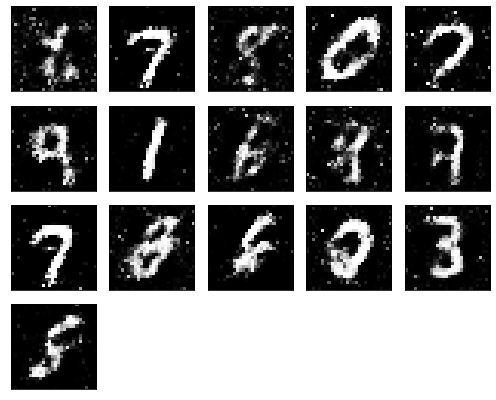

Epochs nb. 2711
discriminator loss: 0.5650275945663452
generator loss : 0.8315404653549194

Epochs nb. 2712
discriminator loss: 0.5615172386169434
generator loss : 0.8391526937484741

Epochs nb. 2713
discriminator loss: 0.7111632823944092
generator loss : 0.9304913282394409

Epochs nb. 2714
discriminator loss: 0.6047295331954956
generator loss : 0.9950799942016602

Epochs nb. 2715
discriminator loss: 0.5896592140197754
generator loss : 0.9568583965301514

Epochs nb. 2716
discriminator loss: 0.4693831503391266
generator loss : 0.9904205799102783

Epochs nb. 2717
discriminator loss: 0.5785109996795654
generator loss : 1.2385733127593994

Epochs nb. 2718
discriminator loss: 0.6353700757026672
generator loss : 0.9093347787857056

Epochs nb. 2719
discriminator loss: 0.5226994752883911
generator loss : 0.8948761224746704

Epochs nb. 2720
discriminator loss: 0.5437095165252686
generator loss : 1.0215787887573242



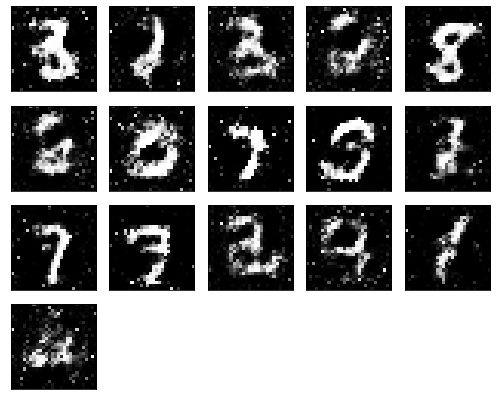

Epochs nb. 2721
discriminator loss: 0.5289499759674072
generator loss : 0.9077374339103699

Epochs nb. 2722
discriminator loss: 0.5373753309249878
generator loss : 0.9672999382019043

Epochs nb. 2723
discriminator loss: 0.4985384941101074
generator loss : 0.9625650644302368

Epochs nb. 2724
discriminator loss: 0.5154409408569336
generator loss : 0.9685643911361694

Epochs nb. 2725
discriminator loss: 0.8227188587188721
generator loss : 0.8821295499801636

Epochs nb. 2726
discriminator loss: 0.6611881256103516
generator loss : 0.9417788982391357

Epochs nb. 2727
discriminator loss: 0.6167112588882446
generator loss : 0.8621286153793335

Epochs nb. 2728
discriminator loss: 0.5132951736450195
generator loss : 0.9485014081001282

Epochs nb. 2729
discriminator loss: 0.6365193128585815
generator loss : 1.0862737894058228

Epochs nb. 2730
discriminator loss: 0.6082335114479065
generator loss : 0.9604933261871338



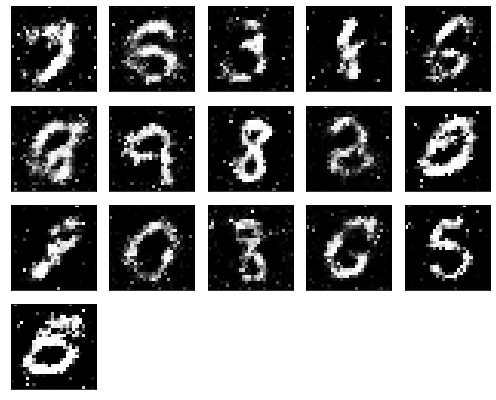

Epochs nb. 2731
discriminator loss: 0.6024945974349976
generator loss : 0.881488561630249

Epochs nb. 2732
discriminator loss: 0.6038927435874939
generator loss : 0.9765160083770752

Epochs nb. 2733
discriminator loss: 0.4780455231666565
generator loss : 1.06510591506958

Epochs nb. 2734
discriminator loss: 0.6919359564781189
generator loss : 1.039405107498169

Epochs nb. 2735
discriminator loss: 0.5278136730194092
generator loss : 1.152239441871643

Epochs nb. 2736
discriminator loss: 0.6151942610740662
generator loss : 0.8552170991897583

Epochs nb. 2737
discriminator loss: 0.6939231753349304
generator loss : 0.9800992012023926

Epochs nb. 2738
discriminator loss: 0.5545783042907715
generator loss : 0.9088287353515625

Epochs nb. 2739
discriminator loss: 0.45126813650131226
generator loss : 0.9181578755378723

Epochs nb. 2740
discriminator loss: 0.5077276825904846
generator loss : 0.9670263528823853



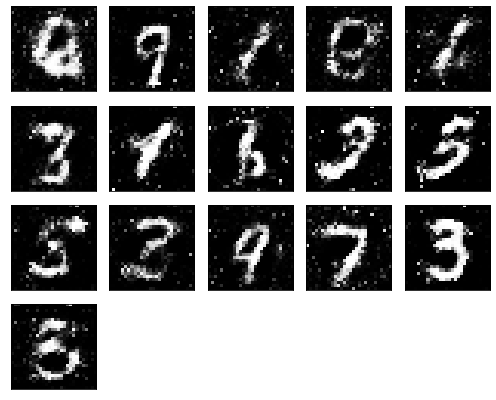

Epochs nb. 2741
discriminator loss: 0.7433764934539795
generator loss : 1.0057684183120728

Epochs nb. 2742
discriminator loss: 0.628484845161438
generator loss : 0.9723469614982605

Epochs nb. 2743
discriminator loss: 0.529670238494873
generator loss : 0.9669245481491089

Epochs nb. 2744
discriminator loss: 0.5428157448768616
generator loss : 1.0450825691223145

Epochs nb. 2745
discriminator loss: 0.6233326196670532
generator loss : 0.9727948307991028

Epochs nb. 2746
discriminator loss: 0.5626903772354126
generator loss : 1.09959077835083

Epochs nb. 2747
discriminator loss: 0.6449635028839111
generator loss : 0.9552671909332275

Epochs nb. 2748
discriminator loss: 0.6125466227531433
generator loss : 1.0709755420684814

Epochs nb. 2749
discriminator loss: 0.4701177477836609
generator loss : 1.009020447731018

Epochs nb. 2750
discriminator loss: 0.6953794956207275
generator loss : 1.1418774127960205



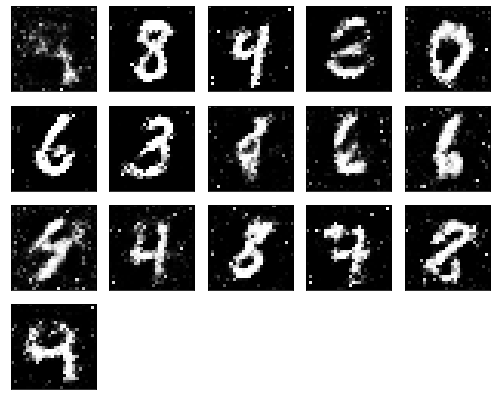

Epochs nb. 2751
discriminator loss: 0.4484127461910248
generator loss : 0.7435680627822876

Epochs nb. 2752
discriminator loss: 0.6166775226593018
generator loss : 1.1807211637496948

Epochs nb. 2753
discriminator loss: 0.4433397650718689
generator loss : 0.9716556072235107

Epochs nb. 2754
discriminator loss: 0.8047246932983398
generator loss : 0.9717695713043213

Epochs nb. 2755
discriminator loss: 0.5476764440536499
generator loss : 1.0261988639831543

Epochs nb. 2756
discriminator loss: 0.610663652420044
generator loss : 0.6780039668083191

Epochs nb. 2757
discriminator loss: 0.6442152261734009
generator loss : 0.9435392022132874

Epochs nb. 2758
discriminator loss: 0.5266538262367249
generator loss : 0.8717025518417358

Epochs nb. 2759
discriminator loss: 0.4785030484199524
generator loss : 0.9441459774971008

Epochs nb. 2760
discriminator loss: 0.6153851747512817
generator loss : 1.0292553901672363



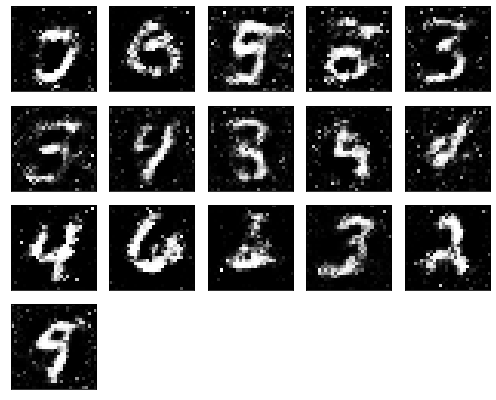

Epochs nb. 2761
discriminator loss: 0.515995979309082
generator loss : 0.9408144950866699

Epochs nb. 2762
discriminator loss: 0.5975953340530396
generator loss : 0.9678550958633423

Epochs nb. 2763
discriminator loss: 0.5633666515350342
generator loss : 0.7840080261230469

Epochs nb. 2764
discriminator loss: 0.536109209060669
generator loss : 1.135589599609375

Epochs nb. 2765
discriminator loss: 0.538183331489563
generator loss : 0.9636251926422119

Epochs nb. 2766
discriminator loss: 0.6404140591621399
generator loss : 0.8664056062698364

Epochs nb. 2767
discriminator loss: 0.5606833696365356
generator loss : 0.8479557633399963

Epochs nb. 2768
discriminator loss: 0.7917863130569458
generator loss : 0.9115046858787537

Epochs nb. 2769
discriminator loss: 0.5100088119506836
generator loss : 0.9815025925636292

Epochs nb. 2770
discriminator loss: 0.5276455879211426
generator loss : 1.063607096672058



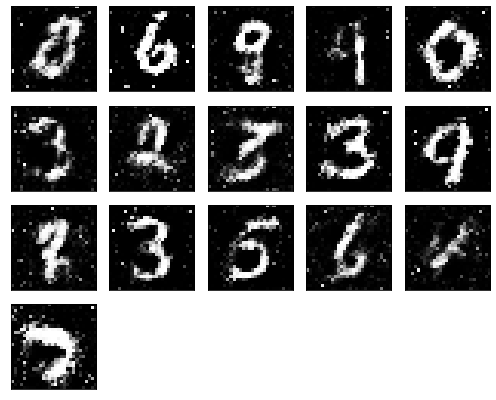

Epochs nb. 2771
discriminator loss: 0.47541287541389465
generator loss : 1.011518120765686

Epochs nb. 2772
discriminator loss: 0.604885458946228
generator loss : 1.0313565731048584

Epochs nb. 2773
discriminator loss: 0.676090657711029
generator loss : 0.9105730056762695

Epochs nb. 2774
discriminator loss: 0.609915554523468
generator loss : 1.062988519668579

Epochs nb. 2775
discriminator loss: 0.5577346682548523
generator loss : 0.9130239486694336

Epochs nb. 2776
discriminator loss: 0.5409013032913208
generator loss : 1.0248546600341797

Epochs nb. 2777
discriminator loss: 0.49652549624443054
generator loss : 1.0880067348480225

Epochs nb. 2778
discriminator loss: 0.4483226239681244
generator loss : 0.9563734531402588

Epochs nb. 2779
discriminator loss: 0.5979220867156982
generator loss : 0.9822417497634888

Epochs nb. 2780
discriminator loss: 0.5653674006462097
generator loss : 0.7879883646965027



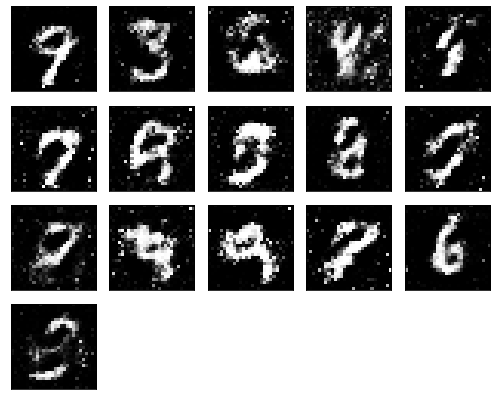

Epochs nb. 2781
discriminator loss: 0.6695249080657959
generator loss : 0.9113982319831848

Epochs nb. 2782
discriminator loss: 0.5935885310173035
generator loss : 0.8898375034332275

Epochs nb. 2783
discriminator loss: 0.5698765516281128
generator loss : 0.9162965416908264

Epochs nb. 2784
discriminator loss: 0.5845451354980469
generator loss : 1.0283238887786865

Epochs nb. 2785
discriminator loss: 0.5425000190734863
generator loss : 1.0544767379760742

Epochs nb. 2786
discriminator loss: 0.6648286581039429
generator loss : 0.9469155073165894

Epochs nb. 2787
discriminator loss: 0.6094592809677124
generator loss : 1.0332022905349731

Epochs nb. 2788
discriminator loss: 0.662593424320221
generator loss : 1.0449714660644531

Epochs nb. 2789
discriminator loss: 0.5816522836685181
generator loss : 1.0036635398864746

Epochs nb. 2790
discriminator loss: 0.6176318526268005
generator loss : 1.0958342552185059



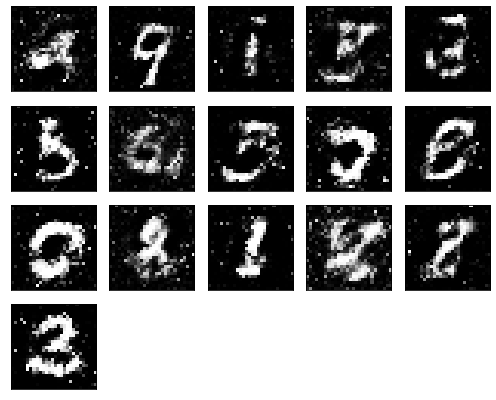

Epochs nb. 2791
discriminator loss: 0.6557263731956482
generator loss : 1.0506269931793213

Epochs nb. 2792
discriminator loss: 0.733675479888916
generator loss : 1.053067684173584

Epochs nb. 2793
discriminator loss: 0.6248171329498291
generator loss : 0.9854531288146973

Epochs nb. 2794
discriminator loss: 0.6730471849441528
generator loss : 0.8295360803604126

Epochs nb. 2795
discriminator loss: 0.5143592953681946
generator loss : 0.9793170690536499

Epochs nb. 2796
discriminator loss: 0.5980098843574524
generator loss : 0.8197034597396851

Epochs nb. 2797
discriminator loss: 0.6654895544052124
generator loss : 0.9148547649383545

Epochs nb. 2798
discriminator loss: 0.6875263452529907
generator loss : 0.9107115268707275

Epochs nb. 2799
discriminator loss: 0.5079546570777893
generator loss : 0.8770428895950317

Epochs nb. 2800
discriminator loss: 0.4787982404232025
generator loss : 0.8327986598014832



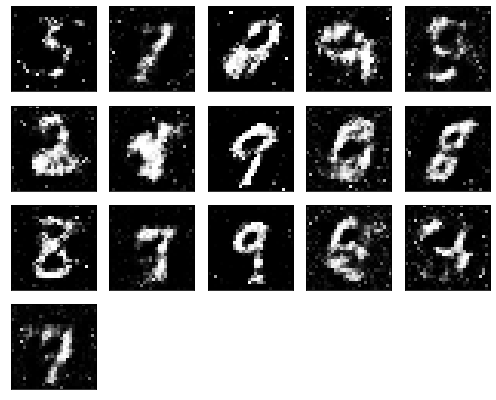

Epochs nb. 2801
discriminator loss: 0.5402143597602844
generator loss : 0.9622935652732849

Epochs nb. 2802
discriminator loss: 0.5491287112236023
generator loss : 0.9612398147583008

Epochs nb. 2803
discriminator loss: 0.6092896461486816
generator loss : 0.8841394186019897

Epochs nb. 2804
discriminator loss: 0.5505386590957642
generator loss : 1.0703603029251099

Epochs nb. 2805
discriminator loss: 0.5542925000190735
generator loss : 0.8657491207122803

Epochs nb. 2806
discriminator loss: 0.5663309097290039
generator loss : 0.8541572690010071

Epochs nb. 2807
discriminator loss: 0.5022282004356384
generator loss : 0.8942724466323853

Epochs nb. 2808
discriminator loss: 0.5716079473495483
generator loss : 1.0250751972198486

Epochs nb. 2809
discriminator loss: 0.6457225680351257
generator loss : 0.7871962785720825

Epochs nb. 2810
discriminator loss: 0.5001125335693359
generator loss : 0.9216402173042297



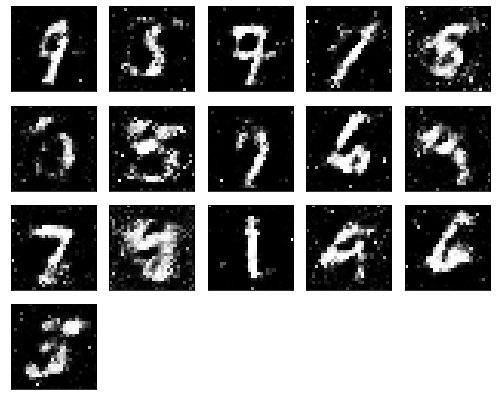

Epochs nb. 2811
discriminator loss: 0.7096239328384399
generator loss : 1.0740396976470947

Epochs nb. 2812
discriminator loss: 0.6758888959884644
generator loss : 0.906246542930603

Epochs nb. 2813
discriminator loss: 0.5533432364463806
generator loss : 0.9347776174545288

Epochs nb. 2814
discriminator loss: 0.5217336416244507
generator loss : 0.9602532982826233

Epochs nb. 2815
discriminator loss: 0.687304675579071
generator loss : 0.9705625772476196

Epochs nb. 2816
discriminator loss: 0.6217107772827148
generator loss : 0.9918308258056641

Epochs nb. 2817
discriminator loss: 0.6208854913711548
generator loss : 0.9569529891014099

Epochs nb. 2818
discriminator loss: 0.5334832668304443
generator loss : 0.8817856907844543

Epochs nb. 2819
discriminator loss: 0.6266957521438599
generator loss : 0.8586863875389099

Epochs nb. 2820
discriminator loss: 0.6936869621276855
generator loss : 0.9278442859649658



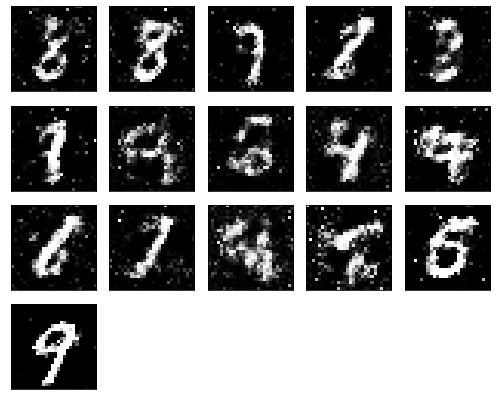

Epochs nb. 2821
discriminator loss: 0.5889139175415039
generator loss : 0.9026294946670532

Epochs nb. 2822
discriminator loss: 0.5201975703239441
generator loss : 0.848173201084137

Epochs nb. 2823
discriminator loss: 0.5111196041107178
generator loss : 0.885657787322998

Epochs nb. 2824
discriminator loss: 0.6806216239929199
generator loss : 0.9290761947631836

Epochs nb. 2825
discriminator loss: 0.5629128217697144
generator loss : 0.830755352973938

Epochs nb. 2826
discriminator loss: 0.7421761155128479
generator loss : 0.9665549993515015

Epochs nb. 2827
discriminator loss: 0.5025720596313477
generator loss : 0.951602578163147

Epochs nb. 2828
discriminator loss: 0.6555708646774292
generator loss : 0.9204864501953125

Epochs nb. 2829
discriminator loss: 0.5487828254699707
generator loss : 0.7786821722984314

Epochs nb. 2830
discriminator loss: 0.5363205671310425
generator loss : 0.7923833131790161



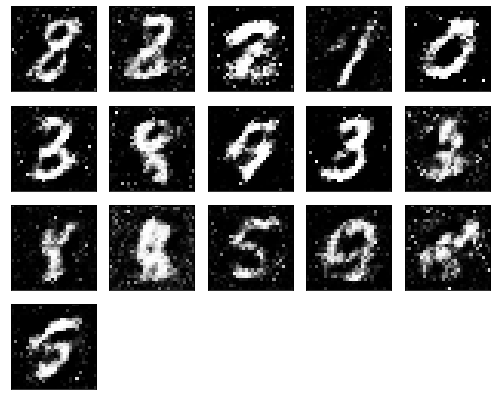

Epochs nb. 2831
discriminator loss: 0.51356041431427
generator loss : 0.9008533954620361

Epochs nb. 2832
discriminator loss: 0.5087953805923462
generator loss : 1.0035011768341064

Epochs nb. 2833
discriminator loss: 0.6836197972297668
generator loss : 0.9233697652816772

Epochs nb. 2834
discriminator loss: 0.42994529008865356
generator loss : 0.9966462254524231

Epochs nb. 2835
discriminator loss: 0.7211911678314209
generator loss : 0.8535671234130859

Epochs nb. 2836
discriminator loss: 0.5777667760848999
generator loss : 0.9779258966445923

Epochs nb. 2837
discriminator loss: 0.5630468130111694
generator loss : 1.0591647624969482

Epochs nb. 2838
discriminator loss: 0.5111169815063477
generator loss : 0.9194768071174622

Epochs nb. 2839
discriminator loss: 0.6507173776626587
generator loss : 1.0281379222869873

Epochs nb. 2840
discriminator loss: 0.5573388934135437
generator loss : 1.0348854064941406



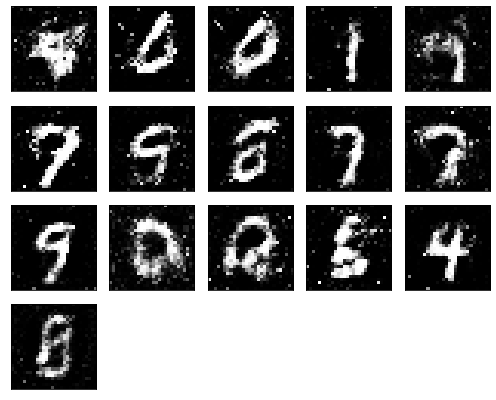

Epochs nb. 2841
discriminator loss: 0.5483801960945129
generator loss : 0.8731489181518555

Epochs nb. 2842
discriminator loss: 0.6064417362213135
generator loss : 0.922997236251831

Epochs nb. 2843
discriminator loss: 0.5349401235580444
generator loss : 0.9502806067466736

Epochs nb. 2844
discriminator loss: 0.6929471492767334
generator loss : 0.9106439352035522

Epochs nb. 2845
discriminator loss: 0.5427944660186768
generator loss : 0.9533676505088806

Epochs nb. 2846
discriminator loss: 0.6410655379295349
generator loss : 1.00887131690979

Epochs nb. 2847
discriminator loss: 0.5853110551834106
generator loss : 1.0584406852722168

Epochs nb. 2848
discriminator loss: 0.7047550678253174
generator loss : 0.9140476584434509

Epochs nb. 2849
discriminator loss: 0.581343948841095
generator loss : 0.9230008125305176

Epochs nb. 2850
discriminator loss: 0.6309131383895874
generator loss : 1.0186948776245117



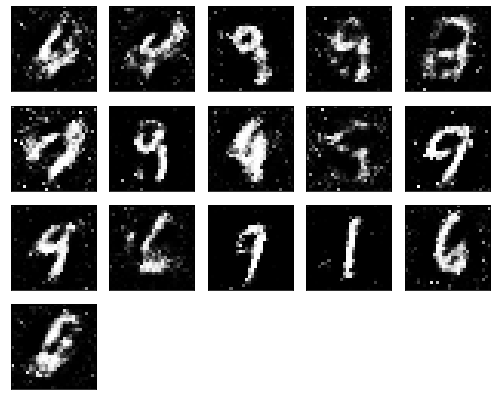

Epochs nb. 2851
discriminator loss: 0.5840498208999634
generator loss : 1.0304149389266968

Epochs nb. 2852
discriminator loss: 0.6552091836929321
generator loss : 0.9957348704338074

Epochs nb. 2853
discriminator loss: 0.584449827671051
generator loss : 0.9836758971214294

Epochs nb. 2854
discriminator loss: 0.6376913785934448
generator loss : 0.99422687292099

Epochs nb. 2855
discriminator loss: 0.604911208152771
generator loss : 0.8767482042312622

Epochs nb. 2856
discriminator loss: 0.6270748376846313
generator loss : 0.9407077431678772

Epochs nb. 2857
discriminator loss: 0.7181103229522705
generator loss : 0.9325107336044312

Epochs nb. 2858
discriminator loss: 0.6934331655502319
generator loss : 0.9587998390197754

Epochs nb. 2859
discriminator loss: 0.671849250793457
generator loss : 1.2823131084442139

Epochs nb. 2860
discriminator loss: 0.5835304260253906
generator loss : 0.9341070652008057



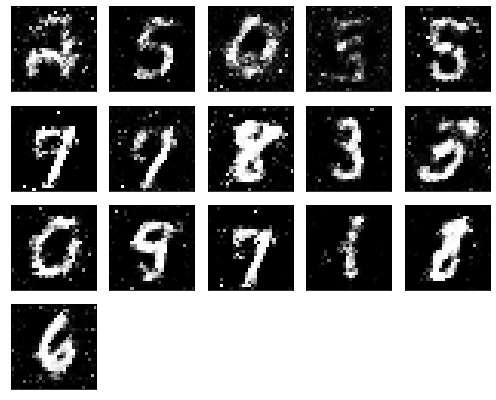

Epochs nb. 2861
discriminator loss: 0.5404561161994934
generator loss : 0.9693022966384888

Epochs nb. 2862
discriminator loss: 0.5732702016830444
generator loss : 0.9756011962890625

Epochs nb. 2863
discriminator loss: 0.7207013368606567
generator loss : 1.081525206565857

Epochs nb. 2864
discriminator loss: 0.6507658958435059
generator loss : 0.9774616360664368

Epochs nb. 2865
discriminator loss: 0.5809899568557739
generator loss : 0.8972898125648499

Epochs nb. 2866
discriminator loss: 0.5504268407821655
generator loss : 0.841102123260498

Epochs nb. 2867
discriminator loss: 0.5162631869316101
generator loss : 0.8629401922225952

Epochs nb. 2868
discriminator loss: 0.5444281101226807
generator loss : 0.9770971536636353

Epochs nb. 2869
discriminator loss: 0.5443214774131775
generator loss : 1.0628337860107422

Epochs nb. 2870
discriminator loss: 0.6876554489135742
generator loss : 0.9833906292915344



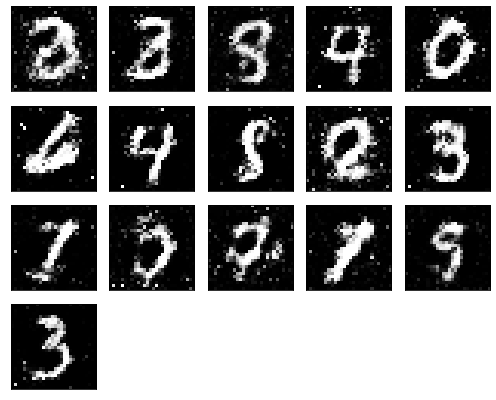

Epochs nb. 2871
discriminator loss: 0.5889646410942078
generator loss : 0.9235142469406128

Epochs nb. 2872
discriminator loss: 0.5970755815505981
generator loss : 0.9277236461639404

Epochs nb. 2873
discriminator loss: 0.7217767238616943
generator loss : 0.936511218547821

Epochs nb. 2874
discriminator loss: 0.649598240852356
generator loss : 1.1458967924118042

Epochs nb. 2875
discriminator loss: 0.5641096830368042
generator loss : 0.862675666809082

Epochs nb. 2876
discriminator loss: 0.6104429364204407
generator loss : 1.1392382383346558

Epochs nb. 2877
discriminator loss: 0.6647312045097351
generator loss : 0.9229264855384827

Epochs nb. 2878
discriminator loss: 0.6116514801979065
generator loss : 0.9246901273727417

Epochs nb. 2879
discriminator loss: 0.4472767114639282
generator loss : 0.9546301364898682

Epochs nb. 2880
discriminator loss: 0.5982495546340942
generator loss : 0.9349665641784668



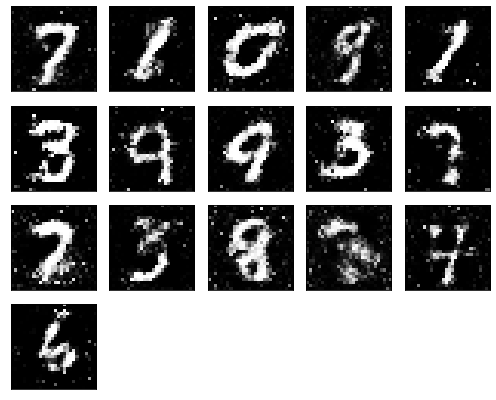

Epochs nb. 2881
discriminator loss: 0.7052325010299683
generator loss : 0.9283629059791565

Epochs nb. 2882
discriminator loss: 0.4612715244293213
generator loss : 0.9780943989753723

Epochs nb. 2883
discriminator loss: 0.7038392424583435
generator loss : 0.8234777450561523

Epochs nb. 2884
discriminator loss: 0.5946533679962158
generator loss : 0.9510354399681091

Epochs nb. 2885
discriminator loss: 0.5758614540100098
generator loss : 0.9092487096786499

Epochs nb. 2886
discriminator loss: 0.41932961344718933
generator loss : 0.872399628162384

Epochs nb. 2887
discriminator loss: 0.6244653463363647
generator loss : 0.9117147922515869

Epochs nb. 2888
discriminator loss: 0.5060878992080688
generator loss : 0.9982679486274719

Epochs nb. 2889
discriminator loss: 0.54198157787323
generator loss : 1.1798219680786133

Epochs nb. 2890
discriminator loss: 0.5229634046554565
generator loss : 1.154503345489502



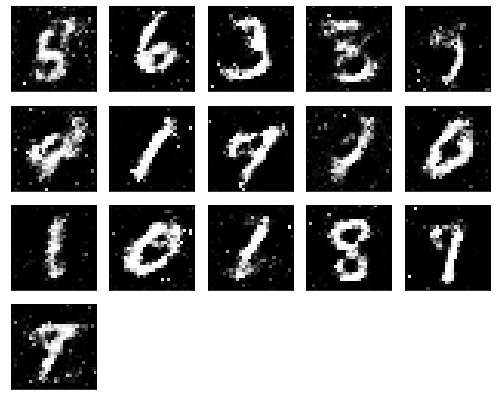

Epochs nb. 2891
discriminator loss: 0.6005111932754517
generator loss : 1.0448191165924072

Epochs nb. 2892
discriminator loss: 0.5098960995674133
generator loss : 0.9831031560897827

Epochs nb. 2893
discriminator loss: 0.587421178817749
generator loss : 0.9915353655815125

Epochs nb. 2894
discriminator loss: 0.507422685623169
generator loss : 0.9659737348556519

Epochs nb. 2895
discriminator loss: 0.6366949081420898
generator loss : 1.1917519569396973

Epochs nb. 2896
discriminator loss: 0.5730449557304382
generator loss : 1.0149617195129395

Epochs nb. 2897
discriminator loss: 0.7060557007789612
generator loss : 0.9389079213142395

Epochs nb. 2898
discriminator loss: 0.5756790041923523
generator loss : 0.8807528018951416

Epochs nb. 2899
discriminator loss: 0.530999481678009
generator loss : 0.8938318490982056

Epochs nb. 2900
discriminator loss: 0.5858862400054932
generator loss : 1.0781266689300537



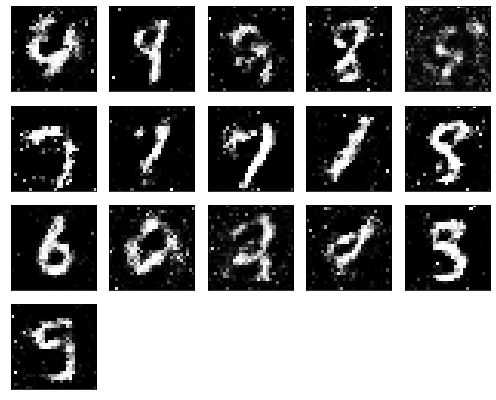

Epochs nb. 2901
discriminator loss: 0.6487897038459778
generator loss : 1.0831044912338257

Epochs nb. 2902
discriminator loss: 0.5920958518981934
generator loss : 0.9486110806465149

Epochs nb. 2903
discriminator loss: 0.7307893633842468
generator loss : 1.043947696685791

Epochs nb. 2904
discriminator loss: 0.6345285177230835
generator loss : 0.7278846502304077

Epochs nb. 2905
discriminator loss: 0.6430050134658813
generator loss : 0.8437532186508179

Epochs nb. 2906
discriminator loss: 0.6639944314956665
generator loss : 0.9902563095092773

Epochs nb. 2907
discriminator loss: 0.5882734656333923
generator loss : 0.9685265421867371

Epochs nb. 2908
discriminator loss: 0.6517177224159241
generator loss : 0.9095954298973083

Epochs nb. 2909
discriminator loss: 0.628440797328949
generator loss : 0.9808082580566406

Epochs nb. 2910
discriminator loss: 0.6141801476478577
generator loss : 1.0426816940307617



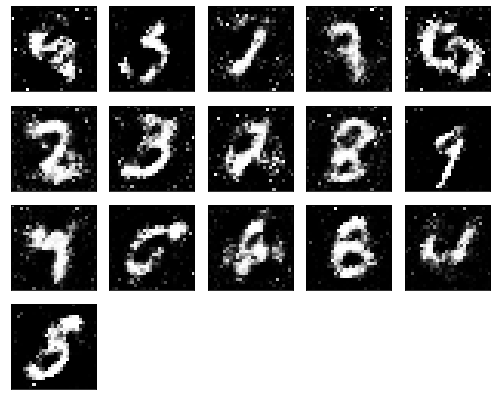

Epochs nb. 2911
discriminator loss: 0.6426117420196533
generator loss : 1.221968173980713

Epochs nb. 2912
discriminator loss: 0.6515169739723206
generator loss : 1.2502012252807617

Epochs nb. 2913
discriminator loss: 0.581329345703125
generator loss : 1.0633442401885986

Epochs nb. 2914
discriminator loss: 0.7008402943611145
generator loss : 0.9296602010726929

Epochs nb. 2915
discriminator loss: 0.5297877788543701
generator loss : 0.9508377909660339

Epochs nb. 2916
discriminator loss: 0.534492015838623
generator loss : 0.9976397752761841

Epochs nb. 2917
discriminator loss: 0.5216305255889893
generator loss : 0.9886831641197205

Epochs nb. 2918
discriminator loss: 0.6929427981376648
generator loss : 0.928431510925293

Epochs nb. 2919
discriminator loss: 0.6270279884338379
generator loss : 0.9483851194381714

Epochs nb. 2920
discriminator loss: 0.5123381018638611
generator loss : 1.033708095550537



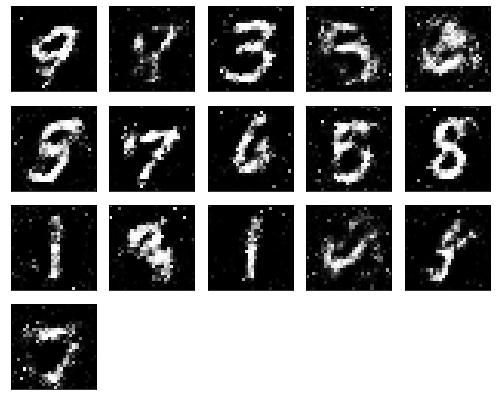

Epochs nb. 2921
discriminator loss: 0.5110484957695007
generator loss : 1.1137237548828125

Epochs nb. 2922
discriminator loss: 0.5473334789276123
generator loss : 1.1672704219818115

Epochs nb. 2923
discriminator loss: 0.6052290201187134
generator loss : 0.9470996856689453

Epochs nb. 2924
discriminator loss: 0.6014044880867004
generator loss : 0.8719616532325745

Epochs nb. 2925
discriminator loss: 0.583304762840271
generator loss : 0.8858123421669006

Epochs nb. 2926
discriminator loss: 0.7580492496490479
generator loss : 0.9396132230758667

Epochs nb. 2927
discriminator loss: 0.6158809065818787
generator loss : 0.9968329668045044

Epochs nb. 2928
discriminator loss: 0.511882483959198
generator loss : 1.0098623037338257

Epochs nb. 2929
discriminator loss: 0.48988860845565796
generator loss : 1.1184080839157104

Epochs nb. 2930
discriminator loss: 0.5129345059394836
generator loss : 1.0960886478424072



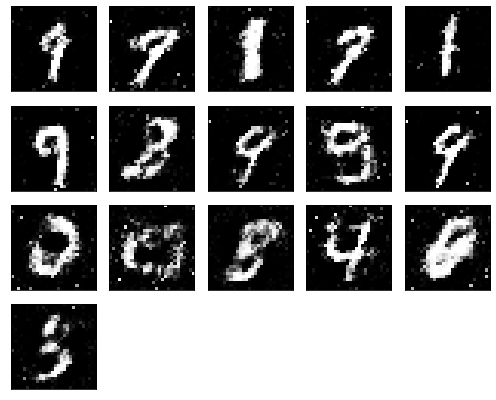

Epochs nb. 2931
discriminator loss: 0.6989205479621887
generator loss : 0.918179988861084

Epochs nb. 2932
discriminator loss: 0.49779441952705383
generator loss : 0.904873788356781

Epochs nb. 2933
discriminator loss: 0.4773910343647003
generator loss : 0.77235347032547

Epochs nb. 2934
discriminator loss: 0.6822064518928528
generator loss : 0.9471380710601807

Epochs nb. 2935
discriminator loss: 0.5301799178123474
generator loss : 0.8544043302536011

Epochs nb. 2936
discriminator loss: 0.6188907623291016
generator loss : 1.0043928623199463

Epochs nb. 2937
discriminator loss: 0.5599292516708374
generator loss : 0.8073077201843262

Epochs nb. 2938
discriminator loss: 0.5412230491638184
generator loss : 1.0040669441223145

Epochs nb. 2939
discriminator loss: 0.5371524095535278
generator loss : 0.8830357789993286

Epochs nb. 2940
discriminator loss: 0.5494434237480164
generator loss : 0.9547345638275146



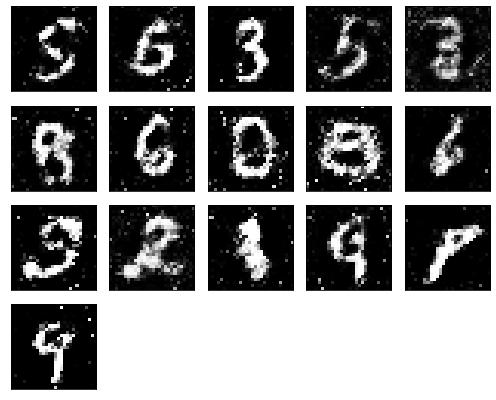

Epochs nb. 2941
discriminator loss: 0.4756295680999756
generator loss : 0.9947787523269653

Epochs nb. 2942
discriminator loss: 0.5402497053146362
generator loss : 1.0605087280273438

Epochs nb. 2943
discriminator loss: 0.6345113515853882
generator loss : 1.032431721687317

Epochs nb. 2944
discriminator loss: 0.5247820019721985
generator loss : 0.9324980974197388

Epochs nb. 2945
discriminator loss: 0.482748806476593
generator loss : 1.034334659576416

Epochs nb. 2946
discriminator loss: 0.5856552124023438
generator loss : 0.968259871006012

Epochs nb. 2947
discriminator loss: 0.5539076328277588
generator loss : 0.7840100526809692

Epochs nb. 2948
discriminator loss: 0.6414425373077393
generator loss : 1.1578751802444458

Epochs nb. 2949
discriminator loss: 0.5971264839172363
generator loss : 1.0355589389801025

Epochs nb. 2950
discriminator loss: 0.5793964266777039
generator loss : 0.9907323718070984



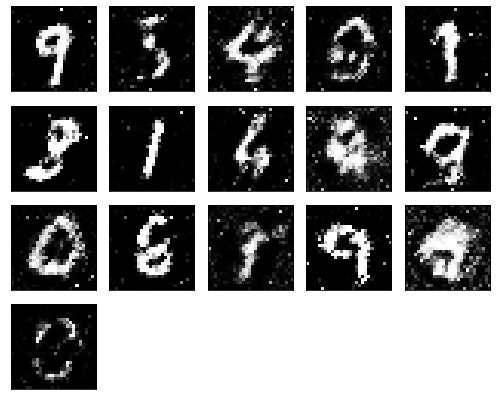

Epochs nb. 2951
discriminator loss: 0.5484732389450073
generator loss : 0.9743659496307373

Epochs nb. 2952
discriminator loss: 0.5207966566085815
generator loss : 1.0037517547607422

Epochs nb. 2953
discriminator loss: 0.6869089603424072
generator loss : 0.9772648811340332

Epochs nb. 2954
discriminator loss: 0.6715593338012695
generator loss : 0.9382001161575317

Epochs nb. 2955
discriminator loss: 0.6563916802406311
generator loss : 1.0202548503875732

Epochs nb. 2956
discriminator loss: 0.6430931687355042
generator loss : 1.0894981622695923

Epochs nb. 2957
discriminator loss: 0.5262712240219116
generator loss : 0.9638174772262573

Epochs nb. 2958
discriminator loss: 0.5144819617271423
generator loss : 1.1334842443466187

Epochs nb. 2959
discriminator loss: 0.7819548845291138
generator loss : 0.970316469669342

Epochs nb. 2960
discriminator loss: 0.6261852979660034
generator loss : 1.0256280899047852



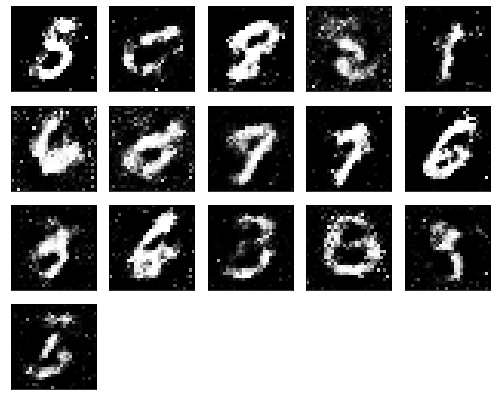

Epochs nb. 2961
discriminator loss: 0.7767876386642456
generator loss : 0.9736999273300171

Epochs nb. 2962
discriminator loss: 0.5340038537979126
generator loss : 0.7981784343719482

Epochs nb. 2963
discriminator loss: 0.5649847388267517
generator loss : 0.8886736035346985

Epochs nb. 2964
discriminator loss: 0.6889621019363403
generator loss : 0.9320329427719116

Epochs nb. 2965
discriminator loss: 0.523766279220581
generator loss : 0.8698539137840271

Epochs nb. 2966
discriminator loss: 0.6744505167007446
generator loss : 1.0911132097244263

Epochs nb. 2967
discriminator loss: 0.626517653465271
generator loss : 0.8840717077255249

Epochs nb. 2968
discriminator loss: 0.5690644979476929
generator loss : 1.2226967811584473

Epochs nb. 2969
discriminator loss: 0.6704251766204834
generator loss : 0.9251536726951599

Epochs nb. 2970
discriminator loss: 0.5971137881278992
generator loss : 0.8851399421691895



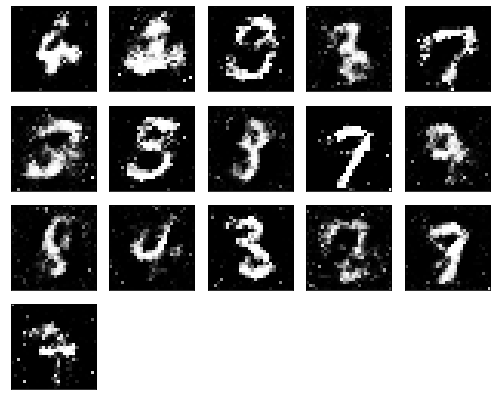

Epochs nb. 2971
discriminator loss: 0.5478207468986511
generator loss : 1.1550014019012451

Epochs nb. 2972
discriminator loss: 0.5615735054016113
generator loss : 0.9135209321975708

Epochs nb. 2973
discriminator loss: 0.5565284490585327
generator loss : 0.9419578313827515

Epochs nb. 2974
discriminator loss: 0.688525915145874
generator loss : 1.0161417722702026

Epochs nb. 2975
discriminator loss: 0.5391497015953064
generator loss : 0.968636691570282

Epochs nb. 2976
discriminator loss: 0.5800871849060059
generator loss : 0.8051326274871826

Epochs nb. 2977
discriminator loss: 0.7486599683761597
generator loss : 0.9276029467582703

Epochs nb. 2978
discriminator loss: 0.6554693579673767
generator loss : 0.9478349685668945

Epochs nb. 2979
discriminator loss: 0.5856150388717651
generator loss : 1.1230599880218506

Epochs nb. 2980
discriminator loss: 0.572619616985321
generator loss : 0.99992835521698



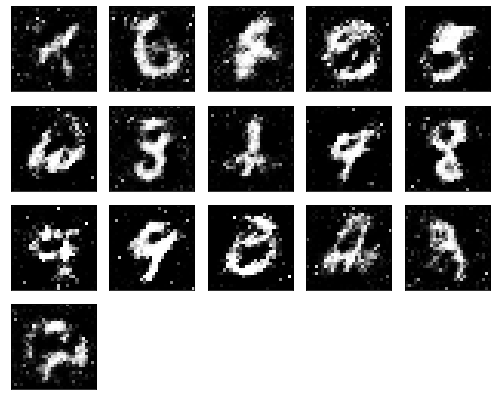

Epochs nb. 2981
discriminator loss: 0.5944305658340454
generator loss : 0.9141427278518677

Epochs nb. 2982
discriminator loss: 0.5710797309875488
generator loss : 0.8893926739692688

Epochs nb. 2983
discriminator loss: 0.556837260723114
generator loss : 1.0501620769500732

Epochs nb. 2984
discriminator loss: 0.720174252986908
generator loss : 1.0563769340515137

Epochs nb. 2985
discriminator loss: 0.5317675471305847
generator loss : 0.9763109683990479

Epochs nb. 2986
discriminator loss: 0.6072742938995361
generator loss : 0.8774096369743347

Epochs nb. 2987
discriminator loss: 0.44974666833877563
generator loss : 1.0149426460266113

Epochs nb. 2988
discriminator loss: 0.5909106135368347
generator loss : 0.894415020942688

Epochs nb. 2989
discriminator loss: 0.6703314781188965
generator loss : 0.9282994270324707

Epochs nb. 2990
discriminator loss: 0.580339789390564
generator loss : 1.0091657638549805



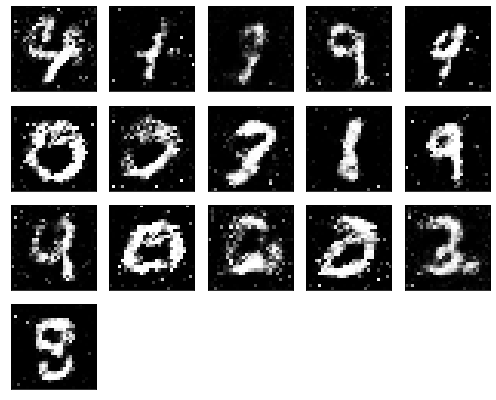

Epochs nb. 2991
discriminator loss: 0.5880213975906372
generator loss : 0.8785730600357056

Epochs nb. 2992
discriminator loss: 0.5604858994483948
generator loss : 0.7607443928718567

Epochs nb. 2993
discriminator loss: 0.5861891508102417
generator loss : 0.8140558004379272

Epochs nb. 2994
discriminator loss: 0.5022154450416565
generator loss : 1.152277946472168

Epochs nb. 2995
discriminator loss: 0.48851630091667175
generator loss : 0.9771656394004822

Epochs nb. 2996
discriminator loss: 0.5589017868041992
generator loss : 0.9811276197433472

Epochs nb. 2997
discriminator loss: 0.6338828206062317
generator loss : 0.932714581489563

Epochs nb. 2998
discriminator loss: 0.6024092435836792
generator loss : 0.8826292753219604

Epochs nb. 2999
discriminator loss: 0.5735668540000916
generator loss : 0.8889857530593872

Epochs nb. 3000
discriminator loss: 0.6721674203872681
generator loss : 1.0419443845748901



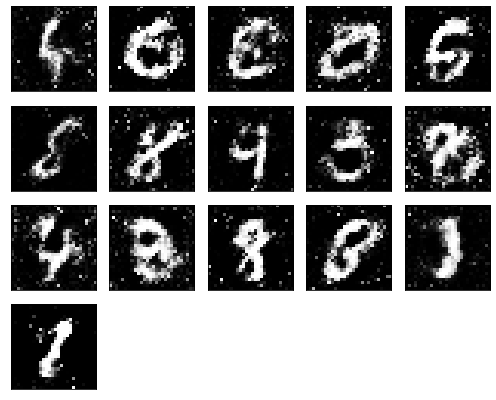

Epochs nb. 3001
discriminator loss: 0.5205057263374329
generator loss : 1.0018196105957031

Epochs nb. 3002
discriminator loss: 0.6698395609855652
generator loss : 1.1032565832138062

Epochs nb. 3003
discriminator loss: 0.6262344121932983
generator loss : 1.0890475511550903

Epochs nb. 3004
discriminator loss: 0.4445124864578247
generator loss : 1.1333513259887695

Epochs nb. 3005
discriminator loss: 0.6896731853485107
generator loss : 1.0750936269760132

Epochs nb. 3006
discriminator loss: 0.4576621353626251
generator loss : 0.9902511835098267

Epochs nb. 3007
discriminator loss: 0.6251079440116882
generator loss : 1.1060101985931396

Epochs nb. 3008
discriminator loss: 0.6780242919921875
generator loss : 0.9979291558265686

Epochs nb. 3009
discriminator loss: 0.5852084159851074
generator loss : 0.9112226366996765

Epochs nb. 3010
discriminator loss: 0.7336776852607727
generator loss : 0.8814000487327576



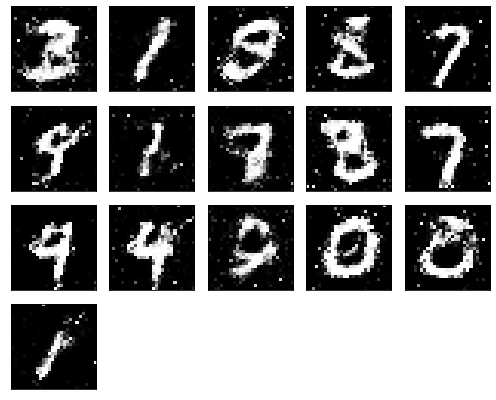

Epochs nb. 3011
discriminator loss: 0.56807541847229
generator loss : 1.0410209894180298

Epochs nb. 3012
discriminator loss: 0.6079272627830505
generator loss : 1.0286011695861816

Epochs nb. 3013
discriminator loss: 0.584120512008667
generator loss : 0.9850174188613892

Epochs nb. 3014
discriminator loss: 0.6439789533615112
generator loss : 0.8121412992477417

Epochs nb. 3015
discriminator loss: 0.5209490060806274
generator loss : 0.9627542495727539

Epochs nb. 3016
discriminator loss: 0.6481156349182129
generator loss : 0.9589499235153198

Epochs nb. 3017
discriminator loss: 0.5985143184661865
generator loss : 0.9928317666053772

Epochs nb. 3018
discriminator loss: 0.47456178069114685
generator loss : 1.0013172626495361

Epochs nb. 3019
discriminator loss: 0.6416064500808716
generator loss : 1.1141233444213867

Epochs nb. 3020
discriminator loss: 0.6617449522018433
generator loss : 1.0044288635253906



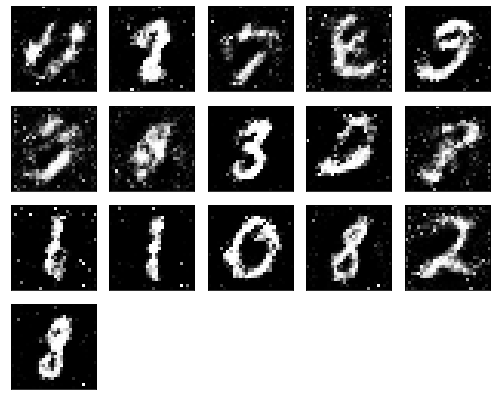

Epochs nb. 3021
discriminator loss: 0.6945992112159729
generator loss : 1.1073472499847412

Epochs nb. 3022
discriminator loss: 0.5468387603759766
generator loss : 1.0367496013641357

Epochs nb. 3023
discriminator loss: 0.4962692856788635
generator loss : 1.0849025249481201

Epochs nb. 3024
discriminator loss: 0.6098387241363525
generator loss : 0.8403432369232178

Epochs nb. 3025
discriminator loss: 0.5575662851333618
generator loss : 0.8652730584144592

Epochs nb. 3026
discriminator loss: 0.48181235790252686
generator loss : 1.1168571710586548

Epochs nb. 3027
discriminator loss: 0.576911985874176
generator loss : 0.9970138072967529

Epochs nb. 3028
discriminator loss: 0.541196346282959
generator loss : 0.934301495552063

Epochs nb. 3029
discriminator loss: 0.5408247709274292
generator loss : 0.978718638420105

Epochs nb. 3030
discriminator loss: 0.5198652744293213
generator loss : 1.0300769805908203



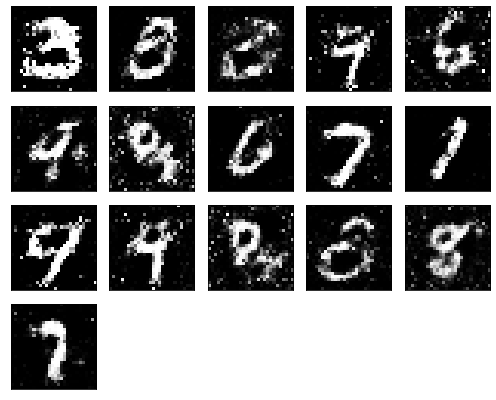

Epochs nb. 3031
discriminator loss: 0.5745752453804016
generator loss : 1.0633280277252197

Epochs nb. 3032
discriminator loss: 0.6327106952667236
generator loss : 0.9859060645103455

Epochs nb. 3033
discriminator loss: 0.5837315320968628
generator loss : 1.0452566146850586

Epochs nb. 3034
discriminator loss: 0.6674091815948486
generator loss : 0.9786765575408936

Epochs nb. 3035
discriminator loss: 0.6836938261985779
generator loss : 0.9549559354782104

Epochs nb. 3036
discriminator loss: 0.5302097797393799
generator loss : 1.0943094491958618

Epochs nb. 3037
discriminator loss: 0.544641375541687
generator loss : 0.9419968128204346

Epochs nb. 3038
discriminator loss: 0.6325196027755737
generator loss : 0.877416729927063

Epochs nb. 3039
discriminator loss: 0.5374160408973694
generator loss : 0.873501181602478

Epochs nb. 3040
discriminator loss: 0.6217701435089111
generator loss : 1.0497609376907349



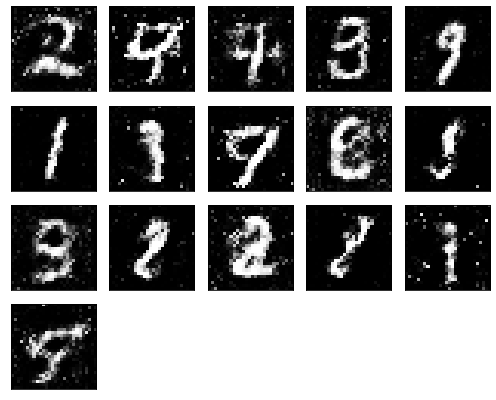

Epochs nb. 3041
discriminator loss: 0.4572860896587372
generator loss : 0.9789307117462158

Epochs nb. 3042
discriminator loss: 0.5986263155937195
generator loss : 0.8724691867828369

Epochs nb. 3043
discriminator loss: 0.6449501514434814
generator loss : 0.8351829051971436

Epochs nb. 3044
discriminator loss: 0.6629660129547119
generator loss : 0.9929236769676208

Epochs nb. 3045
discriminator loss: 0.49333086609840393
generator loss : 1.0479936599731445

Epochs nb. 3046
discriminator loss: 0.6239572763442993
generator loss : 0.9688022136688232

Epochs nb. 3047
discriminator loss: 0.5080317258834839
generator loss : 1.0422916412353516

Epochs nb. 3048
discriminator loss: 0.6486960649490356
generator loss : 0.7939907908439636

Epochs nb. 3049
discriminator loss: 0.6455461978912354
generator loss : 0.9181448221206665

Epochs nb. 3050
discriminator loss: 0.6506999731063843
generator loss : 0.8944568634033203



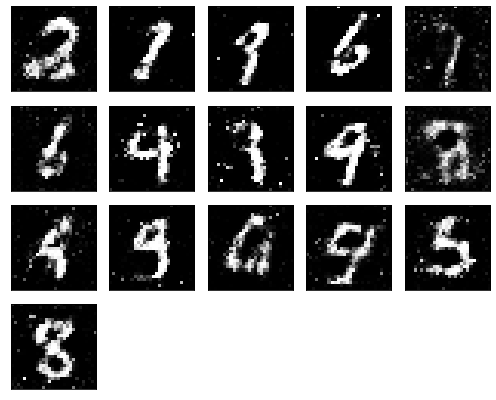

Epochs nb. 3051
discriminator loss: 0.5119968056678772
generator loss : 0.8332081437110901

Epochs nb. 3052
discriminator loss: 0.5360260605812073
generator loss : 1.0015108585357666

Epochs nb. 3053
discriminator loss: 0.5719867944717407
generator loss : 1.122106909751892

Epochs nb. 3054
discriminator loss: 0.6497689485549927
generator loss : 1.0133371353149414

Epochs nb. 3055
discriminator loss: 0.6076146364212036
generator loss : 0.942878007888794

Epochs nb. 3056
discriminator loss: 0.6186599731445312
generator loss : 0.8843592405319214

Epochs nb. 3057
discriminator loss: 0.5786753296852112
generator loss : 1.0236769914627075

Epochs nb. 3058
discriminator loss: 0.47239312529563904
generator loss : 0.8483624458312988

Epochs nb. 3059
discriminator loss: 0.48976460099220276
generator loss : 1.1591697931289673

Epochs nb. 3060
discriminator loss: 0.5717200040817261
generator loss : 1.0127521753311157



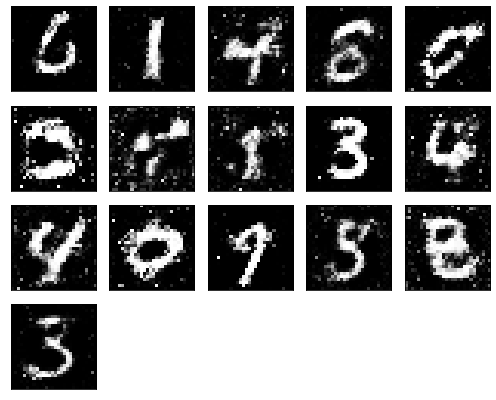

Epochs nb. 3061
discriminator loss: 0.6271607875823975
generator loss : 0.9548527598381042

Epochs nb. 3062
discriminator loss: 0.5651451349258423
generator loss : 0.9628123044967651

Epochs nb. 3063
discriminator loss: 0.9204789400100708
generator loss : 1.0103445053100586

Epochs nb. 3064
discriminator loss: 0.5867587327957153
generator loss : 0.8395769000053406

Epochs nb. 3065
discriminator loss: 0.5998390316963196
generator loss : 1.027407169342041

Epochs nb. 3066
discriminator loss: 0.7083058953285217
generator loss : 0.8725221157073975

Epochs nb. 3067
discriminator loss: 0.5543372631072998
generator loss : 1.0128623247146606

Epochs nb. 3068
discriminator loss: 0.6223386526107788
generator loss : 0.9740303754806519

Epochs nb. 3069
discriminator loss: 0.5639961361885071
generator loss : 0.8757643699645996

Epochs nb. 3070
discriminator loss: 0.6280391216278076
generator loss : 0.904697060585022



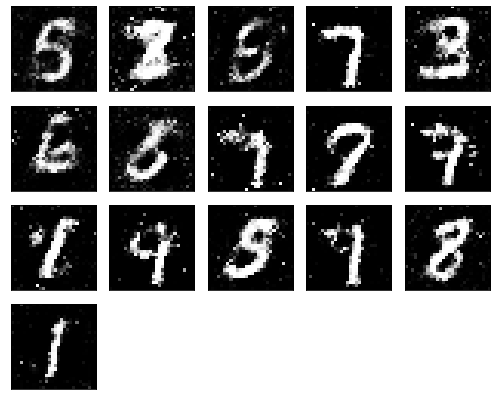

Epochs nb. 3071
discriminator loss: 0.696327805519104
generator loss : 0.9414272308349609

Epochs nb. 3072
discriminator loss: 0.5014989972114563
generator loss : 0.9039619565010071

Epochs nb. 3073
discriminator loss: 0.6604191064834595
generator loss : 0.8545035123825073

Epochs nb. 3074
discriminator loss: 0.6310647130012512
generator loss : 0.7990390658378601

Epochs nb. 3075
discriminator loss: 0.6635004878044128
generator loss : 0.9371454119682312

Epochs nb. 3076
discriminator loss: 0.575280487537384
generator loss : 0.8644911050796509

Epochs nb. 3077
discriminator loss: 0.6576595306396484
generator loss : 0.9435916543006897

Epochs nb. 3078
discriminator loss: 0.6555707454681396
generator loss : 0.9898688793182373

Epochs nb. 3079
discriminator loss: 0.6667405366897583
generator loss : 1.084210753440857

Epochs nb. 3080
discriminator loss: 0.6121314764022827
generator loss : 0.9813328981399536



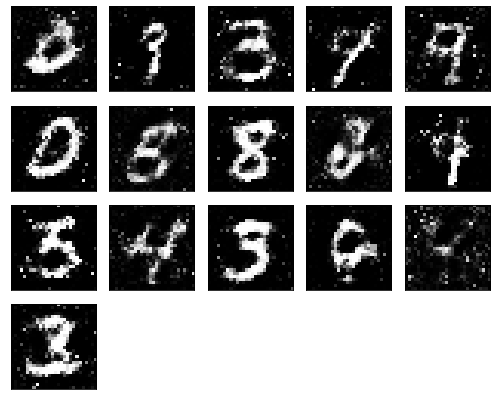

Epochs nb. 3081
discriminator loss: 0.5351507663726807
generator loss : 0.8897037506103516

Epochs nb. 3082
discriminator loss: 0.5552387237548828
generator loss : 0.8052786588668823

Epochs nb. 3083
discriminator loss: 0.5984342694282532
generator loss : 0.936070442199707

Epochs nb. 3084
discriminator loss: 0.5502893328666687
generator loss : 1.0225625038146973

Epochs nb. 3085
discriminator loss: 0.7023056745529175
generator loss : 1.079673409461975

Epochs nb. 3086
discriminator loss: 0.7451280355453491
generator loss : 0.9367523193359375

Epochs nb. 3087
discriminator loss: 0.6021032333374023
generator loss : 1.1257736682891846

Epochs nb. 3088
discriminator loss: 0.5063942670822144
generator loss : 1.0778852701187134

Epochs nb. 3089
discriminator loss: 0.5711499452590942
generator loss : 0.9550610780715942

Epochs nb. 3090
discriminator loss: 0.49310246109962463
generator loss : 1.0723519325256348



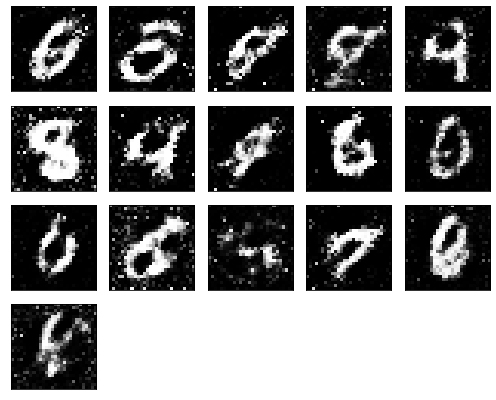

Epochs nb. 3091
discriminator loss: 0.6284774541854858
generator loss : 0.8630955219268799

Epochs nb. 3092
discriminator loss: 0.579797625541687
generator loss : 0.9342354536056519

Epochs nb. 3093
discriminator loss: 0.5451869964599609
generator loss : 0.7042564153671265

Epochs nb. 3094
discriminator loss: 0.5574122667312622
generator loss : 0.932646632194519

Epochs nb. 3095
discriminator loss: 0.5916056632995605
generator loss : 1.0476090908050537

Epochs nb. 3096
discriminator loss: 0.6428928375244141
generator loss : 0.9849839806556702

Epochs nb. 3097
discriminator loss: 0.5400062799453735
generator loss : 1.2188384532928467

Epochs nb. 3098
discriminator loss: 0.6888179779052734
generator loss : 1.0164127349853516

Epochs nb. 3099
discriminator loss: 0.5089533925056458
generator loss : 0.915916383266449

Epochs nb. 3100
discriminator loss: 0.4972676634788513
generator loss : 0.8164196610450745



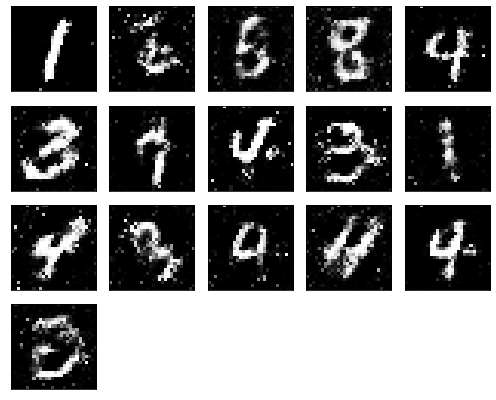

Epochs nb. 3101
discriminator loss: 0.7476706504821777
generator loss : 0.8951175808906555

Epochs nb. 3102
discriminator loss: 0.592534065246582
generator loss : 1.1544616222381592

Epochs nb. 3103
discriminator loss: 0.6313778162002563
generator loss : 0.9359062910079956

Epochs nb. 3104
discriminator loss: 0.6035074591636658
generator loss : 0.8315067887306213

Epochs nb. 3105
discriminator loss: 0.5502162575721741
generator loss : 0.8700662851333618

Epochs nb. 3106
discriminator loss: 0.8192194104194641
generator loss : 1.011669397354126

Epochs nb. 3107
discriminator loss: 0.6172803640365601
generator loss : 0.9033300876617432

Epochs nb. 3108
discriminator loss: 0.6235376596450806
generator loss : 1.051040530204773

Epochs nb. 3109
discriminator loss: 0.587711751461029
generator loss : 0.9502695798873901

Epochs nb. 3110
discriminator loss: 0.6129094958305359
generator loss : 0.9990594387054443



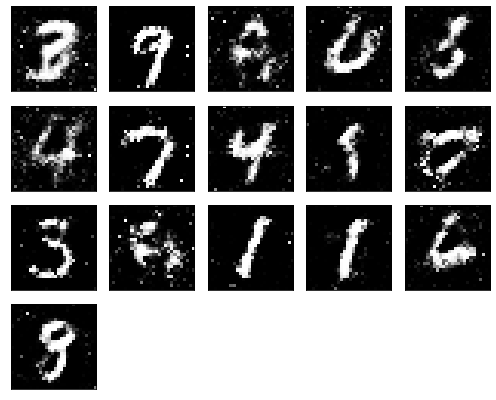

Epochs nb. 3111
discriminator loss: 0.6314752697944641
generator loss : 1.0081582069396973

Epochs nb. 3112
discriminator loss: 0.6462565660476685
generator loss : 1.0081937313079834

Epochs nb. 3113
discriminator loss: 0.6011732816696167
generator loss : 1.00771963596344

Epochs nb. 3114
discriminator loss: 0.49550628662109375
generator loss : 0.9148209095001221

Epochs nb. 3115
discriminator loss: 0.6524518132209778
generator loss : 1.0745729207992554

Epochs nb. 3116
discriminator loss: 0.5803672075271606
generator loss : 0.7882758975028992

Epochs nb. 3117
discriminator loss: 0.5762821435928345
generator loss : 0.9210836291313171

Epochs nb. 3118
discriminator loss: 0.5977202653884888
generator loss : 0.9479608535766602

Epochs nb. 3119
discriminator loss: 0.6549155712127686
generator loss : 0.9012706875801086

Epochs nb. 3120
discriminator loss: 0.6493900418281555
generator loss : 0.8834530711174011



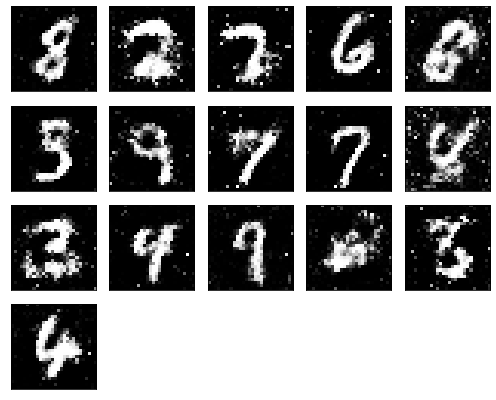

Epochs nb. 3121
discriminator loss: 0.6558181643486023
generator loss : 0.8492040038108826

Epochs nb. 3122
discriminator loss: 0.6037044525146484
generator loss : 0.935199499130249

Epochs nb. 3123
discriminator loss: 0.6797877550125122
generator loss : 1.0267361402511597

Epochs nb. 3124
discriminator loss: 0.5970627665519714
generator loss : 1.068495273590088

Epochs nb. 3125
discriminator loss: 0.5447970628738403
generator loss : 1.0116429328918457

Epochs nb. 3126
discriminator loss: 0.610112190246582
generator loss : 0.92769455909729

Epochs nb. 3127
discriminator loss: 0.7204421758651733
generator loss : 1.001311182975769

Epochs nb. 3128
discriminator loss: 0.4683886468410492
generator loss : 1.0309232473373413

Epochs nb. 3129
discriminator loss: 0.5338888764381409
generator loss : 0.9986828565597534

Epochs nb. 3130
discriminator loss: 0.5944764614105225
generator loss : 1.0524873733520508



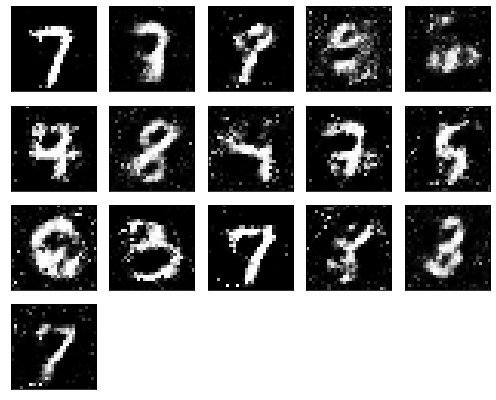

Epochs nb. 3131
discriminator loss: 0.5863369703292847
generator loss : 0.8642605543136597

Epochs nb. 3132
discriminator loss: 0.470710426568985
generator loss : 0.8668051958084106

Epochs nb. 3133
discriminator loss: 0.6904979944229126
generator loss : 0.9950628280639648

Epochs nb. 3134
discriminator loss: 0.6572206020355225
generator loss : 0.94461989402771

Epochs nb. 3135
discriminator loss: 0.615450918674469
generator loss : 0.8431048393249512

Epochs nb. 3136
discriminator loss: 0.6122627854347229
generator loss : 0.8719688653945923

Epochs nb. 3137
discriminator loss: 0.6962668299674988
generator loss : 0.9402263164520264

Epochs nb. 3138
discriminator loss: 0.6922153830528259
generator loss : 0.9243262410163879

Epochs nb. 3139
discriminator loss: 0.5315253734588623
generator loss : 0.9691801071166992

Epochs nb. 3140
discriminator loss: 0.6272290349006653
generator loss : 0.9277523159980774



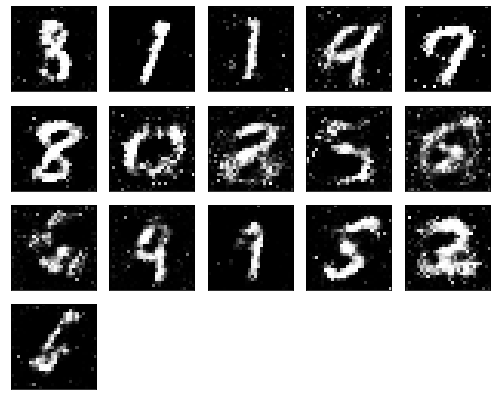

Epochs nb. 3141
discriminator loss: 0.6076553463935852
generator loss : 0.9631272554397583

Epochs nb. 3142
discriminator loss: 0.6088513135910034
generator loss : 0.9410156011581421

Epochs nb. 3143
discriminator loss: 0.6221504211425781
generator loss : 0.9848684072494507

Epochs nb. 3144
discriminator loss: 0.6523576974868774
generator loss : 1.0816459655761719

Epochs nb. 3145
discriminator loss: 0.5052850842475891
generator loss : 0.9488595724105835

Epochs nb. 3146
discriminator loss: 0.5756056904792786
generator loss : 0.7763965725898743

Epochs nb. 3147
discriminator loss: 0.5652083158493042
generator loss : 0.8721729516983032

Epochs nb. 3148
discriminator loss: 0.6081436276435852
generator loss : 1.0071678161621094

Epochs nb. 3149
discriminator loss: 0.6419566869735718
generator loss : 0.8197978734970093

Epochs nb. 3150
discriminator loss: 0.6122915744781494
generator loss : 1.0404131412506104



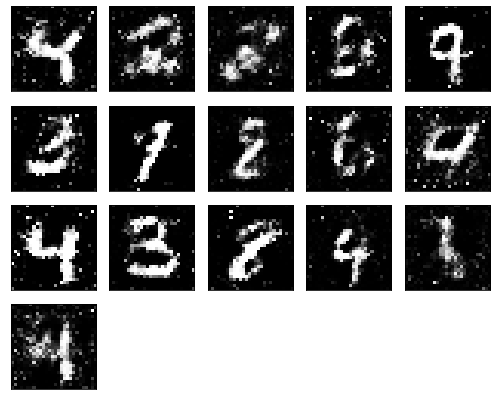

Epochs nb. 3151
discriminator loss: 0.642265260219574
generator loss : 0.9857122898101807

Epochs nb. 3152
discriminator loss: 0.607010006904602
generator loss : 0.9514189958572388

Epochs nb. 3153
discriminator loss: 0.6380232572555542
generator loss : 1.0137319564819336

Epochs nb. 3154
discriminator loss: 0.5285483598709106
generator loss : 0.7829247713088989

Epochs nb. 3155
discriminator loss: 0.6954776048660278
generator loss : 1.0139679908752441

Epochs nb. 3156
discriminator loss: 0.6713181734085083
generator loss : 0.9266965389251709

Epochs nb. 3157
discriminator loss: 0.518572211265564
generator loss : 1.037583589553833

Epochs nb. 3158
discriminator loss: 0.6531725525856018
generator loss : 1.1043938398361206

Epochs nb. 3159
discriminator loss: 0.6364678740501404
generator loss : 0.9266321063041687

Epochs nb. 3160
discriminator loss: 0.5064435005187988
generator loss : 0.9447370171546936



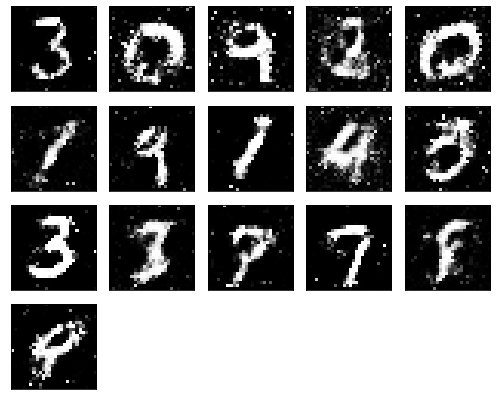

Epochs nb. 3161
discriminator loss: 0.5418089628219604
generator loss : 1.042127251625061

Epochs nb. 3162
discriminator loss: 0.5904005169868469
generator loss : 0.8292626142501831

Epochs nb. 3163
discriminator loss: 0.6211064457893372
generator loss : 0.9080038070678711

Epochs nb. 3164
discriminator loss: 0.4698861539363861
generator loss : 0.9758617877960205

Epochs nb. 3165
discriminator loss: 0.4866146743297577
generator loss : 0.9588315486907959

Epochs nb. 3166
discriminator loss: 0.6112649440765381
generator loss : 0.9543033242225647

Epochs nb. 3167
discriminator loss: 0.6578794121742249
generator loss : 0.9032463431358337

Epochs nb. 3168
discriminator loss: 0.6031808257102966
generator loss : 0.8584300875663757

Epochs nb. 3169
discriminator loss: 0.6208855509757996
generator loss : 0.9928950667381287

Epochs nb. 3170
discriminator loss: 0.5408983826637268
generator loss : 0.853976309299469



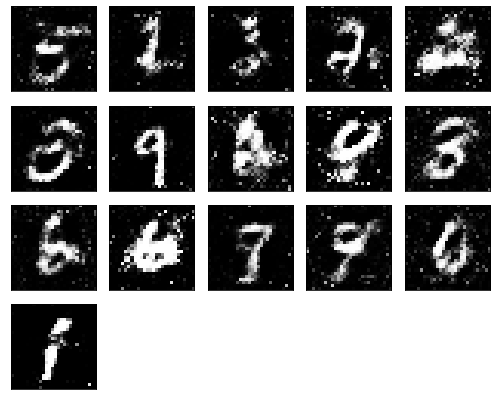

Epochs nb. 3171
discriminator loss: 0.7348581552505493
generator loss : 0.7859760522842407

Epochs nb. 3172
discriminator loss: 0.6671543717384338
generator loss : 0.9706544876098633

Epochs nb. 3173
discriminator loss: 0.5726736783981323
generator loss : 0.9387985467910767

Epochs nb. 3174
discriminator loss: 0.6447649002075195
generator loss : 1.0379704236984253

Epochs nb. 3175
discriminator loss: 0.6094800233840942
generator loss : 1.0429637432098389

Epochs nb. 3176
discriminator loss: 0.5059560537338257
generator loss : 1.152048110961914

Epochs nb. 3177
discriminator loss: 0.6011922955513
generator loss : 0.8750466108322144

Epochs nb. 3178
discriminator loss: 0.5560139417648315
generator loss : 1.0387241840362549

Epochs nb. 3179
discriminator loss: 0.6211606860160828
generator loss : 0.8936599493026733

Epochs nb. 3180
discriminator loss: 0.5571954846382141
generator loss : 1.004995346069336



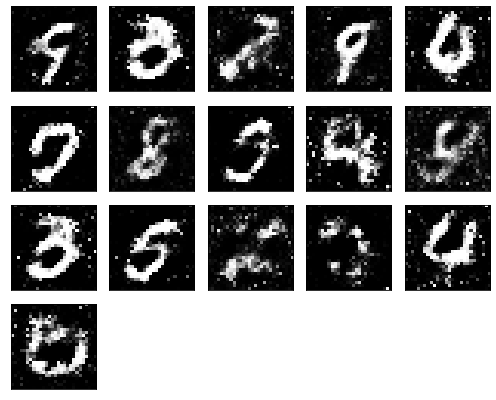

Epochs nb. 3181
discriminator loss: 0.6776099801063538
generator loss : 0.8858841061592102

Epochs nb. 3182
discriminator loss: 0.4777010679244995
generator loss : 0.9161146879196167

Epochs nb. 3183
discriminator loss: 0.5991764068603516
generator loss : 0.9310890436172485

Epochs nb. 3184
discriminator loss: 0.6524454355239868
generator loss : 1.0368032455444336

Epochs nb. 3185
discriminator loss: 0.5291123390197754
generator loss : 0.9889870882034302

Epochs nb. 3186
discriminator loss: 0.5714422464370728
generator loss : 1.168832540512085

Epochs nb. 3187
discriminator loss: 0.634351372718811
generator loss : 1.0100680589675903

Epochs nb. 3188
discriminator loss: 0.6143438816070557
generator loss : 1.0563485622406006

Epochs nb. 3189
discriminator loss: 0.576461136341095
generator loss : 1.0921080112457275

Epochs nb. 3190
discriminator loss: 0.6032590866088867
generator loss : 1.0737736225128174



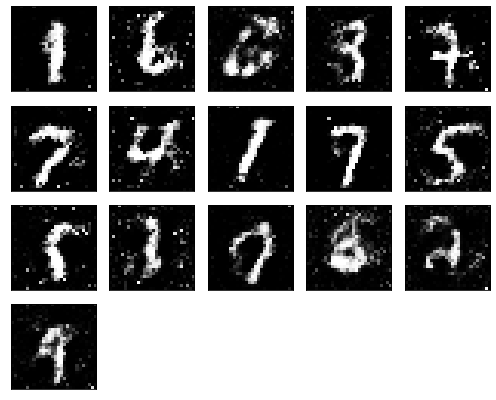

Epochs nb. 3191
discriminator loss: 0.6266114115715027
generator loss : 1.0378777980804443

Epochs nb. 3192
discriminator loss: 0.49419039487838745
generator loss : 0.9379305839538574

Epochs nb. 3193
discriminator loss: 0.5566211938858032
generator loss : 0.8699654936790466

Epochs nb. 3194
discriminator loss: 0.5073729753494263
generator loss : 0.8553563952445984

Epochs nb. 3195
discriminator loss: 0.6694214344024658
generator loss : 1.098252534866333

Epochs nb. 3196
discriminator loss: 0.5874391794204712
generator loss : 0.8589485883712769

Epochs nb. 3197
discriminator loss: 0.6105332970619202
generator loss : 1.0452556610107422

Epochs nb. 3198
discriminator loss: 0.5943068265914917
generator loss : 0.8464646339416504

Epochs nb. 3199
discriminator loss: 0.5640263557434082
generator loss : 0.848910391330719

Epochs nb. 3200
discriminator loss: 0.6964707970619202
generator loss : 0.8668217658996582



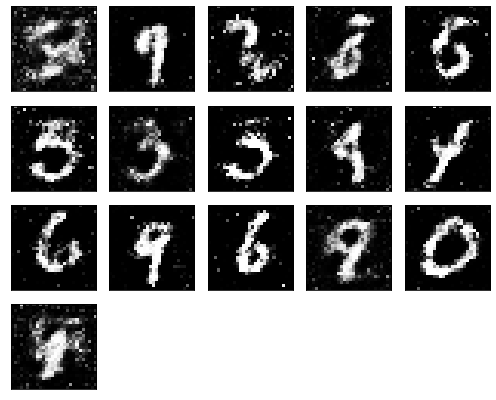

Epochs nb. 3201
discriminator loss: 0.6162456274032593
generator loss : 0.9657350778579712

Epochs nb. 3202
discriminator loss: 0.612552285194397
generator loss : 0.9622440338134766

Epochs nb. 3203
discriminator loss: 0.7446135878562927
generator loss : 1.0963155031204224

Epochs nb. 3204
discriminator loss: 0.6496442556381226
generator loss : 0.9496551752090454

Epochs nb. 3205
discriminator loss: 0.5823652744293213
generator loss : 1.0412839651107788

Epochs nb. 3206
discriminator loss: 0.6109765768051147
generator loss : 0.9165019989013672

Epochs nb. 3207
discriminator loss: 0.5837920308113098
generator loss : 1.0456774234771729

Epochs nb. 3208
discriminator loss: 0.5263558030128479
generator loss : 1.0525665283203125

Epochs nb. 3209
discriminator loss: 0.5642199516296387
generator loss : 1.0335627794265747

Epochs nb. 3210
discriminator loss: 0.7934987545013428
generator loss : 1.0451433658599854



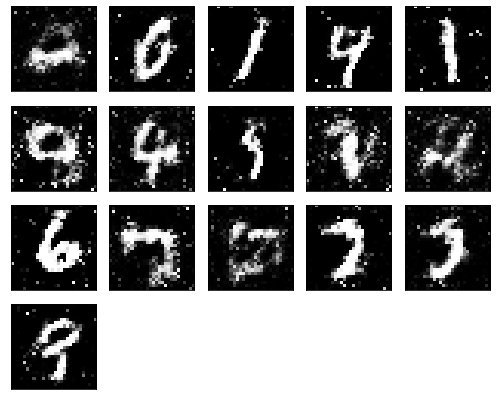

Epochs nb. 3211
discriminator loss: 0.6132431030273438
generator loss : 1.0020824670791626

Epochs nb. 3212
discriminator loss: 0.6112992167472839
generator loss : 1.1306626796722412

Epochs nb. 3213
discriminator loss: 0.5393435955047607
generator loss : 1.1213431358337402

Epochs nb. 3214
discriminator loss: 0.5136163830757141
generator loss : 0.8454160690307617

Epochs nb. 3215
discriminator loss: 0.5877488851547241
generator loss : 0.9199697375297546

Epochs nb. 3216
discriminator loss: 0.6091988682746887
generator loss : 0.9115594625473022

Epochs nb. 3217
discriminator loss: 0.43944063782691956
generator loss : 1.0034329891204834

Epochs nb. 3218
discriminator loss: 0.5323804616928101
generator loss : 0.9218745827674866

Epochs nb. 3219
discriminator loss: 0.722144603729248
generator loss : 0.9452133178710938

Epochs nb. 3220
discriminator loss: 0.5749871730804443
generator loss : 0.8320707082748413



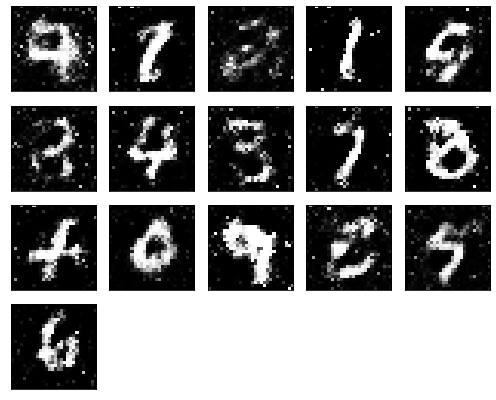

Epochs nb. 3221
discriminator loss: 0.5763851404190063
generator loss : 0.7966407537460327

Epochs nb. 3222
discriminator loss: 0.6983797550201416
generator loss : 0.7849716544151306

Epochs nb. 3223
discriminator loss: 0.640901505947113
generator loss : 0.8968034982681274

Epochs nb. 3224
discriminator loss: 0.6092373728752136
generator loss : 0.9098823070526123

Epochs nb. 3225
discriminator loss: 0.49793320894241333
generator loss : 0.979039192199707

Epochs nb. 3226
discriminator loss: 0.5323070287704468
generator loss : 1.1593960523605347

Epochs nb. 3227
discriminator loss: 0.5629650354385376
generator loss : 0.9571633338928223

Epochs nb. 3228
discriminator loss: 0.5798498392105103
generator loss : 1.021796464920044

Epochs nb. 3229
discriminator loss: 0.565890908241272
generator loss : 1.0301766395568848

Epochs nb. 3230
discriminator loss: 0.7017690539360046
generator loss : 0.882326602935791



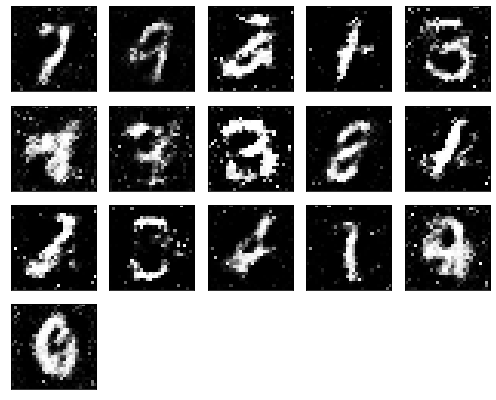

Epochs nb. 3231
discriminator loss: 0.5433592796325684
generator loss : 0.8912765979766846

Epochs nb. 3232
discriminator loss: 0.5498816967010498
generator loss : 0.87785404920578

Epochs nb. 3233
discriminator loss: 0.643871545791626
generator loss : 0.9631750583648682

Epochs nb. 3234
discriminator loss: 0.6611072421073914
generator loss : 1.1407216787338257

Epochs nb. 3235
discriminator loss: 0.5201470851898193
generator loss : 1.0305826663970947

Epochs nb. 3236
discriminator loss: 0.5763913989067078
generator loss : 0.8310692310333252

Epochs nb. 3237
discriminator loss: 0.5965638160705566
generator loss : 0.9271126985549927

Epochs nb. 3238
discriminator loss: 0.6045202016830444
generator loss : 1.0015251636505127

Epochs nb. 3239
discriminator loss: 0.5938825011253357
generator loss : 1.053550124168396

Epochs nb. 3240
discriminator loss: 0.7021594047546387
generator loss : 0.9218831062316895



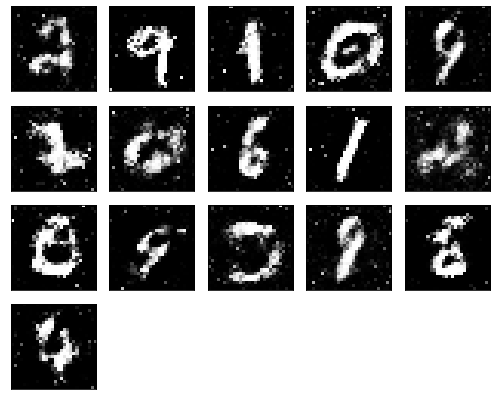

Epochs nb. 3241
discriminator loss: 0.6179285049438477
generator loss : 0.876480221748352

Epochs nb. 3242
discriminator loss: 0.5932944416999817
generator loss : 0.722679853439331

Epochs nb. 3243
discriminator loss: 0.5729362964630127
generator loss : 1.0119225978851318

Epochs nb. 3244
discriminator loss: 0.6638695001602173
generator loss : 0.861986517906189

Epochs nb. 3245
discriminator loss: 0.6105894446372986
generator loss : 1.2055912017822266

Epochs nb. 3246
discriminator loss: 0.5468564033508301
generator loss : 1.0343010425567627

Epochs nb. 3247
discriminator loss: 0.5629488825798035
generator loss : 1.2160545587539673

Epochs nb. 3248
discriminator loss: 0.6548826098442078
generator loss : 0.9268703460693359

Epochs nb. 3249
discriminator loss: 0.5309033989906311
generator loss : 0.9475656747817993

Epochs nb. 3250
discriminator loss: 0.5103788375854492
generator loss : 0.825564444065094



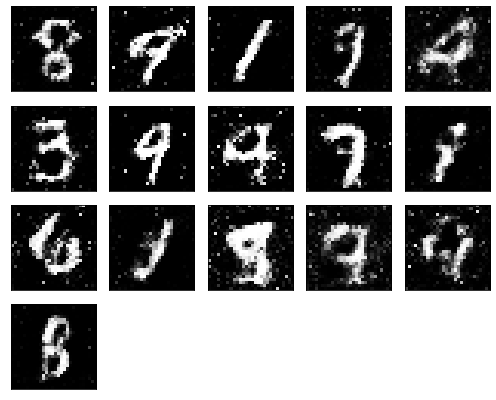

Epochs nb. 3251
discriminator loss: 0.7005903720855713
generator loss : 1.0109589099884033

Epochs nb. 3252
discriminator loss: 0.5809360146522522
generator loss : 0.963911771774292

Epochs nb. 3253
discriminator loss: 0.4940888285636902
generator loss : 1.0747641324996948

Epochs nb. 3254
discriminator loss: 0.5353375673294067
generator loss : 1.000396728515625

Epochs nb. 3255
discriminator loss: 0.599834144115448
generator loss : 0.9179949760437012

Epochs nb. 3256
discriminator loss: 0.6254292726516724
generator loss : 0.9279557466506958

Epochs nb. 3257
discriminator loss: 0.5205482244491577
generator loss : 1.0003166198730469

Epochs nb. 3258
discriminator loss: 0.7040776014328003
generator loss : 0.8944674730300903

Epochs nb. 3259
discriminator loss: 0.7840192317962646
generator loss : 1.0050714015960693

Epochs nb. 3260
discriminator loss: 0.5069233179092407
generator loss : 0.8399511575698853



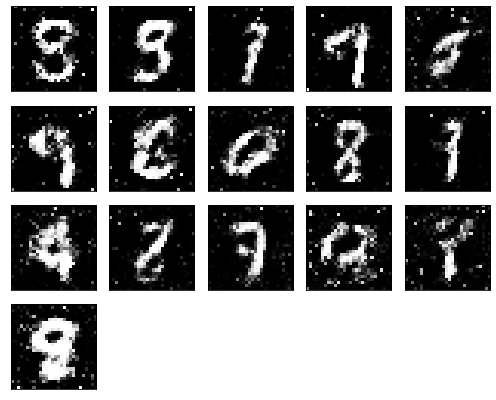

Epochs nb. 3261
discriminator loss: 0.7022420167922974
generator loss : 0.9195501804351807

Epochs nb. 3262
discriminator loss: 0.56792151927948
generator loss : 1.037333369255066

Epochs nb. 3263
discriminator loss: 0.5766878128051758
generator loss : 0.8820487260818481

Epochs nb. 3264
discriminator loss: 0.5153681039810181
generator loss : 0.9860624074935913

Epochs nb. 3265
discriminator loss: 0.5900388956069946
generator loss : 0.8673558831214905

Epochs nb. 3266
discriminator loss: 0.47751325368881226
generator loss : 1.0106074810028076

Epochs nb. 3267
discriminator loss: 0.5547140836715698
generator loss : 0.9568221569061279

Epochs nb. 3268
discriminator loss: 0.486168771982193
generator loss : 0.9725823998451233

Epochs nb. 3269
discriminator loss: 0.6159788966178894
generator loss : 1.0276482105255127

Epochs nb. 3270
discriminator loss: 0.5650205612182617
generator loss : 0.9796539545059204



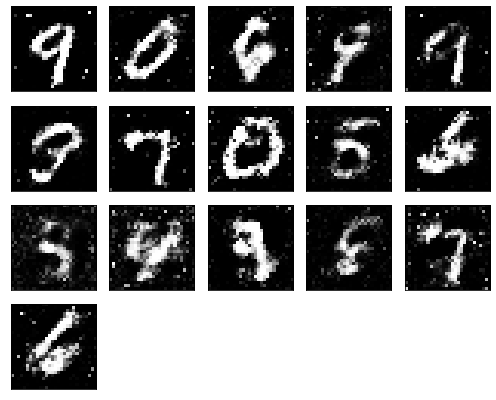

Epochs nb. 3271
discriminator loss: 0.5234503746032715
generator loss : 0.9101318717002869

Epochs nb. 3272
discriminator loss: 0.5271701216697693
generator loss : 0.8066886067390442

Epochs nb. 3273
discriminator loss: 0.5091763734817505
generator loss : 1.0101828575134277

Epochs nb. 3274
discriminator loss: 0.7912641167640686
generator loss : 1.0503243207931519

Epochs nb. 3275
discriminator loss: 0.6834148168563843
generator loss : 1.0626286268234253

Epochs nb. 3276
discriminator loss: 0.718155562877655
generator loss : 0.893396258354187

Epochs nb. 3277
discriminator loss: 0.7311625480651855
generator loss : 0.8345133066177368

Epochs nb. 3278
discriminator loss: 0.5488772392272949
generator loss : 1.0049198865890503

Epochs nb. 3279
discriminator loss: 0.5439078211784363
generator loss : 1.054231882095337

Epochs nb. 3280
discriminator loss: 0.5896943807601929
generator loss : 0.8546074628829956



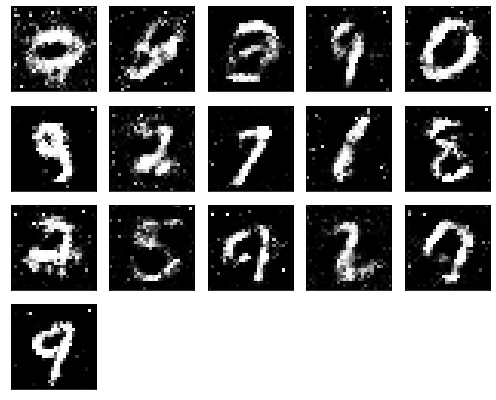

Epochs nb. 3281
discriminator loss: 0.5346447825431824
generator loss : 0.8545718193054199

Epochs nb. 3282
discriminator loss: 0.5725504159927368
generator loss : 0.9094130992889404

Epochs nb. 3283
discriminator loss: 0.6341070532798767
generator loss : 0.8124871850013733

Epochs nb. 3284
discriminator loss: 0.49588263034820557
generator loss : 0.8073515892028809

Epochs nb. 3285
discriminator loss: 0.4689350128173828
generator loss : 0.849708080291748

Epochs nb. 3286
discriminator loss: 0.717113733291626
generator loss : 1.105268955230713

Epochs nb. 3287
discriminator loss: 0.7452328205108643
generator loss : 0.9469393491744995

Epochs nb. 3288
discriminator loss: 0.4674021601676941
generator loss : 0.9607542753219604

Epochs nb. 3289
discriminator loss: 0.6470500230789185
generator loss : 0.7624424695968628

Epochs nb. 3290
discriminator loss: 0.6642243266105652
generator loss : 0.8481767177581787



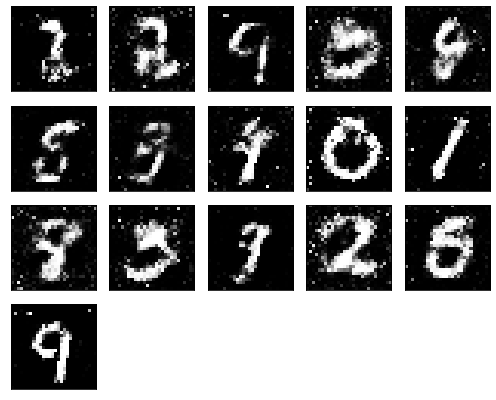

Epochs nb. 3291
discriminator loss: 0.7289527654647827
generator loss : 0.8847581148147583

Epochs nb. 3292
discriminator loss: 0.6638739109039307
generator loss : 0.8755669593811035

Epochs nb. 3293
discriminator loss: 0.6776064038276672
generator loss : 1.0857632160186768

Epochs nb. 3294
discriminator loss: 0.5385178327560425
generator loss : 0.9173395037651062

Epochs nb. 3295
discriminator loss: 0.6279459595680237
generator loss : 0.8135164976119995

Epochs nb. 3296
discriminator loss: 0.6535842418670654
generator loss : 1.0616517066955566

Epochs nb. 3297
discriminator loss: 0.5050082206726074
generator loss : 0.957612156867981

Epochs nb. 3298
discriminator loss: 0.6805531978607178
generator loss : 0.930915117263794

Epochs nb. 3299
discriminator loss: 0.4483497142791748
generator loss : 1.0435080528259277

Epochs nb. 3300
discriminator loss: 0.5784320831298828
generator loss : 1.0487159490585327



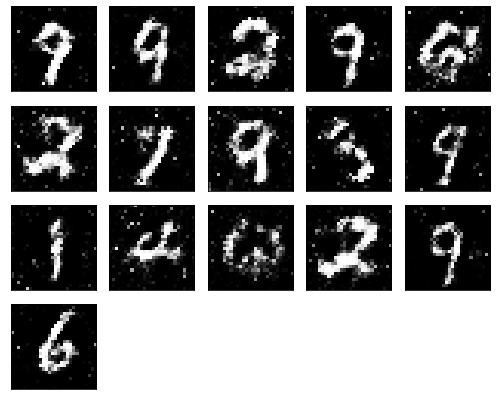

Epochs nb. 3301
discriminator loss: 0.6138176918029785
generator loss : 0.9230849742889404

Epochs nb. 3302
discriminator loss: 0.5602495670318604
generator loss : 1.0990591049194336

Epochs nb. 3303
discriminator loss: 0.4836848974227905
generator loss : 1.0171722173690796

Epochs nb. 3304
discriminator loss: 0.6735304594039917
generator loss : 0.9512125253677368

Epochs nb. 3305
discriminator loss: 0.6851546764373779
generator loss : 0.9957668781280518

Epochs nb. 3306
discriminator loss: 0.7750819325447083
generator loss : 0.8971080183982849

Epochs nb. 3307
discriminator loss: 0.5074055194854736
generator loss : 0.9425589442253113

Epochs nb. 3308
discriminator loss: 0.5455144047737122
generator loss : 0.9561057686805725

Epochs nb. 3309
discriminator loss: 0.6514279842376709
generator loss : 0.8719863295555115

Epochs nb. 3310
discriminator loss: 0.5754967927932739
generator loss : 1.0710382461547852



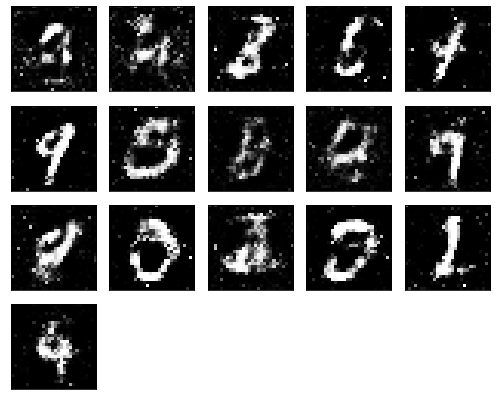

Epochs nb. 3311
discriminator loss: 0.5816901922225952
generator loss : 0.8338295817375183

Epochs nb. 3312
discriminator loss: 0.6470216512680054
generator loss : 0.9179308414459229

Epochs nb. 3313
discriminator loss: 0.5642109513282776
generator loss : 0.8899168372154236

Epochs nb. 3314
discriminator loss: 0.5929163694381714
generator loss : 1.0071467161178589

Epochs nb. 3315
discriminator loss: 0.6191586256027222
generator loss : 1.0938217639923096

Epochs nb. 3316
discriminator loss: 0.732742428779602
generator loss : 0.9793564677238464

Epochs nb. 3317
discriminator loss: 0.6716293096542358
generator loss : 1.044147253036499

Epochs nb. 3318
discriminator loss: 0.5089393258094788
generator loss : 0.8017208576202393

Epochs nb. 3319
discriminator loss: 0.567672073841095
generator loss : 0.994645893573761

Epochs nb. 3320
discriminator loss: 0.5539544224739075
generator loss : 0.8823789954185486



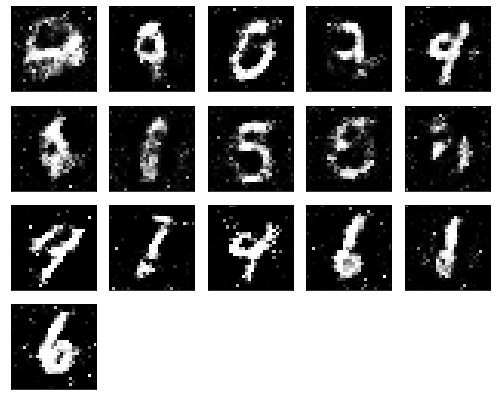

Epochs nb. 3321
discriminator loss: 0.6455953121185303
generator loss : 0.9783955216407776

Epochs nb. 3322
discriminator loss: 0.5922969579696655
generator loss : 0.9184816479682922

Epochs nb. 3323
discriminator loss: 0.5968906283378601
generator loss : 0.9870704412460327

Epochs nb. 3324
discriminator loss: 0.52813321352005
generator loss : 0.9452958106994629

Epochs nb. 3325
discriminator loss: 0.5037049055099487
generator loss : 0.8292955160140991

Epochs nb. 3326
discriminator loss: 0.644477128982544
generator loss : 0.9056713581085205

Epochs nb. 3327
discriminator loss: 0.5369718074798584
generator loss : 0.9731298685073853

Epochs nb. 3328
discriminator loss: 0.5640149116516113
generator loss : 0.8565659523010254

Epochs nb. 3329
discriminator loss: 0.6173012256622314
generator loss : 1.0531145334243774

Epochs nb. 3330
discriminator loss: 0.62605881690979
generator loss : 0.876028835773468



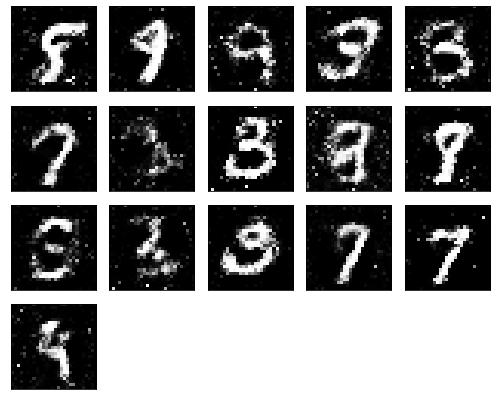

Epochs nb. 3331
discriminator loss: 0.6843224763870239
generator loss : 0.894894003868103

Epochs nb. 3332
discriminator loss: 0.7014992237091064
generator loss : 1.1639724969863892

Epochs nb. 3333
discriminator loss: 0.653650164604187
generator loss : 0.9195833206176758

Epochs nb. 3334
discriminator loss: 0.6263735890388489
generator loss : 0.9416168928146362

Epochs nb. 3335
discriminator loss: 0.49532538652420044
generator loss : 1.0571354627609253

Epochs nb. 3336
discriminator loss: 0.5644100904464722
generator loss : 0.9399008750915527

Epochs nb. 3337
discriminator loss: 0.5351513028144836
generator loss : 0.8782955408096313

Epochs nb. 3338
discriminator loss: 0.6723905801773071
generator loss : 1.1031492948532104

Epochs nb. 3339
discriminator loss: 0.49944522976875305
generator loss : 0.960354745388031

Epochs nb. 3340
discriminator loss: 0.5148851275444031
generator loss : 0.9540489912033081



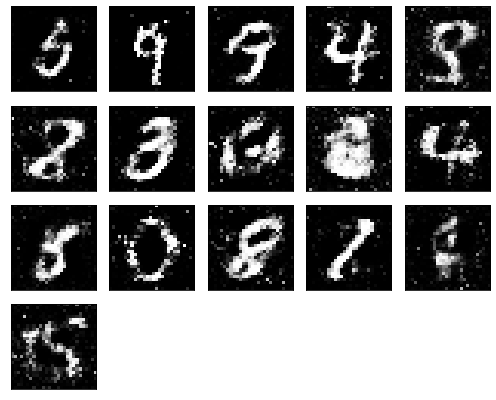

Epochs nb. 3341
discriminator loss: 0.7090191841125488
generator loss : 0.9135315418243408

Epochs nb. 3342
discriminator loss: 0.5367816686630249
generator loss : 1.0260865688323975

Epochs nb. 3343
discriminator loss: 0.492814838886261
generator loss : 0.9634947180747986

Epochs nb. 3344
discriminator loss: 0.46908503770828247
generator loss : 1.0886547565460205

Epochs nb. 3345
discriminator loss: 0.5676921606063843
generator loss : 1.1439838409423828

Epochs nb. 3346
discriminator loss: 0.6630395650863647
generator loss : 1.3123888969421387

Epochs nb. 3347
discriminator loss: 0.6120524406433105
generator loss : 1.024847149848938

Epochs nb. 3348
discriminator loss: 0.5736937522888184
generator loss : 0.9647461175918579

Epochs nb. 3349
discriminator loss: 0.5095549821853638
generator loss : 0.8504629135131836

Epochs nb. 3350
discriminator loss: 0.6261833906173706
generator loss : 1.0331220626831055



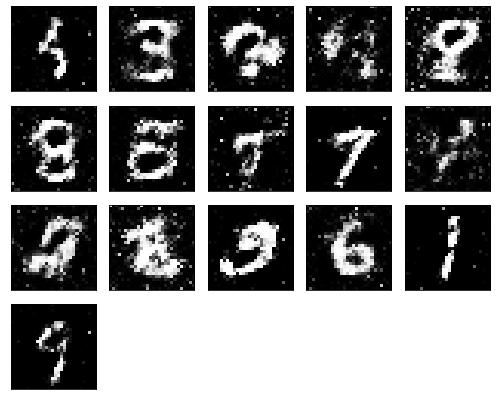

Epochs nb. 3351
discriminator loss: 0.593757152557373
generator loss : 0.965499758720398

Epochs nb. 3352
discriminator loss: 0.5665872693061829
generator loss : 0.9231246709823608

Epochs nb. 3353
discriminator loss: 0.4503133296966553
generator loss : 1.093804121017456

Epochs nb. 3354
discriminator loss: 0.7511239051818848
generator loss : 0.8242217898368835

Epochs nb. 3355
discriminator loss: 0.687964916229248
generator loss : 0.9123390913009644

Epochs nb. 3356
discriminator loss: 0.5913187265396118
generator loss : 0.9499349594116211

Epochs nb. 3357
discriminator loss: 0.6157606840133667
generator loss : 0.7422162294387817

Epochs nb. 3358
discriminator loss: 0.4617900252342224
generator loss : 0.9940945506095886

Epochs nb. 3359
discriminator loss: 0.5173072814941406
generator loss : 0.8968683481216431

Epochs nb. 3360
discriminator loss: 0.5670723915100098
generator loss : 1.1055324077606201



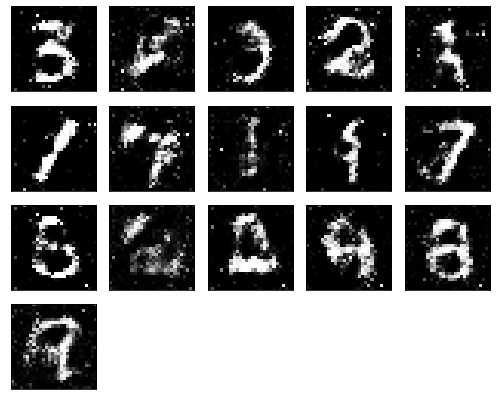

Epochs nb. 3361
discriminator loss: 0.704140305519104
generator loss : 1.0170000791549683

Epochs nb. 3362
discriminator loss: 0.5720422267913818
generator loss : 1.076509714126587

Epochs nb. 3363
discriminator loss: 0.48802506923675537
generator loss : 1.0084046125411987

Epochs nb. 3364
discriminator loss: 0.5600391030311584
generator loss : 0.8769916892051697

Epochs nb. 3365
discriminator loss: 0.6074913740158081
generator loss : 0.8990855813026428

Epochs nb. 3366
discriminator loss: 0.5832236409187317
generator loss : 1.1096978187561035

Epochs nb. 3367
discriminator loss: 0.553708016872406
generator loss : 0.8811953067779541

Epochs nb. 3368
discriminator loss: 0.5966686010360718
generator loss : 0.9208886623382568

Epochs nb. 3369
discriminator loss: 0.6321274042129517
generator loss : 0.9104721546173096

Epochs nb. 3370
discriminator loss: 0.568070650100708
generator loss : 0.8229912519454956



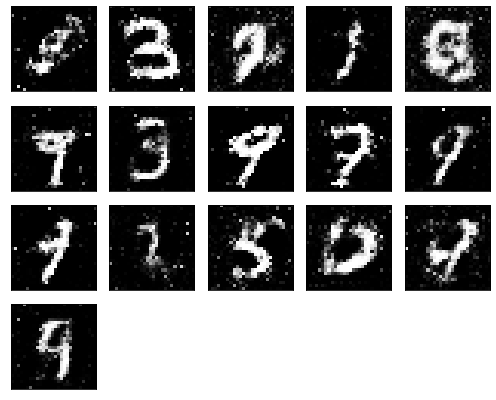

Epochs nb. 3371
discriminator loss: 0.705885112285614
generator loss : 1.1637799739837646

Epochs nb. 3372
discriminator loss: 0.6135129928588867
generator loss : 1.000980019569397

Epochs nb. 3373
discriminator loss: 0.5315424799919128
generator loss : 1.090864658355713

Epochs nb. 3374
discriminator loss: 0.6167480945587158
generator loss : 0.9887068867683411

Epochs nb. 3375
discriminator loss: 0.6347399950027466
generator loss : 0.9788219332695007

Epochs nb. 3376
discriminator loss: 0.688902735710144
generator loss : 1.0133962631225586

Epochs nb. 3377
discriminator loss: 0.8046373128890991
generator loss : 0.9598050117492676

Epochs nb. 3378
discriminator loss: 0.565765380859375
generator loss : 0.9236763715744019

Epochs nb. 3379
discriminator loss: 0.5977766513824463
generator loss : 0.9339418411254883

Epochs nb. 3380
discriminator loss: 0.63552325963974
generator loss : 0.9313197135925293



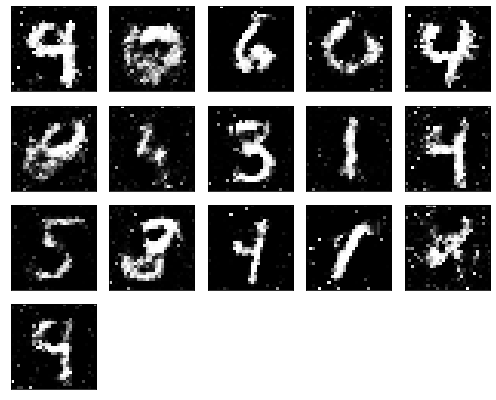

Epochs nb. 3381
discriminator loss: 0.49958741664886475
generator loss : 0.9552218317985535

Epochs nb. 3382
discriminator loss: 0.5870195031166077
generator loss : 0.973353385925293

Epochs nb. 3383
discriminator loss: 0.5749356746673584
generator loss : 0.9801678657531738

Epochs nb. 3384
discriminator loss: 0.45674604177474976
generator loss : 0.91283118724823

Epochs nb. 3385
discriminator loss: 0.5290704369544983
generator loss : 0.7891353964805603

Epochs nb. 3386
discriminator loss: 0.46662288904190063
generator loss : 0.983426570892334

Epochs nb. 3387
discriminator loss: 0.829303503036499
generator loss : 1.0670827627182007

Epochs nb. 3388
discriminator loss: 0.7627418637275696
generator loss : 1.0593342781066895

Epochs nb. 3389
discriminator loss: 0.6123037338256836
generator loss : 0.9398036003112793

Epochs nb. 3390
discriminator loss: 0.5248152613639832
generator loss : 1.1127591133117676



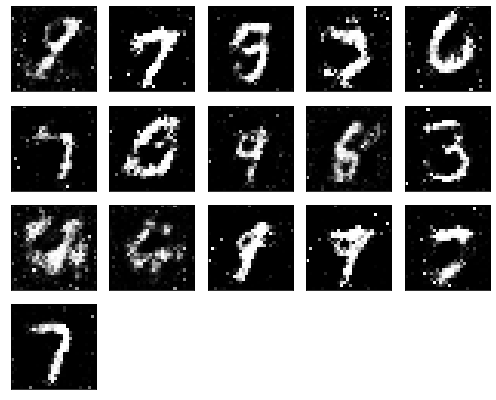

Epochs nb. 3391
discriminator loss: 0.5802273154258728
generator loss : 0.990897536277771

Epochs nb. 3392
discriminator loss: 0.6900318264961243
generator loss : 0.9717743992805481

Epochs nb. 3393
discriminator loss: 0.7089850902557373
generator loss : 1.1327342987060547

Epochs nb. 3394
discriminator loss: 0.5906547904014587
generator loss : 1.092142105102539

Epochs nb. 3395
discriminator loss: 0.5916837453842163
generator loss : 0.9484367966651917

Epochs nb. 3396
discriminator loss: 0.6494337916374207
generator loss : 0.906554102897644

Epochs nb. 3397
discriminator loss: 0.4935508966445923
generator loss : 0.855811357498169

Epochs nb. 3398
discriminator loss: 0.5346835255622864
generator loss : 1.0415749549865723

Epochs nb. 3399
discriminator loss: 0.4802718162536621
generator loss : 1.1210095882415771

Epochs nb. 3400
discriminator loss: 0.6116117238998413
generator loss : 1.150763750076294



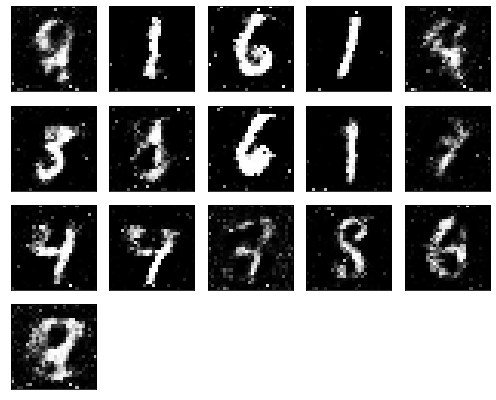

Epochs nb. 3401
discriminator loss: 0.4671632945537567
generator loss : 1.0277104377746582

Epochs nb. 3402
discriminator loss: 0.48895198106765747
generator loss : 0.9657748937606812

Epochs nb. 3403
discriminator loss: 0.6278692483901978
generator loss : 0.8392356038093567

Epochs nb. 3404
discriminator loss: 0.7000395655632019
generator loss : 0.904765248298645

Epochs nb. 3405
discriminator loss: 0.6292988061904907
generator loss : 0.7969321608543396

Epochs nb. 3406
discriminator loss: 0.519171953201294
generator loss : 0.9068049192428589

Epochs nb. 3407
discriminator loss: 0.6318514347076416
generator loss : 0.8696811199188232

Epochs nb. 3408
discriminator loss: 0.6703920364379883
generator loss : 0.9725335836410522

Epochs nb. 3409
discriminator loss: 0.6183611154556274
generator loss : 0.9932200312614441

Epochs nb. 3410
discriminator loss: 0.6017520427703857
generator loss : 0.9642763137817383



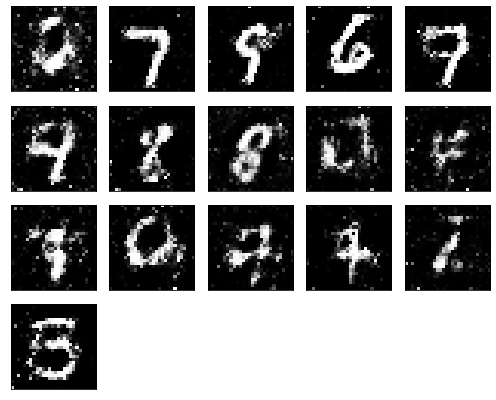

Epochs nb. 3411
discriminator loss: 0.5460333824157715
generator loss : 1.071916103363037

Epochs nb. 3412
discriminator loss: 0.6775271892547607
generator loss : 1.0945160388946533

Epochs nb. 3413
discriminator loss: 0.6895923614501953
generator loss : 0.9348679184913635

Epochs nb. 3414
discriminator loss: 0.5988115072250366
generator loss : 1.0207173824310303

Epochs nb. 3415
discriminator loss: 0.6001262068748474
generator loss : 0.8027939200401306

Epochs nb. 3416
discriminator loss: 0.5017179250717163
generator loss : 0.9156280159950256

Epochs nb. 3417
discriminator loss: 0.4838838577270508
generator loss : 0.9850175976753235

Epochs nb. 3418
discriminator loss: 0.7360443472862244
generator loss : 1.0068761110305786

Epochs nb. 3419
discriminator loss: 0.5819422006607056
generator loss : 0.9672226905822754

Epochs nb. 3420
discriminator loss: 0.616637110710144
generator loss : 0.9256618022918701



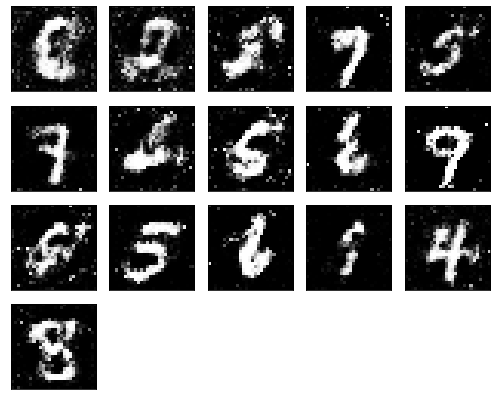

Epochs nb. 3421
discriminator loss: 0.5482975244522095
generator loss : 0.8105922341346741

Epochs nb. 3422
discriminator loss: 0.5734539031982422
generator loss : 0.82234126329422

Epochs nb. 3423
discriminator loss: 0.5308340787887573
generator loss : 0.9253582954406738

Epochs nb. 3424
discriminator loss: 0.7090541124343872
generator loss : 0.9525797367095947

Epochs nb. 3425
discriminator loss: 0.6907539367675781
generator loss : 0.9495846033096313

Epochs nb. 3426
discriminator loss: 0.6223874092102051
generator loss : 0.7900616526603699

Epochs nb. 3427
discriminator loss: 0.6272873878479004
generator loss : 1.0640190839767456

Epochs nb. 3428
discriminator loss: 0.648606538772583
generator loss : 1.0275934934616089

Epochs nb. 3429
discriminator loss: 0.6711713075637817
generator loss : 1.0561968088150024

Epochs nb. 3430
discriminator loss: 0.6289242506027222
generator loss : 0.9550187587738037



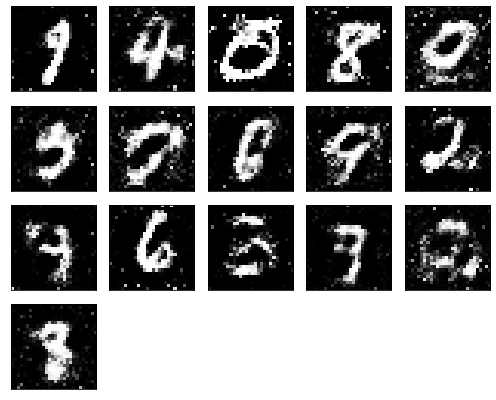

Epochs nb. 3431
discriminator loss: 0.5722489356994629
generator loss : 0.8712654709815979

Epochs nb. 3432
discriminator loss: 0.5742055177688599
generator loss : 0.9622386693954468

Epochs nb. 3433
discriminator loss: 0.6069067716598511
generator loss : 1.1776753664016724

Epochs nb. 3434
discriminator loss: 0.5790477991104126
generator loss : 0.9123633503913879

Epochs nb. 3435
discriminator loss: 0.6144487261772156
generator loss : 1.0762426853179932

Epochs nb. 3436
discriminator loss: 0.5748790502548218
generator loss : 0.9412074089050293

Epochs nb. 3437
discriminator loss: 0.7214647531509399
generator loss : 0.9357947111129761

Epochs nb. 3438
discriminator loss: 0.6307951807975769
generator loss : 0.8206939697265625

Epochs nb. 3439
discriminator loss: 0.5870400071144104
generator loss : 0.9818174839019775

Epochs nb. 3440
discriminator loss: 0.5942009687423706
generator loss : 1.0007176399230957



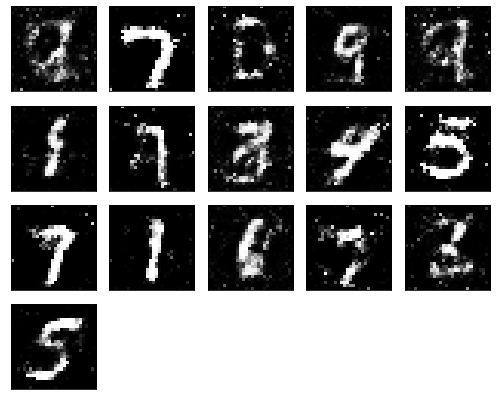

Epochs nb. 3441
discriminator loss: 0.6879285573959351
generator loss : 0.8749337196350098

Epochs nb. 3442
discriminator loss: 0.5329915881156921
generator loss : 0.9692668318748474

Epochs nb. 3443
discriminator loss: 0.5686967372894287
generator loss : 0.8553227186203003

Epochs nb. 3444
discriminator loss: 0.6033322811126709
generator loss : 1.0443086624145508

Epochs nb. 3445
discriminator loss: 0.5396387577056885
generator loss : 0.769070029258728

Epochs nb. 3446
discriminator loss: 0.6199913024902344
generator loss : 0.9505602717399597

Epochs nb. 3447
discriminator loss: 0.6744621992111206
generator loss : 0.7632551789283752

Epochs nb. 3448
discriminator loss: 0.5557975769042969
generator loss : 0.8979095816612244

Epochs nb. 3449
discriminator loss: 0.6099144220352173
generator loss : 0.9747291803359985

Epochs nb. 3450
discriminator loss: 0.6991029977798462
generator loss : 1.0186234712600708



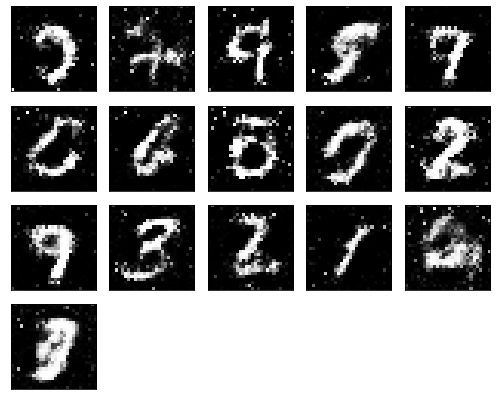

Epochs nb. 3451
discriminator loss: 0.5735160112380981
generator loss : 1.1184967756271362

Epochs nb. 3452
discriminator loss: 0.6162428855895996
generator loss : 1.036304235458374

Epochs nb. 3453
discriminator loss: 0.6536140441894531
generator loss : 1.0142287015914917

Epochs nb. 3454
discriminator loss: 0.6576027274131775
generator loss : 1.0284687280654907

Epochs nb. 3455
discriminator loss: 0.47562187910079956
generator loss : 0.9890787601470947

Epochs nb. 3456
discriminator loss: 0.5016170740127563
generator loss : 1.09447181224823

Epochs nb. 3457
discriminator loss: 0.5284519195556641
generator loss : 1.0693753957748413

Epochs nb. 3458
discriminator loss: 0.576856791973114
generator loss : 1.0993688106536865

Epochs nb. 3459
discriminator loss: 0.5530857443809509
generator loss : 1.0994274616241455

Epochs nb. 3460
discriminator loss: 0.5767097473144531
generator loss : 1.1327791213989258



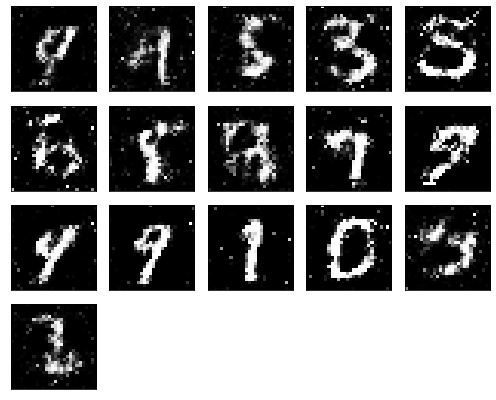

Epochs nb. 3461
discriminator loss: 0.6313313245773315
generator loss : 0.9577983617782593

Epochs nb. 3462
discriminator loss: 0.5799355506896973
generator loss : 1.0321495532989502

Epochs nb. 3463
discriminator loss: 0.6444339156150818
generator loss : 1.0153971910476685

Epochs nb. 3464
discriminator loss: 0.5701513290405273
generator loss : 0.8639256954193115

Epochs nb. 3465
discriminator loss: 0.48787063360214233
generator loss : 0.833667516708374

Epochs nb. 3466
discriminator loss: 0.5894209146499634
generator loss : 1.09230375289917

Epochs nb. 3467
discriminator loss: 0.615445077419281
generator loss : 0.9914799332618713

Epochs nb. 3468
discriminator loss: 0.6926652789115906
generator loss : 0.8766347169876099

Epochs nb. 3469
discriminator loss: 0.589769721031189
generator loss : 0.8405947685241699

Epochs nb. 3470
discriminator loss: 0.6814736723899841
generator loss : 1.1222563982009888



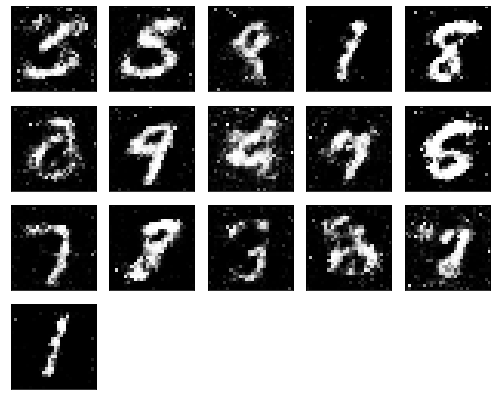

Epochs nb. 3471
discriminator loss: 0.5621979832649231
generator loss : 0.8048135042190552

Epochs nb. 3472
discriminator loss: 0.5812750458717346
generator loss : 0.7882723808288574

Epochs nb. 3473
discriminator loss: 0.6100021004676819
generator loss : 1.0703469514846802

Epochs nb. 3474
discriminator loss: 0.684572696685791
generator loss : 1.1020022630691528

Epochs nb. 3475
discriminator loss: 0.6109333038330078
generator loss : 0.9411217570304871

Epochs nb. 3476
discriminator loss: 0.606660008430481
generator loss : 0.9679787755012512

Epochs nb. 3477
discriminator loss: 0.44968101382255554
generator loss : 1.0206340551376343

Epochs nb. 3478
discriminator loss: 0.507431149482727
generator loss : 1.0309736728668213

Epochs nb. 3479
discriminator loss: 0.594180166721344
generator loss : 1.1046648025512695

Epochs nb. 3480
discriminator loss: 0.45690926909446716
generator loss : 1.0905545949935913



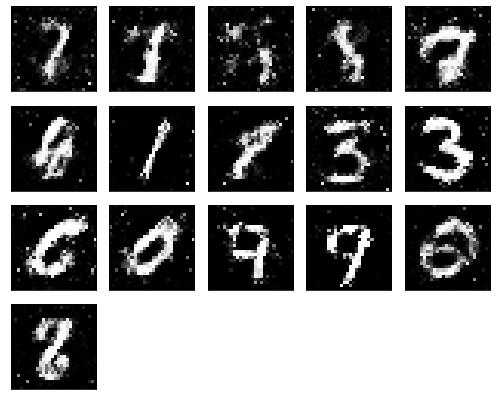

Epochs nb. 3481
discriminator loss: 0.7005218863487244
generator loss : 1.1388204097747803

Epochs nb. 3482
discriminator loss: 0.5262521505355835
generator loss : 1.0252712965011597

Epochs nb. 3483
discriminator loss: 0.6900848150253296
generator loss : 0.9278676509857178

Epochs nb. 3484
discriminator loss: 0.6470192670822144
generator loss : 1.0309789180755615

Epochs nb. 3485
discriminator loss: 0.6462653875350952
generator loss : 0.9500089883804321

Epochs nb. 3486
discriminator loss: 0.6095694899559021
generator loss : 1.0657063722610474

Epochs nb. 3487
discriminator loss: 0.5269354581832886
generator loss : 0.8461945652961731

Epochs nb. 3488
discriminator loss: 0.5721645355224609
generator loss : 0.9264607429504395

Epochs nb. 3489
discriminator loss: 0.6165334582328796
generator loss : 1.0071792602539062

Epochs nb. 3490
discriminator loss: 0.5534205436706543
generator loss : 1.0600496530532837



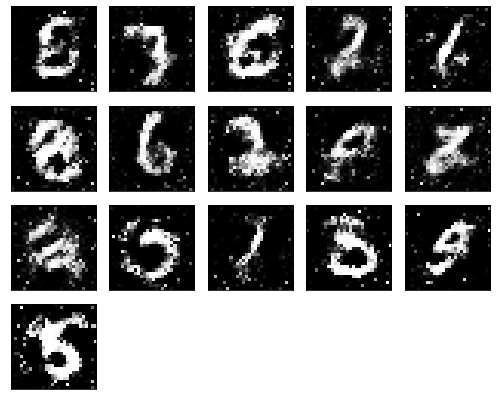

Epochs nb. 3491
discriminator loss: 0.6641722917556763
generator loss : 0.9743077754974365

Epochs nb. 3492
discriminator loss: 0.6035082340240479
generator loss : 0.8545982837677002

Epochs nb. 3493
discriminator loss: 0.5439067482948303
generator loss : 0.9461451768875122

Epochs nb. 3494
discriminator loss: 0.6172307729721069
generator loss : 1.0631049871444702

Epochs nb. 3495
discriminator loss: 0.6658310890197754
generator loss : 0.9618683457374573

Epochs nb. 3496
discriminator loss: 0.6559740900993347
generator loss : 1.040198802947998

Epochs nb. 3497
discriminator loss: 0.5096589922904968
generator loss : 0.9521477818489075

Epochs nb. 3498
discriminator loss: 0.5831037163734436
generator loss : 0.9437829256057739

Epochs nb. 3499
discriminator loss: 0.5883983969688416
generator loss : 1.0656800270080566

Epochs nb. 3500
discriminator loss: 0.557296097278595
generator loss : 0.9811129570007324



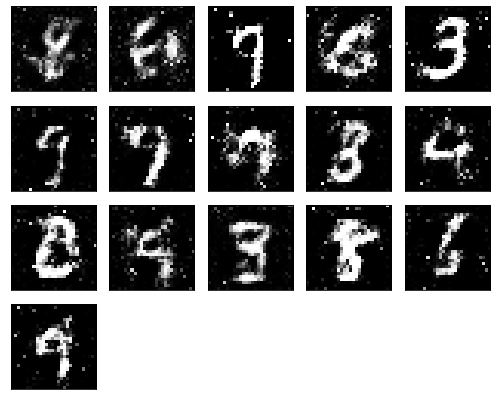

Epochs nb. 3501
discriminator loss: 0.516177237033844
generator loss : 0.9596352577209473

Epochs nb. 3502
discriminator loss: 0.6283704042434692
generator loss : 0.9675442576408386

Epochs nb. 3503
discriminator loss: 0.550503134727478
generator loss : 1.0800522565841675

Epochs nb. 3504
discriminator loss: 0.6113564968109131
generator loss : 1.0847653150558472

Epochs nb. 3505
discriminator loss: 0.5890510678291321
generator loss : 0.9250006675720215

Epochs nb. 3506
discriminator loss: 0.6311590075492859
generator loss : 1.051398515701294

Epochs nb. 3507
discriminator loss: 0.6660997867584229
generator loss : 0.9740698337554932

Epochs nb. 3508
discriminator loss: 0.6520624160766602
generator loss : 0.9591883420944214

Epochs nb. 3509
discriminator loss: 0.5907235741615295
generator loss : 0.9997323751449585

Epochs nb. 3510
discriminator loss: 0.5872582197189331
generator loss : 1.031482219696045



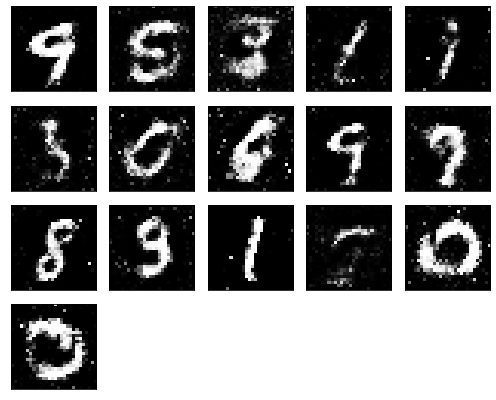

Epochs nb. 3511
discriminator loss: 0.6349446177482605
generator loss : 1.0348694324493408

Epochs nb. 3512
discriminator loss: 0.7502084970474243
generator loss : 0.940318763256073

Epochs nb. 3513
discriminator loss: 0.48084011673927307
generator loss : 1.101248025894165

Epochs nb. 3514
discriminator loss: 0.7030448913574219
generator loss : 1.1268543004989624

Epochs nb. 3515
discriminator loss: 0.5535459518432617
generator loss : 1.1291149854660034

Epochs nb. 3516
discriminator loss: 0.45677611231803894
generator loss : 1.063022255897522

Epochs nb. 3517
discriminator loss: 0.6477891206741333
generator loss : 0.9561926126480103

Epochs nb. 3518
discriminator loss: 0.5443555116653442
generator loss : 0.9562973976135254

Epochs nb. 3519
discriminator loss: 0.5713886022567749
generator loss : 0.7185128331184387

Epochs nb. 3520
discriminator loss: 0.5489237308502197
generator loss : 0.905319333076477



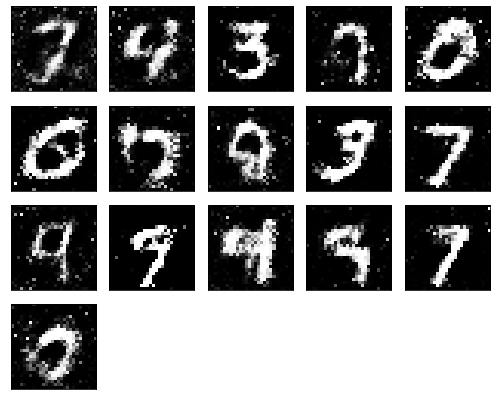

Epochs nb. 3521
discriminator loss: 0.6176979541778564
generator loss : 0.7972826957702637

Epochs nb. 3522
discriminator loss: 0.7481371164321899
generator loss : 0.9806304574012756

Epochs nb. 3523
discriminator loss: 0.6041964292526245
generator loss : 0.9609061479568481

Epochs nb. 3524
discriminator loss: 0.6468647122383118
generator loss : 0.9278174042701721

Epochs nb. 3525
discriminator loss: 0.504068911075592
generator loss : 1.0174733400344849

Epochs nb. 3526
discriminator loss: 0.6063331365585327
generator loss : 0.98133784532547

Epochs nb. 3527
discriminator loss: 0.5602734088897705
generator loss : 0.8622084259986877

Epochs nb. 3528
discriminator loss: 0.755160927772522
generator loss : 1.0810682773590088

Epochs nb. 3529
discriminator loss: 0.6276246905326843
generator loss : 0.9449558854103088

Epochs nb. 3530
discriminator loss: 0.5962114334106445
generator loss : 0.9668329358100891



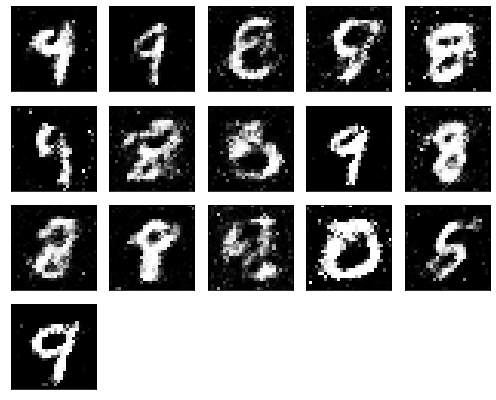

Epochs nb. 3531
discriminator loss: 0.6263763904571533
generator loss : 0.8700711727142334

Epochs nb. 3532
discriminator loss: 0.6278619766235352
generator loss : 0.9748371243476868

Epochs nb. 3533
discriminator loss: 0.5525527000427246
generator loss : 1.0699970722198486

Epochs nb. 3534
discriminator loss: 0.5953065752983093
generator loss : 1.029436469078064

Epochs nb. 3535
discriminator loss: 0.6376907825469971
generator loss : 1.1092700958251953

Epochs nb. 3536
discriminator loss: 0.6694810390472412
generator loss : 1.0268150568008423

Epochs nb. 3537
discriminator loss: 0.6092191934585571
generator loss : 0.8945851922035217

Epochs nb. 3538
discriminator loss: 0.5597283244132996
generator loss : 0.9165813326835632

Epochs nb. 3539
discriminator loss: 0.5484778881072998
generator loss : 0.9490042328834534

Epochs nb. 3540
discriminator loss: 0.4783090651035309
generator loss : 1.048671007156372



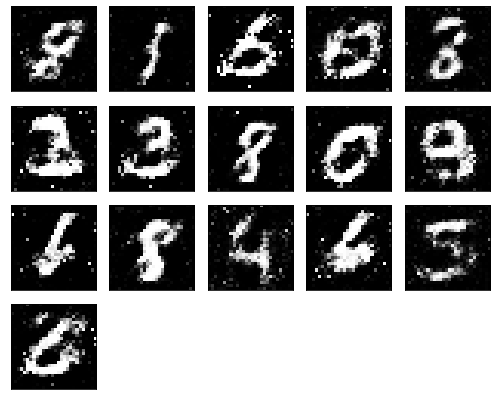

Epochs nb. 3541
discriminator loss: 0.5531781911849976
generator loss : 1.0293775796890259

Epochs nb. 3542
discriminator loss: 0.5029067993164062
generator loss : 0.9682409763336182

Epochs nb. 3543
discriminator loss: 0.6041969060897827
generator loss : 1.032820224761963

Epochs nb. 3544
discriminator loss: 0.554201066493988
generator loss : 1.0618441104888916

Epochs nb. 3545
discriminator loss: 0.6643297672271729
generator loss : 1.107874870300293

Epochs nb. 3546
discriminator loss: 0.5049252510070801
generator loss : 1.029059648513794

Epochs nb. 3547
discriminator loss: 0.5802266597747803
generator loss : 0.9256942272186279

Epochs nb. 3548
discriminator loss: 0.5775446891784668
generator loss : 1.1050894260406494

Epochs nb. 3549
discriminator loss: 0.594836950302124
generator loss : 0.9534001350402832

Epochs nb. 3550
discriminator loss: 0.5372426509857178
generator loss : 1.086466670036316



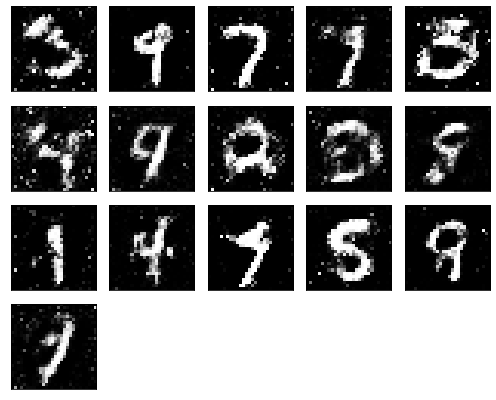

Epochs nb. 3551
discriminator loss: 0.6486848592758179
generator loss : 1.0256688594818115

Epochs nb. 3552
discriminator loss: 0.6152946949005127
generator loss : 1.1638362407684326

Epochs nb. 3553
discriminator loss: 0.6370997428894043
generator loss : 1.0913755893707275

Epochs nb. 3554
discriminator loss: 0.6377081274986267
generator loss : 1.021094799041748

Epochs nb. 3555
discriminator loss: 0.49598562717437744
generator loss : 0.9951462745666504

Epochs nb. 3556
discriminator loss: 0.6266756057739258
generator loss : 1.0498863458633423

Epochs nb. 3557
discriminator loss: 0.6617206335067749
generator loss : 1.0003994703292847

Epochs nb. 3558
discriminator loss: 0.6157830357551575
generator loss : 1.1036616563796997

Epochs nb. 3559
discriminator loss: 0.5893333554267883
generator loss : 1.1503708362579346

Epochs nb. 3560
discriminator loss: 0.6118944883346558
generator loss : 1.0860850811004639



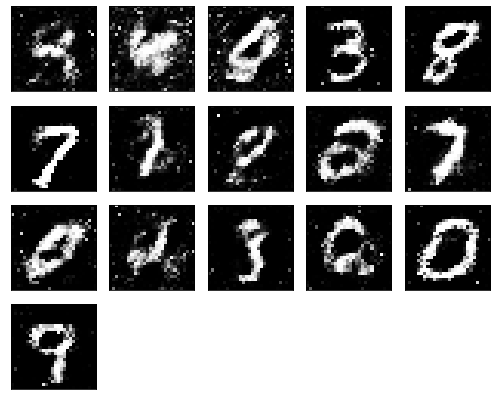

Epochs nb. 3561
discriminator loss: 0.6293745636940002
generator loss : 0.9454971551895142

Epochs nb. 3562
discriminator loss: 0.6225470304489136
generator loss : 0.8691985607147217

Epochs nb. 3563
discriminator loss: 0.5571171045303345
generator loss : 0.9185845851898193

Epochs nb. 3564
discriminator loss: 0.6384463310241699
generator loss : 1.0775160789489746

Epochs nb. 3565
discriminator loss: 0.671745777130127
generator loss : 1.0198729038238525

Epochs nb. 3566
discriminator loss: 0.5563740730285645
generator loss : 1.0033295154571533

Epochs nb. 3567
discriminator loss: 0.6451895833015442
generator loss : 1.0458652973175049

Epochs nb. 3568
discriminator loss: 0.6327444314956665
generator loss : 1.0178885459899902

Epochs nb. 3569
discriminator loss: 0.5637505650520325
generator loss : 0.9186068773269653

Epochs nb. 3570
discriminator loss: 0.6417562961578369
generator loss : 1.1260993480682373



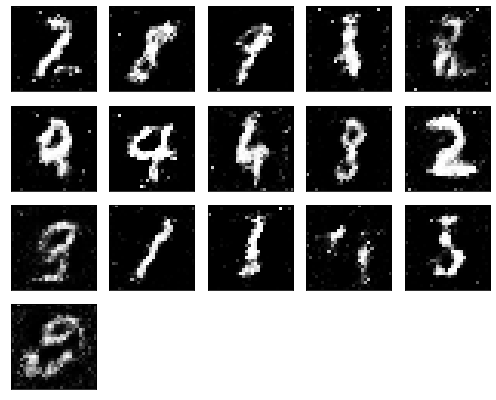

Epochs nb. 3571
discriminator loss: 0.5501013994216919
generator loss : 0.9485828280448914

Epochs nb. 3572
discriminator loss: 0.6527562141418457
generator loss : 0.9472622871398926

Epochs nb. 3573
discriminator loss: 0.632992148399353
generator loss : 1.0392920970916748

Epochs nb. 3574
discriminator loss: 0.5972645282745361
generator loss : 1.0117809772491455

Epochs nb. 3575
discriminator loss: 0.7287195920944214
generator loss : 0.960405170917511

Epochs nb. 3576
discriminator loss: 0.4891189634799957
generator loss : 0.9457898139953613

Epochs nb. 3577
discriminator loss: 0.5732439756393433
generator loss : 0.9931043386459351

Epochs nb. 3578
discriminator loss: 0.5592555999755859
generator loss : 1.0568393468856812

Epochs nb. 3579
discriminator loss: 0.665397047996521
generator loss : 0.8802281022071838

Epochs nb. 3580
discriminator loss: 0.6131845712661743
generator loss : 1.0876083374023438



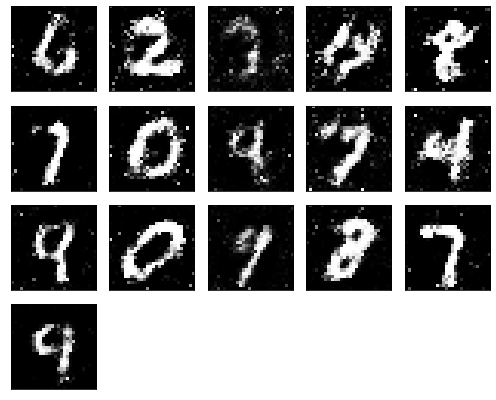

Epochs nb. 3581
discriminator loss: 0.6378018856048584
generator loss : 1.0129971504211426

Epochs nb. 3582
discriminator loss: 0.5595852136611938
generator loss : 1.0320589542388916

Epochs nb. 3583
discriminator loss: 0.5467453002929688
generator loss : 0.9149937629699707

Epochs nb. 3584
discriminator loss: 0.6123272776603699
generator loss : 1.2017005681991577

Epochs nb. 3585
discriminator loss: 0.5138441920280457
generator loss : 1.199992060661316

Epochs nb. 3586
discriminator loss: 0.5877482891082764
generator loss : 1.134239673614502

Epochs nb. 3587
discriminator loss: 0.7098183035850525
generator loss : 0.9761369824409485

Epochs nb. 3588
discriminator loss: 0.6784510612487793
generator loss : 1.1016298532485962

Epochs nb. 3589
discriminator loss: 0.6888168454170227
generator loss : 0.9669724702835083

Epochs nb. 3590
discriminator loss: 0.6125488877296448
generator loss : 0.8499733209609985



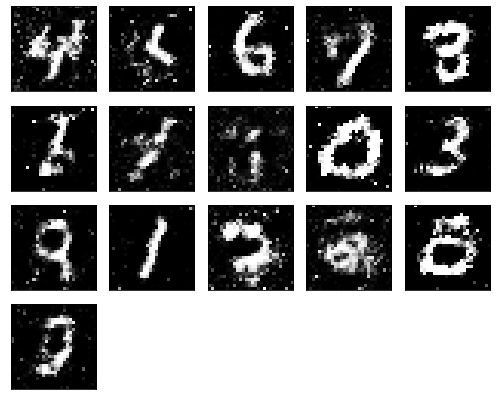

Epochs nb. 3591
discriminator loss: 0.6405121088027954
generator loss : 0.7289217114448547

Epochs nb. 3592
discriminator loss: 0.611546516418457
generator loss : 0.9559214115142822

Epochs nb. 3593
discriminator loss: 0.7247728109359741
generator loss : 1.1502043008804321

Epochs nb. 3594
discriminator loss: 0.6396456956863403
generator loss : 1.056149959564209

Epochs nb. 3595
discriminator loss: 0.6008250713348389
generator loss : 1.0123462677001953

Epochs nb. 3596
discriminator loss: 0.5620828866958618
generator loss : 0.9778246879577637

Epochs nb. 3597
discriminator loss: 0.5356643199920654
generator loss : 0.9000242352485657

Epochs nb. 3598
discriminator loss: 0.660678505897522
generator loss : 0.9348998069763184

Epochs nb. 3599
discriminator loss: 0.606526255607605
generator loss : 0.9896408319473267

Epochs nb. 3600
discriminator loss: 0.6332461833953857
generator loss : 1.0315866470336914



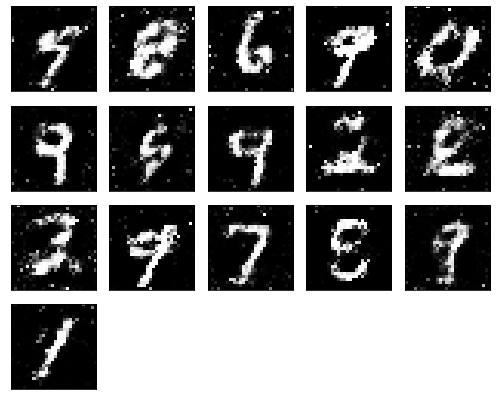

Epochs nb. 3601
discriminator loss: 0.7171030044555664
generator loss : 1.0677306652069092

Epochs nb. 3602
discriminator loss: 0.5432955026626587
generator loss : 0.9840649962425232

Epochs nb. 3603
discriminator loss: 0.5023677349090576
generator loss : 0.9086558222770691

Epochs nb. 3604
discriminator loss: 0.5822927951812744
generator loss : 0.9065311551094055

Epochs nb. 3605
discriminator loss: 0.6190904378890991
generator loss : 1.0271096229553223

Epochs nb. 3606
discriminator loss: 0.651870608329773
generator loss : 1.1249077320098877

Epochs nb. 3607
discriminator loss: 0.5748651027679443
generator loss : 0.929317831993103

Epochs nb. 3608
discriminator loss: 0.555469274520874
generator loss : 0.8301109075546265

Epochs nb. 3609
discriminator loss: 0.729411244392395
generator loss : 0.9407248497009277

Epochs nb. 3610
discriminator loss: 0.6784998178482056
generator loss : 0.9304357767105103



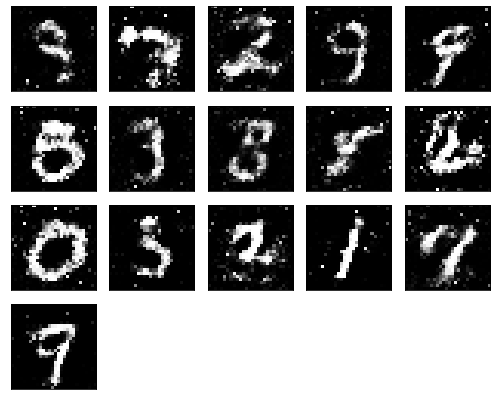

Epochs nb. 3611
discriminator loss: 0.5258811116218567
generator loss : 1.0332605838775635

Epochs nb. 3612
discriminator loss: 0.6260207891464233
generator loss : 0.9924634695053101

Epochs nb. 3613
discriminator loss: 0.6208453178405762
generator loss : 1.0041835308074951

Epochs nb. 3614
discriminator loss: 0.5491309762001038
generator loss : 0.9239677786827087

Epochs nb. 3615
discriminator loss: 0.5066686868667603
generator loss : 0.9548729658126831

Epochs nb. 3616
discriminator loss: 0.5160970091819763
generator loss : 1.0371229648590088

Epochs nb. 3617
discriminator loss: 0.6327798366546631
generator loss : 1.0584653615951538

Epochs nb. 3618
discriminator loss: 0.6276275515556335
generator loss : 1.0684270858764648

Epochs nb. 3619
discriminator loss: 0.675942063331604
generator loss : 0.9522650241851807

Epochs nb. 3620
discriminator loss: 0.5963340401649475
generator loss : 1.0004719495773315



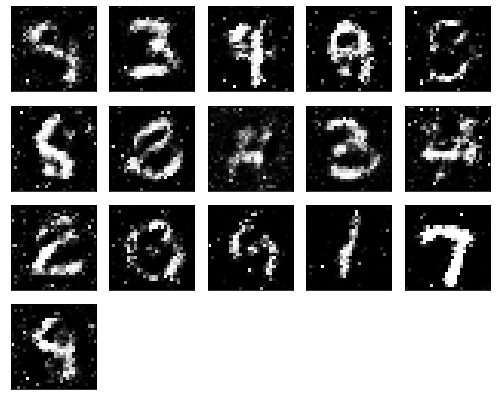

Epochs nb. 3621
discriminator loss: 0.5162206292152405
generator loss : 0.9060974717140198

Epochs nb. 3622
discriminator loss: 0.52287358045578
generator loss : 0.8997788429260254

Epochs nb. 3623
discriminator loss: 0.5889677405357361
generator loss : 0.9608347415924072

Epochs nb. 3624
discriminator loss: 0.5583866238594055
generator loss : 0.8658351898193359

Epochs nb. 3625
discriminator loss: 0.5873550772666931
generator loss : 0.8464139699935913

Epochs nb. 3626
discriminator loss: 0.5658093690872192
generator loss : 0.8734864592552185

Epochs nb. 3627
discriminator loss: 0.6161266565322876
generator loss : 0.8609923124313354

Epochs nb. 3628
discriminator loss: 0.7074360847473145
generator loss : 1.1021745204925537

Epochs nb. 3629
discriminator loss: 0.6561952829360962
generator loss : 0.8333026170730591

Epochs nb. 3630
discriminator loss: 0.523775577545166
generator loss : 0.7975559234619141



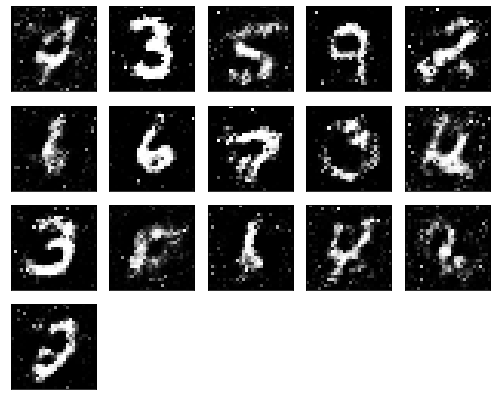

Epochs nb. 3631
discriminator loss: 0.544979453086853
generator loss : 1.0889675617218018

Epochs nb. 3632
discriminator loss: 0.5833870768547058
generator loss : 0.9568403959274292

Epochs nb. 3633
discriminator loss: 0.6186611652374268
generator loss : 0.9484496116638184

Epochs nb. 3634
discriminator loss: 0.6835830211639404
generator loss : 0.9166086316108704

Epochs nb. 3635
discriminator loss: 0.552177906036377
generator loss : 0.9605881571769714

Epochs nb. 3636
discriminator loss: 0.6775643229484558
generator loss : 1.1028001308441162

Epochs nb. 3637
discriminator loss: 0.6097834706306458
generator loss : 0.9507293701171875

Epochs nb. 3638
discriminator loss: 0.566964864730835
generator loss : 0.9630457162857056

Epochs nb. 3639
discriminator loss: 0.5608510971069336
generator loss : 1.0563428401947021

Epochs nb. 3640
discriminator loss: 0.5107093453407288
generator loss : 1.1545850038528442



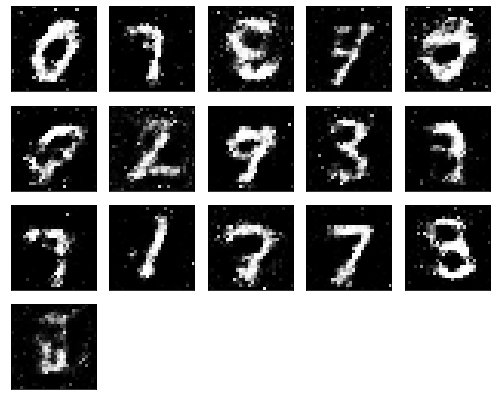

Epochs nb. 3641
discriminator loss: 0.6459720134735107
generator loss : 1.1428086757659912

Epochs nb. 3642
discriminator loss: 0.484893262386322
generator loss : 0.9761168956756592

Epochs nb. 3643
discriminator loss: 0.5729289054870605
generator loss : 0.9239187240600586

Epochs nb. 3644
discriminator loss: 0.5979076623916626
generator loss : 1.1216933727264404

Epochs nb. 3645
discriminator loss: 0.5996193289756775
generator loss : 0.9925196170806885

Epochs nb. 3646
discriminator loss: 0.5900017619132996
generator loss : 0.9592135548591614

Epochs nb. 3647
discriminator loss: 0.6177151799201965
generator loss : 0.869001030921936

Epochs nb. 3648
discriminator loss: 0.5404820442199707
generator loss : 0.9293318390846252

Epochs nb. 3649
discriminator loss: 0.5604221224784851
generator loss : 1.073756217956543

Epochs nb. 3650
discriminator loss: 0.5818967819213867
generator loss : 0.9339239597320557



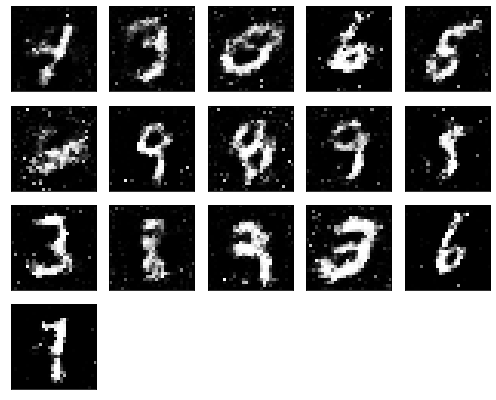

Epochs nb. 3651
discriminator loss: 0.6205213665962219
generator loss : 0.8282629251480103

Epochs nb. 3652
discriminator loss: 0.7354577779769897
generator loss : 0.9769922494888306

Epochs nb. 3653
discriminator loss: 0.5972405672073364
generator loss : 1.0433433055877686

Epochs nb. 3654
discriminator loss: 0.4856628477573395
generator loss : 1.0688669681549072

Epochs nb. 3655
discriminator loss: 0.5590221881866455
generator loss : 0.9583342671394348

Epochs nb. 3656
discriminator loss: 0.4656061828136444
generator loss : 0.8944495916366577

Epochs nb. 3657
discriminator loss: 0.6528529524803162
generator loss : 0.9763480424880981

Epochs nb. 3658
discriminator loss: 0.6359480023384094
generator loss : 1.085916519165039

Epochs nb. 3659
discriminator loss: 0.618644654750824
generator loss : 0.9647872447967529

Epochs nb. 3660
discriminator loss: 0.4815141558647156
generator loss : 1.0060309171676636



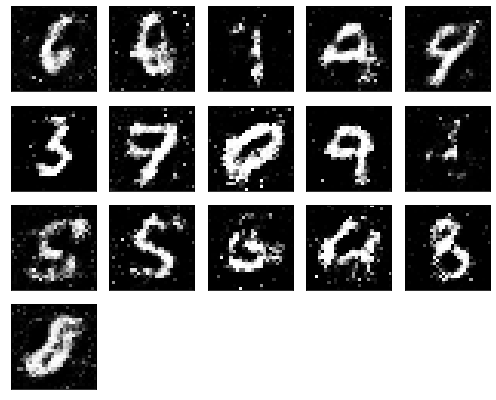

Epochs nb. 3661
discriminator loss: 0.5112859606742859
generator loss : 0.8013836741447449

Epochs nb. 3662
discriminator loss: 0.5979376435279846
generator loss : 0.9501627087593079

Epochs nb. 3663
discriminator loss: 0.6122540235519409
generator loss : 1.1646027565002441

Epochs nb. 3664
discriminator loss: 0.6513841152191162
generator loss : 1.0821123123168945

Epochs nb. 3665
discriminator loss: 0.5027600526809692
generator loss : 1.0193350315093994

Epochs nb. 3666
discriminator loss: 0.5620895624160767
generator loss : 0.9346984028816223

Epochs nb. 3667
discriminator loss: 0.6095516681671143
generator loss : 0.9609369039535522

Epochs nb. 3668
discriminator loss: 0.6676206588745117
generator loss : 1.0613021850585938

Epochs nb. 3669
discriminator loss: 0.6547689437866211
generator loss : 1.0535337924957275

Epochs nb. 3670
discriminator loss: 0.6773079633712769
generator loss : 1.0216060876846313



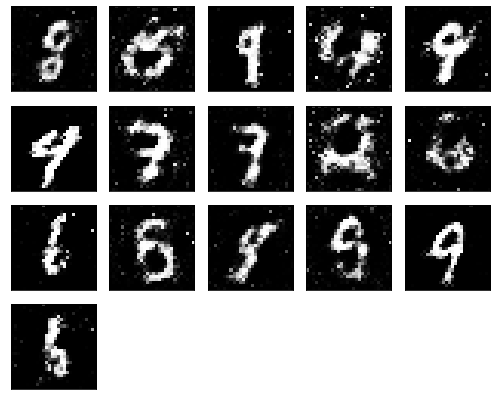

Epochs nb. 3671
discriminator loss: 0.6041258573532104
generator loss : 0.9351481199264526

Epochs nb. 3672
discriminator loss: 0.6130751371383667
generator loss : 1.212054967880249

Epochs nb. 3673
discriminator loss: 0.5622119307518005
generator loss : 0.9878368377685547

Epochs nb. 3674
discriminator loss: 0.7340136766433716
generator loss : 0.9816157817840576

Epochs nb. 3675
discriminator loss: 0.5031877160072327
generator loss : 1.0367565155029297

Epochs nb. 3676
discriminator loss: 0.6130486726760864
generator loss : 1.0298017263412476

Epochs nb. 3677
discriminator loss: 0.5777475833892822
generator loss : 0.9898779988288879

Epochs nb. 3678
discriminator loss: 0.6404170393943787
generator loss : 1.0578515529632568

Epochs nb. 3679
discriminator loss: 0.7128551006317139
generator loss : 1.3379976749420166

Epochs nb. 3680
discriminator loss: 0.5635353326797485
generator loss : 1.1284301280975342



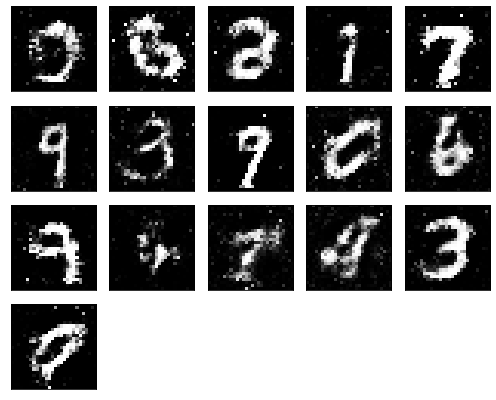

Epochs nb. 3681
discriminator loss: 0.4522097408771515
generator loss : 1.0129410028457642

Epochs nb. 3682
discriminator loss: 0.541409969329834
generator loss : 0.9869236350059509

Epochs nb. 3683
discriminator loss: 0.640320360660553
generator loss : 0.8263055682182312

Epochs nb. 3684
discriminator loss: 0.7226324081420898
generator loss : 0.9377098679542542

Epochs nb. 3685
discriminator loss: 0.6500494480133057
generator loss : 0.9395567178726196

Epochs nb. 3686
discriminator loss: 0.46912437677383423
generator loss : 1.0634833574295044

Epochs nb. 3687
discriminator loss: 0.673849880695343
generator loss : 1.0227216482162476

Epochs nb. 3688
discriminator loss: 0.6800850033760071
generator loss : 1.0599604845046997

Epochs nb. 3689
discriminator loss: 0.620628833770752
generator loss : 0.9318946599960327

Epochs nb. 3690
discriminator loss: 0.49458029866218567
generator loss : 1.0226455926895142



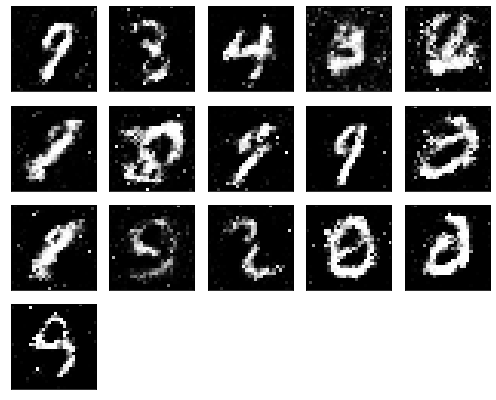

Epochs nb. 3691
discriminator loss: 0.6279320120811462
generator loss : 0.9130039811134338

Epochs nb. 3692
discriminator loss: 0.5692112445831299
generator loss : 1.0449011325836182

Epochs nb. 3693
discriminator loss: 0.5432370901107788
generator loss : 0.9800530076026917

Epochs nb. 3694
discriminator loss: 0.5590615272521973
generator loss : 1.0246775150299072

Epochs nb. 3695
discriminator loss: 0.579277753829956
generator loss : 0.9069510698318481

Epochs nb. 3696
discriminator loss: 0.5831244587898254
generator loss : 1.0042965412139893

Epochs nb. 3697
discriminator loss: 0.6403182744979858
generator loss : 0.8115860819816589

Epochs nb. 3698
discriminator loss: 0.5399744510650635
generator loss : 0.9750485420227051

Epochs nb. 3699
discriminator loss: 0.5459251999855042
generator loss : 0.8764326572418213

Epochs nb. 3700
discriminator loss: 0.5530431270599365
generator loss : 1.0112662315368652



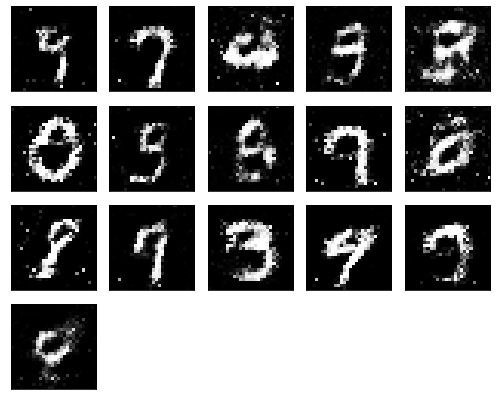

Epochs nb. 3701
discriminator loss: 0.7287037372589111
generator loss : 1.0104973316192627

Epochs nb. 3702
discriminator loss: 0.5593336820602417
generator loss : 1.1256468296051025

Epochs nb. 3703
discriminator loss: 0.7135324478149414
generator loss : 1.0088658332824707

Epochs nb. 3704
discriminator loss: 0.5666831135749817
generator loss : 0.9020047187805176

Epochs nb. 3705
discriminator loss: 0.730656623840332
generator loss : 1.263032078742981

Epochs nb. 3706
discriminator loss: 0.5446780323982239
generator loss : 0.982118546962738

Epochs nb. 3707
discriminator loss: 0.6240239143371582
generator loss : 1.1143734455108643

Epochs nb. 3708
discriminator loss: 0.5039869546890259
generator loss : 1.1376574039459229

Epochs nb. 3709
discriminator loss: 0.5981689691543579
generator loss : 1.0249934196472168

Epochs nb. 3710
discriminator loss: 0.6845154762268066
generator loss : 0.932563066482544



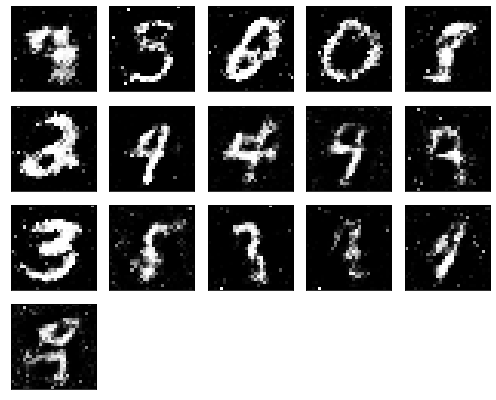

Epochs nb. 3711
discriminator loss: 0.5534891486167908
generator loss : 0.9061284065246582

Epochs nb. 3712
discriminator loss: 0.6272215247154236
generator loss : 0.9450650215148926

Epochs nb. 3713
discriminator loss: 0.5292761921882629
generator loss : 0.9616453647613525

Epochs nb. 3714
discriminator loss: 0.518247127532959
generator loss : 0.9231714010238647

Epochs nb. 3715
discriminator loss: 0.5107778310775757
generator loss : 1.118857741355896

Epochs nb. 3716
discriminator loss: 0.5207421183586121
generator loss : 0.8963034152984619

Epochs nb. 3717
discriminator loss: 0.5601258873939514
generator loss : 1.0569475889205933

Epochs nb. 3718
discriminator loss: 0.6007747054100037
generator loss : 0.9688511490821838

Epochs nb. 3719
discriminator loss: 0.7437669634819031
generator loss : 0.8941904306411743

Epochs nb. 3720
discriminator loss: 0.5665048360824585
generator loss : 1.0365313291549683



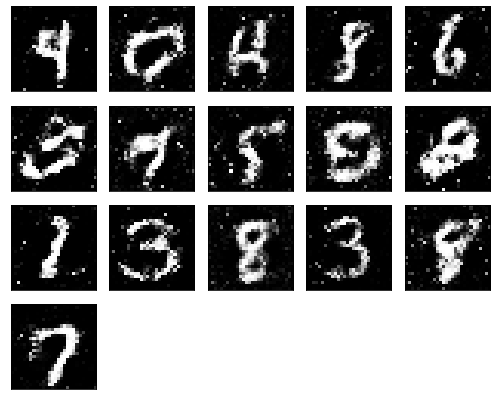

Epochs nb. 3721
discriminator loss: 0.5754765272140503
generator loss : 0.9296954274177551

Epochs nb. 3722
discriminator loss: 0.6301451921463013
generator loss : 1.1385343074798584

Epochs nb. 3723
discriminator loss: 0.6110644340515137
generator loss : 1.1935408115386963

Epochs nb. 3724
discriminator loss: 0.5939249992370605
generator loss : 0.9623330235481262

Epochs nb. 3725
discriminator loss: 0.7367586493492126
generator loss : 1.1607234477996826

Epochs nb. 3726
discriminator loss: 0.5746419429779053
generator loss : 0.9452428817749023

Epochs nb. 3727
discriminator loss: 0.5269389748573303
generator loss : 0.9934627413749695

Epochs nb. 3728
discriminator loss: 0.7045713067054749
generator loss : 1.0556879043579102

Epochs nb. 3729
discriminator loss: 0.6181393265724182
generator loss : 0.9448975324630737

Epochs nb. 3730
discriminator loss: 0.5031994581222534
generator loss : 0.9776561260223389



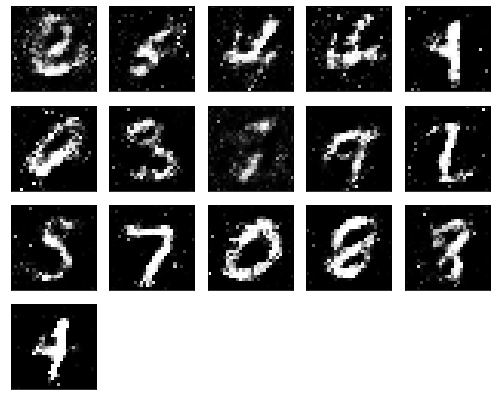

Epochs nb. 3731
discriminator loss: 0.5910369157791138
generator loss : 0.9232137799263

Epochs nb. 3732
discriminator loss: 0.561532735824585
generator loss : 0.746562123298645

Epochs nb. 3733
discriminator loss: 0.4993705153465271
generator loss : 0.9209555387496948

Epochs nb. 3734
discriminator loss: 0.5460444688796997
generator loss : 0.9229055643081665

Epochs nb. 3735
discriminator loss: 0.6352737545967102
generator loss : 0.8206006288528442

Epochs nb. 3736
discriminator loss: 0.584732174873352
generator loss : 1.032043695449829

Epochs nb. 3737
discriminator loss: 0.5419675707817078
generator loss : 0.9936124086380005

Epochs nb. 3738
discriminator loss: 0.6173282861709595
generator loss : 1.0000933408737183

Epochs nb. 3739
discriminator loss: 0.47182169556617737
generator loss : 1.029219388961792

Epochs nb. 3740
discriminator loss: 0.6483339071273804
generator loss : 1.0100185871124268



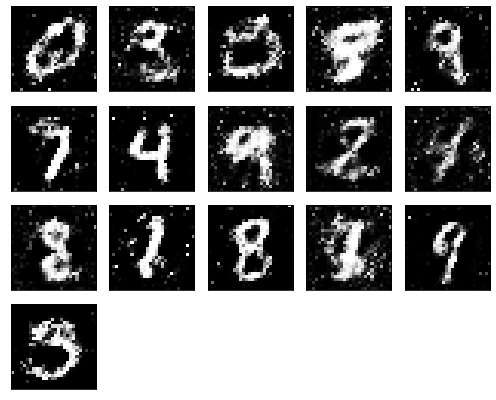

Epochs nb. 3741
discriminator loss: 0.5249723792076111
generator loss : 0.7838329076766968

Epochs nb. 3742
discriminator loss: 0.6161935329437256
generator loss : 0.9032058119773865

Epochs nb. 3743
discriminator loss: 0.6776482462882996
generator loss : 0.9965816736221313

Epochs nb. 3744
discriminator loss: 0.8365218639373779
generator loss : 0.8981685042381287

Epochs nb. 3745
discriminator loss: 0.4996059536933899
generator loss : 0.8848555088043213

Epochs nb. 3746
discriminator loss: 0.4086972177028656
generator loss : 0.7724226713180542

Epochs nb. 3747
discriminator loss: 0.6712396740913391
generator loss : 0.9980767965316772

Epochs nb. 3748
discriminator loss: 0.5719390511512756
generator loss : 0.9614214897155762

Epochs nb. 3749
discriminator loss: 0.5467159152030945
generator loss : 0.9107160568237305

Epochs nb. 3750
discriminator loss: 0.5856525897979736
generator loss : 1.0243754386901855



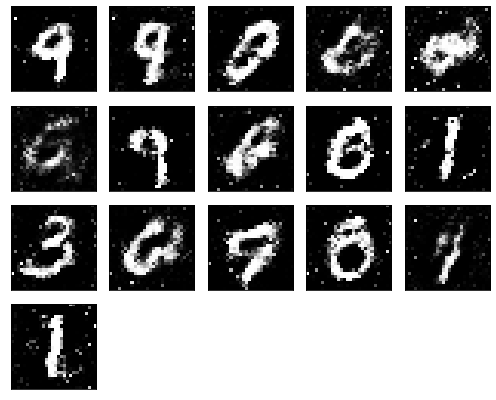

Epochs nb. 3751
discriminator loss: 0.5995393991470337
generator loss : 0.9286537766456604

Epochs nb. 3752
discriminator loss: 0.6405647397041321
generator loss : 0.9883058071136475

Epochs nb. 3753
discriminator loss: 0.7096294164657593
generator loss : 1.1512073278427124

Epochs nb. 3754
discriminator loss: 0.7245322465896606
generator loss : 1.0857605934143066

Epochs nb. 3755
discriminator loss: 0.5681902170181274
generator loss : 1.048653244972229

Epochs nb. 3756
discriminator loss: 0.6327640414237976
generator loss : 0.8278489112854004

Epochs nb. 3757
discriminator loss: 0.6713069677352905
generator loss : 1.1664026975631714

Epochs nb. 3758
discriminator loss: 0.5939527153968811
generator loss : 1.1454641819000244

Epochs nb. 3759
discriminator loss: 0.6332129836082458
generator loss : 1.2028472423553467

Epochs nb. 3760
discriminator loss: 0.517759382724762
generator loss : 1.0613665580749512



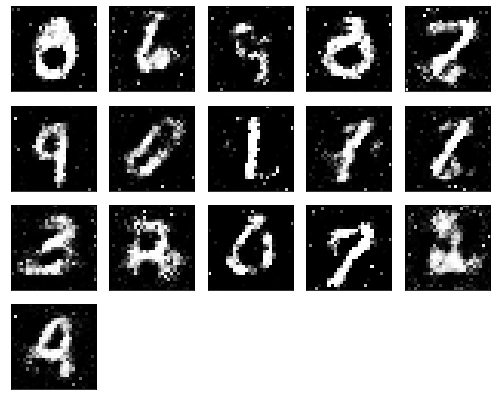

Epochs nb. 3761
discriminator loss: 0.6261141896247864
generator loss : 1.3068591356277466

Epochs nb. 3762
discriminator loss: 0.7124871611595154
generator loss : 1.1374318599700928

Epochs nb. 3763
discriminator loss: 0.5276503562927246
generator loss : 0.901447057723999

Epochs nb. 3764
discriminator loss: 0.6368642449378967
generator loss : 1.1548699140548706

Epochs nb. 3765
discriminator loss: 0.7305350303649902
generator loss : 0.9639263153076172

Epochs nb. 3766
discriminator loss: 0.4994072914123535
generator loss : 0.9568150043487549

Epochs nb. 3767
discriminator loss: 0.6004999279975891
generator loss : 0.9225131869316101

Epochs nb. 3768
discriminator loss: 0.5888553857803345
generator loss : 0.8303819298744202

Epochs nb. 3769
discriminator loss: 0.6078543663024902
generator loss : 1.0564829111099243

Epochs nb. 3770
discriminator loss: 0.5780758857727051
generator loss : 0.8779076337814331



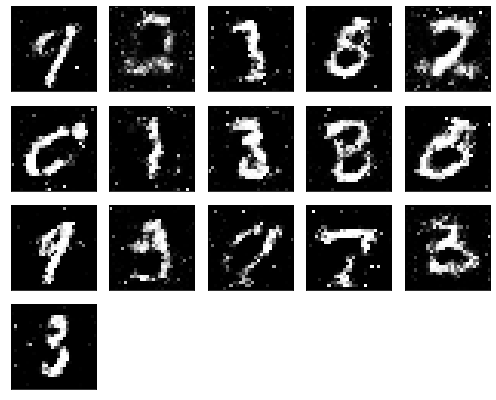

Epochs nb. 3771
discriminator loss: 0.8053414821624756
generator loss : 0.9766443371772766

Epochs nb. 3772
discriminator loss: 0.7714394330978394
generator loss : 0.9590530395507812

Epochs nb. 3773
discriminator loss: 0.5221262574195862
generator loss : 0.9511826634407043

Epochs nb. 3774
discriminator loss: 0.6629979610443115
generator loss : 1.0489060878753662

Epochs nb. 3775
discriminator loss: 0.6769396066665649
generator loss : 1.026329517364502

Epochs nb. 3776
discriminator loss: 0.5374935865402222
generator loss : 1.1226866245269775

Epochs nb. 3777
discriminator loss: 0.5441330671310425
generator loss : 1.0278236865997314

Epochs nb. 3778
discriminator loss: 0.6590920686721802
generator loss : 0.9742264747619629

Epochs nb. 3779
discriminator loss: 0.5147762298583984
generator loss : 0.9107860326766968

Epochs nb. 3780
discriminator loss: 0.7269101142883301
generator loss : 0.93599534034729



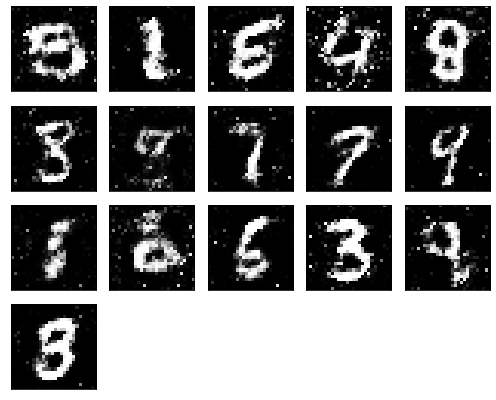

Epochs nb. 3781
discriminator loss: 0.5480424165725708
generator loss : 0.8968980312347412

Epochs nb. 3782
discriminator loss: 0.5643670558929443
generator loss : 1.0171620845794678

Epochs nb. 3783
discriminator loss: 0.6594023108482361
generator loss : 1.0345618724822998

Epochs nb. 3784
discriminator loss: 0.4693872630596161
generator loss : 1.0789554119110107

Epochs nb. 3785
discriminator loss: 0.6016035079956055
generator loss : 1.1867761611938477

Epochs nb. 3786
discriminator loss: 0.47378239035606384
generator loss : 1.0684735774993896

Epochs nb. 3787
discriminator loss: 0.4416500926017761
generator loss : 0.9912620782852173

Epochs nb. 3788
discriminator loss: 0.6210726499557495
generator loss : 1.031390905380249

Epochs nb. 3789
discriminator loss: 0.7242404818534851
generator loss : 0.8095194101333618

Epochs nb. 3790
discriminator loss: 0.7674699425697327
generator loss : 0.8892990350723267



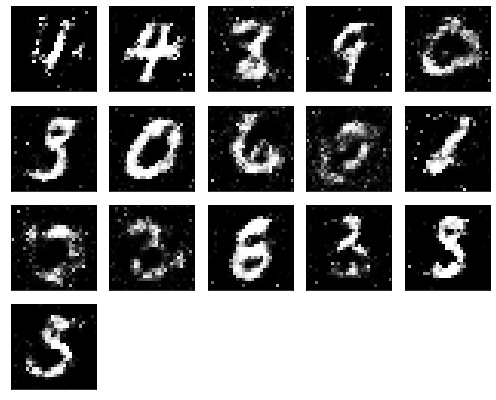

Epochs nb. 3791
discriminator loss: 0.5756998062133789
generator loss : 0.9023745656013489

Epochs nb. 3792
discriminator loss: 0.7184230089187622
generator loss : 0.9300283193588257

Epochs nb. 3793
discriminator loss: 0.6592426300048828
generator loss : 0.8144564628601074

Epochs nb. 3794
discriminator loss: 0.6384545564651489
generator loss : 0.9158338904380798

Epochs nb. 3795
discriminator loss: 0.569930911064148
generator loss : 0.9973773956298828

Epochs nb. 3796
discriminator loss: 0.6184074282646179
generator loss : 1.1065490245819092

Epochs nb. 3797
discriminator loss: 0.6423240900039673
generator loss : 1.261469841003418

Epochs nb. 3798
discriminator loss: 0.5808378458023071
generator loss : 0.8936578631401062

Epochs nb. 3799
discriminator loss: 0.6346407532691956
generator loss : 0.9278437495231628

Epochs nb. 3800
discriminator loss: 0.573408305644989
generator loss : 0.8564906120300293



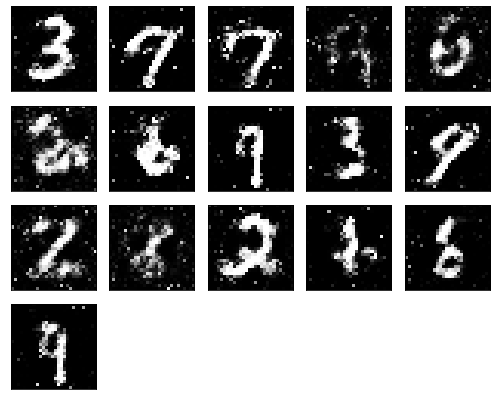

Epochs nb. 3801
discriminator loss: 0.7541229724884033
generator loss : 0.8067021369934082

Epochs nb. 3802
discriminator loss: 0.6915217638015747
generator loss : 0.9378254413604736

Epochs nb. 3803
discriminator loss: 0.6262694597244263
generator loss : 1.1057841777801514

Epochs nb. 3804
discriminator loss: 0.674039363861084
generator loss : 0.9607151746749878

Epochs nb. 3805
discriminator loss: 0.6836444139480591
generator loss : 0.8671137094497681

Epochs nb. 3806
discriminator loss: 0.6337074041366577
generator loss : 0.9922511577606201

Epochs nb. 3807
discriminator loss: 0.5527526140213013
generator loss : 1.0351169109344482

Epochs nb. 3808
discriminator loss: 0.5650491714477539
generator loss : 1.1764767169952393

Epochs nb. 3809
discriminator loss: 0.6891051530838013
generator loss : 1.0760853290557861

Epochs nb. 3810
discriminator loss: 0.5268954038619995
generator loss : 0.9894940257072449



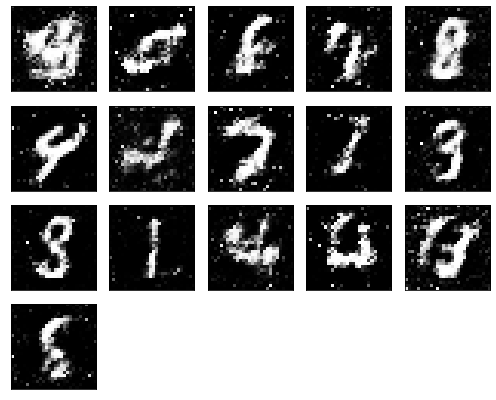

Epochs nb. 3811
discriminator loss: 0.684045672416687
generator loss : 1.1551198959350586

Epochs nb. 3812
discriminator loss: 0.6178202629089355
generator loss : 0.8726723194122314

Epochs nb. 3813
discriminator loss: 0.6137843132019043
generator loss : 1.0339782238006592

Epochs nb. 3814
discriminator loss: 0.746044397354126
generator loss : 0.9290049076080322

Epochs nb. 3815
discriminator loss: 0.6341402530670166
generator loss : 1.1068592071533203

Epochs nb. 3816
discriminator loss: 0.5075621008872986
generator loss : 0.9280394911766052

Epochs nb. 3817
discriminator loss: 0.5941197872161865
generator loss : 0.8386989831924438

Epochs nb. 3818
discriminator loss: 0.6303548216819763
generator loss : 0.9858835935592651

Epochs nb. 3819
discriminator loss: 0.7250939607620239
generator loss : 0.9724016189575195

Epochs nb. 3820
discriminator loss: 0.702735960483551
generator loss : 1.0799031257629395



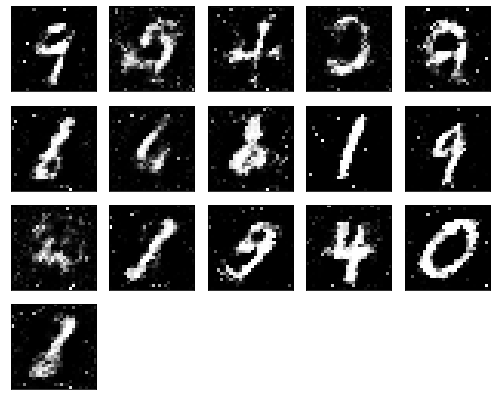

Epochs nb. 3821
discriminator loss: 0.6331335306167603
generator loss : 0.9531136751174927

Epochs nb. 3822
discriminator loss: 0.7389776706695557
generator loss : 1.1357479095458984

Epochs nb. 3823
discriminator loss: 0.6302651166915894
generator loss : 0.9305369853973389

Epochs nb. 3824
discriminator loss: 0.5854684114456177
generator loss : 0.9331482648849487

Epochs nb. 3825
discriminator loss: 0.4734267592430115
generator loss : 1.06685209274292

Epochs nb. 3826
discriminator loss: 0.5660476684570312
generator loss : 1.0215857028961182

Epochs nb. 3827
discriminator loss: 0.6084741353988647
generator loss : 1.020770788192749

Epochs nb. 3828
discriminator loss: 0.5964910984039307
generator loss : 0.9820672273635864

Epochs nb. 3829
discriminator loss: 0.6176720261573792
generator loss : 1.2283363342285156

Epochs nb. 3830
discriminator loss: 0.5492679476737976
generator loss : 1.0252602100372314



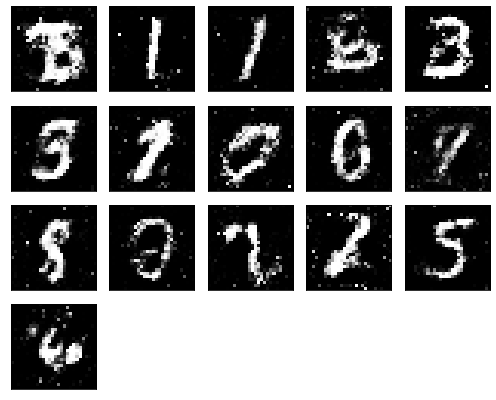

Epochs nb. 3831
discriminator loss: 0.5480862855911255
generator loss : 1.153510332107544

Epochs nb. 3832
discriminator loss: 0.5772239565849304
generator loss : 0.9472376108169556

Epochs nb. 3833
discriminator loss: 0.7429317235946655
generator loss : 0.9401581287384033

Epochs nb. 3834
discriminator loss: 0.5883569717407227
generator loss : 0.9615310430526733

Epochs nb. 3835
discriminator loss: 0.5697929263114929
generator loss : 0.8435221910476685

Epochs nb. 3836
discriminator loss: 0.4280744791030884
generator loss : 1.0089441537857056

Epochs nb. 3837
discriminator loss: 0.636119544506073
generator loss : 1.147417664527893

Epochs nb. 3838
discriminator loss: 0.5573714971542358
generator loss : 0.8868709802627563

Epochs nb. 3839
discriminator loss: 0.5034850835800171
generator loss : 0.8991785049438477

Epochs nb. 3840
discriminator loss: 0.6606504917144775
generator loss : 0.9084526896476746



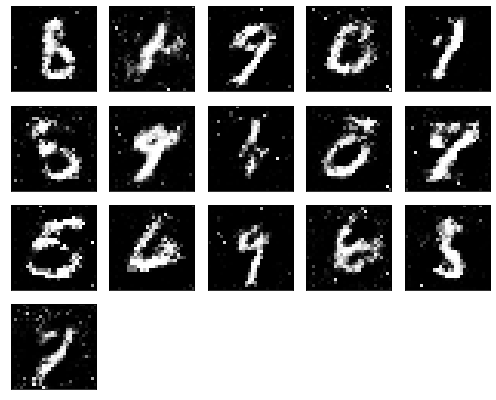

Epochs nb. 3841
discriminator loss: 0.6408988237380981
generator loss : 1.0508904457092285

Epochs nb. 3842
discriminator loss: 0.5841271877288818
generator loss : 0.9657787680625916

Epochs nb. 3843
discriminator loss: 0.6132189631462097
generator loss : 0.8635164499282837

Epochs nb. 3844
discriminator loss: 0.6726587414741516
generator loss : 0.9316977262496948

Epochs nb. 3845
discriminator loss: 0.6110016703605652
generator loss : 0.995952844619751

Epochs nb. 3846
discriminator loss: 0.5746225118637085
generator loss : 0.8917815089225769

Epochs nb. 3847
discriminator loss: 0.5809098482131958
generator loss : 0.7624500393867493

Epochs nb. 3848
discriminator loss: 0.5585155487060547
generator loss : 0.9099282026290894

Epochs nb. 3849
discriminator loss: 0.5274284482002258
generator loss : 1.0547513961791992

Epochs nb. 3850
discriminator loss: 0.6561304330825806
generator loss : 1.1401290893554688



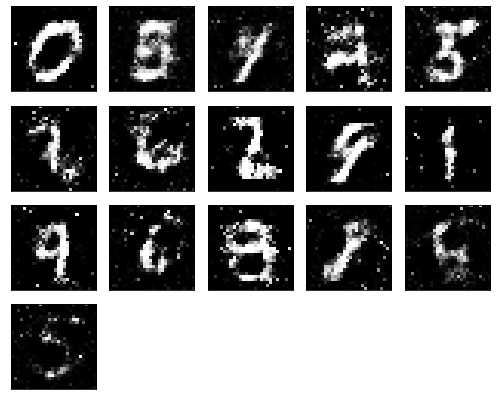

Epochs nb. 3851
discriminator loss: 0.5139925479888916
generator loss : 1.040401816368103

Epochs nb. 3852
discriminator loss: 0.6371128559112549
generator loss : 0.9622296094894409

Epochs nb. 3853
discriminator loss: 0.47536277770996094
generator loss : 1.152787685394287

Epochs nb. 3854
discriminator loss: 0.6887490749359131
generator loss : 1.0677952766418457

Epochs nb. 3855
discriminator loss: 0.6076374053955078
generator loss : 1.0147192478179932

Epochs nb. 3856
discriminator loss: 0.5344873666763306
generator loss : 1.061657190322876

Epochs nb. 3857
discriminator loss: 0.6307125687599182
generator loss : 0.825363278388977

Epochs nb. 3858
discriminator loss: 0.72449791431427
generator loss : 1.0357651710510254

Epochs nb. 3859
discriminator loss: 0.7222765684127808
generator loss : 0.9358654618263245

Epochs nb. 3860
discriminator loss: 0.7403366565704346
generator loss : 0.9834880828857422



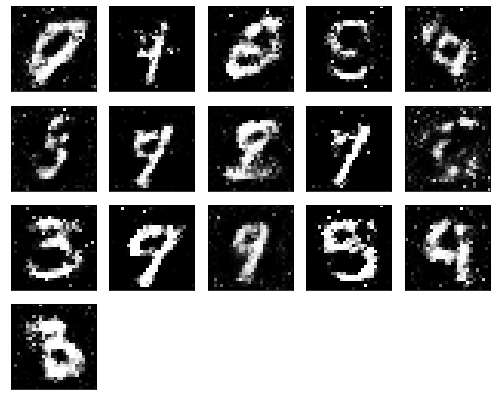

Epochs nb. 3861
discriminator loss: 0.5851946473121643
generator loss : 0.9881445169448853

Epochs nb. 3862
discriminator loss: 0.7053957581520081
generator loss : 1.063870906829834

Epochs nb. 3863
discriminator loss: 0.696089506149292
generator loss : 0.9483011960983276

Epochs nb. 3864
discriminator loss: 0.5224422812461853
generator loss : 1.0504326820373535

Epochs nb. 3865
discriminator loss: 0.6804883480072021
generator loss : 0.9484814405441284

Epochs nb. 3866
discriminator loss: 0.6065643429756165
generator loss : 1.0446577072143555

Epochs nb. 3867
discriminator loss: 0.6340470314025879
generator loss : 1.0075222253799438

Epochs nb. 3868
discriminator loss: 0.598798930644989
generator loss : 1.192509651184082

Epochs nb. 3869
discriminator loss: 0.5786539316177368
generator loss : 0.9471967816352844

Epochs nb. 3870
discriminator loss: 0.6348464488983154
generator loss : 1.1538622379302979



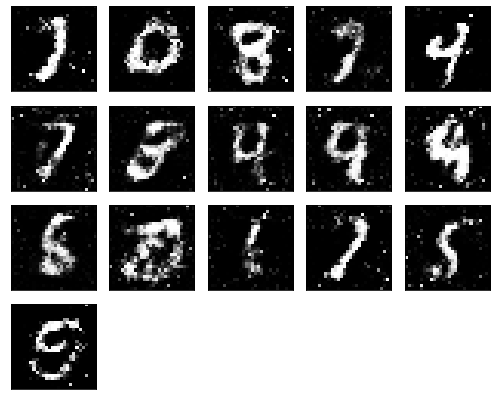

Epochs nb. 3871
discriminator loss: 0.658442497253418
generator loss : 1.1588501930236816

Epochs nb. 3872
discriminator loss: 0.48435813188552856
generator loss : 0.9944908618927002

Epochs nb. 3873
discriminator loss: 0.5292583107948303
generator loss : 1.053669810295105

Epochs nb. 3874
discriminator loss: 0.5517850518226624
generator loss : 1.0297439098358154

Epochs nb. 3875
discriminator loss: 0.6700997352600098
generator loss : 0.8951380252838135

Epochs nb. 3876
discriminator loss: 0.6234884262084961
generator loss : 0.9469718337059021

Epochs nb. 3877
discriminator loss: 0.5055148601531982
generator loss : 0.8246818780899048

Epochs nb. 3878
discriminator loss: 0.6043882369995117
generator loss : 0.947718620300293

Epochs nb. 3879
discriminator loss: 0.7322489619255066
generator loss : 1.026090145111084

Epochs nb. 3880
discriminator loss: 0.6388697624206543
generator loss : 0.9915047883987427



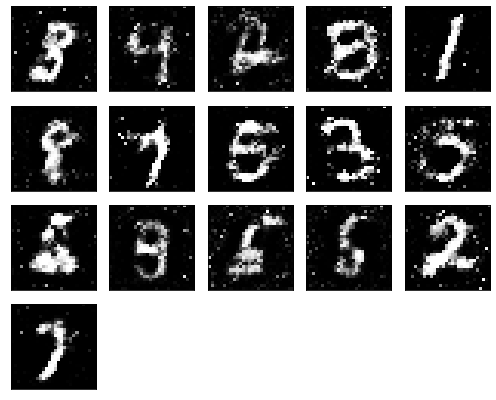

Epochs nb. 3881
discriminator loss: 0.5739448070526123
generator loss : 0.9474817514419556

Epochs nb. 3882
discriminator loss: 0.5526270866394043
generator loss : 1.0748445987701416

Epochs nb. 3883
discriminator loss: 0.5661051273345947
generator loss : 1.0433008670806885

Epochs nb. 3884
discriminator loss: 0.6116330027580261
generator loss : 1.046656608581543

Epochs nb. 3885
discriminator loss: 0.48269206285476685
generator loss : 1.0804367065429688

Epochs nb. 3886
discriminator loss: 0.6465529203414917
generator loss : 0.972564160823822

Epochs nb. 3887
discriminator loss: 0.6043145656585693
generator loss : 0.9513482451438904

Epochs nb. 3888
discriminator loss: 0.5538463592529297
generator loss : 0.9011834859848022

Epochs nb. 3889
discriminator loss: 0.5644930005073547
generator loss : 0.8365492820739746

Epochs nb. 3890
discriminator loss: 0.5485130548477173
generator loss : 0.7825031280517578



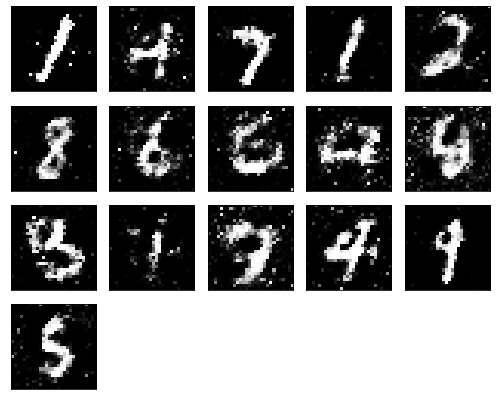

Epochs nb. 3891
discriminator loss: 0.5515562295913696
generator loss : 0.9172514081001282

Epochs nb. 3892
discriminator loss: 0.4980238080024719
generator loss : 0.702417254447937

Epochs nb. 3893
discriminator loss: 0.6391377449035645
generator loss : 0.8964074850082397

Epochs nb. 3894
discriminator loss: 0.6225744485855103
generator loss : 1.0111024379730225

Epochs nb. 3895
discriminator loss: 0.6499610543251038
generator loss : 1.0372748374938965

Epochs nb. 3896
discriminator loss: 0.5330241918563843
generator loss : 0.8946253061294556

Epochs nb. 3897
discriminator loss: 0.5603161454200745
generator loss : 1.025166630744934

Epochs nb. 3898
discriminator loss: 0.5961679220199585
generator loss : 0.9306275844573975

Epochs nb. 3899
discriminator loss: 0.6433256268501282
generator loss : 1.0404595136642456

Epochs nb. 3900
discriminator loss: 0.6022906303405762
generator loss : 1.0714850425720215



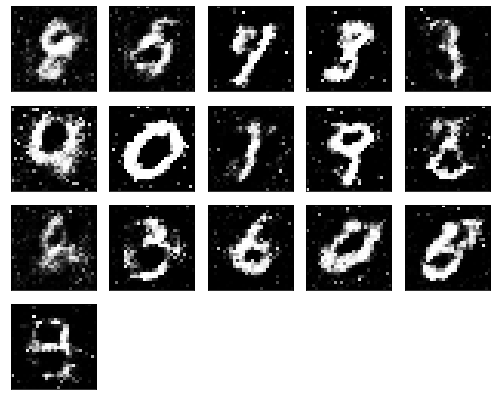

Epochs nb. 3901
discriminator loss: 0.6794098615646362
generator loss : 0.9543619155883789

Epochs nb. 3902
discriminator loss: 0.6703422665596008
generator loss : 1.142441987991333

Epochs nb. 3903
discriminator loss: 0.6023287773132324
generator loss : 0.920168399810791

Epochs nb. 3904
discriminator loss: 0.7148066163063049
generator loss : 0.9166109561920166

Epochs nb. 3905
discriminator loss: 0.7083544731140137
generator loss : 1.0673367977142334

Epochs nb. 3906
discriminator loss: 0.6148739457130432
generator loss : 0.941866934299469

Epochs nb. 3907
discriminator loss: 0.5568739175796509
generator loss : 0.8263304829597473

Epochs nb. 3908
discriminator loss: 0.5963283181190491
generator loss : 0.9610989093780518

Epochs nb. 3909
discriminator loss: 0.6539565324783325
generator loss : 1.0934298038482666

Epochs nb. 3910
discriminator loss: 0.569341778755188
generator loss : 1.051730990409851



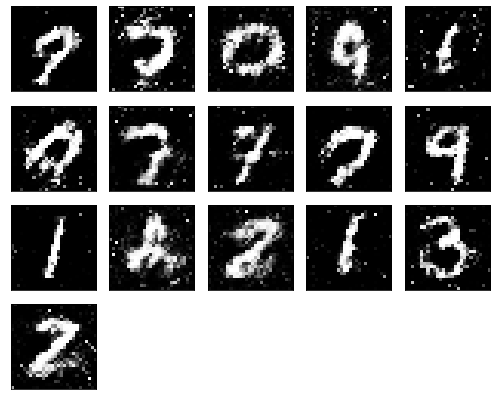

Epochs nb. 3911
discriminator loss: 0.5980818271636963
generator loss : 1.037773609161377

Epochs nb. 3912
discriminator loss: 0.653755247592926
generator loss : 1.0184240341186523

Epochs nb. 3913
discriminator loss: 0.5226211547851562
generator loss : 0.8880589604377747

Epochs nb. 3914
discriminator loss: 0.5994451642036438
generator loss : 1.0177149772644043

Epochs nb. 3915
discriminator loss: 0.5317102670669556
generator loss : 0.9778181314468384

Epochs nb. 3916
discriminator loss: 0.7271120548248291
generator loss : 0.9527963995933533

Epochs nb. 3917
discriminator loss: 0.6593130826950073
generator loss : 1.0105060338974

Epochs nb. 3918
discriminator loss: 0.5707284212112427
generator loss : 0.8795387744903564

Epochs nb. 3919
discriminator loss: 0.5533699989318848
generator loss : 0.9196887016296387

Epochs nb. 3920
discriminator loss: 0.6129306554794312
generator loss : 1.0221683979034424



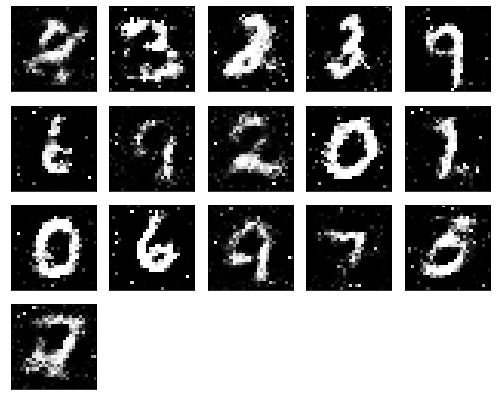

Epochs nb. 3921
discriminator loss: 0.6077665686607361
generator loss : 0.9621707201004028

Epochs nb. 3922
discriminator loss: 0.5483987331390381
generator loss : 0.8777257204055786

Epochs nb. 3923
discriminator loss: 0.6959072947502136
generator loss : 0.9373083114624023

Epochs nb. 3924
discriminator loss: 0.5885870456695557
generator loss : 0.88761305809021

Epochs nb. 3925
discriminator loss: 0.704403281211853
generator loss : 1.0086700916290283

Epochs nb. 3926
discriminator loss: 0.5063676834106445
generator loss : 1.062002182006836

Epochs nb. 3927
discriminator loss: 0.678167998790741
generator loss : 0.9279911518096924

Epochs nb. 3928
discriminator loss: 0.5465501546859741
generator loss : 0.7970012426376343

Epochs nb. 3929
discriminator loss: 0.7083252668380737
generator loss : 0.9058844447135925

Epochs nb. 3930
discriminator loss: 0.5317012667655945
generator loss : 0.9295523762702942



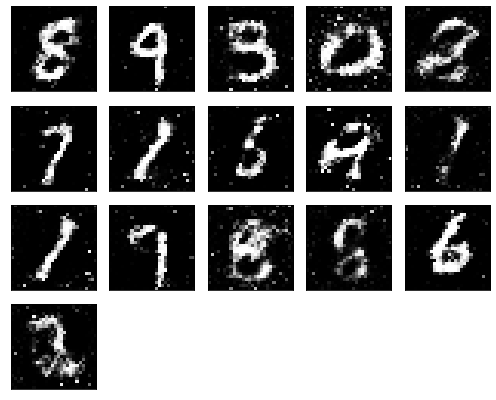

Epochs nb. 3931
discriminator loss: 0.6764405965805054
generator loss : 0.8666150569915771

Epochs nb. 3932
discriminator loss: 0.5593671798706055
generator loss : 0.8402167558670044

Epochs nb. 3933
discriminator loss: 0.6583467721939087
generator loss : 0.9238417148590088

Epochs nb. 3934
discriminator loss: 0.5118269324302673
generator loss : 1.0707029104232788

Epochs nb. 3935
discriminator loss: 0.6654998660087585
generator loss : 0.905856728553772

Epochs nb. 3936
discriminator loss: 0.5472826957702637
generator loss : 0.8986936211585999

Epochs nb. 3937
discriminator loss: 0.5590224266052246
generator loss : 0.9246576428413391

Epochs nb. 3938
discriminator loss: 0.4777742028236389
generator loss : 0.9577464461326599

Epochs nb. 3939
discriminator loss: 0.6484495401382446
generator loss : 1.021581768989563

Epochs nb. 3940
discriminator loss: 0.6333086490631104
generator loss : 1.2162785530090332



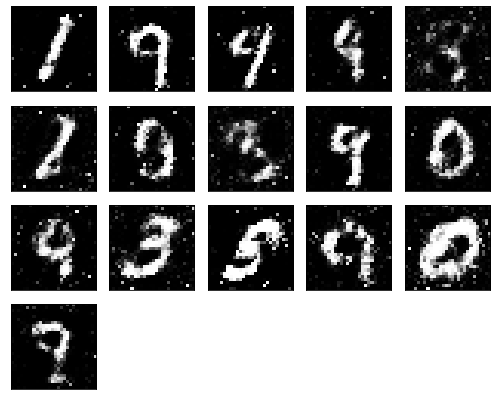

Epochs nb. 3941
discriminator loss: 0.6328314542770386
generator loss : 0.9721897840499878

Epochs nb. 3942
discriminator loss: 0.6605658531188965
generator loss : 1.0278699398040771

Epochs nb. 3943
discriminator loss: 0.5366493463516235
generator loss : 0.8927569389343262

Epochs nb. 3944
discriminator loss: 0.6094338893890381
generator loss : 1.1723384857177734

Epochs nb. 3945
discriminator loss: 0.6328369379043579
generator loss : 1.0269138813018799

Epochs nb. 3946
discriminator loss: 0.5368514060974121
generator loss : 0.9761149883270264

Epochs nb. 3947
discriminator loss: 0.4684060215950012
generator loss : 0.8163321018218994

Epochs nb. 3948
discriminator loss: 0.5082942247390747
generator loss : 0.9242125153541565

Epochs nb. 3949
discriminator loss: 0.5623694658279419
generator loss : 1.0118110179901123

Epochs nb. 3950
discriminator loss: 0.4419083595275879
generator loss : 1.0691663026809692



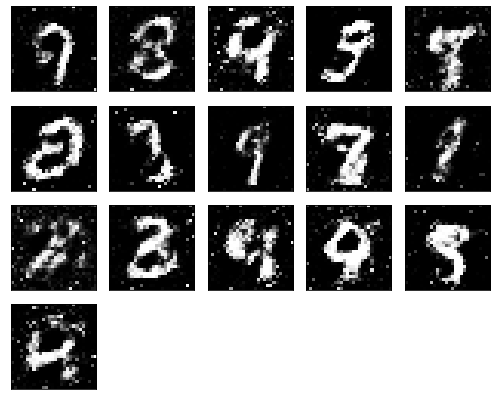

Epochs nb. 3951
discriminator loss: 0.4900643825531006
generator loss : 1.0907434225082397

Epochs nb. 3952
discriminator loss: 0.7222192883491516
generator loss : 1.1173710823059082

Epochs nb. 3953
discriminator loss: 0.5217363238334656
generator loss : 1.1400641202926636

Epochs nb. 3954
discriminator loss: 0.6350463628768921
generator loss : 1.0581793785095215

Epochs nb. 3955
discriminator loss: 0.6254324913024902
generator loss : 0.9769633412361145

Epochs nb. 3956
discriminator loss: 0.6649625897407532
generator loss : 1.1425626277923584

Epochs nb. 3957
discriminator loss: 0.5768901705741882
generator loss : 1.1131764650344849

Epochs nb. 3958
discriminator loss: 0.6190910339355469
generator loss : 0.955010712146759

Epochs nb. 3959
discriminator loss: 0.6019022464752197
generator loss : 0.9415227174758911

Epochs nb. 3960
discriminator loss: 0.6017488241195679
generator loss : 1.0613771677017212



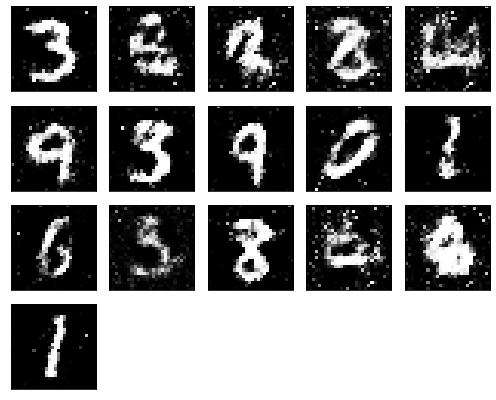

Epochs nb. 3961
discriminator loss: 0.544536828994751
generator loss : 0.9980241656303406

Epochs nb. 3962
discriminator loss: 0.5582658052444458
generator loss : 1.1439892053604126

Epochs nb. 3963
discriminator loss: 0.49296778440475464
generator loss : 0.9723002910614014

Epochs nb. 3964
discriminator loss: 0.5157474279403687
generator loss : 0.9558485150337219

Epochs nb. 3965
discriminator loss: 0.5623534321784973
generator loss : 0.9970517158508301

Epochs nb. 3966
discriminator loss: 0.6204564571380615
generator loss : 1.1269497871398926

Epochs nb. 3967
discriminator loss: 0.6194759607315063
generator loss : 1.0520507097244263

Epochs nb. 3968
discriminator loss: 0.6611399054527283
generator loss : 1.0354387760162354

Epochs nb. 3969
discriminator loss: 0.5178203582763672
generator loss : 0.9470968842506409

Epochs nb. 3970
discriminator loss: 0.5330907106399536
generator loss : 1.1319429874420166



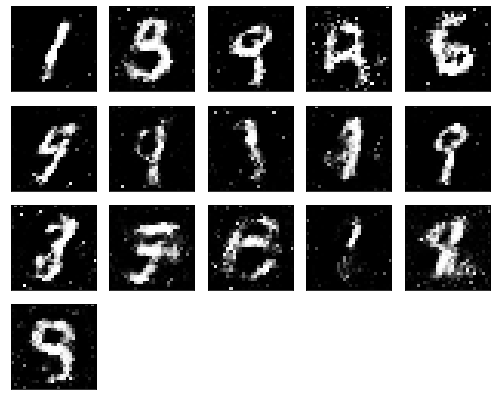

Epochs nb. 3971
discriminator loss: 0.615065336227417
generator loss : 1.1169878244400024

Epochs nb. 3972
discriminator loss: 0.6447029113769531
generator loss : 1.083057165145874

Epochs nb. 3973
discriminator loss: 0.559090793132782
generator loss : 1.0024354457855225

Epochs nb. 3974
discriminator loss: 0.555328369140625
generator loss : 0.8765816688537598

Epochs nb. 3975
discriminator loss: 0.6267380118370056
generator loss : 1.0109944343566895

Epochs nb. 3976
discriminator loss: 0.544153094291687
generator loss : 1.0902392864227295

Epochs nb. 3977
discriminator loss: 0.48251646757125854
generator loss : 1.033450722694397

Epochs nb. 3978
discriminator loss: 0.5509042143821716
generator loss : 0.998001754283905

Epochs nb. 3979
discriminator loss: 0.5943448543548584
generator loss : 0.9211470484733582

Epochs nb. 3980
discriminator loss: 0.6168200969696045
generator loss : 0.9688603281974792



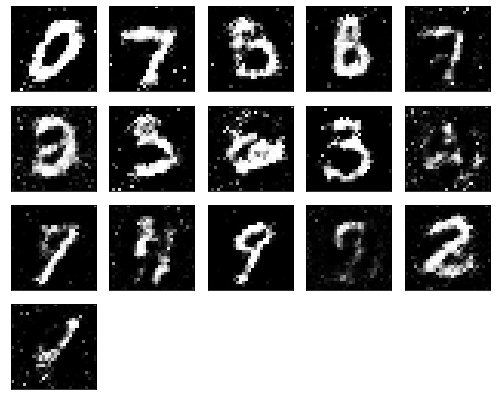

Epochs nb. 3981
discriminator loss: 0.6368328332901001
generator loss : 0.9529433846473694

Epochs nb. 3982
discriminator loss: 0.5020487308502197
generator loss : 0.9259693026542664

Epochs nb. 3983
discriminator loss: 0.5319379568099976
generator loss : 0.9954243898391724

Epochs nb. 3984
discriminator loss: 0.6132272481918335
generator loss : 1.0395883321762085

Epochs nb. 3985
discriminator loss: 0.5929795503616333
generator loss : 0.8918666839599609

Epochs nb. 3986
discriminator loss: 0.6511192321777344
generator loss : 0.8771824240684509

Epochs nb. 3987
discriminator loss: 0.5026265382766724
generator loss : 0.953830361366272

Epochs nb. 3988
discriminator loss: 0.5448979735374451
generator loss : 1.007798194885254

Epochs nb. 3989
discriminator loss: 0.5090813636779785
generator loss : 0.9838378429412842

Epochs nb. 3990
discriminator loss: 0.6986748576164246
generator loss : 1.0749239921569824



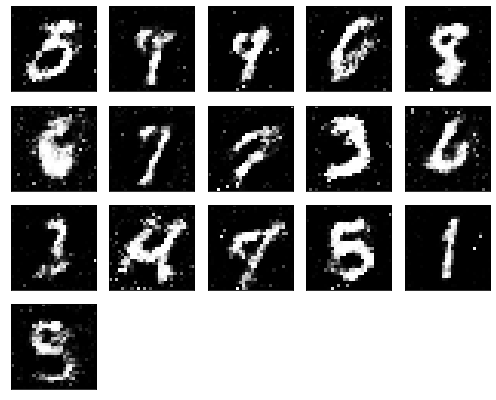

Epochs nb. 3991
discriminator loss: 0.5730428695678711
generator loss : 0.894304633140564

Epochs nb. 3992
discriminator loss: 0.6730746030807495
generator loss : 0.9051490426063538

Epochs nb. 3993
discriminator loss: 0.5911573171615601
generator loss : 0.9460138082504272

Epochs nb. 3994
discriminator loss: 0.5790538787841797
generator loss : 0.8897169828414917

Epochs nb. 3995
discriminator loss: 0.5162104368209839
generator loss : 0.9613950252532959

Epochs nb. 3996
discriminator loss: 0.6019779443740845
generator loss : 1.053044080734253

Epochs nb. 3997
discriminator loss: 0.5441898107528687
generator loss : 1.2138783931732178

Epochs nb. 3998
discriminator loss: 0.6189640760421753
generator loss : 1.0213963985443115

Epochs nb. 3999
discriminator loss: 0.5250301957130432
generator loss : 0.9697698354721069

Epochs nb. 4000
discriminator loss: 0.5509625673294067
generator loss : 1.0201667547225952



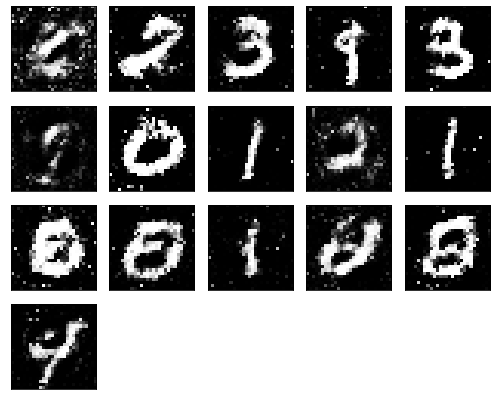

Epochs nb. 4001
discriminator loss: 0.6263009309768677
generator loss : 0.9802228808403015

Epochs nb. 4002
discriminator loss: 0.537511944770813
generator loss : 1.0105502605438232

Epochs nb. 4003
discriminator loss: 0.6699690818786621
generator loss : 0.9533845782279968

Epochs nb. 4004
discriminator loss: 0.6322511434555054
generator loss : 0.8602081537246704

Epochs nb. 4005
discriminator loss: 0.5496547222137451
generator loss : 0.8766113519668579

Epochs nb. 4006
discriminator loss: 0.6474488973617554
generator loss : 0.8688704967498779

Epochs nb. 4007
discriminator loss: 0.6507382392883301
generator loss : 1.0697040557861328

Epochs nb. 4008
discriminator loss: 0.6055514216423035
generator loss : 1.0281672477722168

Epochs nb. 4009
discriminator loss: 0.523159384727478
generator loss : 1.249233365058899

Epochs nb. 4010
discriminator loss: 0.6643810272216797
generator loss : 0.8969331383705139



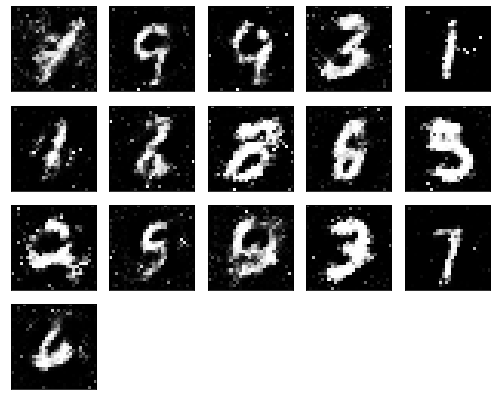

Epochs nb. 4011
discriminator loss: 0.6066087484359741
generator loss : 1.1222773790359497

Epochs nb. 4012
discriminator loss: 0.6830109357833862
generator loss : 1.0363335609436035

Epochs nb. 4013
discriminator loss: 0.5990878939628601
generator loss : 1.0536469221115112

Epochs nb. 4014
discriminator loss: 0.5662521123886108
generator loss : 0.7526756525039673

Epochs nb. 4015
discriminator loss: 0.5735815167427063
generator loss : 0.9259281158447266

Epochs nb. 4016
discriminator loss: 0.4856165051460266
generator loss : 1.0732229948043823

Epochs nb. 4017
discriminator loss: 0.6082285046577454
generator loss : 0.8646120429039001

Epochs nb. 4018
discriminator loss: 0.6331707835197449
generator loss : 0.9928284883499146

Epochs nb. 4019
discriminator loss: 0.4496423304080963
generator loss : 1.1024622917175293

Epochs nb. 4020
discriminator loss: 0.6145680546760559
generator loss : 1.123805284500122



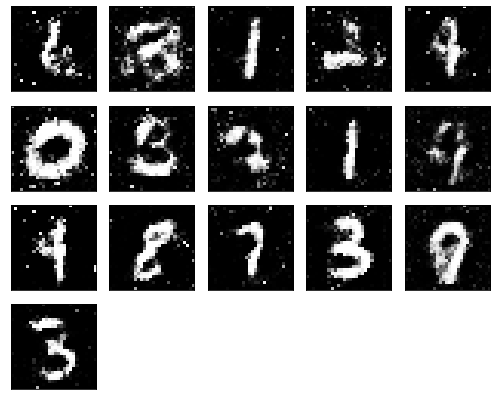

Epochs nb. 4021
discriminator loss: 0.5604671239852905
generator loss : 1.1595301628112793

Epochs nb. 4022
discriminator loss: 0.5955023169517517
generator loss : 1.105342149734497

Epochs nb. 4023
discriminator loss: 0.6064579486846924
generator loss : 1.0267442464828491

Epochs nb. 4024
discriminator loss: 0.6143691539764404
generator loss : 0.9857374429702759

Epochs nb. 4025
discriminator loss: 0.5367067456245422
generator loss : 0.978699803352356

Epochs nb. 4026
discriminator loss: 0.560658872127533
generator loss : 0.9011699557304382

Epochs nb. 4027
discriminator loss: 0.7200299501419067
generator loss : 1.014626383781433

Epochs nb. 4028
discriminator loss: 0.6516954898834229
generator loss : 0.8008350729942322

Epochs nb. 4029
discriminator loss: 0.6830297112464905
generator loss : 0.8090955018997192

Epochs nb. 4030
discriminator loss: 0.5675022602081299
generator loss : 0.9894291758537292



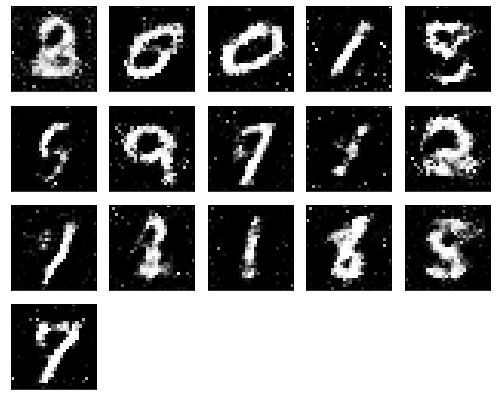

Epochs nb. 4031
discriminator loss: 0.6670295000076294
generator loss : 1.0070304870605469

Epochs nb. 4032
discriminator loss: 0.6135326623916626
generator loss : 0.7760106325149536

Epochs nb. 4033
discriminator loss: 0.6341209411621094
generator loss : 0.9396475553512573

Epochs nb. 4034
discriminator loss: 0.6958895921707153
generator loss : 1.0645556449890137

Epochs nb. 4035
discriminator loss: 0.4948282837867737
generator loss : 1.132777452468872

Epochs nb. 4036
discriminator loss: 0.5626291632652283
generator loss : 0.9790471792221069

Epochs nb. 4037
discriminator loss: 0.5721879005432129
generator loss : 1.1431915760040283

Epochs nb. 4038
discriminator loss: 0.6179230213165283
generator loss : 1.1075338125228882

Epochs nb. 4039
discriminator loss: 0.6021605730056763
generator loss : 1.091453194618225

Epochs nb. 4040
discriminator loss: 0.6163610219955444
generator loss : 0.9645096063613892



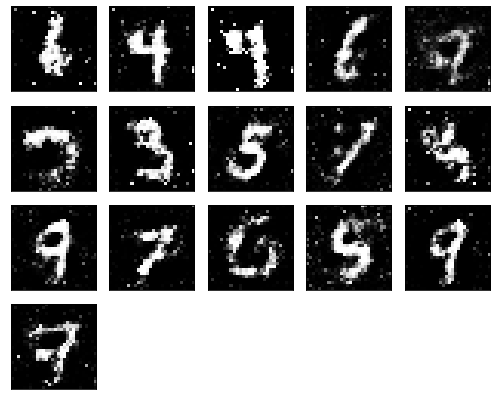

Epochs nb. 4041
discriminator loss: 0.6072986721992493
generator loss : 1.0804065465927124

Epochs nb. 4042
discriminator loss: 0.5725165605545044
generator loss : 0.9823106527328491

Epochs nb. 4043
discriminator loss: 0.5012166500091553
generator loss : 0.9473209977149963

Epochs nb. 4044
discriminator loss: 0.4522669315338135
generator loss : 0.8848536610603333

Epochs nb. 4045
discriminator loss: 0.6155800819396973
generator loss : 1.0623819828033447

Epochs nb. 4046
discriminator loss: 0.6418917775154114
generator loss : 0.9829221367835999

Epochs nb. 4047
discriminator loss: 0.5731781721115112
generator loss : 0.7793912887573242

Epochs nb. 4048
discriminator loss: 0.7339946031570435
generator loss : 1.1026209592819214

Epochs nb. 4049
discriminator loss: 0.5853352546691895
generator loss : 0.9147496223449707

Epochs nb. 4050
discriminator loss: 0.5425066947937012
generator loss : 1.063425064086914



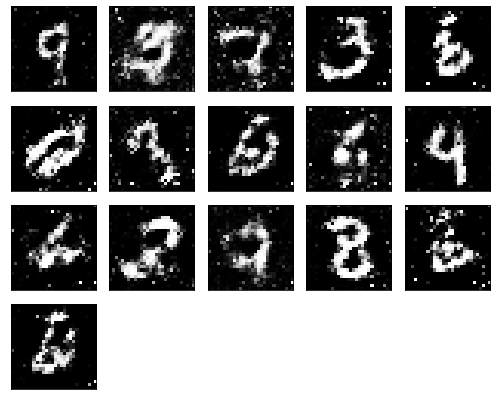

Epochs nb. 4051
discriminator loss: 0.6360533833503723
generator loss : 1.082661509513855

Epochs nb. 4052
discriminator loss: 0.5406321883201599
generator loss : 0.9768389463424683

Epochs nb. 4053
discriminator loss: 0.682809591293335
generator loss : 0.7210860252380371

Epochs nb. 4054
discriminator loss: 0.5800884366035461
generator loss : 0.9323234558105469

Epochs nb. 4055
discriminator loss: 0.6853723526000977
generator loss : 1.0984199047088623

Epochs nb. 4056
discriminator loss: 0.5880784392356873
generator loss : 1.0801939964294434

Epochs nb. 4057
discriminator loss: 0.5893381834030151
generator loss : 0.9473583698272705

Epochs nb. 4058
discriminator loss: 0.6570457220077515
generator loss : 0.9725763201713562

Epochs nb. 4059
discriminator loss: 0.5993229150772095
generator loss : 0.9581882953643799

Epochs nb. 4060
discriminator loss: 0.5180674195289612
generator loss : 0.9943265914916992



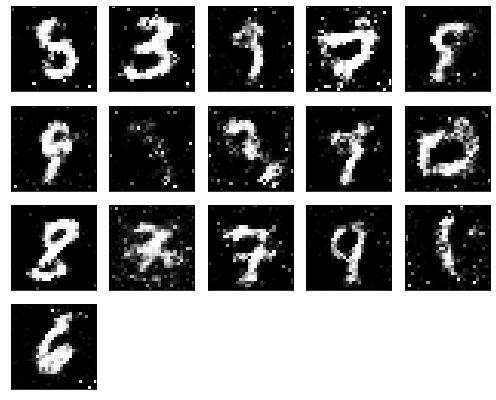

Epochs nb. 4061
discriminator loss: 0.5639581084251404
generator loss : 0.918769359588623

Epochs nb. 4062
discriminator loss: 0.5609031319618225
generator loss : 0.826512336730957

Epochs nb. 4063
discriminator loss: 0.5742918848991394
generator loss : 0.921764612197876

Epochs nb. 4064
discriminator loss: 0.5049030184745789
generator loss : 0.9399459362030029

Epochs nb. 4065
discriminator loss: 0.7236288189888
generator loss : 1.0214303731918335

Epochs nb. 4066
discriminator loss: 0.634440541267395
generator loss : 1.0175693035125732

Epochs nb. 4067
discriminator loss: 0.7191686630249023
generator loss : 0.9145655632019043

Epochs nb. 4068
discriminator loss: 0.6542530059814453
generator loss : 0.7748190760612488

Epochs nb. 4069
discriminator loss: 0.583520233631134
generator loss : 0.8729931116104126

Epochs nb. 4070
discriminator loss: 0.6287305355072021
generator loss : 0.9687041640281677



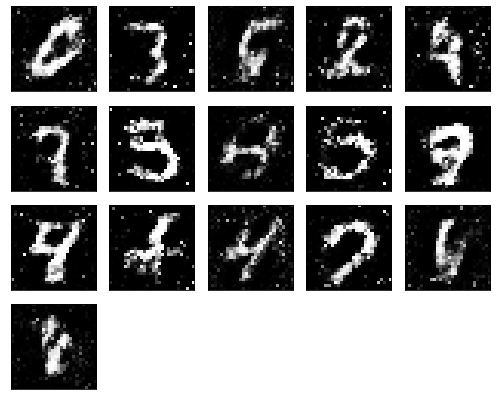

Epochs nb. 4071
discriminator loss: 0.6847403049468994
generator loss : 1.0872807502746582

Epochs nb. 4072
discriminator loss: 0.588431715965271
generator loss : 0.8883663415908813

Epochs nb. 4073
discriminator loss: 0.726993203163147
generator loss : 0.8296003341674805

Epochs nb. 4074
discriminator loss: 0.6010782718658447
generator loss : 1.011992335319519

Epochs nb. 4075
discriminator loss: 0.5937191247940063
generator loss : 0.8315020799636841

Epochs nb. 4076
discriminator loss: 0.5770539045333862
generator loss : 1.0199024677276611

Epochs nb. 4077
discriminator loss: 0.5611158609390259
generator loss : 1.0336499214172363

Epochs nb. 4078
discriminator loss: 0.5976783037185669
generator loss : 1.1182827949523926

Epochs nb. 4079
discriminator loss: 0.5668633580207825
generator loss : 1.1252014636993408

Epochs nb. 4080
discriminator loss: 0.6120738983154297
generator loss : 0.8803461194038391



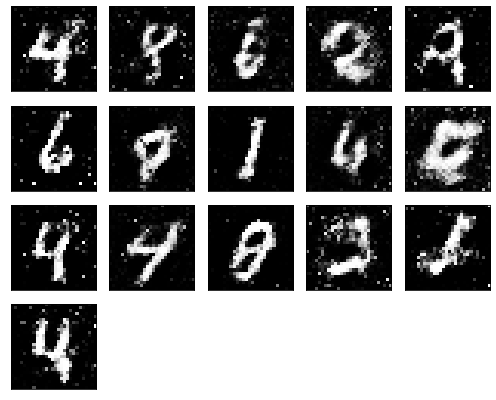

Epochs nb. 4081
discriminator loss: 0.6149581670761108
generator loss : 0.9352169036865234

Epochs nb. 4082
discriminator loss: 0.4902265667915344
generator loss : 0.8843810558319092

Epochs nb. 4083
discriminator loss: 0.6801185011863708
generator loss : 0.8268938064575195

Epochs nb. 4084
discriminator loss: 0.7901996374130249
generator loss : 0.9813005328178406

Epochs nb. 4085
discriminator loss: 0.6996078491210938
generator loss : 0.9352703094482422

Epochs nb. 4086
discriminator loss: 0.504150390625
generator loss : 0.9526331424713135

Epochs nb. 4087
discriminator loss: 0.6246323585510254
generator loss : 0.843847393989563

Epochs nb. 4088
discriminator loss: 0.38473114371299744
generator loss : 0.7907185554504395

Epochs nb. 4089
discriminator loss: 0.5253846645355225
generator loss : 1.0361303091049194

Epochs nb. 4090
discriminator loss: 0.5366075038909912
generator loss : 0.9048740863800049



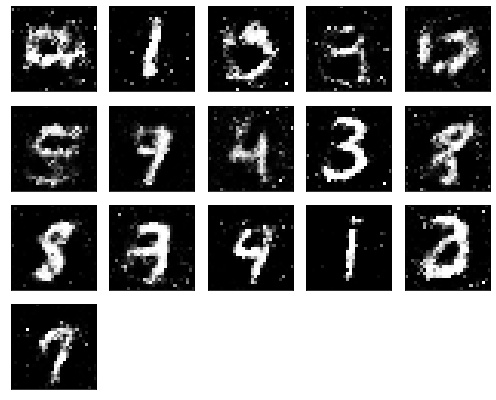

Epochs nb. 4091
discriminator loss: 0.6845791935920715
generator loss : 0.9249523878097534

Epochs nb. 4092
discriminator loss: 0.6206507682800293
generator loss : 0.9286894202232361

Epochs nb. 4093
discriminator loss: 0.4918782711029053
generator loss : 0.8177380561828613

Epochs nb. 4094
discriminator loss: 0.7786783576011658
generator loss : 0.7910081744194031

Epochs nb. 4095
discriminator loss: 0.6759794354438782
generator loss : 0.8286107182502747

Epochs nb. 4096
discriminator loss: 0.6994529962539673
generator loss : 0.6922607421875

Epochs nb. 4097
discriminator loss: 0.6299066543579102
generator loss : 0.7800866365432739

Epochs nb. 4098
discriminator loss: 0.5231364369392395
generator loss : 0.8915182948112488

Epochs nb. 4099
discriminator loss: 0.62693190574646
generator loss : 0.7709324955940247

Epochs nb. 4100
discriminator loss: 0.6288584470748901
generator loss : 1.0901613235473633



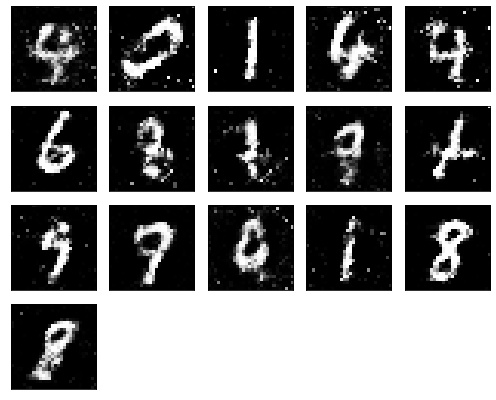

Epochs nb. 4101
discriminator loss: 0.570499062538147
generator loss : 1.023101806640625

Epochs nb. 4102
discriminator loss: 0.6491304636001587
generator loss : 0.9772803783416748

Epochs nb. 4103
discriminator loss: 0.579829752445221
generator loss : 0.9171890020370483

Epochs nb. 4104
discriminator loss: 0.7220048904418945
generator loss : 1.0433851480484009

Epochs nb. 4105
discriminator loss: 0.5420295000076294
generator loss : 0.9494065046310425

Epochs nb. 4106
discriminator loss: 0.5994107723236084
generator loss : 0.8893346786499023

Epochs nb. 4107
discriminator loss: 0.5865362882614136
generator loss : 0.9448499083518982

Epochs nb. 4108
discriminator loss: 0.697957456111908
generator loss : 0.9370279312133789

Epochs nb. 4109
discriminator loss: 0.6989668607711792
generator loss : 1.1164007186889648

Epochs nb. 4110
discriminator loss: 0.5668960809707642
generator loss : 1.036057710647583



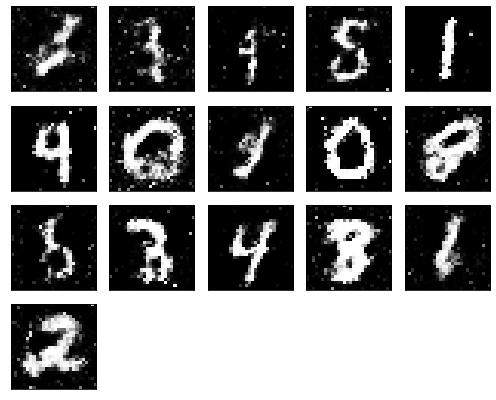

Epochs nb. 4111
discriminator loss: 0.6500654816627502
generator loss : 0.8910098075866699

Epochs nb. 4112
discriminator loss: 0.6745792031288147
generator loss : 0.8416417241096497

Epochs nb. 4113
discriminator loss: 0.5129241943359375
generator loss : 0.9183233976364136

Epochs nb. 4114
discriminator loss: 0.6081166863441467
generator loss : 1.0346269607543945

Epochs nb. 4115
discriminator loss: 0.5532411336898804
generator loss : 1.1114349365234375

Epochs nb. 4116
discriminator loss: 0.49184972047805786
generator loss : 0.954673171043396

Epochs nb. 4117
discriminator loss: 0.47364556789398193
generator loss : 1.0191752910614014

Epochs nb. 4118
discriminator loss: 0.6291259527206421
generator loss : 0.9461074471473694

Epochs nb. 4119
discriminator loss: 0.7751576900482178
generator loss : 1.0494632720947266

Epochs nb. 4120
discriminator loss: 0.4980439841747284
generator loss : 0.8225874900817871



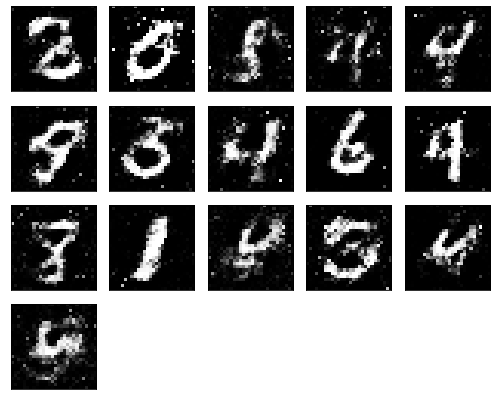

Epochs nb. 4121
discriminator loss: 0.5725719332695007
generator loss : 1.1068553924560547

Epochs nb. 4122
discriminator loss: 0.6418829560279846
generator loss : 0.913016676902771

Epochs nb. 4123
discriminator loss: 0.5529168248176575
generator loss : 0.816875696182251

Epochs nb. 4124
discriminator loss: 0.47823092341423035
generator loss : 1.0176498889923096

Epochs nb. 4125
discriminator loss: 0.49622684717178345
generator loss : 0.8956180214881897

Epochs nb. 4126
discriminator loss: 0.6685981154441833
generator loss : 0.9378210306167603

Epochs nb. 4127
discriminator loss: 0.4822474718093872
generator loss : 0.8985780477523804

Epochs nb. 4128
discriminator loss: 0.6429541707038879
generator loss : 0.9951104521751404

Epochs nb. 4129
discriminator loss: 0.687703013420105
generator loss : 1.0271495580673218

Epochs nb. 4130
discriminator loss: 0.6392714977264404
generator loss : 0.9572202563285828



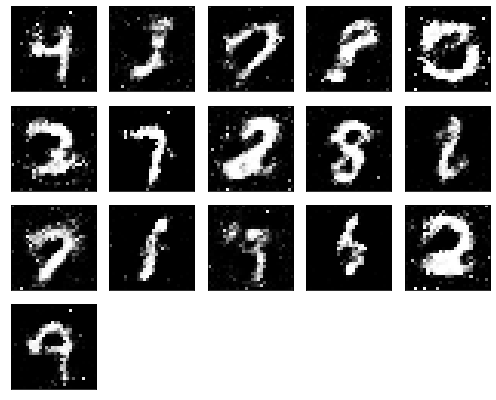

Epochs nb. 4131
discriminator loss: 0.5704674124717712
generator loss : 0.8955946564674377

Epochs nb. 4132
discriminator loss: 0.6222817897796631
generator loss : 0.9359048008918762

Epochs nb. 4133
discriminator loss: 0.6252069473266602
generator loss : 0.9778018593788147

Epochs nb. 4134
discriminator loss: 0.6595830917358398
generator loss : 0.8485519886016846

Epochs nb. 4135
discriminator loss: 0.5225175023078918
generator loss : 1.093742847442627

Epochs nb. 4136
discriminator loss: 0.5405522584915161
generator loss : 0.8871825933456421

Epochs nb. 4137
discriminator loss: 0.6562557816505432
generator loss : 0.9231458902359009

Epochs nb. 4138
discriminator loss: 0.5620937347412109
generator loss : 0.8629162311553955

Epochs nb. 4139
discriminator loss: 0.7415622472763062
generator loss : 0.8478389978408813

Epochs nb. 4140
discriminator loss: 0.6569947004318237
generator loss : 0.9208828806877136



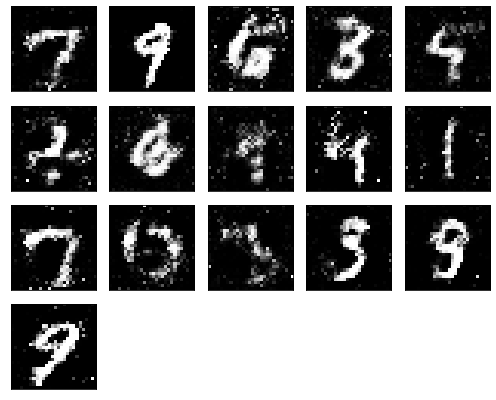

Epochs nb. 4141
discriminator loss: 0.6717424392700195
generator loss : 1.0701990127563477

Epochs nb. 4142
discriminator loss: 0.5512967705726624
generator loss : 0.9837155938148499

Epochs nb. 4143
discriminator loss: 0.5423039197921753
generator loss : 0.8716927170753479

Epochs nb. 4144
discriminator loss: 0.6017829179763794
generator loss : 1.015411138534546

Epochs nb. 4145
discriminator loss: 0.6710463762283325
generator loss : 0.8659008741378784

Epochs nb. 4146
discriminator loss: 0.6246151924133301
generator loss : 1.08071768283844

Epochs nb. 4147
discriminator loss: 0.6001916527748108
generator loss : 0.8665550947189331

Epochs nb. 4148
discriminator loss: 0.6121692657470703
generator loss : 0.9958446621894836

Epochs nb. 4149
discriminator loss: 0.8165084719657898
generator loss : 1.0698391199111938

Epochs nb. 4150
discriminator loss: 0.6722911596298218
generator loss : 0.887679934501648



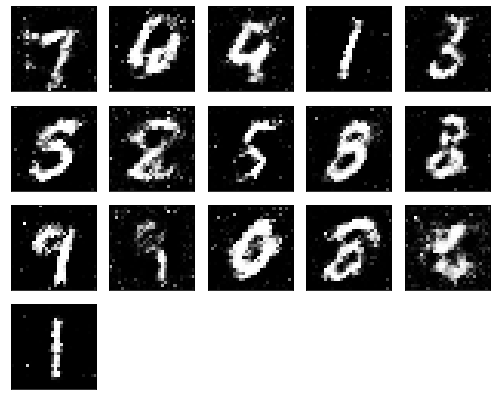

Epochs nb. 4151
discriminator loss: 0.6640964150428772
generator loss : 0.9453471899032593

Epochs nb. 4152
discriminator loss: 0.5555844306945801
generator loss : 1.141953468322754

Epochs nb. 4153
discriminator loss: 0.6630069017410278
generator loss : 1.0484293699264526

Epochs nb. 4154
discriminator loss: 0.5232753753662109
generator loss : 1.0707006454467773

Epochs nb. 4155
discriminator loss: 0.6321965456008911
generator loss : 0.9651249051094055

Epochs nb. 4156
discriminator loss: 0.5940413475036621
generator loss : 1.0823945999145508

Epochs nb. 4157
discriminator loss: 0.5656633377075195
generator loss : 1.028541088104248

Epochs nb. 4158
discriminator loss: 0.5434222221374512
generator loss : 1.035081386566162

Epochs nb. 4159
discriminator loss: 0.589565634727478
generator loss : 0.9512926340103149

Epochs nb. 4160
discriminator loss: 0.5750936269760132
generator loss : 1.0503466129302979



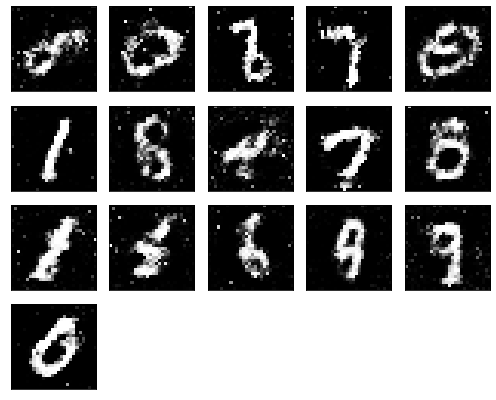

Epochs nb. 4161
discriminator loss: 0.5892201066017151
generator loss : 0.9997122883796692

Epochs nb. 4162
discriminator loss: 0.5880159735679626
generator loss : 0.8597579598426819

Epochs nb. 4163
discriminator loss: 0.5998003482818604
generator loss : 0.8177922964096069

Epochs nb. 4164
discriminator loss: 0.6245374083518982
generator loss : 0.8774116039276123

Epochs nb. 4165
discriminator loss: 0.4790459871292114
generator loss : 1.0373013019561768

Epochs nb. 4166
discriminator loss: 0.6990397572517395
generator loss : 1.1778538227081299

Epochs nb. 4167
discriminator loss: 0.6283800601959229
generator loss : 1.118865966796875

Epochs nb. 4168
discriminator loss: 0.6005487442016602
generator loss : 0.9362611770629883

Epochs nb. 4169
discriminator loss: 0.5911716222763062
generator loss : 1.0897761583328247

Epochs nb. 4170
discriminator loss: 0.5627514123916626
generator loss : 1.037496566772461



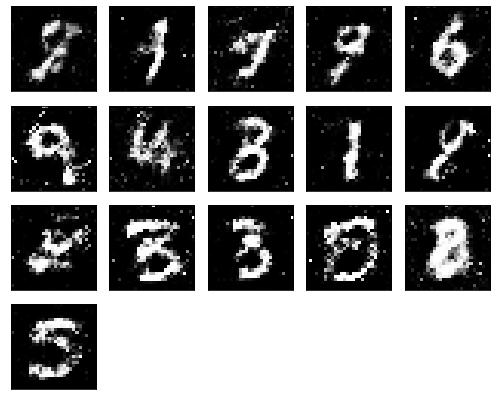

Epochs nb. 4171
discriminator loss: 0.7559980750083923
generator loss : 0.858417272567749

Epochs nb. 4172
discriminator loss: 0.607033371925354
generator loss : 0.9697226881980896

Epochs nb. 4173
discriminator loss: 0.5595511198043823
generator loss : 0.9080594182014465

Epochs nb. 4174
discriminator loss: 0.6356862783432007
generator loss : 0.8956041932106018

Epochs nb. 4175
discriminator loss: 0.6636552810668945
generator loss : 0.9752825498580933

Epochs nb. 4176
discriminator loss: 0.5611053109169006
generator loss : 0.9266656041145325

Epochs nb. 4177
discriminator loss: 0.5978492498397827
generator loss : 0.9734432101249695

Epochs nb. 4178
discriminator loss: 0.4639909267425537
generator loss : 1.1150178909301758

Epochs nb. 4179
discriminator loss: 0.7294524908065796
generator loss : 0.9818483591079712

Epochs nb. 4180
discriminator loss: 0.5941287279129028
generator loss : 1.1035099029541016



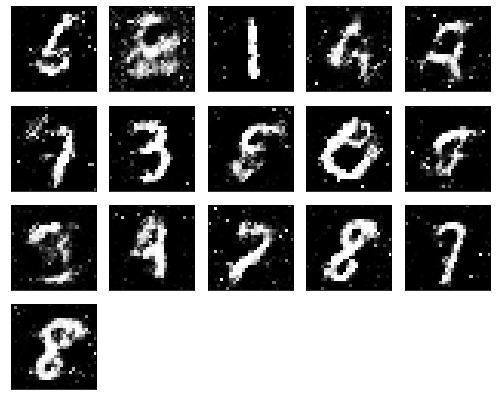

Epochs nb. 4181
discriminator loss: 0.5621910095214844
generator loss : 1.0335192680358887

Epochs nb. 4182
discriminator loss: 0.5910086035728455
generator loss : 1.0221521854400635

Epochs nb. 4183
discriminator loss: 0.5561739206314087
generator loss : 0.7318682074546814

Epochs nb. 4184
discriminator loss: 0.568673849105835
generator loss : 1.017821192741394

Epochs nb. 4185
discriminator loss: 0.5777363777160645
generator loss : 0.9268127083778381

Epochs nb. 4186
discriminator loss: 0.5332922339439392
generator loss : 0.851165235042572

Epochs nb. 4187
discriminator loss: 0.558544397354126
generator loss : 0.9129625558853149

Epochs nb. 4188
discriminator loss: 0.5418455600738525
generator loss : 1.1126980781555176

Epochs nb. 4189
discriminator loss: 0.6333690881729126
generator loss : 1.0491642951965332

Epochs nb. 4190
discriminator loss: 0.624756932258606
generator loss : 0.9563993215560913



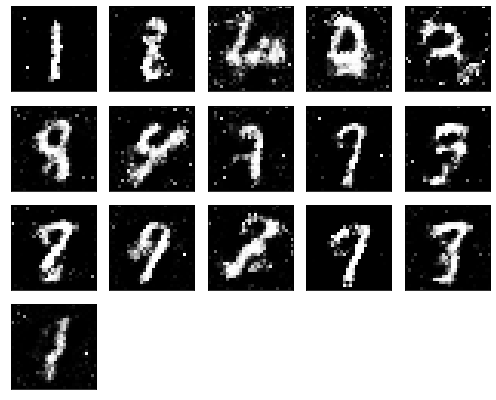

Epochs nb. 4191
discriminator loss: 0.5916423797607422
generator loss : 1.0529009103775024

Epochs nb. 4192
discriminator loss: 0.4230021834373474
generator loss : 0.8982595205307007

Epochs nb. 4193
discriminator loss: 0.686420202255249
generator loss : 0.8530099391937256

Epochs nb. 4194
discriminator loss: 0.569427490234375
generator loss : 0.8779051303863525

Epochs nb. 4195
discriminator loss: 0.597266435623169
generator loss : 0.9652953743934631

Epochs nb. 4196
discriminator loss: 0.5453914999961853
generator loss : 1.0716205835342407

Epochs nb. 4197
discriminator loss: 0.6118215322494507
generator loss : 1.0084315538406372

Epochs nb. 4198
discriminator loss: 0.6371506452560425
generator loss : 1.0593743324279785

Epochs nb. 4199
discriminator loss: 0.5856713652610779
generator loss : 0.9083870649337769

Epochs nb. 4200
discriminator loss: 0.5664975643157959
generator loss : 0.9140219688415527



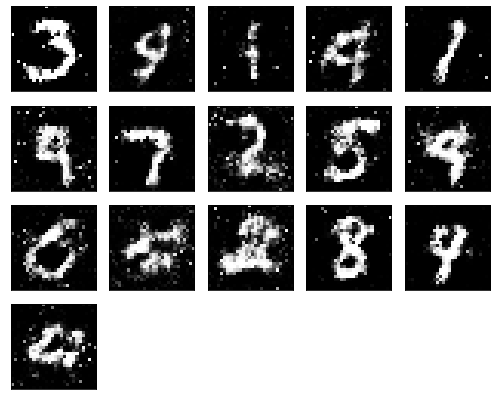

Epochs nb. 4201
discriminator loss: 0.5722646713256836
generator loss : 0.97684246301651

Epochs nb. 4202
discriminator loss: 0.520256519317627
generator loss : 0.8688228130340576

Epochs nb. 4203
discriminator loss: 0.6406874656677246
generator loss : 1.0202237367630005

Epochs nb. 4204
discriminator loss: 0.6061965227127075
generator loss : 0.8398870229721069

Epochs nb. 4205
discriminator loss: 0.6491847038269043
generator loss : 0.8723737001419067

Epochs nb. 4206
discriminator loss: 0.5246890783309937
generator loss : 0.9511364698410034

Epochs nb. 4207
discriminator loss: 0.5822213888168335
generator loss : 1.091817855834961

Epochs nb. 4208
discriminator loss: 0.5178780555725098
generator loss : 1.119005799293518

Epochs nb. 4209
discriminator loss: 0.537387490272522
generator loss : 0.9604870080947876

Epochs nb. 4210
discriminator loss: 0.5863504409790039
generator loss : 0.8777269124984741



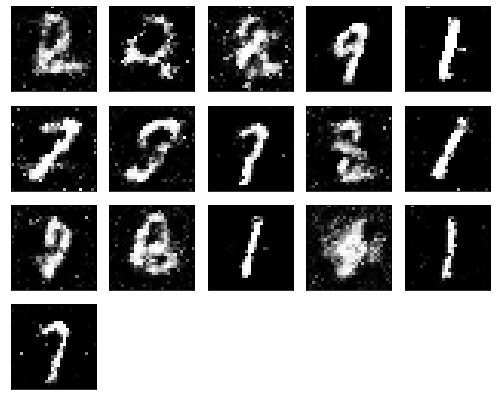

Epochs nb. 4211
discriminator loss: 0.6287553310394287
generator loss : 0.8639719486236572

Epochs nb. 4212
discriminator loss: 0.6715341210365295
generator loss : 0.7799263000488281

Epochs nb. 4213
discriminator loss: 0.7041334509849548
generator loss : 0.8690007925033569

Epochs nb. 4214
discriminator loss: 0.6508857011795044
generator loss : 0.7325235605239868

Epochs nb. 4215
discriminator loss: 0.6557685732841492
generator loss : 0.9114030003547668

Epochs nb. 4216
discriminator loss: 0.6127181053161621
generator loss : 1.082472562789917

Epochs nb. 4217
discriminator loss: 0.564175009727478
generator loss : 0.9991235733032227

Epochs nb. 4218
discriminator loss: 0.6750668883323669
generator loss : 1.007631778717041

Epochs nb. 4219
discriminator loss: 0.5875804424285889
generator loss : 1.1173361539840698

Epochs nb. 4220
discriminator loss: 0.5768245458602905
generator loss : 1.1165978908538818



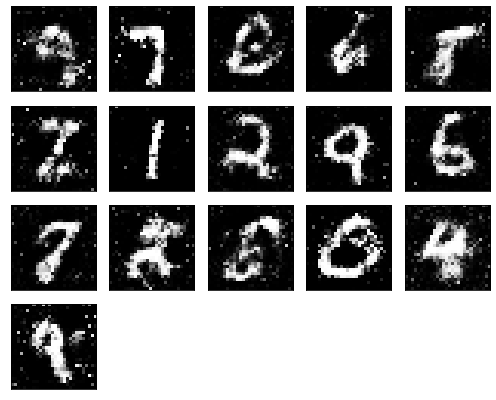

Epochs nb. 4221
discriminator loss: 0.5724833011627197
generator loss : 1.138654351234436

Epochs nb. 4222
discriminator loss: 0.5086097121238708
generator loss : 1.0076956748962402

Epochs nb. 4223
discriminator loss: 0.583106279373169
generator loss : 1.1711885929107666

Epochs nb. 4224
discriminator loss: 0.57667475938797
generator loss : 0.970321774482727

Epochs nb. 4225
discriminator loss: 0.47339966893196106
generator loss : 0.9196444749832153

Epochs nb. 4226
discriminator loss: 0.6100723147392273
generator loss : 0.8138267993927002

Epochs nb. 4227
discriminator loss: 0.6030447483062744
generator loss : 0.7677004337310791

Epochs nb. 4228
discriminator loss: 0.5608565807342529
generator loss : 0.8725525736808777

Epochs nb. 4229
discriminator loss: 0.5771445035934448
generator loss : 0.9020184874534607

Epochs nb. 4230
discriminator loss: 0.5393550395965576
generator loss : 0.9750847220420837



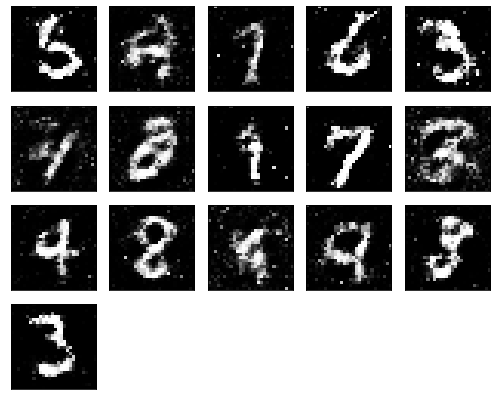

Epochs nb. 4231
discriminator loss: 0.6671967506408691
generator loss : 0.9240128993988037

Epochs nb. 4232
discriminator loss: 0.6607694029808044
generator loss : 0.9850927591323853

Epochs nb. 4233
discriminator loss: 0.586082935333252
generator loss : 0.9791545271873474

Epochs nb. 4234
discriminator loss: 0.5933265686035156
generator loss : 1.0619322061538696

Epochs nb. 4235
discriminator loss: 0.573401689529419
generator loss : 0.9769735336303711

Epochs nb. 4236
discriminator loss: 0.5578795671463013
generator loss : 0.9295440316200256

Epochs nb. 4237
discriminator loss: 0.5287818312644958
generator loss : 0.93900465965271

Epochs nb. 4238
discriminator loss: 0.5877556204795837
generator loss : 0.9339950084686279

Epochs nb. 4239
discriminator loss: 0.708037793636322
generator loss : 0.9475952982902527

Epochs nb. 4240
discriminator loss: 0.6091629862785339
generator loss : 0.9056720733642578



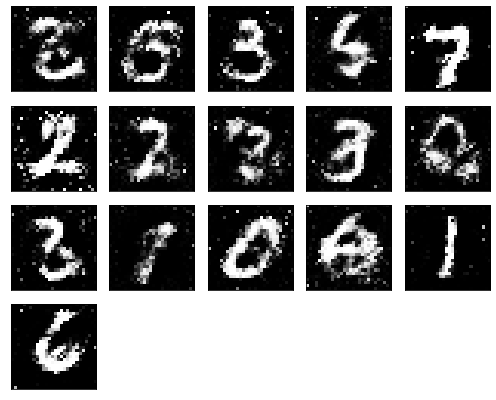

Epochs nb. 4241
discriminator loss: 0.5252565741539001
generator loss : 0.9588208198547363

Epochs nb. 4242
discriminator loss: 0.6288408041000366
generator loss : 0.8798903226852417

Epochs nb. 4243
discriminator loss: 0.5996659398078918
generator loss : 0.7984441518783569

Epochs nb. 4244
discriminator loss: 0.6740530133247375
generator loss : 1.0562703609466553

Epochs nb. 4245
discriminator loss: 0.6196290254592896
generator loss : 1.1105129718780518

Epochs nb. 4246
discriminator loss: 0.5628126859664917
generator loss : 0.98179030418396

Epochs nb. 4247
discriminator loss: 0.5385239124298096
generator loss : 0.8368560671806335

Epochs nb. 4248
discriminator loss: 0.5498287081718445
generator loss : 0.9653359055519104

Epochs nb. 4249
discriminator loss: 0.5943444967269897
generator loss : 1.003341794013977

Epochs nb. 4250
discriminator loss: 0.703305721282959
generator loss : 1.0053521394729614



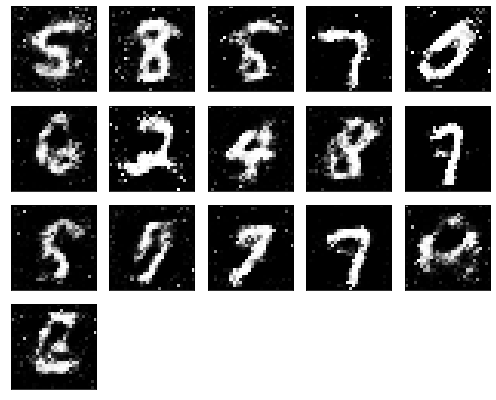

Epochs nb. 4251
discriminator loss: 0.6330434679985046
generator loss : 0.9666422605514526

Epochs nb. 4252
discriminator loss: 0.5233707427978516
generator loss : 0.9625089764595032

Epochs nb. 4253
discriminator loss: 0.5213173031806946
generator loss : 1.0039708614349365

Epochs nb. 4254
discriminator loss: 0.5991144776344299
generator loss : 1.0013867616653442

Epochs nb. 4255
discriminator loss: 0.592648446559906
generator loss : 1.08613920211792

Epochs nb. 4256
discriminator loss: 0.5371180176734924
generator loss : 1.007491111755371

Epochs nb. 4257
discriminator loss: 0.648618221282959
generator loss : 1.0528225898742676

Epochs nb. 4258
discriminator loss: 0.627023458480835
generator loss : 1.0532755851745605

Epochs nb. 4259
discriminator loss: 0.5055343508720398
generator loss : 1.1214170455932617

Epochs nb. 4260
discriminator loss: 0.5707947611808777
generator loss : 0.9143118262290955



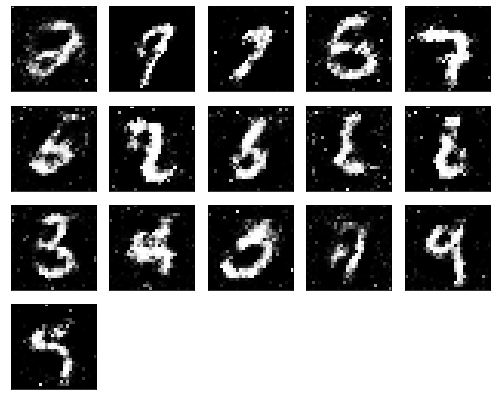

Epochs nb. 4261
discriminator loss: 0.5432381629943848
generator loss : 0.87398362159729

Epochs nb. 4262
discriminator loss: 0.7121217846870422
generator loss : 1.1351583003997803

Epochs nb. 4263
discriminator loss: 0.49574369192123413
generator loss : 1.1217180490493774

Epochs nb. 4264
discriminator loss: 0.5901414752006531
generator loss : 0.9858934879302979

Epochs nb. 4265
discriminator loss: 0.6832284927368164
generator loss : 1.1180367469787598

Epochs nb. 4266
discriminator loss: 0.5032846927642822
generator loss : 0.9820577502250671

Epochs nb. 4267
discriminator loss: 0.6421769261360168
generator loss : 0.924730658531189

Epochs nb. 4268
discriminator loss: 0.6278011798858643
generator loss : 1.0653690099716187

Epochs nb. 4269
discriminator loss: 0.755269467830658
generator loss : 1.1424005031585693

Epochs nb. 4270
discriminator loss: 0.5172765254974365
generator loss : 1.0289232730865479



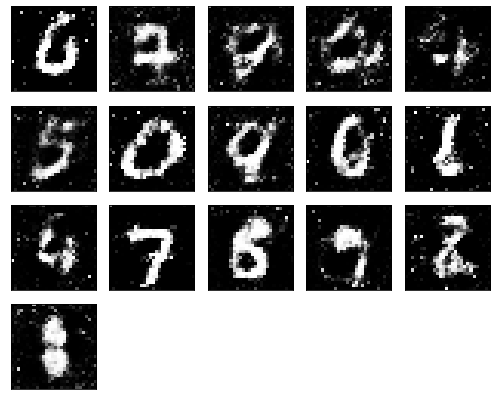

Epochs nb. 4271
discriminator loss: 0.6617339253425598
generator loss : 1.0363093614578247

Epochs nb. 4272
discriminator loss: 0.5320735573768616
generator loss : 0.9312518239021301

Epochs nb. 4273
discriminator loss: 0.5000527501106262
generator loss : 1.0528805255889893

Epochs nb. 4274
discriminator loss: 0.5785061717033386
generator loss : 0.9892852306365967

Epochs nb. 4275
discriminator loss: 0.7127506136894226
generator loss : 0.8986641764640808

Epochs nb. 4276
discriminator loss: 0.605796217918396
generator loss : 1.2531834840774536

Epochs nb. 4277
discriminator loss: 0.5341300964355469
generator loss : 0.9483004808425903

Epochs nb. 4278
discriminator loss: 0.6729143857955933
generator loss : 0.9276988506317139

Epochs nb. 4279
discriminator loss: 0.5613201856613159
generator loss : 0.9024317860603333

Epochs nb. 4280
discriminator loss: 0.6654266715049744
generator loss : 1.0902141332626343



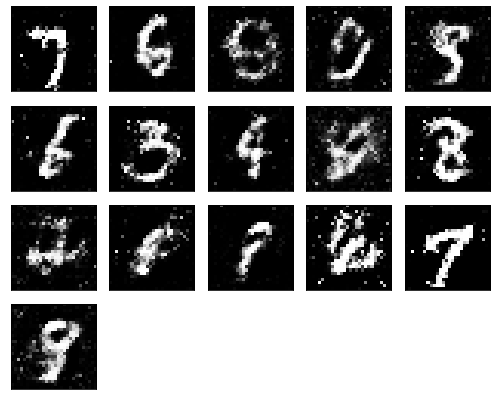

Epochs nb. 4281
discriminator loss: 0.6271491050720215
generator loss : 1.169697880744934

Epochs nb. 4282
discriminator loss: 0.48411017656326294
generator loss : 0.8839124441146851

Epochs nb. 4283
discriminator loss: 0.5760325193405151
generator loss : 1.0235018730163574

Epochs nb. 4284
discriminator loss: 0.7413042187690735
generator loss : 1.059617280960083

Epochs nb. 4285
discriminator loss: 0.5644563436508179
generator loss : 0.8613033294677734

Epochs nb. 4286
discriminator loss: 0.6450099945068359
generator loss : 0.9603898525238037

Epochs nb. 4287
discriminator loss: 0.5401709079742432
generator loss : 0.9050822257995605

Epochs nb. 4288
discriminator loss: 0.6101318597793579
generator loss : 0.9125472903251648

Epochs nb. 4289
discriminator loss: 0.621113657951355
generator loss : 0.935696542263031

Epochs nb. 4290
discriminator loss: 0.6416867971420288
generator loss : 1.0038959980010986



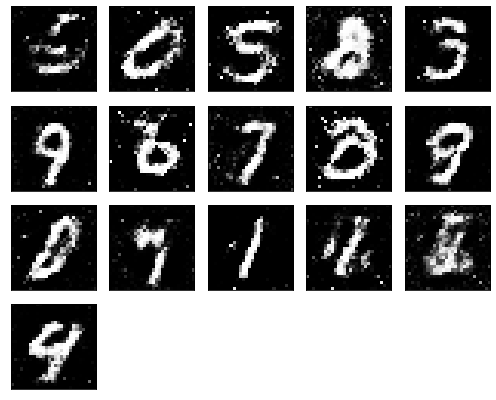

Epochs nb. 4291
discriminator loss: 0.6318110227584839
generator loss : 1.0624480247497559

Epochs nb. 4292
discriminator loss: 0.6158393621444702
generator loss : 0.9693121910095215

Epochs nb. 4293
discriminator loss: 0.5367830395698547
generator loss : 1.0173547267913818

Epochs nb. 4294
discriminator loss: 0.5563632249832153
generator loss : 0.9061905145645142

Epochs nb. 4295
discriminator loss: 0.6713672876358032
generator loss : 0.967670738697052

Epochs nb. 4296
discriminator loss: 0.6615952849388123
generator loss : 0.9303362369537354

Epochs nb. 4297
discriminator loss: 0.6073859930038452
generator loss : 1.1227641105651855

Epochs nb. 4298
discriminator loss: 0.646815299987793
generator loss : 1.0693120956420898

Epochs nb. 4299
discriminator loss: 0.6592985391616821
generator loss : 0.8395950198173523

Epochs nb. 4300
discriminator loss: 0.5446077585220337
generator loss : 0.990229070186615



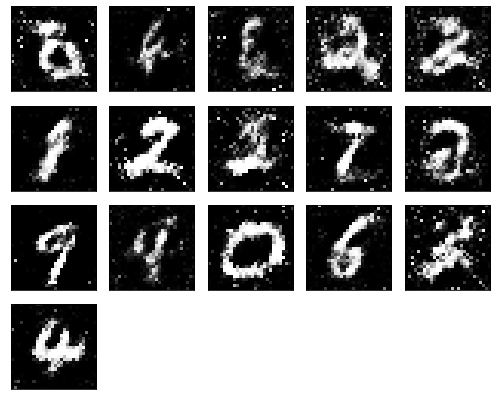

Epochs nb. 4301
discriminator loss: 0.4195232391357422
generator loss : 0.880199134349823

Epochs nb. 4302
discriminator loss: 0.5928567051887512
generator loss : 0.8290014863014221

Epochs nb. 4303
discriminator loss: 0.5362566113471985
generator loss : 0.9797163605690002

Epochs nb. 4304
discriminator loss: 0.5209532976150513
generator loss : 0.858424723148346

Epochs nb. 4305
discriminator loss: 0.6124943494796753
generator loss : 0.9450432062149048

Epochs nb. 4306
discriminator loss: 0.6813324689865112
generator loss : 0.9588397741317749

Epochs nb. 4307
discriminator loss: 0.6183518171310425
generator loss : 1.1355379819869995

Epochs nb. 4308
discriminator loss: 0.6234932541847229
generator loss : 1.0320736169815063

Epochs nb. 4309
discriminator loss: 0.5503723621368408
generator loss : 1.1156835556030273

Epochs nb. 4310
discriminator loss: 0.5483815670013428
generator loss : 1.0195242166519165



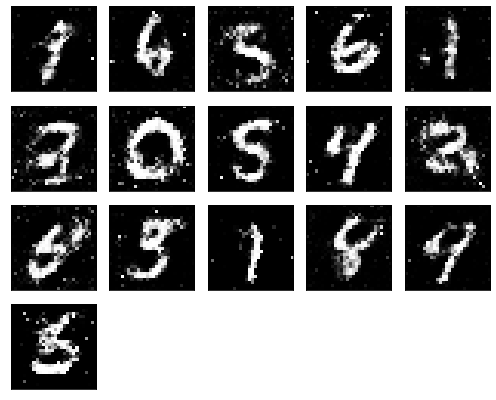

Epochs nb. 4311
discriminator loss: 0.7204048037528992
generator loss : 0.9660372734069824

Epochs nb. 4312
discriminator loss: 0.6854143142700195
generator loss : 0.9090883135795593

Epochs nb. 4313
discriminator loss: 0.5992426872253418
generator loss : 1.0174976587295532

Epochs nb. 4314
discriminator loss: 0.7145094871520996
generator loss : 0.8584558367729187

Epochs nb. 4315
discriminator loss: 0.5948024988174438
generator loss : 1.065892219543457

Epochs nb. 4316
discriminator loss: 0.5815532207489014
generator loss : 1.0327503681182861

Epochs nb. 4317
discriminator loss: 0.606964647769928
generator loss : 1.0825953483581543

Epochs nb. 4318
discriminator loss: 0.657870888710022
generator loss : 0.9665603041648865

Epochs nb. 4319
discriminator loss: 0.570552408695221
generator loss : 0.9300350546836853

Epochs nb. 4320
discriminator loss: 0.5998040437698364
generator loss : 0.9078099727630615



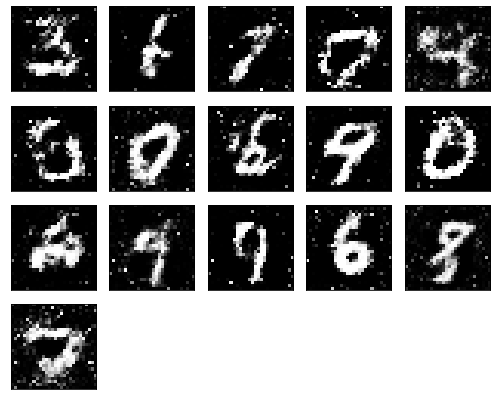

Epochs nb. 4321
discriminator loss: 0.6346205472946167
generator loss : 1.0269250869750977

Epochs nb. 4322
discriminator loss: 0.620710551738739
generator loss : 0.9062764048576355

Epochs nb. 4323
discriminator loss: 0.6382145881652832
generator loss : 1.0588407516479492

Epochs nb. 4324
discriminator loss: 0.511027455329895
generator loss : 1.0452706813812256

Epochs nb. 4325
discriminator loss: 0.6537783145904541
generator loss : 1.0461080074310303

Epochs nb. 4326
discriminator loss: 0.5944992303848267
generator loss : 1.1405978202819824

Epochs nb. 4327
discriminator loss: 0.6114702224731445
generator loss : 0.9817044138908386

Epochs nb. 4328
discriminator loss: 0.5217605829238892
generator loss : 0.9054852724075317

Epochs nb. 4329
discriminator loss: 0.6385730504989624
generator loss : 0.825313925743103

Epochs nb. 4330
discriminator loss: 0.5292801856994629
generator loss : 0.980580747127533



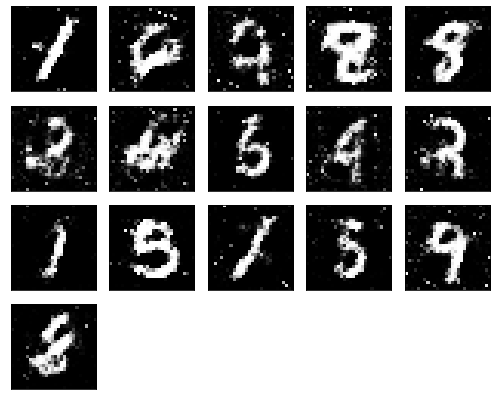

Epochs nb. 4331
discriminator loss: 0.5458492040634155
generator loss : 1.064414143562317

Epochs nb. 4332
discriminator loss: 0.7565872669219971
generator loss : 1.0391857624053955

Epochs nb. 4333
discriminator loss: 0.5616244673728943
generator loss : 1.0076833963394165

Epochs nb. 4334
discriminator loss: 0.6040817499160767
generator loss : 1.0152660608291626

Epochs nb. 4335
discriminator loss: 0.5066559314727783
generator loss : 0.7458318471908569

Epochs nb. 4336
discriminator loss: 0.5438787937164307
generator loss : 1.0141412019729614

Epochs nb. 4337
discriminator loss: 0.5447688102722168
generator loss : 0.9017404317855835

Epochs nb. 4338
discriminator loss: 0.6194583177566528
generator loss : 1.024158239364624

Epochs nb. 4339
discriminator loss: 0.5516964197158813
generator loss : 0.9318404793739319

Epochs nb. 4340
discriminator loss: 0.5134545564651489
generator loss : 0.9264575839042664



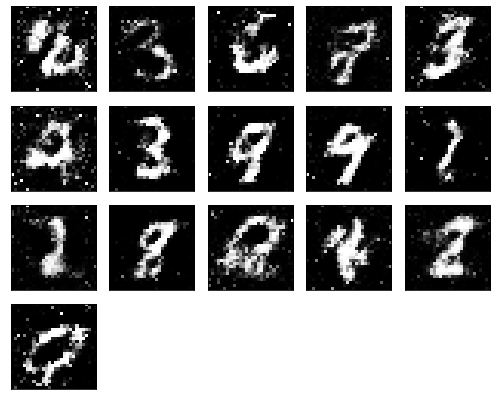

Epochs nb. 4341
discriminator loss: 0.572363018989563
generator loss : 1.085184097290039

Epochs nb. 4342
discriminator loss: 0.42357611656188965
generator loss : 0.9162874817848206

Epochs nb. 4343
discriminator loss: 0.5619989037513733
generator loss : 0.9785953760147095

Epochs nb. 4344
discriminator loss: 0.6045902967453003
generator loss : 0.9131050109863281

Epochs nb. 4345
discriminator loss: 0.6461840867996216
generator loss : 0.8583766222000122

Epochs nb. 4346
discriminator loss: 0.5641320943832397
generator loss : 1.0647168159484863

Epochs nb. 4347
discriminator loss: 0.6055765151977539
generator loss : 0.6963824033737183

Epochs nb. 4348
discriminator loss: 0.5868117809295654
generator loss : 0.9821725487709045

Epochs nb. 4349
discriminator loss: 0.529840350151062
generator loss : 1.0485317707061768

Epochs nb. 4350
discriminator loss: 0.4739615321159363
generator loss : 1.039463758468628



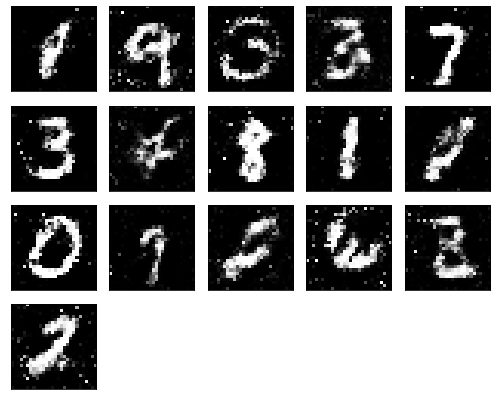

Epochs nb. 4351
discriminator loss: 0.6433358192443848
generator loss : 0.8072865009307861

Epochs nb. 4352
discriminator loss: 0.7804383039474487
generator loss : 1.0168447494506836

Epochs nb. 4353
discriminator loss: 0.556374192237854
generator loss : 0.7842246890068054

Epochs nb. 4354
discriminator loss: 0.6305781602859497
generator loss : 0.9972134828567505

Epochs nb. 4355
discriminator loss: 0.5976384282112122
generator loss : 0.9662707448005676

Epochs nb. 4356
discriminator loss: 0.6149963140487671
generator loss : 0.9076058864593506

Epochs nb. 4357
discriminator loss: 0.6922746896743774
generator loss : 0.8743390440940857

Epochs nb. 4358
discriminator loss: 0.6443837881088257
generator loss : 1.2146649360656738

Epochs nb. 4359
discriminator loss: 0.5421728491783142
generator loss : 0.9335538148880005

Epochs nb. 4360
discriminator loss: 0.6583084464073181
generator loss : 1.1897706985473633



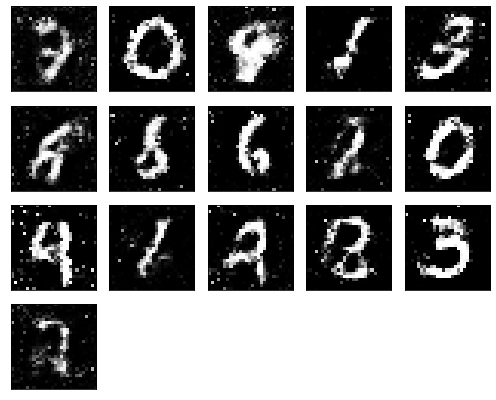

Epochs nb. 4361
discriminator loss: 0.6792900562286377
generator loss : 1.1128649711608887

Epochs nb. 4362
discriminator loss: 0.7921546697616577
generator loss : 1.0712398290634155

Epochs nb. 4363
discriminator loss: 0.5794483423233032
generator loss : 1.0191116333007812

Epochs nb. 4364
discriminator loss: 0.6584206819534302
generator loss : 0.8658041954040527

Epochs nb. 4365
discriminator loss: 0.7753549814224243
generator loss : 1.0198415517807007

Epochs nb. 4366
discriminator loss: 0.629647433757782
generator loss : 0.8437763452529907

Epochs nb. 4367
discriminator loss: 0.5195491909980774
generator loss : 0.8077445030212402

Epochs nb. 4368
discriminator loss: 0.5371905565261841
generator loss : 0.7887012958526611

Epochs nb. 4369
discriminator loss: 0.6207941770553589
generator loss : 0.9219729900360107

Epochs nb. 4370
discriminator loss: 0.6712304353713989
generator loss : 0.9542070627212524



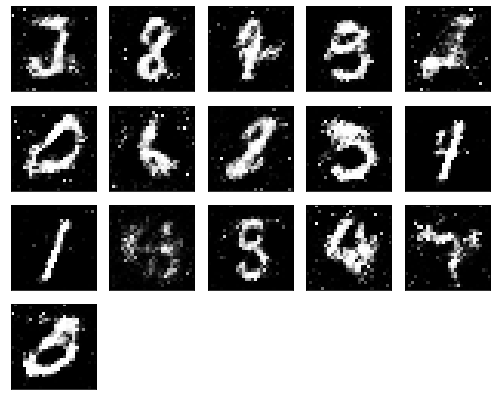

Epochs nb. 4371
discriminator loss: 0.5186263918876648
generator loss : 1.1029235124588013

Epochs nb. 4372
discriminator loss: 0.6921197772026062
generator loss : 1.091062068939209

Epochs nb. 4373
discriminator loss: 0.7073394656181335
generator loss : 0.9663371443748474

Epochs nb. 4374
discriminator loss: 0.5090242624282837
generator loss : 0.8770115971565247

Epochs nb. 4375
discriminator loss: 0.5234071016311646
generator loss : 1.0655382871627808

Epochs nb. 4376
discriminator loss: 0.7032914161682129
generator loss : 0.9485765099525452

Epochs nb. 4377
discriminator loss: 0.6530652046203613
generator loss : 0.9405304193496704

Epochs nb. 4378
discriminator loss: 0.5127399563789368
generator loss : 0.8780840635299683

Epochs nb. 4379
discriminator loss: 0.5075197219848633
generator loss : 0.875923216342926

Epochs nb. 4380
discriminator loss: 0.694089949131012
generator loss : 1.0445783138275146



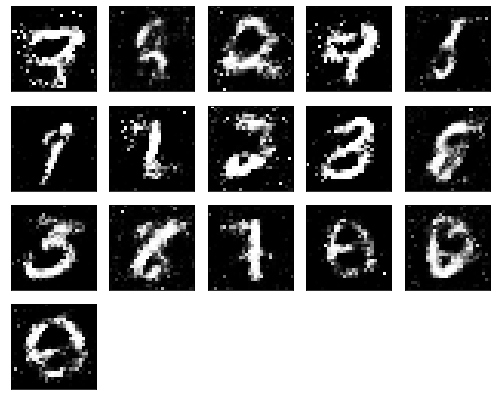

Epochs nb. 4381
discriminator loss: 0.7223520278930664
generator loss : 0.9928497076034546

Epochs nb. 4382
discriminator loss: 0.5534229278564453
generator loss : 0.8204129934310913

Epochs nb. 4383
discriminator loss: 0.6868255734443665
generator loss : 0.9134846329689026

Epochs nb. 4384
discriminator loss: 0.5975649356842041
generator loss : 0.9178639054298401

Epochs nb. 4385
discriminator loss: 0.6603975892066956
generator loss : 1.0795831680297852

Epochs nb. 4386
discriminator loss: 0.6146125197410583
generator loss : 0.9900552034378052

Epochs nb. 4387
discriminator loss: 0.5958164930343628
generator loss : 0.984254002571106

Epochs nb. 4388
discriminator loss: 0.5766801834106445
generator loss : 1.1235884428024292

Epochs nb. 4389
discriminator loss: 0.5912086963653564
generator loss : 0.8262863159179688

Epochs nb. 4390
discriminator loss: 0.5293480157852173
generator loss : 0.8945011496543884



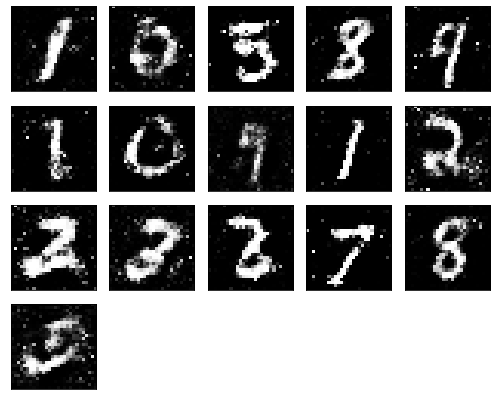

Epochs nb. 4391
discriminator loss: 0.6050810813903809
generator loss : 0.9235941767692566

Epochs nb. 4392
discriminator loss: 0.6694761514663696
generator loss : 1.1520957946777344

Epochs nb. 4393
discriminator loss: 0.7395764589309692
generator loss : 1.0685908794403076

Epochs nb. 4394
discriminator loss: 0.6311087608337402
generator loss : 1.0628913640975952

Epochs nb. 4395
discriminator loss: 0.5987390875816345
generator loss : 1.0071213245391846

Epochs nb. 4396
discriminator loss: 0.5755743384361267
generator loss : 0.9778854846954346

Epochs nb. 4397
discriminator loss: 0.6880651712417603
generator loss : 0.9997033476829529

Epochs nb. 4398
discriminator loss: 0.6195312738418579
generator loss : 0.958380401134491

Epochs nb. 4399
discriminator loss: 0.6967893838882446
generator loss : 1.0093038082122803

Epochs nb. 4400
discriminator loss: 0.726815938949585
generator loss : 1.1543467044830322



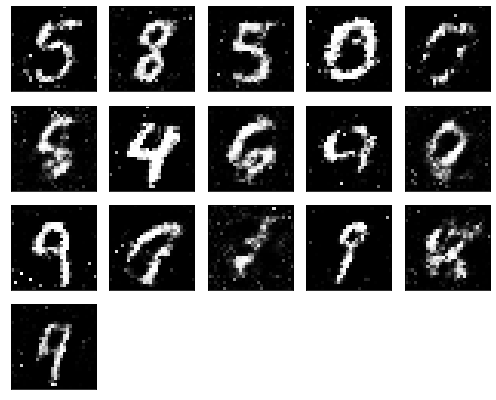

Epochs nb. 4401
discriminator loss: 0.4722578823566437
generator loss : 1.0133857727050781

Epochs nb. 4402
discriminator loss: 0.643712043762207
generator loss : 0.9997309446334839

Epochs nb. 4403
discriminator loss: 0.4957655668258667
generator loss : 0.9815957546234131

Epochs nb. 4404
discriminator loss: 0.60402911901474
generator loss : 0.8424969911575317

Epochs nb. 4405
discriminator loss: 0.8457459807395935
generator loss : 0.9651594161987305

Epochs nb. 4406
discriminator loss: 0.5204514265060425
generator loss : 0.7530139684677124

Epochs nb. 4407
discriminator loss: 0.6801199913024902
generator loss : 0.8277963399887085

Epochs nb. 4408
discriminator loss: 0.575888454914093
generator loss : 0.8623270988464355

Epochs nb. 4409
discriminator loss: 0.6175479888916016
generator loss : 1.0068376064300537

Epochs nb. 4410
discriminator loss: 0.5171073079109192
generator loss : 0.960959792137146



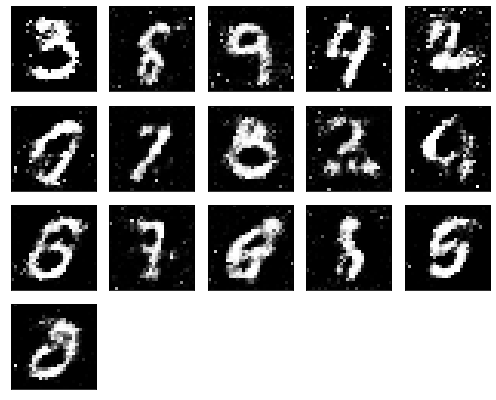

Epochs nb. 4411
discriminator loss: 0.5528907179832458
generator loss : 0.844728946685791

Epochs nb. 4412
discriminator loss: 0.5093529224395752
generator loss : 1.0432205200195312

Epochs nb. 4413
discriminator loss: 0.5527755618095398
generator loss : 1.2621086835861206

Epochs nb. 4414
discriminator loss: 0.7150246500968933
generator loss : 1.135277509689331

Epochs nb. 4415
discriminator loss: 0.49817031621932983
generator loss : 0.8665080666542053

Epochs nb. 4416
discriminator loss: 0.5318220257759094
generator loss : 0.9391835331916809

Epochs nb. 4417
discriminator loss: 0.6042624115943909
generator loss : 0.8681304454803467

Epochs nb. 4418
discriminator loss: 0.5994457006454468
generator loss : 0.8956006169319153

Epochs nb. 4419
discriminator loss: 0.4743666648864746
generator loss : 1.0945807695388794

Epochs nb. 4420
discriminator loss: 0.698754072189331
generator loss : 1.0278871059417725



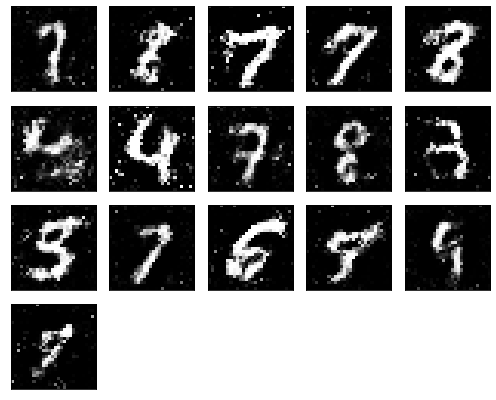

Epochs nb. 4421
discriminator loss: 0.556623101234436
generator loss : 1.1454689502716064

Epochs nb. 4422
discriminator loss: 0.545232892036438
generator loss : 0.9791666269302368

Epochs nb. 4423
discriminator loss: 0.6219549179077148
generator loss : 0.994716465473175

Epochs nb. 4424
discriminator loss: 0.6911056041717529
generator loss : 1.1215565204620361

Epochs nb. 4425
discriminator loss: 0.6720595359802246
generator loss : 1.0706596374511719

Epochs nb. 4426
discriminator loss: 0.5117248892784119
generator loss : 0.9622354507446289

Epochs nb. 4427
discriminator loss: 0.6879817247390747
generator loss : 0.8704451322555542

Epochs nb. 4428
discriminator loss: 0.5157933235168457
generator loss : 0.7934070825576782

Epochs nb. 4429
discriminator loss: 0.7540404796600342
generator loss : 0.8444004058837891

Epochs nb. 4430
discriminator loss: 0.7622814774513245
generator loss : 1.0333259105682373



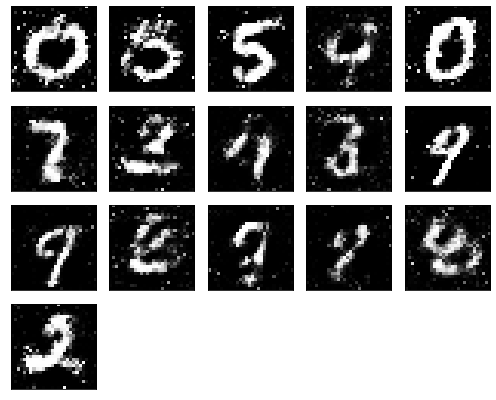

Epochs nb. 4431
discriminator loss: 0.4963163137435913
generator loss : 0.9118366241455078

Epochs nb. 4432
discriminator loss: 0.6195262670516968
generator loss : 1.092587947845459

Epochs nb. 4433
discriminator loss: 0.5418429374694824
generator loss : 0.8993939161300659

Epochs nb. 4434
discriminator loss: 0.4982665181159973
generator loss : 0.9388267993927002

Epochs nb. 4435
discriminator loss: 0.522857666015625
generator loss : 0.9333208799362183

Epochs nb. 4436
discriminator loss: 0.7464686632156372
generator loss : 0.9940104484558105

Epochs nb. 4437
discriminator loss: 0.7109572887420654
generator loss : 0.9763243198394775

Epochs nb. 4438
discriminator loss: 0.7434144020080566
generator loss : 1.111994743347168

Epochs nb. 4439
discriminator loss: 0.6243554949760437
generator loss : 1.1274495124816895

Epochs nb. 4440
discriminator loss: 0.5743125677108765
generator loss : 1.0459346771240234



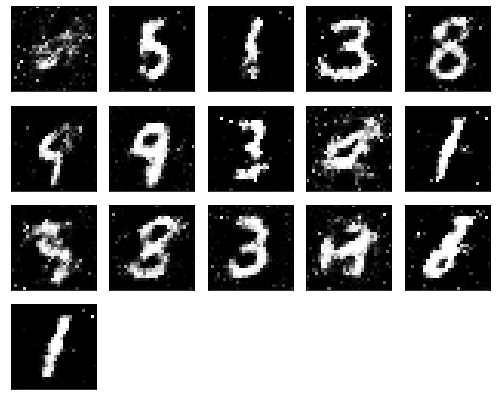

Epochs nb. 4441
discriminator loss: 0.5011501312255859
generator loss : 0.9873183369636536

Epochs nb. 4442
discriminator loss: 0.6113191246986389
generator loss : 0.9495375156402588

Epochs nb. 4443
discriminator loss: 0.6266067624092102
generator loss : 0.9364683628082275

Epochs nb. 4444
discriminator loss: 0.42244982719421387
generator loss : 0.8323475122451782

Epochs nb. 4445
discriminator loss: 0.564638614654541
generator loss : 1.020578145980835

Epochs nb. 4446
discriminator loss: 0.6663210391998291
generator loss : 1.076015830039978

Epochs nb. 4447
discriminator loss: 0.6472793817520142
generator loss : 0.8949639797210693

Epochs nb. 4448
discriminator loss: 0.6435720324516296
generator loss : 0.9440637230873108

Epochs nb. 4449
discriminator loss: 0.5578216314315796
generator loss : 1.0429800748825073

Epochs nb. 4450
discriminator loss: 0.5749603509902954
generator loss : 0.8427377939224243



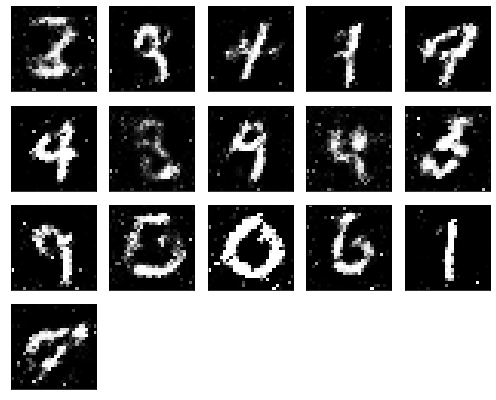

Epochs nb. 4451
discriminator loss: 0.533847987651825
generator loss : 0.9759800434112549

Epochs nb. 4452
discriminator loss: 0.6991400718688965
generator loss : 1.1015229225158691

Epochs nb. 4453
discriminator loss: 0.6168428063392639
generator loss : 1.144283652305603

Epochs nb. 4454
discriminator loss: 0.664830207824707
generator loss : 0.9859336614608765

Epochs nb. 4455
discriminator loss: 0.647454559803009
generator loss : 0.9239051342010498

Epochs nb. 4456
discriminator loss: 0.480350136756897
generator loss : 1.091992974281311

Epochs nb. 4457
discriminator loss: 0.6365456581115723
generator loss : 1.0754287242889404

Epochs nb. 4458
discriminator loss: 0.6815550327301025
generator loss : 0.9926032423973083

Epochs nb. 4459
discriminator loss: 0.5478795766830444
generator loss : 0.8594632744789124

Epochs nb. 4460
discriminator loss: 0.6777416467666626
generator loss : 1.0187698602676392



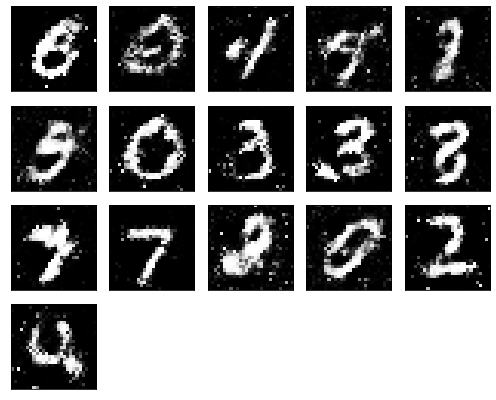

Epochs nb. 4461
discriminator loss: 0.6672812700271606
generator loss : 0.9268496632575989

Epochs nb. 4462
discriminator loss: 0.5525392293930054
generator loss : 0.9498844146728516

Epochs nb. 4463
discriminator loss: 0.5927073955535889
generator loss : 0.8218821287155151

Epochs nb. 4464
discriminator loss: 0.5993223190307617
generator loss : 0.8871005773544312

Epochs nb. 4465
discriminator loss: 0.5918530225753784
generator loss : 0.921345055103302

Epochs nb. 4466
discriminator loss: 0.43094807863235474
generator loss : 0.9535017013549805

Epochs nb. 4467
discriminator loss: 0.6501771807670593
generator loss : 0.9049075841903687

Epochs nb. 4468
discriminator loss: 0.7428848743438721
generator loss : 0.9149042963981628

Epochs nb. 4469
discriminator loss: 0.5856842994689941
generator loss : 0.8853280544281006

Epochs nb. 4470
discriminator loss: 0.6798347234725952
generator loss : 0.9217525720596313



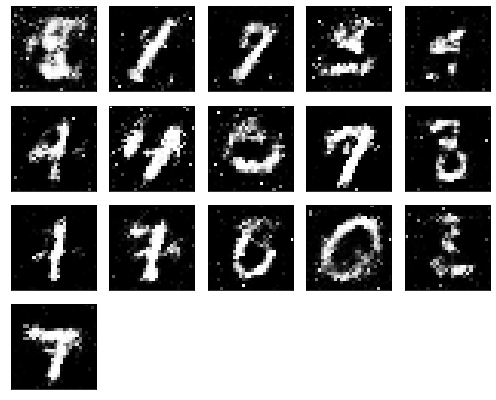

Epochs nb. 4471
discriminator loss: 0.6087251901626587
generator loss : 0.8864089250564575

Epochs nb. 4472
discriminator loss: 0.5648915767669678
generator loss : 0.7986730933189392

Epochs nb. 4473
discriminator loss: 0.5931925177574158
generator loss : 0.9485148191452026

Epochs nb. 4474
discriminator loss: 0.5936579704284668
generator loss : 0.9121444225311279

Epochs nb. 4475
discriminator loss: 0.6994225382804871
generator loss : 1.0831513404846191

Epochs nb. 4476
discriminator loss: 0.6014822721481323
generator loss : 1.0753867626190186

Epochs nb. 4477
discriminator loss: 0.571194052696228
generator loss : 0.8918517231941223

Epochs nb. 4478
discriminator loss: 0.7875090837478638
generator loss : 1.1238144636154175

Epochs nb. 4479
discriminator loss: 0.5093604922294617
generator loss : 0.9857586622238159

Epochs nb. 4480
discriminator loss: 0.8300520181655884
generator loss : 1.0816707611083984



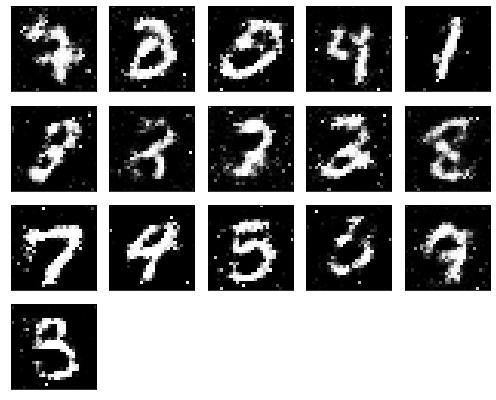

Epochs nb. 4481
discriminator loss: 0.6317899227142334
generator loss : 0.8943257927894592

Epochs nb. 4482
discriminator loss: 0.599269688129425
generator loss : 0.8247014284133911

Epochs nb. 4483
discriminator loss: 0.642578125
generator loss : 0.966233491897583

Epochs nb. 4484
discriminator loss: 0.5885212421417236
generator loss : 1.0390095710754395

Epochs nb. 4485
discriminator loss: 0.6549823880195618
generator loss : 0.8602539300918579

Epochs nb. 4486
discriminator loss: 0.633924663066864
generator loss : 1.0176606178283691

Epochs nb. 4487
discriminator loss: 0.5318835377693176
generator loss : 0.968950629234314

Epochs nb. 4488
discriminator loss: 0.568965494632721
generator loss : 0.9309196472167969

Epochs nb. 4489
discriminator loss: 0.507509171962738
generator loss : 1.1022605895996094

Epochs nb. 4490
discriminator loss: 0.599888026714325
generator loss : 1.2480921745300293



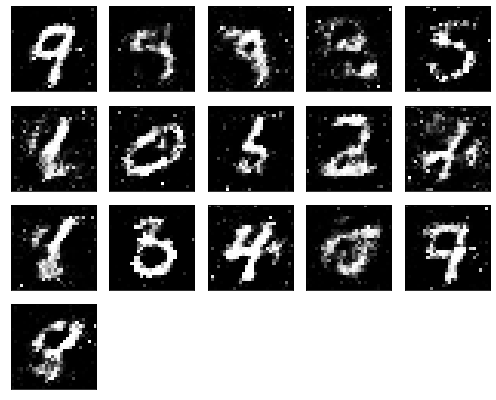

Epochs nb. 4491
discriminator loss: 0.5244541168212891
generator loss : 1.0288747549057007

Epochs nb. 4492
discriminator loss: 0.558398962020874
generator loss : 0.9154278039932251

Epochs nb. 4493
discriminator loss: 0.6860962510108948
generator loss : 1.0728569030761719

Epochs nb. 4494
discriminator loss: 0.7321354150772095
generator loss : 1.0495948791503906

Epochs nb. 4495
discriminator loss: 0.5960116386413574
generator loss : 0.9113227128982544

Epochs nb. 4496
discriminator loss: 0.580981969833374
generator loss : 1.0827057361602783

Epochs nb. 4497
discriminator loss: 0.5981720685958862
generator loss : 1.182343602180481

Epochs nb. 4498
discriminator loss: 0.6347604393959045
generator loss : 1.061340093612671

Epochs nb. 4499
discriminator loss: 0.5538961291313171
generator loss : 0.9804968237876892

Epochs nb. 4500
discriminator loss: 0.5051469802856445
generator loss : 0.9718545079231262



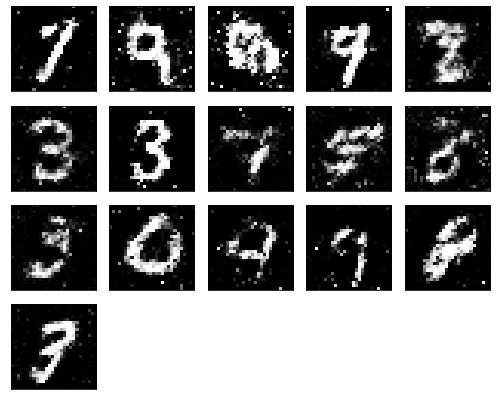

Epochs nb. 4501
discriminator loss: 0.6387650966644287
generator loss : 1.0322471857070923

Epochs nb. 4502
discriminator loss: 0.5447503328323364
generator loss : 1.0976085662841797

Epochs nb. 4503
discriminator loss: 0.5879921913146973
generator loss : 1.0539411306381226

Epochs nb. 4504
discriminator loss: 0.5791944265365601
generator loss : 1.0261425971984863

Epochs nb. 4505
discriminator loss: 0.5500555038452148
generator loss : 0.9612675905227661

Epochs nb. 4506
discriminator loss: 0.632056713104248
generator loss : 1.1295583248138428

Epochs nb. 4507
discriminator loss: 0.5748999714851379
generator loss : 0.9392086267471313

Epochs nb. 4508
discriminator loss: 0.5345377922058105
generator loss : 1.0569491386413574

Epochs nb. 4509
discriminator loss: 0.6508615612983704
generator loss : 1.0653212070465088

Epochs nb. 4510
discriminator loss: 0.7064154148101807
generator loss : 1.1278280019760132



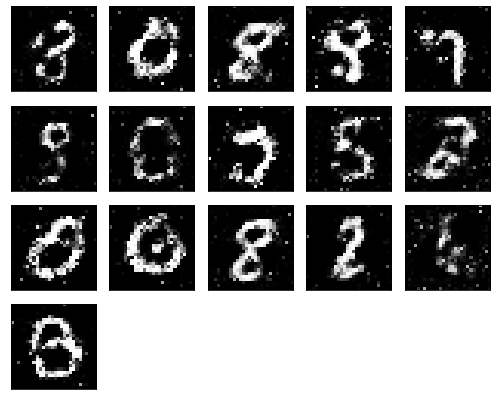

Epochs nb. 4511
discriminator loss: 0.49014121294021606
generator loss : 0.919187068939209

Epochs nb. 4512
discriminator loss: 0.4727056324481964
generator loss : 1.0211119651794434

Epochs nb. 4513
discriminator loss: 0.6435270309448242
generator loss : 0.8993326425552368

Epochs nb. 4514
discriminator loss: 0.664645791053772
generator loss : 1.0469532012939453

Epochs nb. 4515
discriminator loss: 0.5586298704147339
generator loss : 0.9642296433448792

Epochs nb. 4516
discriminator loss: 0.5787034034729004
generator loss : 0.9642531275749207

Epochs nb. 4517
discriminator loss: 0.6193426847457886
generator loss : 0.8175106644630432

Epochs nb. 4518
discriminator loss: 0.5534147024154663
generator loss : 0.9843308925628662

Epochs nb. 4519
discriminator loss: 0.5006287097930908
generator loss : 0.8069478273391724

Epochs nb. 4520
discriminator loss: 0.5587740540504456
generator loss : 1.1290514469146729



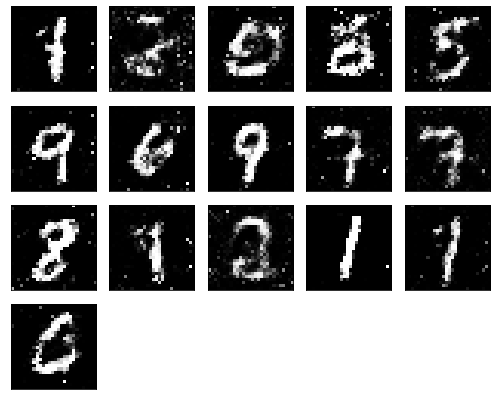

Epochs nb. 4521
discriminator loss: 0.7135757207870483
generator loss : 0.982062578201294

Epochs nb. 4522
discriminator loss: 0.5770634412765503
generator loss : 0.8590755462646484

Epochs nb. 4523
discriminator loss: 0.4690588414669037
generator loss : 0.9434725046157837

Epochs nb. 4524
discriminator loss: 0.5990253686904907
generator loss : 1.0419020652770996

Epochs nb. 4525
discriminator loss: 0.5234986543655396
generator loss : 0.7654943466186523

Epochs nb. 4526
discriminator loss: 0.810133695602417
generator loss : 0.9879148602485657

Epochs nb. 4527
discriminator loss: 0.6498814821243286
generator loss : 1.0418621301651

Epochs nb. 4528
discriminator loss: 0.5672703981399536
generator loss : 1.0322961807250977

Epochs nb. 4529
discriminator loss: 0.561964750289917
generator loss : 0.8843525052070618

Epochs nb. 4530
discriminator loss: 0.5394631624221802
generator loss : 1.0018677711486816



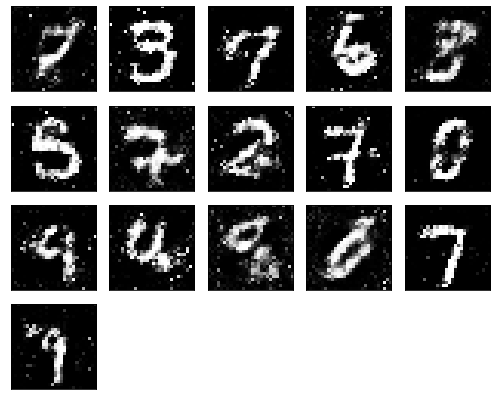

Epochs nb. 4531
discriminator loss: 0.6277955770492554
generator loss : 1.0315731763839722

Epochs nb. 4532
discriminator loss: 0.6392754316329956
generator loss : 0.9236560463905334

Epochs nb. 4533
discriminator loss: 0.46685272455215454
generator loss : 1.0021767616271973

Epochs nb. 4534
discriminator loss: 0.5083938837051392
generator loss : 1.0508785247802734

Epochs nb. 4535
discriminator loss: 0.5326482057571411
generator loss : 1.0662142038345337

Epochs nb. 4536
discriminator loss: 0.6009182929992676
generator loss : 0.8074450492858887

Epochs nb. 4537
discriminator loss: 0.5944818258285522
generator loss : 1.0075194835662842

Epochs nb. 4538
discriminator loss: 0.7804573774337769
generator loss : 0.9431196451187134

Epochs nb. 4539
discriminator loss: 0.6232796311378479
generator loss : 1.0492746829986572

Epochs nb. 4540
discriminator loss: 0.5385951399803162
generator loss : 0.8678207397460938



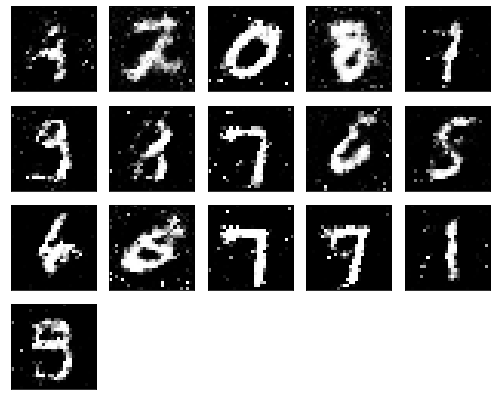

Epochs nb. 4541
discriminator loss: 0.6778176426887512
generator loss : 1.1857441663742065

Epochs nb. 4542
discriminator loss: 0.5571694374084473
generator loss : 0.9842237234115601

Epochs nb. 4543
discriminator loss: 0.5773112177848816
generator loss : 0.880217432975769

Epochs nb. 4544
discriminator loss: 0.5993887186050415
generator loss : 1.1161881685256958

Epochs nb. 4545
discriminator loss: 0.6006078720092773
generator loss : 0.8692831993103027

Epochs nb. 4546
discriminator loss: 0.7210785150527954
generator loss : 1.0920753479003906

Epochs nb. 4547
discriminator loss: 0.5966858863830566
generator loss : 1.0460033416748047

Epochs nb. 4548
discriminator loss: 0.5115232467651367
generator loss : 0.8473148345947266

Epochs nb. 4549
discriminator loss: 0.6574361324310303
generator loss : 1.181741714477539

Epochs nb. 4550
discriminator loss: 0.6211764812469482
generator loss : 1.0098884105682373



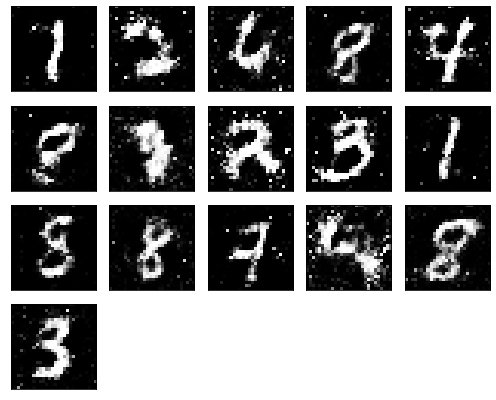

Epochs nb. 4551
discriminator loss: 0.59939044713974
generator loss : 1.134514570236206

Epochs nb. 4552
discriminator loss: 0.5071988701820374
generator loss : 1.0617619752883911

Epochs nb. 4553
discriminator loss: 0.6344404220581055
generator loss : 1.1231586933135986

Epochs nb. 4554
discriminator loss: 0.5582682490348816
generator loss : 1.027302622795105

Epochs nb. 4555
discriminator loss: 0.6330370306968689
generator loss : 1.0116024017333984

Epochs nb. 4556
discriminator loss: 0.5607404708862305
generator loss : 1.0192768573760986

Epochs nb. 4557
discriminator loss: 0.5887424945831299
generator loss : 1.0433725118637085

Epochs nb. 4558
discriminator loss: 0.7137138247489929
generator loss : 0.9856678247451782

Epochs nb. 4559
discriminator loss: 0.6001441478729248
generator loss : 1.106666088104248

Epochs nb. 4560
discriminator loss: 0.59035724401474
generator loss : 1.1904256343841553



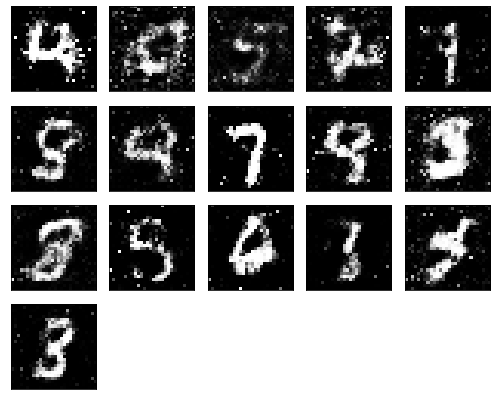

Epochs nb. 4561
discriminator loss: 0.6171947717666626
generator loss : 1.1074271202087402

Epochs nb. 4562
discriminator loss: 0.571395993232727
generator loss : 0.9985922574996948

Epochs nb. 4563
discriminator loss: 0.6459534764289856
generator loss : 0.8635246753692627

Epochs nb. 4564
discriminator loss: 0.4849316477775574
generator loss : 1.0734970569610596

Epochs nb. 4565
discriminator loss: 0.5572175979614258
generator loss : 0.8855694532394409

Epochs nb. 4566
discriminator loss: 0.49277955293655396
generator loss : 0.8883671760559082

Epochs nb. 4567
discriminator loss: 0.6807729005813599
generator loss : 0.9444750547409058

Epochs nb. 4568
discriminator loss: 0.6117228269577026
generator loss : 1.148357629776001

Epochs nb. 4569
discriminator loss: 0.5691825151443481
generator loss : 1.007615089416504

Epochs nb. 4570
discriminator loss: 0.5776785612106323
generator loss : 0.9905377626419067



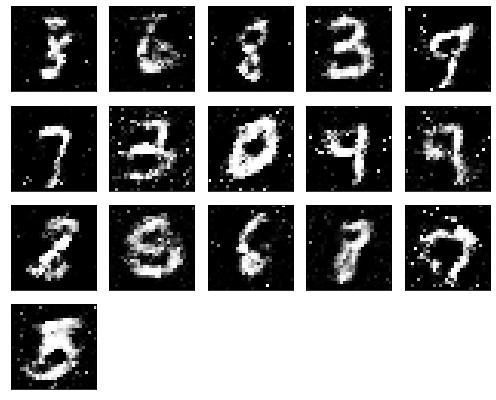

Epochs nb. 4571
discriminator loss: 0.734724760055542
generator loss : 0.9737646579742432

Epochs nb. 4572
discriminator loss: 0.7378667593002319
generator loss : 0.9352129697799683

Epochs nb. 4573
discriminator loss: 0.5568029880523682
generator loss : 1.0361814498901367

Epochs nb. 4574
discriminator loss: 0.5386710166931152
generator loss : 1.0215848684310913

Epochs nb. 4575
discriminator loss: 0.6041697859764099
generator loss : 1.1547086238861084

Epochs nb. 4576
discriminator loss: 0.6135756969451904
generator loss : 0.9373872876167297

Epochs nb. 4577
discriminator loss: 0.5315321683883667
generator loss : 1.0956923961639404

Epochs nb. 4578
discriminator loss: 0.525188684463501
generator loss : 0.9066857099533081

Epochs nb. 4579
discriminator loss: 0.6336941719055176
generator loss : 0.9412661790847778

Epochs nb. 4580
discriminator loss: 0.5192099809646606
generator loss : 0.9491272568702698



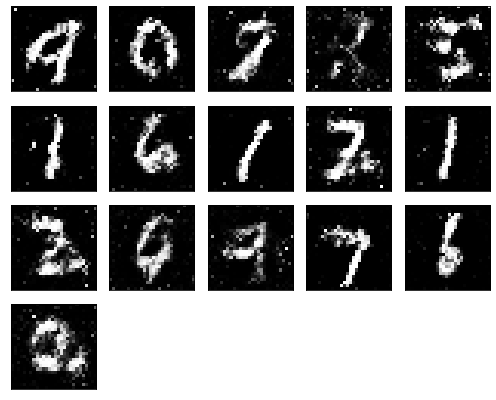

Epochs nb. 4581
discriminator loss: 0.7709962129592896
generator loss : 1.1078636646270752

Epochs nb. 4582
discriminator loss: 0.6249899864196777
generator loss : 0.91057288646698

Epochs nb. 4583
discriminator loss: 0.7231481075286865
generator loss : 1.0195294618606567

Epochs nb. 4584
discriminator loss: 0.5692815780639648
generator loss : 0.9541810750961304

Epochs nb. 4585
discriminator loss: 0.5525363683700562
generator loss : 0.8734170794487

Epochs nb. 4586
discriminator loss: 0.5558996796607971
generator loss : 0.9816130995750427

Epochs nb. 4587
discriminator loss: 0.5239222049713135
generator loss : 1.0086749792099

Epochs nb. 4588
discriminator loss: 0.6116825938224792
generator loss : 1.1777069568634033

Epochs nb. 4589
discriminator loss: 0.5205777883529663
generator loss : 0.9345148801803589

Epochs nb. 4590
discriminator loss: 0.45546892285346985
generator loss : 1.3221200704574585



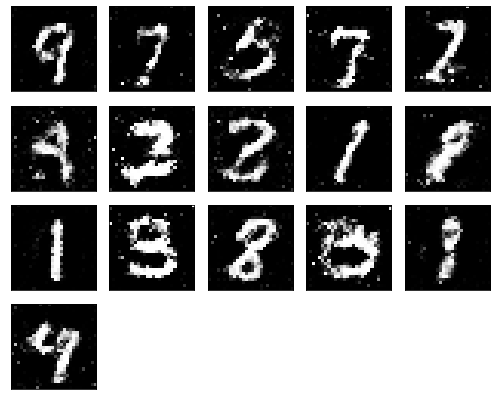

Epochs nb. 4591
discriminator loss: 0.6485729217529297
generator loss : 1.1499605178833008

Epochs nb. 4592
discriminator loss: 0.6278122663497925
generator loss : 0.9988066554069519

Epochs nb. 4593
discriminator loss: 0.6074259281158447
generator loss : 1.1215450763702393

Epochs nb. 4594
discriminator loss: 0.4615075886249542
generator loss : 0.9715907573699951

Epochs nb. 4595
discriminator loss: 0.5650010108947754
generator loss : 0.9725426435470581

Epochs nb. 4596
discriminator loss: 0.5080990791320801
generator loss : 0.812680721282959

Epochs nb. 4597
discriminator loss: 0.6285936832427979
generator loss : 0.8824131488800049

Epochs nb. 4598
discriminator loss: 0.5283085107803345
generator loss : 0.8787144422531128

Epochs nb. 4599
discriminator loss: 0.6008576154708862
generator loss : 0.9925329685211182

Epochs nb. 4600
discriminator loss: 0.5687714219093323
generator loss : 1.0201045274734497



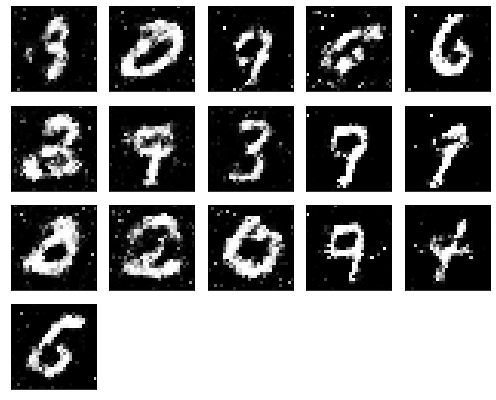

Epochs nb. 4601
discriminator loss: 0.5589524507522583
generator loss : 1.1341660022735596

Epochs nb. 4602
discriminator loss: 0.5823570489883423
generator loss : 0.9959039688110352

Epochs nb. 4603
discriminator loss: 0.494594544172287
generator loss : 0.9816514253616333

Epochs nb. 4604
discriminator loss: 0.6031945943832397
generator loss : 1.0564725399017334

Epochs nb. 4605
discriminator loss: 0.6049190163612366
generator loss : 1.0626139640808105

Epochs nb. 4606
discriminator loss: 0.5052422285079956
generator loss : 1.0559033155441284

Epochs nb. 4607
discriminator loss: 0.6728388071060181
generator loss : 1.0597927570343018

Epochs nb. 4608
discriminator loss: 0.5252578258514404
generator loss : 0.9824388027191162

Epochs nb. 4609
discriminator loss: 0.5504911541938782
generator loss : 1.089702844619751

Epochs nb. 4610
discriminator loss: 0.5437551736831665
generator loss : 1.0789575576782227



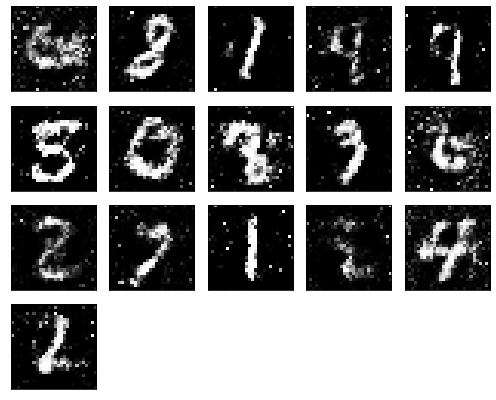

Epochs nb. 4611
discriminator loss: 0.5100033283233643
generator loss : 0.8259816765785217

Epochs nb. 4612
discriminator loss: 0.5638960003852844
generator loss : 0.9539693593978882

Epochs nb. 4613
discriminator loss: 0.5786657929420471
generator loss : 0.7842729091644287

Epochs nb. 4614
discriminator loss: 0.718018651008606
generator loss : 1.0122172832489014

Epochs nb. 4615
discriminator loss: 0.7782484292984009
generator loss : 0.9753286242485046

Epochs nb. 4616
discriminator loss: 0.5821071863174438
generator loss : 1.0611966848373413

Epochs nb. 4617
discriminator loss: 0.6418974995613098
generator loss : 1.0422064065933228

Epochs nb. 4618
discriminator loss: 0.5561331510543823
generator loss : 0.9225870370864868

Epochs nb. 4619
discriminator loss: 0.6139054298400879
generator loss : 0.9148399829864502

Epochs nb. 4620
discriminator loss: 0.6153916120529175
generator loss : 1.0074691772460938



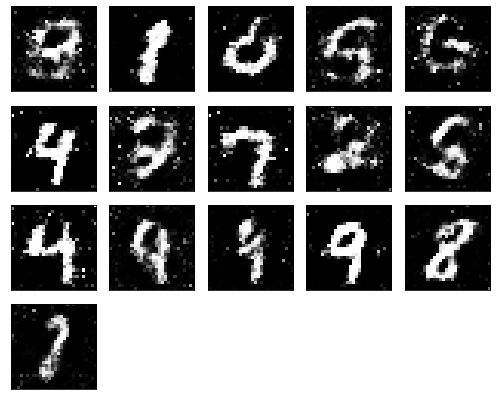

Epochs nb. 4621
discriminator loss: 0.631229043006897
generator loss : 0.9865660667419434

Epochs nb. 4622
discriminator loss: 0.6016972064971924
generator loss : 1.1764277219772339

Epochs nb. 4623
discriminator loss: 0.5358532667160034
generator loss : 1.0589179992675781

Epochs nb. 4624
discriminator loss: 0.5018929839134216
generator loss : 0.8394166231155396

Epochs nb. 4625
discriminator loss: 0.6531800031661987
generator loss : 1.139529824256897

Epochs nb. 4626
discriminator loss: 0.6120656728744507
generator loss : 1.0913320779800415

Epochs nb. 4627
discriminator loss: 0.6258280277252197
generator loss : 0.9486885666847229

Epochs nb. 4628
discriminator loss: 0.7125227451324463
generator loss : 1.1870806217193604

Epochs nb. 4629
discriminator loss: 0.6534382104873657
generator loss : 0.956902265548706

Epochs nb. 4630
discriminator loss: 0.4621546268463135
generator loss : 0.9461407661437988



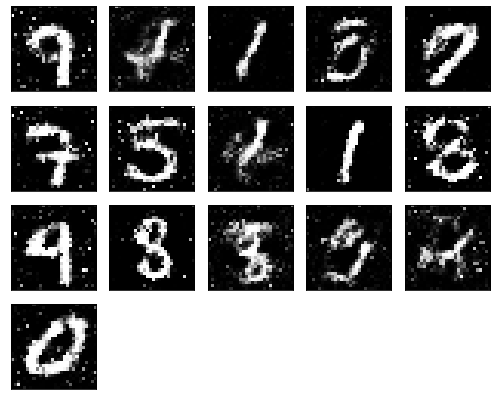

Epochs nb. 4631
discriminator loss: 0.48178601264953613
generator loss : 1.0036367177963257

Epochs nb. 4632
discriminator loss: 0.589224100112915
generator loss : 1.026994228363037

Epochs nb. 4633
discriminator loss: 0.7007162570953369
generator loss : 0.93598872423172

Epochs nb. 4634
discriminator loss: 0.5568743348121643
generator loss : 0.9343060255050659

Epochs nb. 4635
discriminator loss: 0.606584906578064
generator loss : 1.16159987449646

Epochs nb. 4636
discriminator loss: 0.6268118619918823
generator loss : 0.9383457899093628

Epochs nb. 4637
discriminator loss: 0.4562010169029236
generator loss : 1.0236103534698486

Epochs nb. 4638
discriminator loss: 0.49099111557006836
generator loss : 1.0026575326919556

Epochs nb. 4639
discriminator loss: 0.5289954543113708
generator loss : 0.9833372831344604

Epochs nb. 4640
discriminator loss: 0.6502780318260193
generator loss : 0.8916324377059937



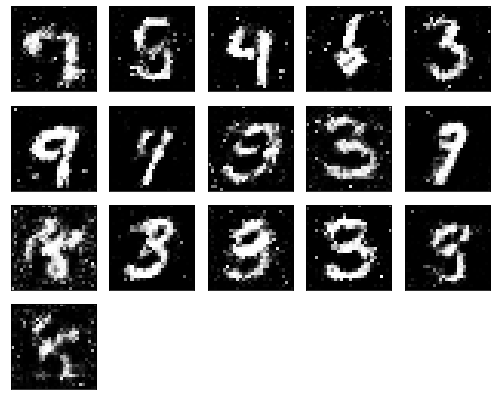

Epochs nb. 4641
discriminator loss: 0.5088971257209778
generator loss : 0.9616707563400269

Epochs nb. 4642
discriminator loss: 0.5236016511917114
generator loss : 1.052844762802124

Epochs nb. 4643
discriminator loss: 0.6430997252464294
generator loss : 0.856368899345398

Epochs nb. 4644
discriminator loss: 0.46227720379829407
generator loss : 0.9999178051948547

Epochs nb. 4645
discriminator loss: 0.6564924716949463
generator loss : 0.9524055123329163

Epochs nb. 4646
discriminator loss: 0.615325927734375
generator loss : 1.0514042377471924

Epochs nb. 4647
discriminator loss: 0.5974687337875366
generator loss : 1.0472277402877808

Epochs nb. 4648
discriminator loss: 0.613751232624054
generator loss : 0.9642215967178345

Epochs nb. 4649
discriminator loss: 0.7214236855506897
generator loss : 0.9704324007034302

Epochs nb. 4650
discriminator loss: 0.652567982673645
generator loss : 0.9953632354736328



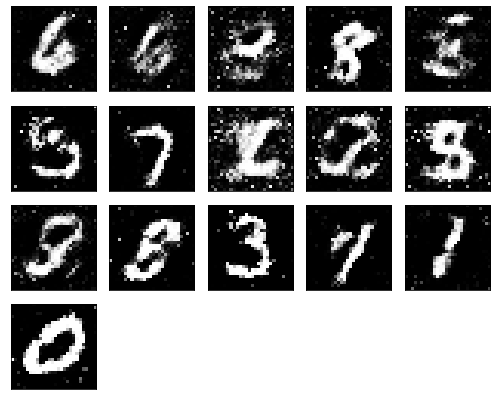

Epochs nb. 4651
discriminator loss: 0.6114607453346252
generator loss : 1.195971965789795

Epochs nb. 4652
discriminator loss: 0.7128355503082275
generator loss : 0.9689203500747681

Epochs nb. 4653
discriminator loss: 0.5441626906394958
generator loss : 1.106825351715088

Epochs nb. 4654
discriminator loss: 0.5772425532341003
generator loss : 1.0816831588745117

Epochs nb. 4655
discriminator loss: 0.599058985710144
generator loss : 1.0011162757873535

Epochs nb. 4656
discriminator loss: 0.5782595872879028
generator loss : 0.9393991231918335

Epochs nb. 4657
discriminator loss: 0.6552183628082275
generator loss : 1.0562334060668945

Epochs nb. 4658
discriminator loss: 0.538996696472168
generator loss : 0.8411588072776794

Epochs nb. 4659
discriminator loss: 0.5536951422691345
generator loss : 0.905610978603363

Epochs nb. 4660
discriminator loss: 0.6338444948196411
generator loss : 1.0762615203857422



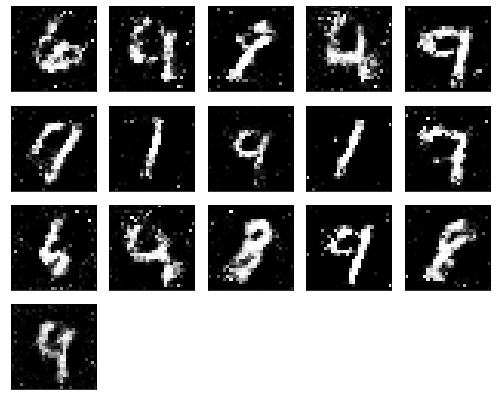

Epochs nb. 4661
discriminator loss: 0.6189398169517517
generator loss : 1.1940410137176514

Epochs nb. 4662
discriminator loss: 0.5535153150558472
generator loss : 0.901684582233429

Epochs nb. 4663
discriminator loss: 0.5889981389045715
generator loss : 0.9780819416046143

Epochs nb. 4664
discriminator loss: 0.6224040985107422
generator loss : 1.0118228197097778

Epochs nb. 4665
discriminator loss: 0.5616016387939453
generator loss : 1.0060964822769165

Epochs nb. 4666
discriminator loss: 0.5632026195526123
generator loss : 0.9521096348762512

Epochs nb. 4667
discriminator loss: 0.685264527797699
generator loss : 0.8979228734970093

Epochs nb. 4668
discriminator loss: 0.5390409827232361
generator loss : 1.0700860023498535

Epochs nb. 4669
discriminator loss: 0.47799915075302124
generator loss : 1.3157167434692383

Epochs nb. 4670
discriminator loss: 0.6874643564224243
generator loss : 1.0482022762298584



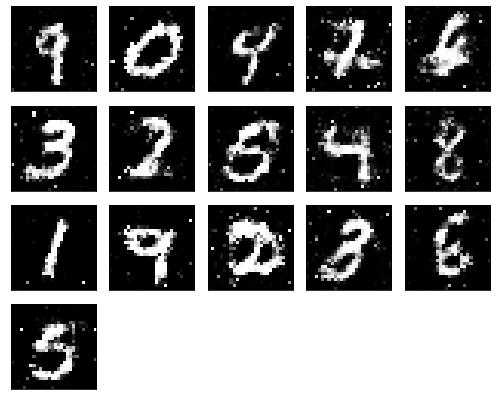

Epochs nb. 4671
discriminator loss: 0.51307612657547
generator loss : 0.9762145280838013

Epochs nb. 4672
discriminator loss: 0.5297648906707764
generator loss : 0.8829447627067566

Epochs nb. 4673
discriminator loss: 0.5628758072853088
generator loss : 1.0232913494110107

Epochs nb. 4674
discriminator loss: 0.5101171731948853
generator loss : 1.016479253768921

Epochs nb. 4675
discriminator loss: 0.5939639210700989
generator loss : 1.086132526397705

Epochs nb. 4676
discriminator loss: 0.5302387475967407
generator loss : 0.8764722347259521

Epochs nb. 4677
discriminator loss: 0.5185346007347107
generator loss : 0.9676042795181274

Epochs nb. 4678
discriminator loss: 0.4682023823261261
generator loss : 1.1094322204589844

Epochs nb. 4679
discriminator loss: 0.543760359287262
generator loss : 1.0022083520889282

Epochs nb. 4680
discriminator loss: 0.828765869140625
generator loss : 0.9311738014221191



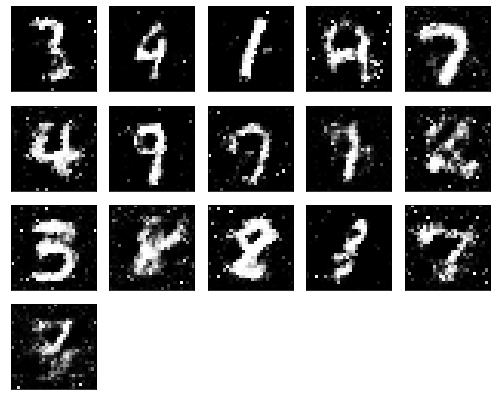

Epochs nb. 4681
discriminator loss: 0.650769829750061
generator loss : 0.9935526847839355

Epochs nb. 4682
discriminator loss: 0.5365911722183228
generator loss : 0.920343816280365

Epochs nb. 4683
discriminator loss: 0.6971861720085144
generator loss : 0.9133833050727844

Epochs nb. 4684
discriminator loss: 0.6983945965766907
generator loss : 0.7881782650947571

Epochs nb. 4685
discriminator loss: 0.624523937702179
generator loss : 1.0122835636138916

Epochs nb. 4686
discriminator loss: 0.7843185663223267
generator loss : 0.8234536051750183

Epochs nb. 4687
discriminator loss: 0.6037624478340149
generator loss : 0.9609590768814087

Epochs nb. 4688
discriminator loss: 0.7848587036132812
generator loss : 0.8096468448638916

Epochs nb. 4689
discriminator loss: 0.5773409008979797
generator loss : 0.9493964910507202

Epochs nb. 4690
discriminator loss: 0.6834814548492432
generator loss : 1.1056759357452393



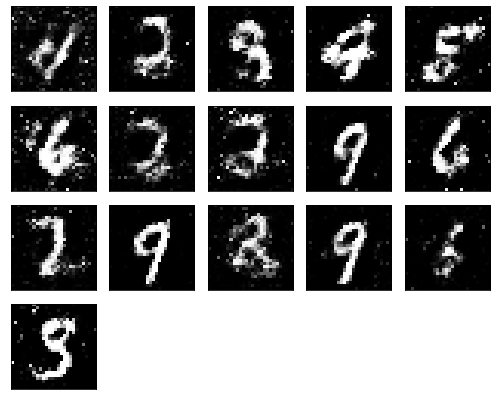

Epochs nb. 4691
discriminator loss: 0.632829487323761
generator loss : 0.9203037023544312

Epochs nb. 4692
discriminator loss: 0.5622211694717407
generator loss : 0.8863292932510376

Epochs nb. 4693
discriminator loss: 0.6446542739868164
generator loss : 0.9799849987030029

Epochs nb. 4694
discriminator loss: 0.5890660285949707
generator loss : 0.9299745559692383

Epochs nb. 4695
discriminator loss: 0.7341848611831665
generator loss : 1.1075814962387085

Epochs nb. 4696
discriminator loss: 0.5579525232315063
generator loss : 1.0533429384231567

Epochs nb. 4697
discriminator loss: 0.5918006896972656
generator loss : 0.9367768168449402

Epochs nb. 4698
discriminator loss: 0.5894217491149902
generator loss : 1.1514521837234497

Epochs nb. 4699
discriminator loss: 0.6018421053886414
generator loss : 1.003377914428711

Epochs nb. 4700
discriminator loss: 0.6774797439575195
generator loss : 0.9104782342910767



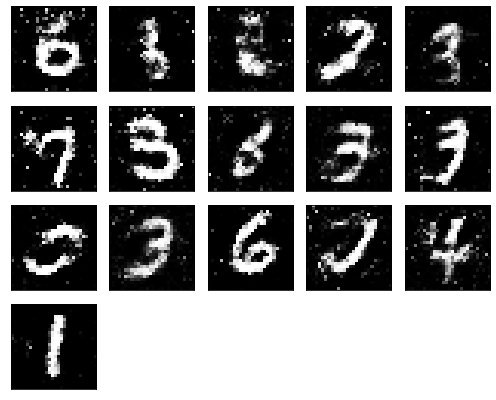

Epochs nb. 4701
discriminator loss: 0.6605584025382996
generator loss : 0.7723488807678223

Epochs nb. 4702
discriminator loss: 0.5825557708740234
generator loss : 0.8466017246246338

Epochs nb. 4703
discriminator loss: 0.6404788494110107
generator loss : 0.945769190788269

Epochs nb. 4704
discriminator loss: 0.6633000373840332
generator loss : 1.0272917747497559

Epochs nb. 4705
discriminator loss: 0.6870630979537964
generator loss : 1.1382534503936768

Epochs nb. 4706
discriminator loss: 0.634774386882782
generator loss : 1.0016491413116455

Epochs nb. 4707
discriminator loss: 0.6903175115585327
generator loss : 0.9912216663360596

Epochs nb. 4708
discriminator loss: 0.5749386548995972
generator loss : 0.9777733087539673

Epochs nb. 4709
discriminator loss: 0.6234544515609741
generator loss : 0.9237178564071655

Epochs nb. 4710
discriminator loss: 0.609188437461853
generator loss : 1.11207914352417



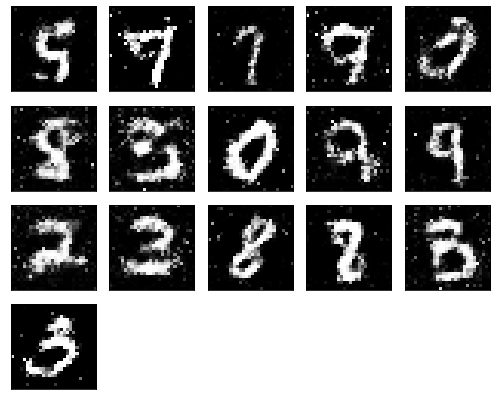

Epochs nb. 4711
discriminator loss: 0.5388928651809692
generator loss : 0.8880832195281982

Epochs nb. 4712
discriminator loss: 0.7178800106048584
generator loss : 1.0304739475250244

Epochs nb. 4713
discriminator loss: 0.5652035474777222
generator loss : 1.0879712104797363

Epochs nb. 4714
discriminator loss: 0.6057988405227661
generator loss : 0.9753618836402893

Epochs nb. 4715
discriminator loss: 0.6751527786254883
generator loss : 1.08779776096344

Epochs nb. 4716
discriminator loss: 0.6985707879066467
generator loss : 0.9725307822227478

Epochs nb. 4717
discriminator loss: 0.5351400375366211
generator loss : 1.1450378894805908

Epochs nb. 4718
discriminator loss: 0.565316915512085
generator loss : 1.2020823955535889

Epochs nb. 4719
discriminator loss: 0.5728739500045776
generator loss : 0.8693875074386597

Epochs nb. 4720
discriminator loss: 0.5990685224533081
generator loss : 0.9070221185684204



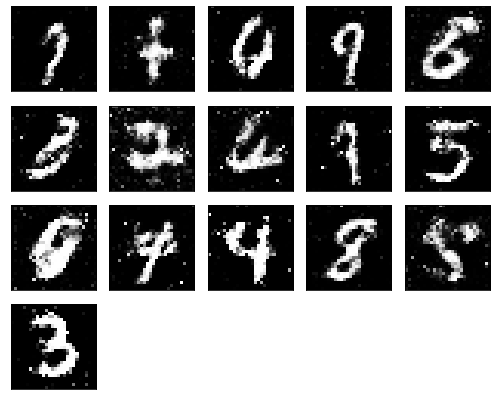

Epochs nb. 4721
discriminator loss: 0.6468570232391357
generator loss : 1.1248536109924316

Epochs nb. 4722
discriminator loss: 0.5405063033103943
generator loss : 0.8619282841682434

Epochs nb. 4723
discriminator loss: 0.5952205061912537
generator loss : 0.9666206240653992

Epochs nb. 4724
discriminator loss: 0.5809715986251831
generator loss : 0.9207105040550232

Epochs nb. 4725
discriminator loss: 0.7377719283103943
generator loss : 0.9038070440292358

Epochs nb. 4726
discriminator loss: 0.47856366634368896
generator loss : 1.1177027225494385

Epochs nb. 4727
discriminator loss: 0.5557263493537903
generator loss : 0.9406535029411316

Epochs nb. 4728
discriminator loss: 0.592863917350769
generator loss : 0.8755702972412109

Epochs nb. 4729
discriminator loss: 0.6703852415084839
generator loss : 0.9563001394271851

Epochs nb. 4730
discriminator loss: 0.6410125494003296
generator loss : 1.0934858322143555



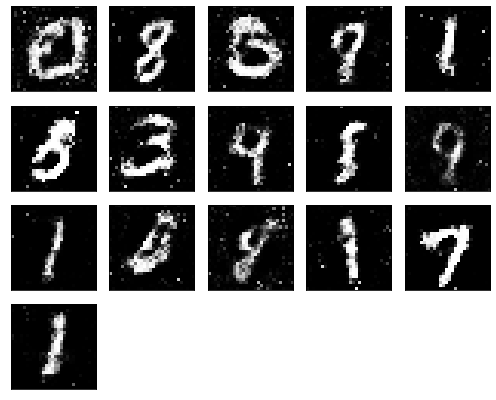

Epochs nb. 4731
discriminator loss: 0.611571192741394
generator loss : 0.9327048659324646

Epochs nb. 4732
discriminator loss: 0.6138948798179626
generator loss : 0.9349790811538696

Epochs nb. 4733
discriminator loss: 0.5914391279220581
generator loss : 0.9693365097045898

Epochs nb. 4734
discriminator loss: 0.5832083821296692
generator loss : 0.9379262924194336

Epochs nb. 4735
discriminator loss: 0.5060551762580872
generator loss : 1.05946683883667

Epochs nb. 4736
discriminator loss: 0.5536441802978516
generator loss : 0.8456944823265076

Epochs nb. 4737
discriminator loss: 0.5322355031967163
generator loss : 0.7692269086837769

Epochs nb. 4738
discriminator loss: 0.6288462281227112
generator loss : 0.8268119096755981

Epochs nb. 4739
discriminator loss: 0.6549069881439209
generator loss : 0.918981671333313

Epochs nb. 4740
discriminator loss: 0.7346389293670654
generator loss : 0.9485341906547546



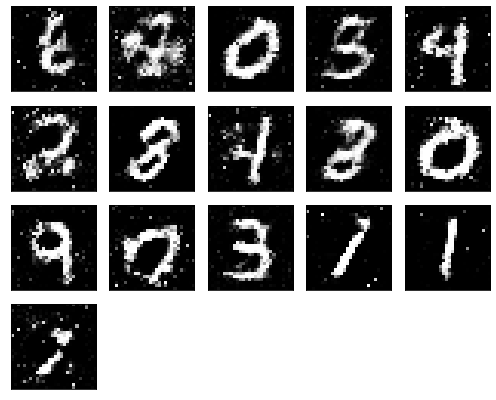

Epochs nb. 4741
discriminator loss: 0.5770757794380188
generator loss : 0.808326244354248

Epochs nb. 4742
discriminator loss: 0.5218406915664673
generator loss : 1.0087711811065674

Epochs nb. 4743
discriminator loss: 0.6373964548110962
generator loss : 0.8853484392166138

Epochs nb. 4744
discriminator loss: 0.5419667959213257
generator loss : 0.9740111827850342

Epochs nb. 4745
discriminator loss: 0.8286406397819519
generator loss : 0.9625994563102722

Epochs nb. 4746
discriminator loss: 0.6125673055648804
generator loss : 1.0524804592132568

Epochs nb. 4747
discriminator loss: 0.6928462386131287
generator loss : 0.9653438925743103

Epochs nb. 4748
discriminator loss: 0.6135283708572388
generator loss : 0.8350036144256592

Epochs nb. 4749
discriminator loss: 0.5999925136566162
generator loss : 0.9227774739265442

Epochs nb. 4750
discriminator loss: 0.6778356432914734
generator loss : 0.8580763339996338



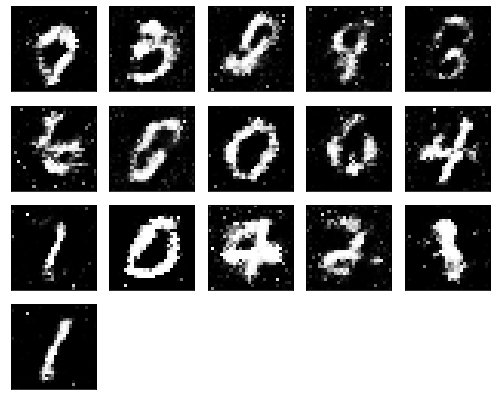

Epochs nb. 4751
discriminator loss: 0.5725487470626831
generator loss : 0.9599275588989258

Epochs nb. 4752
discriminator loss: 0.5949727296829224
generator loss : 1.1281769275665283

Epochs nb. 4753
discriminator loss: 0.5130852460861206
generator loss : 0.9370529055595398

Epochs nb. 4754
discriminator loss: 0.7233400940895081
generator loss : 0.7733297348022461

Epochs nb. 4755
discriminator loss: 0.5713423490524292
generator loss : 0.7400602102279663

Epochs nb. 4756
discriminator loss: 0.574748694896698
generator loss : 0.7802555561065674

Epochs nb. 4757
discriminator loss: 0.5652329921722412
generator loss : 1.0117539167404175

Epochs nb. 4758
discriminator loss: 0.5021449327468872
generator loss : 0.9810444712638855

Epochs nb. 4759
discriminator loss: 0.4989864230155945
generator loss : 0.9974914789199829

Epochs nb. 4760
discriminator loss: 0.6186402440071106
generator loss : 0.9406048059463501



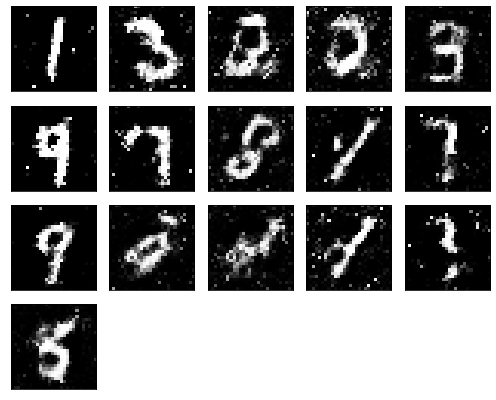

Epochs nb. 4761
discriminator loss: 0.5534640550613403
generator loss : 0.9737400412559509

Epochs nb. 4762
discriminator loss: 0.5937027931213379
generator loss : 0.8466973304748535

Epochs nb. 4763
discriminator loss: 0.4783262610435486
generator loss : 1.063093662261963

Epochs nb. 4764
discriminator loss: 0.5706042051315308
generator loss : 0.9669634103775024

Epochs nb. 4765
discriminator loss: 0.6947163343429565
generator loss : 1.154044508934021

Epochs nb. 4766
discriminator loss: 0.727267324924469
generator loss : 1.0115325450897217

Epochs nb. 4767
discriminator loss: 0.5640984773635864
generator loss : 0.8217887878417969

Epochs nb. 4768
discriminator loss: 0.7635440826416016
generator loss : 1.0735840797424316

Epochs nb. 4769
discriminator loss: 0.6315017938613892
generator loss : 1.1161367893218994

Epochs nb. 4770
discriminator loss: 0.6084893941879272
generator loss : 1.087562918663025



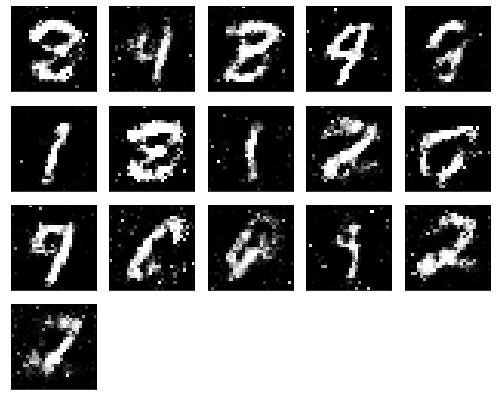

Epochs nb. 4771
discriminator loss: 0.6176910400390625
generator loss : 0.9331775903701782

Epochs nb. 4772
discriminator loss: 0.6319655776023865
generator loss : 0.8815115690231323

Epochs nb. 4773
discriminator loss: 0.6209311485290527
generator loss : 0.9519160985946655

Epochs nb. 4774
discriminator loss: 0.7233920097351074
generator loss : 0.831864058971405

Epochs nb. 4775
discriminator loss: 0.5489884614944458
generator loss : 1.0499248504638672

Epochs nb. 4776
discriminator loss: 0.6531413793563843
generator loss : 0.9139254093170166

Epochs nb. 4777
discriminator loss: 0.7290541529655457
generator loss : 0.9844706654548645

Epochs nb. 4778
discriminator loss: 0.7594349980354309
generator loss : 1.091078758239746

Epochs nb. 4779
discriminator loss: 0.6117084622383118
generator loss : 0.9094804525375366

Epochs nb. 4780
discriminator loss: 0.5736433267593384
generator loss : 0.8332792520523071



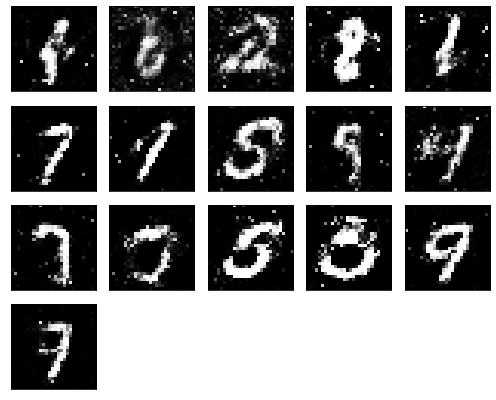

Epochs nb. 4781
discriminator loss: 0.7751978635787964
generator loss : 0.9985929131507874

Epochs nb. 4782
discriminator loss: 0.5572392344474792
generator loss : 0.7038501501083374

Epochs nb. 4783
discriminator loss: 0.5643392205238342
generator loss : 0.9367499947547913

Epochs nb. 4784
discriminator loss: 0.6450707912445068
generator loss : 0.8203047513961792

Epochs nb. 4785
discriminator loss: 0.4903184175491333
generator loss : 1.0120222568511963

Epochs nb. 4786
discriminator loss: 0.6322901248931885
generator loss : 1.053574800491333

Epochs nb. 4787
discriminator loss: 0.7953314781188965
generator loss : 1.117228388786316

Epochs nb. 4788
discriminator loss: 0.5422770977020264
generator loss : 0.9980799555778503

Epochs nb. 4789
discriminator loss: 0.5220984220504761
generator loss : 1.0529768466949463

Epochs nb. 4790
discriminator loss: 0.5669620037078857
generator loss : 1.1532355546951294



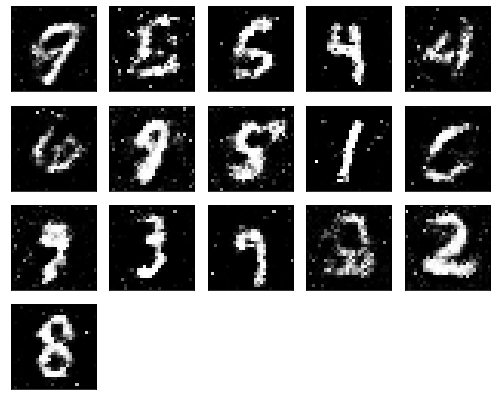

Epochs nb. 4791
discriminator loss: 0.6167266368865967
generator loss : 0.957216203212738

Epochs nb. 4792
discriminator loss: 0.5790742635726929
generator loss : 0.8952878713607788

Epochs nb. 4793
discriminator loss: 0.6361253261566162
generator loss : 1.0221534967422485

Epochs nb. 4794
discriminator loss: 0.5353081226348877
generator loss : 0.8650054931640625

Epochs nb. 4795
discriminator loss: 0.6014418005943298
generator loss : 1.0603998899459839

Epochs nb. 4796
discriminator loss: 0.6751613616943359
generator loss : 0.9623860716819763

Epochs nb. 4797
discriminator loss: 0.5602755546569824
generator loss : 1.0386571884155273

Epochs nb. 4798
discriminator loss: 0.5438713431358337
generator loss : 0.9143783450126648

Epochs nb. 4799
discriminator loss: 0.5908616185188293
generator loss : 0.9200549125671387

Epochs nb. 4800
discriminator loss: 0.6329268217086792
generator loss : 0.965313196182251



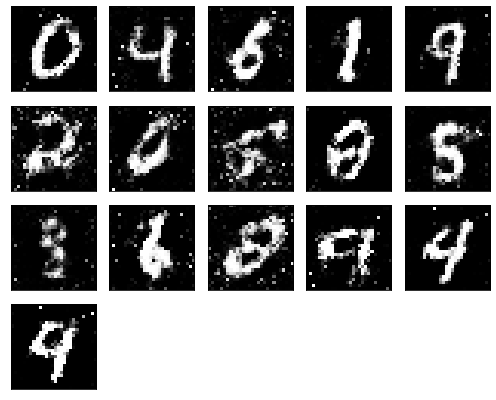

Epochs nb. 4801
discriminator loss: 0.5587244033813477
generator loss : 1.0970163345336914

Epochs nb. 4802
discriminator loss: 0.5943596363067627
generator loss : 0.8726984262466431

Epochs nb. 4803
discriminator loss: 0.4951736330986023
generator loss : 1.0910965204238892

Epochs nb. 4804
discriminator loss: 0.6293917298316956
generator loss : 0.8542442917823792

Epochs nb. 4805
discriminator loss: 0.6027252674102783
generator loss : 0.8446654081344604

Epochs nb. 4806
discriminator loss: 0.6033322215080261
generator loss : 0.8366853594779968

Epochs nb. 4807
discriminator loss: 0.6980122327804565
generator loss : 0.8733246326446533

Epochs nb. 4808
discriminator loss: 0.6522630453109741
generator loss : 1.2188034057617188

Epochs nb. 4809
discriminator loss: 0.44314470887184143
generator loss : 0.9939716458320618

Epochs nb. 4810
discriminator loss: 0.520078182220459
generator loss : 1.1188852787017822



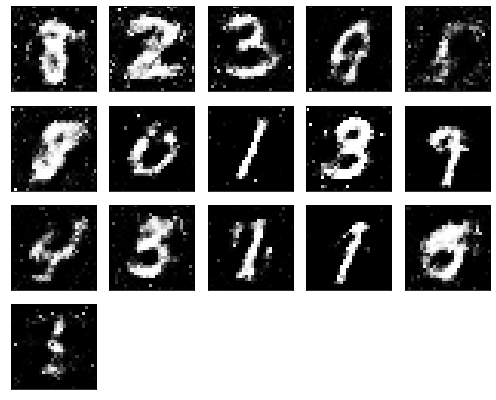

Epochs nb. 4811
discriminator loss: 0.572666347026825
generator loss : 1.2252552509307861

Epochs nb. 4812
discriminator loss: 0.5116493701934814
generator loss : 0.941247820854187

Epochs nb. 4813
discriminator loss: 0.5741668939590454
generator loss : 1.029538631439209

Epochs nb. 4814
discriminator loss: 0.7611401081085205
generator loss : 0.8987100124359131

Epochs nb. 4815
discriminator loss: 0.5801593065261841
generator loss : 1.0289589166641235

Epochs nb. 4816
discriminator loss: 0.737101674079895
generator loss : 0.9957926273345947

Epochs nb. 4817
discriminator loss: 0.5474365949630737
generator loss : 0.8571314215660095

Epochs nb. 4818
discriminator loss: 0.5561772584915161
generator loss : 0.8160602450370789

Epochs nb. 4819
discriminator loss: 0.5818572044372559
generator loss : 1.0515460968017578

Epochs nb. 4820
discriminator loss: 0.6039178967475891
generator loss : 0.9363464117050171



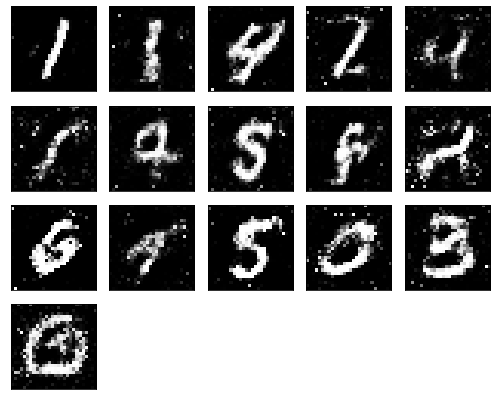

Epochs nb. 4821
discriminator loss: 0.730316698551178
generator loss : 0.9952184557914734

Epochs nb. 4822
discriminator loss: 0.634564220905304
generator loss : 1.0392746925354004

Epochs nb. 4823
discriminator loss: 0.5829172134399414
generator loss : 0.8967747688293457

Epochs nb. 4824
discriminator loss: 0.5867839455604553
generator loss : 0.839025616645813

Epochs nb. 4825
discriminator loss: 0.5979269742965698
generator loss : 1.090869665145874

Epochs nb. 4826
discriminator loss: 0.469651997089386
generator loss : 0.9595978260040283

Epochs nb. 4827
discriminator loss: 0.5240287780761719
generator loss : 1.056183099746704

Epochs nb. 4828
discriminator loss: 0.5748716592788696
generator loss : 0.956580400466919

Epochs nb. 4829
discriminator loss: 0.5435494780540466
generator loss : 1.136171817779541

Epochs nb. 4830
discriminator loss: 0.7563151121139526
generator loss : 1.0038455724716187



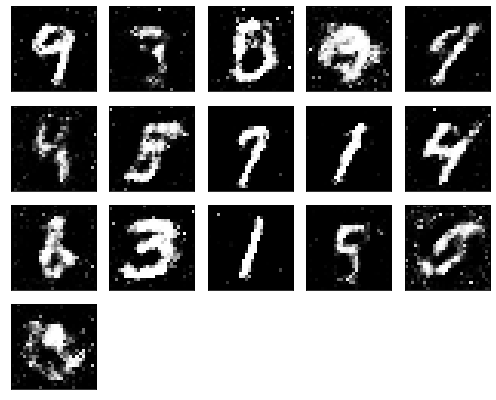

Epochs nb. 4831
discriminator loss: 0.5884277820587158
generator loss : 1.120789647102356

Epochs nb. 4832
discriminator loss: 0.6212542057037354
generator loss : 0.983334481716156

Epochs nb. 4833
discriminator loss: 0.46446406841278076
generator loss : 0.9166756272315979

Epochs nb. 4834
discriminator loss: 0.5874013304710388
generator loss : 0.9136334657669067

Epochs nb. 4835
discriminator loss: 0.5283432602882385
generator loss : 1.0722999572753906

Epochs nb. 4836
discriminator loss: 0.5641661882400513
generator loss : 1.0165331363677979

Epochs nb. 4837
discriminator loss: 0.5860439538955688
generator loss : 1.0407826900482178

Epochs nb. 4838
discriminator loss: 0.7083121538162231
generator loss : 0.8950334787368774

Epochs nb. 4839
discriminator loss: 0.518303632736206
generator loss : 0.8937081098556519

Epochs nb. 4840
discriminator loss: 0.5213196277618408
generator loss : 0.979666531085968



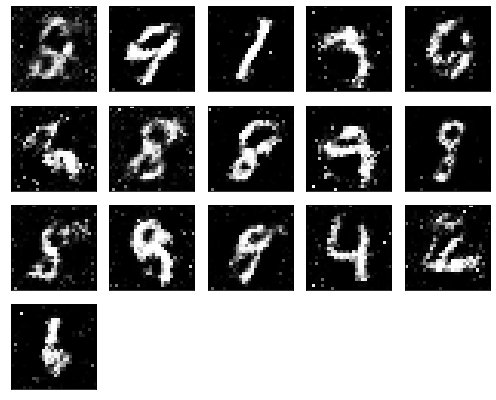

Epochs nb. 4841
discriminator loss: 0.5132464170455933
generator loss : 1.0869749784469604

Epochs nb. 4842
discriminator loss: 0.6236824989318848
generator loss : 1.0791937112808228

Epochs nb. 4843
discriminator loss: 0.5376922488212585
generator loss : 1.1772092580795288

Epochs nb. 4844
discriminator loss: 0.6308263540267944
generator loss : 1.077494740486145

Epochs nb. 4845
discriminator loss: 0.6558529734611511
generator loss : 0.8318576812744141

Epochs nb. 4846
discriminator loss: 0.6279811263084412
generator loss : 0.9928606748580933

Epochs nb. 4847
discriminator loss: 0.6678775548934937
generator loss : 1.040126919746399

Epochs nb. 4848
discriminator loss: 0.6342235803604126
generator loss : 1.0441676378250122

Epochs nb. 4849
discriminator loss: 0.4021254777908325
generator loss : 0.9763332009315491

Epochs nb. 4850
discriminator loss: 0.7000043392181396
generator loss : 1.01884126663208



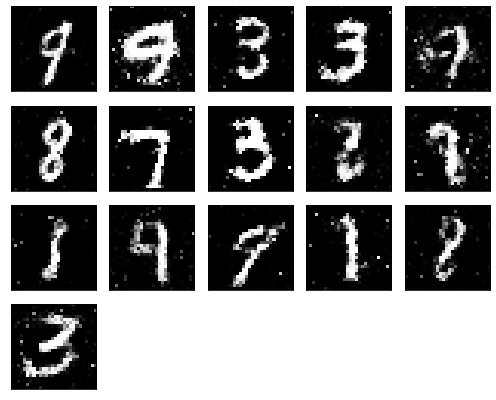

Epochs nb. 4851
discriminator loss: 0.5760343074798584
generator loss : 0.932895302772522

Epochs nb. 4852
discriminator loss: 0.4618608355522156
generator loss : 1.1069717407226562

Epochs nb. 4853
discriminator loss: 0.6443361043930054
generator loss : 1.1765681505203247

Epochs nb. 4854
discriminator loss: 0.5612649917602539
generator loss : 0.8756701350212097

Epochs nb. 4855
discriminator loss: 0.6226437091827393
generator loss : 0.7548667192459106

Epochs nb. 4856
discriminator loss: 0.6313896775245667
generator loss : 0.7834151983261108

Epochs nb. 4857
discriminator loss: 0.7072194814682007
generator loss : 0.9869838953018188

Epochs nb. 4858
discriminator loss: 0.6206930875778198
generator loss : 0.9693402051925659

Epochs nb. 4859
discriminator loss: 0.42269495129585266
generator loss : 0.9016520380973816

Epochs nb. 4860
discriminator loss: 0.6151400208473206
generator loss : 0.8038919568061829



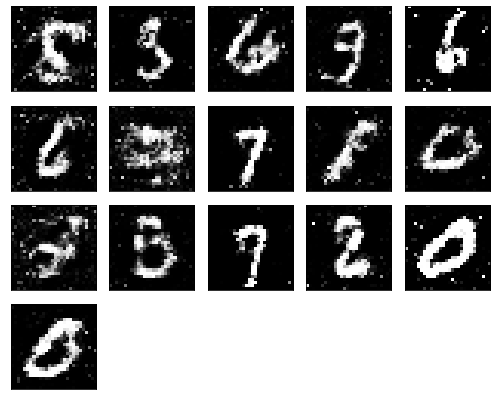

Epochs nb. 4861
discriminator loss: 0.47254830598831177
generator loss : 1.0876203775405884

Epochs nb. 4862
discriminator loss: 0.6716858744621277
generator loss : 1.107856273651123

Epochs nb. 4863
discriminator loss: 0.7082728147506714
generator loss : 0.8818217515945435

Epochs nb. 4864
discriminator loss: 0.6770052313804626
generator loss : 1.0341836214065552

Epochs nb. 4865
discriminator loss: 0.5502398014068604
generator loss : 1.1300249099731445

Epochs nb. 4866
discriminator loss: 0.5664687156677246
generator loss : 1.1605796813964844

Epochs nb. 4867
discriminator loss: 0.6130720973014832
generator loss : 0.9406581521034241

Epochs nb. 4868
discriminator loss: 0.47514617443084717
generator loss : 1.0549732446670532

Epochs nb. 4869
discriminator loss: 0.684777021408081
generator loss : 0.962735652923584

Epochs nb. 4870
discriminator loss: 0.6650102138519287
generator loss : 1.2204844951629639



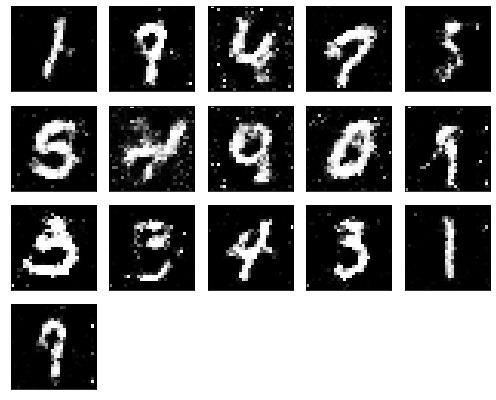

Epochs nb. 4871
discriminator loss: 0.6361473202705383
generator loss : 1.0576577186584473

Epochs nb. 4872
discriminator loss: 0.5981417894363403
generator loss : 0.9120227694511414

Epochs nb. 4873
discriminator loss: 0.7779622673988342
generator loss : 0.8939452171325684

Epochs nb. 4874
discriminator loss: 0.569980263710022
generator loss : 0.8046800494194031

Epochs nb. 4875
discriminator loss: 0.5890438556671143
generator loss : 0.8182157874107361

Epochs nb. 4876
discriminator loss: 0.6461665034294128
generator loss : 0.8887412548065186

Epochs nb. 4877
discriminator loss: 0.5723387598991394
generator loss : 1.103348970413208

Epochs nb. 4878
discriminator loss: 0.535462498664856
generator loss : 1.029641032218933

Epochs nb. 4879
discriminator loss: 0.6039117574691772
generator loss : 1.0069072246551514

Epochs nb. 4880
discriminator loss: 0.6076792478561401
generator loss : 1.0593650341033936



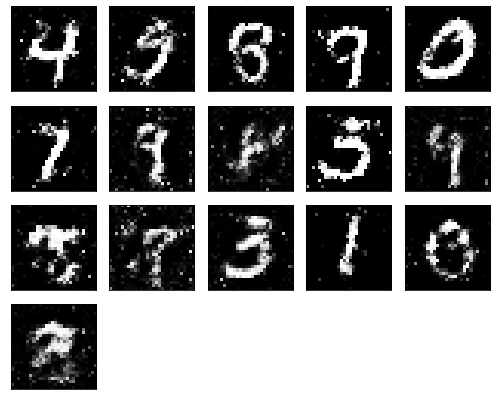

Epochs nb. 4881
discriminator loss: 0.5213670134544373
generator loss : 0.9979628920555115

Epochs nb. 4882
discriminator loss: 0.6531864404678345
generator loss : 1.137507677078247

Epochs nb. 4883
discriminator loss: 0.5640923976898193
generator loss : 0.7835745811462402

Epochs nb. 4884
discriminator loss: 0.45269501209259033
generator loss : 0.8603387475013733

Epochs nb. 4885
discriminator loss: 0.6134700179100037
generator loss : 0.9038440585136414

Epochs nb. 4886
discriminator loss: 0.6585309505462646
generator loss : 0.894557535648346

Epochs nb. 4887
discriminator loss: 0.626091718673706
generator loss : 1.038895845413208

Epochs nb. 4888
discriminator loss: 0.6014961004257202
generator loss : 1.085160732269287

Epochs nb. 4889
discriminator loss: 0.6061397790908813
generator loss : 1.0344187021255493

Epochs nb. 4890
discriminator loss: 0.5394232273101807
generator loss : 1.018391489982605



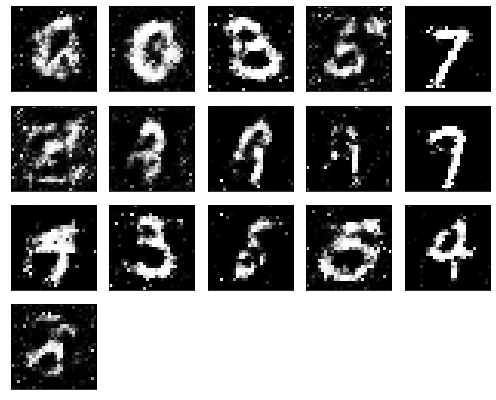

Epochs nb. 4891
discriminator loss: 0.5971440076828003
generator loss : 0.964195728302002

Epochs nb. 4892
discriminator loss: 0.6053914427757263
generator loss : 1.1224329471588135

Epochs nb. 4893
discriminator loss: 0.7066714763641357
generator loss : 0.9890112280845642

Epochs nb. 4894
discriminator loss: 0.48038849234580994
generator loss : 1.1045162677764893

Epochs nb. 4895
discriminator loss: 0.432449609041214
generator loss : 1.0072507858276367

Epochs nb. 4896
discriminator loss: 0.5203943252563477
generator loss : 1.1793088912963867

Epochs nb. 4897
discriminator loss: 0.5942410230636597
generator loss : 0.9115105271339417

Epochs nb. 4898
discriminator loss: 0.6242581605911255
generator loss : 0.9530635476112366

Epochs nb. 4899
discriminator loss: 0.5978589057922363
generator loss : 0.9395338892936707

Epochs nb. 4900
discriminator loss: 0.5585339069366455
generator loss : 0.9828247427940369



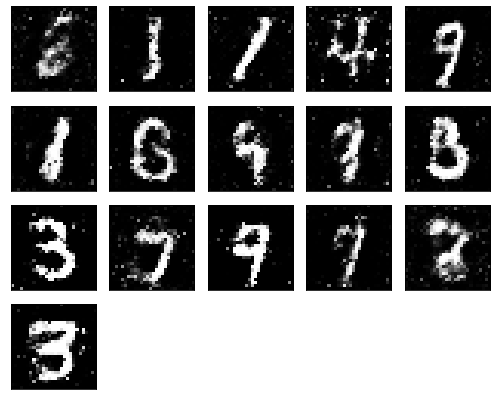

Epochs nb. 4901
discriminator loss: 0.6857729554176331
generator loss : 1.0871284008026123

Epochs nb. 4902
discriminator loss: 0.5203245878219604
generator loss : 0.953890323638916

Epochs nb. 4903
discriminator loss: 0.5941402912139893
generator loss : 1.0193626880645752

Epochs nb. 4904
discriminator loss: 0.563309371471405
generator loss : 0.8755569458007812

Epochs nb. 4905
discriminator loss: 0.6083152294158936
generator loss : 0.926535427570343

Epochs nb. 4906
discriminator loss: 0.533263623714447
generator loss : 0.8512753844261169

Epochs nb. 4907
discriminator loss: 0.5755904316902161
generator loss : 1.0697804689407349

Epochs nb. 4908
discriminator loss: 0.5755122900009155
generator loss : 0.9792643785476685

Epochs nb. 4909
discriminator loss: 0.523870587348938
generator loss : 1.0524821281433105

Epochs nb. 4910
discriminator loss: 0.716106653213501
generator loss : 1.120694637298584



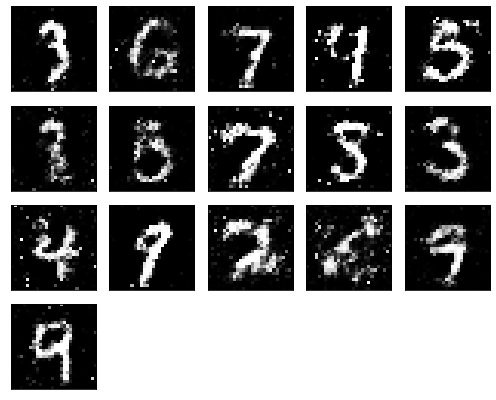

Epochs nb. 4911
discriminator loss: 0.6931155920028687
generator loss : 1.0335047245025635

Epochs nb. 4912
discriminator loss: 0.6384143233299255
generator loss : 1.1328651905059814

Epochs nb. 4913
discriminator loss: 0.602195143699646
generator loss : 1.0657634735107422

Epochs nb. 4914
discriminator loss: 0.5393263101577759
generator loss : 1.089686393737793

Epochs nb. 4915
discriminator loss: 0.6119371652603149
generator loss : 1.039604902267456

Epochs nb. 4916
discriminator loss: 0.5389810800552368
generator loss : 0.9269008636474609

Epochs nb. 4917
discriminator loss: 0.4494643807411194
generator loss : 0.8431280255317688

Epochs nb. 4918
discriminator loss: 0.6236789226531982
generator loss : 0.766798198223114

Epochs nb. 4919
discriminator loss: 0.6294064521789551
generator loss : 0.8251305818557739

Epochs nb. 4920
discriminator loss: 0.6047292947769165
generator loss : 0.8367336988449097



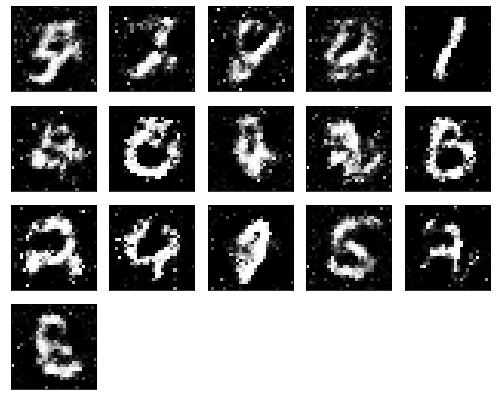

Epochs nb. 4921
discriminator loss: 0.5030926465988159
generator loss : 0.8691269159317017

Epochs nb. 4922
discriminator loss: 0.6379196643829346
generator loss : 1.030992031097412

Epochs nb. 4923
discriminator loss: 0.48789000511169434
generator loss : 1.1124998331069946

Epochs nb. 4924
discriminator loss: 0.6056654453277588
generator loss : 1.1721365451812744

Epochs nb. 4925
discriminator loss: 0.6817452907562256
generator loss : 0.9847205877304077

Epochs nb. 4926
discriminator loss: 0.6467864513397217
generator loss : 0.8748029470443726

Epochs nb. 4927
discriminator loss: 0.5183704495429993
generator loss : 1.0062519311904907

Epochs nb. 4928
discriminator loss: 0.5414273738861084
generator loss : 1.0796005725860596

Epochs nb. 4929
discriminator loss: 0.4755212664604187
generator loss : 1.135664939880371

Epochs nb. 4930
discriminator loss: 0.45287108421325684
generator loss : 1.0407567024230957



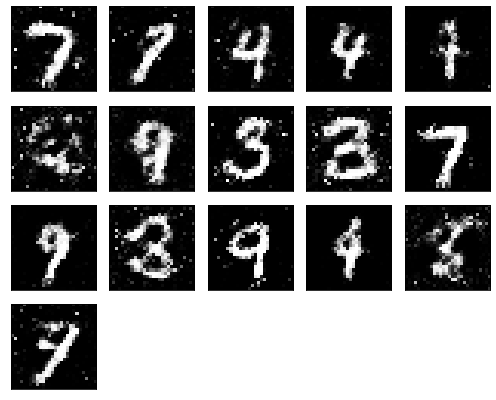

Epochs nb. 4931
discriminator loss: 0.5653790235519409
generator loss : 1.1094048023223877

Epochs nb. 4932
discriminator loss: 0.40458494424819946
generator loss : 0.9592685699462891

Epochs nb. 4933
discriminator loss: 0.7186840772628784
generator loss : 0.9694154858589172

Epochs nb. 4934
discriminator loss: 0.5322178602218628
generator loss : 1.06731116771698

Epochs nb. 4935
discriminator loss: 0.5232945084571838
generator loss : 1.1995797157287598

Epochs nb. 4936
discriminator loss: 0.6355662941932678
generator loss : 1.1872167587280273

Epochs nb. 4937
discriminator loss: 0.605527937412262
generator loss : 0.9687147736549377

Epochs nb. 4938
discriminator loss: 0.583346962928772
generator loss : 1.0618960857391357

Epochs nb. 4939
discriminator loss: 0.5954941511154175
generator loss : 1.0461935997009277

Epochs nb. 4940
discriminator loss: 0.49382635951042175
generator loss : 0.926102876663208



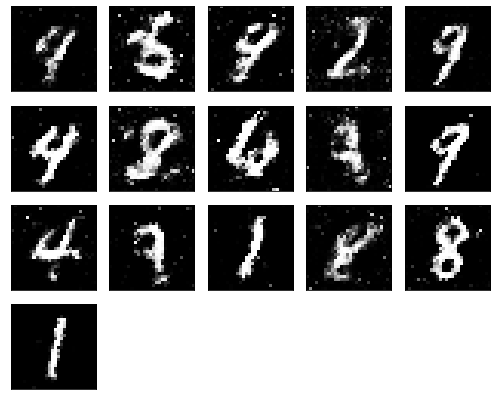

Epochs nb. 4941
discriminator loss: 0.6597779989242554
generator loss : 1.1299817562103271

Epochs nb. 4942
discriminator loss: 0.5919185876846313
generator loss : 1.2601885795593262

Epochs nb. 4943
discriminator loss: 0.5898383259773254
generator loss : 1.1725075244903564

Epochs nb. 4944
discriminator loss: 0.7648701667785645
generator loss : 1.2269638776779175

Epochs nb. 4945
discriminator loss: 0.6229942440986633
generator loss : 1.0238107442855835

Epochs nb. 4946
discriminator loss: 0.5906088352203369
generator loss : 0.9664559960365295

Epochs nb. 4947
discriminator loss: 0.5690757036209106
generator loss : 0.9411457180976868

Epochs nb. 4948
discriminator loss: 0.6472519040107727
generator loss : 1.0026800632476807

Epochs nb. 4949
discriminator loss: 0.7298088073730469
generator loss : 0.9674332141876221

Epochs nb. 4950
discriminator loss: 0.5977571606636047
generator loss : 1.0489529371261597



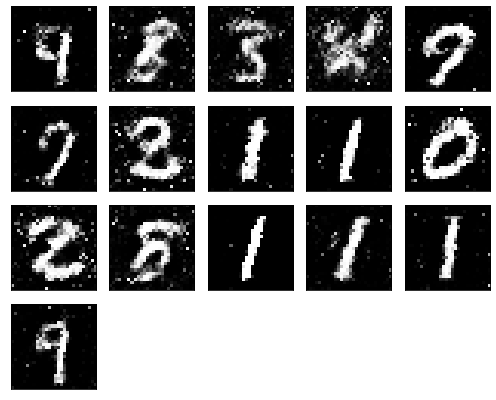

Epochs nb. 4951
discriminator loss: 0.5667743682861328
generator loss : 1.0141847133636475

Epochs nb. 4952
discriminator loss: 0.554766058921814
generator loss : 1.0850327014923096

Epochs nb. 4953
discriminator loss: 0.5891513824462891
generator loss : 1.144282579421997

Epochs nb. 4954
discriminator loss: 0.5027188658714294
generator loss : 0.9442911148071289

Epochs nb. 4955
discriminator loss: 0.5292519330978394
generator loss : 0.9072756171226501

Epochs nb. 4956
discriminator loss: 0.5265383720397949
generator loss : 0.9872720241546631

Epochs nb. 4957
discriminator loss: 0.6763471364974976
generator loss : 0.8744201064109802

Epochs nb. 4958
discriminator loss: 0.6079736948013306
generator loss : 0.8267883658409119

Epochs nb. 4959
discriminator loss: 0.7187105417251587
generator loss : 1.0886566638946533

Epochs nb. 4960
discriminator loss: 0.6621439456939697
generator loss : 0.9425485134124756



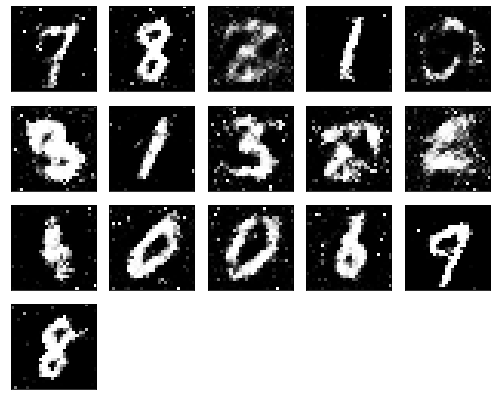

Epochs nb. 4961
discriminator loss: 0.6847043037414551
generator loss : 0.985381007194519

Epochs nb. 4962
discriminator loss: 0.7163169384002686
generator loss : 1.0119524002075195

Epochs nb. 4963
discriminator loss: 0.6030217409133911
generator loss : 0.9398576021194458

Epochs nb. 4964
discriminator loss: 0.5114050507545471
generator loss : 0.8836175799369812

Epochs nb. 4965
discriminator loss: 0.6039794683456421
generator loss : 0.9842679500579834

Epochs nb. 4966
discriminator loss: 0.5255414247512817
generator loss : 0.7911285161972046

Epochs nb. 4967
discriminator loss: 0.529026985168457
generator loss : 0.9582900404930115

Epochs nb. 4968
discriminator loss: 0.625650942325592
generator loss : 1.2551124095916748

Epochs nb. 4969
discriminator loss: 0.5586367845535278
generator loss : 1.0796606540679932

Epochs nb. 4970
discriminator loss: 0.49937668442726135
generator loss : 1.132312297821045



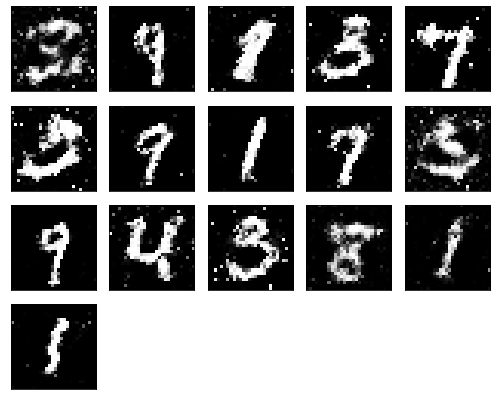

Epochs nb. 4971
discriminator loss: 0.545098066329956
generator loss : 1.0135736465454102

Epochs nb. 4972
discriminator loss: 0.6001613736152649
generator loss : 0.9125791788101196

Epochs nb. 4973
discriminator loss: 0.6788268685340881
generator loss : 0.8386624455451965

Epochs nb. 4974
discriminator loss: 0.6531801223754883
generator loss : 1.0791170597076416

Epochs nb. 4975
discriminator loss: 0.5826665163040161
generator loss : 0.913296103477478

Epochs nb. 4976
discriminator loss: 0.7087398171424866
generator loss : 1.0851571559906006

Epochs nb. 4977
discriminator loss: 0.46670764684677124
generator loss : 1.0994718074798584

Epochs nb. 4978
discriminator loss: 0.534853458404541
generator loss : 0.9556282758712769

Epochs nb. 4979
discriminator loss: 0.4758850932121277
generator loss : 0.9412670135498047

Epochs nb. 4980
discriminator loss: 0.6361711621284485
generator loss : 1.1766357421875



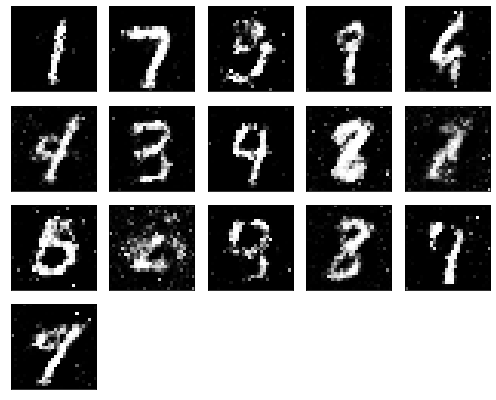

Epochs nb. 4981
discriminator loss: 0.5780333280563354
generator loss : 0.8432520627975464

Epochs nb. 4982
discriminator loss: 0.4755009710788727
generator loss : 0.8772057294845581

Epochs nb. 4983
discriminator loss: 0.6460179686546326
generator loss : 1.0744335651397705

Epochs nb. 4984
discriminator loss: 0.6904497146606445
generator loss : 1.0850945711135864

Epochs nb. 4985
discriminator loss: 0.6239405870437622
generator loss : 0.8596951961517334

Epochs nb. 4986
discriminator loss: 0.584563136100769
generator loss : 0.7787233591079712

Epochs nb. 4987
discriminator loss: 0.6317399740219116
generator loss : 1.0272622108459473

Epochs nb. 4988
discriminator loss: 0.6049160957336426
generator loss : 1.116525650024414

Epochs nb. 4989
discriminator loss: 0.5937271118164062
generator loss : 0.9874167442321777

Epochs nb. 4990
discriminator loss: 0.4585322141647339
generator loss : 1.048816442489624



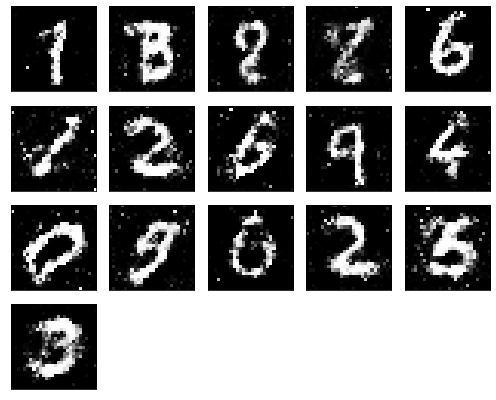

Epochs nb. 4991
discriminator loss: 0.6646854877471924
generator loss : 0.9135279059410095

Epochs nb. 4992
discriminator loss: 0.5519015789031982
generator loss : 1.0992043018341064

Epochs nb. 4993
discriminator loss: 0.56524658203125
generator loss : 0.9113432168960571

Epochs nb. 4994
discriminator loss: 0.6387721300125122
generator loss : 1.0134804248809814

Epochs nb. 4995
discriminator loss: 0.6834869384765625
generator loss : 0.8525452613830566

Epochs nb. 4996
discriminator loss: 0.5157967805862427
generator loss : 0.8644744157791138

Epochs nb. 4997
discriminator loss: 0.6367902755737305
generator loss : 0.9443563222885132

Epochs nb. 4998
discriminator loss: 0.5940167307853699
generator loss : 0.8725374937057495

Epochs nb. 4999
discriminator loss: 0.5304145812988281
generator loss : 0.8427757024765015

Epochs nb. 5000
discriminator loss: 0.6662600636482239
generator loss : 1.0474395751953125



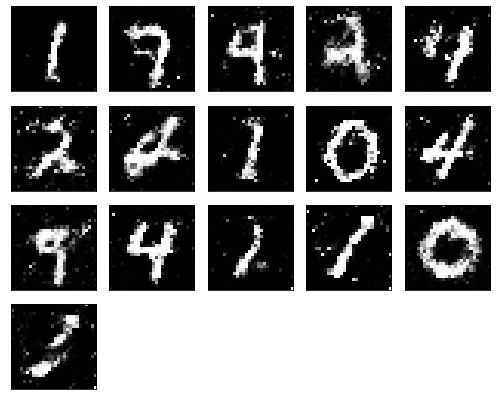

Epochs nb. 5001
discriminator loss: 0.5792351961135864
generator loss : 0.8894685506820679

Epochs nb. 5002
discriminator loss: 0.6065181493759155
generator loss : 1.0075314044952393

Epochs nb. 5003
discriminator loss: 0.7074788212776184
generator loss : 0.9618573188781738

Epochs nb. 5004
discriminator loss: 0.5914701223373413
generator loss : 0.8169638514518738

Epochs nb. 5005
discriminator loss: 0.5352100133895874
generator loss : 0.9388310313224792

Epochs nb. 5006
discriminator loss: 0.7049394845962524
generator loss : 0.9536861777305603

Epochs nb. 5007
discriminator loss: 0.6277346611022949
generator loss : 0.9314327836036682

Epochs nb. 5008
discriminator loss: 0.40788352489471436
generator loss : 0.8838441967964172

Epochs nb. 5009
discriminator loss: 0.6119118928909302
generator loss : 1.1541813611984253

Epochs nb. 5010
discriminator loss: 0.6610151529312134
generator loss : 0.9983370900154114



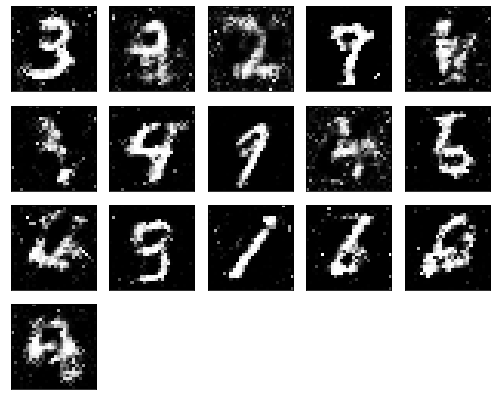

Epochs nb. 5011
discriminator loss: 0.5617743134498596
generator loss : 1.0091629028320312

Epochs nb. 5012
discriminator loss: 0.6981476545333862
generator loss : 0.9970796704292297

Epochs nb. 5013
discriminator loss: 0.6031585335731506
generator loss : 1.2518292665481567

Epochs nb. 5014
discriminator loss: 0.5684174299240112
generator loss : 1.1416680812835693

Epochs nb. 5015
discriminator loss: 0.5880888104438782
generator loss : 1.0015149116516113

Epochs nb. 5016
discriminator loss: 0.5438041687011719
generator loss : 0.9723698496818542

Epochs nb. 5017
discriminator loss: 0.53897625207901
generator loss : 1.0899651050567627

Epochs nb. 5018
discriminator loss: 0.4730226993560791
generator loss : 0.9860483407974243

Epochs nb. 5019
discriminator loss: 0.48744139075279236
generator loss : 0.9037744998931885

Epochs nb. 5020
discriminator loss: 0.6906156539916992
generator loss : 1.0323350429534912



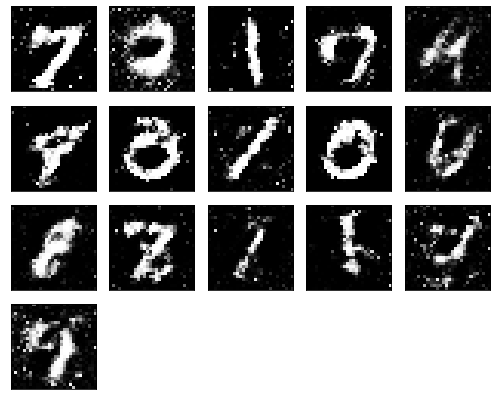

Epochs nb. 5021
discriminator loss: 0.7835485935211182
generator loss : 0.937809944152832

Epochs nb. 5022
discriminator loss: 0.5892452001571655
generator loss : 0.8983123302459717

Epochs nb. 5023
discriminator loss: 0.6351510286331177
generator loss : 1.0413492918014526

Epochs nb. 5024
discriminator loss: 0.6152157783508301
generator loss : 1.0566890239715576

Epochs nb. 5025
discriminator loss: 0.6511005759239197
generator loss : 0.8837486505508423

Epochs nb. 5026
discriminator loss: 0.5204777121543884
generator loss : 0.7818456888198853

Epochs nb. 5027
discriminator loss: 0.5270562171936035
generator loss : 0.9897289276123047

Epochs nb. 5028
discriminator loss: 0.5962074995040894
generator loss : 0.9062856435775757

Epochs nb. 5029
discriminator loss: 0.6234579086303711
generator loss : 0.891598641872406

Epochs nb. 5030
discriminator loss: 0.6268895864486694
generator loss : 0.7802395820617676



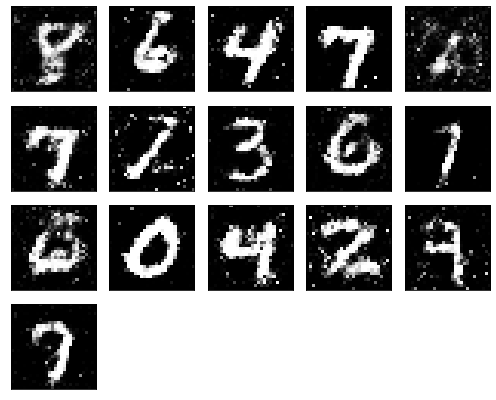

Epochs nb. 5031
discriminator loss: 0.6543474197387695
generator loss : 0.8081072568893433

Epochs nb. 5032
discriminator loss: 0.5823454856872559
generator loss : 0.9268786311149597

Epochs nb. 5033
discriminator loss: 0.49824732542037964
generator loss : 1.0017814636230469

Epochs nb. 5034
discriminator loss: 0.49031662940979004
generator loss : 1.0530987977981567

Epochs nb. 5035
discriminator loss: 0.49903160333633423
generator loss : 0.9267925024032593

Epochs nb. 5036
discriminator loss: 0.7472892999649048
generator loss : 0.9838173389434814

Epochs nb. 5037
discriminator loss: 0.6717096567153931
generator loss : 0.8717464208602905

Epochs nb. 5038
discriminator loss: 0.5263651609420776
generator loss : 1.047827959060669

Epochs nb. 5039
discriminator loss: 0.6521443128585815
generator loss : 1.034980058670044

Epochs nb. 5040
discriminator loss: 0.6680018901824951
generator loss : 0.8657763004302979



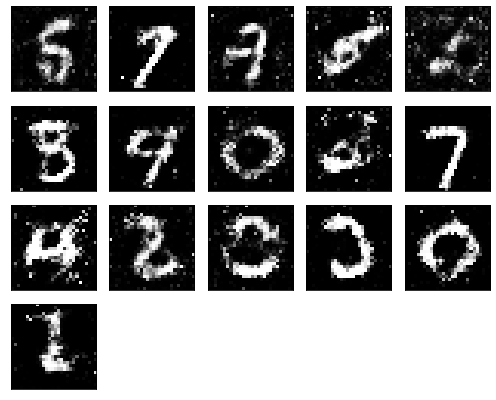

Epochs nb. 5041
discriminator loss: 0.6637395620346069
generator loss : 0.8733921051025391

Epochs nb. 5042
discriminator loss: 0.6399856209754944
generator loss : 0.8315789699554443

Epochs nb. 5043
discriminator loss: 0.6008299589157104
generator loss : 1.0176364183425903

Epochs nb. 5044
discriminator loss: 0.46895939111709595
generator loss : 1.008557677268982

Epochs nb. 5045
discriminator loss: 0.5680714845657349
generator loss : 1.1797759532928467

Epochs nb. 5046
discriminator loss: 0.5999088287353516
generator loss : 0.9784616827964783

Epochs nb. 5047
discriminator loss: 0.5432819724082947
generator loss : 1.0722920894622803

Epochs nb. 5048
discriminator loss: 0.5532039403915405
generator loss : 0.9556390643119812

Epochs nb. 5049
discriminator loss: 0.5335777401924133
generator loss : 1.0355100631713867

Epochs nb. 5050
discriminator loss: 0.7781241536140442
generator loss : 1.036780595779419



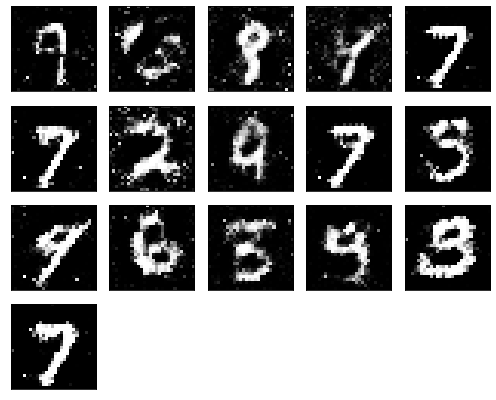

Epochs nb. 5051
discriminator loss: 0.6693102121353149
generator loss : 1.0804243087768555

Epochs nb. 5052
discriminator loss: 0.46540945768356323
generator loss : 1.19679594039917

Epochs nb. 5053
discriminator loss: 0.7721807956695557
generator loss : 0.8819432258605957

Epochs nb. 5054
discriminator loss: 0.6570955514907837
generator loss : 0.7750095129013062

Epochs nb. 5055
discriminator loss: 0.5920054912567139
generator loss : 0.9494369626045227

Epochs nb. 5056
discriminator loss: 0.7070913314819336
generator loss : 0.9532349109649658

Epochs nb. 5057
discriminator loss: 0.5173212289810181
generator loss : 1.0167090892791748

Epochs nb. 5058
discriminator loss: 0.6403460502624512
generator loss : 0.963806688785553

Epochs nb. 5059
discriminator loss: 0.690485954284668
generator loss : 0.9156709909439087

Epochs nb. 5060
discriminator loss: 0.6686074733734131
generator loss : 0.8300618529319763



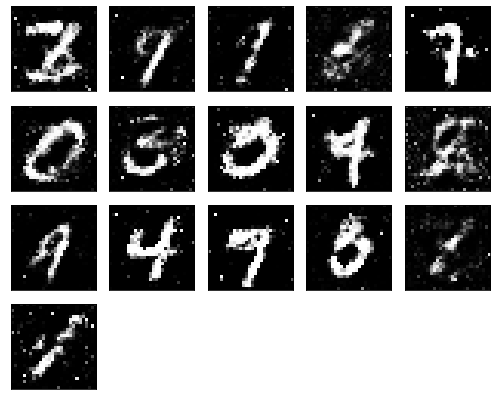

Epochs nb. 5061
discriminator loss: 0.7726719975471497
generator loss : 1.1049931049346924

Epochs nb. 5062
discriminator loss: 0.651462733745575
generator loss : 0.9430166482925415

Epochs nb. 5063
discriminator loss: 0.5908600687980652
generator loss : 1.0392839908599854

Epochs nb. 5064
discriminator loss: 0.5244748592376709
generator loss : 0.9813065528869629

Epochs nb. 5065
discriminator loss: 0.6015223264694214
generator loss : 0.8431336879730225

Epochs nb. 5066
discriminator loss: 0.5552229881286621
generator loss : 0.9019582867622375

Epochs nb. 5067
discriminator loss: 0.6900386810302734
generator loss : 0.9384874105453491

Epochs nb. 5068
discriminator loss: 0.509110689163208
generator loss : 0.9513359069824219

Epochs nb. 5069
discriminator loss: 0.42340558767318726
generator loss : 1.045318603515625

Epochs nb. 5070
discriminator loss: 0.674737811088562
generator loss : 0.9896998405456543



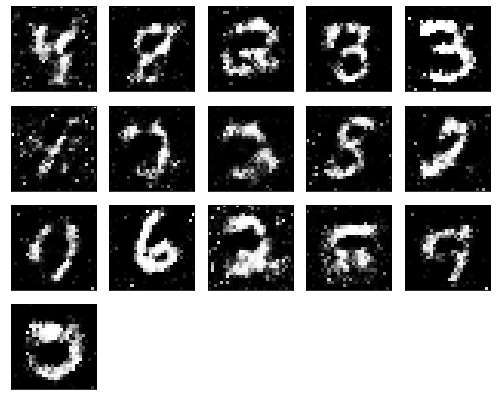

Epochs nb. 5071
discriminator loss: 0.5586210489273071
generator loss : 1.0485795736312866

Epochs nb. 5072
discriminator loss: 0.4366602897644043
generator loss : 0.891968846321106

Epochs nb. 5073
discriminator loss: 0.5336937308311462
generator loss : 0.7579180598258972

Epochs nb. 5074
discriminator loss: 0.9083278179168701
generator loss : 0.9471412897109985

Epochs nb. 5075
discriminator loss: 0.6388900279998779
generator loss : 0.9612672328948975

Epochs nb. 5076
discriminator loss: 0.6073347926139832
generator loss : 0.9614139795303345

Epochs nb. 5077
discriminator loss: 0.5713887214660645
generator loss : 1.0488361120224

Epochs nb. 5078
discriminator loss: 0.5630780458450317
generator loss : 0.8916070461273193

Epochs nb. 5079
discriminator loss: 0.7220488786697388
generator loss : 0.9530438184738159

Epochs nb. 5080
discriminator loss: 0.6259835958480835
generator loss : 0.958899199962616



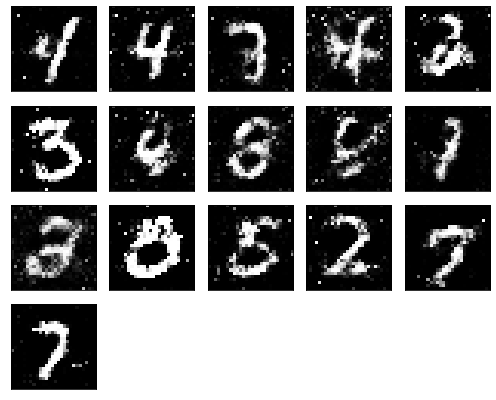

Epochs nb. 5081
discriminator loss: 0.6043805480003357
generator loss : 0.8506758213043213

Epochs nb. 5082
discriminator loss: 0.4829181432723999
generator loss : 1.0664950609207153

Epochs nb. 5083
discriminator loss: 0.5059903264045715
generator loss : 0.781508207321167

Epochs nb. 5084
discriminator loss: 0.6513810753822327
generator loss : 0.9420633912086487

Epochs nb. 5085
discriminator loss: 0.6298953890800476
generator loss : 0.990019679069519

Epochs nb. 5086
discriminator loss: 0.5067914724349976
generator loss : 1.087202548980713

Epochs nb. 5087
discriminator loss: 0.6613304615020752
generator loss : 0.9313204288482666

Epochs nb. 5088
discriminator loss: 0.4777936339378357
generator loss : 0.9185861945152283

Epochs nb. 5089
discriminator loss: 0.6143105030059814
generator loss : 1.181854486465454

Epochs nb. 5090
discriminator loss: 0.639377236366272
generator loss : 0.9661024212837219



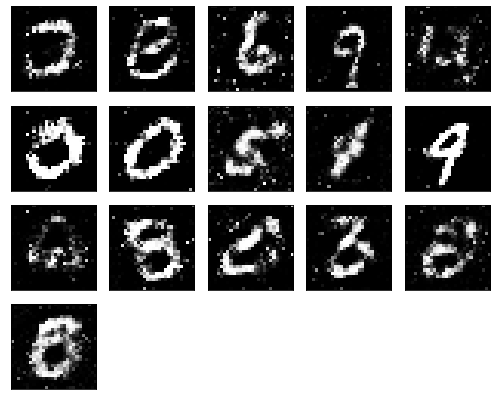

Epochs nb. 5091
discriminator loss: 0.5367956161499023
generator loss : 1.088256597518921

Epochs nb. 5092
discriminator loss: 0.6999918818473816
generator loss : 1.0790808200836182

Epochs nb. 5093
discriminator loss: 0.5370622873306274
generator loss : 1.0027527809143066

Epochs nb. 5094
discriminator loss: 0.5890724658966064
generator loss : 0.817206084728241

Epochs nb. 5095
discriminator loss: 0.5548769235610962
generator loss : 0.9080817699432373

Epochs nb. 5096
discriminator loss: 0.5323319435119629
generator loss : 0.901029109954834

Epochs nb. 5097
discriminator loss: 0.6142569780349731
generator loss : 0.8976259231567383

Epochs nb. 5098
discriminator loss: 0.6507810354232788
generator loss : 0.8228393793106079

Epochs nb. 5099
discriminator loss: 0.5531874895095825
generator loss : 0.7369227409362793

Epochs nb. 5100
discriminator loss: 0.5529884099960327
generator loss : 0.9125619530677795



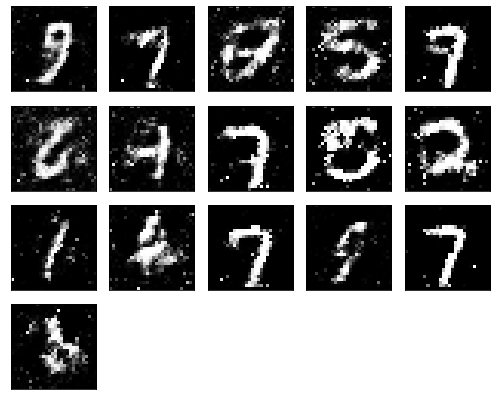

Epochs nb. 5101
discriminator loss: 0.5519662499427795
generator loss : 0.9821320176124573

Epochs nb. 5102
discriminator loss: 0.5004012584686279
generator loss : 0.8925730586051941

Epochs nb. 5103
discriminator loss: 0.7145771980285645
generator loss : 0.9038547277450562

Epochs nb. 5104
discriminator loss: 0.6532536149024963
generator loss : 1.0435984134674072

Epochs nb. 5105
discriminator loss: 0.7160913944244385
generator loss : 1.1376183032989502

Epochs nb. 5106
discriminator loss: 0.6127041578292847
generator loss : 1.0487263202667236

Epochs nb. 5107
discriminator loss: 0.5765820741653442
generator loss : 1.193790078163147

Epochs nb. 5108
discriminator loss: 0.606867790222168
generator loss : 0.84468013048172

Epochs nb. 5109
discriminator loss: 0.5476341843605042
generator loss : 0.9039990901947021

Epochs nb. 5110
discriminator loss: 0.6506482362747192
generator loss : 0.9478590488433838



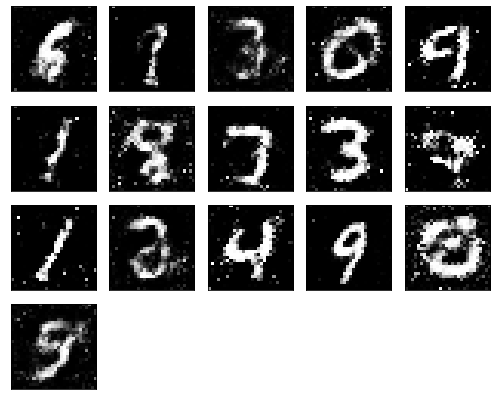

Epochs nb. 5111
discriminator loss: 0.5741753578186035
generator loss : 1.010484218597412

Epochs nb. 5112
discriminator loss: 0.4995642304420471
generator loss : 0.9583985805511475

Epochs nb. 5113
discriminator loss: 0.6100925207138062
generator loss : 1.1164946556091309

Epochs nb. 5114
discriminator loss: 0.6688738465309143
generator loss : 1.0452489852905273

Epochs nb. 5115
discriminator loss: 0.5087296962738037
generator loss : 1.0371006727218628

Epochs nb. 5116
discriminator loss: 0.5892476439476013
generator loss : 1.0338853597640991

Epochs nb. 5117
discriminator loss: 0.42009270191192627
generator loss : 0.9335150718688965

Epochs nb. 5118
discriminator loss: 0.6080819368362427
generator loss : 1.085275650024414

Epochs nb. 5119
discriminator loss: 0.5437920093536377
generator loss : 1.0137081146240234

Epochs nb. 5120
discriminator loss: 0.6406714916229248
generator loss : 0.8900455236434937



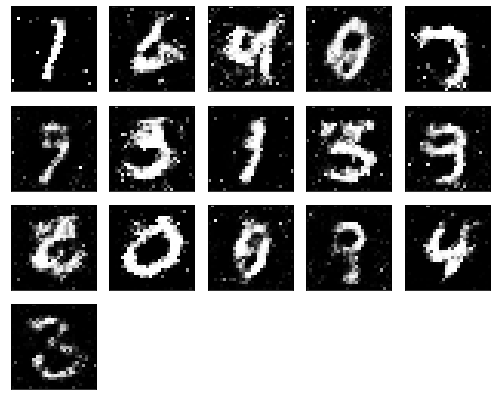

Epochs nb. 5121
discriminator loss: 0.5483591556549072
generator loss : 1.0258396863937378

Epochs nb. 5122
discriminator loss: 0.5716429948806763
generator loss : 0.9178781509399414

Epochs nb. 5123
discriminator loss: 0.6506807208061218
generator loss : 1.2872018814086914

Epochs nb. 5124
discriminator loss: 0.5977729558944702
generator loss : 0.9297126531600952

Epochs nb. 5125
discriminator loss: 0.44921672344207764
generator loss : 1.0468579530715942

Epochs nb. 5126
discriminator loss: 0.6936325430870056
generator loss : 1.2026177644729614

Epochs nb. 5127
discriminator loss: 0.6032898426055908
generator loss : 1.1192383766174316

Epochs nb. 5128
discriminator loss: 0.4918425381183624
generator loss : 0.8455970287322998

Epochs nb. 5129
discriminator loss: 0.6525409817695618
generator loss : 0.9256216287612915

Epochs nb. 5130
discriminator loss: 0.6514227390289307
generator loss : 0.9026994109153748



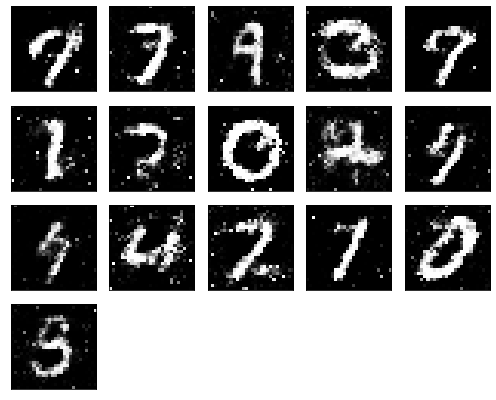

Epochs nb. 5131
discriminator loss: 0.5999839305877686
generator loss : 1.01310133934021

Epochs nb. 5132
discriminator loss: 0.6192013025283813
generator loss : 0.8027445077896118

Epochs nb. 5133
discriminator loss: 0.6613500118255615
generator loss : 0.7332416772842407

Epochs nb. 5134
discriminator loss: 0.6411093473434448
generator loss : 0.8256056904792786

Epochs nb. 5135
discriminator loss: 0.5646967887878418
generator loss : 0.747745156288147

Epochs nb. 5136
discriminator loss: 0.5485983490943909
generator loss : 0.9879587888717651

Epochs nb. 5137
discriminator loss: 0.49450719356536865
generator loss : 0.9332680702209473

Epochs nb. 5138
discriminator loss: 0.5885946750640869
generator loss : 1.047224760055542

Epochs nb. 5139
discriminator loss: 0.6652002930641174
generator loss : 0.8815982341766357

Epochs nb. 5140
discriminator loss: 0.6519481539726257
generator loss : 0.9148672819137573



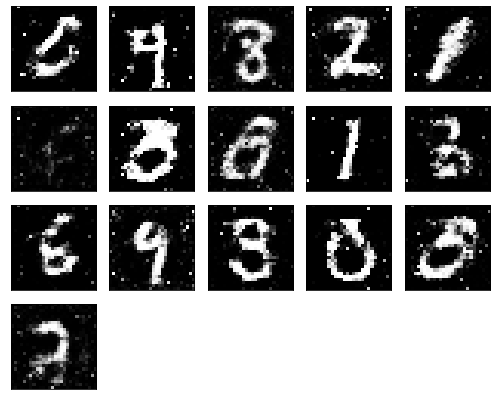

Epochs nb. 5141
discriminator loss: 0.5467418432235718
generator loss : 0.8368316888809204

Epochs nb. 5142
discriminator loss: 0.6441730260848999
generator loss : 1.072109580039978

Epochs nb. 5143
discriminator loss: 0.6005135774612427
generator loss : 1.1723651885986328

Epochs nb. 5144
discriminator loss: 0.7294074296951294
generator loss : 1.0792911052703857

Epochs nb. 5145
discriminator loss: 0.7369332313537598
generator loss : 0.9977607727050781

Epochs nb. 5146
discriminator loss: 0.5850218534469604
generator loss : 1.0030114650726318

Epochs nb. 5147
discriminator loss: 0.5006117820739746
generator loss : 0.9495646953582764

Epochs nb. 5148
discriminator loss: 0.5226871967315674
generator loss : 0.9473938345909119

Epochs nb. 5149
discriminator loss: 0.741442859172821
generator loss : 0.9189627170562744

Epochs nb. 5150
discriminator loss: 0.5535429120063782
generator loss : 0.893445611000061



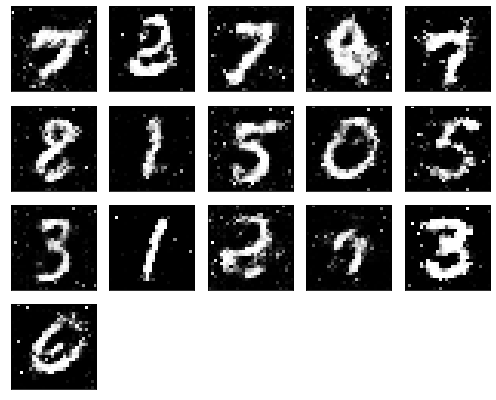

Epochs nb. 5151
discriminator loss: 0.6322126984596252
generator loss : 1.0030531883239746

Epochs nb. 5152
discriminator loss: 0.6162710189819336
generator loss : 1.087601900100708

Epochs nb. 5153
discriminator loss: 0.7580245733261108
generator loss : 0.8730525970458984

Epochs nb. 5154
discriminator loss: 0.5286880135536194
generator loss : 0.9526874423027039

Epochs nb. 5155
discriminator loss: 0.6518157720565796
generator loss : 0.9514577388763428

Epochs nb. 5156
discriminator loss: 0.5383356809616089
generator loss : 1.0774989128112793

Epochs nb. 5157
discriminator loss: 0.5474107265472412
generator loss : 0.8379489183425903

Epochs nb. 5158
discriminator loss: 0.6436051726341248
generator loss : 0.8401781916618347

Epochs nb. 5159
discriminator loss: 0.7323223352432251
generator loss : 0.9837989211082458

Epochs nb. 5160
discriminator loss: 0.6248694658279419
generator loss : 0.8704495429992676



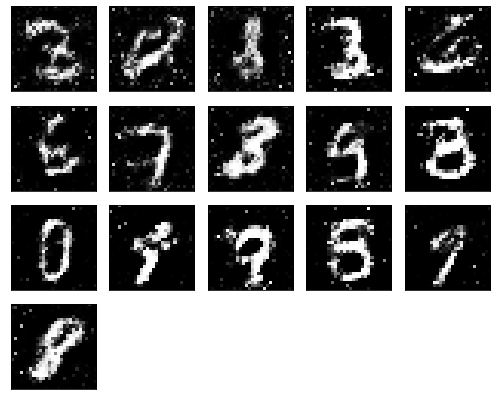

Epochs nb. 5161
discriminator loss: 0.6605105400085449
generator loss : 1.077218770980835

Epochs nb. 5162
discriminator loss: 0.5915354490280151
generator loss : 0.8802120685577393

Epochs nb. 5163
discriminator loss: 0.5890085697174072
generator loss : 1.0625841617584229

Epochs nb. 5164
discriminator loss: 0.5278356075286865
generator loss : 1.0756317377090454

Epochs nb. 5165
discriminator loss: 0.6525253057479858
generator loss : 1.1085205078125

Epochs nb. 5166
discriminator loss: 0.5912824869155884
generator loss : 1.0564632415771484

Epochs nb. 5167
discriminator loss: 0.6167421340942383
generator loss : 1.0050222873687744

Epochs nb. 5168
discriminator loss: 0.6346027851104736
generator loss : 1.1021214723587036

Epochs nb. 5169
discriminator loss: 0.6674233675003052
generator loss : 1.0635604858398438

Epochs nb. 5170
discriminator loss: 0.6806280612945557
generator loss : 1.0474117994308472



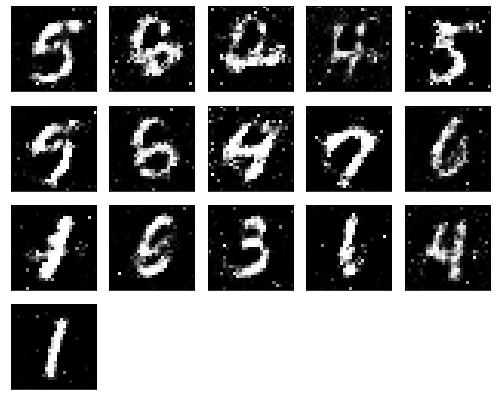

Epochs nb. 5171
discriminator loss: 0.45139646530151367
generator loss : 0.7322489023208618

Epochs nb. 5172
discriminator loss: 0.56524658203125
generator loss : 0.8358840942382812

Epochs nb. 5173
discriminator loss: 0.5552463531494141
generator loss : 0.8363478779792786

Epochs nb. 5174
discriminator loss: 0.4798099398612976
generator loss : 1.159860372543335

Epochs nb. 5175
discriminator loss: 0.7077433466911316
generator loss : 1.195838212966919

Epochs nb. 5176
discriminator loss: 0.7425992488861084
generator loss : 1.0955626964569092

Epochs nb. 5177
discriminator loss: 0.7478708624839783
generator loss : 1.1615214347839355

Epochs nb. 5178
discriminator loss: 0.4973735213279724
generator loss : 0.974208414554596

Epochs nb. 5179
discriminator loss: 0.5789957642555237
generator loss : 0.8195906281471252

Epochs nb. 5180
discriminator loss: 0.7536447644233704
generator loss : 0.9166592359542847



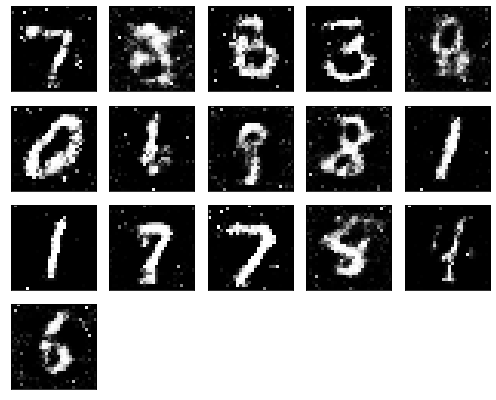

Epochs nb. 5181
discriminator loss: 0.6279675960540771
generator loss : 0.9960564374923706

Epochs nb. 5182
discriminator loss: 0.5958380103111267
generator loss : 0.9644457697868347

Epochs nb. 5183
discriminator loss: 0.5291486382484436
generator loss : 0.9803454875946045

Epochs nb. 5184
discriminator loss: 0.5030313730239868
generator loss : 1.1414785385131836

Epochs nb. 5185
discriminator loss: 0.5197252631187439
generator loss : 0.9507380127906799

Epochs nb. 5186
discriminator loss: 0.6506936550140381
generator loss : 0.9663286805152893

Epochs nb. 5187
discriminator loss: 0.5442890524864197
generator loss : 0.950303316116333

Epochs nb. 5188
discriminator loss: 0.6058039665222168
generator loss : 0.99805748462677

Epochs nb. 5189
discriminator loss: 0.6230927109718323
generator loss : 1.0907622575759888

Epochs nb. 5190
discriminator loss: 0.6458359956741333
generator loss : 1.2086212635040283



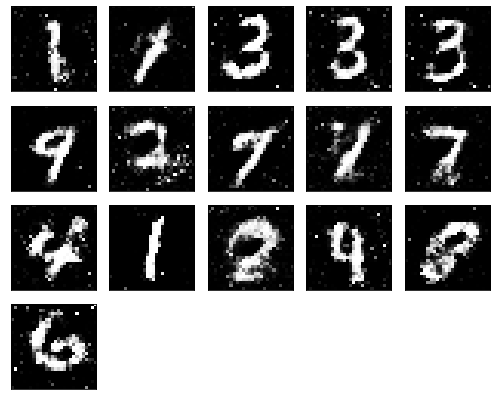

Epochs nb. 5191
discriminator loss: 0.5714568495750427
generator loss : 1.2377301454544067

Epochs nb. 5192
discriminator loss: 0.5545918941497803
generator loss : 0.9795779585838318

Epochs nb. 5193
discriminator loss: 0.5773582458496094
generator loss : 0.8456224799156189

Epochs nb. 5194
discriminator loss: 0.654319703578949
generator loss : 1.032146692276001

Epochs nb. 5195
discriminator loss: 0.4794071912765503
generator loss : 1.000872015953064

Epochs nb. 5196
discriminator loss: 0.5366580486297607
generator loss : 0.9598191976547241

Epochs nb. 5197
discriminator loss: 0.5083594918251038
generator loss : 0.7615087032318115

Epochs nb. 5198
discriminator loss: 0.5876306295394897
generator loss : 0.8968774080276489

Epochs nb. 5199
discriminator loss: 0.6174975633621216
generator loss : 0.9424722194671631

Epochs nb. 5200
discriminator loss: 0.5196506977081299
generator loss : 0.9132382869720459



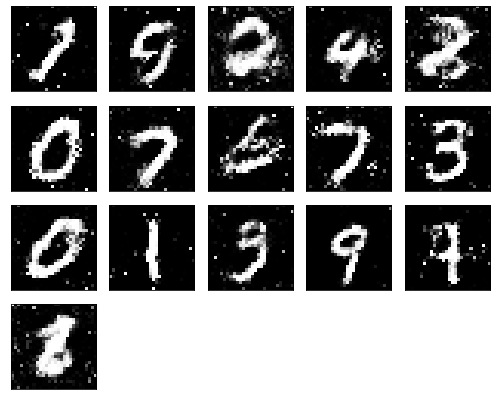

Epochs nb. 5201
discriminator loss: 0.635707437992096
generator loss : 1.0331273078918457

Epochs nb. 5202
discriminator loss: 0.7433695197105408
generator loss : 0.9618622064590454

Epochs nb. 5203
discriminator loss: 0.589821457862854
generator loss : 0.9734244346618652

Epochs nb. 5204
discriminator loss: 0.5742937326431274
generator loss : 1.063311219215393

Epochs nb. 5205
discriminator loss: 0.5583983659744263
generator loss : 0.9532193541526794

Epochs nb. 5206
discriminator loss: 0.7770037651062012
generator loss : 0.9587411880493164

Epochs nb. 5207
discriminator loss: 0.6648902297019958
generator loss : 0.942202627658844

Epochs nb. 5208
discriminator loss: 0.6299244165420532
generator loss : 0.9439049959182739

Epochs nb. 5209
discriminator loss: 0.5639135837554932
generator loss : 0.9962741136550903

Epochs nb. 5210
discriminator loss: 0.4781010150909424
generator loss : 0.971672534942627



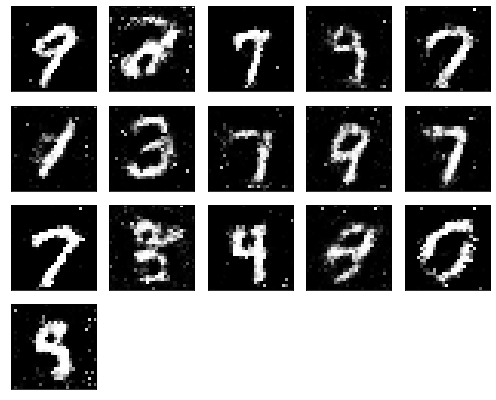

Epochs nb. 5211
discriminator loss: 0.5362850427627563
generator loss : 0.9104471802711487

Epochs nb. 5212
discriminator loss: 0.5472744107246399
generator loss : 0.929232656955719

Epochs nb. 5213
discriminator loss: 0.5525141358375549
generator loss : 1.1970361471176147

Epochs nb. 5214
discriminator loss: 0.5533424019813538
generator loss : 0.9008103013038635

Epochs nb. 5215
discriminator loss: 0.5298060774803162
generator loss : 0.9992024898529053

Epochs nb. 5216
discriminator loss: 0.4974904954433441
generator loss : 0.9287253618240356

Epochs nb. 5217
discriminator loss: 0.6243956685066223
generator loss : 1.084966778755188

Epochs nb. 5218
discriminator loss: 0.6194471120834351
generator loss : 1.020462155342102

Epochs nb. 5219
discriminator loss: 0.6816713809967041
generator loss : 1.1037402153015137

Epochs nb. 5220
discriminator loss: 0.6935418844223022
generator loss : 1.1120342016220093



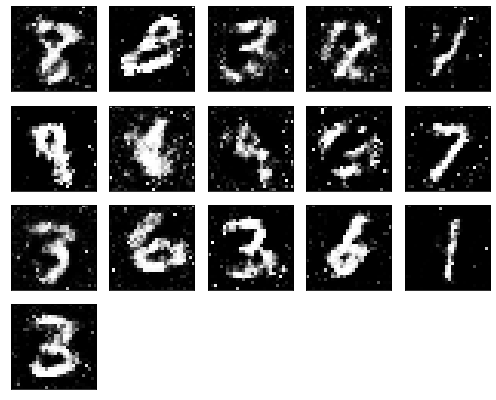

Epochs nb. 5221
discriminator loss: 0.6305321455001831
generator loss : 1.0996639728546143

Epochs nb. 5222
discriminator loss: 0.6771302819252014
generator loss : 1.1227827072143555

Epochs nb. 5223
discriminator loss: 0.6083149909973145
generator loss : 0.9636488556861877

Epochs nb. 5224
discriminator loss: 0.5140471458435059
generator loss : 0.9587287306785583

Epochs nb. 5225
discriminator loss: 0.6125059723854065
generator loss : 0.8285571336746216

Epochs nb. 5226
discriminator loss: 0.6530841588973999
generator loss : 0.9351155757904053

Epochs nb. 5227
discriminator loss: 0.6506490111351013
generator loss : 0.8789386749267578

Epochs nb. 5228
discriminator loss: 0.7133643627166748
generator loss : 0.8951261043548584

Epochs nb. 5229
discriminator loss: 0.4939723610877991
generator loss : 1.062573790550232

Epochs nb. 5230
discriminator loss: 0.5209324955940247
generator loss : 0.8422060012817383



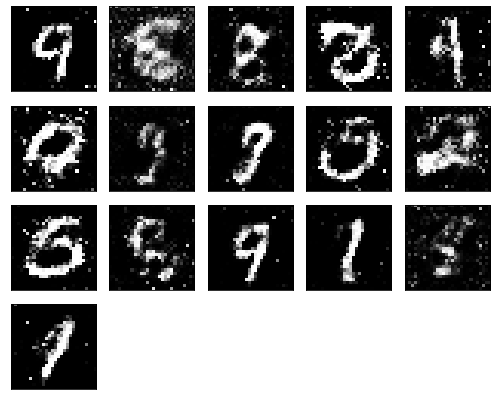

Epochs nb. 5231
discriminator loss: 0.5611140727996826
generator loss : 1.2024402618408203

Epochs nb. 5232
discriminator loss: 0.5565298199653625
generator loss : 0.861872136592865

Epochs nb. 5233
discriminator loss: 0.5719765424728394
generator loss : 0.9427087306976318

Epochs nb. 5234
discriminator loss: 0.5276671648025513
generator loss : 0.9303864240646362

Epochs nb. 5235
discriminator loss: 0.4179326295852661
generator loss : 0.9223691821098328

Epochs nb. 5236
discriminator loss: 0.585204541683197
generator loss : 1.0604228973388672

Epochs nb. 5237
discriminator loss: 0.5556721091270447
generator loss : 0.9295831322669983

Epochs nb. 5238
discriminator loss: 0.6212818622589111
generator loss : 0.7915164232254028

Epochs nb. 5239
discriminator loss: 0.6400381326675415
generator loss : 0.7539786696434021

Epochs nb. 5240
discriminator loss: 0.631714940071106
generator loss : 1.0165960788726807



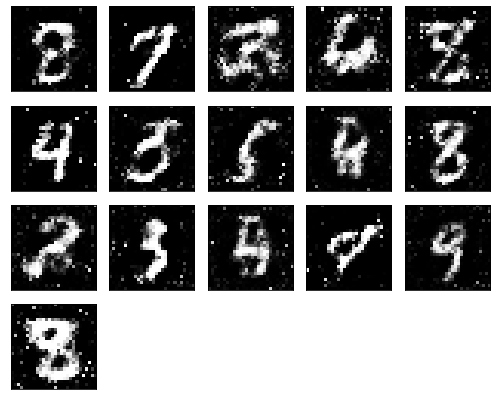

Epochs nb. 5241
discriminator loss: 0.7364366054534912
generator loss : 1.0841220617294312

Epochs nb. 5242
discriminator loss: 0.5680927038192749
generator loss : 1.0096039772033691

Epochs nb. 5243
discriminator loss: 0.672377347946167
generator loss : 1.0846713781356812

Epochs nb. 5244
discriminator loss: 0.6681047677993774
generator loss : 1.1323997974395752

Epochs nb. 5245
discriminator loss: 0.6017870903015137
generator loss : 0.9653644561767578

Epochs nb. 5246
discriminator loss: 0.6198786497116089
generator loss : 0.6959414482116699

Epochs nb. 5247
discriminator loss: 0.5479742288589478
generator loss : 0.9755392074584961

Epochs nb. 5248
discriminator loss: 0.6050643920898438
generator loss : 0.8545275926589966

Epochs nb. 5249
discriminator loss: 0.7770106792449951
generator loss : 0.7103153467178345

Epochs nb. 5250
discriminator loss: 0.5209555625915527
generator loss : 0.865136981010437



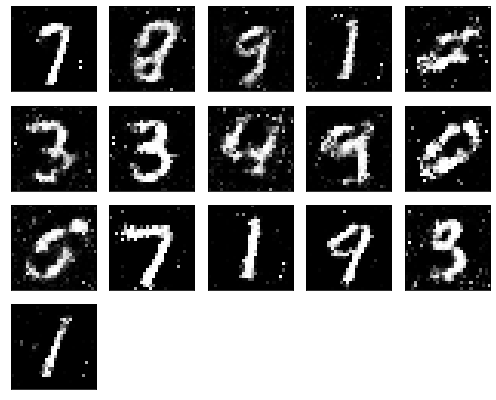

Epochs nb. 5251
discriminator loss: 0.6716086864471436
generator loss : 1.0155799388885498

Epochs nb. 5252
discriminator loss: 0.49876007437705994
generator loss : 0.7463746666908264

Epochs nb. 5253
discriminator loss: 0.7174071073532104
generator loss : 1.1732075214385986

Epochs nb. 5254
discriminator loss: 0.6340272426605225
generator loss : 1.122910737991333

Epochs nb. 5255
discriminator loss: 0.6144788265228271
generator loss : 0.8290024995803833

Epochs nb. 5256
discriminator loss: 0.6025638580322266
generator loss : 0.6801580190658569

Epochs nb. 5257
discriminator loss: 0.5862485766410828
generator loss : 0.924263060092926

Epochs nb. 5258
discriminator loss: 0.492171049118042
generator loss : 0.9960941076278687

Epochs nb. 5259
discriminator loss: 0.6377208232879639
generator loss : 1.0037076473236084

Epochs nb. 5260
discriminator loss: 0.5149199962615967
generator loss : 0.938480019569397



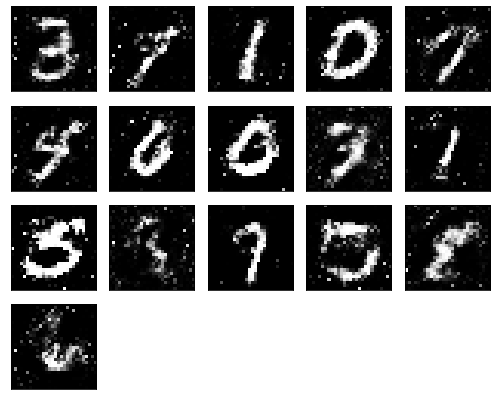

Epochs nb. 5261
discriminator loss: 0.5839207172393799
generator loss : 1.1155471801757812

Epochs nb. 5262
discriminator loss: 0.6668928861618042
generator loss : 1.058556318283081

Epochs nb. 5263
discriminator loss: 0.6223458647727966
generator loss : 1.225710153579712

Epochs nb. 5264
discriminator loss: 0.4998037815093994
generator loss : 1.079673171043396

Epochs nb. 5265
discriminator loss: 0.6136001348495483
generator loss : 0.9742665886878967

Epochs nb. 5266
discriminator loss: 0.7204193472862244
generator loss : 0.8705554604530334

Epochs nb. 5267
discriminator loss: 0.5416496992111206
generator loss : 1.0804888010025024

Epochs nb. 5268
discriminator loss: 0.6317587494850159
generator loss : 1.0714848041534424

Epochs nb. 5269
discriminator loss: 0.6086598038673401
generator loss : 0.9725564122200012

Epochs nb. 5270
discriminator loss: 0.504581868648529
generator loss : 0.9259625673294067



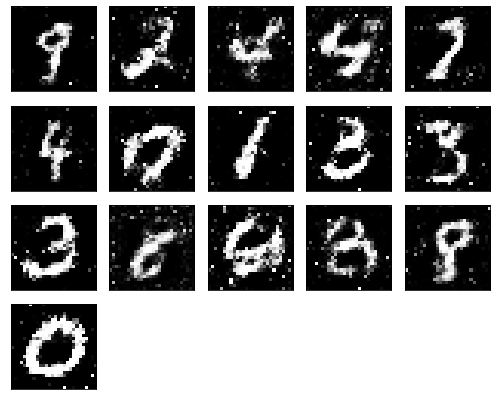

Epochs nb. 5271
discriminator loss: 0.5851547718048096
generator loss : 0.9446349740028381

Epochs nb. 5272
discriminator loss: 0.6687510013580322
generator loss : 0.9592647552490234

Epochs nb. 5273
discriminator loss: 0.5875536203384399
generator loss : 1.0434032678604126

Epochs nb. 5274
discriminator loss: 0.6992100477218628
generator loss : 1.0356584787368774

Epochs nb. 5275
discriminator loss: 0.7144408226013184
generator loss : 1.011448860168457

Epochs nb. 5276
discriminator loss: 0.6278465390205383
generator loss : 0.9995521306991577

Epochs nb. 5277
discriminator loss: 0.6362574100494385
generator loss : 0.8660531640052795

Epochs nb. 5278
discriminator loss: 0.5764942169189453
generator loss : 0.9299166202545166

Epochs nb. 5279
discriminator loss: 0.5933715105056763
generator loss : 1.031848430633545

Epochs nb. 5280
discriminator loss: 0.5666280388832092
generator loss : 1.121498465538025



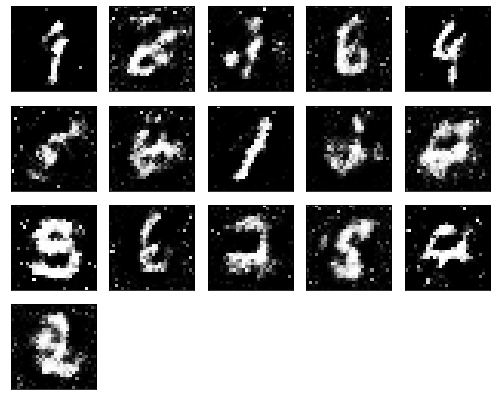

Epochs nb. 5281
discriminator loss: 0.5096019506454468
generator loss : 0.9409319162368774

Epochs nb. 5282
discriminator loss: 0.6719068288803101
generator loss : 1.116843819618225

Epochs nb. 5283
discriminator loss: 0.580829381942749
generator loss : 0.9769169688224792

Epochs nb. 5284
discriminator loss: 0.6084939241409302
generator loss : 1.0040112733840942

Epochs nb. 5285
discriminator loss: 0.637479841709137
generator loss : 0.9145653247833252

Epochs nb. 5286
discriminator loss: 0.5487699508666992
generator loss : 0.8958454132080078

Epochs nb. 5287
discriminator loss: 0.5378898978233337
generator loss : 0.9783992767333984

Epochs nb. 5288
discriminator loss: 0.6949666738510132
generator loss : 0.9012014865875244

Epochs nb. 5289
discriminator loss: 0.5437743663787842
generator loss : 0.8891714215278625

Epochs nb. 5290
discriminator loss: 0.6994972229003906
generator loss : 0.9768995046615601



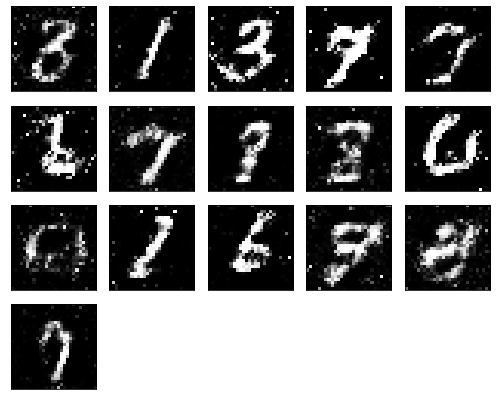

Epochs nb. 5291
discriminator loss: 0.6074631810188293
generator loss : 1.0146510601043701

Epochs nb. 5292
discriminator loss: 0.5670936703681946
generator loss : 0.9952472448348999

Epochs nb. 5293
discriminator loss: 0.5786552429199219
generator loss : 1.1069889068603516

Epochs nb. 5294
discriminator loss: 0.4695427417755127
generator loss : 1.0119428634643555

Epochs nb. 5295
discriminator loss: 0.5678637027740479
generator loss : 0.9726057648658752

Epochs nb. 5296
discriminator loss: 0.5827109813690186
generator loss : 0.9764533042907715

Epochs nb. 5297
discriminator loss: 0.4401916563510895
generator loss : 0.8719754219055176

Epochs nb. 5298
discriminator loss: 0.61896812915802
generator loss : 0.8704082369804382

Epochs nb. 5299
discriminator loss: 0.7623825073242188
generator loss : 0.9960154294967651

Epochs nb. 5300
discriminator loss: 0.7897889614105225
generator loss : 1.1289013624191284



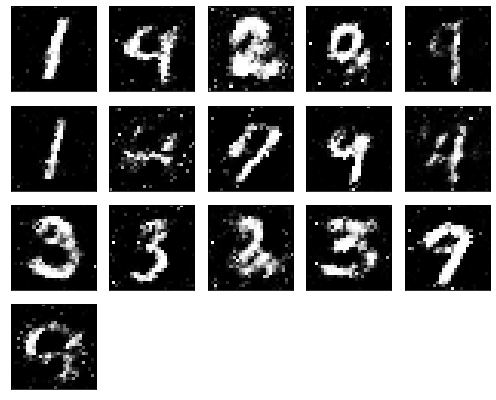

Epochs nb. 5301
discriminator loss: 0.7040507197380066
generator loss : 0.8598669767379761

Epochs nb. 5302
discriminator loss: 0.6489429473876953
generator loss : 0.8646829128265381

Epochs nb. 5303
discriminator loss: 0.5128196477890015
generator loss : 0.8976660370826721

Epochs nb. 5304
discriminator loss: 0.6661434173583984
generator loss : 0.9943689703941345

Epochs nb. 5305
discriminator loss: 0.6328965425491333
generator loss : 1.0138036012649536

Epochs nb. 5306
discriminator loss: 0.6716885566711426
generator loss : 0.9268593788146973

Epochs nb. 5307
discriminator loss: 0.589608907699585
generator loss : 0.9375736713409424

Epochs nb. 5308
discriminator loss: 0.6658893823623657
generator loss : 0.9780423641204834

Epochs nb. 5309
discriminator loss: 0.6072737574577332
generator loss : 1.0098168849945068

Epochs nb. 5310
discriminator loss: 0.631507158279419
generator loss : 0.8797441124916077



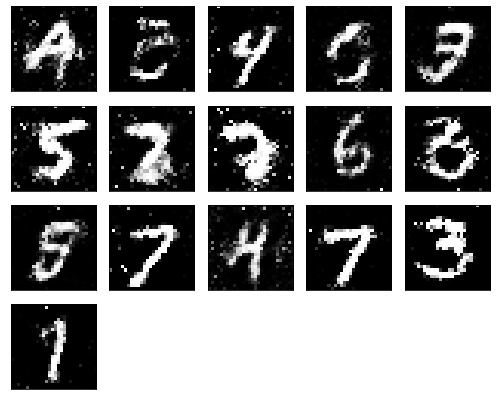

Epochs nb. 5311
discriminator loss: 0.6006412506103516
generator loss : 0.9442362785339355

Epochs nb. 5312
discriminator loss: 0.5283234119415283
generator loss : 1.047374963760376

Epochs nb. 5313
discriminator loss: 0.5884633660316467
generator loss : 0.9826001524925232

Epochs nb. 5314
discriminator loss: 0.5917459726333618
generator loss : 1.0058690309524536

Epochs nb. 5315
discriminator loss: 0.7222155332565308
generator loss : 0.8478165864944458

Epochs nb. 5316
discriminator loss: 0.46682462096214294
generator loss : 0.9910712242126465

Epochs nb. 5317
discriminator loss: 0.5462563037872314
generator loss : 0.8305472135543823

Epochs nb. 5318
discriminator loss: 0.6608765125274658
generator loss : 0.9332634210586548

Epochs nb. 5319
discriminator loss: 0.5674619674682617
generator loss : 0.8127827644348145

Epochs nb. 5320
discriminator loss: 0.600153386592865
generator loss : 0.8733818531036377



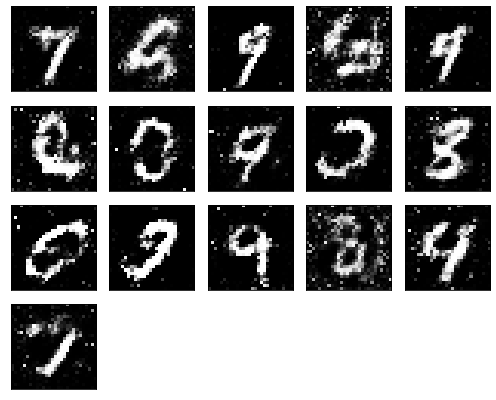

Epochs nb. 5321
discriminator loss: 0.5021340847015381
generator loss : 0.9274597764015198

Epochs nb. 5322
discriminator loss: 0.6593964099884033
generator loss : 0.8738844394683838

Epochs nb. 5323
discriminator loss: 0.6121520400047302
generator loss : 0.9742158055305481

Epochs nb. 5324
discriminator loss: 0.4976147413253784
generator loss : 0.9258154630661011

Epochs nb. 5325
discriminator loss: 0.48112455010414124
generator loss : 1.1010336875915527

Epochs nb. 5326
discriminator loss: 0.46845513582229614
generator loss : 0.8839740753173828

Epochs nb. 5327
discriminator loss: 0.5934298634529114
generator loss : 1.068570852279663

Epochs nb. 5328
discriminator loss: 0.5897631645202637
generator loss : 0.9517000317573547

Epochs nb. 5329
discriminator loss: 0.6008334755897522
generator loss : 0.9746077060699463

Epochs nb. 5330
discriminator loss: 0.5365207195281982
generator loss : 0.9227355718612671



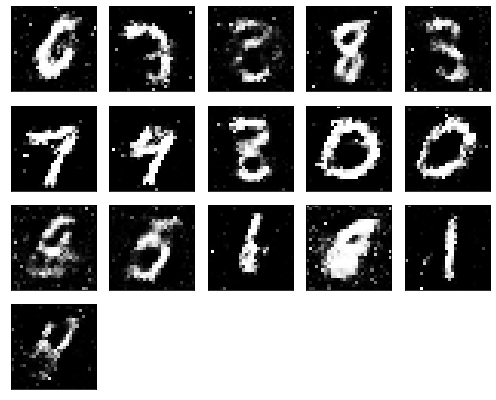

Epochs nb. 5331
discriminator loss: 0.5041495561599731
generator loss : 1.0450334548950195

Epochs nb. 5332
discriminator loss: 0.6151898503303528
generator loss : 0.9869716167449951

Epochs nb. 5333
discriminator loss: 0.6474301218986511
generator loss : 1.0569753646850586

Epochs nb. 5334
discriminator loss: 0.5666617155075073
generator loss : 1.0387451648712158

Epochs nb. 5335
discriminator loss: 0.5904204845428467
generator loss : 0.8347752094268799

Epochs nb. 5336
discriminator loss: 0.7198944091796875
generator loss : 1.1670734882354736

Epochs nb. 5337
discriminator loss: 0.5354686975479126
generator loss : 1.0273587703704834

Epochs nb. 5338
discriminator loss: 0.6638436317443848
generator loss : 0.8693445920944214

Epochs nb. 5339
discriminator loss: 0.6839061975479126
generator loss : 0.9738283753395081

Epochs nb. 5340
discriminator loss: 0.5923221111297607
generator loss : 0.9278531670570374



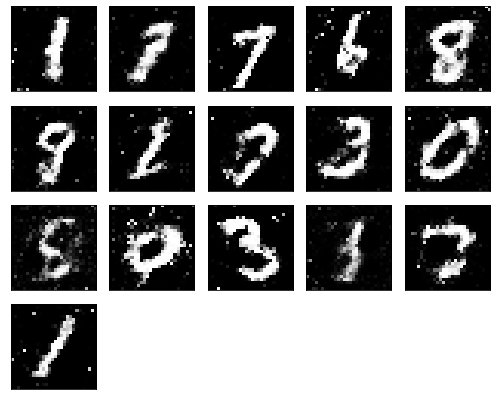

Epochs nb. 5341
discriminator loss: 0.5500667095184326
generator loss : 1.1760464906692505

Epochs nb. 5342
discriminator loss: 0.6981261968612671
generator loss : 1.0478723049163818

Epochs nb. 5343
discriminator loss: 0.4649465084075928
generator loss : 0.9640377163887024

Epochs nb. 5344
discriminator loss: 0.5727075338363647
generator loss : 1.1430916786193848

Epochs nb. 5345
discriminator loss: 0.6798195838928223
generator loss : 0.980798065662384

Epochs nb. 5346
discriminator loss: 0.4971924126148224
generator loss : 0.8838988542556763

Epochs nb. 5347
discriminator loss: 0.5075437426567078
generator loss : 1.0972363948822021

Epochs nb. 5348
discriminator loss: 0.5519040822982788
generator loss : 0.9022873640060425

Epochs nb. 5349
discriminator loss: 0.5793203115463257
generator loss : 0.9298354387283325

Epochs nb. 5350
discriminator loss: 0.5608190298080444
generator loss : 1.0188965797424316



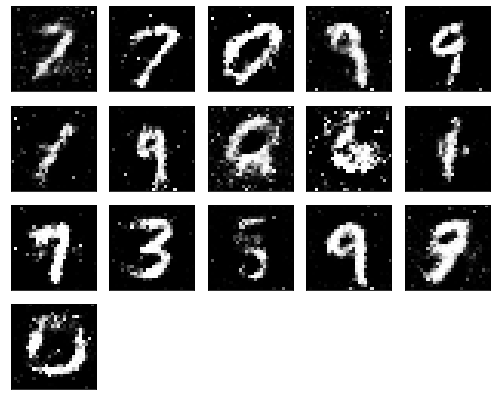

Epochs nb. 5351
discriminator loss: 0.5884884595870972
generator loss : 0.9001613855361938

Epochs nb. 5352
discriminator loss: 0.5790309906005859
generator loss : 0.9046167135238647

Epochs nb. 5353
discriminator loss: 0.6102505326271057
generator loss : 0.8347386121749878

Epochs nb. 5354
discriminator loss: 0.45199936628341675
generator loss : 0.85121750831604

Epochs nb. 5355
discriminator loss: 0.7270470261573792
generator loss : 0.9439784288406372

Epochs nb. 5356
discriminator loss: 0.6563284397125244
generator loss : 0.8671383857727051

Epochs nb. 5357
discriminator loss: 0.5531711578369141
generator loss : 0.851452112197876

Epochs nb. 5358
discriminator loss: 0.5343380570411682
generator loss : 1.0700501203536987

Epochs nb. 5359
discriminator loss: 0.5591042637825012
generator loss : 0.9319474101066589

Epochs nb. 5360
discriminator loss: 0.5684010982513428
generator loss : 0.9386855959892273



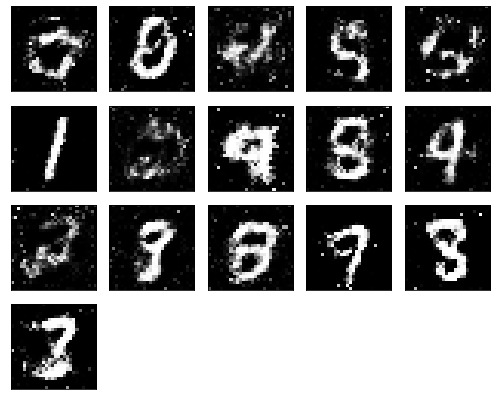

Epochs nb. 5361
discriminator loss: 0.5083327889442444
generator loss : 0.9158015251159668

Epochs nb. 5362
discriminator loss: 0.5646369457244873
generator loss : 0.8873716592788696

Epochs nb. 5363
discriminator loss: 0.6361491084098816
generator loss : 0.9657853841781616

Epochs nb. 5364
discriminator loss: 0.5863947868347168
generator loss : 1.0691752433776855

Epochs nb. 5365
discriminator loss: 0.5283506512641907
generator loss : 0.987703263759613

Epochs nb. 5366
discriminator loss: 0.5898228883743286
generator loss : 0.989968478679657

Epochs nb. 5367
discriminator loss: 0.5006260871887207
generator loss : 0.9427363872528076

Epochs nb. 5368
discriminator loss: 0.6251441240310669
generator loss : 0.960012674331665

Epochs nb. 5369
discriminator loss: 0.5344970226287842
generator loss : 0.9635012149810791

Epochs nb. 5370
discriminator loss: 0.7180755138397217
generator loss : 0.8889293670654297



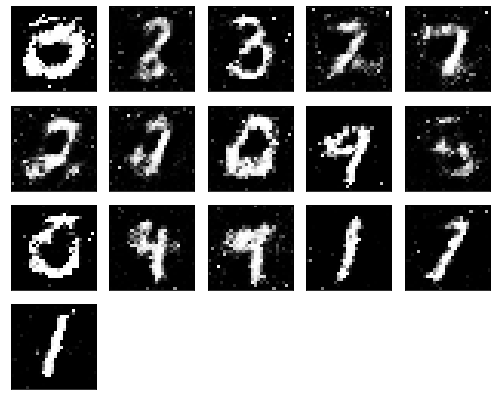

Epochs nb. 5371
discriminator loss: 0.47726553678512573
generator loss : 0.9797812700271606

Epochs nb. 5372
discriminator loss: 0.659860372543335
generator loss : 0.8597657680511475

Epochs nb. 5373
discriminator loss: 0.47882187366485596
generator loss : 0.9960405230522156

Epochs nb. 5374
discriminator loss: 0.7527586221694946
generator loss : 1.1746206283569336

Epochs nb. 5375
discriminator loss: 0.49928906559944153
generator loss : 1.1769895553588867

Epochs nb. 5376
discriminator loss: 0.6617482304573059
generator loss : 0.9386410117149353

Epochs nb. 5377
discriminator loss: 0.6243290901184082
generator loss : 1.0136538743972778

Epochs nb. 5378
discriminator loss: 0.5775004625320435
generator loss : 1.0889405012130737

Epochs nb. 5379
discriminator loss: 0.5885758399963379
generator loss : 1.3008880615234375

Epochs nb. 5380
discriminator loss: 0.5690537691116333
generator loss : 1.006669044494629



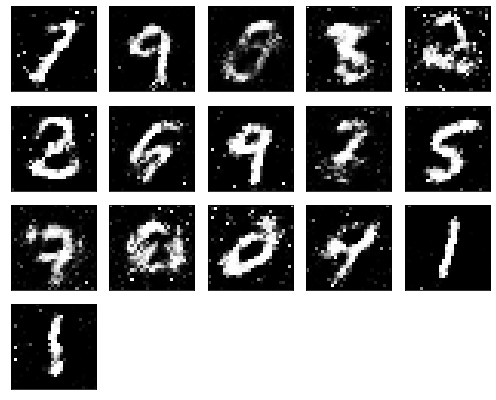

Epochs nb. 5381
discriminator loss: 0.6141113042831421
generator loss : 0.9716238975524902

Epochs nb. 5382
discriminator loss: 0.667346715927124
generator loss : 0.865768551826477

Epochs nb. 5383
discriminator loss: 0.5365386605262756
generator loss : 0.8651498556137085

Epochs nb. 5384
discriminator loss: 0.6156133413314819
generator loss : 0.8442800641059875

Epochs nb. 5385
discriminator loss: 0.5569916367530823
generator loss : 1.1033402681350708

Epochs nb. 5386
discriminator loss: 0.6088091135025024
generator loss : 1.0199987888336182

Epochs nb. 5387
discriminator loss: 0.6249615550041199
generator loss : 0.9678416848182678

Epochs nb. 5388
discriminator loss: 0.5337238907814026
generator loss : 0.8360133171081543

Epochs nb. 5389
discriminator loss: 0.6069186925888062
generator loss : 0.9276888966560364

Epochs nb. 5390
discriminator loss: 0.5123614072799683
generator loss : 0.9344525337219238



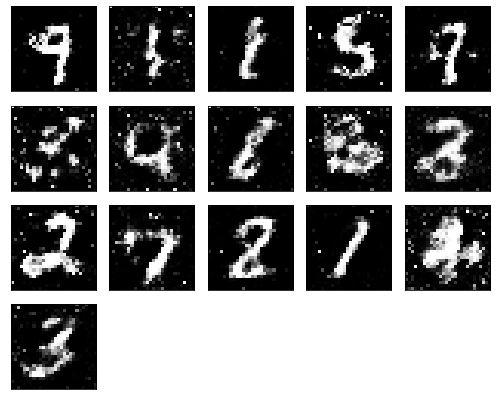

Epochs nb. 5391
discriminator loss: 0.517387330532074
generator loss : 0.9517248868942261

Epochs nb. 5392
discriminator loss: 0.481915146112442
generator loss : 0.8115088939666748

Epochs nb. 5393
discriminator loss: 0.70526123046875
generator loss : 0.8934497237205505

Epochs nb. 5394
discriminator loss: 0.6401636600494385
generator loss : 1.0311402082443237

Epochs nb. 5395
discriminator loss: 0.6163551807403564
generator loss : 1.0468144416809082

Epochs nb. 5396
discriminator loss: 0.6069242358207703
generator loss : 1.100905179977417

Epochs nb. 5397
discriminator loss: 0.6280429363250732
generator loss : 1.0445311069488525

Epochs nb. 5398
discriminator loss: 0.6083357334136963
generator loss : 0.7649414539337158

Epochs nb. 5399
discriminator loss: 0.6227964162826538
generator loss : 0.99763423204422

Epochs nb. 5400
discriminator loss: 0.5587191581726074
generator loss : 1.0507135391235352



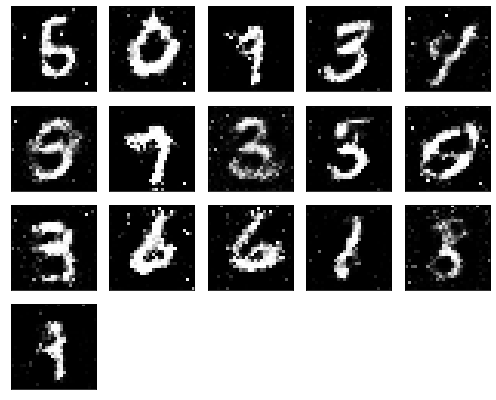

Epochs nb. 5401
discriminator loss: 0.6478163003921509
generator loss : 1.1113653182983398

Epochs nb. 5402
discriminator loss: 0.6933072209358215
generator loss : 1.0174674987792969

Epochs nb. 5403
discriminator loss: 0.45160967111587524
generator loss : 0.9285674095153809

Epochs nb. 5404
discriminator loss: 0.5920703411102295
generator loss : 0.8008777499198914

Epochs nb. 5405
discriminator loss: 0.6992331743240356
generator loss : 1.0347070693969727

Epochs nb. 5406
discriminator loss: 0.6200624704360962
generator loss : 0.8782916069030762

Epochs nb. 5407
discriminator loss: 0.59334397315979
generator loss : 0.9298318028450012

Epochs nb. 5408
discriminator loss: 0.5591942667961121
generator loss : 0.9227465391159058

Epochs nb. 5409
discriminator loss: 0.5895804166793823
generator loss : 1.0647445917129517

Epochs nb. 5410
discriminator loss: 0.6743196845054626
generator loss : 0.905752420425415



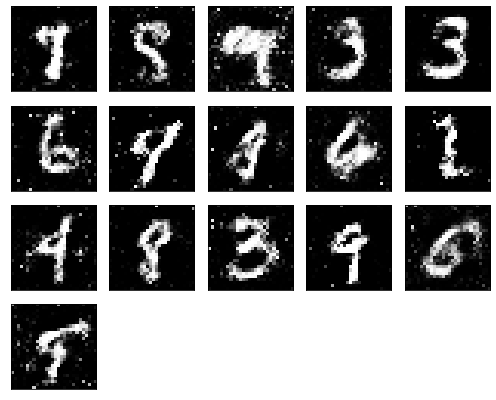

Epochs nb. 5411
discriminator loss: 0.6816606521606445
generator loss : 0.9273297786712646

Epochs nb. 5412
discriminator loss: 0.6210476756095886
generator loss : 1.0814483165740967

Epochs nb. 5413
discriminator loss: 0.5699458122253418
generator loss : 1.0631228685379028

Epochs nb. 5414
discriminator loss: 0.68506920337677
generator loss : 0.9827723503112793

Epochs nb. 5415
discriminator loss: 0.5628526210784912
generator loss : 0.8652302622795105

Epochs nb. 5416
discriminator loss: 0.5713418126106262
generator loss : 0.8220826387405396

Epochs nb. 5417
discriminator loss: 0.5232878923416138
generator loss : 0.9938696026802063

Epochs nb. 5418
discriminator loss: 0.6206350326538086
generator loss : 1.0484657287597656

Epochs nb. 5419
discriminator loss: 0.6439334154129028
generator loss : 1.0431785583496094

Epochs nb. 5420
discriminator loss: 0.6205602288246155
generator loss : 1.0242328643798828



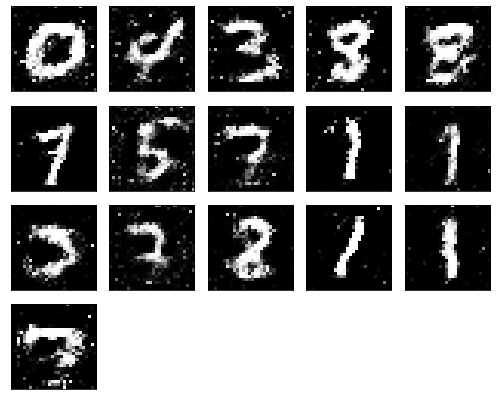

Epochs nb. 5421
discriminator loss: 0.6443378925323486
generator loss : 1.2123699188232422

Epochs nb. 5422
discriminator loss: 0.5313501358032227
generator loss : 0.8351096510887146

Epochs nb. 5423
discriminator loss: 0.5356181263923645
generator loss : 1.0903306007385254

Epochs nb. 5424
discriminator loss: 0.5841383934020996
generator loss : 0.9962966442108154

Epochs nb. 5425
discriminator loss: 0.4685525596141815
generator loss : 1.0169272422790527

Epochs nb. 5426
discriminator loss: 0.6730523109436035
generator loss : 1.010202169418335

Epochs nb. 5427
discriminator loss: 0.6219600439071655
generator loss : 0.9649455547332764

Epochs nb. 5428
discriminator loss: 0.4452016353607178
generator loss : 0.9345802068710327

Epochs nb. 5429
discriminator loss: 0.7672415375709534
generator loss : 0.9322082996368408

Epochs nb. 5430
discriminator loss: 0.45559418201446533
generator loss : 1.0335869789123535



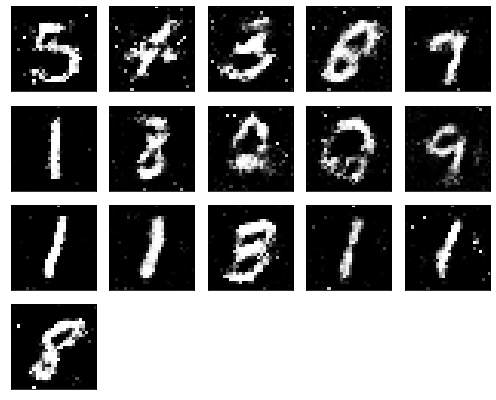

Epochs nb. 5431
discriminator loss: 0.5367003083229065
generator loss : 0.9738224148750305

Epochs nb. 5432
discriminator loss: 0.46165382862091064
generator loss : 1.1282715797424316

Epochs nb. 5433
discriminator loss: 0.7874220013618469
generator loss : 0.7868365049362183

Epochs nb. 5434
discriminator loss: 0.5610291957855225
generator loss : 0.9050037860870361

Epochs nb. 5435
discriminator loss: 0.692713737487793
generator loss : 0.9819819927215576

Epochs nb. 5436
discriminator loss: 0.6050677299499512
generator loss : 1.058603048324585

Epochs nb. 5437
discriminator loss: 0.6321471929550171
generator loss : 1.096043586730957

Epochs nb. 5438
discriminator loss: 0.5559316277503967
generator loss : 1.0554707050323486

Epochs nb. 5439
discriminator loss: 0.6318488121032715
generator loss : 1.0210654735565186

Epochs nb. 5440
discriminator loss: 0.6569499969482422
generator loss : 0.9797604084014893



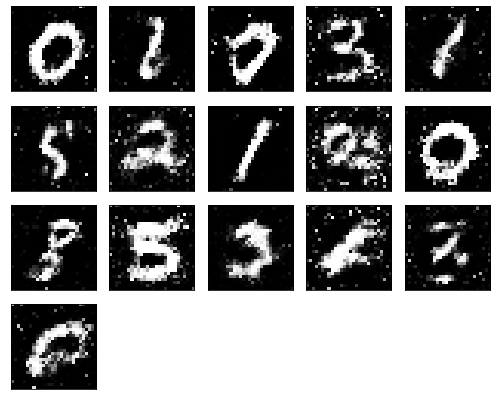

Epochs nb. 5441
discriminator loss: 0.6843827366828918
generator loss : 0.8956060409545898

Epochs nb. 5442
discriminator loss: 0.5232818722724915
generator loss : 1.1474324464797974

Epochs nb. 5443
discriminator loss: 0.7020354270935059
generator loss : 1.1535712480545044

Epochs nb. 5444
discriminator loss: 0.5708901882171631
generator loss : 1.025251865386963

Epochs nb. 5445
discriminator loss: 0.6715015172958374
generator loss : 0.9717627167701721

Epochs nb. 5446
discriminator loss: 0.4918595552444458
generator loss : 0.9960098266601562

Epochs nb. 5447
discriminator loss: 0.5297601222991943
generator loss : 0.9525666236877441

Epochs nb. 5448
discriminator loss: 0.55919349193573
generator loss : 0.8493553400039673

Epochs nb. 5449
discriminator loss: 0.5336998105049133
generator loss : 0.9568710327148438

Epochs nb. 5450
discriminator loss: 0.5596352815628052
generator loss : 1.0391207933425903



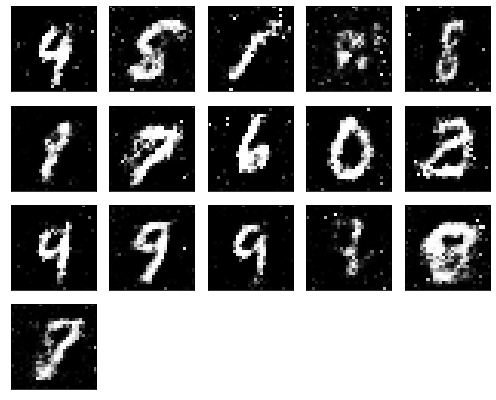

Epochs nb. 5451
discriminator loss: 0.5873966217041016
generator loss : 0.9835494756698608

Epochs nb. 5452
discriminator loss: 0.5822274088859558
generator loss : 1.0492823123931885

Epochs nb. 5453
discriminator loss: 0.5322498083114624
generator loss : 0.9793444275856018

Epochs nb. 5454
discriminator loss: 0.6680628061294556
generator loss : 1.036514401435852

Epochs nb. 5455
discriminator loss: 0.59120774269104
generator loss : 1.0629574060440063

Epochs nb. 5456
discriminator loss: 0.6123691201210022
generator loss : 1.0496835708618164

Epochs nb. 5457
discriminator loss: 0.5237557291984558
generator loss : 0.8451476097106934

Epochs nb. 5458
discriminator loss: 0.6910735368728638
generator loss : 0.8917108774185181

Epochs nb. 5459
discriminator loss: 0.6569937467575073
generator loss : 0.8722145557403564

Epochs nb. 5460
discriminator loss: 0.5883200168609619
generator loss : 0.9343760013580322



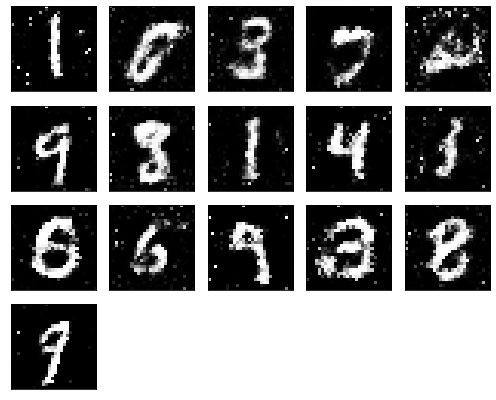

Epochs nb. 5461
discriminator loss: 0.5603635311126709
generator loss : 1.0104731321334839

Epochs nb. 5462
discriminator loss: 0.6413690447807312
generator loss : 0.9522033929824829

Epochs nb. 5463
discriminator loss: 0.6834003925323486
generator loss : 1.0212929248809814

Epochs nb. 5464
discriminator loss: 0.6121792793273926
generator loss : 0.7833592891693115

Epochs nb. 5465
discriminator loss: 0.6021385788917542
generator loss : 1.0791347026824951

Epochs nb. 5466
discriminator loss: 0.6448023915290833
generator loss : 1.097076416015625

Epochs nb. 5467
discriminator loss: 0.6105294227600098
generator loss : 1.0380244255065918

Epochs nb. 5468
discriminator loss: 0.6420144438743591
generator loss : 1.0115745067596436

Epochs nb. 5469
discriminator loss: 0.5256853103637695
generator loss : 0.9687532186508179

Epochs nb. 5470
discriminator loss: 0.5219342112541199
generator loss : 1.1251418590545654



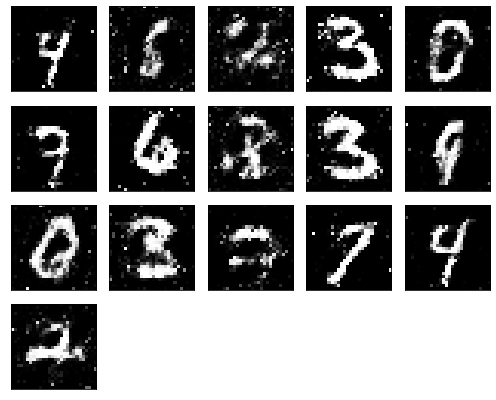

Epochs nb. 5471
discriminator loss: 0.6500587463378906
generator loss : 1.2335789203643799

Epochs nb. 5472
discriminator loss: 0.5903936624526978
generator loss : 1.0135455131530762

Epochs nb. 5473
discriminator loss: 0.6393783092498779
generator loss : 1.0575969219207764

Epochs nb. 5474
discriminator loss: 0.8085691928863525
generator loss : 1.0825151205062866

Epochs nb. 5475
discriminator loss: 0.567864179611206
generator loss : 0.9891208410263062

Epochs nb. 5476
discriminator loss: 0.6233620643615723
generator loss : 0.9843941926956177

Epochs nb. 5477
discriminator loss: 0.5661004185676575
generator loss : 1.1058738231658936

Epochs nb. 5478
discriminator loss: 0.5578566193580627
generator loss : 1.0194547176361084

Epochs nb. 5479
discriminator loss: 0.48927778005599976
generator loss : 0.9880087375640869

Epochs nb. 5480
discriminator loss: 0.7314156293869019
generator loss : 0.9607359766960144



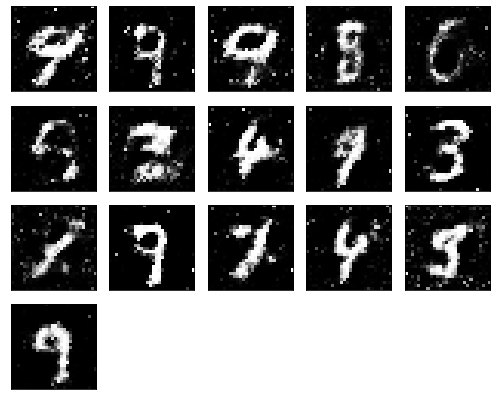

Epochs nb. 5481
discriminator loss: 0.48366230726242065
generator loss : 1.0307791233062744

Epochs nb. 5482
discriminator loss: 0.5718908309936523
generator loss : 1.2476279735565186

Epochs nb. 5483
discriminator loss: 0.6889798641204834
generator loss : 1.1307859420776367

Epochs nb. 5484
discriminator loss: 0.6050873398780823
generator loss : 0.9823638200759888

Epochs nb. 5485
discriminator loss: 0.5786163806915283
generator loss : 1.1403964757919312

Epochs nb. 5486
discriminator loss: 0.5297950506210327
generator loss : 1.009369134902954

Epochs nb. 5487
discriminator loss: 0.5164459347724915
generator loss : 0.8356289863586426

Epochs nb. 5488
discriminator loss: 0.5552021265029907
generator loss : 1.0822453498840332

Epochs nb. 5489
discriminator loss: 0.5234410762786865
generator loss : 0.9707939624786377

Epochs nb. 5490
discriminator loss: 0.4839407801628113
generator loss : 0.9532964825630188



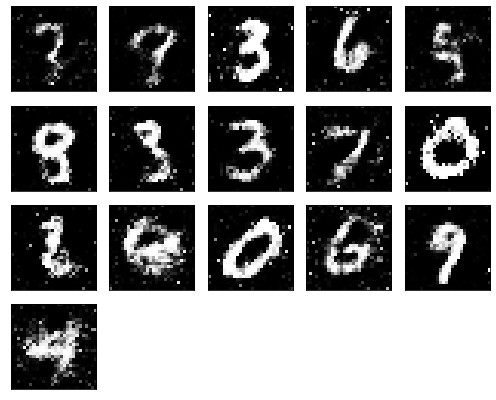

Epochs nb. 5491
discriminator loss: 0.5279775857925415
generator loss : 0.9006770253181458

Epochs nb. 5492
discriminator loss: 0.6138625741004944
generator loss : 0.8968988656997681

Epochs nb. 5493
discriminator loss: 0.607332706451416
generator loss : 1.0593410730361938

Epochs nb. 5494
discriminator loss: 0.7018032073974609
generator loss : 1.1441092491149902

Epochs nb. 5495
discriminator loss: 0.6089057326316833
generator loss : 0.9102369546890259

Epochs nb. 5496
discriminator loss: 0.636428952217102
generator loss : 0.9405544996261597

Epochs nb. 5497
discriminator loss: 0.6001253128051758
generator loss : 0.9373857975006104

Epochs nb. 5498
discriminator loss: 0.6553204655647278
generator loss : 0.9255039691925049

Epochs nb. 5499
discriminator loss: 0.6433019638061523
generator loss : 0.8992780447006226

Epochs nb. 5500
discriminator loss: 0.6674891710281372
generator loss : 0.9768091440200806



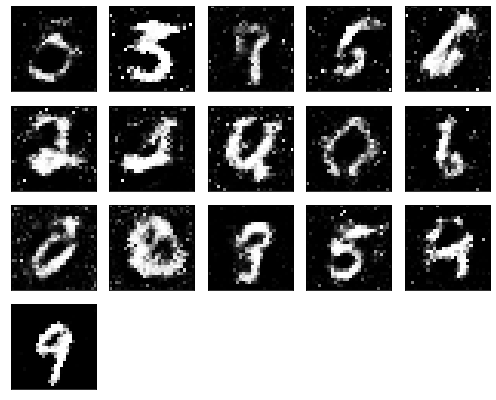

Epochs nb. 5501
discriminator loss: 0.6944520473480225
generator loss : 1.0797556638717651

Epochs nb. 5502
discriminator loss: 0.5782784223556519
generator loss : 0.9810047149658203

Epochs nb. 5503
discriminator loss: 0.5732881426811218
generator loss : 0.9355378746986389

Epochs nb. 5504
discriminator loss: 0.5667932629585266
generator loss : 0.9707059860229492

Epochs nb. 5505
discriminator loss: 0.5590826869010925
generator loss : 0.8840465545654297

Epochs nb. 5506
discriminator loss: 0.5604855418205261
generator loss : 0.9395744800567627

Epochs nb. 5507
discriminator loss: 0.584691047668457
generator loss : 0.9501504302024841

Epochs nb. 5508
discriminator loss: 0.6578863859176636
generator loss : 1.0651075839996338

Epochs nb. 5509
discriminator loss: 0.5857741832733154
generator loss : 1.0894975662231445

Epochs nb. 5510
discriminator loss: 0.6060317754745483
generator loss : 0.8298203349113464



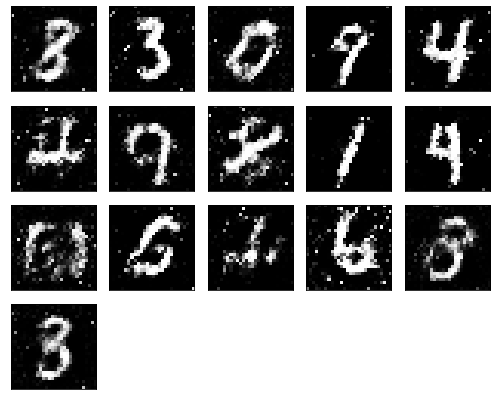

Epochs nb. 5511
discriminator loss: 0.6814651489257812
generator loss : 0.7931852340698242

Epochs nb. 5512
discriminator loss: 0.5465684533119202
generator loss : 0.9937664270401001

Epochs nb. 5513
discriminator loss: 0.5998600721359253
generator loss : 0.7028868794441223

Epochs nb. 5514
discriminator loss: 0.6576586961746216
generator loss : 0.9708544015884399

Epochs nb. 5515
discriminator loss: 0.5044997930526733
generator loss : 1.0174505710601807

Epochs nb. 5516
discriminator loss: 0.5734372138977051
generator loss : 0.9227990508079529

Epochs nb. 5517
discriminator loss: 0.5591696500778198
generator loss : 0.9064533114433289

Epochs nb. 5518
discriminator loss: 0.6014496088027954
generator loss : 0.9941774606704712

Epochs nb. 5519
discriminator loss: 0.5767700672149658
generator loss : 1.0707180500030518

Epochs nb. 5520
discriminator loss: 0.6654975414276123
generator loss : 0.9990748167037964



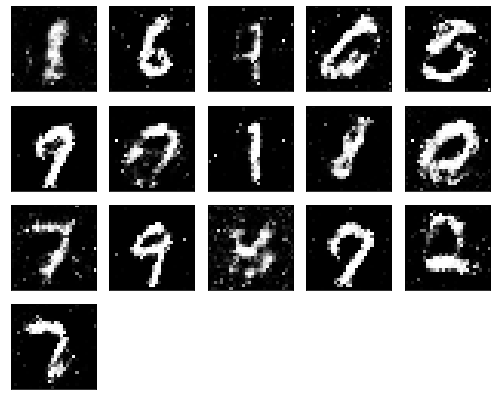

Epochs nb. 5521
discriminator loss: 0.5116977691650391
generator loss : 0.9897404909133911

Epochs nb. 5522
discriminator loss: 0.48903053998947144
generator loss : 0.8505702018737793

Epochs nb. 5523
discriminator loss: 0.7152696251869202
generator loss : 1.1157662868499756

Epochs nb. 5524
discriminator loss: 0.5736539959907532
generator loss : 1.135010004043579

Epochs nb. 5525
discriminator loss: 0.5996935367584229
generator loss : 1.0095405578613281

Epochs nb. 5526
discriminator loss: 0.5568600296974182
generator loss : 0.9986739158630371

Epochs nb. 5527
discriminator loss: 0.4799039959907532
generator loss : 0.8903859853744507

Epochs nb. 5528
discriminator loss: 0.5947510600090027
generator loss : 1.0720288753509521

Epochs nb. 5529
discriminator loss: 0.47471314668655396
generator loss : 1.0057483911514282

Epochs nb. 5530
discriminator loss: 0.5466463565826416
generator loss : 1.1376879215240479



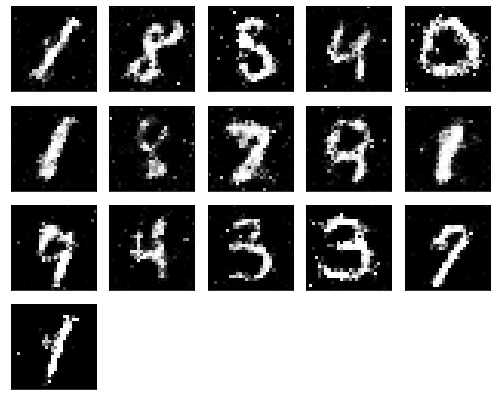

Epochs nb. 5531
discriminator loss: 0.5255502462387085
generator loss : 0.9329795241355896

Epochs nb. 5532
discriminator loss: 0.6118125319480896
generator loss : 0.9304653406143188

Epochs nb. 5533
discriminator loss: 0.6455929279327393
generator loss : 0.8433957099914551

Epochs nb. 5534
discriminator loss: 0.5382900238037109
generator loss : 1.0085572004318237

Epochs nb. 5535
discriminator loss: 0.47502151131629944
generator loss : 0.8282479643821716

Epochs nb. 5536
discriminator loss: 0.4805896580219269
generator loss : 1.0167715549468994

Epochs nb. 5537
discriminator loss: 0.6008075475692749
generator loss : 0.966293454170227

Epochs nb. 5538
discriminator loss: 0.5262621641159058
generator loss : 1.0004823207855225

Epochs nb. 5539
discriminator loss: 0.5668514370918274
generator loss : 1.130474328994751

Epochs nb. 5540
discriminator loss: 0.7035916447639465
generator loss : 0.8595589399337769



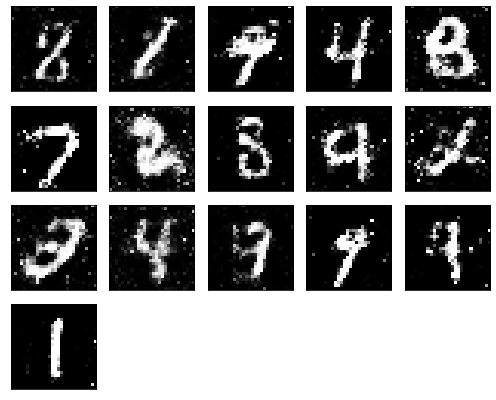

Epochs nb. 5541
discriminator loss: 0.5844473242759705
generator loss : 1.0367670059204102

Epochs nb. 5542
discriminator loss: 0.5511131286621094
generator loss : 0.7302757501602173

Epochs nb. 5543
discriminator loss: 0.49088385701179504
generator loss : 1.0889341831207275

Epochs nb. 5544
discriminator loss: 0.5175950527191162
generator loss : 1.024073839187622

Epochs nb. 5545
discriminator loss: 0.6619348526000977
generator loss : 1.011960506439209

Epochs nb. 5546
discriminator loss: 0.4672786295413971
generator loss : 0.8819093704223633

Epochs nb. 5547
discriminator loss: 0.5742743015289307
generator loss : 0.9199762940406799

Epochs nb. 5548
discriminator loss: 0.6229857206344604
generator loss : 1.1159659624099731

Epochs nb. 5549
discriminator loss: 0.7656663060188293
generator loss : 0.9544878602027893

Epochs nb. 5550
discriminator loss: 0.5870245695114136
generator loss : 0.871778130531311



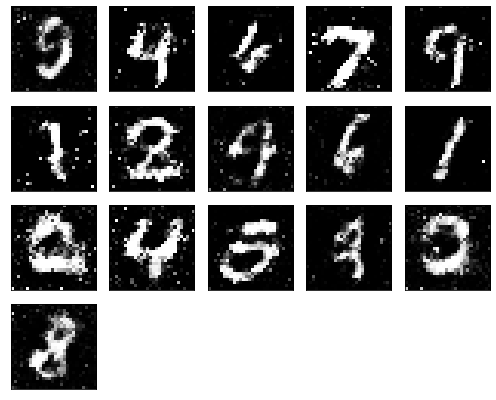

Epochs nb. 5551
discriminator loss: 0.6250628232955933
generator loss : 1.050743579864502

Epochs nb. 5552
discriminator loss: 0.6652798652648926
generator loss : 1.195363998413086

Epochs nb. 5553
discriminator loss: 0.7205252647399902
generator loss : 0.9211257100105286

Epochs nb. 5554
discriminator loss: 0.5487622022628784
generator loss : 0.8731598258018494

Epochs nb. 5555
discriminator loss: 0.5392149686813354
generator loss : 0.9875592589378357

Epochs nb. 5556
discriminator loss: 0.5672274827957153
generator loss : 0.9958028197288513

Epochs nb. 5557
discriminator loss: 0.5465837121009827
generator loss : 1.1052685976028442

Epochs nb. 5558
discriminator loss: 0.5798500776290894
generator loss : 0.9821134209632874

Epochs nb. 5559
discriminator loss: 0.6463950276374817
generator loss : 0.9702357053756714

Epochs nb. 5560
discriminator loss: 0.6248130798339844
generator loss : 0.9904555082321167



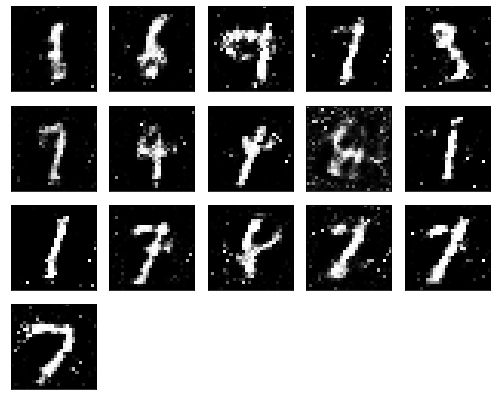

Epochs nb. 5561
discriminator loss: 0.6015347242355347
generator loss : 1.0359711647033691

Epochs nb. 5562
discriminator loss: 0.5085119009017944
generator loss : 0.8824517726898193

Epochs nb. 5563
discriminator loss: 0.5836338996887207
generator loss : 0.785883903503418

Epochs nb. 5564
discriminator loss: 0.43981677293777466
generator loss : 0.9870278835296631

Epochs nb. 5565
discriminator loss: 0.7590247392654419
generator loss : 1.0305219888687134

Epochs nb. 5566
discriminator loss: 0.46602168679237366
generator loss : 0.9890691041946411

Epochs nb. 5567
discriminator loss: 0.558685302734375
generator loss : 1.0170294046401978

Epochs nb. 5568
discriminator loss: 0.5349966883659363
generator loss : 0.9539156556129456

Epochs nb. 5569
discriminator loss: 0.6056075096130371
generator loss : 0.9568451642990112

Epochs nb. 5570
discriminator loss: 0.6877576112747192
generator loss : 1.021149754524231



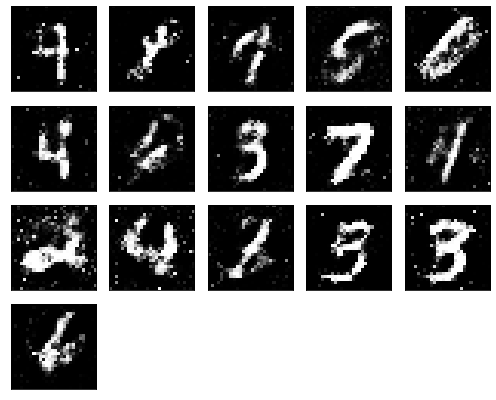

Epochs nb. 5571
discriminator loss: 0.8651317358016968
generator loss : 1.0358425378799438

Epochs nb. 5572
discriminator loss: 0.4388715922832489
generator loss : 1.0343778133392334

Epochs nb. 5573
discriminator loss: 0.6380350589752197
generator loss : 1.0380462408065796

Epochs nb. 5574
discriminator loss: 0.6402987241744995
generator loss : 0.83476722240448

Epochs nb. 5575
discriminator loss: 0.6011326313018799
generator loss : 0.9472229480743408

Epochs nb. 5576
discriminator loss: 0.6068486571311951
generator loss : 0.9463763236999512

Epochs nb. 5577
discriminator loss: 0.6783775687217712
generator loss : 1.0463547706604004

Epochs nb. 5578
discriminator loss: 0.5911072492599487
generator loss : 0.9320884943008423

Epochs nb. 5579
discriminator loss: 0.5964357852935791
generator loss : 1.0873678922653198

Epochs nb. 5580
discriminator loss: 0.5592071413993835
generator loss : 1.128849744796753



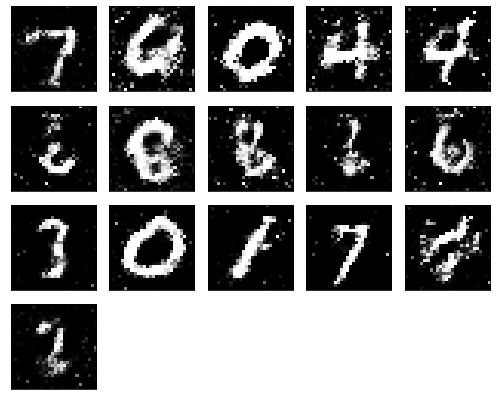

Epochs nb. 5581
discriminator loss: 0.5776218771934509
generator loss : 1.0663036108016968

Epochs nb. 5582
discriminator loss: 0.5048298835754395
generator loss : 1.156987190246582

Epochs nb. 5583
discriminator loss: 0.6567897200584412
generator loss : 1.0446851253509521

Epochs nb. 5584
discriminator loss: 0.5434958934783936
generator loss : 1.0654209852218628

Epochs nb. 5585
discriminator loss: 0.5377216339111328
generator loss : 1.0157618522644043

Epochs nb. 5586
discriminator loss: 0.6017571091651917
generator loss : 0.9900273084640503

Epochs nb. 5587
discriminator loss: 0.5434662103652954
generator loss : 1.0055079460144043

Epochs nb. 5588
discriminator loss: 0.5760929584503174
generator loss : 0.9364092350006104

Epochs nb. 5589
discriminator loss: 0.6291865110397339
generator loss : 0.8792077302932739

Epochs nb. 5590
discriminator loss: 0.6064717769622803
generator loss : 0.8124299645423889



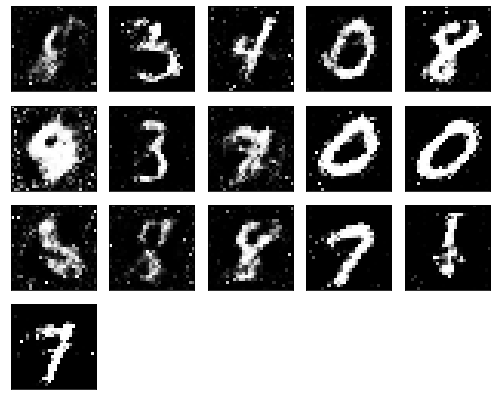

Epochs nb. 5591
discriminator loss: 0.689812421798706
generator loss : 1.1004542112350464

Epochs nb. 5592
discriminator loss: 0.6916196346282959
generator loss : 1.0122556686401367

Epochs nb. 5593
discriminator loss: 0.643461287021637
generator loss : 0.9264788627624512

Epochs nb. 5594
discriminator loss: 0.8106355667114258
generator loss : 1.0063281059265137

Epochs nb. 5595
discriminator loss: 0.6752852201461792
generator loss : 1.0791977643966675

Epochs nb. 5596
discriminator loss: 0.5003598928451538
generator loss : 1.0049901008605957

Epochs nb. 5597
discriminator loss: 0.6555772423744202
generator loss : 0.7950895428657532

Epochs nb. 5598
discriminator loss: 0.5700820684432983
generator loss : 0.9685826301574707

Epochs nb. 5599
discriminator loss: 0.6851271390914917
generator loss : 1.1591763496398926

Epochs nb. 5600
discriminator loss: 0.48567894101142883
generator loss : 1.2529354095458984



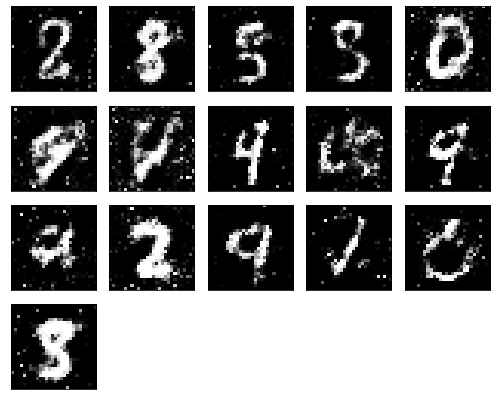

Epochs nb. 5601
discriminator loss: 0.6450896859169006
generator loss : 1.059701681137085

Epochs nb. 5602
discriminator loss: 0.6497229933738708
generator loss : 0.9058266878128052

Epochs nb. 5603
discriminator loss: 0.7272173166275024
generator loss : 0.9995532035827637

Epochs nb. 5604
discriminator loss: 0.6320428848266602
generator loss : 1.0415170192718506

Epochs nb. 5605
discriminator loss: 0.5707628726959229
generator loss : 1.0097756385803223

Epochs nb. 5606
discriminator loss: 0.6713753342628479
generator loss : 1.0655525922775269

Epochs nb. 5607
discriminator loss: 0.7086038589477539
generator loss : 0.8345432281494141

Epochs nb. 5608
discriminator loss: 0.6127896904945374
generator loss : 0.8383325338363647

Epochs nb. 5609
discriminator loss: 0.5822305679321289
generator loss : 0.9357067346572876

Epochs nb. 5610
discriminator loss: 0.6286505460739136
generator loss : 1.0790150165557861



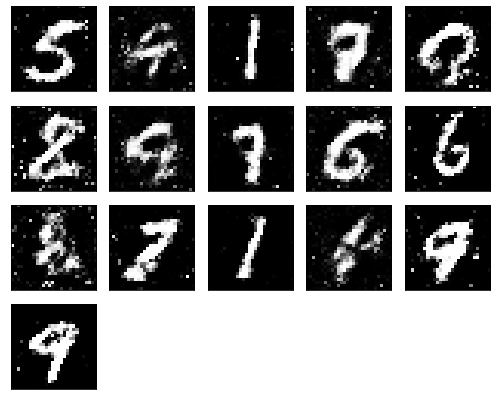

Epochs nb. 5611
discriminator loss: 0.6374982595443726
generator loss : 0.993327796459198

Epochs nb. 5612
discriminator loss: 0.5541360378265381
generator loss : 0.8222275376319885

Epochs nb. 5613
discriminator loss: 0.5933270454406738
generator loss : 1.0646109580993652

Epochs nb. 5614
discriminator loss: 0.5712924003601074
generator loss : 0.932833194732666

Epochs nb. 5615
discriminator loss: 0.5780732035636902
generator loss : 1.0880558490753174

Epochs nb. 5616
discriminator loss: 0.798424482345581
generator loss : 0.9639861583709717

Epochs nb. 5617
discriminator loss: 0.6260442733764648
generator loss : 1.0389468669891357

Epochs nb. 5618
discriminator loss: 0.5527336597442627
generator loss : 1.095522403717041

Epochs nb. 5619
discriminator loss: 0.5678755640983582
generator loss : 1.1401021480560303

Epochs nb. 5620
discriminator loss: 0.677169919013977
generator loss : 0.8143577575683594



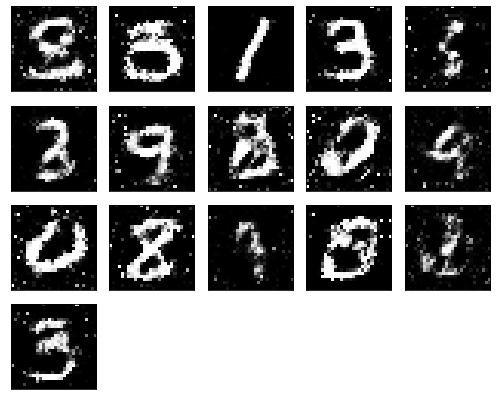

Epochs nb. 5621
discriminator loss: 0.6254334449768066
generator loss : 0.9291500449180603

Epochs nb. 5622
discriminator loss: 0.6084001064300537
generator loss : 1.0139461755752563

Epochs nb. 5623
discriminator loss: 0.5851101875305176
generator loss : 1.1144260168075562

Epochs nb. 5624
discriminator loss: 0.4851738512516022
generator loss : 1.0369210243225098

Epochs nb. 5625
discriminator loss: 0.5491347312927246
generator loss : 0.8575403690338135

Epochs nb. 5626
discriminator loss: 0.6849352121353149
generator loss : 0.9438140392303467

Epochs nb. 5627
discriminator loss: 0.5125547647476196
generator loss : 0.9619036912918091

Epochs nb. 5628
discriminator loss: 0.6054288744926453
generator loss : 0.8608248233795166

Epochs nb. 5629
discriminator loss: 0.6241180896759033
generator loss : 0.9499906897544861

Epochs nb. 5630
discriminator loss: 0.6221309304237366
generator loss : 1.0412170886993408



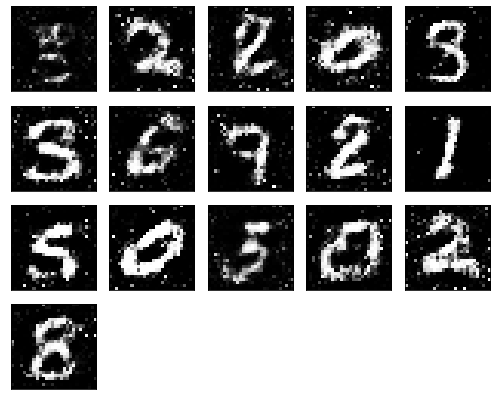

Epochs nb. 5631
discriminator loss: 0.5750687122344971
generator loss : 1.0127553939819336

Epochs nb. 5632
discriminator loss: 0.5934509038925171
generator loss : 1.151672124862671

Epochs nb. 5633
discriminator loss: 0.5404782295227051
generator loss : 0.9393350481987

Epochs nb. 5634
discriminator loss: 0.5460247993469238
generator loss : 0.8243645429611206

Epochs nb. 5635
discriminator loss: 0.5745877623558044
generator loss : 0.8267076015472412

Epochs nb. 5636
discriminator loss: 0.551379919052124
generator loss : 0.9083361029624939

Epochs nb. 5637
discriminator loss: 0.449435830116272
generator loss : 0.8032530546188354

Epochs nb. 5638
discriminator loss: 0.544403612613678
generator loss : 0.9057739973068237

Epochs nb. 5639
discriminator loss: 0.5551222562789917
generator loss : 1.0022518634796143

Epochs nb. 5640
discriminator loss: 0.7012201547622681
generator loss : 1.09114670753479



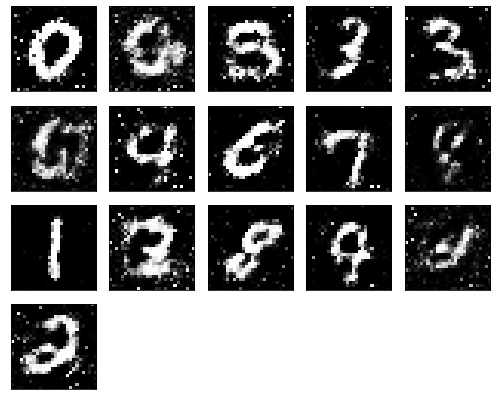

Epochs nb. 5641
discriminator loss: 0.6378127336502075
generator loss : 0.9167380332946777

Epochs nb. 5642
discriminator loss: 0.6153653860092163
generator loss : 0.9555447697639465

Epochs nb. 5643
discriminator loss: 0.5909598469734192
generator loss : 1.1291943788528442

Epochs nb. 5644
discriminator loss: 0.5870009660720825
generator loss : 1.2514185905456543

Epochs nb. 5645
discriminator loss: 0.652513325214386
generator loss : 1.1469531059265137

Epochs nb. 5646
discriminator loss: 0.6334985494613647
generator loss : 1.2753491401672363

Epochs nb. 5647
discriminator loss: 0.5523202419281006
generator loss : 1.0968908071517944

Epochs nb. 5648
discriminator loss: 0.5549815893173218
generator loss : 0.9488192796707153

Epochs nb. 5649
discriminator loss: 0.6291444897651672
generator loss : 0.9805312156677246

Epochs nb. 5650
discriminator loss: 0.6507506370544434
generator loss : 0.9825352430343628



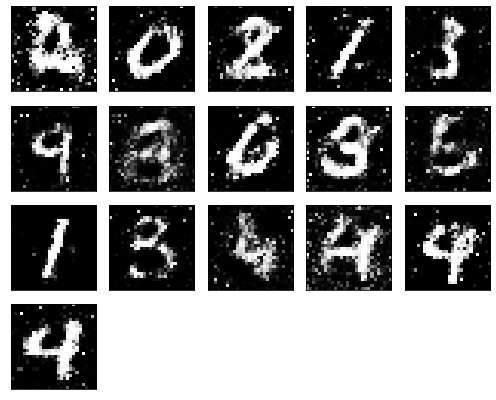

Epochs nb. 5651
discriminator loss: 0.5957598090171814
generator loss : 0.8619309663772583

Epochs nb. 5652
discriminator loss: 0.6673260927200317
generator loss : 0.8907841444015503

Epochs nb. 5653
discriminator loss: 0.6008251309394836
generator loss : 0.8991966843605042

Epochs nb. 5654
discriminator loss: 0.6654714941978455
generator loss : 0.9845924377441406

Epochs nb. 5655
discriminator loss: 0.5997573137283325
generator loss : 0.9399433135986328

Epochs nb. 5656
discriminator loss: 0.6741960644721985
generator loss : 0.8691267967224121

Epochs nb. 5657
discriminator loss: 0.5901432037353516
generator loss : 1.0538380146026611

Epochs nb. 5658
discriminator loss: 0.5020228624343872
generator loss : 0.9485392570495605

Epochs nb. 5659
discriminator loss: 0.6274264454841614
generator loss : 1.0449254512786865

Epochs nb. 5660
discriminator loss: 0.6051727533340454
generator loss : 0.9070929288864136



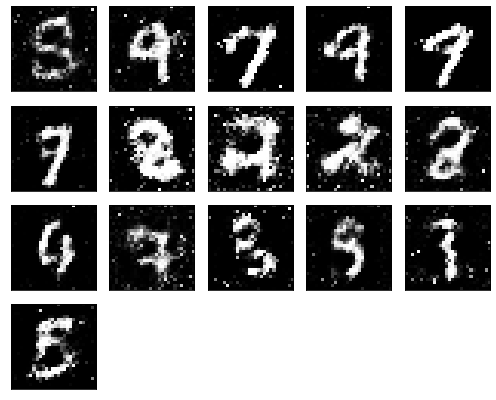

Epochs nb. 5661
discriminator loss: 0.6379002332687378
generator loss : 0.8773356676101685

Epochs nb. 5662
discriminator loss: 0.6793172359466553
generator loss : 1.064408779144287

Epochs nb. 5663
discriminator loss: 0.5821789503097534
generator loss : 0.9244064092636108

Epochs nb. 5664
discriminator loss: 0.5286686420440674
generator loss : 0.9360735416412354

Epochs nb. 5665
discriminator loss: 0.696811318397522
generator loss : 1.1110756397247314

Epochs nb. 5666
discriminator loss: 0.6313852667808533
generator loss : 1.0429625511169434

Epochs nb. 5667
discriminator loss: 0.6496278047561646
generator loss : 0.9479008316993713

Epochs nb. 5668
discriminator loss: 0.6594581604003906
generator loss : 1.0225715637207031

Epochs nb. 5669
discriminator loss: 0.5614834427833557
generator loss : 1.0258228778839111

Epochs nb. 5670
discriminator loss: 0.42008358240127563
generator loss : 0.9961031675338745



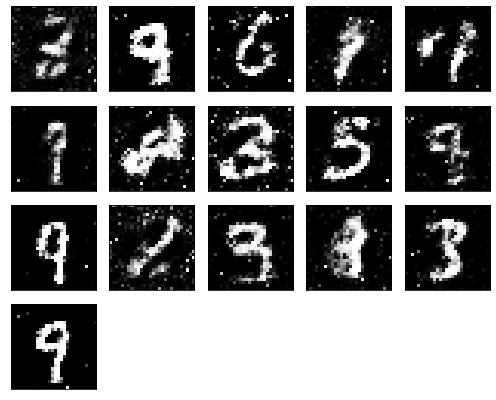

Epochs nb. 5671
discriminator loss: 0.7377960085868835
generator loss : 1.0045785903930664

Epochs nb. 5672
discriminator loss: 0.5200286507606506
generator loss : 1.0195610523223877

Epochs nb. 5673
discriminator loss: 0.5495237112045288
generator loss : 1.02837073802948

Epochs nb. 5674
discriminator loss: 0.5605484247207642
generator loss : 1.3634262084960938

Epochs nb. 5675
discriminator loss: 0.6102633476257324
generator loss : 1.1164369583129883

Epochs nb. 5676
discriminator loss: 0.5454719066619873
generator loss : 0.992198646068573

Epochs nb. 5677
discriminator loss: 0.551527738571167
generator loss : 0.972355306148529

Epochs nb. 5678
discriminator loss: 0.5525157451629639
generator loss : 0.8826595544815063

Epochs nb. 5679
discriminator loss: 0.6943331360816956
generator loss : 1.0139214992523193

Epochs nb. 5680
discriminator loss: 0.6524748206138611
generator loss : 0.9241328239440918



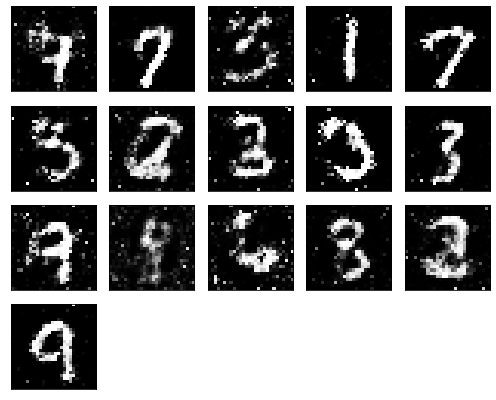

Epochs nb. 5681
discriminator loss: 0.5640023946762085
generator loss : 0.8480913639068604

Epochs nb. 5682
discriminator loss: 0.545565128326416
generator loss : 0.9791353344917297

Epochs nb. 5683
discriminator loss: 0.533208966255188
generator loss : 1.0224692821502686

Epochs nb. 5684
discriminator loss: 0.5841193199157715
generator loss : 0.9369639158248901

Epochs nb. 5685
discriminator loss: 0.6381467580795288
generator loss : 0.9686684608459473

Epochs nb. 5686
discriminator loss: 0.7635934352874756
generator loss : 0.8679593801498413

Epochs nb. 5687
discriminator loss: 0.521984338760376
generator loss : 1.1696357727050781

Epochs nb. 5688
discriminator loss: 0.5485117435455322
generator loss : 0.9453639984130859

Epochs nb. 5689
discriminator loss: 0.5709919333457947
generator loss : 0.9703682661056519

Epochs nb. 5690
discriminator loss: 0.5854125022888184
generator loss : 0.9472941160202026



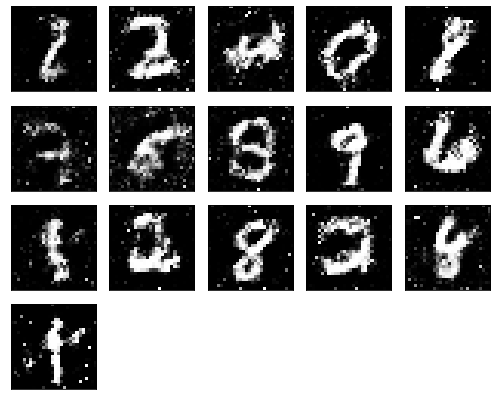

Epochs nb. 5691
discriminator loss: 0.5088735818862915
generator loss : 0.9002034068107605

Epochs nb. 5692
discriminator loss: 0.6262087225914001
generator loss : 0.9802393317222595

Epochs nb. 5693
discriminator loss: 0.5355936884880066
generator loss : 0.8918330669403076

Epochs nb. 5694
discriminator loss: 0.620152473449707
generator loss : 0.7274897694587708

Epochs nb. 5695
discriminator loss: 0.5426249504089355
generator loss : 0.8799178600311279

Epochs nb. 5696
discriminator loss: 0.6940397620201111
generator loss : 1.0206576585769653

Epochs nb. 5697
discriminator loss: 0.4557328224182129
generator loss : 0.9768739938735962

Epochs nb. 5698
discriminator loss: 0.5266188383102417
generator loss : 0.9665208458900452

Epochs nb. 5699
discriminator loss: 0.7726004719734192
generator loss : 0.9501978158950806

Epochs nb. 5700
discriminator loss: 0.5469648241996765
generator loss : 1.107744574546814



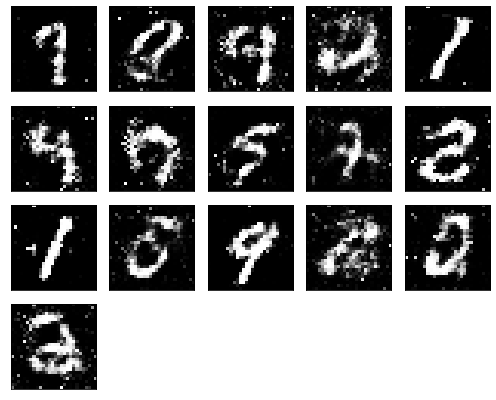

Epochs nb. 5701
discriminator loss: 0.5669353008270264
generator loss : 1.0320603847503662

Epochs nb. 5702
discriminator loss: 0.6609966158866882
generator loss : 0.9960172176361084

Epochs nb. 5703
discriminator loss: 0.5700582265853882
generator loss : 0.7736853957176208

Epochs nb. 5704
discriminator loss: 0.6052281260490417
generator loss : 0.9600916504859924

Epochs nb. 5705
discriminator loss: 0.6265122890472412
generator loss : 0.832486629486084

Epochs nb. 5706
discriminator loss: 0.6538188457489014
generator loss : 1.0905239582061768

Epochs nb. 5707
discriminator loss: 0.5587290525436401
generator loss : 0.8322558403015137

Epochs nb. 5708
discriminator loss: 0.6936519145965576
generator loss : 0.8233818411827087

Epochs nb. 5709
discriminator loss: 0.6876357793807983
generator loss : 1.19346022605896

Epochs nb. 5710
discriminator loss: 0.6833811402320862
generator loss : 1.1200675964355469



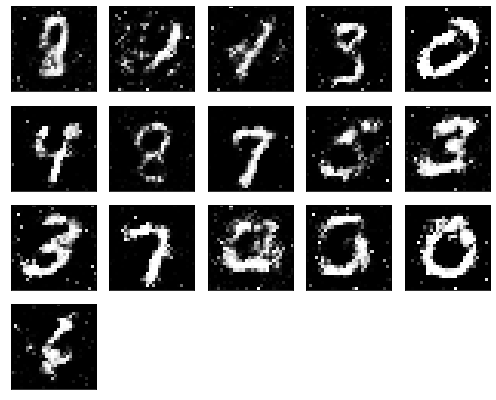

Epochs nb. 5711
discriminator loss: 0.5861296057701111
generator loss : 0.9686337113380432

Epochs nb. 5712
discriminator loss: 0.6159694790840149
generator loss : 1.1670701503753662

Epochs nb. 5713
discriminator loss: 0.5482670664787292
generator loss : 0.8549095392227173

Epochs nb. 5714
discriminator loss: 0.5239726305007935
generator loss : 1.0034475326538086

Epochs nb. 5715
discriminator loss: 0.6193872094154358
generator loss : 1.0468227863311768

Epochs nb. 5716
discriminator loss: 0.7027759552001953
generator loss : 1.0776557922363281

Epochs nb. 5717
discriminator loss: 0.5408437848091125
generator loss : 0.8512427806854248

Epochs nb. 5718
discriminator loss: 0.611781120300293
generator loss : 0.88037109375

Epochs nb. 5719
discriminator loss: 0.5933555364608765
generator loss : 1.0608937740325928

Epochs nb. 5720
discriminator loss: 0.5884037017822266
generator loss : 1.0126231908798218



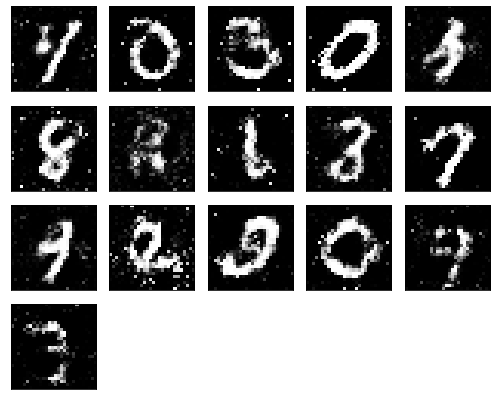

Epochs nb. 5721
discriminator loss: 0.6279795169830322
generator loss : 1.2084248065948486

Epochs nb. 5722
discriminator loss: 0.5173112750053406
generator loss : 0.9085162878036499

Epochs nb. 5723
discriminator loss: 0.49990445375442505
generator loss : 0.9809239506721497

Epochs nb. 5724
discriminator loss: 0.6485614776611328
generator loss : 1.0269519090652466

Epochs nb. 5725
discriminator loss: 0.7774884104728699
generator loss : 0.9022905826568604

Epochs nb. 5726
discriminator loss: 0.6493688821792603
generator loss : 1.0057122707366943

Epochs nb. 5727
discriminator loss: 0.5197474956512451
generator loss : 0.9318608045578003

Epochs nb. 5728
discriminator loss: 0.49392759799957275
generator loss : 0.9117153882980347

Epochs nb. 5729
discriminator loss: 0.47610345482826233
generator loss : 0.8179933428764343

Epochs nb. 5730
discriminator loss: 0.6284891366958618
generator loss : 1.0426335334777832



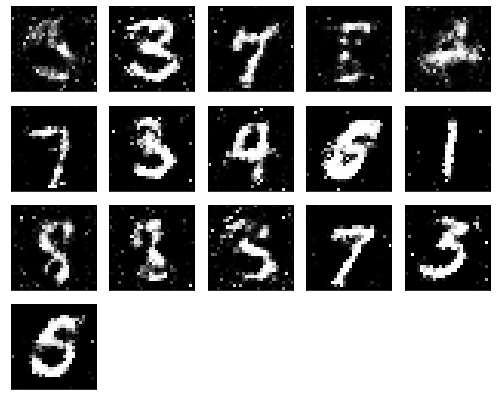

Epochs nb. 5731
discriminator loss: 0.6788665056228638
generator loss : 1.231877088546753

Epochs nb. 5732
discriminator loss: 0.7616141438484192
generator loss : 1.2135916948318481

Epochs nb. 5733
discriminator loss: 0.6313670873641968
generator loss : 1.090450644493103

Epochs nb. 5734
discriminator loss: 0.6214084029197693
generator loss : 1.0311870574951172

Epochs nb. 5735
discriminator loss: 0.5103228092193604
generator loss : 0.9533321857452393

Epochs nb. 5736
discriminator loss: 0.7072347402572632
generator loss : 0.9323382377624512

Epochs nb. 5737
discriminator loss: 0.5436352491378784
generator loss : 0.9367541074752808

Epochs nb. 5738
discriminator loss: 0.5173894166946411
generator loss : 0.7824766039848328

Epochs nb. 5739
discriminator loss: 0.5895929932594299
generator loss : 0.9218750596046448

Epochs nb. 5740
discriminator loss: 0.5974994897842407
generator loss : 1.0475177764892578



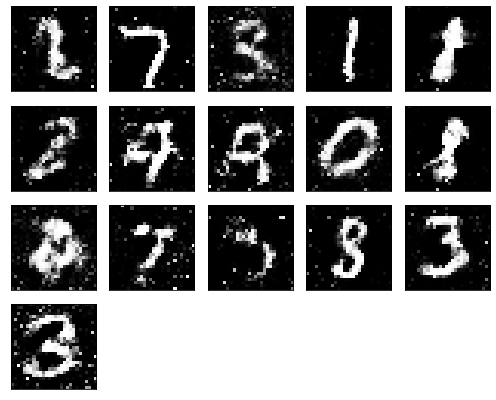

Epochs nb. 5741
discriminator loss: 0.7032418251037598
generator loss : 0.8497222065925598

Epochs nb. 5742
discriminator loss: 0.6235225200653076
generator loss : 1.1185863018035889

Epochs nb. 5743
discriminator loss: 0.6004745960235596
generator loss : 0.8732389211654663

Epochs nb. 5744
discriminator loss: 0.7666289806365967
generator loss : 0.9815917611122131

Epochs nb. 5745
discriminator loss: 0.6658336520195007
generator loss : 0.8057159185409546

Epochs nb. 5746
discriminator loss: 0.5813624262809753
generator loss : 1.0582997798919678

Epochs nb. 5747
discriminator loss: 0.5251848697662354
generator loss : 0.9345184564590454

Epochs nb. 5748
discriminator loss: 0.5128287076950073
generator loss : 0.9414450526237488

Epochs nb. 5749
discriminator loss: 0.5729905962944031
generator loss : 0.8928236365318298

Epochs nb. 5750
discriminator loss: 0.6440798044204712
generator loss : 0.9441569447517395



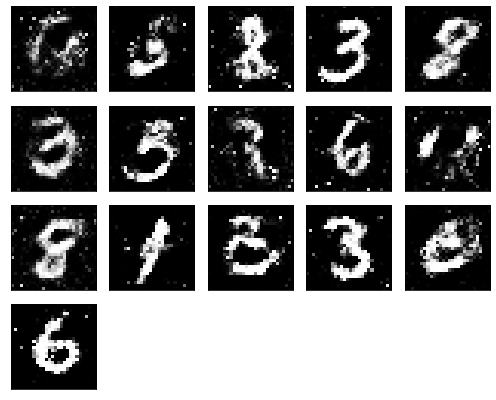

Epochs nb. 5751
discriminator loss: 0.6706222295761108
generator loss : 0.9728315472602844

Epochs nb. 5752
discriminator loss: 0.6558008790016174
generator loss : 0.9812023639678955

Epochs nb. 5753
discriminator loss: 0.7044554948806763
generator loss : 0.8210717439651489

Epochs nb. 5754
discriminator loss: 0.5698316097259521
generator loss : 0.8951917290687561

Epochs nb. 5755
discriminator loss: 0.5206718444824219
generator loss : 0.8977057337760925

Epochs nb. 5756
discriminator loss: 0.626675009727478
generator loss : 0.9568925499916077

Epochs nb. 5757
discriminator loss: 0.5800551176071167
generator loss : 1.0086424350738525

Epochs nb. 5758
discriminator loss: 0.5355923175811768
generator loss : 0.9531012177467346

Epochs nb. 5759
discriminator loss: 0.5439490675926208
generator loss : 0.947455644607544

Epochs nb. 5760
discriminator loss: 0.5577942132949829
generator loss : 0.9776166081428528



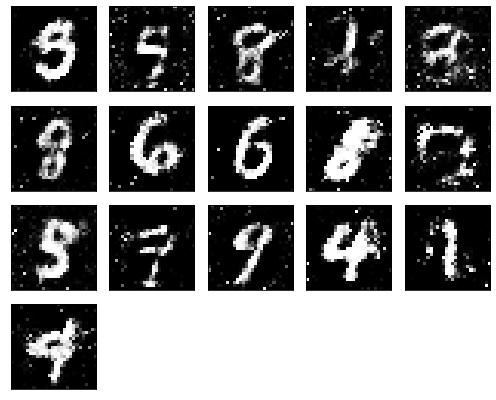

Epochs nb. 5761
discriminator loss: 0.5273566246032715
generator loss : 1.0327270030975342

Epochs nb. 5762
discriminator loss: 0.5347133278846741
generator loss : 0.9641680717468262

Epochs nb. 5763
discriminator loss: 0.6881042718887329
generator loss : 1.1837626695632935

Epochs nb. 5764
discriminator loss: 0.5521450042724609
generator loss : 1.0120877027511597

Epochs nb. 5765
discriminator loss: 0.6583850383758545
generator loss : 1.0645527839660645

Epochs nb. 5766
discriminator loss: 0.4773183763027191
generator loss : 1.1008679866790771

Epochs nb. 5767
discriminator loss: 0.5132781267166138
generator loss : 1.0975100994110107

Epochs nb. 5768
discriminator loss: 0.5416076183319092
generator loss : 1.077603816986084

Epochs nb. 5769
discriminator loss: 0.557874321937561
generator loss : 0.9726072549819946

Epochs nb. 5770
discriminator loss: 0.8783458471298218
generator loss : 1.111402988433838



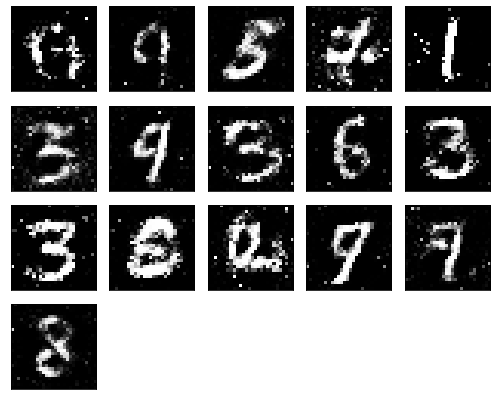

Epochs nb. 5771
discriminator loss: 0.6203275918960571
generator loss : 0.9367766976356506

Epochs nb. 5772
discriminator loss: 0.5977258086204529
generator loss : 1.0071587562561035

Epochs nb. 5773
discriminator loss: 0.6507167816162109
generator loss : 1.1054013967514038

Epochs nb. 5774
discriminator loss: 0.5685563087463379
generator loss : 1.1026052236557007

Epochs nb. 5775
discriminator loss: 0.5435065031051636
generator loss : 0.8426152467727661

Epochs nb. 5776
discriminator loss: 0.6535899639129639
generator loss : 0.9902026653289795

Epochs nb. 5777
discriminator loss: 0.66019606590271
generator loss : 1.090312123298645

Epochs nb. 5778
discriminator loss: 0.5222586393356323
generator loss : 1.066150188446045

Epochs nb. 5779
discriminator loss: 0.7126798629760742
generator loss : 0.8896265625953674

Epochs nb. 5780
discriminator loss: 0.6286566257476807
generator loss : 0.9912623167037964



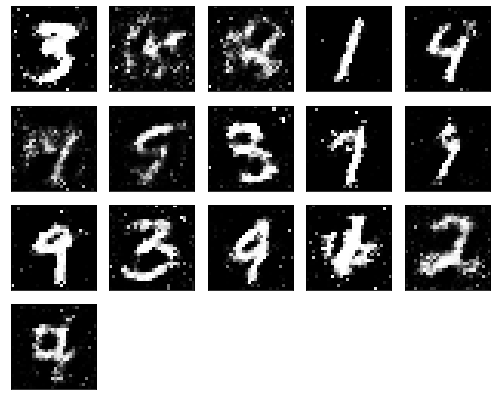

Epochs nb. 5781
discriminator loss: 0.4723818302154541
generator loss : 1.0042088031768799

Epochs nb. 5782
discriminator loss: 0.6212083101272583
generator loss : 0.7782808542251587

Epochs nb. 5783
discriminator loss: 0.7326270341873169
generator loss : 1.024026870727539

Epochs nb. 5784
discriminator loss: 0.6167256832122803
generator loss : 0.896045446395874

Epochs nb. 5785
discriminator loss: 0.5438166260719299
generator loss : 0.9868814945220947

Epochs nb. 5786
discriminator loss: 0.5938481092453003
generator loss : 0.8849791884422302

Epochs nb. 5787
discriminator loss: 0.587080717086792
generator loss : 1.0304090976715088

Epochs nb. 5788
discriminator loss: 0.6238718032836914
generator loss : 1.0587784051895142

Epochs nb. 5789
discriminator loss: 0.5668102502822876
generator loss : 0.9187157154083252

Epochs nb. 5790
discriminator loss: 0.534877598285675
generator loss : 1.0266237258911133



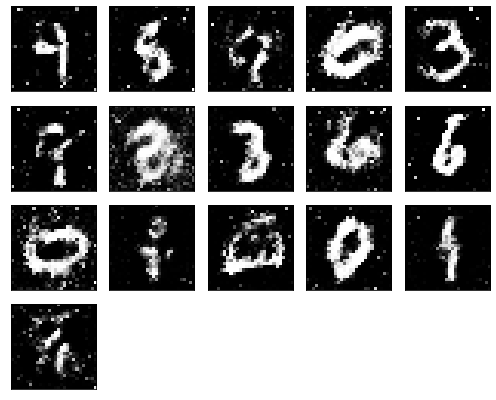

Epochs nb. 5791
discriminator loss: 0.7158496975898743
generator loss : 0.952893853187561

Epochs nb. 5792
discriminator loss: 0.6378368735313416
generator loss : 0.8520671129226685

Epochs nb. 5793
discriminator loss: 0.6139316558837891
generator loss : 0.9017210006713867

Epochs nb. 5794
discriminator loss: 0.6220580339431763
generator loss : 0.9602779150009155

Epochs nb. 5795
discriminator loss: 0.7055094838142395
generator loss : 0.8954755663871765

Epochs nb. 5796
discriminator loss: 0.5656305551528931
generator loss : 0.9221821427345276

Epochs nb. 5797
discriminator loss: 0.5378630757331848
generator loss : 0.8552032709121704

Epochs nb. 5798
discriminator loss: 0.5901541113853455
generator loss : 1.0379488468170166

Epochs nb. 5799
discriminator loss: 0.5161212086677551
generator loss : 1.0512230396270752

Epochs nb. 5800
discriminator loss: 0.6495699882507324
generator loss : 0.9139717817306519



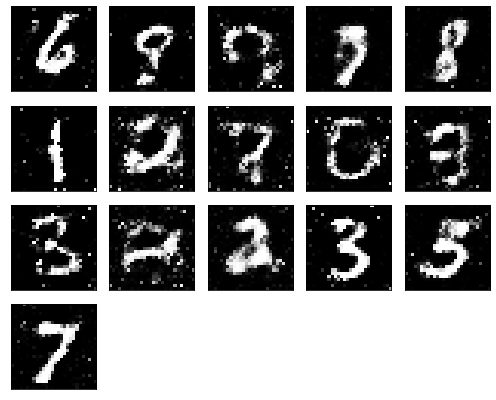

Epochs nb. 5801
discriminator loss: 0.6384011507034302
generator loss : 0.8530007600784302

Epochs nb. 5802
discriminator loss: 0.6561291217803955
generator loss : 0.9942387342453003

Epochs nb. 5803
discriminator loss: 0.5641733407974243
generator loss : 1.1744959354400635

Epochs nb. 5804
discriminator loss: 0.7785038352012634
generator loss : 1.0913701057434082

Epochs nb. 5805
discriminator loss: 0.45841941237449646
generator loss : 0.9750620126724243

Epochs nb. 5806
discriminator loss: 0.5840615630149841
generator loss : 1.1575360298156738

Epochs nb. 5807
discriminator loss: 0.7601054906845093
generator loss : 1.1983578205108643

Epochs nb. 5808
discriminator loss: 0.5829068422317505
generator loss : 1.0073684453964233

Epochs nb. 5809
discriminator loss: 0.7242262363433838
generator loss : 0.8788730502128601

Epochs nb. 5810
discriminator loss: 0.6028657555580139
generator loss : 0.8702576160430908



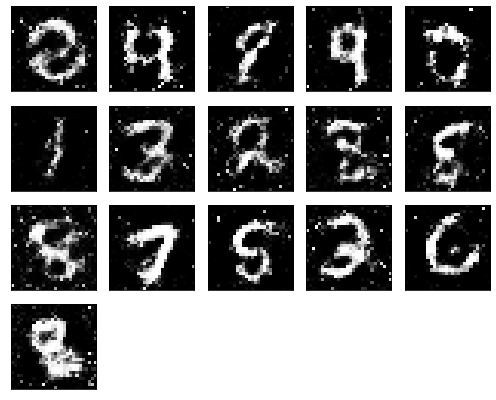

Epochs nb. 5811
discriminator loss: 0.6954094767570496
generator loss : 0.9711365103721619

Epochs nb. 5812
discriminator loss: 0.6698338389396667
generator loss : 0.9774587750434875

Epochs nb. 5813
discriminator loss: 0.6629539728164673
generator loss : 1.008431315422058

Epochs nb. 5814
discriminator loss: 0.5385268330574036
generator loss : 0.8693146109580994

Epochs nb. 5815
discriminator loss: 0.755301833152771
generator loss : 0.9122180938720703

Epochs nb. 5816
discriminator loss: 0.6183069944381714
generator loss : 0.9640680551528931

Epochs nb. 5817
discriminator loss: 0.6380946636199951
generator loss : 1.1181018352508545

Epochs nb. 5818
discriminator loss: 0.5046768188476562
generator loss : 1.1437163352966309

Epochs nb. 5819
discriminator loss: 0.6968664526939392
generator loss : 0.9565683007240295

Epochs nb. 5820
discriminator loss: 0.5785003900527954
generator loss : 0.8500888347625732



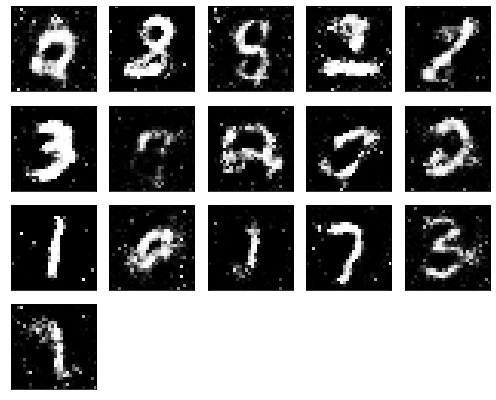

Epochs nb. 5821
discriminator loss: 0.6798165440559387
generator loss : 1.0685659646987915

Epochs nb. 5822
discriminator loss: 0.5370744466781616
generator loss : 1.0533535480499268

Epochs nb. 5823
discriminator loss: 0.6274574995040894
generator loss : 0.8818252086639404

Epochs nb. 5824
discriminator loss: 0.6260847449302673
generator loss : 0.9740732312202454

Epochs nb. 5825
discriminator loss: 0.5613176822662354
generator loss : 0.8698665499687195

Epochs nb. 5826
discriminator loss: 0.5917404294013977
generator loss : 0.8107786774635315

Epochs nb. 5827
discriminator loss: 0.5752980709075928
generator loss : 1.1538021564483643

Epochs nb. 5828
discriminator loss: 0.7023518085479736
generator loss : 0.9964661598205566

Epochs nb. 5829
discriminator loss: 0.6721421480178833
generator loss : 0.9118295907974243

Epochs nb. 5830
discriminator loss: 0.5708688497543335
generator loss : 0.8579071760177612



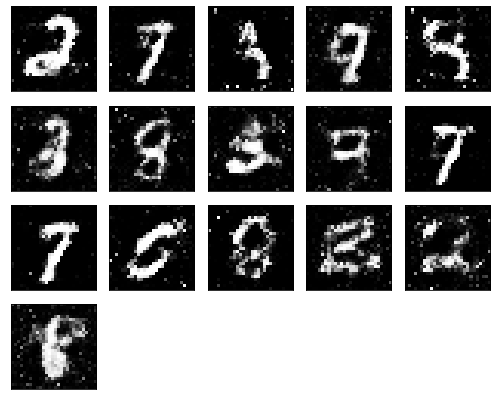

Epochs nb. 5831
discriminator loss: 0.583073079586029
generator loss : 0.9934149384498596

Epochs nb. 5832
discriminator loss: 0.5823445320129395
generator loss : 0.9172366857528687

Epochs nb. 5833
discriminator loss: 0.5627940893173218
generator loss : 1.0810933113098145

Epochs nb. 5834
discriminator loss: 0.6878179311752319
generator loss : 1.1040360927581787

Epochs nb. 5835
discriminator loss: 0.38488417863845825
generator loss : 0.9764938354492188

Epochs nb. 5836
discriminator loss: 0.4915931224822998
generator loss : 1.0999324321746826

Epochs nb. 5837
discriminator loss: 0.7109179496765137
generator loss : 1.0685815811157227

Epochs nb. 5838
discriminator loss: 0.6304880976676941
generator loss : 1.0027823448181152

Epochs nb. 5839
discriminator loss: 0.7192332744598389
generator loss : 1.056959629058838

Epochs nb. 5840
discriminator loss: 0.5992091298103333
generator loss : 0.8409534692764282



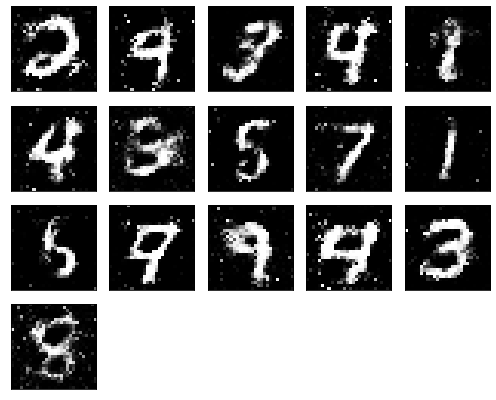

Epochs nb. 5841
discriminator loss: 0.6293684840202332
generator loss : 0.9475345611572266

Epochs nb. 5842
discriminator loss: 0.6679753661155701
generator loss : 0.9478745460510254

Epochs nb. 5843
discriminator loss: 0.5769021511077881
generator loss : 1.0100740194320679

Epochs nb. 5844
discriminator loss: 0.5463647842407227
generator loss : 1.0030097961425781

Epochs nb. 5845
discriminator loss: 0.6120178699493408
generator loss : 0.9518979787826538

Epochs nb. 5846
discriminator loss: 0.5255841016769409
generator loss : 1.0160963535308838

Epochs nb. 5847
discriminator loss: 0.5867878794670105
generator loss : 1.2074060440063477

Epochs nb. 5848
discriminator loss: 0.6014828085899353
generator loss : 0.9041907787322998

Epochs nb. 5849
discriminator loss: 0.6304247379302979
generator loss : 0.8891499638557434

Epochs nb. 5850
discriminator loss: 0.5787383913993835
generator loss : 0.8710477352142334



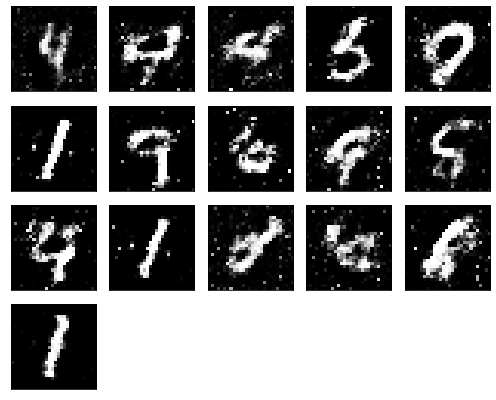

Epochs nb. 5851
discriminator loss: 0.5570900440216064
generator loss : 0.9235103130340576

Epochs nb. 5852
discriminator loss: 0.505913496017456
generator loss : 0.9013788104057312

Epochs nb. 5853
discriminator loss: 0.590851902961731
generator loss : 1.0036892890930176

Epochs nb. 5854
discriminator loss: 0.5372083187103271
generator loss : 0.7538266181945801

Epochs nb. 5855
discriminator loss: 0.4789644181728363
generator loss : 0.9880925416946411

Epochs nb. 5856
discriminator loss: 0.6077019572257996
generator loss : 0.99874347448349

Epochs nb. 5857
discriminator loss: 0.5155829787254333
generator loss : 1.1514525413513184

Epochs nb. 5858
discriminator loss: 0.6942700147628784
generator loss : 0.9440888166427612

Epochs nb. 5859
discriminator loss: 0.7510695457458496
generator loss : 1.1193562746047974

Epochs nb. 5860
discriminator loss: 0.5367717742919922
generator loss : 1.1043723821640015



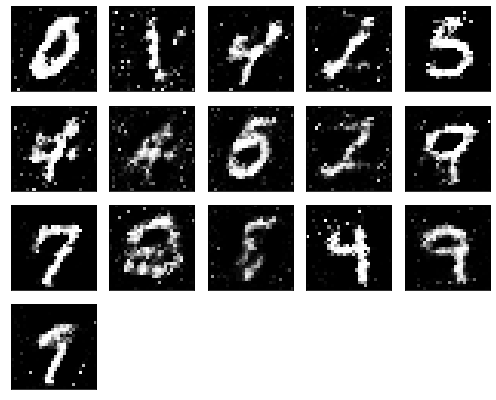

Epochs nb. 5861
discriminator loss: 0.6438251733779907
generator loss : 1.0058040618896484

Epochs nb. 5862
discriminator loss: 0.618242621421814
generator loss : 0.9473873376846313

Epochs nb. 5863
discriminator loss: 0.6398279070854187
generator loss : 1.0484035015106201

Epochs nb. 5864
discriminator loss: 0.5807328224182129
generator loss : 1.0090465545654297

Epochs nb. 5865
discriminator loss: 0.6681023836135864
generator loss : 1.0026769638061523

Epochs nb. 5866
discriminator loss: 0.6229168176651001
generator loss : 0.8986284732818604

Epochs nb. 5867
discriminator loss: 0.6596903800964355
generator loss : 0.9752318859100342

Epochs nb. 5868
discriminator loss: 0.6220903396606445
generator loss : 0.7225898504257202

Epochs nb. 5869
discriminator loss: 0.7164298295974731
generator loss : 0.9784088134765625

Epochs nb. 5870
discriminator loss: 0.5497828125953674
generator loss : 1.0439493656158447



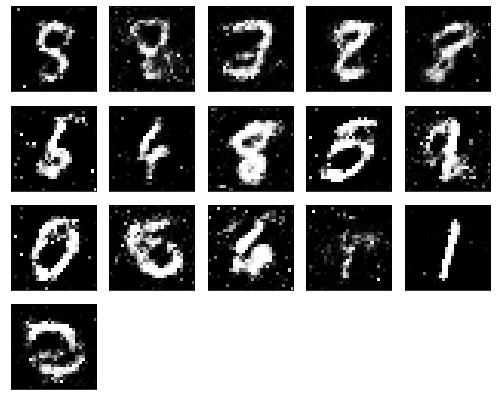

Epochs nb. 5871
discriminator loss: 0.48652419447898865
generator loss : 0.9164949655532837

Epochs nb. 5872
discriminator loss: 0.4913461208343506
generator loss : 1.1321511268615723

Epochs nb. 5873
discriminator loss: 0.7328188419342041
generator loss : 0.9146769046783447

Epochs nb. 5874
discriminator loss: 0.5823794603347778
generator loss : 1.0140938758850098

Epochs nb. 5875
discriminator loss: 0.4786880910396576
generator loss : 0.8862575888633728

Epochs nb. 5876
discriminator loss: 0.7088747620582581
generator loss : 1.1685086488723755

Epochs nb. 5877
discriminator loss: 0.6244405508041382
generator loss : 0.9597388505935669

Epochs nb. 5878
discriminator loss: 0.715397834777832
generator loss : 0.9719308614730835

Epochs nb. 5879
discriminator loss: 0.5447610020637512
generator loss : 1.1137800216674805

Epochs nb. 5880
discriminator loss: 0.6872093677520752
generator loss : 1.0490655899047852



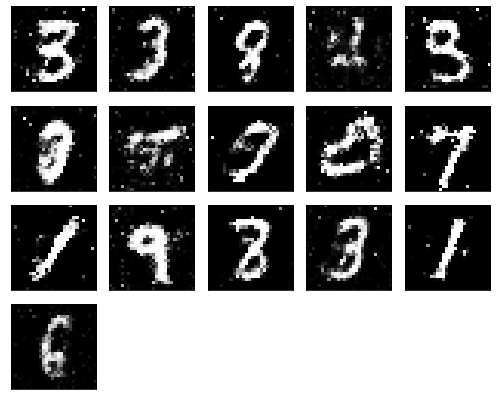

Epochs nb. 5881
discriminator loss: 0.6461756825447083
generator loss : 0.9741541147232056

Epochs nb. 5882
discriminator loss: 0.5311944484710693
generator loss : 0.9965591430664062

Epochs nb. 5883
discriminator loss: 0.6478843688964844
generator loss : 0.8916226625442505

Epochs nb. 5884
discriminator loss: 0.5796942114830017
generator loss : 0.8124163150787354

Epochs nb. 5885
discriminator loss: 0.5354640483856201
generator loss : 0.9025552868843079

Epochs nb. 5886
discriminator loss: 0.6882213950157166
generator loss : 1.1538763046264648

Epochs nb. 5887
discriminator loss: 0.5637106895446777
generator loss : 0.9247609376907349

Epochs nb. 5888
discriminator loss: 0.7465815544128418
generator loss : 0.8795908689498901

Epochs nb. 5889
discriminator loss: 0.6090320348739624
generator loss : 0.8179795145988464

Epochs nb. 5890
discriminator loss: 0.6093159914016724
generator loss : 0.9851726293563843



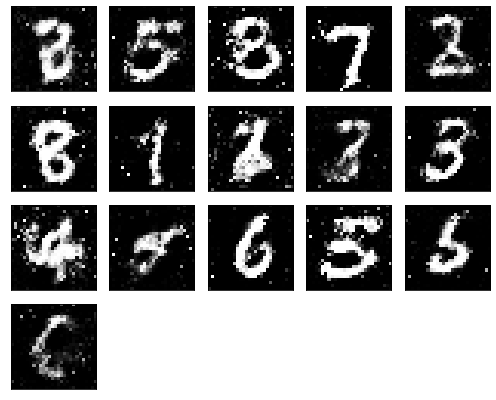

Epochs nb. 5891
discriminator loss: 0.6344451308250427
generator loss : 0.9632577300071716

Epochs nb. 5892
discriminator loss: 0.5631425380706787
generator loss : 0.9996035695075989

Epochs nb. 5893
discriminator loss: 0.46574103832244873
generator loss : 0.9519951343536377

Epochs nb. 5894
discriminator loss: 0.5255498886108398
generator loss : 1.142913579940796

Epochs nb. 5895
discriminator loss: 0.5152398943901062
generator loss : 1.1076029539108276

Epochs nb. 5896
discriminator loss: 0.5094607472419739
generator loss : 1.0087109804153442

Epochs nb. 5897
discriminator loss: 0.6383477449417114
generator loss : 1.0983123779296875

Epochs nb. 5898
discriminator loss: 0.6021854877471924
generator loss : 0.9011049270629883

Epochs nb. 5899
discriminator loss: 0.5536898970603943
generator loss : 1.120819091796875

Epochs nb. 5900
discriminator loss: 0.6241123676300049
generator loss : 0.863732099533081



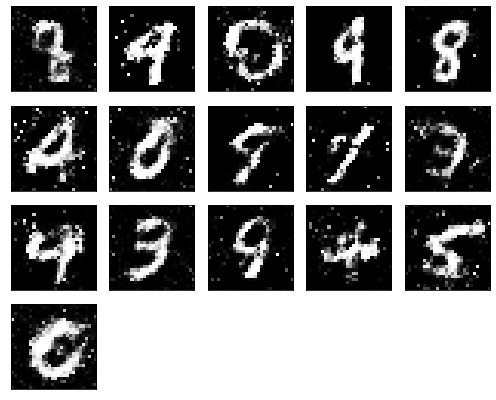

Epochs nb. 5901
discriminator loss: 0.5073174238204956
generator loss : 1.0048489570617676

Epochs nb. 5902
discriminator loss: 0.6779307126998901
generator loss : 1.1464226245880127

Epochs nb. 5903
discriminator loss: 0.5549103617668152
generator loss : 0.9709593057632446

Epochs nb. 5904
discriminator loss: 0.4966563284397125
generator loss : 1.0131537914276123

Epochs nb. 5905
discriminator loss: 0.5297035574913025
generator loss : 1.061943769454956

Epochs nb. 5906
discriminator loss: 0.6340996026992798
generator loss : 1.1397197246551514

Epochs nb. 5907
discriminator loss: 0.45375657081604004
generator loss : 0.850814700126648

Epochs nb. 5908
discriminator loss: 0.6622852087020874
generator loss : 1.0008916854858398

Epochs nb. 5909
discriminator loss: 0.5536321401596069
generator loss : 0.9463484287261963

Epochs nb. 5910
discriminator loss: 0.6255658268928528
generator loss : 1.0247167348861694



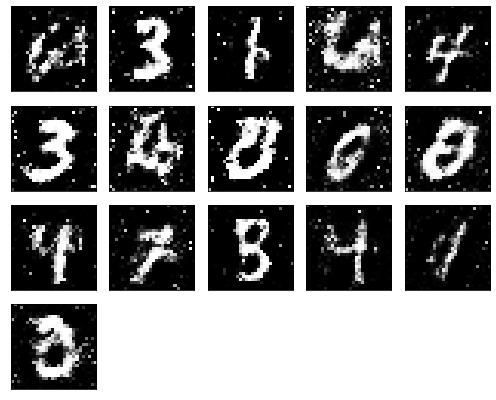

Epochs nb. 5911
discriminator loss: 0.652927041053772
generator loss : 0.9249122738838196

Epochs nb. 5912
discriminator loss: 0.5460637807846069
generator loss : 1.020094871520996

Epochs nb. 5913
discriminator loss: 0.6229935884475708
generator loss : 1.1344486474990845

Epochs nb. 5914
discriminator loss: 0.6208411455154419
generator loss : 1.1131434440612793

Epochs nb. 5915
discriminator loss: 0.6212503910064697
generator loss : 1.2791471481323242

Epochs nb. 5916
discriminator loss: 0.5971078276634216
generator loss : 1.037092685699463

Epochs nb. 5917
discriminator loss: 0.5714064240455627
generator loss : 1.1807968616485596

Epochs nb. 5918
discriminator loss: 0.6061272621154785
generator loss : 0.84945148229599

Epochs nb. 5919
discriminator loss: 0.4879431128501892
generator loss : 0.9938809871673584

Epochs nb. 5920
discriminator loss: 0.7977126836776733
generator loss : 1.2300658226013184



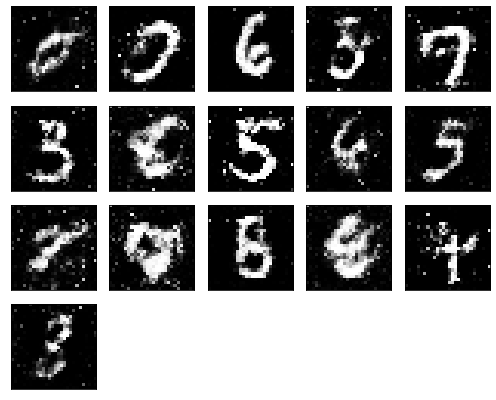

Epochs nb. 5921
discriminator loss: 0.5269332528114319
generator loss : 1.0610365867614746

Epochs nb. 5922
discriminator loss: 0.6832179427146912
generator loss : 0.9856401085853577

Epochs nb. 5923
discriminator loss: 0.7188245058059692
generator loss : 1.0762081146240234

Epochs nb. 5924
discriminator loss: 0.4806823134422302
generator loss : 1.1505634784698486

Epochs nb. 5925
discriminator loss: 0.6528306007385254
generator loss : 0.966208815574646

Epochs nb. 5926
discriminator loss: 0.5870131850242615
generator loss : 1.0937767028808594

Epochs nb. 5927
discriminator loss: 0.608595609664917
generator loss : 1.0871959924697876

Epochs nb. 5928
discriminator loss: 0.5720149874687195
generator loss : 1.061272382736206

Epochs nb. 5929
discriminator loss: 0.7952018976211548
generator loss : 0.8656042814254761

Epochs nb. 5930
discriminator loss: 0.5570725202560425
generator loss : 0.6841695308685303



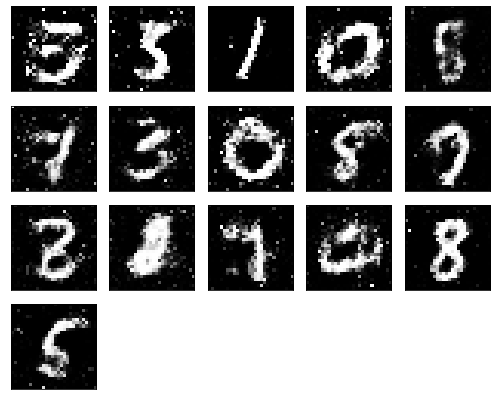

Epochs nb. 5931
discriminator loss: 0.6259639263153076
generator loss : 0.9209401607513428

Epochs nb. 5932
discriminator loss: 0.6162303686141968
generator loss : 0.8844334483146667

Epochs nb. 5933
discriminator loss: 0.5904178619384766
generator loss : 0.8714228272438049

Epochs nb. 5934
discriminator loss: 0.5948808193206787
generator loss : 0.9567667245864868

Epochs nb. 5935
discriminator loss: 0.6164422035217285
generator loss : 0.8845119476318359

Epochs nb. 5936
discriminator loss: 0.5049630403518677
generator loss : 1.1522990465164185

Epochs nb. 5937
discriminator loss: 0.5975313782691956
generator loss : 1.1601877212524414

Epochs nb. 5938
discriminator loss: 0.6228755712509155
generator loss : 1.291633129119873

Epochs nb. 5939
discriminator loss: 0.5090949535369873
generator loss : 0.9498155117034912

Epochs nb. 5940
discriminator loss: 0.6227478384971619
generator loss : 1.0715055465698242



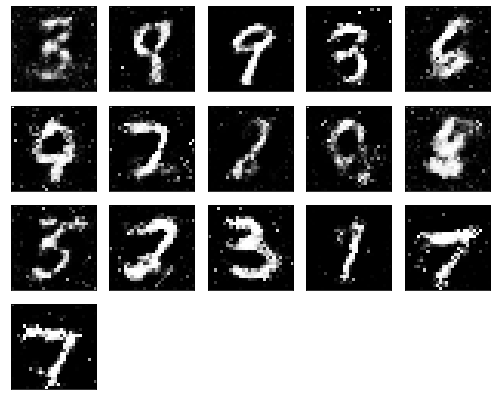

Epochs nb. 5941
discriminator loss: 0.6615993976593018
generator loss : 1.0550729036331177

Epochs nb. 5942
discriminator loss: 0.6475257277488708
generator loss : 0.9192519187927246

Epochs nb. 5943
discriminator loss: 0.6923721432685852
generator loss : 0.9193196296691895

Epochs nb. 5944
discriminator loss: 0.5873256325721741
generator loss : 1.0549174547195435

Epochs nb. 5945
discriminator loss: 0.534320592880249
generator loss : 0.973770260810852

Epochs nb. 5946
discriminator loss: 0.5660077929496765
generator loss : 0.8571716547012329

Epochs nb. 5947
discriminator loss: 0.5670450925827026
generator loss : 0.8435655832290649

Epochs nb. 5948
discriminator loss: 0.5586779117584229
generator loss : 0.8394940495491028

Epochs nb. 5949
discriminator loss: 0.5935912132263184
generator loss : 0.9605850577354431

Epochs nb. 5950
discriminator loss: 0.6786493062973022
generator loss : 0.9284949898719788



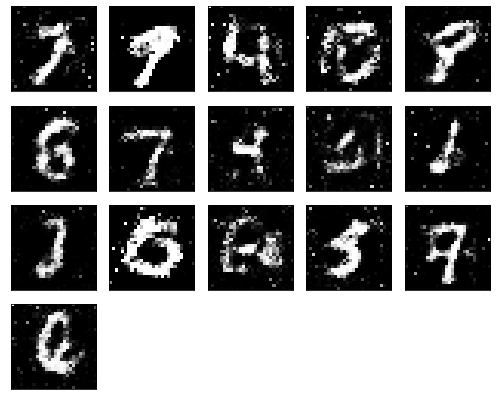

Epochs nb. 5951
discriminator loss: 0.672584056854248
generator loss : 1.0390704870224

Epochs nb. 5952
discriminator loss: 0.582294225692749
generator loss : 0.9272061586380005

Epochs nb. 5953
discriminator loss: 0.6299470663070679
generator loss : 0.9293675422668457

Epochs nb. 5954
discriminator loss: 0.5887737274169922
generator loss : 0.8812733888626099

Epochs nb. 5955
discriminator loss: 0.593253493309021
generator loss : 0.9808226823806763

Epochs nb. 5956
discriminator loss: 0.6124294996261597
generator loss : 1.0491762161254883

Epochs nb. 5957
discriminator loss: 0.6172446012496948
generator loss : 0.9338768720626831

Epochs nb. 5958
discriminator loss: 0.5613075494766235
generator loss : 0.8359339833259583

Epochs nb. 5959
discriminator loss: 0.620853066444397
generator loss : 0.8332449793815613

Epochs nb. 5960
discriminator loss: 0.6180970668792725
generator loss : 1.1489667892456055



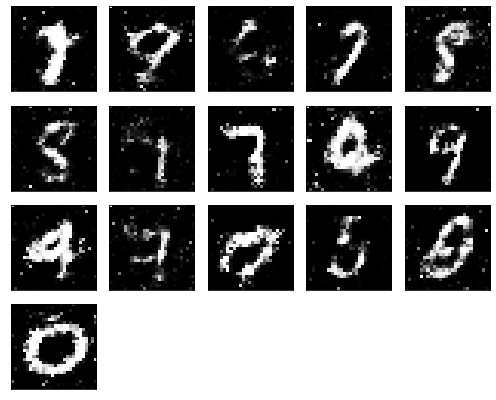

Epochs nb. 5961
discriminator loss: 0.4980982542037964
generator loss : 1.060368537902832

Epochs nb. 5962
discriminator loss: 0.6319729089736938
generator loss : 0.9813430309295654

Epochs nb. 5963
discriminator loss: 0.6377640962600708
generator loss : 0.7806950807571411

Epochs nb. 5964
discriminator loss: 0.4902060031890869
generator loss : 0.9728246927261353

Epochs nb. 5965
discriminator loss: 0.6362050771713257
generator loss : 0.9146420955657959

Epochs nb. 5966
discriminator loss: 0.5616886615753174
generator loss : 0.8962759971618652

Epochs nb. 5967
discriminator loss: 0.761947751045227
generator loss : 0.9487013220787048

Epochs nb. 5968
discriminator loss: 0.6321448683738708
generator loss : 1.0450193881988525

Epochs nb. 5969
discriminator loss: 0.6461349129676819
generator loss : 1.0842995643615723

Epochs nb. 5970
discriminator loss: 0.6298099160194397
generator loss : 0.9350426197052002



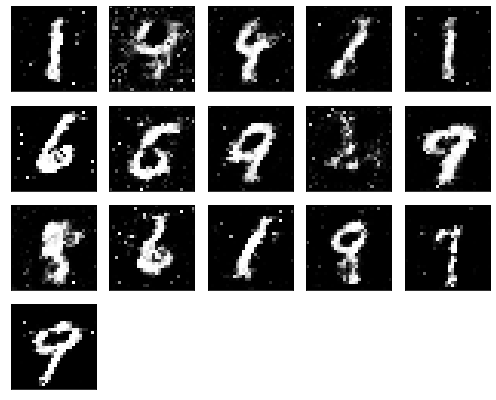

Epochs nb. 5971
discriminator loss: 0.6651633977890015
generator loss : 1.0280637741088867

Epochs nb. 5972
discriminator loss: 0.4705408811569214
generator loss : 0.9653138518333435

Epochs nb. 5973
discriminator loss: 0.5322808027267456
generator loss : 1.0576257705688477

Epochs nb. 5974
discriminator loss: 0.5568256974220276
generator loss : 1.0183055400848389

Epochs nb. 5975
discriminator loss: 0.6980351209640503
generator loss : 0.9930219054222107

Epochs nb. 5976
discriminator loss: 0.5975019931793213
generator loss : 1.1104283332824707

Epochs nb. 5977
discriminator loss: 0.5430352687835693
generator loss : 0.9588782787322998

Epochs nb. 5978
discriminator loss: 0.5827527046203613
generator loss : 1.085876226425171

Epochs nb. 5979
discriminator loss: 0.578804612159729
generator loss : 1.12152898311615

Epochs nb. 5980
discriminator loss: 0.7401598691940308
generator loss : 1.015636920928955



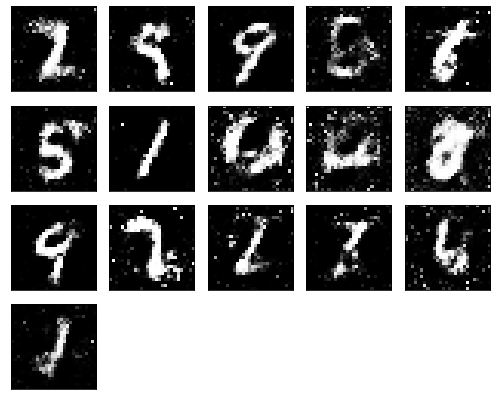

Epochs nb. 5981
discriminator loss: 0.5528416633605957
generator loss : 0.8759387731552124

Epochs nb. 5982
discriminator loss: 0.7569948434829712
generator loss : 0.9896973371505737

Epochs nb. 5983
discriminator loss: 0.5633150935173035
generator loss : 1.1023988723754883

Epochs nb. 5984
discriminator loss: 0.6137126684188843
generator loss : 0.9818835258483887

Epochs nb. 5985
discriminator loss: 0.5520708560943604
generator loss : 0.8352351784706116

Epochs nb. 5986
discriminator loss: 0.601189911365509
generator loss : 0.9463118314743042

Epochs nb. 5987
discriminator loss: 0.5317209959030151
generator loss : 1.048367977142334

Epochs nb. 5988
discriminator loss: 0.5794317722320557
generator loss : 0.9328427314758301

Epochs nb. 5989
discriminator loss: 0.5734890699386597
generator loss : 1.0531977415084839

Epochs nb. 5990
discriminator loss: 0.5724376440048218
generator loss : 0.9973899126052856



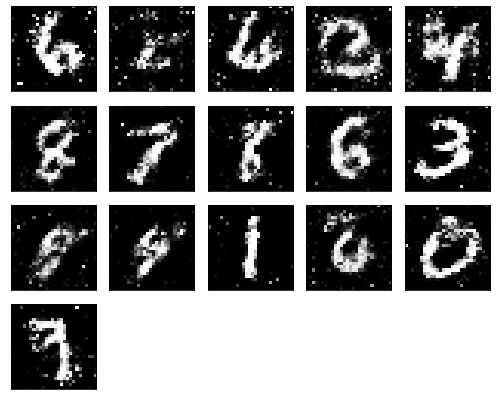

Epochs nb. 5991
discriminator loss: 0.7088587284088135
generator loss : 0.8867491483688354

Epochs nb. 5992
discriminator loss: 0.6893326640129089
generator loss : 1.0449016094207764

Epochs nb. 5993
discriminator loss: 0.6745603680610657
generator loss : 1.063981294631958

Epochs nb. 5994
discriminator loss: 0.6237081289291382
generator loss : 1.103633165359497

Epochs nb. 5995
discriminator loss: 0.6024219393730164
generator loss : 0.7563217878341675

Epochs nb. 5996
discriminator loss: 0.5000648498535156
generator loss : 0.972516655921936

Epochs nb. 5997
discriminator loss: 0.6466559767723083
generator loss : 0.8450545072555542

Epochs nb. 5998
discriminator loss: 0.49922415614128113
generator loss : 0.8412144184112549

Epochs nb. 5999
discriminator loss: 0.545708179473877
generator loss : 0.9079551696777344

Epochs nb. 6000
discriminator loss: 0.5365754961967468
generator loss : 0.8405377268791199



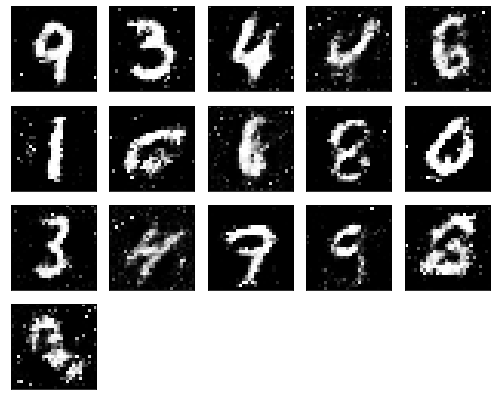

Epochs nb. 6001
discriminator loss: 0.4832175672054291
generator loss : 0.9208428859710693

Epochs nb. 6002
discriminator loss: 0.6705003976821899
generator loss : 0.8430466651916504

Epochs nb. 6003
discriminator loss: 0.4647630453109741
generator loss : 0.8519543409347534

Epochs nb. 6004
discriminator loss: 0.5282355546951294
generator loss : 0.7445698976516724

Epochs nb. 6005
discriminator loss: 0.6314899325370789
generator loss : 0.8085246086120605

Epochs nb. 6006
discriminator loss: 0.5586992502212524
generator loss : 0.9559111595153809

Epochs nb. 6007
discriminator loss: 0.5735350847244263
generator loss : 0.9624801874160767

Epochs nb. 6008
discriminator loss: 0.5543689727783203
generator loss : 0.9151973724365234

Epochs nb. 6009
discriminator loss: 0.5993843078613281
generator loss : 0.8863488435745239

Epochs nb. 6010
discriminator loss: 0.7058089375495911
generator loss : 1.0066213607788086



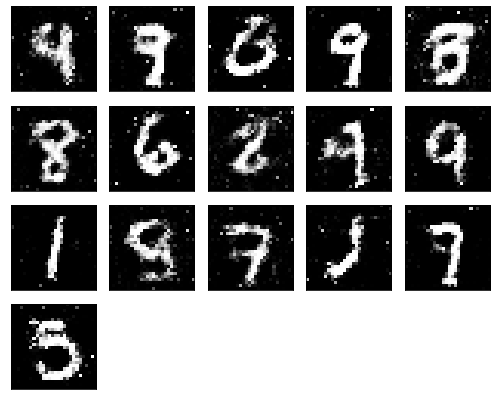

Epochs nb. 6011
discriminator loss: 0.5646580457687378
generator loss : 0.9395004510879517

Epochs nb. 6012
discriminator loss: 0.6406479477882385
generator loss : 1.0567233562469482

Epochs nb. 6013
discriminator loss: 0.5421687364578247
generator loss : 1.0398379564285278

Epochs nb. 6014
discriminator loss: 0.4621977210044861
generator loss : 1.2102429866790771

Epochs nb. 6015
discriminator loss: 0.5575922727584839
generator loss : 1.1010650396347046

Epochs nb. 6016
discriminator loss: 0.539240837097168
generator loss : 0.983895480632782

Epochs nb. 6017
discriminator loss: 0.6966203451156616
generator loss : 1.1161291599273682

Epochs nb. 6018
discriminator loss: 0.6469852924346924
generator loss : 1.1492812633514404

Epochs nb. 6019
discriminator loss: 0.5835713744163513
generator loss : 1.0013611316680908

Epochs nb. 6020
discriminator loss: 0.4958837032318115
generator loss : 0.9503178596496582



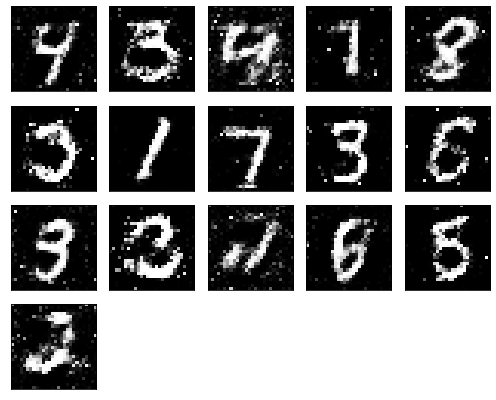

Epochs nb. 6021
discriminator loss: 0.5527898073196411
generator loss : 1.0347375869750977

Epochs nb. 6022
discriminator loss: 0.6958591938018799
generator loss : 1.169309377670288

Epochs nb. 6023
discriminator loss: 0.46745753288269043
generator loss : 0.8250417709350586

Epochs nb. 6024
discriminator loss: 0.5383937954902649
generator loss : 0.9840899109840393

Epochs nb. 6025
discriminator loss: 0.5932568311691284
generator loss : 0.9720786809921265

Epochs nb. 6026
discriminator loss: 0.5102860331535339
generator loss : 0.9263888001441956

Epochs nb. 6027
discriminator loss: 0.49045950174331665
generator loss : 0.9083086252212524

Epochs nb. 6028
discriminator loss: 0.46535274386405945
generator loss : 0.9579800367355347

Epochs nb. 6029
discriminator loss: 0.6539455056190491
generator loss : 0.877801775932312

Epochs nb. 6030
discriminator loss: 0.47576773166656494
generator loss : 0.7883536219596863



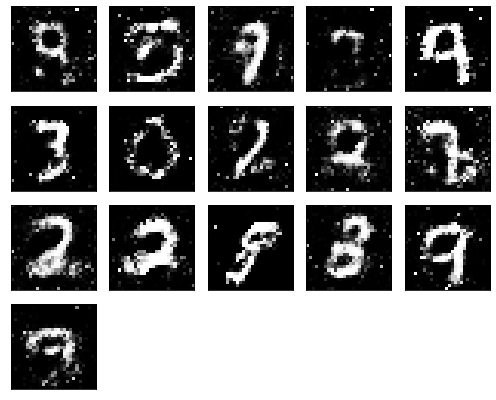

Epochs nb. 6031
discriminator loss: 0.550739049911499
generator loss : 0.8548750281333923

Epochs nb. 6032
discriminator loss: 0.5954524278640747
generator loss : 1.050370454788208

Epochs nb. 6033
discriminator loss: 0.6225310564041138
generator loss : 0.935319185256958

Epochs nb. 6034
discriminator loss: 0.6778812408447266
generator loss : 0.9934989809989929

Epochs nb. 6035
discriminator loss: 0.5461466908454895
generator loss : 0.8410625457763672

Epochs nb. 6036
discriminator loss: 0.6292576789855957
generator loss : 1.003810167312622

Epochs nb. 6037
discriminator loss: 0.5992575287818909
generator loss : 1.0077561140060425

Epochs nb. 6038
discriminator loss: 0.5116918683052063
generator loss : 1.0001972913742065

Epochs nb. 6039
discriminator loss: 0.6427446603775024
generator loss : 1.0475300550460815

Epochs nb. 6040
discriminator loss: 0.5934416055679321
generator loss : 0.9738352298736572



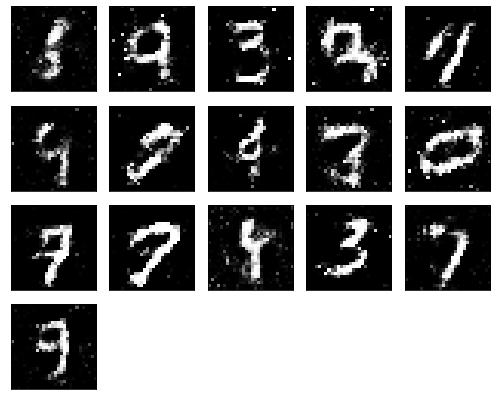

Epochs nb. 6041
discriminator loss: 0.485917866230011
generator loss : 0.8761710524559021

Epochs nb. 6042
discriminator loss: 0.5191336274147034
generator loss : 1.0692180395126343

Epochs nb. 6043
discriminator loss: 0.5683443546295166
generator loss : 1.198219895362854

Epochs nb. 6044
discriminator loss: 0.6341782808303833
generator loss : 0.8390257358551025

Epochs nb. 6045
discriminator loss: 0.5095653533935547
generator loss : 0.873390793800354

Epochs nb. 6046
discriminator loss: 0.6338253021240234
generator loss : 0.8651689291000366

Epochs nb. 6047
discriminator loss: 0.536736249923706
generator loss : 0.9859561920166016

Epochs nb. 6048
discriminator loss: 0.5556151866912842
generator loss : 0.9678130149841309

Epochs nb. 6049
discriminator loss: 0.5230062007904053
generator loss : 0.981854259967804

Epochs nb. 6050
discriminator loss: 0.5967025756835938
generator loss : 1.0531901121139526



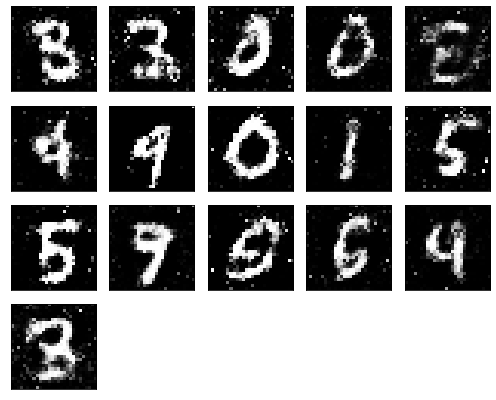

Epochs nb. 6051
discriminator loss: 0.6496648192405701
generator loss : 1.1424930095672607

Epochs nb. 6052
discriminator loss: 0.652530312538147
generator loss : 0.9148914813995361

Epochs nb. 6053
discriminator loss: 0.6237649917602539
generator loss : 0.9655141234397888

Epochs nb. 6054
discriminator loss: 0.5315107703208923
generator loss : 0.89389967918396

Epochs nb. 6055
discriminator loss: 0.5388495922088623
generator loss : 0.863257646560669

Epochs nb. 6056
discriminator loss: 0.4826739430427551
generator loss : 0.9184724688529968

Epochs nb. 6057
discriminator loss: 0.4582376480102539
generator loss : 1.0121850967407227

Epochs nb. 6058
discriminator loss: 0.6010177731513977
generator loss : 0.9339001178741455

Epochs nb. 6059
discriminator loss: 0.47164401412010193
generator loss : 0.9324798583984375

Epochs nb. 6060
discriminator loss: 0.6616759896278381
generator loss : 0.9798269271850586



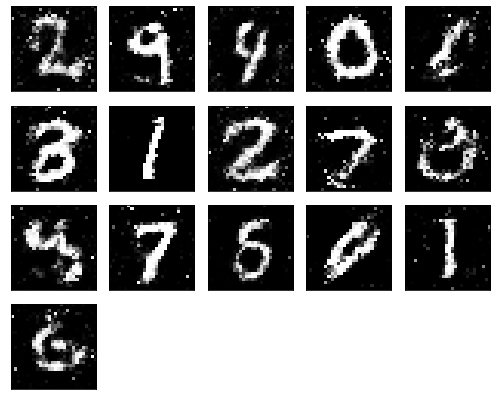

Epochs nb. 6061
discriminator loss: 0.5855441093444824
generator loss : 1.149448037147522

Epochs nb. 6062
discriminator loss: 0.4719824194908142
generator loss : 1.1660468578338623

Epochs nb. 6063
discriminator loss: 0.6152194738388062
generator loss : 1.2710528373718262

Epochs nb. 6064
discriminator loss: 0.6598143577575684
generator loss : 1.0194206237792969

Epochs nb. 6065
discriminator loss: 0.4752090573310852
generator loss : 1.0501197576522827

Epochs nb. 6066
discriminator loss: 0.6029965281486511
generator loss : 0.9588375091552734

Epochs nb. 6067
discriminator loss: 0.4222131371498108
generator loss : 1.0077117681503296

Epochs nb. 6068
discriminator loss: 0.5546386241912842
generator loss : 0.8394745588302612

Epochs nb. 6069
discriminator loss: 0.6137257814407349
generator loss : 0.9027130603790283

Epochs nb. 6070
discriminator loss: 0.8525931239128113
generator loss : 1.1223217248916626



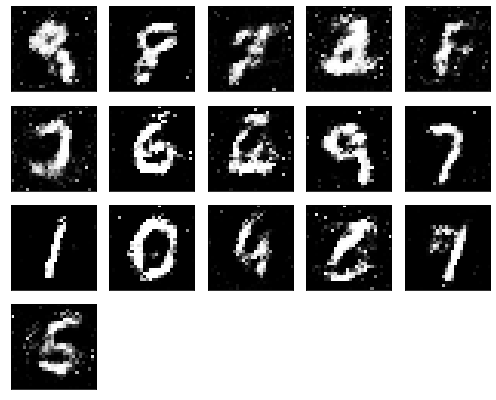

Epochs nb. 6071
discriminator loss: 0.5350225567817688
generator loss : 1.0318377017974854

Epochs nb. 6072
discriminator loss: 0.6334971189498901
generator loss : 0.8880345225334167

Epochs nb. 6073
discriminator loss: 0.7732134461402893
generator loss : 1.0499989986419678

Epochs nb. 6074
discriminator loss: 0.4726279675960541
generator loss : 1.053985357284546

Epochs nb. 6075
discriminator loss: 0.5684338808059692
generator loss : 0.9487344026565552

Epochs nb. 6076
discriminator loss: 0.648731529712677
generator loss : 1.1103103160858154

Epochs nb. 6077
discriminator loss: 0.6801546812057495
generator loss : 0.9929472804069519

Epochs nb. 6078
discriminator loss: 0.6202915906906128
generator loss : 0.9941625595092773

Epochs nb. 6079
discriminator loss: 0.5930472016334534
generator loss : 1.024848461151123

Epochs nb. 6080
discriminator loss: 0.5801256895065308
generator loss : 0.9425700306892395



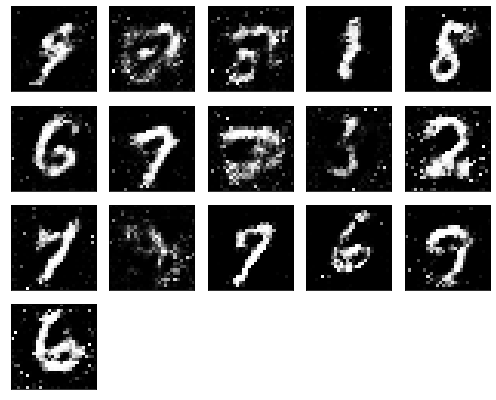

Epochs nb. 6081
discriminator loss: 0.5662839412689209
generator loss : 0.9518976211547852

Epochs nb. 6082
discriminator loss: 0.7166548371315002
generator loss : 0.9019383192062378

Epochs nb. 6083
discriminator loss: 0.6582196950912476
generator loss : 0.8084800243377686

Epochs nb. 6084
discriminator loss: 0.48134875297546387
generator loss : 0.957377552986145

Epochs nb. 6085
discriminator loss: 0.5353600978851318
generator loss : 0.9566836953163147

Epochs nb. 6086
discriminator loss: 0.5974093675613403
generator loss : 1.108519434928894

Epochs nb. 6087
discriminator loss: 0.6750384569168091
generator loss : 0.9843829274177551

Epochs nb. 6088
discriminator loss: 0.5788212418556213
generator loss : 1.1259677410125732

Epochs nb. 6089
discriminator loss: 0.46152418851852417
generator loss : 0.8569602966308594

Epochs nb. 6090
discriminator loss: 0.5412321090698242
generator loss : 1.0587595701217651



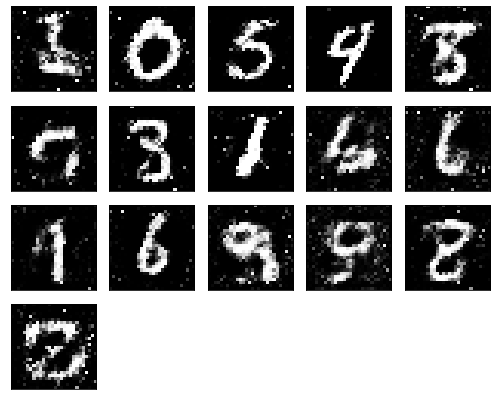

Epochs nb. 6091
discriminator loss: 0.5967785120010376
generator loss : 1.1048630475997925

Epochs nb. 6092
discriminator loss: 0.6715279817581177
generator loss : 1.028847575187683

Epochs nb. 6093
discriminator loss: 0.5765823125839233
generator loss : 0.902055025100708

Epochs nb. 6094
discriminator loss: 0.5663950443267822
generator loss : 1.0407841205596924

Epochs nb. 6095
discriminator loss: 0.6372578144073486
generator loss : 1.0556679964065552

Epochs nb. 6096
discriminator loss: 0.5964661836624146
generator loss : 1.0845234394073486

Epochs nb. 6097
discriminator loss: 0.5426004528999329
generator loss : 1.0355346202850342

Epochs nb. 6098
discriminator loss: 0.7718063592910767
generator loss : 1.0442078113555908

Epochs nb. 6099
discriminator loss: 0.5968806743621826
generator loss : 0.887157678604126

Epochs nb. 6100
discriminator loss: 0.5871813297271729
generator loss : 0.9738850593566895



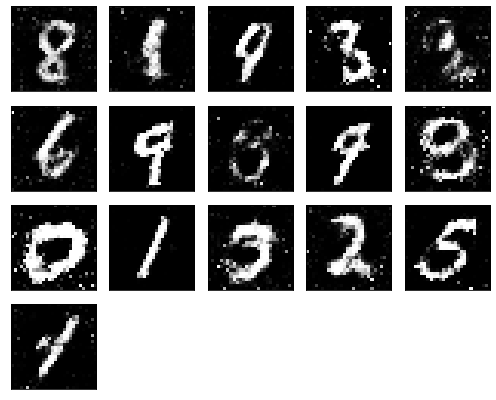

Epochs nb. 6101
discriminator loss: 0.699496865272522
generator loss : 0.9859937429428101

Epochs nb. 6102
discriminator loss: 0.5688444375991821
generator loss : 1.0359909534454346

Epochs nb. 6103
discriminator loss: 0.5869751572608948
generator loss : 0.9689162373542786

Epochs nb. 6104
discriminator loss: 0.5518959760665894
generator loss : 0.891575813293457

Epochs nb. 6105
discriminator loss: 0.773511528968811
generator loss : 0.9549066424369812

Epochs nb. 6106
discriminator loss: 0.5173463225364685
generator loss : 0.9853881597518921

Epochs nb. 6107
discriminator loss: 0.5655425786972046
generator loss : 1.0646132230758667

Epochs nb. 6108
discriminator loss: 0.6886512637138367
generator loss : 1.0181161165237427

Epochs nb. 6109
discriminator loss: 0.6247581243515015
generator loss : 0.9498059749603271

Epochs nb. 6110
discriminator loss: 0.4997974932193756
generator loss : 1.0199623107910156



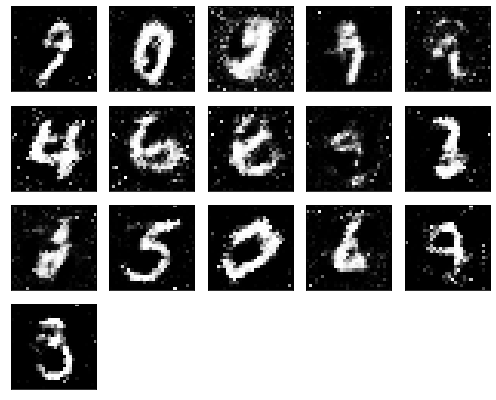

Epochs nb. 6111
discriminator loss: 0.7970883846282959
generator loss : 1.0347397327423096

Epochs nb. 6112
discriminator loss: 0.6534993052482605
generator loss : 0.8426926136016846

Epochs nb. 6113
discriminator loss: 0.7087931632995605
generator loss : 1.0177891254425049

Epochs nb. 6114
discriminator loss: 0.5094741582870483
generator loss : 0.9213809370994568

Epochs nb. 6115
discriminator loss: 0.7247386574745178
generator loss : 0.9495967626571655

Epochs nb. 6116
discriminator loss: 0.5859724283218384
generator loss : 1.2348442077636719

Epochs nb. 6117
discriminator loss: 0.5593981742858887
generator loss : 0.9039911031723022

Epochs nb. 6118
discriminator loss: 0.6029460430145264
generator loss : 0.9354642629623413

Epochs nb. 6119
discriminator loss: 0.6135042905807495
generator loss : 1.0555542707443237

Epochs nb. 6120
discriminator loss: 0.6418585777282715
generator loss : 0.9755231142044067



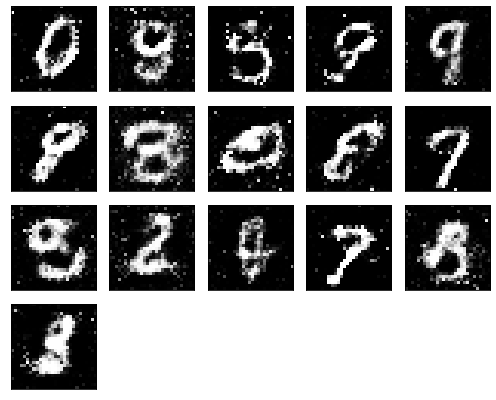

Epochs nb. 6121
discriminator loss: 0.5440600514411926
generator loss : 1.0644357204437256

Epochs nb. 6122
discriminator loss: 0.6801387071609497
generator loss : 0.9816533923149109

Epochs nb. 6123
discriminator loss: 0.6369502544403076
generator loss : 0.9654090404510498

Epochs nb. 6124
discriminator loss: 0.6619892120361328
generator loss : 0.908013641834259

Epochs nb. 6125
discriminator loss: 0.5785119533538818
generator loss : 0.8906155824661255

Epochs nb. 6126
discriminator loss: 0.5428482890129089
generator loss : 0.8398969173431396

Epochs nb. 6127
discriminator loss: 0.6004548072814941
generator loss : 0.8452135324478149

Epochs nb. 6128
discriminator loss: 0.6724437475204468
generator loss : 0.9374136328697205

Epochs nb. 6129
discriminator loss: 0.6071551442146301
generator loss : 1.0307345390319824

Epochs nb. 6130
discriminator loss: 0.5541276931762695
generator loss : 1.0708720684051514



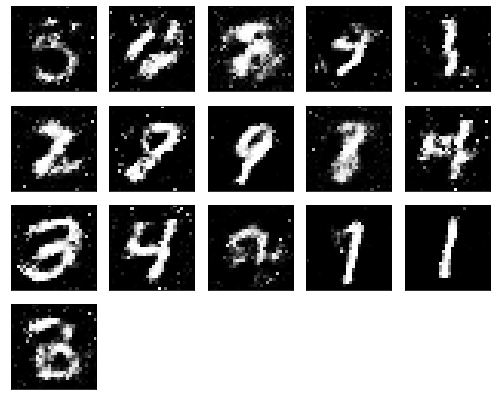

Epochs nb. 6131
discriminator loss: 0.46215227246284485
generator loss : 1.1129523515701294

Epochs nb. 6132
discriminator loss: 0.5247465372085571
generator loss : 1.0811936855316162

Epochs nb. 6133
discriminator loss: 0.46993696689605713
generator loss : 1.1959329843521118

Epochs nb. 6134
discriminator loss: 0.709152340888977
generator loss : 1.0259408950805664

Epochs nb. 6135
discriminator loss: 0.4930802583694458
generator loss : 0.9816546440124512

Epochs nb. 6136
discriminator loss: 0.6159520745277405
generator loss : 0.9445626735687256

Epochs nb. 6137
discriminator loss: 0.5754709243774414
generator loss : 0.9319815635681152

Epochs nb. 6138
discriminator loss: 0.6446513533592224
generator loss : 0.823310136795044

Epochs nb. 6139
discriminator loss: 0.6969202160835266
generator loss : 0.8413569331169128

Epochs nb. 6140
discriminator loss: 0.572118878364563
generator loss : 1.0103185176849365



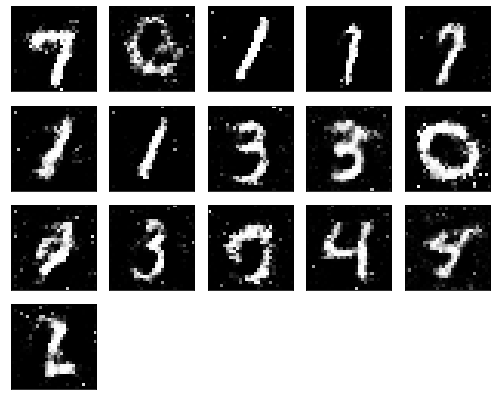

Epochs nb. 6141
discriminator loss: 0.6130737066268921
generator loss : 0.9729105234146118

Epochs nb. 6142
discriminator loss: 0.4653502106666565
generator loss : 0.8646692037582397

Epochs nb. 6143
discriminator loss: 0.6499679088592529
generator loss : 0.8954099416732788

Epochs nb. 6144
discriminator loss: 0.593195915222168
generator loss : 0.7120955586433411

Epochs nb. 6145
discriminator loss: 0.6502413153648376
generator loss : 0.9492642879486084

Epochs nb. 6146
discriminator loss: 0.6049870848655701
generator loss : 0.7890130281448364

Epochs nb. 6147
discriminator loss: 0.6650499105453491
generator loss : 0.8453595638275146

Epochs nb. 6148
discriminator loss: 0.5290420055389404
generator loss : 0.8301473259925842

Epochs nb. 6149
discriminator loss: 0.6462171077728271
generator loss : 1.0979851484298706

Epochs nb. 6150
discriminator loss: 0.49391984939575195
generator loss : 1.0544219017028809



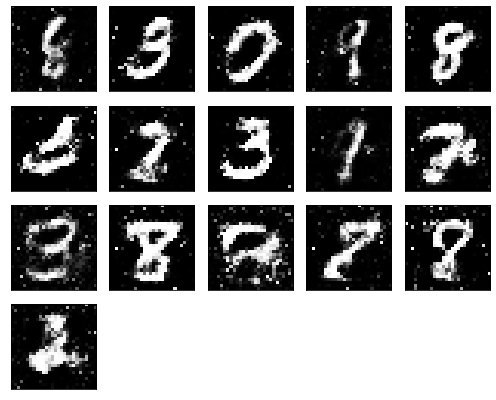

Epochs nb. 6151
discriminator loss: 0.7108138799667358
generator loss : 1.1300439834594727

Epochs nb. 6152
discriminator loss: 0.6809239983558655
generator loss : 0.9996899962425232

Epochs nb. 6153
discriminator loss: 0.5076338648796082
generator loss : 0.9254742860794067

Epochs nb. 6154
discriminator loss: 0.5191075205802917
generator loss : 0.789564847946167

Epochs nb. 6155
discriminator loss: 0.6519604921340942
generator loss : 0.96802818775177

Epochs nb. 6156
discriminator loss: 0.4975295960903168
generator loss : 0.9425339102745056

Epochs nb. 6157
discriminator loss: 0.6554388403892517
generator loss : 1.0216445922851562

Epochs nb. 6158
discriminator loss: 0.5223284959793091
generator loss : 0.9001324772834778

Epochs nb. 6159
discriminator loss: 0.6263265609741211
generator loss : 1.0576059818267822

Epochs nb. 6160
discriminator loss: 0.608845591545105
generator loss : 1.133536696434021



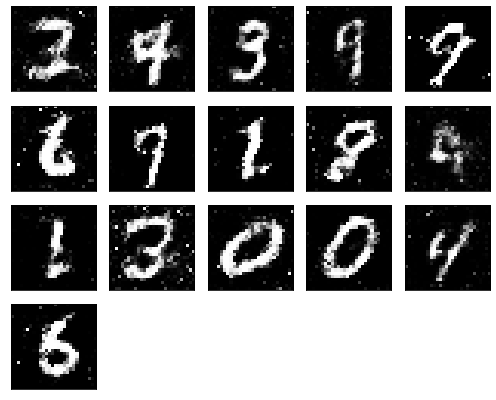

Epochs nb. 6161
discriminator loss: 0.6398035287857056
generator loss : 1.3254592418670654

Epochs nb. 6162
discriminator loss: 0.539342999458313
generator loss : 1.0235278606414795

Epochs nb. 6163
discriminator loss: 0.6262603402137756
generator loss : 0.972512423992157

Epochs nb. 6164
discriminator loss: 0.6678196787834167
generator loss : 0.841461181640625

Epochs nb. 6165
discriminator loss: 0.62706458568573
generator loss : 0.9927690625190735

Epochs nb. 6166
discriminator loss: 0.674426257610321
generator loss : 0.8895411491394043

Epochs nb. 6167
discriminator loss: 0.6505584716796875
generator loss : 1.215331792831421

Epochs nb. 6168
discriminator loss: 0.643004834651947
generator loss : 1.2377641201019287

Epochs nb. 6169
discriminator loss: 0.5482587814331055
generator loss : 1.0731325149536133

Epochs nb. 6170
discriminator loss: 0.643288254737854
generator loss : 1.176804542541504



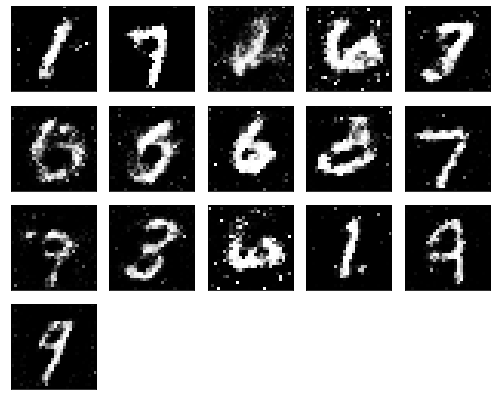

Epochs nb. 6171
discriminator loss: 0.5689574480056763
generator loss : 0.9875215291976929

Epochs nb. 6172
discriminator loss: 0.6207059621810913
generator loss : 1.10128653049469

Epochs nb. 6173
discriminator loss: 0.5736432671546936
generator loss : 0.9335431456565857

Epochs nb. 6174
discriminator loss: 0.7989036440849304
generator loss : 1.0314878225326538

Epochs nb. 6175
discriminator loss: 0.5864585638046265
generator loss : 0.987738847732544

Epochs nb. 6176
discriminator loss: 0.43492591381073
generator loss : 0.9418960809707642

Epochs nb. 6177
discriminator loss: 0.5944724082946777
generator loss : 0.9636039137840271

Epochs nb. 6178
discriminator loss: 0.6063445806503296
generator loss : 1.0053621530532837

Epochs nb. 6179
discriminator loss: 0.5825968980789185
generator loss : 1.0127888917922974

Epochs nb. 6180
discriminator loss: 0.588618278503418
generator loss : 0.9571636319160461



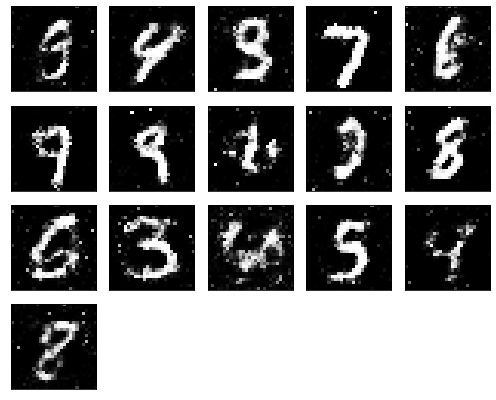

Epochs nb. 6181
discriminator loss: 0.6787503957748413
generator loss : 0.9497412443161011

Epochs nb. 6182
discriminator loss: 0.6157091856002808
generator loss : 1.0496798753738403

Epochs nb. 6183
discriminator loss: 0.6060291528701782
generator loss : 0.9980748891830444

Epochs nb. 6184
discriminator loss: 0.7661839723587036
generator loss : 1.0687652826309204

Epochs nb. 6185
discriminator loss: 0.5050830841064453
generator loss : 1.0727519989013672

Epochs nb. 6186
discriminator loss: 0.5104631185531616
generator loss : 0.9053452014923096

Epochs nb. 6187
discriminator loss: 0.6035590171813965
generator loss : 1.002223014831543

Epochs nb. 6188
discriminator loss: 0.5614006519317627
generator loss : 1.1086392402648926

Epochs nb. 6189
discriminator loss: 0.5606489181518555
generator loss : 0.8778018355369568

Epochs nb. 6190
discriminator loss: 0.6923732161521912
generator loss : 1.013796329498291



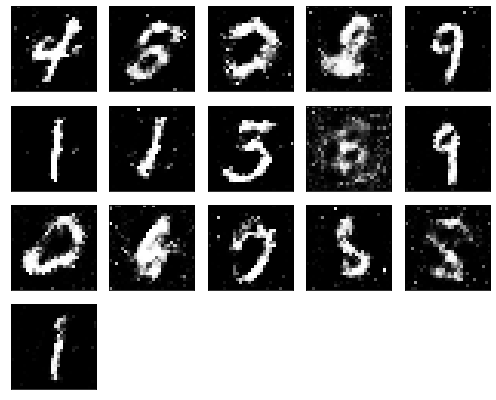

Epochs nb. 6191
discriminator loss: 0.6428284645080566
generator loss : 0.9999993443489075

Epochs nb. 6192
discriminator loss: 0.566473126411438
generator loss : 0.9406958818435669

Epochs nb. 6193
discriminator loss: 0.7813155055046082
generator loss : 0.831424355506897

Epochs nb. 6194
discriminator loss: 0.5354694128036499
generator loss : 1.040641188621521

Epochs nb. 6195
discriminator loss: 0.6172325611114502
generator loss : 1.016528606414795

Epochs nb. 6196
discriminator loss: 0.6529015302658081
generator loss : 0.9786638617515564

Epochs nb. 6197
discriminator loss: 0.560009241104126
generator loss : 1.0590128898620605

Epochs nb. 6198
discriminator loss: 0.8074573278427124
generator loss : 0.7608691453933716

Epochs nb. 6199
discriminator loss: 0.5462193489074707
generator loss : 0.9987789988517761

Epochs nb. 6200
discriminator loss: 0.6596797108650208
generator loss : 1.136005163192749



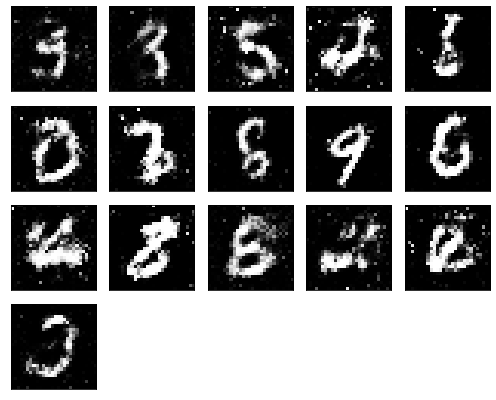

Epochs nb. 6201
discriminator loss: 0.5961217880249023
generator loss : 0.883102297782898

Epochs nb. 6202
discriminator loss: 0.5578387975692749
generator loss : 0.9022961854934692

Epochs nb. 6203
discriminator loss: 0.6427465677261353
generator loss : 1.078559398651123

Epochs nb. 6204
discriminator loss: 0.5774893760681152
generator loss : 0.9656879305839539

Epochs nb. 6205
discriminator loss: 0.6392346024513245
generator loss : 0.9301105737686157

Epochs nb. 6206
discriminator loss: 0.7513043880462646
generator loss : 1.1406285762786865

Epochs nb. 6207
discriminator loss: 0.6596459150314331
generator loss : 0.9557198286056519

Epochs nb. 6208
discriminator loss: 0.6239662170410156
generator loss : 1.018143653869629

Epochs nb. 6209
discriminator loss: 0.6896265149116516
generator loss : 1.0120713710784912

Epochs nb. 6210
discriminator loss: 0.5925424098968506
generator loss : 1.1849229335784912



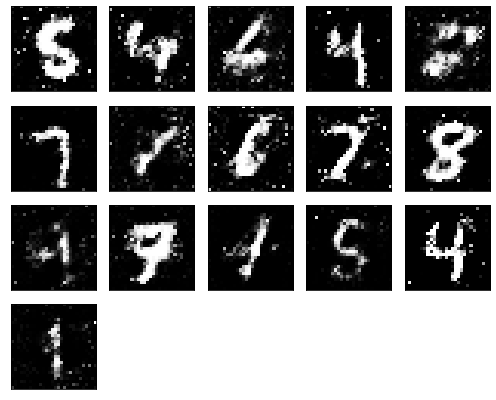

Epochs nb. 6211
discriminator loss: 0.5771100521087646
generator loss : 0.9575551748275757

Epochs nb. 6212
discriminator loss: 0.7336133718490601
generator loss : 1.0571844577789307

Epochs nb. 6213
discriminator loss: 0.5488083958625793
generator loss : 1.0156259536743164

Epochs nb. 6214
discriminator loss: 0.6066717505455017
generator loss : 1.0254771709442139

Epochs nb. 6215
discriminator loss: 0.6281924247741699
generator loss : 1.0085656642913818

Epochs nb. 6216
discriminator loss: 0.560793936252594
generator loss : 1.0868252515792847

Epochs nb. 6217
discriminator loss: 0.670234203338623
generator loss : 0.8678516149520874

Epochs nb. 6218
discriminator loss: 0.6661981344223022
generator loss : 1.1222007274627686

Epochs nb. 6219
discriminator loss: 0.7188035845756531
generator loss : 0.9879275560379028

Epochs nb. 6220
discriminator loss: 0.6567801833152771
generator loss : 0.9954097270965576



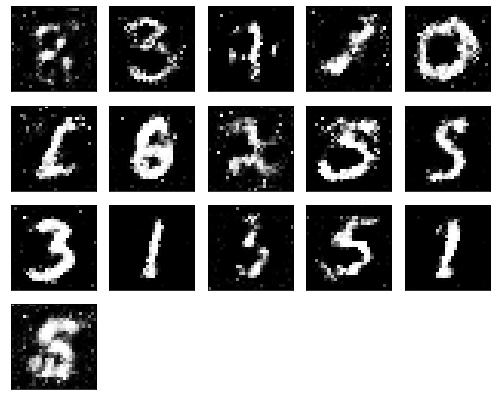

Epochs nb. 6221
discriminator loss: 0.6553528308868408
generator loss : 0.8433393836021423

Epochs nb. 6222
discriminator loss: 0.6331324577331543
generator loss : 0.7480522394180298

Epochs nb. 6223
discriminator loss: 0.6753606796264648
generator loss : 0.8651973009109497

Epochs nb. 6224
discriminator loss: 0.5098416805267334
generator loss : 0.8612815141677856

Epochs nb. 6225
discriminator loss: 0.7154105305671692
generator loss : 0.9725556373596191

Epochs nb. 6226
discriminator loss: 0.5908190011978149
generator loss : 1.0479369163513184

Epochs nb. 6227
discriminator loss: 0.6300215721130371
generator loss : 0.974784255027771

Epochs nb. 6228
discriminator loss: 0.6056177020072937
generator loss : 0.9252510666847229

Epochs nb. 6229
discriminator loss: 0.7194569110870361
generator loss : 0.9279072284698486

Epochs nb. 6230
discriminator loss: 0.5801144242286682
generator loss : 1.1307116746902466



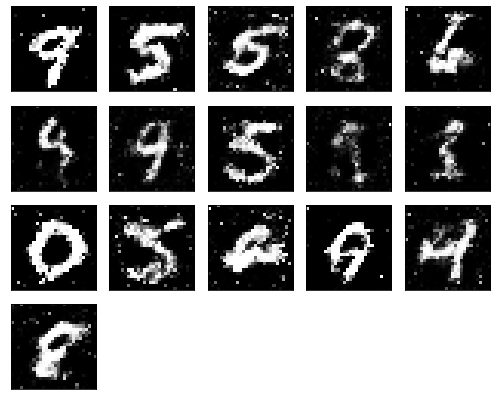

Epochs nb. 6231
discriminator loss: 0.605136513710022
generator loss : 0.9634276628494263

Epochs nb. 6232
discriminator loss: 0.5083001852035522
generator loss : 1.038827657699585

Epochs nb. 6233
discriminator loss: 0.5250873565673828
generator loss : 0.95293790102005

Epochs nb. 6234
discriminator loss: 0.5582848787307739
generator loss : 1.0207207202911377

Epochs nb. 6235
discriminator loss: 0.5287473201751709
generator loss : 1.0251200199127197

Epochs nb. 6236
discriminator loss: 0.5876275300979614
generator loss : 0.836029589176178

Epochs nb. 6237
discriminator loss: 0.49181824922561646
generator loss : 0.9250622391700745

Epochs nb. 6238
discriminator loss: 0.5870962738990784
generator loss : 0.9219257831573486

Epochs nb. 6239
discriminator loss: 0.5683996081352234
generator loss : 0.9242100715637207

Epochs nb. 6240
discriminator loss: 0.4829972982406616
generator loss : 0.8944141864776611



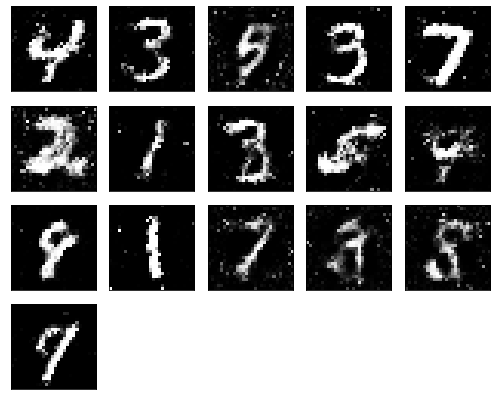

Epochs nb. 6241
discriminator loss: 0.8124681711196899
generator loss : 0.903739869594574

Epochs nb. 6242
discriminator loss: 0.5394946932792664
generator loss : 0.947350025177002

Epochs nb. 6243
discriminator loss: 0.6738511919975281
generator loss : 0.9099317789077759

Epochs nb. 6244
discriminator loss: 0.7015367746353149
generator loss : 0.9947224259376526

Epochs nb. 6245
discriminator loss: 0.7221581935882568
generator loss : 1.0239641666412354

Epochs nb. 6246
discriminator loss: 0.5729883909225464
generator loss : 0.9757716655731201

Epochs nb. 6247
discriminator loss: 0.7046990990638733
generator loss : 0.8444434404373169

Epochs nb. 6248
discriminator loss: 0.6600457429885864
generator loss : 0.9496463537216187

Epochs nb. 6249
discriminator loss: 0.6307054758071899
generator loss : 0.9775485992431641

Epochs nb. 6250
discriminator loss: 0.6116011142730713
generator loss : 1.021040678024292



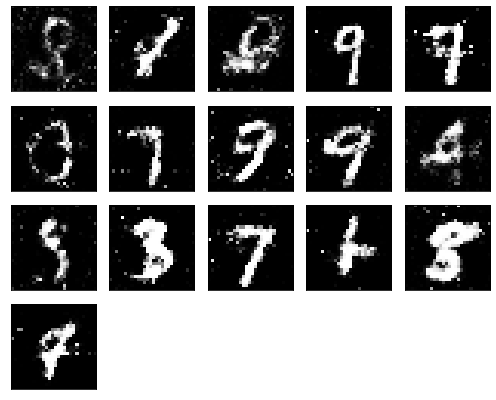

Epochs nb. 6251
discriminator loss: 0.551516592502594
generator loss : 1.0167853832244873

Epochs nb. 6252
discriminator loss: 0.6534340381622314
generator loss : 0.9772636890411377

Epochs nb. 6253
discriminator loss: 0.5969946384429932
generator loss : 1.0316367149353027

Epochs nb. 6254
discriminator loss: 0.539431095123291
generator loss : 1.1603269577026367

Epochs nb. 6255
discriminator loss: 0.661480724811554
generator loss : 0.9752103090286255

Epochs nb. 6256
discriminator loss: 0.5774432420730591
generator loss : 0.910165548324585

Epochs nb. 6257
discriminator loss: 0.6225345134735107
generator loss : 1.0608831644058228

Epochs nb. 6258
discriminator loss: 0.5649215579032898
generator loss : 1.1181066036224365

Epochs nb. 6259
discriminator loss: 0.7483353614807129
generator loss : 0.9863618016242981

Epochs nb. 6260
discriminator loss: 0.6377502083778381
generator loss : 0.8370938301086426



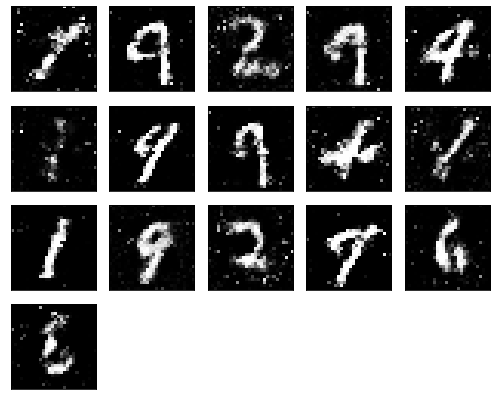

Epochs nb. 6261
discriminator loss: 0.6487642526626587
generator loss : 0.9711334705352783

Epochs nb. 6262
discriminator loss: 0.6929965019226074
generator loss : 0.9228863716125488

Epochs nb. 6263
discriminator loss: 0.6333380937576294
generator loss : 0.9986824989318848

Epochs nb. 6264
discriminator loss: 0.542296826839447
generator loss : 0.9006236791610718

Epochs nb. 6265
discriminator loss: 0.4964594542980194
generator loss : 1.0508582592010498

Epochs nb. 6266
discriminator loss: 0.5655026435852051
generator loss : 1.2501652240753174

Epochs nb. 6267
discriminator loss: 0.5791488289833069
generator loss : 0.963584840297699

Epochs nb. 6268
discriminator loss: 0.54612135887146
generator loss : 0.9261834025382996

Epochs nb. 6269
discriminator loss: 0.610765814781189
generator loss : 0.9803852438926697

Epochs nb. 6270
discriminator loss: 0.5960251092910767
generator loss : 0.7294597029685974



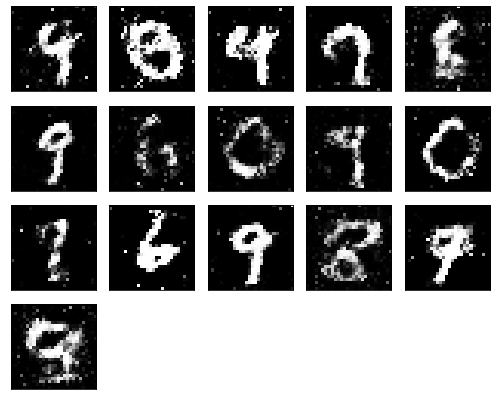

Epochs nb. 6271
discriminator loss: 0.5866906642913818
generator loss : 0.898032546043396

Epochs nb. 6272
discriminator loss: 0.5534469485282898
generator loss : 1.155092716217041

Epochs nb. 6273
discriminator loss: 0.6819808483123779
generator loss : 1.073876142501831

Epochs nb. 6274
discriminator loss: 0.561920166015625
generator loss : 0.9929307103157043

Epochs nb. 6275
discriminator loss: 0.5660474896430969
generator loss : 0.9856486320495605

Epochs nb. 6276
discriminator loss: 0.6627105474472046
generator loss : 0.8935027718544006

Epochs nb. 6277
discriminator loss: 0.5349668264389038
generator loss : 0.9968781471252441

Epochs nb. 6278
discriminator loss: 0.6579458713531494
generator loss : 0.9995165467262268

Epochs nb. 6279
discriminator loss: 0.5468608140945435
generator loss : 1.0135712623596191

Epochs nb. 6280
discriminator loss: 0.6691421270370483
generator loss : 1.0806361436843872



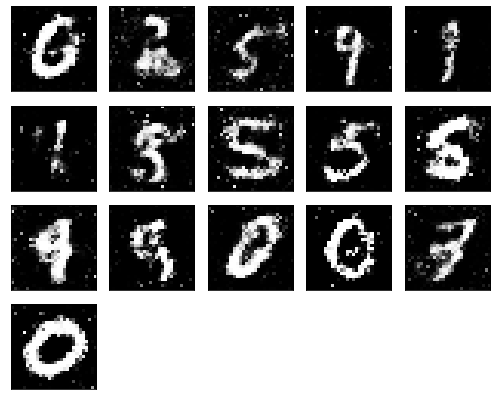

Epochs nb. 6281
discriminator loss: 0.5542715787887573
generator loss : 0.9194259643554688

Epochs nb. 6282
discriminator loss: 0.4885816276073456
generator loss : 0.8032142519950867

Epochs nb. 6283
discriminator loss: 0.5817773342132568
generator loss : 0.951937735080719

Epochs nb. 6284
discriminator loss: 0.5133529901504517
generator loss : 0.9232128262519836

Epochs nb. 6285
discriminator loss: 0.6238155364990234
generator loss : 0.9761546850204468

Epochs nb. 6286
discriminator loss: 0.6682692170143127
generator loss : 0.996644139289856

Epochs nb. 6287
discriminator loss: 0.5515955090522766
generator loss : 0.8784799575805664

Epochs nb. 6288
discriminator loss: 0.5197004079818726
generator loss : 1.0477111339569092

Epochs nb. 6289
discriminator loss: 0.6561740040779114
generator loss : 0.8883111476898193

Epochs nb. 6290
discriminator loss: 0.5566045045852661
generator loss : 0.876354455947876



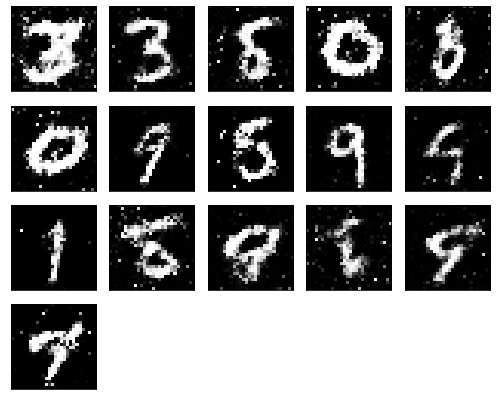

Epochs nb. 6291
discriminator loss: 0.5524513721466064
generator loss : 0.9147323369979858

Epochs nb. 6292
discriminator loss: 0.655614972114563
generator loss : 0.9745357036590576

Epochs nb. 6293
discriminator loss: 0.7130199670791626
generator loss : 0.933444619178772

Epochs nb. 6294
discriminator loss: 0.5773864984512329
generator loss : 0.8631948828697205

Epochs nb. 6295
discriminator loss: 0.6048875451087952
generator loss : 0.7486380934715271

Epochs nb. 6296
discriminator loss: 0.5015838146209717
generator loss : 0.9284353256225586

Epochs nb. 6297
discriminator loss: 0.589580774307251
generator loss : 1.0803790092468262

Epochs nb. 6298
discriminator loss: 0.6045974493026733
generator loss : 1.0300891399383545

Epochs nb. 6299
discriminator loss: 0.6833213567733765
generator loss : 1.182999849319458

Epochs nb. 6300
discriminator loss: 0.47054749727249146
generator loss : 0.9764418601989746



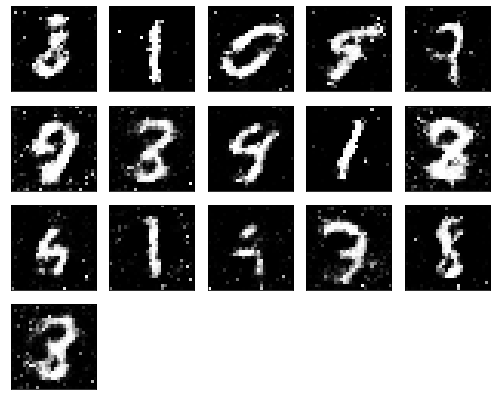

Epochs nb. 6301
discriminator loss: 0.6849262714385986
generator loss : 0.982190728187561

Epochs nb. 6302
discriminator loss: 0.5582915544509888
generator loss : 0.9669981002807617

Epochs nb. 6303
discriminator loss: 0.5166420936584473
generator loss : 0.9737479090690613

Epochs nb. 6304
discriminator loss: 0.6282351016998291
generator loss : 0.9660179018974304

Epochs nb. 6305
discriminator loss: 0.5079027414321899
generator loss : 0.9252938628196716

Epochs nb. 6306
discriminator loss: 0.5738461017608643
generator loss : 0.9449182748794556

Epochs nb. 6307
discriminator loss: 0.611413836479187
generator loss : 0.7448533177375793

Epochs nb. 6308
discriminator loss: 0.6918595433235168
generator loss : 0.9677847623825073

Epochs nb. 6309
discriminator loss: 0.660091757774353
generator loss : 0.9215380549430847

Epochs nb. 6310
discriminator loss: 0.6624914407730103
generator loss : 0.8456122875213623



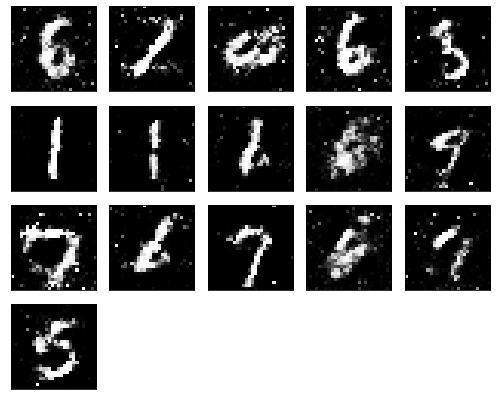

Epochs nb. 6311
discriminator loss: 0.705808162689209
generator loss : 0.9085907936096191

Epochs nb. 6312
discriminator loss: 0.6783655881881714
generator loss : 0.9748489260673523

Epochs nb. 6313
discriminator loss: 0.58580482006073
generator loss : 0.9053447842597961

Epochs nb. 6314
discriminator loss: 0.6811577677726746
generator loss : 0.8666878342628479

Epochs nb. 6315
discriminator loss: 0.5942577719688416
generator loss : 0.9449598789215088

Epochs nb. 6316
discriminator loss: 0.6541861295700073
generator loss : 0.9136828184127808

Epochs nb. 6317
discriminator loss: 0.5491307377815247
generator loss : 0.951002836227417

Epochs nb. 6318
discriminator loss: 0.6679834127426147
generator loss : 1.0035871267318726

Epochs nb. 6319
discriminator loss: 0.477200448513031
generator loss : 1.044572114944458

Epochs nb. 6320
discriminator loss: 0.6158470511436462
generator loss : 1.1283419132232666



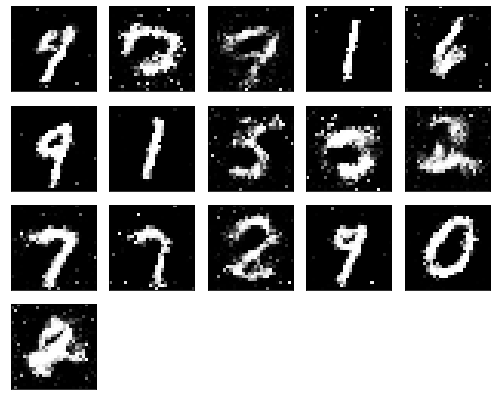

Epochs nb. 6321
discriminator loss: 0.6037811636924744
generator loss : 1.0120539665222168

Epochs nb. 6322
discriminator loss: 0.5174425840377808
generator loss : 0.9223507642745972

Epochs nb. 6323
discriminator loss: 0.678379476070404
generator loss : 0.9208450317382812

Epochs nb. 6324
discriminator loss: 0.44517332315444946
generator loss : 0.8469426035881042

Epochs nb. 6325
discriminator loss: 0.6864784359931946
generator loss : 0.8638192415237427

Epochs nb. 6326
discriminator loss: 0.559517502784729
generator loss : 0.9067909717559814

Epochs nb. 6327
discriminator loss: 0.504798948764801
generator loss : 0.9454331398010254

Epochs nb. 6328
discriminator loss: 0.6418343782424927
generator loss : 1.0687669515609741

Epochs nb. 6329
discriminator loss: 0.5278033018112183
generator loss : 0.922297477722168

Epochs nb. 6330
discriminator loss: 0.6249268651008606
generator loss : 0.9340416789054871



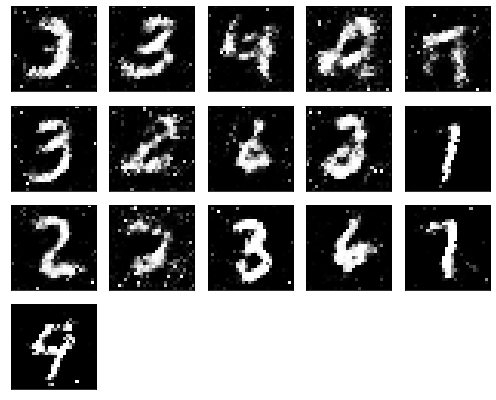

Epochs nb. 6331
discriminator loss: 0.7302187085151672
generator loss : 1.0094108581542969

Epochs nb. 6332
discriminator loss: 0.5318962931632996
generator loss : 0.9555622339248657

Epochs nb. 6333
discriminator loss: 0.6687058806419373
generator loss : 1.0708951950073242

Epochs nb. 6334
discriminator loss: 0.5447067022323608
generator loss : 1.0336486101150513

Epochs nb. 6335
discriminator loss: 0.5217344760894775
generator loss : 1.0686148405075073

Epochs nb. 6336
discriminator loss: 0.4731576442718506
generator loss : 0.9642527103424072

Epochs nb. 6337
discriminator loss: 0.6291490793228149
generator loss : 1.066282033920288

Epochs nb. 6338
discriminator loss: 0.6364797353744507
generator loss : 0.9875321388244629

Epochs nb. 6339
discriminator loss: 0.560996949672699
generator loss : 0.8149780035018921

Epochs nb. 6340
discriminator loss: 0.5007453560829163
generator loss : 0.7997089624404907



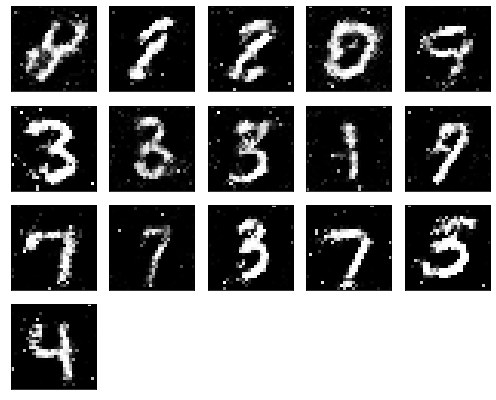

Epochs nb. 6341
discriminator loss: 0.6524856090545654
generator loss : 0.8662005662918091

Epochs nb. 6342
discriminator loss: 0.5966597199440002
generator loss : 0.9493497610092163

Epochs nb. 6343
discriminator loss: 0.6114366054534912
generator loss : 0.8639305830001831

Epochs nb. 6344
discriminator loss: 0.6127286553382874
generator loss : 0.9755070209503174

Epochs nb. 6345
discriminator loss: 0.6046680808067322
generator loss : 0.8036714792251587

Epochs nb. 6346
discriminator loss: 0.5621153712272644
generator loss : 0.902721107006073

Epochs nb. 6347
discriminator loss: 0.5557956099510193
generator loss : 0.8996455669403076

Epochs nb. 6348
discriminator loss: 0.5651940107345581
generator loss : 0.9037358164787292

Epochs nb. 6349
discriminator loss: 0.48283037543296814
generator loss : 1.0480172634124756

Epochs nb. 6350
discriminator loss: 0.6007129549980164
generator loss : 1.2632335424423218



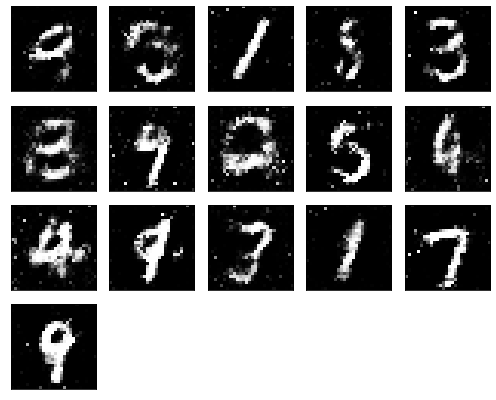

Epochs nb. 6351
discriminator loss: 0.564675509929657
generator loss : 1.0153353214263916

Epochs nb. 6352
discriminator loss: 0.6581835150718689
generator loss : 1.0555813312530518

Epochs nb. 6353
discriminator loss: 0.6795552968978882
generator loss : 0.9923954010009766

Epochs nb. 6354
discriminator loss: 0.5386089086532593
generator loss : 1.1161203384399414

Epochs nb. 6355
discriminator loss: 0.6047988533973694
generator loss : 0.9625416398048401

Epochs nb. 6356
discriminator loss: 0.49373966455459595
generator loss : 0.9396439790725708

Epochs nb. 6357
discriminator loss: 0.5637049674987793
generator loss : 1.0333577394485474

Epochs nb. 6358
discriminator loss: 0.46586310863494873
generator loss : 0.9563605189323425

Epochs nb. 6359
discriminator loss: 0.5799219608306885
generator loss : 1.0213429927825928

Epochs nb. 6360
discriminator loss: 0.8069354295730591
generator loss : 1.0759692192077637



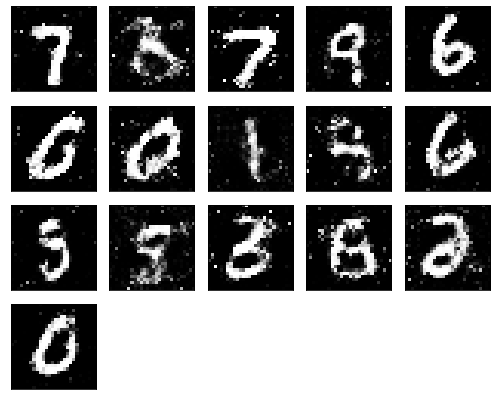

Epochs nb. 6361
discriminator loss: 0.6503335237503052
generator loss : 1.0413050651550293

Epochs nb. 6362
discriminator loss: 0.5193007588386536
generator loss : 1.0365533828735352

Epochs nb. 6363
discriminator loss: 0.662807047367096
generator loss : 1.010887861251831

Epochs nb. 6364
discriminator loss: 0.5628049373626709
generator loss : 0.8341517448425293

Epochs nb. 6365
discriminator loss: 0.5257289409637451
generator loss : 0.9537907242774963

Epochs nb. 6366
discriminator loss: 0.5875811576843262
generator loss : 0.8770544528961182

Epochs nb. 6367
discriminator loss: 0.6527308821678162
generator loss : 0.9448139667510986

Epochs nb. 6368
discriminator loss: 0.6932991147041321
generator loss : 0.9362013339996338

Epochs nb. 6369
discriminator loss: 0.5526183843612671
generator loss : 0.8600115776062012

Epochs nb. 6370
discriminator loss: 0.5921468734741211
generator loss : 0.921946108341217



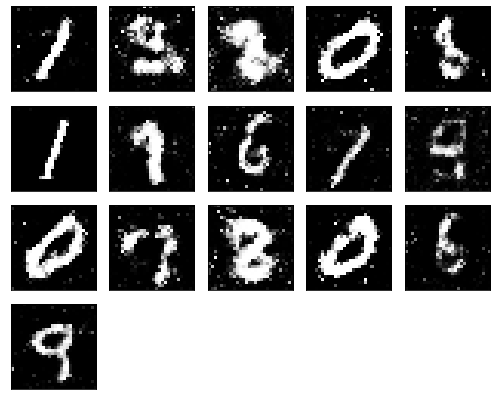

Epochs nb. 6371
discriminator loss: 0.4686735272407532
generator loss : 0.7164141535758972

Epochs nb. 6372
discriminator loss: 0.6219568848609924
generator loss : 0.822074294090271

Epochs nb. 6373
discriminator loss: 0.5350731015205383
generator loss : 0.9487749934196472

Epochs nb. 6374
discriminator loss: 0.64023756980896
generator loss : 0.979291558265686

Epochs nb. 6375
discriminator loss: 0.4089495539665222
generator loss : 1.2035179138183594

Epochs nb. 6376
discriminator loss: 0.6857141256332397
generator loss : 0.945184588432312

Epochs nb. 6377
discriminator loss: 0.5098466873168945
generator loss : 1.0718815326690674

Epochs nb. 6378
discriminator loss: 0.5249780416488647
generator loss : 0.9363517761230469

Epochs nb. 6379
discriminator loss: 0.5549920797348022
generator loss : 1.0158482789993286

Epochs nb. 6380
discriminator loss: 0.6892155408859253
generator loss : 0.8499441146850586



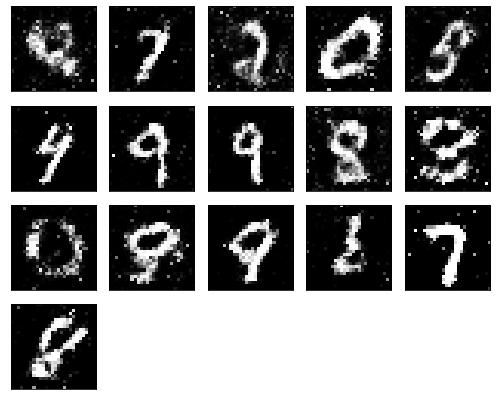

Epochs nb. 6381
discriminator loss: 0.594165563583374
generator loss : 1.0676811933517456

Epochs nb. 6382
discriminator loss: 0.5927486419677734
generator loss : 0.9257749319076538

Epochs nb. 6383
discriminator loss: 0.5833353996276855
generator loss : 0.8955652713775635

Epochs nb. 6384
discriminator loss: 0.6412321925163269
generator loss : 1.1265099048614502

Epochs nb. 6385
discriminator loss: 0.5338602066040039
generator loss : 0.9331504106521606

Epochs nb. 6386
discriminator loss: 0.6506772637367249
generator loss : 0.9050682783126831

Epochs nb. 6387
discriminator loss: 0.5012792348861694
generator loss : 0.9460417032241821

Epochs nb. 6388
discriminator loss: 0.6083197593688965
generator loss : 0.7933266162872314

Epochs nb. 6389
discriminator loss: 0.6773257255554199
generator loss : 1.0023107528686523

Epochs nb. 6390
discriminator loss: 0.7930483818054199
generator loss : 1.0384397506713867



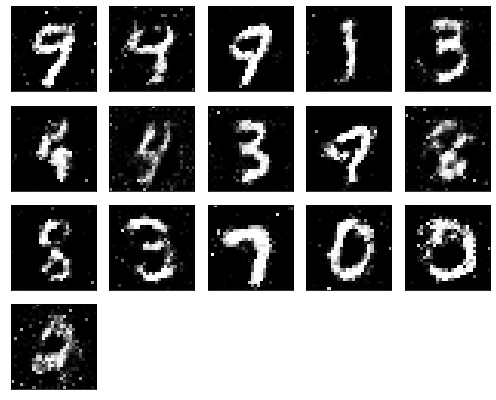

Epochs nb. 6391
discriminator loss: 0.608284592628479
generator loss : 0.8623982071876526

Epochs nb. 6392
discriminator loss: 0.5334675908088684
generator loss : 1.0429184436798096

Epochs nb. 6393
discriminator loss: 0.6315163373947144
generator loss : 0.7576070427894592

Epochs nb. 6394
discriminator loss: 0.47631824016571045
generator loss : 1.152182698249817

Epochs nb. 6395
discriminator loss: 0.5682555437088013
generator loss : 0.9815370440483093

Epochs nb. 6396
discriminator loss: 0.6309154629707336
generator loss : 0.930037796497345

Epochs nb. 6397
discriminator loss: 0.650415301322937
generator loss : 1.1365782022476196

Epochs nb. 6398
discriminator loss: 0.6822763681411743
generator loss : 1.039027452468872

Epochs nb. 6399
discriminator loss: 0.6093619465827942
generator loss : 0.8328176736831665

Epochs nb. 6400
discriminator loss: 0.5581779479980469
generator loss : 0.919838011264801



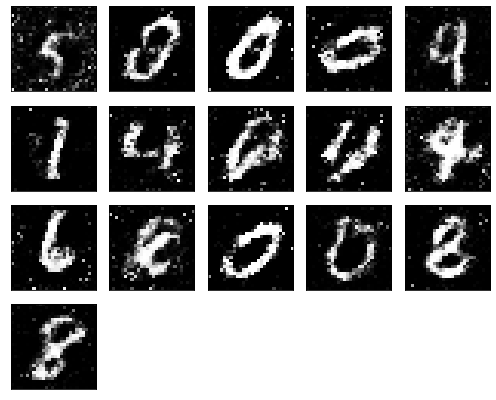

Epochs nb. 6401
discriminator loss: 0.6375283002853394
generator loss : 1.0359137058258057

Epochs nb. 6402
discriminator loss: 0.5653765201568604
generator loss : 0.8785603046417236

Epochs nb. 6403
discriminator loss: 0.5531471967697144
generator loss : 1.043404221534729

Epochs nb. 6404
discriminator loss: 0.717419445514679
generator loss : 0.9731212854385376

Epochs nb. 6405
discriminator loss: 0.6755333542823792
generator loss : 1.0687806606292725

Epochs nb. 6406
discriminator loss: 0.5494855642318726
generator loss : 1.0281912088394165

Epochs nb. 6407
discriminator loss: 0.4928581416606903
generator loss : 1.112459659576416

Epochs nb. 6408
discriminator loss: 0.590140163898468
generator loss : 1.0779147148132324

Epochs nb. 6409
discriminator loss: 0.5523041486740112
generator loss : 0.8803805112838745

Epochs nb. 6410
discriminator loss: 0.6514991521835327
generator loss : 1.0014572143554688



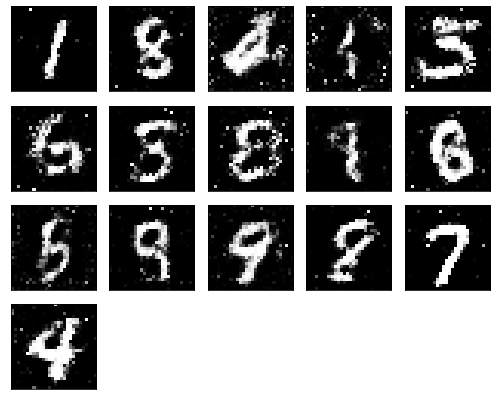

Epochs nb. 6411
discriminator loss: 0.6272681951522827
generator loss : 1.0556414127349854

Epochs nb. 6412
discriminator loss: 0.5915553569793701
generator loss : 0.8524510860443115

Epochs nb. 6413
discriminator loss: 0.5840716361999512
generator loss : 0.9709075093269348

Epochs nb. 6414
discriminator loss: 0.5941135287284851
generator loss : 1.1342459917068481

Epochs nb. 6415
discriminator loss: 0.7059709429740906
generator loss : 1.0799448490142822

Epochs nb. 6416
discriminator loss: 0.6265033483505249
generator loss : 0.9881929159164429

Epochs nb. 6417
discriminator loss: 0.5809850692749023
generator loss : 0.9256312847137451

Epochs nb. 6418
discriminator loss: 0.6020076274871826
generator loss : 0.9118605852127075

Epochs nb. 6419
discriminator loss: 0.5070368051528931
generator loss : 0.9646929502487183

Epochs nb. 6420
discriminator loss: 0.7210787534713745
generator loss : 1.1450490951538086



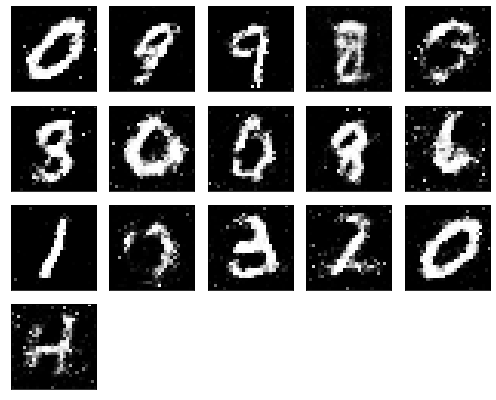

Epochs nb. 6421
discriminator loss: 0.5517433881759644
generator loss : 1.0107898712158203

Epochs nb. 6422
discriminator loss: 0.529472291469574
generator loss : 1.1169133186340332

Epochs nb. 6423
discriminator loss: 0.559644341468811
generator loss : 1.0316587686538696

Epochs nb. 6424
discriminator loss: 0.7312209606170654
generator loss : 0.9968615174293518

Epochs nb. 6425
discriminator loss: 0.6003230810165405
generator loss : 1.0103307962417603

Epochs nb. 6426
discriminator loss: 0.7500113248825073
generator loss : 0.9086681604385376

Epochs nb. 6427
discriminator loss: 0.6113809943199158
generator loss : 0.8113011121749878

Epochs nb. 6428
discriminator loss: 0.672317385673523
generator loss : 1.0794568061828613

Epochs nb. 6429
discriminator loss: 0.5525748133659363
generator loss : 1.2065773010253906

Epochs nb. 6430
discriminator loss: 0.6044914126396179
generator loss : 1.0693385601043701



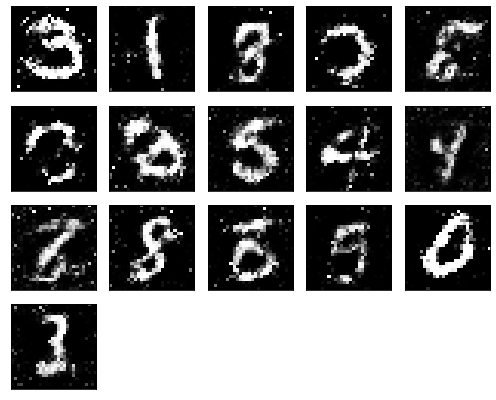

Epochs nb. 6431
discriminator loss: 0.641497015953064
generator loss : 0.9933868646621704

Epochs nb. 6432
discriminator loss: 0.5934194326400757
generator loss : 1.0201855897903442

Epochs nb. 6433
discriminator loss: 0.6786907911300659
generator loss : 1.10636305809021

Epochs nb. 6434
discriminator loss: 0.6262280941009521
generator loss : 0.9307804703712463

Epochs nb. 6435
discriminator loss: 0.7340819239616394
generator loss : 0.979661226272583

Epochs nb. 6436
discriminator loss: 0.7129669785499573
generator loss : 0.9683152437210083

Epochs nb. 6437
discriminator loss: 0.4967392086982727
generator loss : 0.9659109115600586

Epochs nb. 6438
discriminator loss: 0.6255643963813782
generator loss : 0.9446026682853699

Epochs nb. 6439
discriminator loss: 0.6492719650268555
generator loss : 0.9787049293518066

Epochs nb. 6440
discriminator loss: 0.5469955801963806
generator loss : 0.948948323726654



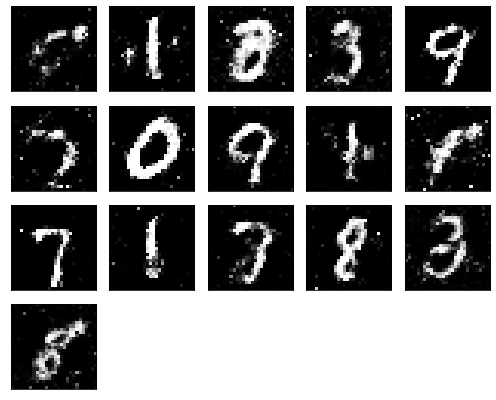

Epochs nb. 6441
discriminator loss: 0.5495668649673462
generator loss : 0.9545138478279114

Epochs nb. 6442
discriminator loss: 0.6944465041160583
generator loss : 0.971990704536438

Epochs nb. 6443
discriminator loss: 0.5602908134460449
generator loss : 1.0125304460525513

Epochs nb. 6444
discriminator loss: 0.5373319387435913
generator loss : 1.0116645097732544

Epochs nb. 6445
discriminator loss: 0.5091535449028015
generator loss : 1.080636978149414

Epochs nb. 6446
discriminator loss: 0.5345474481582642
generator loss : 1.1008117198944092

Epochs nb. 6447
discriminator loss: 0.6438640356063843
generator loss : 1.0689678192138672

Epochs nb. 6448
discriminator loss: 0.6113859415054321
generator loss : 0.9255526661872864

Epochs nb. 6449
discriminator loss: 0.5196840167045593
generator loss : 0.9017458558082581

Epochs nb. 6450
discriminator loss: 0.6035184264183044
generator loss : 0.954566478729248



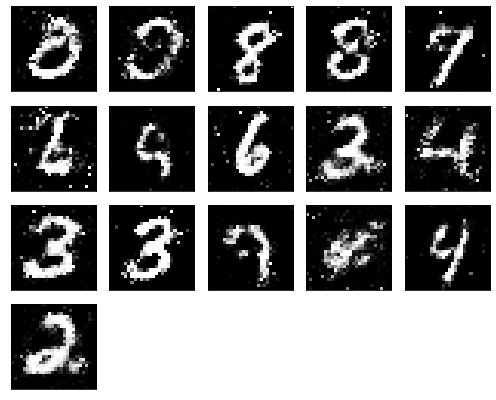

Epochs nb. 6451
discriminator loss: 0.6147269010543823
generator loss : 0.9376174211502075

Epochs nb. 6452
discriminator loss: 0.49418506026268005
generator loss : 1.0667320489883423

Epochs nb. 6453
discriminator loss: 0.5518451929092407
generator loss : 0.9057571887969971

Epochs nb. 6454
discriminator loss: 0.7391043901443481
generator loss : 0.8545408248901367

Epochs nb. 6455
discriminator loss: 0.6194425821304321
generator loss : 0.8245665431022644

Epochs nb. 6456
discriminator loss: 0.5512846112251282
generator loss : 1.0113036632537842

Epochs nb. 6457
discriminator loss: 0.5445808172225952
generator loss : 1.0327184200286865

Epochs nb. 6458
discriminator loss: 0.5702812671661377
generator loss : 1.176845669746399

Epochs nb. 6459
discriminator loss: 0.5686140060424805
generator loss : 0.934203565120697

Epochs nb. 6460
discriminator loss: 0.4992980659008026
generator loss : 0.9122120141983032



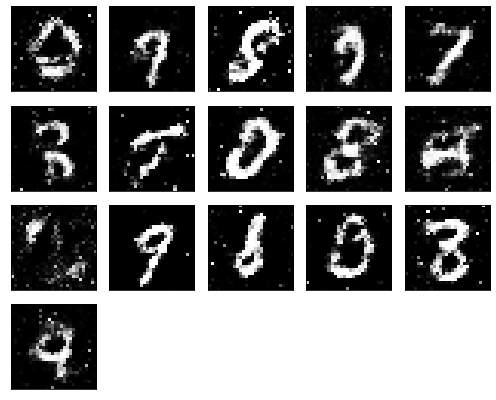

Epochs nb. 6461
discriminator loss: 0.6519824862480164
generator loss : 1.0273246765136719

Epochs nb. 6462
discriminator loss: 0.5681945085525513
generator loss : 1.0449776649475098

Epochs nb. 6463
discriminator loss: 0.59844970703125
generator loss : 0.9136868715286255

Epochs nb. 6464
discriminator loss: 0.6043232083320618
generator loss : 0.8705023527145386

Epochs nb. 6465
discriminator loss: 0.5459738969802856
generator loss : 0.8532799482345581

Epochs nb. 6466
discriminator loss: 0.4857388138771057
generator loss : 1.0362558364868164

Epochs nb. 6467
discriminator loss: 0.6508556604385376
generator loss : 1.0048117637634277

Epochs nb. 6468
discriminator loss: 0.5656682252883911
generator loss : 0.9793543219566345

Epochs nb. 6469
discriminator loss: 0.6648991107940674
generator loss : 0.9575997591018677

Epochs nb. 6470
discriminator loss: 0.6852104663848877
generator loss : 0.8525960445404053



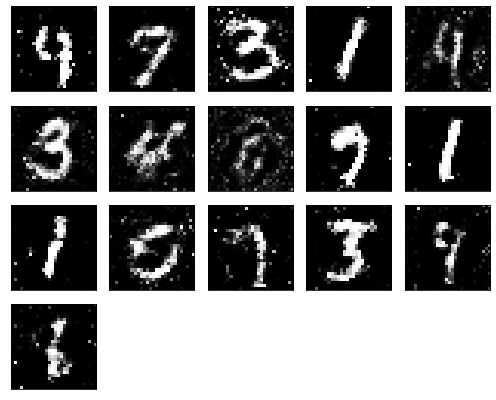

Epochs nb. 6471
discriminator loss: 0.5525225400924683
generator loss : 0.7826284170150757

Epochs nb. 6472
discriminator loss: 0.5863136053085327
generator loss : 0.7677143216133118

Epochs nb. 6473
discriminator loss: 0.5670218467712402
generator loss : 0.8964132070541382

Epochs nb. 6474
discriminator loss: 0.5656133890151978
generator loss : 0.751937985420227

Epochs nb. 6475
discriminator loss: 0.5310834646224976
generator loss : 1.011650562286377

Epochs nb. 6476
discriminator loss: 0.5379066467285156
generator loss : 0.7796580791473389

Epochs nb. 6477
discriminator loss: 0.5473592281341553
generator loss : 0.904000997543335

Epochs nb. 6478
discriminator loss: 0.5846725702285767
generator loss : 0.8692378997802734

Epochs nb. 6479
discriminator loss: 0.5412217378616333
generator loss : 0.8342868685722351

Epochs nb. 6480
discriminator loss: 0.6963655948638916
generator loss : 0.895947277545929



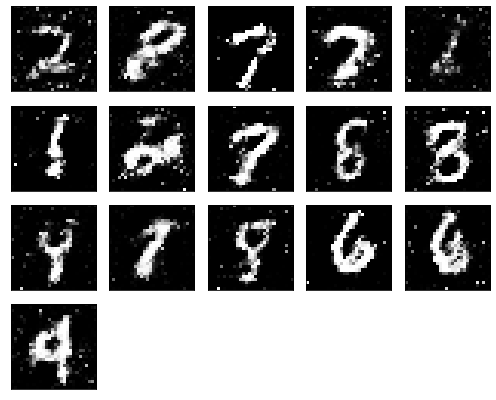

Epochs nb. 6481
discriminator loss: 0.6682978272438049
generator loss : 0.901132345199585

Epochs nb. 6482
discriminator loss: 0.6245734691619873
generator loss : 0.8953954577445984

Epochs nb. 6483
discriminator loss: 0.6738946437835693
generator loss : 1.0384225845336914

Epochs nb. 6484
discriminator loss: 0.5418998003005981
generator loss : 1.1773223876953125

Epochs nb. 6485
discriminator loss: 0.7578247785568237
generator loss : 0.9287896156311035

Epochs nb. 6486
discriminator loss: 0.5506690144538879
generator loss : 0.8898983001708984

Epochs nb. 6487
discriminator loss: 0.5940567851066589
generator loss : 0.9867092967033386

Epochs nb. 6488
discriminator loss: 0.5970803499221802
generator loss : 1.2978489398956299

Epochs nb. 6489
discriminator loss: 0.6298989653587341
generator loss : 1.1755123138427734

Epochs nb. 6490
discriminator loss: 0.5011889338493347
generator loss : 0.9048705101013184



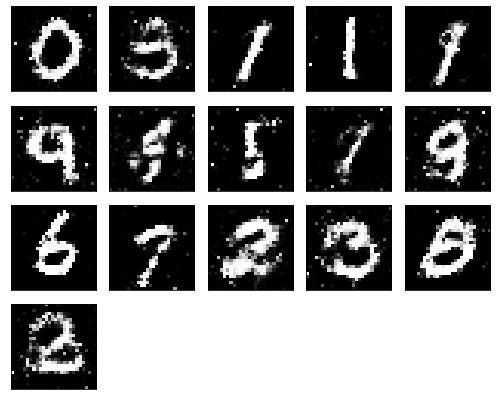

Epochs nb. 6491
discriminator loss: 0.5299394130706787
generator loss : 1.3448415994644165

Epochs nb. 6492
discriminator loss: 0.5430853962898254
generator loss : 1.2037441730499268

Epochs nb. 6493
discriminator loss: 0.7199223041534424
generator loss : 0.9810035228729248

Epochs nb. 6494
discriminator loss: 0.49972614645957947
generator loss : 0.9945211410522461

Epochs nb. 6495
discriminator loss: 0.6735326051712036
generator loss : 1.1286931037902832

Epochs nb. 6496
discriminator loss: 0.6593145132064819
generator loss : 1.1112141609191895

Epochs nb. 6497
discriminator loss: 0.5868555903434753
generator loss : 1.1516422033309937

Epochs nb. 6498
discriminator loss: 0.5440290570259094
generator loss : 1.0158882141113281

Epochs nb. 6499
discriminator loss: 0.4846632480621338
generator loss : 1.049364447593689

Epochs nb. 6500
discriminator loss: 0.6452324390411377
generator loss : 1.025276780128479



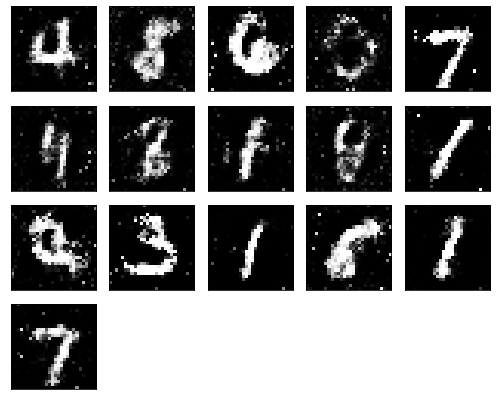

Epochs nb. 6501
discriminator loss: 0.5958007574081421
generator loss : 0.9750604033470154

Epochs nb. 6502
discriminator loss: 0.6124455332756042
generator loss : 0.9666433334350586

Epochs nb. 6503
discriminator loss: 0.6887751817703247
generator loss : 1.206664800643921

Epochs nb. 6504
discriminator loss: 0.554257333278656
generator loss : 0.9904407262802124

Epochs nb. 6505
discriminator loss: 0.6448504328727722
generator loss : 1.1495006084442139

Epochs nb. 6506
discriminator loss: 0.5058116316795349
generator loss : 1.018632411956787

Epochs nb. 6507
discriminator loss: 0.5353381633758545
generator loss : 0.9585927724838257

Epochs nb. 6508
discriminator loss: 0.5973007678985596
generator loss : 1.1524782180786133

Epochs nb. 6509
discriminator loss: 0.6285873055458069
generator loss : 0.9001992344856262

Epochs nb. 6510
discriminator loss: 0.5520995855331421
generator loss : 0.9625639915466309



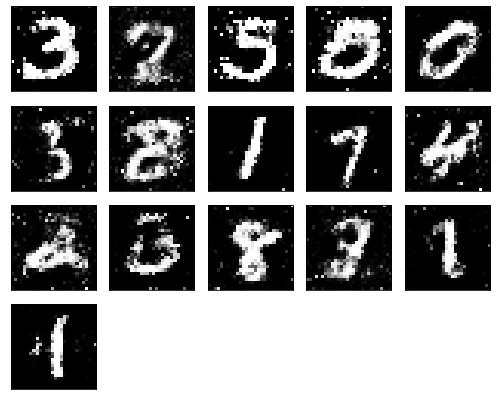

Epochs nb. 6511
discriminator loss: 0.5386983156204224
generator loss : 1.0608267784118652

Epochs nb. 6512
discriminator loss: 0.6619220972061157
generator loss : 1.0326085090637207

Epochs nb. 6513
discriminator loss: 0.6040397882461548
generator loss : 1.0440483093261719

Epochs nb. 6514
discriminator loss: 0.6179406642913818
generator loss : 0.8295704126358032

Epochs nb. 6515
discriminator loss: 0.6401484608650208
generator loss : 0.8743297457695007

Epochs nb. 6516
discriminator loss: 0.621992826461792
generator loss : 0.7614954710006714

Epochs nb. 6517
discriminator loss: 0.5814816355705261
generator loss : 1.028084635734558

Epochs nb. 6518
discriminator loss: 0.5867418646812439
generator loss : 0.9695623517036438

Epochs nb. 6519
discriminator loss: 0.5741044282913208
generator loss : 0.9513925313949585

Epochs nb. 6520
discriminator loss: 0.5674881935119629
generator loss : 0.9559248685836792



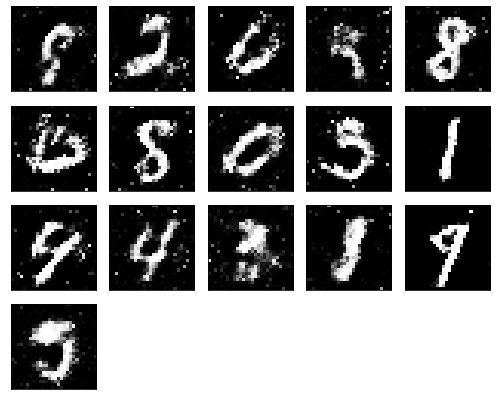

Epochs nb. 6521
discriminator loss: 0.855980396270752
generator loss : 0.9151660203933716

Epochs nb. 6522
discriminator loss: 0.5537474155426025
generator loss : 0.9670597910881042

Epochs nb. 6523
discriminator loss: 0.6467174291610718
generator loss : 1.1533808708190918

Epochs nb. 6524
discriminator loss: 0.6312764883041382
generator loss : 0.8401778936386108

Epochs nb. 6525
discriminator loss: 0.5550052523612976
generator loss : 0.9648941159248352

Epochs nb. 6526
discriminator loss: 0.4630216360092163
generator loss : 0.9958530068397522

Epochs nb. 6527
discriminator loss: 0.5299104452133179
generator loss : 0.9624766111373901

Epochs nb. 6528
discriminator loss: 0.6180658936500549
generator loss : 0.9591970443725586

Epochs nb. 6529
discriminator loss: 0.5801202058792114
generator loss : 1.2924805879592896

Epochs nb. 6530
discriminator loss: 0.5879785418510437
generator loss : 1.1708111763000488



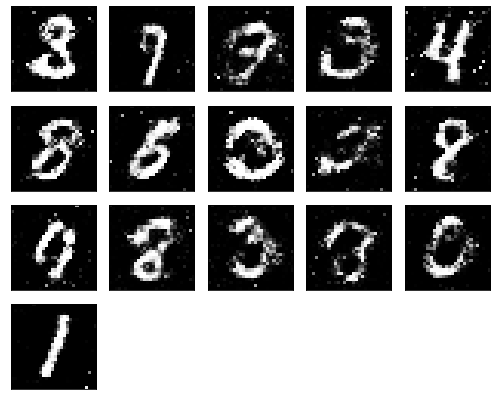

Epochs nb. 6531
discriminator loss: 0.681175947189331
generator loss : 1.0458433628082275

Epochs nb. 6532
discriminator loss: 0.6207218170166016
generator loss : 0.962581217288971

Epochs nb. 6533
discriminator loss: 0.6979868412017822
generator loss : 0.9974651336669922

Epochs nb. 6534
discriminator loss: 0.527390718460083
generator loss : 0.9180824160575867

Epochs nb. 6535
discriminator loss: 0.4622937738895416
generator loss : 1.093027114868164

Epochs nb. 6536
discriminator loss: 0.5479575991630554
generator loss : 0.7984009385108948

Epochs nb. 6537
discriminator loss: 0.625373363494873
generator loss : 0.9210981130599976

Epochs nb. 6538
discriminator loss: 0.8455744981765747
generator loss : 0.8152011036872864

Epochs nb. 6539
discriminator loss: 0.6657295227050781
generator loss : 0.7674857378005981

Epochs nb. 6540
discriminator loss: 0.5862941741943359
generator loss : 1.0475492477416992



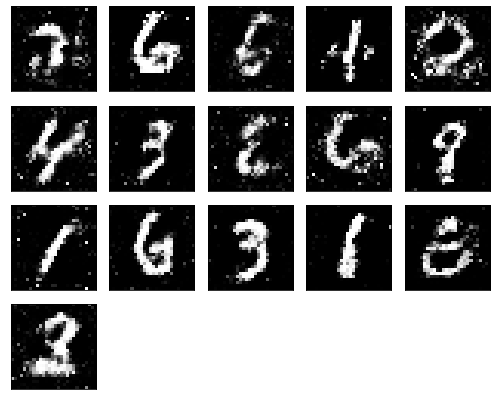

Epochs nb. 6541
discriminator loss: 0.5666754245758057
generator loss : 0.8562521934509277

Epochs nb. 6542
discriminator loss: 0.6277378797531128
generator loss : 1.2310640811920166

Epochs nb. 6543
discriminator loss: 0.5853691101074219
generator loss : 1.0431437492370605

Epochs nb. 6544
discriminator loss: 0.6435325145721436
generator loss : 0.9026024341583252

Epochs nb. 6545
discriminator loss: 0.5270233154296875
generator loss : 1.119866132736206

Epochs nb. 6546
discriminator loss: 0.6588089466094971
generator loss : 1.1589062213897705

Epochs nb. 6547
discriminator loss: 0.7004293203353882
generator loss : 1.1729543209075928

Epochs nb. 6548
discriminator loss: 0.526656448841095
generator loss : 1.2311320304870605

Epochs nb. 6549
discriminator loss: 0.6451652646064758
generator loss : 1.0686267614364624

Epochs nb. 6550
discriminator loss: 0.48623788356781006
generator loss : 0.9791584014892578



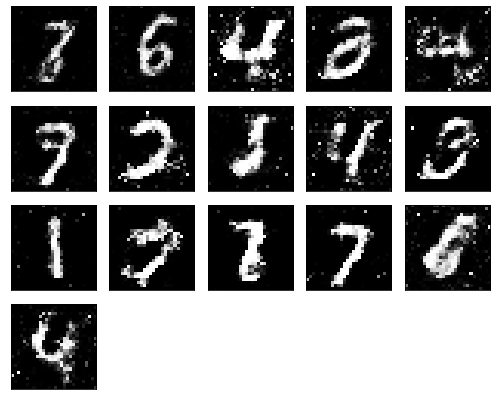

Epochs nb. 6551
discriminator loss: 0.676275372505188
generator loss : 1.0780785083770752

Epochs nb. 6552
discriminator loss: 0.649827241897583
generator loss : 0.9627809524536133

Epochs nb. 6553
discriminator loss: 0.6884353160858154
generator loss : 1.093291997909546

Epochs nb. 6554
discriminator loss: 0.6402889490127563
generator loss : 1.1204442977905273

Epochs nb. 6555
discriminator loss: 0.6027146577835083
generator loss : 1.1534110307693481

Epochs nb. 6556
discriminator loss: 0.5573784708976746
generator loss : 0.8707213401794434

Epochs nb. 6557
discriminator loss: 0.5214255452156067
generator loss : 1.0462737083435059

Epochs nb. 6558
discriminator loss: 0.7185685634613037
generator loss : 0.8938307762145996

Epochs nb. 6559
discriminator loss: 0.5224671363830566
generator loss : 0.9213018417358398

Epochs nb. 6560
discriminator loss: 0.6361915469169617
generator loss : 0.8268646001815796



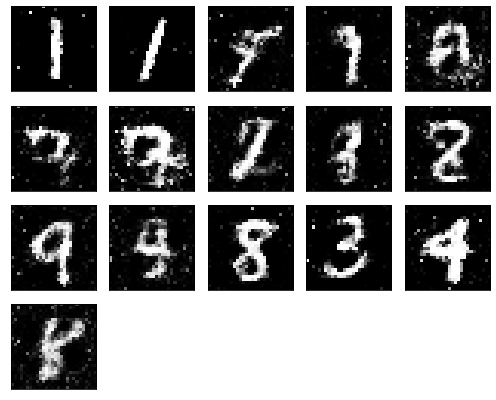

Epochs nb. 6561
discriminator loss: 0.6500183343887329
generator loss : 0.858867883682251

Epochs nb. 6562
discriminator loss: 0.6296828985214233
generator loss : 0.8904827237129211

Epochs nb. 6563
discriminator loss: 0.6159913539886475
generator loss : 0.865050196647644

Epochs nb. 6564
discriminator loss: 0.6218500733375549
generator loss : 0.8915729522705078

Epochs nb. 6565
discriminator loss: 0.4764767289161682
generator loss : 0.8831889629364014

Epochs nb. 6566
discriminator loss: 0.5711404085159302
generator loss : 0.8539260625839233

Epochs nb. 6567
discriminator loss: 0.5667294263839722
generator loss : 0.8543596267700195

Epochs nb. 6568
discriminator loss: 0.5601847171783447
generator loss : 0.8462915420532227

Epochs nb. 6569
discriminator loss: 0.5364307165145874
generator loss : 1.1342849731445312

Epochs nb. 6570
discriminator loss: 0.49923473596572876
generator loss : 1.2434759140014648



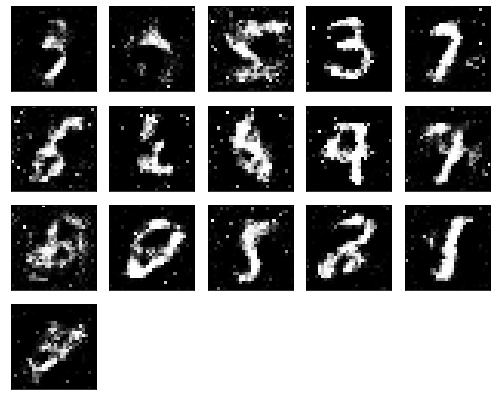

Epochs nb. 6571
discriminator loss: 0.5576733946800232
generator loss : 1.1019995212554932

Epochs nb. 6572
discriminator loss: 0.6042174100875854
generator loss : 0.8838408589363098

Epochs nb. 6573
discriminator loss: 0.6899794340133667
generator loss : 1.0487468242645264

Epochs nb. 6574
discriminator loss: 0.5382208824157715
generator loss : 0.9895583987236023

Epochs nb. 6575
discriminator loss: 0.49141889810562134
generator loss : 0.9562469720840454

Epochs nb. 6576
discriminator loss: 0.6006736755371094
generator loss : 1.126932144165039

Epochs nb. 6577
discriminator loss: 0.5538548231124878
generator loss : 1.000898838043213

Epochs nb. 6578
discriminator loss: 0.5998573303222656
generator loss : 0.919137716293335

Epochs nb. 6579
discriminator loss: 0.5410584211349487
generator loss : 1.031247615814209

Epochs nb. 6580
discriminator loss: 0.5231683254241943
generator loss : 1.0862213373184204



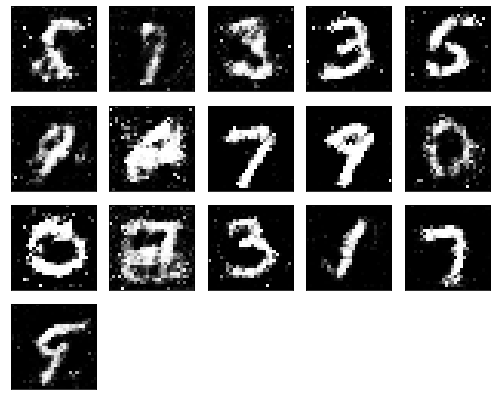

Epochs nb. 6581
discriminator loss: 0.5793400406837463
generator loss : 1.0471751689910889

Epochs nb. 6582
discriminator loss: 0.5526062250137329
generator loss : 0.9409679174423218

Epochs nb. 6583
discriminator loss: 0.597216010093689
generator loss : 0.7936937808990479

Epochs nb. 6584
discriminator loss: 0.5673733949661255
generator loss : 0.8335353136062622

Epochs nb. 6585
discriminator loss: 0.5717765092849731
generator loss : 0.9862314462661743

Epochs nb. 6586
discriminator loss: 0.6435034275054932
generator loss : 1.1654428243637085

Epochs nb. 6587
discriminator loss: 0.6748167872428894
generator loss : 0.8887217044830322

Epochs nb. 6588
discriminator loss: 0.523450493812561
generator loss : 0.9210548400878906

Epochs nb. 6589
discriminator loss: 0.4925417900085449
generator loss : 1.0370467901229858

Epochs nb. 6590
discriminator loss: 0.6391988396644592
generator loss : 1.2121531963348389



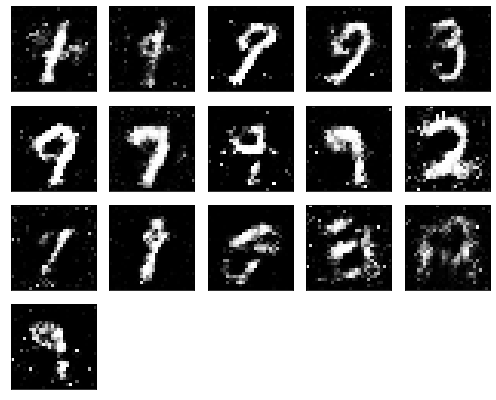

Epochs nb. 6591
discriminator loss: 0.6187106370925903
generator loss : 1.1618413925170898

Epochs nb. 6592
discriminator loss: 0.6864045858383179
generator loss : 1.0038496255874634

Epochs nb. 6593
discriminator loss: 0.5753031969070435
generator loss : 0.8809502124786377

Epochs nb. 6594
discriminator loss: 0.5953020453453064
generator loss : 1.1224380731582642

Epochs nb. 6595
discriminator loss: 0.6644784212112427
generator loss : 0.9902121424674988

Epochs nb. 6596
discriminator loss: 0.7105884552001953
generator loss : 1.1070839166641235

Epochs nb. 6597
discriminator loss: 0.5444465279579163
generator loss : 0.8711708188056946

Epochs nb. 6598
discriminator loss: 0.6048241853713989
generator loss : 0.9246865510940552

Epochs nb. 6599
discriminator loss: 0.42552974820137024
generator loss : 0.8480985164642334

Epochs nb. 6600
discriminator loss: 0.6538158059120178
generator loss : 1.025270700454712



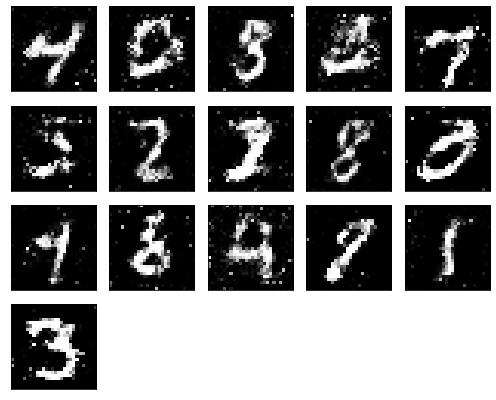

Epochs nb. 6601
discriminator loss: 0.7332953810691833
generator loss : 0.9591187834739685

Epochs nb. 6602
discriminator loss: 0.5805280804634094
generator loss : 0.8406481742858887

Epochs nb. 6603
discriminator loss: 0.5590210556983948
generator loss : 0.9582514762878418

Epochs nb. 6604
discriminator loss: 0.6098325252532959
generator loss : 0.9778264760971069

Epochs nb. 6605
discriminator loss: 0.5671314597129822
generator loss : 0.9841294288635254

Epochs nb. 6606
discriminator loss: 0.5162370204925537
generator loss : 1.149775743484497

Epochs nb. 6607
discriminator loss: 0.6846951842308044
generator loss : 1.08700430393219

Epochs nb. 6608
discriminator loss: 0.5744197368621826
generator loss : 1.1164685487747192

Epochs nb. 6609
discriminator loss: 0.5706043243408203
generator loss : 0.901321291923523

Epochs nb. 6610
discriminator loss: 0.556166410446167
generator loss : 1.0331132411956787



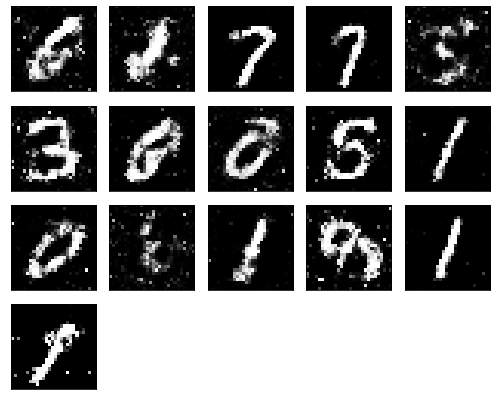

Epochs nb. 6611
discriminator loss: 0.5965414047241211
generator loss : 1.0014398097991943

Epochs nb. 6612
discriminator loss: 0.6010931730270386
generator loss : 0.8279578685760498

Epochs nb. 6613
discriminator loss: 0.6414624452590942
generator loss : 1.0367870330810547

Epochs nb. 6614
discriminator loss: 0.6179789304733276
generator loss : 0.9192768931388855

Epochs nb. 6615
discriminator loss: 0.6335951089859009
generator loss : 1.1351518630981445

Epochs nb. 6616
discriminator loss: 0.5688199996948242
generator loss : 1.2203457355499268

Epochs nb. 6617
discriminator loss: 0.6601928472518921
generator loss : 0.9125303626060486

Epochs nb. 6618
discriminator loss: 0.626816987991333
generator loss : 1.0543736219406128

Epochs nb. 6619
discriminator loss: 0.545548677444458
generator loss : 1.1429604291915894

Epochs nb. 6620
discriminator loss: 0.5557102560997009
generator loss : 1.029707908630371



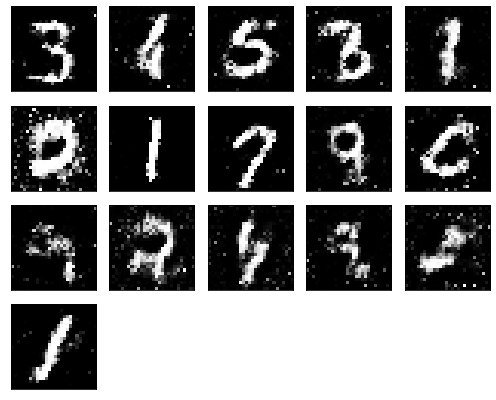

Epochs nb. 6621
discriminator loss: 0.841806948184967
generator loss : 1.0394716262817383

Epochs nb. 6622
discriminator loss: 0.6264698505401611
generator loss : 1.11562180519104

Epochs nb. 6623
discriminator loss: 0.6477800607681274
generator loss : 0.8861998915672302

Epochs nb. 6624
discriminator loss: 0.5769683122634888
generator loss : 0.8972557187080383

Epochs nb. 6625
discriminator loss: 0.5143561363220215
generator loss : 1.215876817703247

Epochs nb. 6626
discriminator loss: 0.672648549079895
generator loss : 1.1174639463424683

Epochs nb. 6627
discriminator loss: 0.7016983032226562
generator loss : 0.9750617742538452

Epochs nb. 6628
discriminator loss: 0.5059740543365479
generator loss : 1.0689624547958374

Epochs nb. 6629
discriminator loss: 0.6709247827529907
generator loss : 1.0297906398773193

Epochs nb. 6630
discriminator loss: 0.7281224727630615
generator loss : 1.150450348854065



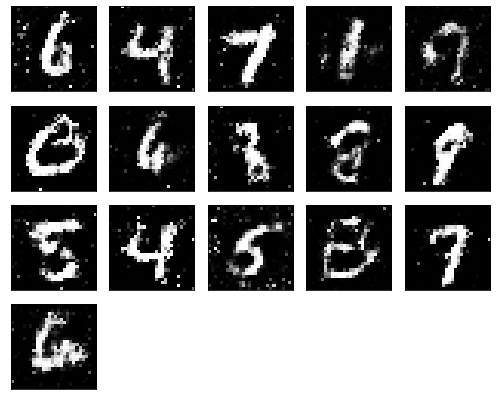

Epochs nb. 6631
discriminator loss: 0.5881156921386719
generator loss : 0.9705222249031067

Epochs nb. 6632
discriminator loss: 0.7010564208030701
generator loss : 1.0839651823043823

Epochs nb. 6633
discriminator loss: 0.6053791642189026
generator loss : 0.9115281105041504

Epochs nb. 6634
discriminator loss: 0.6148070096969604
generator loss : 1.06857168674469

Epochs nb. 6635
discriminator loss: 0.5982780456542969
generator loss : 1.0504941940307617

Epochs nb. 6636
discriminator loss: 0.5452480316162109
generator loss : 1.094829797744751

Epochs nb. 6637
discriminator loss: 0.6018874645233154
generator loss : 1.0452511310577393

Epochs nb. 6638
discriminator loss: 0.41578495502471924
generator loss : 1.0944154262542725

Epochs nb. 6639
discriminator loss: 0.5211596488952637
generator loss : 1.073991298675537

Epochs nb. 6640
discriminator loss: 0.5963388681411743
generator loss : 0.9611561894416809



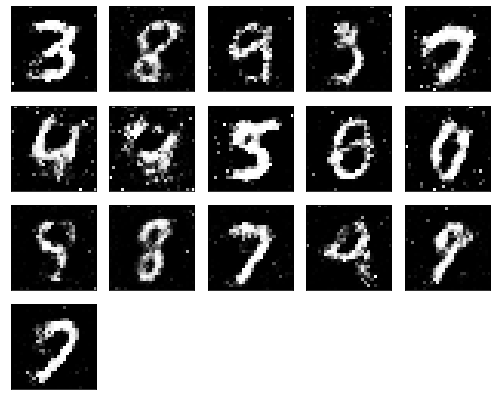

Epochs nb. 6641
discriminator loss: 0.6938947439193726
generator loss : 1.0461288690567017

Epochs nb. 6642
discriminator loss: 0.6757880449295044
generator loss : 0.9361414313316345

Epochs nb. 6643
discriminator loss: 0.6242516040802002
generator loss : 0.9321342706680298

Epochs nb. 6644
discriminator loss: 0.6688632965087891
generator loss : 1.0643293857574463

Epochs nb. 6645
discriminator loss: 0.5850545763969421
generator loss : 0.875174880027771

Epochs nb. 6646
discriminator loss: 0.44635412096977234
generator loss : 1.031520962715149

Epochs nb. 6647
discriminator loss: 0.6050724983215332
generator loss : 1.2166486978530884

Epochs nb. 6648
discriminator loss: 0.4708423316478729
generator loss : 1.2098524570465088

Epochs nb. 6649
discriminator loss: 0.6253218650817871
generator loss : 1.0752694606781006

Epochs nb. 6650
discriminator loss: 0.5945805311203003
generator loss : 0.9986059665679932



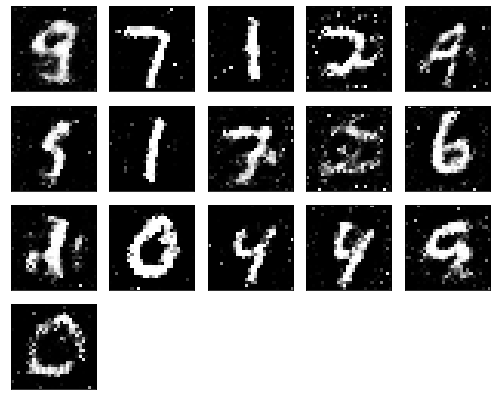

Epochs nb. 6651
discriminator loss: 0.4845905005931854
generator loss : 1.1647032499313354

Epochs nb. 6652
discriminator loss: 0.5377048254013062
generator loss : 1.109971046447754

Epochs nb. 6653
discriminator loss: 0.5496795773506165
generator loss : 1.2262723445892334

Epochs nb. 6654
discriminator loss: 0.5750641822814941
generator loss : 0.954450249671936

Epochs nb. 6655
discriminator loss: 0.7301151156425476
generator loss : 0.9302940368652344

Epochs nb. 6656
discriminator loss: 0.5965489745140076
generator loss : 1.0012762546539307

Epochs nb. 6657
discriminator loss: 0.5092777013778687
generator loss : 1.2453124523162842

Epochs nb. 6658
discriminator loss: 0.6316168308258057
generator loss : 1.026142954826355

Epochs nb. 6659
discriminator loss: 0.6972228288650513
generator loss : 0.9908838868141174

Epochs nb. 6660
discriminator loss: 0.5452996492385864
generator loss : 1.0729776620864868



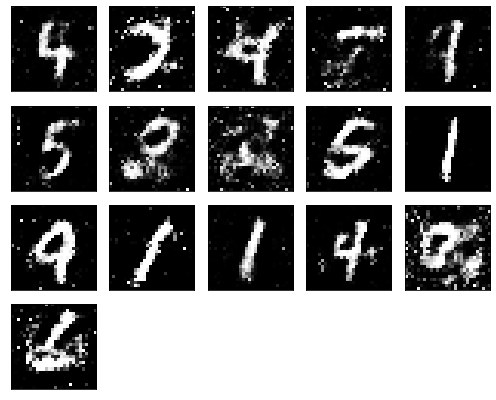

Epochs nb. 6661
discriminator loss: 0.7202343940734863
generator loss : 0.9144430160522461

Epochs nb. 6662
discriminator loss: 0.6026663780212402
generator loss : 0.8676840662956238

Epochs nb. 6663
discriminator loss: 0.6001310348510742
generator loss : 0.9238514304161072

Epochs nb. 6664
discriminator loss: 0.5031344890594482
generator loss : 1.1955797672271729

Epochs nb. 6665
discriminator loss: 0.6822978258132935
generator loss : 1.1014294624328613

Epochs nb. 6666
discriminator loss: 0.5191915035247803
generator loss : 1.166677713394165

Epochs nb. 6667
discriminator loss: 0.612716794013977
generator loss : 1.0555181503295898

Epochs nb. 6668
discriminator loss: 0.560038149356842
generator loss : 1.1555566787719727

Epochs nb. 6669
discriminator loss: 0.6730847954750061
generator loss : 1.033396601676941

Epochs nb. 6670
discriminator loss: 0.5971670150756836
generator loss : 0.8780523538589478



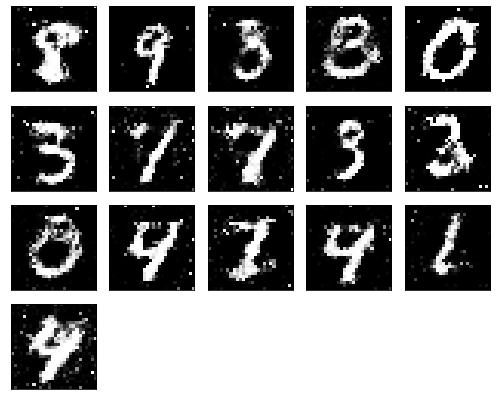

Epochs nb. 6671
discriminator loss: 0.4973600506782532
generator loss : 0.9514865279197693

Epochs nb. 6672
discriminator loss: 0.7802867889404297
generator loss : 1.062173843383789

Epochs nb. 6673
discriminator loss: 0.6395150423049927
generator loss : 0.9938020706176758

Epochs nb. 6674
discriminator loss: 0.6050875186920166
generator loss : 0.8990256190299988

Epochs nb. 6675
discriminator loss: 0.42799198627471924
generator loss : 0.9535126686096191

Epochs nb. 6676
discriminator loss: 0.6201109886169434
generator loss : 0.900780439376831

Epochs nb. 6677
discriminator loss: 0.6084458827972412
generator loss : 0.9436641335487366

Epochs nb. 6678
discriminator loss: 0.6730575561523438
generator loss : 0.9002569317817688

Epochs nb. 6679
discriminator loss: 0.609260082244873
generator loss : 1.0883437395095825

Epochs nb. 6680
discriminator loss: 0.7936282753944397
generator loss : 0.964321494102478



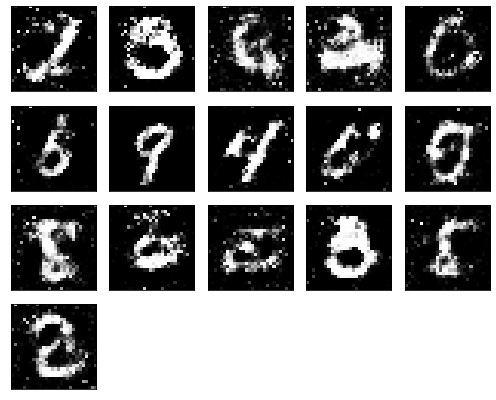

Epochs nb. 6681
discriminator loss: 0.7055889368057251
generator loss : 1.1286468505859375

Epochs nb. 6682
discriminator loss: 0.5613633394241333
generator loss : 1.0251270532608032

Epochs nb. 6683
discriminator loss: 0.6598292589187622
generator loss : 1.0571026802062988

Epochs nb. 6684
discriminator loss: 0.6149328351020813
generator loss : 1.0728591680526733

Epochs nb. 6685
discriminator loss: 0.6085271835327148
generator loss : 1.1792658567428589

Epochs nb. 6686
discriminator loss: 0.6332547664642334
generator loss : 0.836203396320343

Epochs nb. 6687
discriminator loss: 0.6250492334365845
generator loss : 1.0480607748031616

Epochs nb. 6688
discriminator loss: 0.6046042442321777
generator loss : 1.1299573183059692

Epochs nb. 6689
discriminator loss: 0.5585688352584839
generator loss : 1.0617005825042725

Epochs nb. 6690
discriminator loss: 0.5504542589187622
generator loss : 1.050700068473816



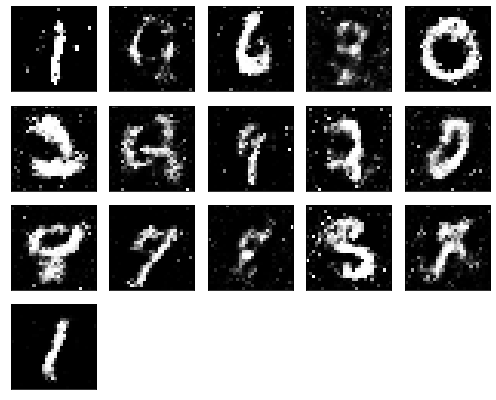

Epochs nb. 6691
discriminator loss: 0.5592349767684937
generator loss : 0.9367153644561768

Epochs nb. 6692
discriminator loss: 0.6569191217422485
generator loss : 0.9116878509521484

Epochs nb. 6693
discriminator loss: 0.6968792676925659
generator loss : 0.982035756111145

Epochs nb. 6694
discriminator loss: 0.623344898223877
generator loss : 1.037489891052246

Epochs nb. 6695
discriminator loss: 0.6595363616943359
generator loss : 1.3263170719146729

Epochs nb. 6696
discriminator loss: 0.633134663105011
generator loss : 0.9161872863769531

Epochs nb. 6697
discriminator loss: 0.6506507396697998
generator loss : 0.9936266541481018

Epochs nb. 6698
discriminator loss: 0.6796334385871887
generator loss : 1.0147100687026978

Epochs nb. 6699
discriminator loss: 0.5537704229354858
generator loss : 0.9984689950942993

Epochs nb. 6700
discriminator loss: 0.5420316457748413
generator loss : 1.0366806983947754



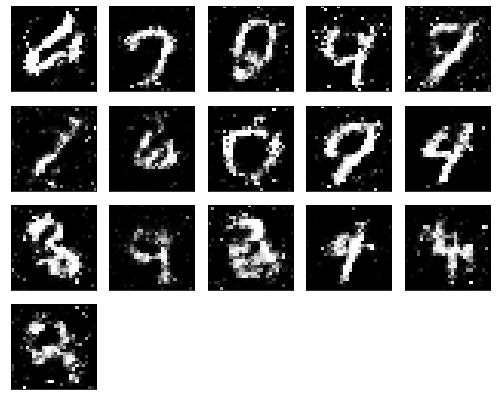

Epochs nb. 6701
discriminator loss: 0.6111994981765747
generator loss : 1.3150084018707275

Epochs nb. 6702
discriminator loss: 0.6712092161178589
generator loss : 1.1384406089782715

Epochs nb. 6703
discriminator loss: 0.4985932409763336
generator loss : 0.8750840425491333

Epochs nb. 6704
discriminator loss: 0.54921555519104
generator loss : 0.9326788783073425

Epochs nb. 6705
discriminator loss: 0.6638777852058411
generator loss : 0.9208416938781738

Epochs nb. 6706
discriminator loss: 0.6760985851287842
generator loss : 0.9220792651176453

Epochs nb. 6707
discriminator loss: 0.5339295268058777
generator loss : 1.1173810958862305

Epochs nb. 6708
discriminator loss: 0.6541684865951538
generator loss : 1.0926997661590576

Epochs nb. 6709
discriminator loss: 0.6312334537506104
generator loss : 1.0324485301971436

Epochs nb. 6710
discriminator loss: 0.626663088798523
generator loss : 1.1861577033996582



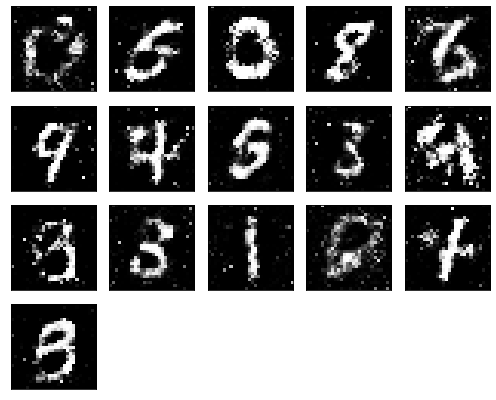

Epochs nb. 6711
discriminator loss: 0.5757678151130676
generator loss : 1.0315195322036743

Epochs nb. 6712
discriminator loss: 0.5432477593421936
generator loss : 0.967200517654419

Epochs nb. 6713
discriminator loss: 0.7139877676963806
generator loss : 1.0514709949493408

Epochs nb. 6714
discriminator loss: 0.5617371797561646
generator loss : 0.9521903991699219

Epochs nb. 6715
discriminator loss: 0.6043592691421509
generator loss : 0.9609416723251343

Epochs nb. 6716
discriminator loss: 0.7107694149017334
generator loss : 0.8678226470947266

Epochs nb. 6717
discriminator loss: 0.5227644443511963
generator loss : 0.7513515949249268

Epochs nb. 6718
discriminator loss: 0.5599727630615234
generator loss : 0.9738552570343018

Epochs nb. 6719
discriminator loss: 0.6802241802215576
generator loss : 0.9926877021789551

Epochs nb. 6720
discriminator loss: 0.5460047721862793
generator loss : 0.9354782104492188



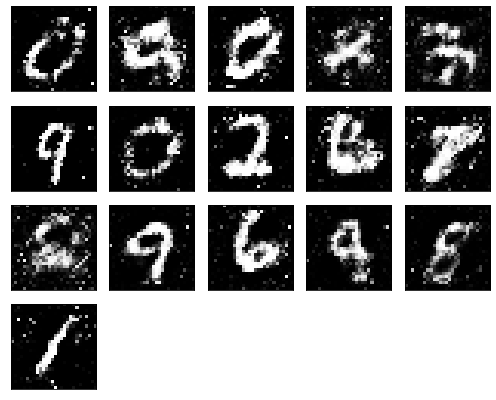

Epochs nb. 6721
discriminator loss: 0.6639212369918823
generator loss : 1.017867088317871

Epochs nb. 6722
discriminator loss: 0.6575242280960083
generator loss : 1.1441309452056885

Epochs nb. 6723
discriminator loss: 0.5604913830757141
generator loss : 1.069826364517212

Epochs nb. 6724
discriminator loss: 0.5608887672424316
generator loss : 0.9806376695632935

Epochs nb. 6725
discriminator loss: 0.4850527048110962
generator loss : 1.0468158721923828

Epochs nb. 6726
discriminator loss: 0.7057648301124573
generator loss : 1.0593128204345703

Epochs nb. 6727
discriminator loss: 0.5709550380706787
generator loss : 1.0064630508422852

Epochs nb. 6728
discriminator loss: 0.6711573600769043
generator loss : 0.9244561791419983

Epochs nb. 6729
discriminator loss: 0.5707806348800659
generator loss : 0.9532434940338135

Epochs nb. 6730
discriminator loss: 0.6193225383758545
generator loss : 0.9570275545120239



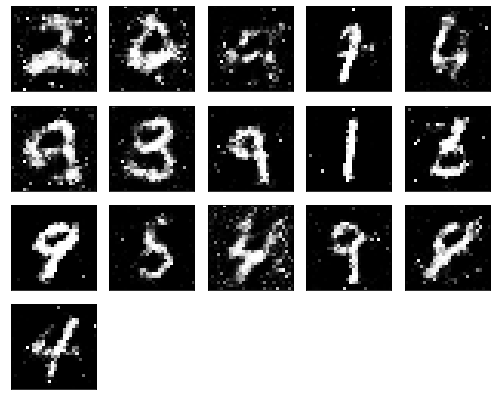

Epochs nb. 6731
discriminator loss: 0.6369674205780029
generator loss : 0.9080147743225098

Epochs nb. 6732
discriminator loss: 0.5975804328918457
generator loss : 0.9684709310531616

Epochs nb. 6733
discriminator loss: 0.6700674891471863
generator loss : 0.8224188089370728

Epochs nb. 6734
discriminator loss: 0.616982102394104
generator loss : 0.8049993515014648

Epochs nb. 6735
discriminator loss: 0.5134338140487671
generator loss : 1.0359210968017578

Epochs nb. 6736
discriminator loss: 0.6106972694396973
generator loss : 0.9466891288757324

Epochs nb. 6737
discriminator loss: 0.5957748889923096
generator loss : 0.9604453444480896

Epochs nb. 6738
discriminator loss: 0.6175998449325562
generator loss : 0.8010523915290833

Epochs nb. 6739
discriminator loss: 0.5162985920906067
generator loss : 0.9920533895492554

Epochs nb. 6740
discriminator loss: 0.6140532493591309
generator loss : 0.9602457284927368



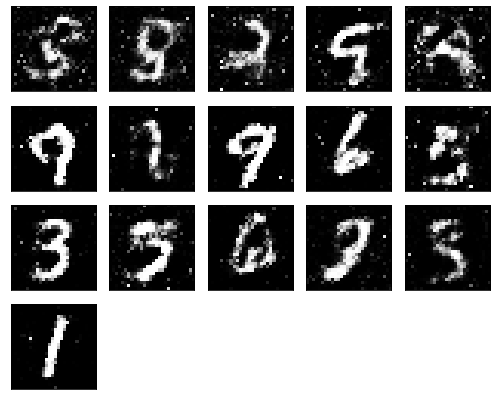

Epochs nb. 6741
discriminator loss: 0.49128955602645874
generator loss : 1.0815298557281494

Epochs nb. 6742
discriminator loss: 0.6928066611289978
generator loss : 0.9394979476928711

Epochs nb. 6743
discriminator loss: 0.5472211837768555
generator loss : 0.9683217406272888

Epochs nb. 6744
discriminator loss: 0.47611427307128906
generator loss : 0.9976613521575928

Epochs nb. 6745
discriminator loss: 0.6134610176086426
generator loss : 0.9414236545562744

Epochs nb. 6746
discriminator loss: 0.4962475895881653
generator loss : 0.9129828810691833

Epochs nb. 6747
discriminator loss: 0.5692028999328613
generator loss : 1.0619016885757446

Epochs nb. 6748
discriminator loss: 0.6356179714202881
generator loss : 1.170250654220581

Epochs nb. 6749
discriminator loss: 0.6478599905967712
generator loss : 1.1930079460144043

Epochs nb. 6750
discriminator loss: 0.706775426864624
generator loss : 1.331115961074829



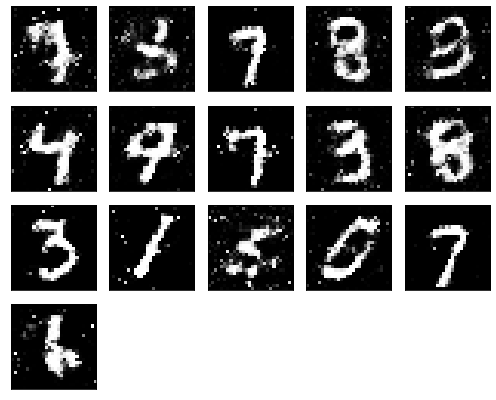

Epochs nb. 6751
discriminator loss: 0.6881036758422852
generator loss : 1.0348273515701294

Epochs nb. 6752
discriminator loss: 0.5904728174209595
generator loss : 1.0872797966003418

Epochs nb. 6753
discriminator loss: 0.6061513423919678
generator loss : 1.1546777486801147

Epochs nb. 6754
discriminator loss: 0.7375437021255493
generator loss : 0.9998440146446228

Epochs nb. 6755
discriminator loss: 0.4884377717971802
generator loss : 1.1264549493789673

Epochs nb. 6756
discriminator loss: 0.4623725414276123
generator loss : 1.0846831798553467

Epochs nb. 6757
discriminator loss: 0.4487901031970978
generator loss : 1.174839735031128

Epochs nb. 6758
discriminator loss: 0.5415377616882324
generator loss : 1.1923918724060059

Epochs nb. 6759
discriminator loss: 0.51202392578125
generator loss : 0.9422275424003601

Epochs nb. 6760
discriminator loss: 0.6060253977775574
generator loss : 1.0989042520523071



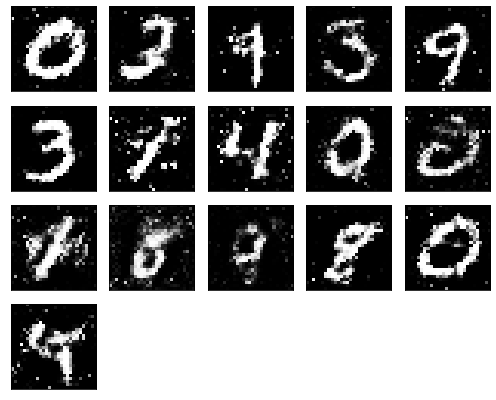

Epochs nb. 6761
discriminator loss: 0.532825767993927
generator loss : 1.043518304824829

Epochs nb. 6762
discriminator loss: 0.5621387958526611
generator loss : 0.9538493156433105

Epochs nb. 6763
discriminator loss: 0.6410666704177856
generator loss : 0.9930828809738159

Epochs nb. 6764
discriminator loss: 0.6751707792282104
generator loss : 0.8532025814056396

Epochs nb. 6765
discriminator loss: 0.6054162383079529
generator loss : 1.12742018699646

Epochs nb. 6766
discriminator loss: 0.6204800605773926
generator loss : 0.9521263837814331

Epochs nb. 6767
discriminator loss: 0.5877918601036072
generator loss : 1.0553505420684814

Epochs nb. 6768
discriminator loss: 0.6947354674339294
generator loss : 0.8309677839279175

Epochs nb. 6769
discriminator loss: 0.6649683713912964
generator loss : 1.0860333442687988

Epochs nb. 6770
discriminator loss: 0.5624008178710938
generator loss : 1.1124770641326904



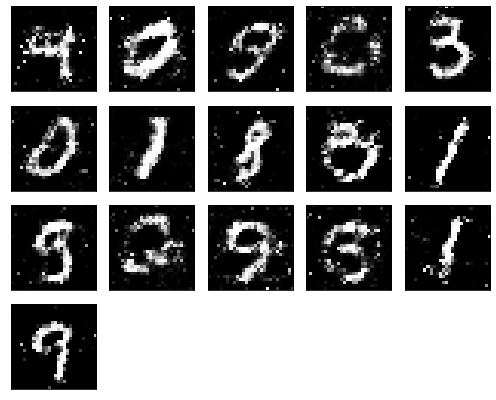

Epochs nb. 6771
discriminator loss: 0.7059712409973145
generator loss : 1.0464322566986084

Epochs nb. 6772
discriminator loss: 0.5486056804656982
generator loss : 0.9810358881950378

Epochs nb. 6773
discriminator loss: 0.6258329153060913
generator loss : 0.9990955591201782

Epochs nb. 6774
discriminator loss: 0.5425938367843628
generator loss : 0.918186604976654

Epochs nb. 6775
discriminator loss: 0.634229302406311
generator loss : 1.0460176467895508

Epochs nb. 6776
discriminator loss: 0.6078729629516602
generator loss : 0.8932461738586426

Epochs nb. 6777
discriminator loss: 0.4701367914676666
generator loss : 0.90920090675354

Epochs nb. 6778
discriminator loss: 0.6287873983383179
generator loss : 0.9479599595069885

Epochs nb. 6779
discriminator loss: 0.5100834369659424
generator loss : 0.8111001253128052

Epochs nb. 6780
discriminator loss: 0.5671533346176147
generator loss : 0.9902199506759644



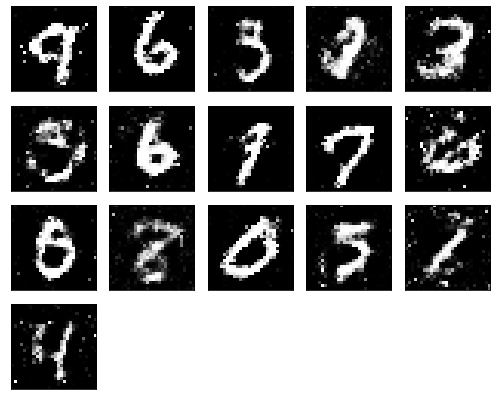

Epochs nb. 6781
discriminator loss: 0.7002279758453369
generator loss : 1.0799179077148438

Epochs nb. 6782
discriminator loss: 0.5494786500930786
generator loss : 1.0493642091751099

Epochs nb. 6783
discriminator loss: 0.584385871887207
generator loss : 1.045656442642212

Epochs nb. 6784
discriminator loss: 0.6496165990829468
generator loss : 0.957478404045105

Epochs nb. 6785
discriminator loss: 0.5452541708946228
generator loss : 0.8155403733253479

Epochs nb. 6786
discriminator loss: 0.5417395830154419
generator loss : 1.0190300941467285

Epochs nb. 6787
discriminator loss: 0.6856644153594971
generator loss : 1.0541644096374512

Epochs nb. 6788
discriminator loss: 0.5650691986083984
generator loss : 0.9954890012741089

Epochs nb. 6789
discriminator loss: 0.4264758229255676
generator loss : 0.9780483841896057

Epochs nb. 6790
discriminator loss: 0.6211084127426147
generator loss : 1.097074031829834



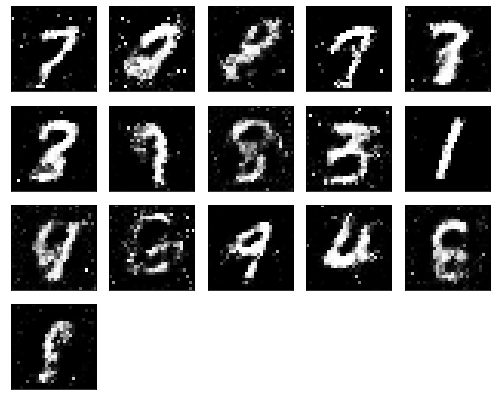

Epochs nb. 6791
discriminator loss: 0.7070084810256958
generator loss : 1.0940182209014893

Epochs nb. 6792
discriminator loss: 0.4832901954650879
generator loss : 0.9032765030860901

Epochs nb. 6793
discriminator loss: 0.7272928357124329
generator loss : 1.0504704713821411

Epochs nb. 6794
discriminator loss: 0.46969616413116455
generator loss : 0.9591776132583618

Epochs nb. 6795
discriminator loss: 0.6134861707687378
generator loss : 0.8983805775642395

Epochs nb. 6796
discriminator loss: 0.6310446262359619
generator loss : 0.9955187439918518

Epochs nb. 6797
discriminator loss: 0.5638204216957092
generator loss : 0.9818567037582397

Epochs nb. 6798
discriminator loss: 0.6017723083496094
generator loss : 0.9942570328712463

Epochs nb. 6799
discriminator loss: 0.6712779402732849
generator loss : 0.9958224892616272

Epochs nb. 6800
discriminator loss: 0.5361695289611816
generator loss : 1.1432702541351318



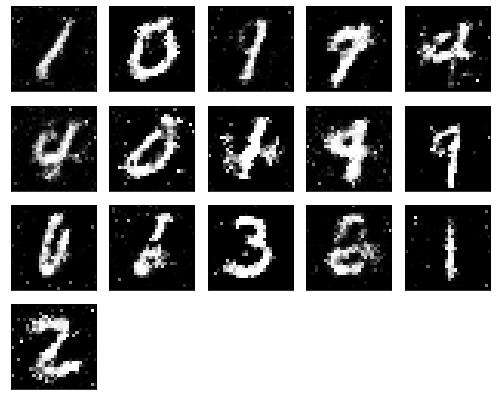

Epochs nb. 6801
discriminator loss: 0.7905405759811401
generator loss : 0.9098277688026428

Epochs nb. 6802
discriminator loss: 0.6139243841171265
generator loss : 0.9085146188735962

Epochs nb. 6803
discriminator loss: 0.6048391461372375
generator loss : 1.0609688758850098

Epochs nb. 6804
discriminator loss: 0.5256006121635437
generator loss : 0.7872252464294434

Epochs nb. 6805
discriminator loss: 0.5445971488952637
generator loss : 0.9253360033035278

Epochs nb. 6806
discriminator loss: 0.5468729138374329
generator loss : 1.2003943920135498

Epochs nb. 6807
discriminator loss: 0.5525774359703064
generator loss : 1.294931411743164

Epochs nb. 6808
discriminator loss: 0.5761117935180664
generator loss : 1.3203485012054443

Epochs nb. 6809
discriminator loss: 0.6054692268371582
generator loss : 1.0465675592422485

Epochs nb. 6810
discriminator loss: 0.594831109046936
generator loss : 0.8784252405166626



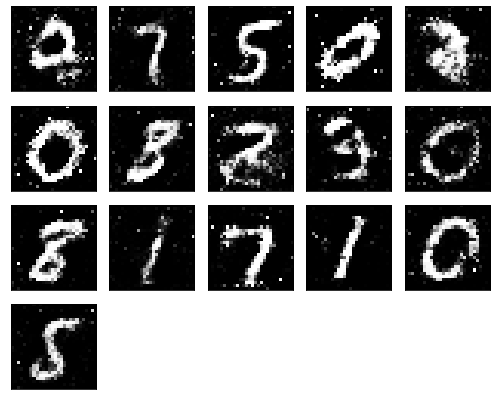

Epochs nb. 6811
discriminator loss: 0.4759560823440552
generator loss : 1.0988457202911377

Epochs nb. 6812
discriminator loss: 0.5240533351898193
generator loss : 1.016474962234497

Epochs nb. 6813
discriminator loss: 0.605764627456665
generator loss : 0.9482989311218262

Epochs nb. 6814
discriminator loss: 0.5503308773040771
generator loss : 0.7895337343215942

Epochs nb. 6815
discriminator loss: 0.7328689098358154
generator loss : 1.1585297584533691

Epochs nb. 6816
discriminator loss: 0.6016520261764526
generator loss : 1.1005321741104126

Epochs nb. 6817
discriminator loss: 0.6390399932861328
generator loss : 1.1466984748840332

Epochs nb. 6818
discriminator loss: 0.5406782031059265
generator loss : 1.0242112874984741

Epochs nb. 6819
discriminator loss: 0.5491094589233398
generator loss : 1.0594427585601807

Epochs nb. 6820
discriminator loss: 0.6394819021224976
generator loss : 1.2418724298477173



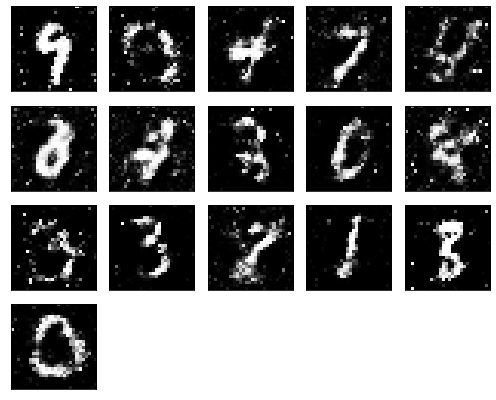

Epochs nb. 6821
discriminator loss: 0.5069882869720459
generator loss : 1.013293981552124

Epochs nb. 6822
discriminator loss: 0.5260546803474426
generator loss : 1.0768263339996338

Epochs nb. 6823
discriminator loss: 0.6063414216041565
generator loss : 1.1798856258392334

Epochs nb. 6824
discriminator loss: 0.5881194472312927
generator loss : 0.9692010879516602

Epochs nb. 6825
discriminator loss: 0.6540142297744751
generator loss : 1.1497604846954346

Epochs nb. 6826
discriminator loss: 0.5943552255630493
generator loss : 0.8721427917480469

Epochs nb. 6827
discriminator loss: 0.5711033344268799
generator loss : 1.0524110794067383

Epochs nb. 6828
discriminator loss: 0.5368294715881348
generator loss : 1.0107406377792358

Epochs nb. 6829
discriminator loss: 0.5939038991928101
generator loss : 0.9257773756980896

Epochs nb. 6830
discriminator loss: 0.5281271934509277
generator loss : 0.9329150319099426



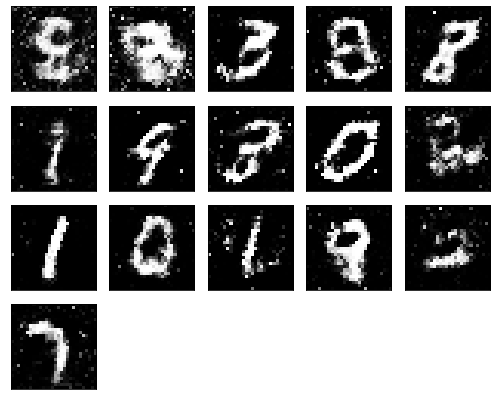

Epochs nb. 6831
discriminator loss: 0.5687847137451172
generator loss : 0.8578866124153137

Epochs nb. 6832
discriminator loss: 0.578860342502594
generator loss : 0.9842568635940552

Epochs nb. 6833
discriminator loss: 0.669249415397644
generator loss : 0.8137979507446289

Epochs nb. 6834
discriminator loss: 0.5901864171028137
generator loss : 1.0353357791900635

Epochs nb. 6835
discriminator loss: 0.6128624677658081
generator loss : 0.9194655418395996

Epochs nb. 6836
discriminator loss: 0.5834993720054626
generator loss : 1.0361140966415405

Epochs nb. 6837
discriminator loss: 0.6235584020614624
generator loss : 0.8813196420669556

Epochs nb. 6838
discriminator loss: 0.6168326735496521
generator loss : 0.8292053937911987

Epochs nb. 6839
discriminator loss: 0.6823473572731018
generator loss : 0.795262336730957

Epochs nb. 6840
discriminator loss: 0.5115728378295898
generator loss : 0.8670551180839539



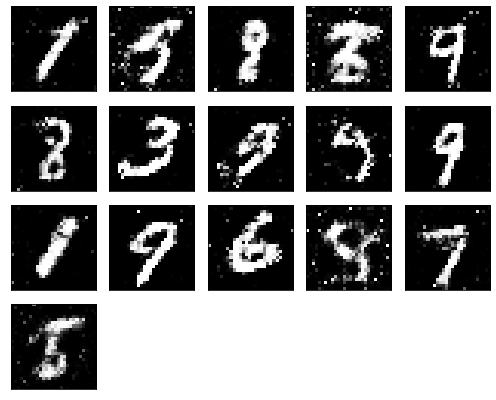

Epochs nb. 6841
discriminator loss: 0.5875202417373657
generator loss : 0.9595953226089478

Epochs nb. 6842
discriminator loss: 0.8718780279159546
generator loss : 0.8811091780662537

Epochs nb. 6843
discriminator loss: 0.487187922000885
generator loss : 0.8510027527809143

Epochs nb. 6844
discriminator loss: 0.5162535309791565
generator loss : 0.8813550472259521

Epochs nb. 6845
discriminator loss: 0.7108129262924194
generator loss : 0.7510919570922852

Epochs nb. 6846
discriminator loss: 0.5545294880867004
generator loss : 0.9756021499633789

Epochs nb. 6847
discriminator loss: 0.5007694959640503
generator loss : 1.114473581314087

Epochs nb. 6848
discriminator loss: 0.5204885005950928
generator loss : 0.9994310140609741

Epochs nb. 6849
discriminator loss: 0.579433798789978
generator loss : 0.9227187633514404

Epochs nb. 6850
discriminator loss: 0.5555481314659119
generator loss : 1.0204964876174927



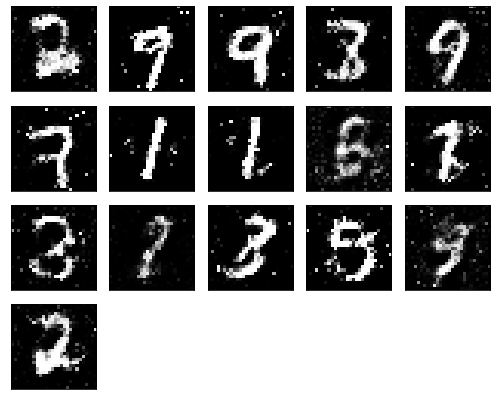

Epochs nb. 6851
discriminator loss: 0.5628675222396851
generator loss : 1.0284111499786377

Epochs nb. 6852
discriminator loss: 0.5873638391494751
generator loss : 0.7390104532241821

Epochs nb. 6853
discriminator loss: 0.48462626338005066
generator loss : 0.9332482814788818

Epochs nb. 6854
discriminator loss: 0.5293073654174805
generator loss : 1.0720505714416504

Epochs nb. 6855
discriminator loss: 0.628671407699585
generator loss : 1.2032370567321777

Epochs nb. 6856
discriminator loss: 0.5031713247299194
generator loss : 1.0951244831085205

Epochs nb. 6857
discriminator loss: 0.6667553186416626
generator loss : 1.087505578994751

Epochs nb. 6858
discriminator loss: 0.6154330968856812
generator loss : 0.7809292078018188

Epochs nb. 6859
discriminator loss: 0.6026877164840698
generator loss : 1.1048557758331299

Epochs nb. 6860
discriminator loss: 0.7250185012817383
generator loss : 1.0324543714523315



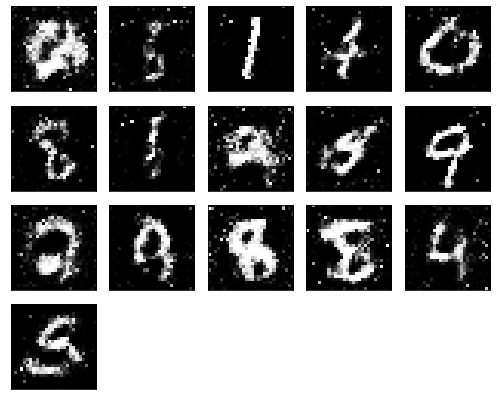

Epochs nb. 6861
discriminator loss: 0.5861427783966064
generator loss : 0.9747253060340881

Epochs nb. 6862
discriminator loss: 0.5558054447174072
generator loss : 1.1013563871383667

Epochs nb. 6863
discriminator loss: 0.5836703777313232
generator loss : 1.006401538848877

Epochs nb. 6864
discriminator loss: 0.5436656475067139
generator loss : 0.9814265370368958

Epochs nb. 6865
discriminator loss: 0.5494723320007324
generator loss : 0.8727395534515381

Epochs nb. 6866
discriminator loss: 0.5492189526557922
generator loss : 1.1469593048095703

Epochs nb. 6867
discriminator loss: 0.5862411260604858
generator loss : 0.8988518118858337

Epochs nb. 6868
discriminator loss: 0.5571856498718262
generator loss : 0.8499962091445923

Epochs nb. 6869
discriminator loss: 0.5062152147293091
generator loss : 0.9632128477096558

Epochs nb. 6870
discriminator loss: 0.6757892370223999
generator loss : 0.7236231565475464



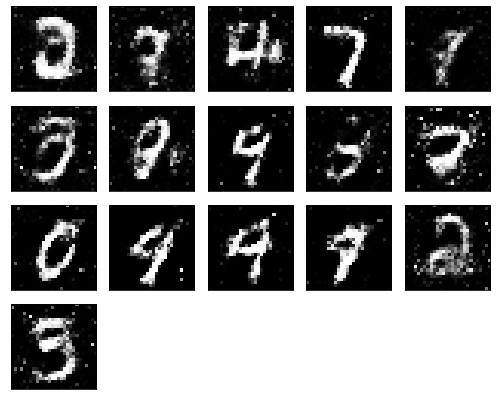

Epochs nb. 6871
discriminator loss: 0.4992447793483734
generator loss : 0.8332117795944214

Epochs nb. 6872
discriminator loss: 0.6130688190460205
generator loss : 0.9647989273071289

Epochs nb. 6873
discriminator loss: 0.5587180852890015
generator loss : 0.9748958945274353

Epochs nb. 6874
discriminator loss: 0.6335553526878357
generator loss : 1.0696043968200684

Epochs nb. 6875
discriminator loss: 0.5822417736053467
generator loss : 1.0891919136047363

Epochs nb. 6876
discriminator loss: 0.528236448764801
generator loss : 1.2367651462554932

Epochs nb. 6877
discriminator loss: 0.5888454914093018
generator loss : 1.1721454858779907

Epochs nb. 6878
discriminator loss: 0.6031545996665955
generator loss : 1.0422940254211426

Epochs nb. 6879
discriminator loss: 0.5669914484024048
generator loss : 0.9579647779464722

Epochs nb. 6880
discriminator loss: 0.5154845714569092
generator loss : 1.0447624921798706



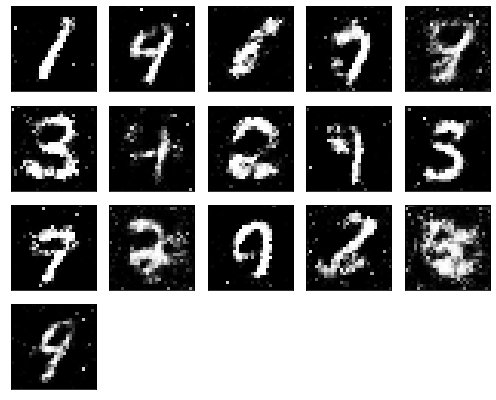

Epochs nb. 6881
discriminator loss: 0.5727330446243286
generator loss : 0.8624420166015625

Epochs nb. 6882
discriminator loss: 0.5772982835769653
generator loss : 1.1089601516723633

Epochs nb. 6883
discriminator loss: 0.6667975783348083
generator loss : 0.9925915598869324

Epochs nb. 6884
discriminator loss: 0.6383261680603027
generator loss : 0.9476543068885803

Epochs nb. 6885
discriminator loss: 0.6054043769836426
generator loss : 0.8777225613594055

Epochs nb. 6886
discriminator loss: 0.514754593372345
generator loss : 0.9470091462135315

Epochs nb. 6887
discriminator loss: 0.6292693614959717
generator loss : 1.1336565017700195

Epochs nb. 6888
discriminator loss: 0.6335616111755371
generator loss : 1.0187761783599854

Epochs nb. 6889
discriminator loss: 0.5669399499893188
generator loss : 1.1032142639160156

Epochs nb. 6890
discriminator loss: 0.547958493232727
generator loss : 1.2493032217025757



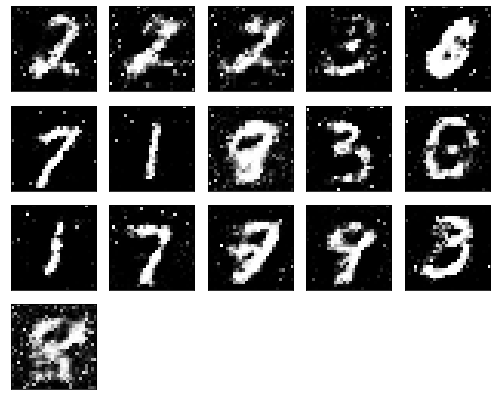

Epochs nb. 6891
discriminator loss: 0.7051299214363098
generator loss : 1.1050286293029785

Epochs nb. 6892
discriminator loss: 0.6138513088226318
generator loss : 1.0294315814971924

Epochs nb. 6893
discriminator loss: 0.5451257228851318
generator loss : 1.0353529453277588

Epochs nb. 6894
discriminator loss: 0.5510605573654175
generator loss : 1.1894172430038452

Epochs nb. 6895
discriminator loss: 0.7715318202972412
generator loss : 0.8557558059692383

Epochs nb. 6896
discriminator loss: 0.48804181814193726
generator loss : 0.8735421895980835

Epochs nb. 6897
discriminator loss: 0.5634293556213379
generator loss : 1.0352469682693481

Epochs nb. 6898
discriminator loss: 0.5412025451660156
generator loss : 1.010718584060669

Epochs nb. 6899
discriminator loss: 0.7380998730659485
generator loss : 1.1871399879455566

Epochs nb. 6900
discriminator loss: 0.6423419713973999
generator loss : 0.8440383076667786



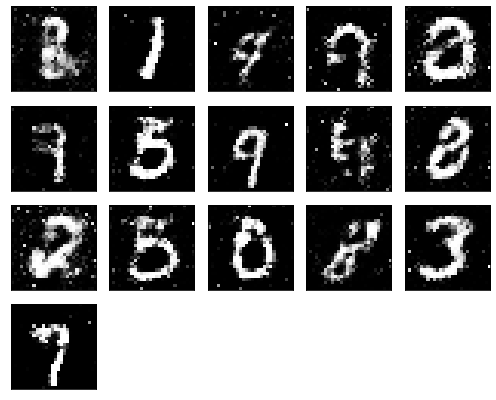

Epochs nb. 6901
discriminator loss: 0.49305087327957153
generator loss : 1.0460591316223145

Epochs nb. 6902
discriminator loss: 0.43522655963897705
generator loss : 1.0595139265060425

Epochs nb. 6903
discriminator loss: 0.6347938776016235
generator loss : 0.862114667892456

Epochs nb. 6904
discriminator loss: 0.6720168590545654
generator loss : 1.0411629676818848

Epochs nb. 6905
discriminator loss: 0.7039015293121338
generator loss : 0.8887124061584473

Epochs nb. 6906
discriminator loss: 0.6439498066902161
generator loss : 0.9743388891220093

Epochs nb. 6907
discriminator loss: 0.5216963291168213
generator loss : 0.900574803352356

Epochs nb. 6908
discriminator loss: 0.6152969598770142
generator loss : 1.037231206893921

Epochs nb. 6909
discriminator loss: 0.6841393709182739
generator loss : 1.0918173789978027

Epochs nb. 6910
discriminator loss: 0.4356634020805359
generator loss : 1.1867938041687012



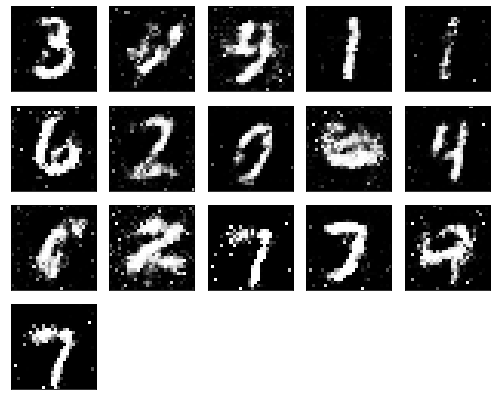

Epochs nb. 6911
discriminator loss: 0.6172257661819458
generator loss : 0.9509519934654236

Epochs nb. 6912
discriminator loss: 0.5233748555183411
generator loss : 1.06564462184906

Epochs nb. 6913
discriminator loss: 0.4659403860569
generator loss : 1.068847417831421

Epochs nb. 6914
discriminator loss: 0.6511460542678833
generator loss : 1.064401388168335

Epochs nb. 6915
discriminator loss: 0.6700452566146851
generator loss : 0.9917075634002686

Epochs nb. 6916
discriminator loss: 0.529381275177002
generator loss : 0.8769895434379578

Epochs nb. 6917
discriminator loss: 0.5087416172027588
generator loss : 0.8015182018280029

Epochs nb. 6918
discriminator loss: 0.6310717463493347
generator loss : 1.0958926677703857

Epochs nb. 6919
discriminator loss: 0.640724241733551
generator loss : 1.2064456939697266

Epochs nb. 6920
discriminator loss: 0.6465021371841431
generator loss : 0.9477048516273499



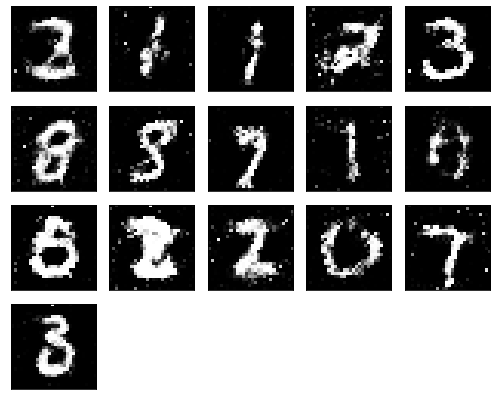

Epochs nb. 6921
discriminator loss: 0.7110370397567749
generator loss : 1.0261555910110474

Epochs nb. 6922
discriminator loss: 0.5673071146011353
generator loss : 0.8921429514884949

Epochs nb. 6923
discriminator loss: 0.6837721467018127
generator loss : 0.9806909561157227

Epochs nb. 6924
discriminator loss: 0.5358849167823792
generator loss : 0.9175193905830383

Epochs nb. 6925
discriminator loss: 0.5466180443763733
generator loss : 1.0852389335632324

Epochs nb. 6926
discriminator loss: 0.7408673167228699
generator loss : 1.0579296350479126

Epochs nb. 6927
discriminator loss: 0.5844210386276245
generator loss : 0.9476666450500488

Epochs nb. 6928
discriminator loss: 0.5142599940299988
generator loss : 0.9834939241409302

Epochs nb. 6929
discriminator loss: 0.5009143352508545
generator loss : 1.024144172668457

Epochs nb. 6930
discriminator loss: 0.6066774129867554
generator loss : 1.245091199874878



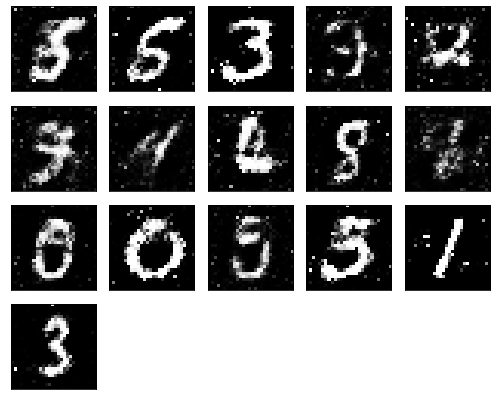

Epochs nb. 6931
discriminator loss: 0.6990818977355957
generator loss : 0.9313433170318604

Epochs nb. 6932
discriminator loss: 0.5517738461494446
generator loss : 1.0271522998809814

Epochs nb. 6933
discriminator loss: 0.5130242705345154
generator loss : 1.0910487174987793

Epochs nb. 6934
discriminator loss: 0.6276445388793945
generator loss : 0.9142711162567139

Epochs nb. 6935
discriminator loss: 0.5984706282615662
generator loss : 0.7820413112640381

Epochs nb. 6936
discriminator loss: 0.5251888632774353
generator loss : 0.9045650362968445

Epochs nb. 6937
discriminator loss: 0.655266523361206
generator loss : 1.003485918045044

Epochs nb. 6938
discriminator loss: 0.5772488117218018
generator loss : 1.0636916160583496

Epochs nb. 6939
discriminator loss: 0.6409866809844971
generator loss : 1.0584769248962402

Epochs nb. 6940
discriminator loss: 0.5985540151596069
generator loss : 0.8762016296386719



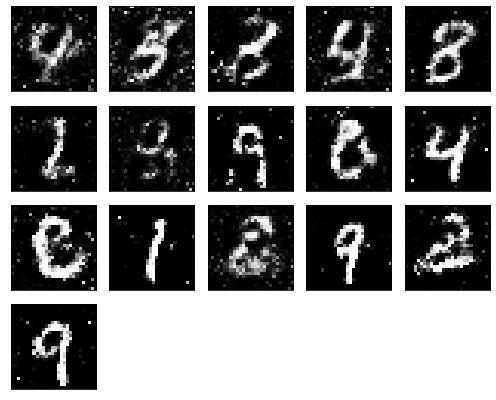

Epochs nb. 6941
discriminator loss: 0.5810781717300415
generator loss : 1.0052562952041626

Epochs nb. 6942
discriminator loss: 0.5779160261154175
generator loss : 1.0369384288787842

Epochs nb. 6943
discriminator loss: 0.6140317320823669
generator loss : 1.0704584121704102

Epochs nb. 6944
discriminator loss: 0.5994595289230347
generator loss : 1.100954294204712

Epochs nb. 6945
discriminator loss: 0.7595624923706055
generator loss : 0.9585344195365906

Epochs nb. 6946
discriminator loss: 0.49945345520973206
generator loss : 0.992184579372406

Epochs nb. 6947
discriminator loss: 0.5828617811203003
generator loss : 0.9372745752334595

Epochs nb. 6948
discriminator loss: 0.6661274433135986
generator loss : 1.1111564636230469

Epochs nb. 6949
discriminator loss: 0.5617035627365112
generator loss : 1.0725821256637573

Epochs nb. 6950
discriminator loss: 0.49536293745040894
generator loss : 0.8544116616249084



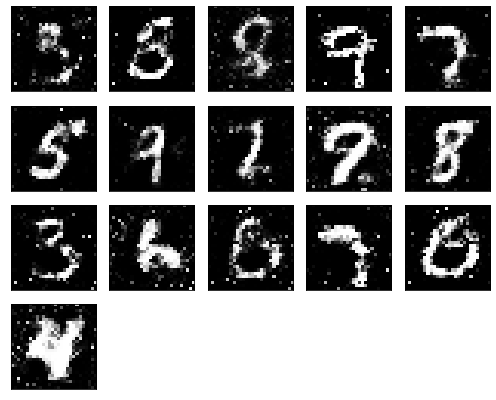

Epochs nb. 6951
discriminator loss: 0.4761512279510498
generator loss : 0.8709439039230347

Epochs nb. 6952
discriminator loss: 0.4754529297351837
generator loss : 0.7998547554016113

Epochs nb. 6953
discriminator loss: 0.5730363130569458
generator loss : 1.0001845359802246

Epochs nb. 6954
discriminator loss: 0.4864930212497711
generator loss : 1.1771390438079834

Epochs nb. 6955
discriminator loss: 0.45095622539520264
generator loss : 1.0578196048736572

Epochs nb. 6956
discriminator loss: 0.7340501546859741
generator loss : 1.1289772987365723

Epochs nb. 6957
discriminator loss: 0.5575953722000122
generator loss : 0.8802381157875061

Epochs nb. 6958
discriminator loss: 0.4871816635131836
generator loss : 1.063553810119629

Epochs nb. 6959
discriminator loss: 0.5768961310386658
generator loss : 0.7899999022483826

Epochs nb. 6960
discriminator loss: 0.598823070526123
generator loss : 0.9834921360015869



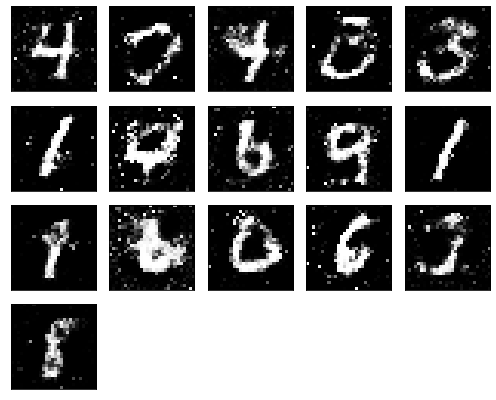

Epochs nb. 6961
discriminator loss: 0.5858267545700073
generator loss : 1.0083067417144775

Epochs nb. 6962
discriminator loss: 0.528162956237793
generator loss : 1.051577091217041

Epochs nb. 6963
discriminator loss: 0.6803464889526367
generator loss : 0.9538020491600037

Epochs nb. 6964
discriminator loss: 0.5221951007843018
generator loss : 1.0526994466781616

Epochs nb. 6965
discriminator loss: 0.7067162990570068
generator loss : 1.0350725650787354

Epochs nb. 6966
discriminator loss: 0.7423218488693237
generator loss : 1.0936684608459473

Epochs nb. 6967
discriminator loss: 0.5672125816345215
generator loss : 0.9954392313957214

Epochs nb. 6968
discriminator loss: 0.595133900642395
generator loss : 0.9090399742126465

Epochs nb. 6969
discriminator loss: 0.7311455011367798
generator loss : 1.0891332626342773

Epochs nb. 6970
discriminator loss: 0.5609301924705505
generator loss : 0.9718837738037109



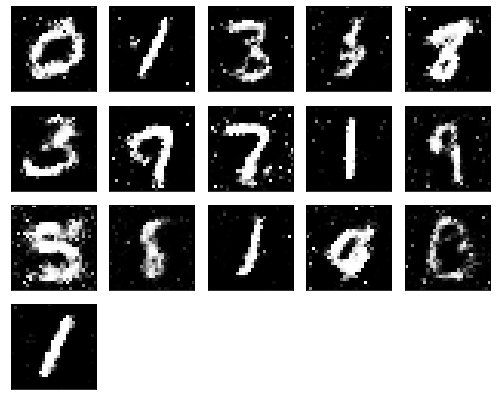

Epochs nb. 6971
discriminator loss: 0.5895931124687195
generator loss : 0.9891458749771118

Epochs nb. 6972
discriminator loss: 0.6216054558753967
generator loss : 1.013203501701355

Epochs nb. 6973
discriminator loss: 0.6032603979110718
generator loss : 1.136568546295166

Epochs nb. 6974
discriminator loss: 0.5625539422035217
generator loss : 1.071437120437622

Epochs nb. 6975
discriminator loss: 0.4789223372936249
generator loss : 0.8970400094985962

Epochs nb. 6976
discriminator loss: 0.639837384223938
generator loss : 0.942065417766571

Epochs nb. 6977
discriminator loss: 0.6061968803405762
generator loss : 1.1060585975646973

Epochs nb. 6978
discriminator loss: 0.6459512710571289
generator loss : 0.8849742412567139

Epochs nb. 6979
discriminator loss: 0.5370379686355591
generator loss : 1.09356689453125

Epochs nb. 6980
discriminator loss: 0.6926584243774414
generator loss : 1.3121435642242432



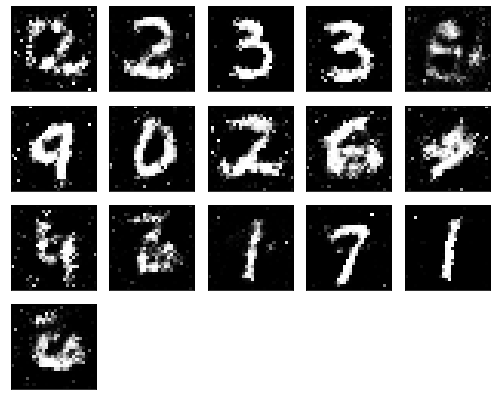

Epochs nb. 6981
discriminator loss: 0.5738515853881836
generator loss : 0.9874188899993896

Epochs nb. 6982
discriminator loss: 0.5703787803649902
generator loss : 0.9611363410949707

Epochs nb. 6983
discriminator loss: 0.6315966844558716
generator loss : 1.020927906036377

Epochs nb. 6984
discriminator loss: 0.649819016456604
generator loss : 0.7709358334541321

Epochs nb. 6985
discriminator loss: 0.7465863227844238
generator loss : 0.8509213328361511

Epochs nb. 6986
discriminator loss: 0.6510428190231323
generator loss : 0.8851689100265503

Epochs nb. 6987
discriminator loss: 0.5607874393463135
generator loss : 0.8377792239189148

Epochs nb. 6988
discriminator loss: 0.5749183893203735
generator loss : 1.0111284255981445

Epochs nb. 6989
discriminator loss: 0.5983167290687561
generator loss : 0.9032222032546997

Epochs nb. 6990
discriminator loss: 0.6059737801551819
generator loss : 1.0553029775619507



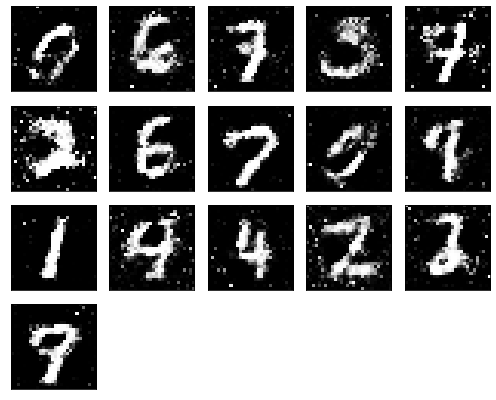

Epochs nb. 6991
discriminator loss: 0.5679503679275513
generator loss : 1.0260963439941406

Epochs nb. 6992
discriminator loss: 0.569475531578064
generator loss : 1.0138821601867676

Epochs nb. 6993
discriminator loss: 0.5857393145561218
generator loss : 0.9129979610443115

Epochs nb. 6994
discriminator loss: 0.5729886293411255
generator loss : 1.0194731950759888

Epochs nb. 6995
discriminator loss: 0.6452895998954773
generator loss : 1.1712054014205933

Epochs nb. 6996
discriminator loss: 0.6691404581069946
generator loss : 0.9909553527832031

Epochs nb. 6997
discriminator loss: 0.5599453449249268
generator loss : 0.834243893623352

Epochs nb. 6998
discriminator loss: 0.5840285420417786
generator loss : 0.9729534387588501

Epochs nb. 6999
discriminator loss: 0.47089606523513794
generator loss : 0.9673548936843872

Epochs nb. 7000
discriminator loss: 0.632221519947052
generator loss : 1.110621452331543



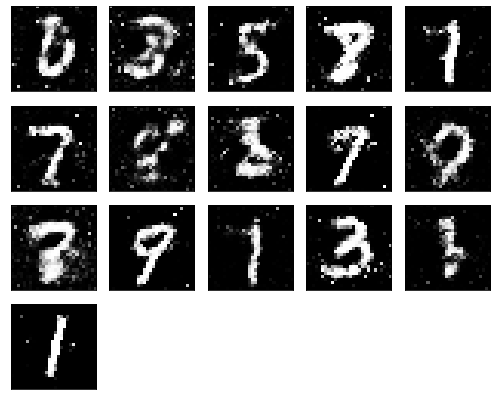

Epochs nb. 7001
discriminator loss: 0.5646085739135742
generator loss : 1.0339066982269287

Epochs nb. 7002
discriminator loss: 0.8218812942504883
generator loss : 0.8048986196517944

Epochs nb. 7003
discriminator loss: 0.5340977907180786
generator loss : 0.8108536005020142

Epochs nb. 7004
discriminator loss: 0.6916196346282959
generator loss : 1.017615795135498

Epochs nb. 7005
discriminator loss: 0.6369678974151611
generator loss : 1.0585159063339233

Epochs nb. 7006
discriminator loss: 0.5564018487930298
generator loss : 0.922370433807373

Epochs nb. 7007
discriminator loss: 0.5314760208129883
generator loss : 1.006048560142517

Epochs nb. 7008
discriminator loss: 0.48270630836486816
generator loss : 1.0209015607833862

Epochs nb. 7009
discriminator loss: 0.5717989802360535
generator loss : 1.0372611284255981

Epochs nb. 7010
discriminator loss: 0.5062854290008545
generator loss : 0.8391303420066833



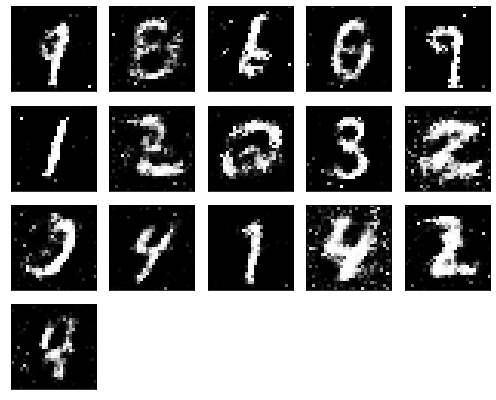

Epochs nb. 7011
discriminator loss: 0.633212149143219
generator loss : 0.7178876399993896

Epochs nb. 7012
discriminator loss: 0.6532696485519409
generator loss : 0.7981671690940857

Epochs nb. 7013
discriminator loss: 0.5404039621353149
generator loss : 0.9701533317565918

Epochs nb. 7014
discriminator loss: 0.5034452676773071
generator loss : 0.9379197955131531

Epochs nb. 7015
discriminator loss: 0.5568702220916748
generator loss : 0.9360799789428711

Epochs nb. 7016
discriminator loss: 0.5464467406272888
generator loss : 0.8909826278686523

Epochs nb. 7017
discriminator loss: 0.6528539657592773
generator loss : 0.9438164234161377

Epochs nb. 7018
discriminator loss: 0.5351197719573975
generator loss : 1.1260185241699219

Epochs nb. 7019
discriminator loss: 0.5599098205566406
generator loss : 0.9650397896766663

Epochs nb. 7020
discriminator loss: 0.5244982242584229
generator loss : 0.8767009973526001



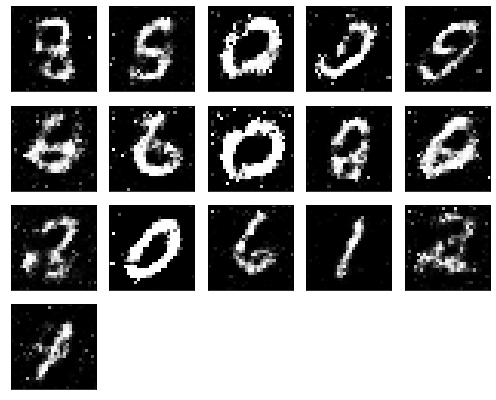

Epochs nb. 7021
discriminator loss: 0.576542854309082
generator loss : 0.9964531064033508

Epochs nb. 7022
discriminator loss: 0.6458277702331543
generator loss : 0.8491840362548828

Epochs nb. 7023
discriminator loss: 0.6733564138412476
generator loss : 0.9792787432670593

Epochs nb. 7024
discriminator loss: 0.5445754528045654
generator loss : 1.113290786743164

Epochs nb. 7025
discriminator loss: 0.6508527398109436
generator loss : 0.8987257480621338

Epochs nb. 7026
discriminator loss: 0.6721460223197937
generator loss : 0.844006359577179

Epochs nb. 7027
discriminator loss: 0.6189445853233337
generator loss : 1.031168818473816

Epochs nb. 7028
discriminator loss: 0.552916407585144
generator loss : 1.2657279968261719

Epochs nb. 7029
discriminator loss: 0.5187238454818726
generator loss : 1.1611658334732056

Epochs nb. 7030
discriminator loss: 0.5474900603294373
generator loss : 0.7255055904388428



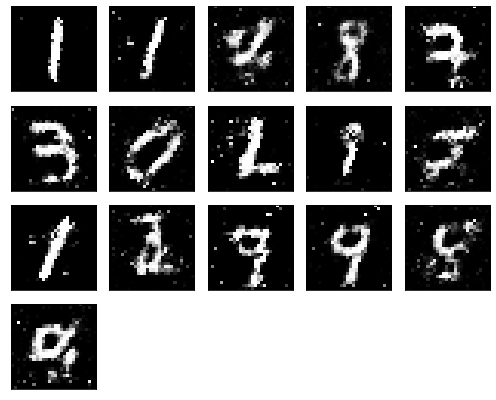

Epochs nb. 7031
discriminator loss: 0.6271561980247498
generator loss : 0.8553858995437622

Epochs nb. 7032
discriminator loss: 0.6728329658508301
generator loss : 0.7468186616897583

Epochs nb. 7033
discriminator loss: 0.569976806640625
generator loss : 1.246189832687378

Epochs nb. 7034
discriminator loss: 0.5716176629066467
generator loss : 0.9004911184310913

Epochs nb. 7035
discriminator loss: 0.6133224368095398
generator loss : 0.8327743411064148

Epochs nb. 7036
discriminator loss: 0.6501755714416504
generator loss : 0.9544408917427063

Epochs nb. 7037
discriminator loss: 0.5559477210044861
generator loss : 0.8420495986938477

Epochs nb. 7038
discriminator loss: 0.6889399290084839
generator loss : 0.7486536502838135

Epochs nb. 7039
discriminator loss: 0.7269688248634338
generator loss : 1.0193051099777222

Epochs nb. 7040
discriminator loss: 0.5076032876968384
generator loss : 0.8329346776008606



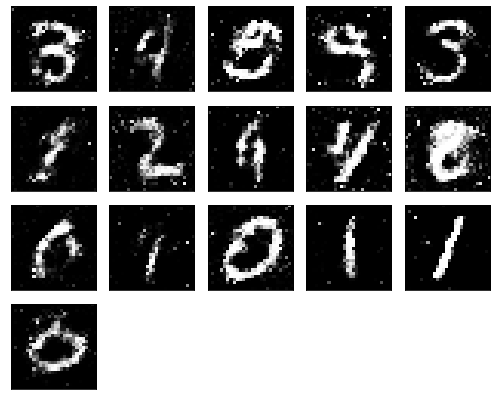

Epochs nb. 7041
discriminator loss: 0.681344211101532
generator loss : 1.0417022705078125

Epochs nb. 7042
discriminator loss: 0.6866814494132996
generator loss : 1.1389167308807373

Epochs nb. 7043
discriminator loss: 0.6494653224945068
generator loss : 1.0193511247634888

Epochs nb. 7044
discriminator loss: 0.6522710919380188
generator loss : 1.0065386295318604

Epochs nb. 7045
discriminator loss: 0.5409194231033325
generator loss : 1.0848890542984009

Epochs nb. 7046
discriminator loss: 0.4802035689353943
generator loss : 0.9556201696395874

Epochs nb. 7047
discriminator loss: 0.7289749979972839
generator loss : 1.183995246887207

Epochs nb. 7048
discriminator loss: 0.5497763156890869
generator loss : 1.0642942190170288

Epochs nb. 7049
discriminator loss: 0.7167500257492065
generator loss : 0.9626041650772095

Epochs nb. 7050
discriminator loss: 0.6503998637199402
generator loss : 1.176960825920105



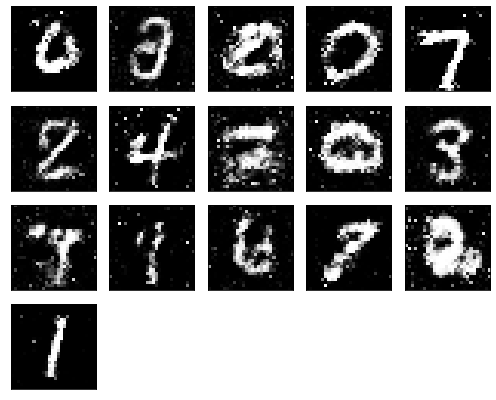

Epochs nb. 7051
discriminator loss: 0.5957915782928467
generator loss : 1.1544263362884521

Epochs nb. 7052
discriminator loss: 0.572214663028717
generator loss : 0.8544670343399048

Epochs nb. 7053
discriminator loss: 0.5353319644927979
generator loss : 1.057500958442688

Epochs nb. 7054
discriminator loss: 0.6560676097869873
generator loss : 1.0359076261520386

Epochs nb. 7055
discriminator loss: 0.5939939618110657
generator loss : 0.9940096735954285

Epochs nb. 7056
discriminator loss: 0.5880019068717957
generator loss : 1.0493119955062866

Epochs nb. 7057
discriminator loss: 0.5718944072723389
generator loss : 1.1474940776824951

Epochs nb. 7058
discriminator loss: 0.5639138221740723
generator loss : 1.1017502546310425

Epochs nb. 7059
discriminator loss: 0.6892340779304504
generator loss : 1.0862948894500732

Epochs nb. 7060
discriminator loss: 0.4470464885234833
generator loss : 1.0700914859771729



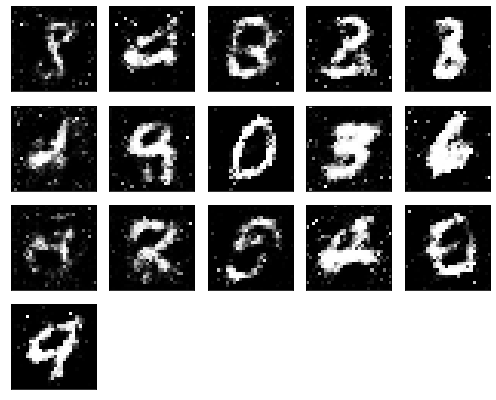

Epochs nb. 7061
discriminator loss: 0.6250156164169312
generator loss : 0.9860589504241943

Epochs nb. 7062
discriminator loss: 0.6397658586502075
generator loss : 1.0826518535614014

Epochs nb. 7063
discriminator loss: 0.6252272129058838
generator loss : 1.053067684173584

Epochs nb. 7064
discriminator loss: 0.5689623355865479
generator loss : 1.178748369216919

Epochs nb. 7065
discriminator loss: 0.6183717250823975
generator loss : 1.2080745697021484

Epochs nb. 7066
discriminator loss: 0.5877583622932434
generator loss : 1.0008749961853027

Epochs nb. 7067
discriminator loss: 0.6122652292251587
generator loss : 1.0328071117401123

Epochs nb. 7068
discriminator loss: 0.5977323055267334
generator loss : 1.0833101272583008

Epochs nb. 7069
discriminator loss: 0.603218674659729
generator loss : 1.2033095359802246

Epochs nb. 7070
discriminator loss: 0.4363768398761749
generator loss : 1.0003911256790161



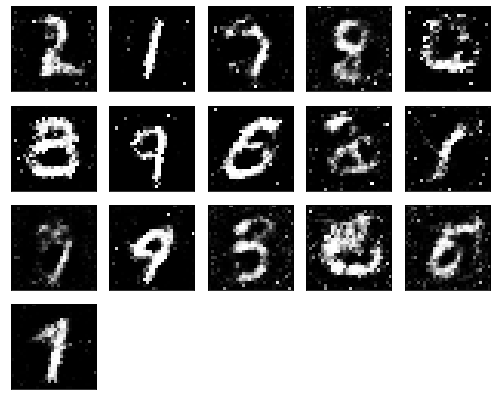

Epochs nb. 7071
discriminator loss: 0.6616666913032532
generator loss : 1.2351969480514526

Epochs nb. 7072
discriminator loss: 0.7051435708999634
generator loss : 1.192229986190796

Epochs nb. 7073
discriminator loss: 0.530862033367157
generator loss : 1.1236106157302856

Epochs nb. 7074
discriminator loss: 0.6088747978210449
generator loss : 1.142137885093689

Epochs nb. 7075
discriminator loss: 0.6252894401550293
generator loss : 1.1074750423431396

Epochs nb. 7076
discriminator loss: 0.6292436122894287
generator loss : 0.9813367128372192

Epochs nb. 7077
discriminator loss: 0.7203664183616638
generator loss : 0.9059492349624634

Epochs nb. 7078
discriminator loss: 0.6990319490432739
generator loss : 1.0475603342056274

Epochs nb. 7079
discriminator loss: 0.6363877654075623
generator loss : 0.7653024196624756

Epochs nb. 7080
discriminator loss: 0.702414333820343
generator loss : 0.8629148006439209



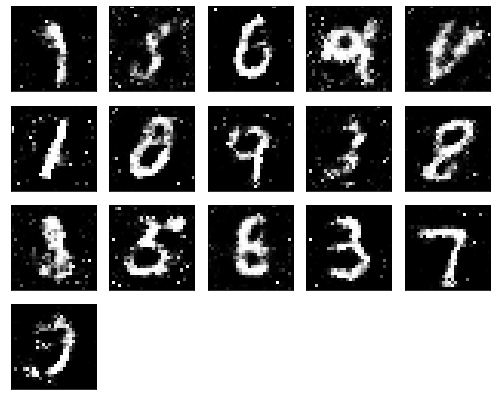

Epochs nb. 7081
discriminator loss: 0.6271905303001404
generator loss : 0.7964121103286743

Epochs nb. 7082
discriminator loss: 0.6333175301551819
generator loss : 0.8569139838218689

Epochs nb. 7083
discriminator loss: 0.6304727792739868
generator loss : 0.9485548734664917

Epochs nb. 7084
discriminator loss: 0.686652660369873
generator loss : 0.9746465682983398

Epochs nb. 7085
discriminator loss: 0.541289210319519
generator loss : 0.9559173583984375

Epochs nb. 7086
discriminator loss: 0.6259887218475342
generator loss : 1.0942187309265137

Epochs nb. 7087
discriminator loss: 0.5046918392181396
generator loss : 0.8541526794433594

Epochs nb. 7088
discriminator loss: 0.5734111070632935
generator loss : 0.9429528713226318

Epochs nb. 7089
discriminator loss: 0.6972784399986267
generator loss : 0.9957387447357178

Epochs nb. 7090
discriminator loss: 0.5067188739776611
generator loss : 1.0177510976791382



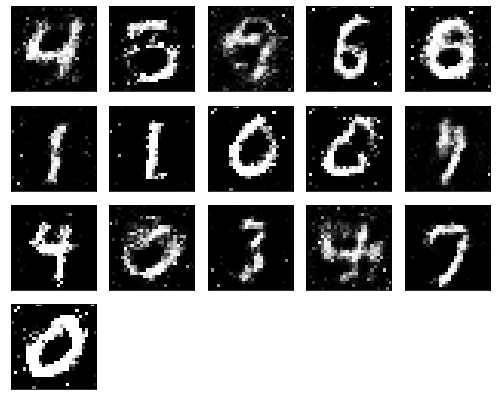

Epochs nb. 7091
discriminator loss: 0.5392354726791382
generator loss : 1.1683990955352783

Epochs nb. 7092
discriminator loss: 0.596910834312439
generator loss : 0.9272743463516235

Epochs nb. 7093
discriminator loss: 0.5707541704177856
generator loss : 0.8305139541625977

Epochs nb. 7094
discriminator loss: 0.6314709186553955
generator loss : 0.8535219430923462

Epochs nb. 7095
discriminator loss: 0.5590167045593262
generator loss : 0.8952026963233948

Epochs nb. 7096
discriminator loss: 0.6182884573936462
generator loss : 0.9861915111541748

Epochs nb. 7097
discriminator loss: 0.6033868789672852
generator loss : 0.9080785512924194

Epochs nb. 7098
discriminator loss: 0.6396728754043579
generator loss : 1.2058000564575195

Epochs nb. 7099
discriminator loss: 0.5920918583869934
generator loss : 1.120208740234375

Epochs nb. 7100
discriminator loss: 0.5395753979682922
generator loss : 1.275959849357605



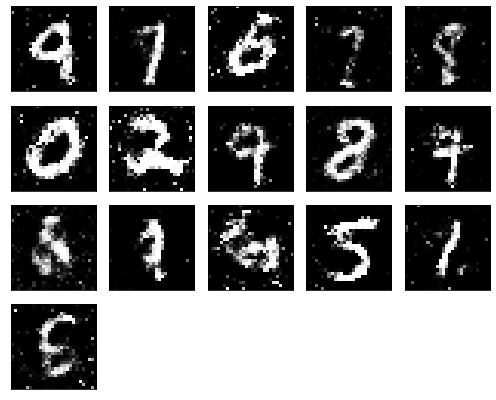

Epochs nb. 7101
discriminator loss: 0.5345840454101562
generator loss : 0.9196151494979858

Epochs nb. 7102
discriminator loss: 0.6014292240142822
generator loss : 0.9335030317306519

Epochs nb. 7103
discriminator loss: 0.7268390655517578
generator loss : 0.9817072153091431

Epochs nb. 7104
discriminator loss: 0.503092885017395
generator loss : 1.0071847438812256

Epochs nb. 7105
discriminator loss: 0.5726357698440552
generator loss : 1.038949728012085

Epochs nb. 7106
discriminator loss: 0.47594404220581055
generator loss : 1.1403807401657104

Epochs nb. 7107
discriminator loss: 0.5591460466384888
generator loss : 0.9981051087379456

Epochs nb. 7108
discriminator loss: 0.600864052772522
generator loss : 1.0600824356079102

Epochs nb. 7109
discriminator loss: 0.5608575940132141
generator loss : 0.9776661396026611

Epochs nb. 7110
discriminator loss: 0.5650995969772339
generator loss : 0.9579805135726929



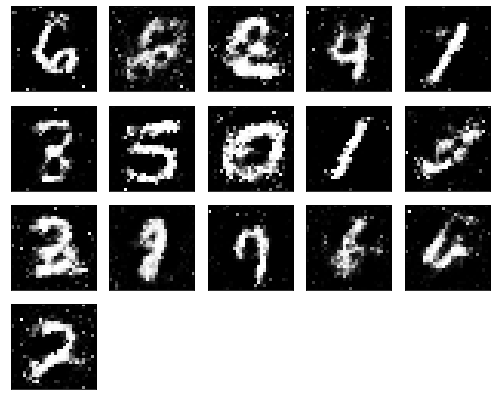

Epochs nb. 7111
discriminator loss: 0.5868790149688721
generator loss : 1.0477111339569092

Epochs nb. 7112
discriminator loss: 0.6235693693161011
generator loss : 1.0172793865203857

Epochs nb. 7113
discriminator loss: 0.7129889726638794
generator loss : 0.9748519062995911

Epochs nb. 7114
discriminator loss: 0.7283591628074646
generator loss : 1.017130732536316

Epochs nb. 7115
discriminator loss: 0.5351287722587585
generator loss : 1.1724679470062256

Epochs nb. 7116
discriminator loss: 0.7238309383392334
generator loss : 1.0233092308044434

Epochs nb. 7117
discriminator loss: 0.7640002965927124
generator loss : 1.044775128364563

Epochs nb. 7118
discriminator loss: 0.5385436415672302
generator loss : 1.0009682178497314

Epochs nb. 7119
discriminator loss: 0.5717399716377258
generator loss : 0.8144704699516296

Epochs nb. 7120
discriminator loss: 0.5212957859039307
generator loss : 1.0465596914291382



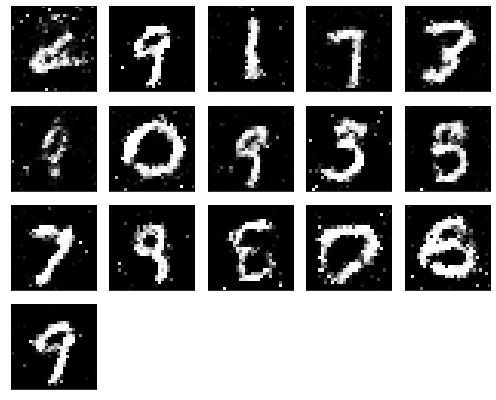

Epochs nb. 7121
discriminator loss: 0.5095887184143066
generator loss : 0.9870518445968628

Epochs nb. 7122
discriminator loss: 0.6372429132461548
generator loss : 1.177207350730896

Epochs nb. 7123
discriminator loss: 0.7306912541389465
generator loss : 1.0557997226715088

Epochs nb. 7124
discriminator loss: 0.5471383333206177
generator loss : 1.0379724502563477

Epochs nb. 7125
discriminator loss: 0.5315585136413574
generator loss : 1.073145866394043

Epochs nb. 7126
discriminator loss: 0.5481101274490356
generator loss : 1.0936799049377441

Epochs nb. 7127
discriminator loss: 0.7107304334640503
generator loss : 1.1344516277313232

Epochs nb. 7128
discriminator loss: 0.47987207770347595
generator loss : 1.0577054023742676

Epochs nb. 7129
discriminator loss: 0.5663214921951294
generator loss : 0.9717038869857788

Epochs nb. 7130
discriminator loss: 0.5316442847251892
generator loss : 1.1887719631195068



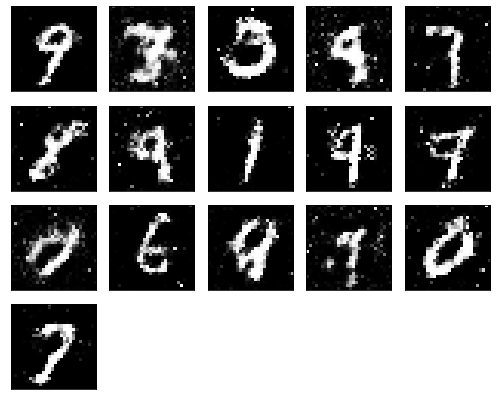

Epochs nb. 7131
discriminator loss: 0.5746921300888062
generator loss : 0.9493765830993652

Epochs nb. 7132
discriminator loss: 0.7967959642410278
generator loss : 0.9689158797264099

Epochs nb. 7133
discriminator loss: 0.6088113784790039
generator loss : 1.1158993244171143

Epochs nb. 7134
discriminator loss: 0.7313355207443237
generator loss : 0.9732188582420349

Epochs nb. 7135
discriminator loss: 0.5577613115310669
generator loss : 1.1202863454818726

Epochs nb. 7136
discriminator loss: 0.5988566875457764
generator loss : 1.0920360088348389

Epochs nb. 7137
discriminator loss: 0.5790361166000366
generator loss : 1.2137141227722168

Epochs nb. 7138
discriminator loss: 0.6939699053764343
generator loss : 0.9731470346450806

Epochs nb. 7139
discriminator loss: 0.5223550796508789
generator loss : 0.9993703365325928

Epochs nb. 7140
discriminator loss: 0.5358757972717285
generator loss : 0.9155232906341553



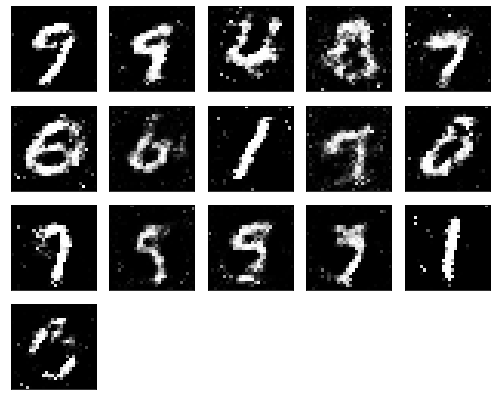

Epochs nb. 7141
discriminator loss: 0.5332252979278564
generator loss : 0.9667192697525024

Epochs nb. 7142
discriminator loss: 0.5632356405258179
generator loss : 1.025500774383545

Epochs nb. 7143
discriminator loss: 0.5440511703491211
generator loss : 0.904097318649292

Epochs nb. 7144
discriminator loss: 0.5876159071922302
generator loss : 1.120776653289795

Epochs nb. 7145
discriminator loss: 0.4781782031059265
generator loss : 1.030705213546753

Epochs nb. 7146
discriminator loss: 0.5782685875892639
generator loss : 0.9771463871002197

Epochs nb. 7147
discriminator loss: 0.6999746561050415
generator loss : 1.069927453994751

Epochs nb. 7148
discriminator loss: 0.5200966000556946
generator loss : 1.1146355867385864

Epochs nb. 7149
discriminator loss: 0.5669185519218445
generator loss : 0.9847087264060974

Epochs nb. 7150
discriminator loss: 0.5061898827552795
generator loss : 0.7789784073829651



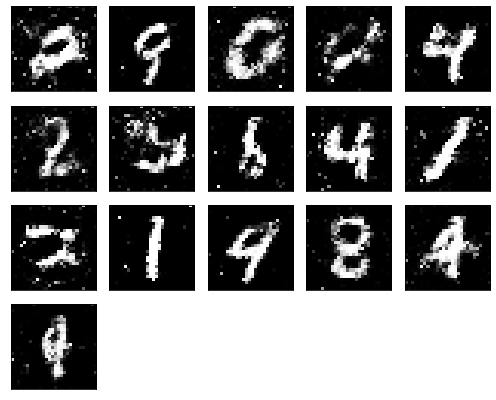

Epochs nb. 7151
discriminator loss: 0.39893949031829834
generator loss : 1.046954870223999

Epochs nb. 7152
discriminator loss: 0.8760581016540527
generator loss : 1.0525531768798828

Epochs nb. 7153
discriminator loss: 0.5573819875717163
generator loss : 1.1549590826034546

Epochs nb. 7154
discriminator loss: 0.6483978629112244
generator loss : 0.8075324892997742

Epochs nb. 7155
discriminator loss: 0.46984484791755676
generator loss : 0.8296829462051392

Epochs nb. 7156
discriminator loss: 0.6177935004234314
generator loss : 0.9096997976303101

Epochs nb. 7157
discriminator loss: 0.6871808171272278
generator loss : 0.9028868675231934

Epochs nb. 7158
discriminator loss: 0.6944600343704224
generator loss : 0.9630568623542786

Epochs nb. 7159
discriminator loss: 0.4860025644302368
generator loss : 1.015553593635559

Epochs nb. 7160
discriminator loss: 0.6179240942001343
generator loss : 1.1939435005187988



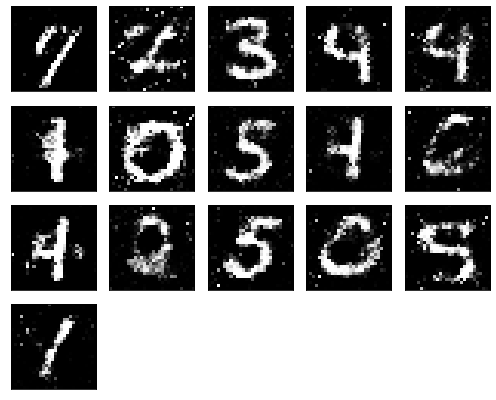

Epochs nb. 7161
discriminator loss: 0.5146123170852661
generator loss : 0.8708422183990479

Epochs nb. 7162
discriminator loss: 0.6063281297683716
generator loss : 0.9380197525024414

Epochs nb. 7163
discriminator loss: 0.6191318035125732
generator loss : 0.8181525468826294

Epochs nb. 7164
discriminator loss: 0.6372662782669067
generator loss : 1.1298110485076904

Epochs nb. 7165
discriminator loss: 0.5939455628395081
generator loss : 0.9593250155448914

Epochs nb. 7166
discriminator loss: 0.4994770884513855
generator loss : 1.0176746845245361

Epochs nb. 7167
discriminator loss: 0.5446345210075378
generator loss : 1.0034003257751465

Epochs nb. 7168
discriminator loss: 0.6699533462524414
generator loss : 1.1076278686523438

Epochs nb. 7169
discriminator loss: 0.7284238934516907
generator loss : 1.319115161895752

Epochs nb. 7170
discriminator loss: 0.5381364822387695
generator loss : 1.1879898309707642



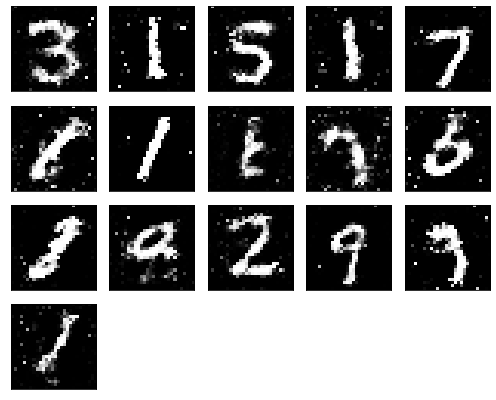

Epochs nb. 7171
discriminator loss: 0.5456088781356812
generator loss : 1.0244593620300293

Epochs nb. 7172
discriminator loss: 0.7315633893013
generator loss : 1.0470798015594482

Epochs nb. 7173
discriminator loss: 0.5387920141220093
generator loss : 0.9287052154541016

Epochs nb. 7174
discriminator loss: 0.576496958732605
generator loss : 1.0303986072540283

Epochs nb. 7175
discriminator loss: 0.5563721656799316
generator loss : 0.9970666170120239

Epochs nb. 7176
discriminator loss: 0.6589319109916687
generator loss : 1.026465654373169

Epochs nb. 7177
discriminator loss: 0.6469351053237915
generator loss : 0.9421795010566711

Epochs nb. 7178
discriminator loss: 0.5621080994606018
generator loss : 0.8661264181137085

Epochs nb. 7179
discriminator loss: 0.663199782371521
generator loss : 1.1041581630706787

Epochs nb. 7180
discriminator loss: 0.5531494617462158
generator loss : 1.0945014953613281



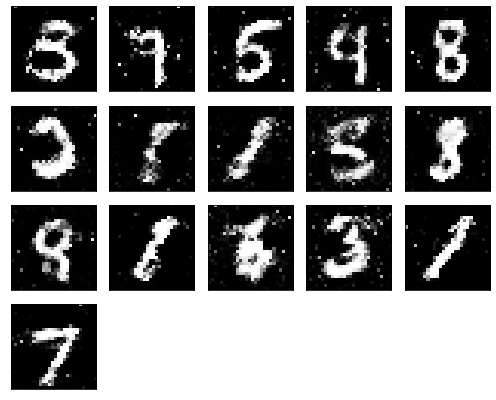

Epochs nb. 7181
discriminator loss: 0.5120573043823242
generator loss : 0.8949050307273865

Epochs nb. 7182
discriminator loss: 0.5233168601989746
generator loss : 0.9598923921585083

Epochs nb. 7183
discriminator loss: 0.6936734914779663
generator loss : 0.8701044321060181

Epochs nb. 7184
discriminator loss: 0.7333307266235352
generator loss : 1.175449013710022

Epochs nb. 7185
discriminator loss: 0.6156643629074097
generator loss : 0.9615373611450195

Epochs nb. 7186
discriminator loss: 0.6211784482002258
generator loss : 1.0448709726333618

Epochs nb. 7187
discriminator loss: 0.6320639848709106
generator loss : 0.8981068134307861

Epochs nb. 7188
discriminator loss: 0.5426890850067139
generator loss : 0.9454681277275085

Epochs nb. 7189
discriminator loss: 0.5471330881118774
generator loss : 0.9191155433654785

Epochs nb. 7190
discriminator loss: 0.7174302339553833
generator loss : 0.851364016532898



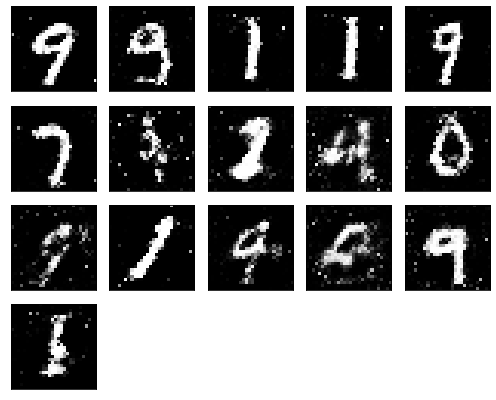

Epochs nb. 7191
discriminator loss: 0.5411317348480225
generator loss : 0.9858429431915283

Epochs nb. 7192
discriminator loss: 0.5364720225334167
generator loss : 0.9829075932502747

Epochs nb. 7193
discriminator loss: 0.6781021356582642
generator loss : 0.8039876222610474

Epochs nb. 7194
discriminator loss: 0.6208559274673462
generator loss : 0.8363242149353027

Epochs nb. 7195
discriminator loss: 0.7241227626800537
generator loss : 0.7667081952095032

Epochs nb. 7196
discriminator loss: 0.641880214214325
generator loss : 0.9847262501716614

Epochs nb. 7197
discriminator loss: 0.452559232711792
generator loss : 0.9753152132034302

Epochs nb. 7198
discriminator loss: 0.7768665552139282
generator loss : 0.977885365486145

Epochs nb. 7199
discriminator loss: 0.6892309784889221
generator loss : 0.9866048097610474

Epochs nb. 7200
discriminator loss: 0.5614532232284546
generator loss : 0.9004936218261719



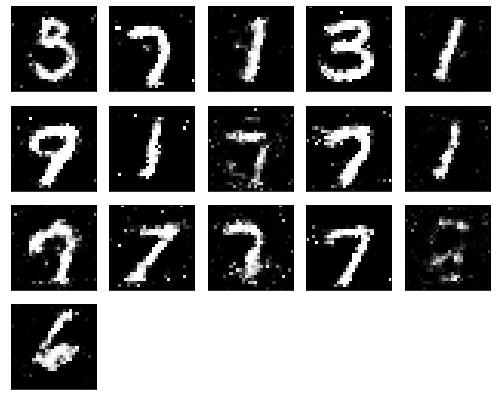

Epochs nb. 7201
discriminator loss: 0.5702959299087524
generator loss : 0.8898321390151978

Epochs nb. 7202
discriminator loss: 0.5303075909614563
generator loss : 1.0036110877990723

Epochs nb. 7203
discriminator loss: 0.6213182806968689
generator loss : 1.054816484451294

Epochs nb. 7204
discriminator loss: 0.4988490045070648
generator loss : 0.9212130904197693

Epochs nb. 7205
discriminator loss: 0.6880450248718262
generator loss : 1.121687412261963

Epochs nb. 7206
discriminator loss: 0.5745648145675659
generator loss : 1.1158480644226074

Epochs nb. 7207
discriminator loss: 0.6646040678024292
generator loss : 0.9722582101821899

Epochs nb. 7208
discriminator loss: 0.5988134145736694
generator loss : 1.1355760097503662

Epochs nb. 7209
discriminator loss: 0.7475767135620117
generator loss : 0.9100968837738037

Epochs nb. 7210
discriminator loss: 0.49306216835975647
generator loss : 1.0326776504516602



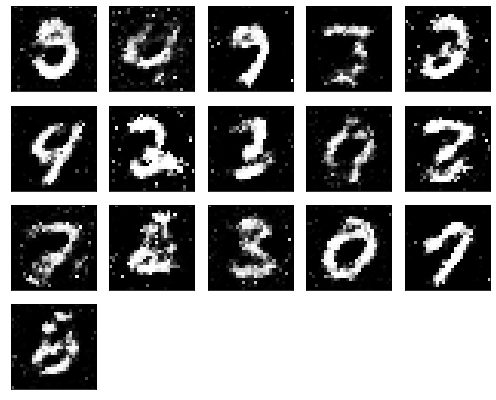

Epochs nb. 7211
discriminator loss: 0.590994656085968
generator loss : 0.9220831394195557

Epochs nb. 7212
discriminator loss: 0.5495975017547607
generator loss : 1.017893671989441

Epochs nb. 7213
discriminator loss: 0.4727228581905365
generator loss : 1.1294586658477783

Epochs nb. 7214
discriminator loss: 0.5032210350036621
generator loss : 0.9800912141799927

Epochs nb. 7215
discriminator loss: 0.5843784809112549
generator loss : 1.079787254333496

Epochs nb. 7216
discriminator loss: 0.6278350949287415
generator loss : 0.9160494804382324

Epochs nb. 7217
discriminator loss: 0.5036041736602783
generator loss : 0.9290739893913269

Epochs nb. 7218
discriminator loss: 0.5345717072486877
generator loss : 0.9411307573318481

Epochs nb. 7219
discriminator loss: 0.6069068908691406
generator loss : 1.0218068361282349

Epochs nb. 7220
discriminator loss: 0.6220500469207764
generator loss : 1.062579870223999



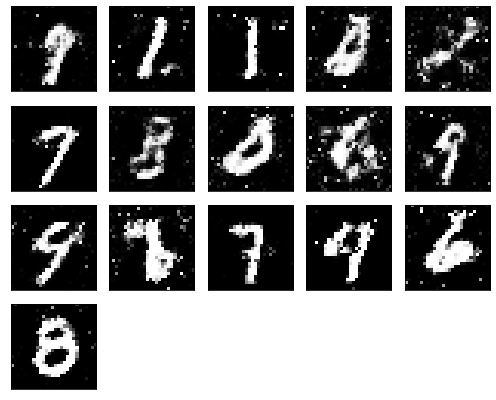

Epochs nb. 7221
discriminator loss: 0.5956569910049438
generator loss : 1.0964637994766235

Epochs nb. 7222
discriminator loss: 0.5658206939697266
generator loss : 1.177506923675537

Epochs nb. 7223
discriminator loss: 0.5355143547058105
generator loss : 0.9426497220993042

Epochs nb. 7224
discriminator loss: 0.695952296257019
generator loss : 1.0322376489639282

Epochs nb. 7225
discriminator loss: 0.6897958517074585
generator loss : 1.1444122791290283

Epochs nb. 7226
discriminator loss: 0.6900010108947754
generator loss : 1.0139340162277222

Epochs nb. 7227
discriminator loss: 0.6601872444152832
generator loss : 0.9319126009941101

Epochs nb. 7228
discriminator loss: 0.5454627275466919
generator loss : 0.7559237480163574

Epochs nb. 7229
discriminator loss: 0.7314169406890869
generator loss : 0.9910948872566223

Epochs nb. 7230
discriminator loss: 0.6971341967582703
generator loss : 0.8351854681968689



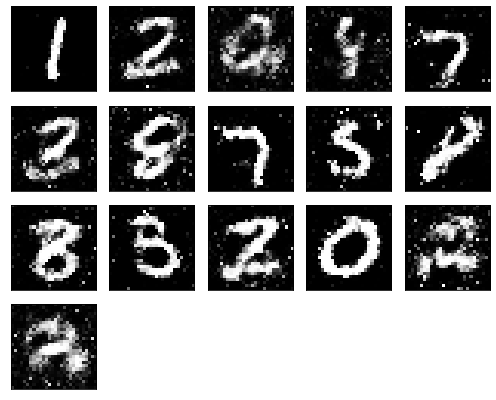

Epochs nb. 7231
discriminator loss: 0.6707320809364319
generator loss : 0.9496744871139526

Epochs nb. 7232
discriminator loss: 0.6338371634483337
generator loss : 0.9324155449867249

Epochs nb. 7233
discriminator loss: 0.5164300799369812
generator loss : 1.0195988416671753

Epochs nb. 7234
discriminator loss: 0.5674437284469604
generator loss : 1.0827348232269287

Epochs nb. 7235
discriminator loss: 0.5829804539680481
generator loss : 1.006034255027771

Epochs nb. 7236
discriminator loss: 0.5591012835502625
generator loss : 1.0902228355407715

Epochs nb. 7237
discriminator loss: 0.5372331142425537
generator loss : 0.9506142735481262

Epochs nb. 7238
discriminator loss: 0.6616400480270386
generator loss : 0.912335216999054

Epochs nb. 7239
discriminator loss: 0.46816742420196533
generator loss : 0.8937218189239502

Epochs nb. 7240
discriminator loss: 0.5621345043182373
generator loss : 1.1470636129379272



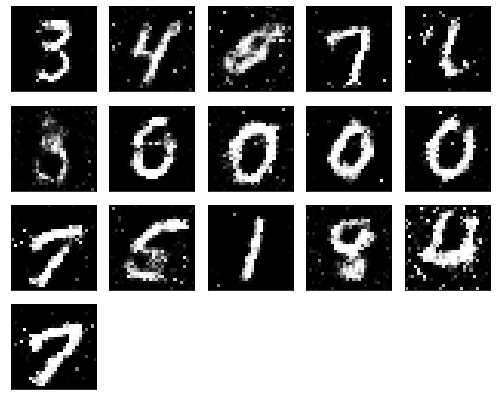

Epochs nb. 7241
discriminator loss: 0.6882202625274658
generator loss : 1.1050853729248047

Epochs nb. 7242
discriminator loss: 0.6224183440208435
generator loss : 0.8374865651130676

Epochs nb. 7243
discriminator loss: 0.5905560255050659
generator loss : 0.8879173994064331

Epochs nb. 7244
discriminator loss: 0.7874870896339417
generator loss : 1.0764853954315186

Epochs nb. 7245
discriminator loss: 0.5147187113761902
generator loss : 0.8951468467712402

Epochs nb. 7246
discriminator loss: 0.5791361331939697
generator loss : 0.8847944140434265

Epochs nb. 7247
discriminator loss: 0.5604647397994995
generator loss : 0.9995874166488647

Epochs nb. 7248
discriminator loss: 0.593510091304779
generator loss : 1.0748553276062012

Epochs nb. 7249
discriminator loss: 0.6513197422027588
generator loss : 0.8794516324996948

Epochs nb. 7250
discriminator loss: 0.5988324284553528
generator loss : 1.1012051105499268



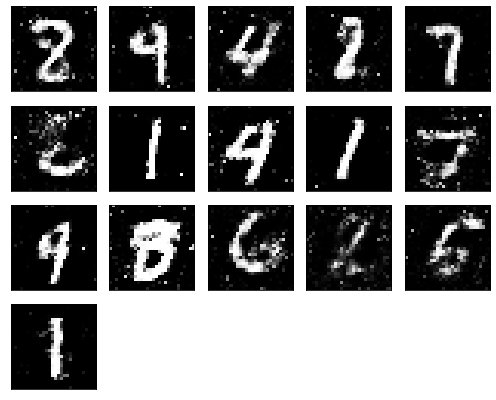

Epochs nb. 7251
discriminator loss: 0.6206340789794922
generator loss : 0.8570559024810791

Epochs nb. 7252
discriminator loss: 0.7244654893875122
generator loss : 0.8149189949035645

Epochs nb. 7253
discriminator loss: 0.6686383485794067
generator loss : 0.8339463472366333

Epochs nb. 7254
discriminator loss: 0.5917000770568848
generator loss : 0.886780858039856

Epochs nb. 7255
discriminator loss: 0.6152377128601074
generator loss : 0.9627494812011719

Epochs nb. 7256
discriminator loss: 0.5558702945709229
generator loss : 1.1038151979446411

Epochs nb. 7257
discriminator loss: 0.6860142946243286
generator loss : 1.0850160121917725

Epochs nb. 7258
discriminator loss: 0.6890792846679688
generator loss : 0.9280756115913391

Epochs nb. 7259
discriminator loss: 0.4961686432361603
generator loss : 0.8887921571731567

Epochs nb. 7260
discriminator loss: 0.6260689496994019
generator loss : 0.8689475059509277



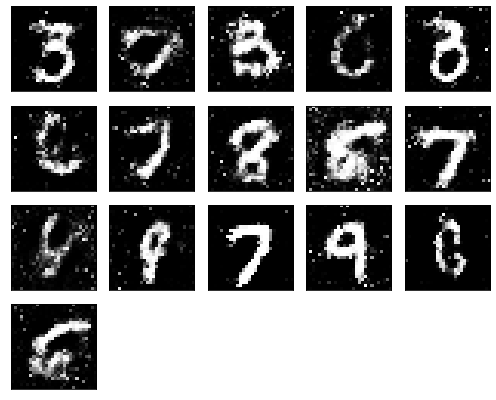

Epochs nb. 7261
discriminator loss: 0.635956883430481
generator loss : 0.7484112977981567

Epochs nb. 7262
discriminator loss: 0.7423104047775269
generator loss : 1.1008461713790894

Epochs nb. 7263
discriminator loss: 0.6468225717544556
generator loss : 1.0843043327331543

Epochs nb. 7264
discriminator loss: 0.5351415276527405
generator loss : 1.0391614437103271

Epochs nb. 7265
discriminator loss: 0.6227574348449707
generator loss : 1.0267586708068848

Epochs nb. 7266
discriminator loss: 0.6688364744186401
generator loss : 0.8788220882415771

Epochs nb. 7267
discriminator loss: 0.43212980031967163
generator loss : 1.041425108909607

Epochs nb. 7268
discriminator loss: 0.5921871066093445
generator loss : 0.9836554527282715

Epochs nb. 7269
discriminator loss: 0.4760500192642212
generator loss : 1.1738871335983276

Epochs nb. 7270
discriminator loss: 0.6379130482673645
generator loss : 1.0848009586334229



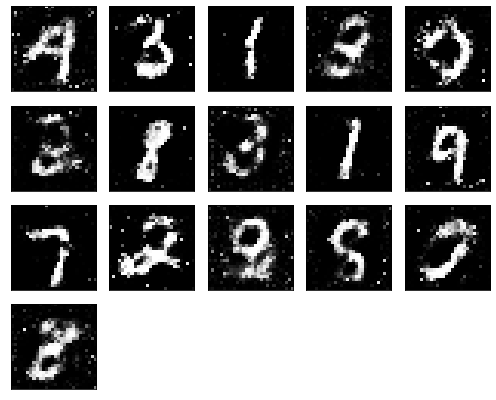

Epochs nb. 7271
discriminator loss: 0.7726035714149475
generator loss : 1.1876732110977173

Epochs nb. 7272
discriminator loss: 0.5579110383987427
generator loss : 1.070253849029541

Epochs nb. 7273
discriminator loss: 0.5246950387954712
generator loss : 1.0050338506698608

Epochs nb. 7274
discriminator loss: 0.7369650602340698
generator loss : 0.9750509262084961

Epochs nb. 7275
discriminator loss: 0.5507480502128601
generator loss : 1.0719770193099976

Epochs nb. 7276
discriminator loss: 0.6377193927764893
generator loss : 0.9415950775146484

Epochs nb. 7277
discriminator loss: 0.4354066252708435
generator loss : 0.9030251502990723

Epochs nb. 7278
discriminator loss: 0.5880649089813232
generator loss : 1.106885552406311

Epochs nb. 7279
discriminator loss: 0.5333202481269836
generator loss : 1.0222086906433105

Epochs nb. 7280
discriminator loss: 0.6029712557792664
generator loss : 1.1470894813537598



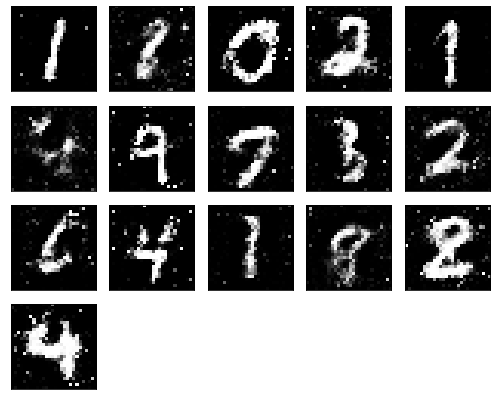

Epochs nb. 7281
discriminator loss: 0.7223650217056274
generator loss : 1.0593433380126953

Epochs nb. 7282
discriminator loss: 0.5915815830230713
generator loss : 0.9596983194351196

Epochs nb. 7283
discriminator loss: 0.6902285814285278
generator loss : 1.1483047008514404

Epochs nb. 7284
discriminator loss: 0.6584532856941223
generator loss : 1.01432204246521

Epochs nb. 7285
discriminator loss: 0.5251253843307495
generator loss : 1.1518540382385254

Epochs nb. 7286
discriminator loss: 0.6140145063400269
generator loss : 0.9167399406433105

Epochs nb. 7287
discriminator loss: 0.6969829797744751
generator loss : 1.0436465740203857

Epochs nb. 7288
discriminator loss: 0.5148346424102783
generator loss : 1.113022804260254

Epochs nb. 7289
discriminator loss: 0.5760611891746521
generator loss : 1.1830332279205322

Epochs nb. 7290
discriminator loss: 0.5340865254402161
generator loss : 1.020155429840088



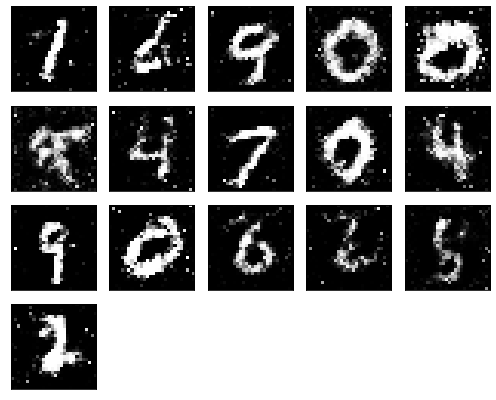

Epochs nb. 7291
discriminator loss: 0.5220744013786316
generator loss : 1.0896278619766235

Epochs nb. 7292
discriminator loss: 0.7194771766662598
generator loss : 0.9159833192825317

Epochs nb. 7293
discriminator loss: 0.5807634592056274
generator loss : 1.1357431411743164

Epochs nb. 7294
discriminator loss: 0.5989238023757935
generator loss : 1.0950536727905273

Epochs nb. 7295
discriminator loss: 0.49255135655403137
generator loss : 1.1153546571731567

Epochs nb. 7296
discriminator loss: 0.6919398903846741
generator loss : 0.9606721997261047

Epochs nb. 7297
discriminator loss: 0.5599780082702637
generator loss : 1.0201209783554077

Epochs nb. 7298
discriminator loss: 0.6188538670539856
generator loss : 1.0603710412979126

Epochs nb. 7299
discriminator loss: 0.6264137029647827
generator loss : 0.9369578957557678

Epochs nb. 7300
discriminator loss: 0.676537036895752
generator loss : 0.9941529631614685



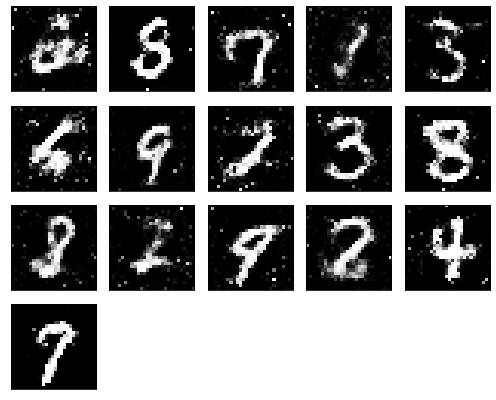

Epochs nb. 7301
discriminator loss: 0.6666871309280396
generator loss : 1.0747493505477905

Epochs nb. 7302
discriminator loss: 0.537826418876648
generator loss : 0.9644486904144287

Epochs nb. 7303
discriminator loss: 0.4991074800491333
generator loss : 1.10593843460083

Epochs nb. 7304
discriminator loss: 0.6519155502319336
generator loss : 1.0082393884658813

Epochs nb. 7305
discriminator loss: 0.6296805143356323
generator loss : 1.0100624561309814

Epochs nb. 7306
discriminator loss: 0.5233882069587708
generator loss : 0.8924490809440613

Epochs nb. 7307
discriminator loss: 0.594323992729187
generator loss : 1.166553258895874

Epochs nb. 7308
discriminator loss: 0.4655960202217102
generator loss : 1.010939121246338

Epochs nb. 7309
discriminator loss: 0.6099241971969604
generator loss : 1.0804073810577393

Epochs nb. 7310
discriminator loss: 0.5954278707504272
generator loss : 1.010946273803711



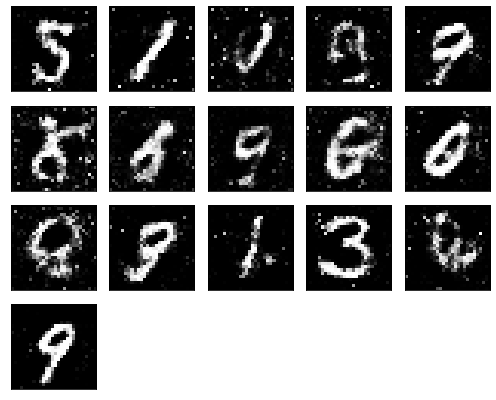

Epochs nb. 7311
discriminator loss: 0.6693275570869446
generator loss : 0.8894662857055664

Epochs nb. 7312
discriminator loss: 0.5963237285614014
generator loss : 0.9744389057159424

Epochs nb. 7313
discriminator loss: 0.5602360367774963
generator loss : 0.9872415661811829

Epochs nb. 7314
discriminator loss: 0.55537348985672
generator loss : 1.1877044439315796

Epochs nb. 7315
discriminator loss: 0.5050538778305054
generator loss : 0.8062849640846252

Epochs nb. 7316
discriminator loss: 0.7223472595214844
generator loss : 1.041012167930603

Epochs nb. 7317
discriminator loss: 0.520265519618988
generator loss : 1.0221103429794312

Epochs nb. 7318
discriminator loss: 0.454974889755249
generator loss : 0.9644957184791565

Epochs nb. 7319
discriminator loss: 0.6433119773864746
generator loss : 0.7739503979682922

Epochs nb. 7320
discriminator loss: 0.5649334192276001
generator loss : 0.8670594692230225



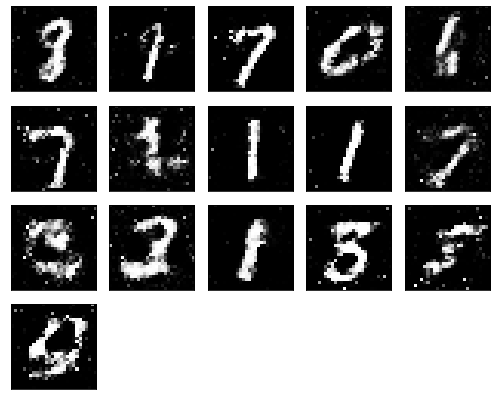

Epochs nb. 7321
discriminator loss: 0.6978212594985962
generator loss : 0.8293872475624084

Epochs nb. 7322
discriminator loss: 0.72305828332901
generator loss : 0.8118096590042114

Epochs nb. 7323
discriminator loss: 0.4874880313873291
generator loss : 0.9391147494316101

Epochs nb. 7324
discriminator loss: 0.5566883087158203
generator loss : 1.0160698890686035

Epochs nb. 7325
discriminator loss: 0.5148831605911255
generator loss : 1.080415964126587

Epochs nb. 7326
discriminator loss: 0.6518580913543701
generator loss : 0.9944698810577393

Epochs nb. 7327
discriminator loss: 0.527523398399353
generator loss : 1.0629267692565918

Epochs nb. 7328
discriminator loss: 0.5939493179321289
generator loss : 0.9207460880279541

Epochs nb. 7329
discriminator loss: 0.5458565950393677
generator loss : 1.0130221843719482

Epochs nb. 7330
discriminator loss: 0.6982884407043457
generator loss : 1.104619026184082



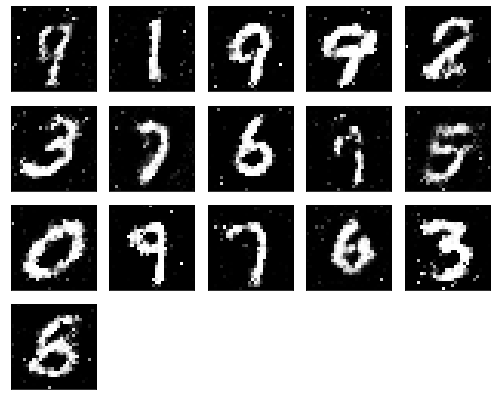

Epochs nb. 7331
discriminator loss: 0.5451109409332275
generator loss : 1.0344626903533936

Epochs nb. 7332
discriminator loss: 0.643912672996521
generator loss : 1.0737853050231934

Epochs nb. 7333
discriminator loss: 0.5068608522415161
generator loss : 1.101233720779419

Epochs nb. 7334
discriminator loss: 0.5259637236595154
generator loss : 1.0211429595947266

Epochs nb. 7335
discriminator loss: 0.6201165914535522
generator loss : 1.0798285007476807

Epochs nb. 7336
discriminator loss: 0.48346978425979614
generator loss : 1.210303544998169

Epochs nb. 7337
discriminator loss: 0.7156637907028198
generator loss : 1.1433762311935425

Epochs nb. 7338
discriminator loss: 0.5435954928398132
generator loss : 0.855772078037262

Epochs nb. 7339
discriminator loss: 0.5571624040603638
generator loss : 0.9301542043685913

Epochs nb. 7340
discriminator loss: 0.5878571271896362
generator loss : 0.9558881521224976



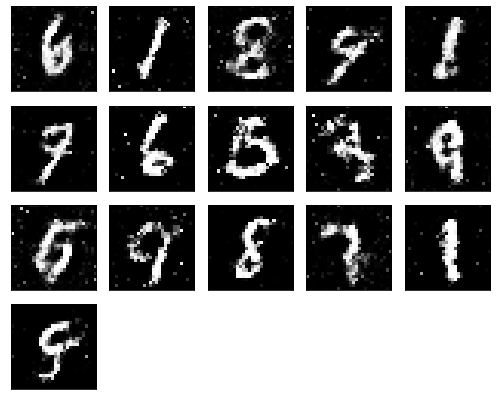

Epochs nb. 7341
discriminator loss: 0.576562225818634
generator loss : 1.0025458335876465

Epochs nb. 7342
discriminator loss: 0.5355618000030518
generator loss : 0.9850203394889832

Epochs nb. 7343
discriminator loss: 0.614726185798645
generator loss : 0.954627513885498

Epochs nb. 7344
discriminator loss: 0.5414152145385742
generator loss : 1.010317087173462

Epochs nb. 7345
discriminator loss: 0.6626339554786682
generator loss : 0.9797602295875549

Epochs nb. 7346
discriminator loss: 0.49288326501846313
generator loss : 1.0159647464752197

Epochs nb. 7347
discriminator loss: 0.6681431531906128
generator loss : 0.9813532829284668

Epochs nb. 7348
discriminator loss: 0.5638634562492371
generator loss : 0.7517955303192139

Epochs nb. 7349
discriminator loss: 0.6079984903335571
generator loss : 0.9807194471359253

Epochs nb. 7350
discriminator loss: 0.6760015487670898
generator loss : 0.8101377487182617



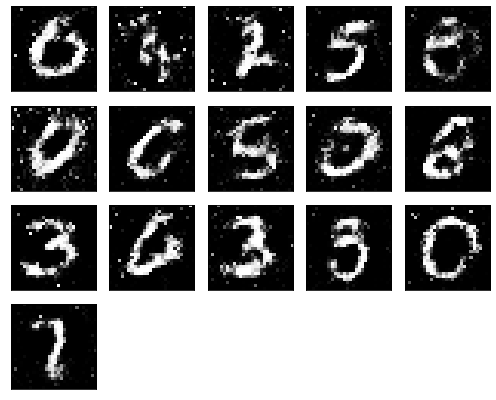

Epochs nb. 7351
discriminator loss: 0.520751953125
generator loss : 0.8869931697845459

Epochs nb. 7352
discriminator loss: 0.5238460302352905
generator loss : 1.0113935470581055

Epochs nb. 7353
discriminator loss: 0.5386507511138916
generator loss : 0.8844430446624756

Epochs nb. 7354
discriminator loss: 0.6405115127563477
generator loss : 0.9827919006347656

Epochs nb. 7355
discriminator loss: 0.6703962087631226
generator loss : 1.079605221748352

Epochs nb. 7356
discriminator loss: 0.5458238124847412
generator loss : 0.911379337310791

Epochs nb. 7357
discriminator loss: 0.691658079624176
generator loss : 0.9688475131988525

Epochs nb. 7358
discriminator loss: 0.7569449543952942
generator loss : 1.1719584465026855

Epochs nb. 7359
discriminator loss: 0.5402069091796875
generator loss : 1.0282522439956665

Epochs nb. 7360
discriminator loss: 0.6716368198394775
generator loss : 1.045081615447998



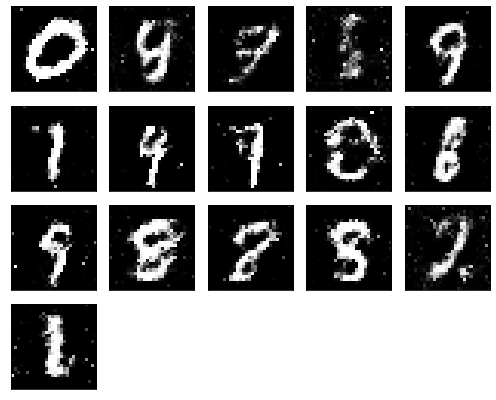

Epochs nb. 7361
discriminator loss: 0.7069437503814697
generator loss : 0.8765208721160889

Epochs nb. 7362
discriminator loss: 0.5825735330581665
generator loss : 1.321062445640564

Epochs nb. 7363
discriminator loss: 0.7017481327056885
generator loss : 1.0789532661437988

Epochs nb. 7364
discriminator loss: 0.6403567790985107
generator loss : 1.1274387836456299

Epochs nb. 7365
discriminator loss: 0.6630624532699585
generator loss : 1.0949769020080566

Epochs nb. 7366
discriminator loss: 0.5736366510391235
generator loss : 1.0946685075759888

Epochs nb. 7367
discriminator loss: 0.5651658773422241
generator loss : 1.0421494245529175

Epochs nb. 7368
discriminator loss: 0.4668833911418915
generator loss : 1.1130897998809814

Epochs nb. 7369
discriminator loss: 0.5946248173713684
generator loss : 1.1170544624328613

Epochs nb. 7370
discriminator loss: 0.5504372119903564
generator loss : 0.9293965101242065



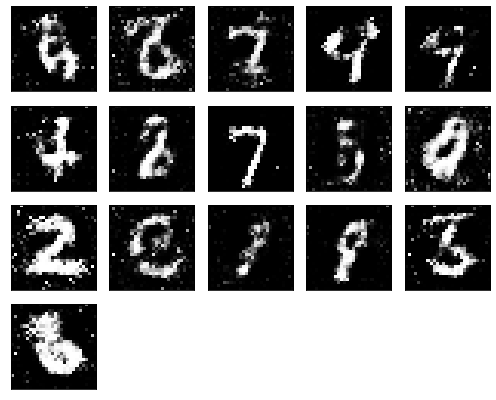

Epochs nb. 7371
discriminator loss: 0.5986154079437256
generator loss : 0.8854396939277649

Epochs nb. 7372
discriminator loss: 0.5866405963897705
generator loss : 1.0376633405685425

Epochs nb. 7373
discriminator loss: 0.538630485534668
generator loss : 1.2246235609054565

Epochs nb. 7374
discriminator loss: 0.5718996524810791
generator loss : 0.9700610637664795

Epochs nb. 7375
discriminator loss: 0.6480176448822021
generator loss : 0.9668334126472473

Epochs nb. 7376
discriminator loss: 0.6903088092803955
generator loss : 0.9867908954620361

Epochs nb. 7377
discriminator loss: 0.4752527177333832
generator loss : 1.0771551132202148

Epochs nb. 7378
discriminator loss: 0.5927090644836426
generator loss : 0.9214861392974854

Epochs nb. 7379
discriminator loss: 0.6563588976860046
generator loss : 0.9381653070449829

Epochs nb. 7380
discriminator loss: 0.6165429353713989
generator loss : 1.0906627178192139



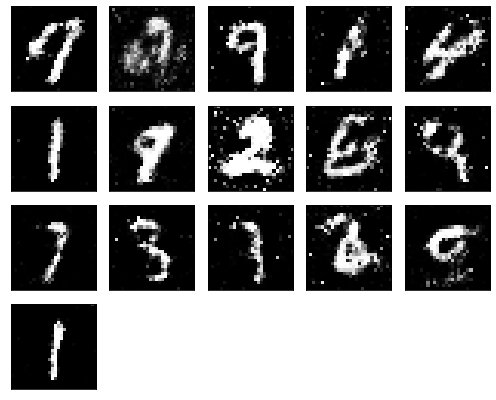

Epochs nb. 7381
discriminator loss: 0.6862927675247192
generator loss : 1.088977575302124

Epochs nb. 7382
discriminator loss: 0.493475079536438
generator loss : 0.91194748878479

Epochs nb. 7383
discriminator loss: 0.5279669165611267
generator loss : 0.9958439469337463

Epochs nb. 7384
discriminator loss: 0.5992730259895325
generator loss : 0.9087263941764832

Epochs nb. 7385
discriminator loss: 0.7378813028335571
generator loss : 0.9507216215133667

Epochs nb. 7386
discriminator loss: 0.5989944934844971
generator loss : 1.025233268737793

Epochs nb. 7387
discriminator loss: 0.723138689994812
generator loss : 0.9302000403404236

Epochs nb. 7388
discriminator loss: 0.510837972164154
generator loss : 0.97650146484375

Epochs nb. 7389
discriminator loss: 0.7443701028823853
generator loss : 0.9237088561058044

Epochs nb. 7390
discriminator loss: 0.6116183996200562
generator loss : 0.8848249912261963



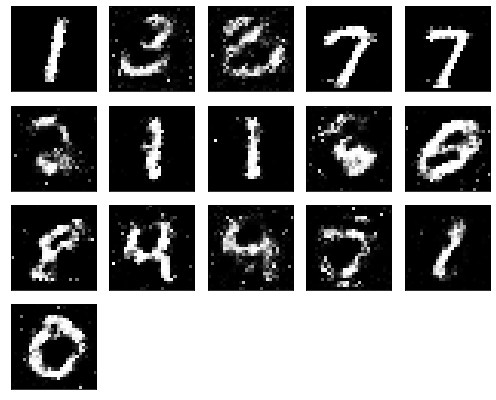

Epochs nb. 7391
discriminator loss: 0.6122314929962158
generator loss : 0.8308084607124329

Epochs nb. 7392
discriminator loss: 0.6351425051689148
generator loss : 0.9424276351928711

Epochs nb. 7393
discriminator loss: 0.6551675200462341
generator loss : 1.0746428966522217

Epochs nb. 7394
discriminator loss: 0.5131205320358276
generator loss : 0.8962348699569702

Epochs nb. 7395
discriminator loss: 0.5871986150741577
generator loss : 1.0309336185455322

Epochs nb. 7396
discriminator loss: 0.5191120505332947
generator loss : 1.0371313095092773

Epochs nb. 7397
discriminator loss: 0.6171613931655884
generator loss : 1.254729986190796

Epochs nb. 7398
discriminator loss: 0.5760890245437622
generator loss : 0.8793957233428955

Epochs nb. 7399
discriminator loss: 0.6367872953414917
generator loss : 0.8544072508811951

Epochs nb. 7400
discriminator loss: 0.5501007437705994
generator loss : 1.1778775453567505



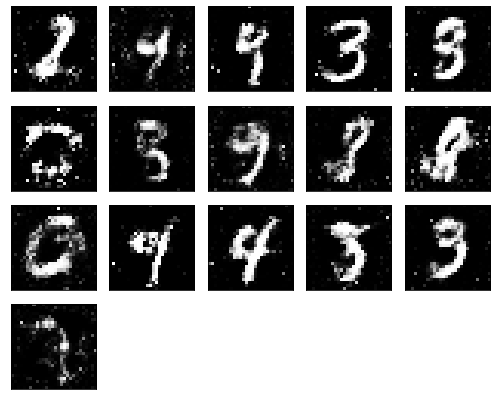

Epochs nb. 7401
discriminator loss: 0.5194832682609558
generator loss : 1.1461173295974731

Epochs nb. 7402
discriminator loss: 0.7461427450180054
generator loss : 0.8262126445770264

Epochs nb. 7403
discriminator loss: 0.6499218344688416
generator loss : 1.1650303602218628

Epochs nb. 7404
discriminator loss: 0.5924990177154541
generator loss : 0.9342976808547974

Epochs nb. 7405
discriminator loss: 0.5148681998252869
generator loss : 1.0197043418884277

Epochs nb. 7406
discriminator loss: 0.5380364656448364
generator loss : 0.8873925805091858

Epochs nb. 7407
discriminator loss: 0.5923822522163391
generator loss : 1.0655853748321533

Epochs nb. 7408
discriminator loss: 0.5336157083511353
generator loss : 1.1368833780288696

Epochs nb. 7409
discriminator loss: 0.7048909664154053
generator loss : 0.925068199634552

Epochs nb. 7410
discriminator loss: 0.6490845680236816
generator loss : 1.0282984972000122



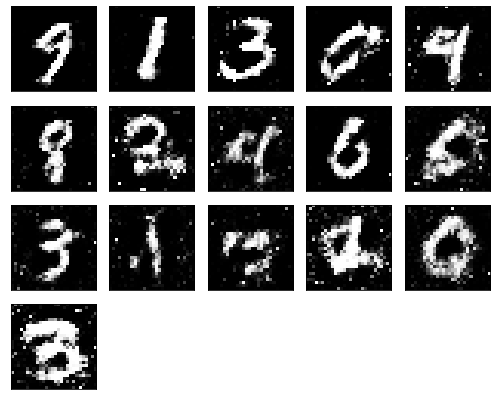

Epochs nb. 7411
discriminator loss: 0.5592519044876099
generator loss : 0.9588857889175415

Epochs nb. 7412
discriminator loss: 0.9170228838920593
generator loss : 0.8153798580169678

Epochs nb. 7413
discriminator loss: 0.5425524711608887
generator loss : 0.9972776174545288

Epochs nb. 7414
discriminator loss: 0.7218294739723206
generator loss : 0.9050115346908569

Epochs nb. 7415
discriminator loss: 0.654059886932373
generator loss : 1.069653034210205

Epochs nb. 7416
discriminator loss: 0.5606735944747925
generator loss : 1.102952480316162

Epochs nb. 7417
discriminator loss: 0.5060741901397705
generator loss : 1.1731716394424438

Epochs nb. 7418
discriminator loss: 0.6794978380203247
generator loss : 0.9340147972106934

Epochs nb. 7419
discriminator loss: 0.47157031297683716
generator loss : 0.9239681363105774

Epochs nb. 7420
discriminator loss: 0.5768038034439087
generator loss : 0.9161426424980164



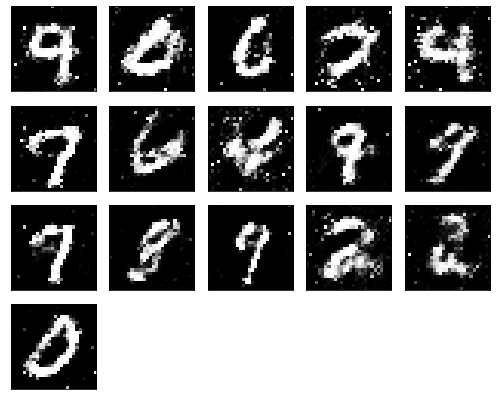

Epochs nb. 7421
discriminator loss: 0.6554995775222778
generator loss : 1.1794644594192505

Epochs nb. 7422
discriminator loss: 0.48962610960006714
generator loss : 1.0455811023712158

Epochs nb. 7423
discriminator loss: 0.5365186929702759
generator loss : 1.0596628189086914

Epochs nb. 7424
discriminator loss: 0.4929577708244324
generator loss : 1.0875113010406494

Epochs nb. 7425
discriminator loss: 0.6040427684783936
generator loss : 1.019752860069275

Epochs nb. 7426
discriminator loss: 0.586296558380127
generator loss : 0.9722610712051392

Epochs nb. 7427
discriminator loss: 0.52757728099823
generator loss : 1.086324691772461

Epochs nb. 7428
discriminator loss: 0.6316936016082764
generator loss : 1.0483254194259644

Epochs nb. 7429
discriminator loss: 0.5618240833282471
generator loss : 0.8214441537857056

Epochs nb. 7430
discriminator loss: 0.5135008692741394
generator loss : 0.9486790895462036



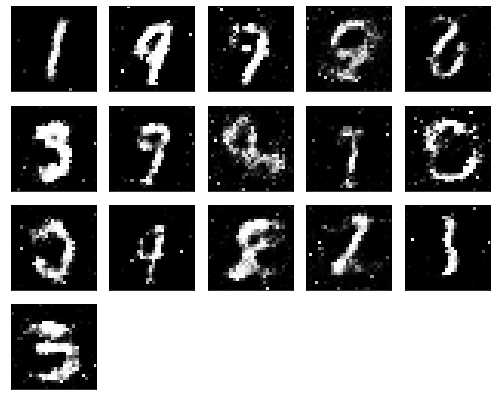

Epochs nb. 7431
discriminator loss: 0.7218800783157349
generator loss : 1.046168327331543

Epochs nb. 7432
discriminator loss: 0.4302130937576294
generator loss : 0.981482744216919

Epochs nb. 7433
discriminator loss: 0.5658623576164246
generator loss : 1.1851483583450317

Epochs nb. 7434
discriminator loss: 0.5710369348526001
generator loss : 1.0295807123184204

Epochs nb. 7435
discriminator loss: 0.5670774579048157
generator loss : 0.8947950601577759

Epochs nb. 7436
discriminator loss: 0.6738150119781494
generator loss : 1.0959867238998413

Epochs nb. 7437
discriminator loss: 0.6983869671821594
generator loss : 1.0265337228775024

Epochs nb. 7438
discriminator loss: 0.5610129237174988
generator loss : 1.2097599506378174

Epochs nb. 7439
discriminator loss: 0.4056338965892792
generator loss : 1.202831745147705

Epochs nb. 7440
discriminator loss: 0.5705465078353882
generator loss : 1.052450180053711



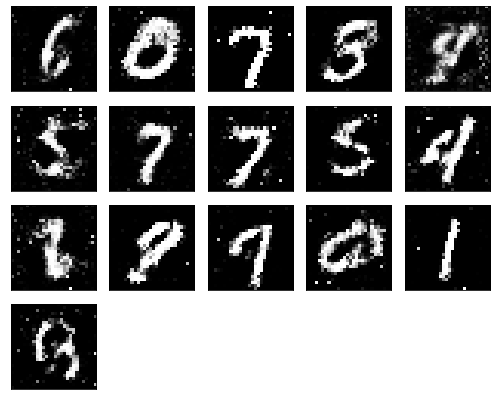

Epochs nb. 7441
discriminator loss: 0.5783833265304565
generator loss : 0.8371070623397827

Epochs nb. 7442
discriminator loss: 0.6361770629882812
generator loss : 1.1115942001342773

Epochs nb. 7443
discriminator loss: 0.6318167448043823
generator loss : 0.9885144233703613

Epochs nb. 7444
discriminator loss: 0.5941012501716614
generator loss : 0.9449930787086487

Epochs nb. 7445
discriminator loss: 0.6659952998161316
generator loss : 0.9131333827972412

Epochs nb. 7446
discriminator loss: 0.5326172113418579
generator loss : 0.9471703171730042

Epochs nb. 7447
discriminator loss: 0.5916621685028076
generator loss : 1.227216124534607

Epochs nb. 7448
discriminator loss: 0.5607460737228394
generator loss : 1.1350605487823486

Epochs nb. 7449
discriminator loss: 0.7484668493270874
generator loss : 1.066584825515747

Epochs nb. 7450
discriminator loss: 0.5626524686813354
generator loss : 1.1372623443603516



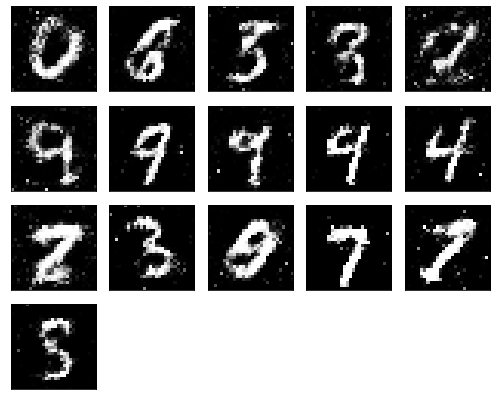

Epochs nb. 7451
discriminator loss: 0.6020326614379883
generator loss : 1.081687092781067

Epochs nb. 7452
discriminator loss: 0.6011092662811279
generator loss : 0.9060682654380798

Epochs nb. 7453
discriminator loss: 0.5678876638412476
generator loss : 1.0694388151168823

Epochs nb. 7454
discriminator loss: 0.6150391101837158
generator loss : 0.9265549778938293

Epochs nb. 7455
discriminator loss: 0.6270769834518433
generator loss : 0.8680245876312256

Epochs nb. 7456
discriminator loss: 0.6003878712654114
generator loss : 1.0690981149673462

Epochs nb. 7457
discriminator loss: 0.6418948769569397
generator loss : 0.963586688041687

Epochs nb. 7458
discriminator loss: 0.5710969567298889
generator loss : 1.010770559310913

Epochs nb. 7459
discriminator loss: 0.5461687445640564
generator loss : 0.8860258460044861

Epochs nb. 7460
discriminator loss: 0.6323058605194092
generator loss : 0.925953209400177



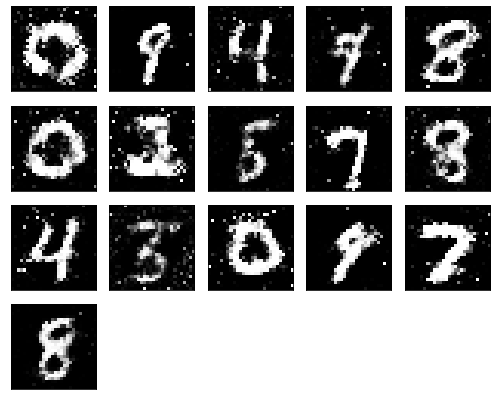

Epochs nb. 7461
discriminator loss: 0.5671091079711914
generator loss : 0.8693609833717346

Epochs nb. 7462
discriminator loss: 0.6446378231048584
generator loss : 1.1100126504898071

Epochs nb. 7463
discriminator loss: 0.5125311613082886
generator loss : 0.9747210741043091

Epochs nb. 7464
discriminator loss: 0.6011499762535095
generator loss : 0.8318688869476318

Epochs nb. 7465
discriminator loss: 0.5729992389678955
generator loss : 0.8203157782554626

Epochs nb. 7466
discriminator loss: 0.6324200630187988
generator loss : 0.9030241966247559

Epochs nb. 7467
discriminator loss: 0.5342022776603699
generator loss : 0.8412912487983704

Epochs nb. 7468
discriminator loss: 0.47816112637519836
generator loss : 0.7615280747413635

Epochs nb. 7469
discriminator loss: 0.5564717650413513
generator loss : 0.9786682724952698

Epochs nb. 7470
discriminator loss: 0.6428019404411316
generator loss : 0.9471243619918823



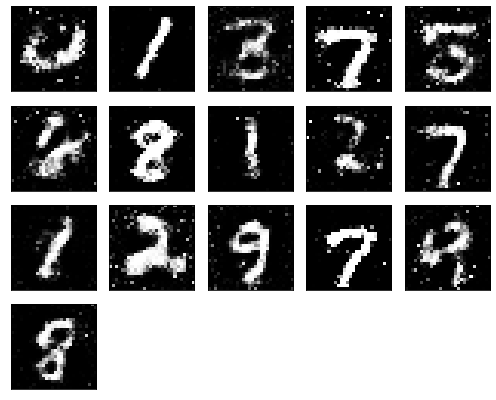

Epochs nb. 7471
discriminator loss: 0.570395290851593
generator loss : 0.962882399559021

Epochs nb. 7472
discriminator loss: 0.49630439281463623
generator loss : 0.9199587106704712

Epochs nb. 7473
discriminator loss: 0.5431339144706726
generator loss : 1.015443205833435

Epochs nb. 7474
discriminator loss: 0.6038588285446167
generator loss : 0.8356304168701172

Epochs nb. 7475
discriminator loss: 0.5811231136322021
generator loss : 0.9404029250144958

Epochs nb. 7476
discriminator loss: 0.5582484006881714
generator loss : 0.9824442863464355

Epochs nb. 7477
discriminator loss: 0.6984713077545166
generator loss : 1.0703113079071045

Epochs nb. 7478
discriminator loss: 0.4345689117908478
generator loss : 0.9235900640487671

Epochs nb. 7479
discriminator loss: 0.6334055662155151
generator loss : 1.0398457050323486

Epochs nb. 7480
discriminator loss: 0.5987424850463867
generator loss : 0.9894832372665405



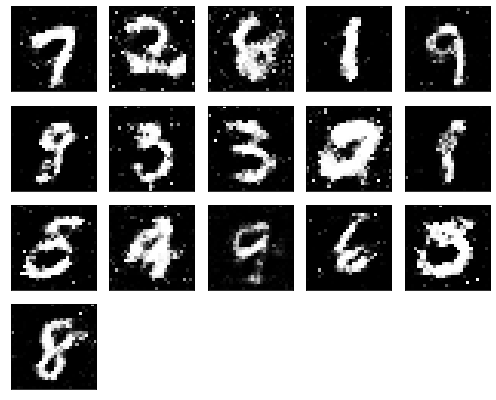

Epochs nb. 7481
discriminator loss: 0.49509119987487793
generator loss : 1.0665645599365234

Epochs nb. 7482
discriminator loss: 0.6729607582092285
generator loss : 1.0907655954360962

Epochs nb. 7483
discriminator loss: 0.5626034140586853
generator loss : 0.9727901220321655

Epochs nb. 7484
discriminator loss: 0.7146258354187012
generator loss : 1.0008643865585327

Epochs nb. 7485
discriminator loss: 0.5600395202636719
generator loss : 1.1780776977539062

Epochs nb. 7486
discriminator loss: 0.7656399011611938
generator loss : 1.123299479484558

Epochs nb. 7487
discriminator loss: 0.5091445446014404
generator loss : 1.1432002782821655

Epochs nb. 7488
discriminator loss: 0.4930640161037445
generator loss : 0.9509443044662476

Epochs nb. 7489
discriminator loss: 0.4921186566352844
generator loss : 0.9418688416481018

Epochs nb. 7490
discriminator loss: 0.5364893674850464
generator loss : 0.9636160731315613



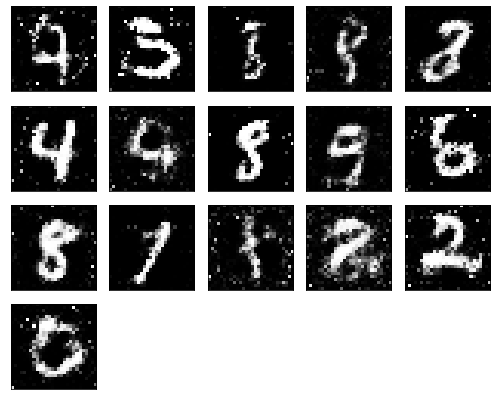

Epochs nb. 7491
discriminator loss: 0.588589072227478
generator loss : 0.8973690867424011

Epochs nb. 7492
discriminator loss: 0.4904026389122009
generator loss : 0.8736988306045532

Epochs nb. 7493
discriminator loss: 0.5692238807678223
generator loss : 0.8946462869644165

Epochs nb. 7494
discriminator loss: 0.6175366640090942
generator loss : 0.9828774929046631

Epochs nb. 7495
discriminator loss: 0.6219449639320374
generator loss : 1.113926649093628

Epochs nb. 7496
discriminator loss: 0.463548481464386
generator loss : 0.932897686958313

Epochs nb. 7497
discriminator loss: 0.6517550945281982
generator loss : 1.0844310522079468

Epochs nb. 7498
discriminator loss: 0.5984596014022827
generator loss : 1.049121379852295

Epochs nb. 7499
discriminator loss: 0.6178932189941406
generator loss : 1.0477638244628906

Epochs nb. 7500
discriminator loss: 0.5480583310127258
generator loss : 0.9465494751930237



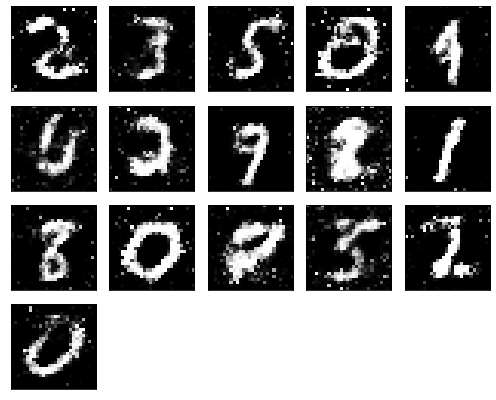

Epochs nb. 7501
discriminator loss: 0.5522473454475403
generator loss : 0.9679508805274963

Epochs nb. 7502
discriminator loss: 0.6052809357643127
generator loss : 1.1928914785385132

Epochs nb. 7503
discriminator loss: 0.6547328233718872
generator loss : 1.0457499027252197

Epochs nb. 7504
discriminator loss: 0.5439726114273071
generator loss : 0.8393594622612

Epochs nb. 7505
discriminator loss: 0.6283786296844482
generator loss : 0.951422929763794

Epochs nb. 7506
discriminator loss: 0.6201935410499573
generator loss : 0.9458080530166626

Epochs nb. 7507
discriminator loss: 0.6534333229064941
generator loss : 1.0191400051116943

Epochs nb. 7508
discriminator loss: 0.6038162708282471
generator loss : 0.9707378149032593

Epochs nb. 7509
discriminator loss: 0.6482781767845154
generator loss : 0.9597901105880737

Epochs nb. 7510
discriminator loss: 0.5832465887069702
generator loss : 1.0872759819030762



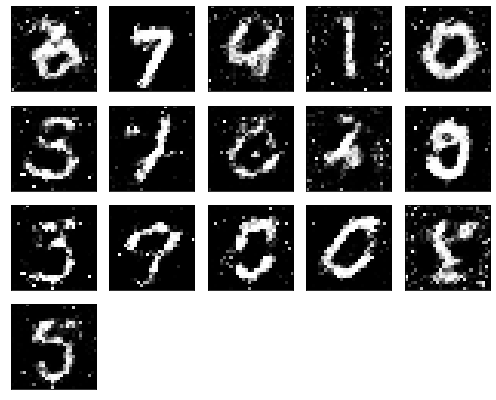

Epochs nb. 7511
discriminator loss: 0.5489560961723328
generator loss : 0.8364742994308472

Epochs nb. 7512
discriminator loss: 0.8219742774963379
generator loss : 1.0284360647201538

Epochs nb. 7513
discriminator loss: 0.6246113777160645
generator loss : 1.0733060836791992

Epochs nb. 7514
discriminator loss: 0.6230577230453491
generator loss : 0.9950208067893982

Epochs nb. 7515
discriminator loss: 0.5120493173599243
generator loss : 0.8130412101745605

Epochs nb. 7516
discriminator loss: 0.6556206941604614
generator loss : 0.9715456366539001

Epochs nb. 7517
discriminator loss: 0.6149771213531494
generator loss : 0.7797027230262756

Epochs nb. 7518
discriminator loss: 0.5743626356124878
generator loss : 0.9843453168869019

Epochs nb. 7519
discriminator loss: 0.522169828414917
generator loss : 0.903063178062439

Epochs nb. 7520
discriminator loss: 0.6280547976493835
generator loss : 1.0666155815124512



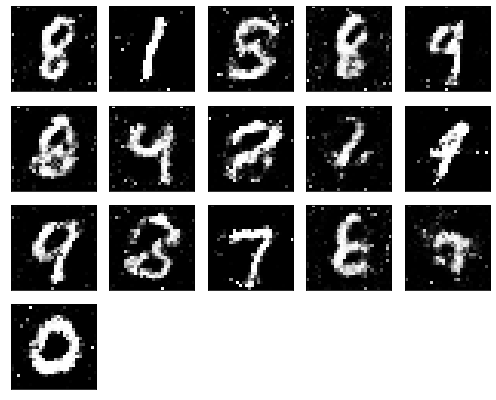

Epochs nb. 7521
discriminator loss: 0.6342328786849976
generator loss : 1.0247697830200195

Epochs nb. 7522
discriminator loss: 0.8328665494918823
generator loss : 1.1575126647949219

Epochs nb. 7523
discriminator loss: 0.5091681480407715
generator loss : 1.1809829473495483

Epochs nb. 7524
discriminator loss: 0.5659365653991699
generator loss : 1.205554723739624

Epochs nb. 7525
discriminator loss: 0.4963030219078064
generator loss : 1.3056222200393677

Epochs nb. 7526
discriminator loss: 0.4921804368495941
generator loss : 1.2452833652496338

Epochs nb. 7527
discriminator loss: 0.6790645122528076
generator loss : 1.2066428661346436

Epochs nb. 7528
discriminator loss: 0.5900866985321045
generator loss : 1.0530385971069336

Epochs nb. 7529
discriminator loss: 0.6384096741676331
generator loss : 1.0995819568634033

Epochs nb. 7530
discriminator loss: 0.5428445339202881
generator loss : 0.7191855907440186



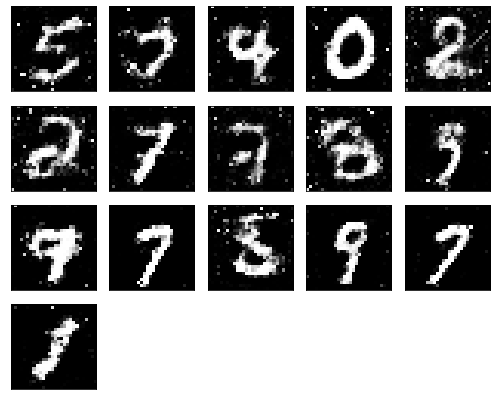

Epochs nb. 7531
discriminator loss: 0.6580725312232971
generator loss : 1.0912480354309082

Epochs nb. 7532
discriminator loss: 0.5822598934173584
generator loss : 1.1620906591415405

Epochs nb. 7533
discriminator loss: 0.6609803438186646
generator loss : 1.0308167934417725

Epochs nb. 7534
discriminator loss: 0.4607086181640625
generator loss : 0.9763272404670715

Epochs nb. 7535
discriminator loss: 0.7284612655639648
generator loss : 1.0602662563323975

Epochs nb. 7536
discriminator loss: 0.6203327178955078
generator loss : 0.9807857275009155

Epochs nb. 7537
discriminator loss: 0.6590786576271057
generator loss : 0.8784921169281006

Epochs nb. 7538
discriminator loss: 0.5984922647476196
generator loss : 1.0288889408111572

Epochs nb. 7539
discriminator loss: 0.6554044485092163
generator loss : 1.1116256713867188

Epochs nb. 7540
discriminator loss: 0.6111508011817932
generator loss : 1.0055664777755737



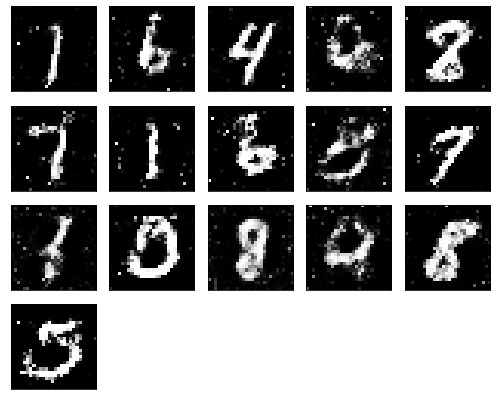

Epochs nb. 7541
discriminator loss: 0.5502254366874695
generator loss : 0.8588869571685791

Epochs nb. 7542
discriminator loss: 0.5533305406570435
generator loss : 0.9284527897834778

Epochs nb. 7543
discriminator loss: 0.5315647125244141
generator loss : 0.935067355632782

Epochs nb. 7544
discriminator loss: 0.56196528673172
generator loss : 0.7968113422393799

Epochs nb. 7545
discriminator loss: 0.5848833918571472
generator loss : 1.2626593112945557

Epochs nb. 7546
discriminator loss: 0.7047086954116821
generator loss : 0.8867657780647278

Epochs nb. 7547
discriminator loss: 0.6883521676063538
generator loss : 0.8785039186477661

Epochs nb. 7548
discriminator loss: 0.5045163631439209
generator loss : 1.2295666933059692

Epochs nb. 7549
discriminator loss: 0.5602173805236816
generator loss : 1.2812188863754272

Epochs nb. 7550
discriminator loss: 0.5372195839881897
generator loss : 0.9049859046936035



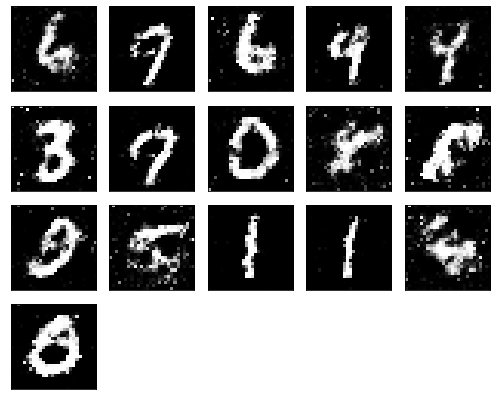

Epochs nb. 7551
discriminator loss: 0.6783155202865601
generator loss : 1.0242502689361572

Epochs nb. 7552
discriminator loss: 0.5355637669563293
generator loss : 0.9701906442642212

Epochs nb. 7553
discriminator loss: 0.6059995889663696
generator loss : 1.0589332580566406

Epochs nb. 7554
discriminator loss: 0.6837716698646545
generator loss : 0.9835165739059448

Epochs nb. 7555
discriminator loss: 0.5849442481994629
generator loss : 1.210067868232727

Epochs nb. 7556
discriminator loss: 0.5780668258666992
generator loss : 1.0403258800506592

Epochs nb. 7557
discriminator loss: 0.701720654964447
generator loss : 1.1925137042999268

Epochs nb. 7558
discriminator loss: 0.6918423175811768
generator loss : 1.1241514682769775

Epochs nb. 7559
discriminator loss: 0.5843557715415955
generator loss : 0.9647274613380432

Epochs nb. 7560
discriminator loss: 0.570137619972229
generator loss : 0.9172473549842834



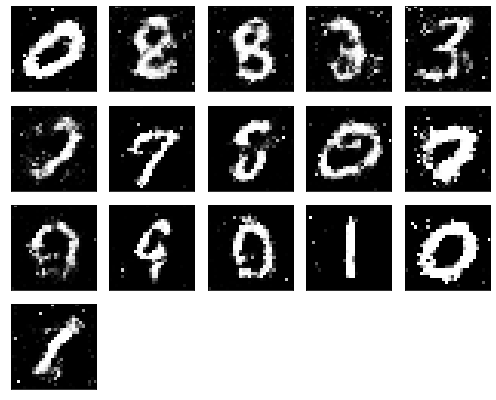

Epochs nb. 7561
discriminator loss: 0.5867045521736145
generator loss : 1.1155996322631836

Epochs nb. 7562
discriminator loss: 0.7234457731246948
generator loss : 0.9464868307113647

Epochs nb. 7563
discriminator loss: 0.5975116491317749
generator loss : 1.048414945602417

Epochs nb. 7564
discriminator loss: 0.5530720949172974
generator loss : 0.9536117315292358

Epochs nb. 7565
discriminator loss: 0.5554988384246826
generator loss : 1.1355849504470825

Epochs nb. 7566
discriminator loss: 0.6315184831619263
generator loss : 1.1972191333770752

Epochs nb. 7567
discriminator loss: 0.5367076396942139
generator loss : 0.890227198600769

Epochs nb. 7568
discriminator loss: 0.5887335538864136
generator loss : 0.9574695229530334

Epochs nb. 7569
discriminator loss: 0.5800039768218994
generator loss : 1.0974581241607666

Epochs nb. 7570
discriminator loss: 0.6054177284240723
generator loss : 0.866653561592102



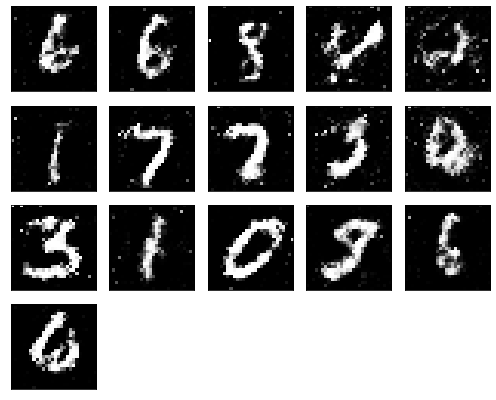

Epochs nb. 7571
discriminator loss: 0.7633556127548218
generator loss : 0.9773485660552979

Epochs nb. 7572
discriminator loss: 0.5288709402084351
generator loss : 0.932592511177063

Epochs nb. 7573
discriminator loss: 0.7950829267501831
generator loss : 0.8668283224105835

Epochs nb. 7574
discriminator loss: 0.6032595634460449
generator loss : 0.8390365242958069

Epochs nb. 7575
discriminator loss: 0.704271674156189
generator loss : 1.0471271276474

Epochs nb. 7576
discriminator loss: 0.6644899845123291
generator loss : 1.1136627197265625

Epochs nb. 7577
discriminator loss: 0.6839259266853333
generator loss : 0.9369715452194214

Epochs nb. 7578
discriminator loss: 0.6050561666488647
generator loss : 0.8170469403266907

Epochs nb. 7579
discriminator loss: 0.6366276741027832
generator loss : 0.9567698836326599

Epochs nb. 7580
discriminator loss: 0.4982256293296814
generator loss : 0.8834373950958252



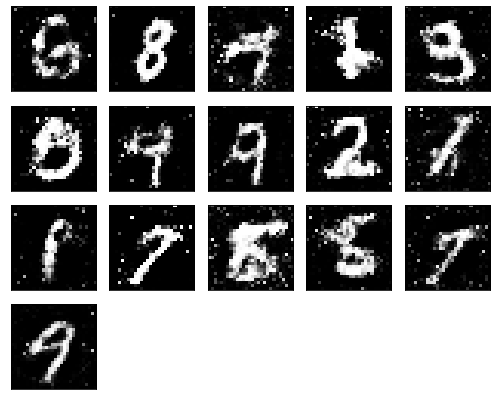

Epochs nb. 7581
discriminator loss: 0.6102322340011597
generator loss : 1.035243272781372

Epochs nb. 7582
discriminator loss: 0.5738997459411621
generator loss : 0.9342250823974609

Epochs nb. 7583
discriminator loss: 0.6606683731079102
generator loss : 0.915165901184082

Epochs nb. 7584
discriminator loss: 0.6674919724464417
generator loss : 0.9163168668746948

Epochs nb. 7585
discriminator loss: 0.4907471835613251
generator loss : 1.0122815370559692

Epochs nb. 7586
discriminator loss: 0.6420086622238159
generator loss : 1.13139009475708

Epochs nb. 7587
discriminator loss: 0.7089214324951172
generator loss : 0.7976685762405396

Epochs nb. 7588
discriminator loss: 0.5728471279144287
generator loss : 0.9117763638496399

Epochs nb. 7589
discriminator loss: 0.6244688034057617
generator loss : 0.8836103081703186

Epochs nb. 7590
discriminator loss: 0.6091516017913818
generator loss : 0.899816632270813



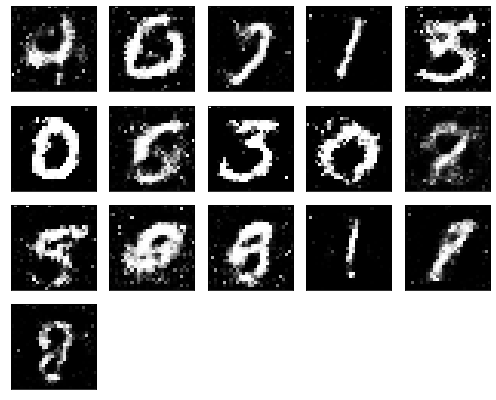

Epochs nb. 7591
discriminator loss: 0.5595074892044067
generator loss : 0.8955577611923218

Epochs nb. 7592
discriminator loss: 0.7253553867340088
generator loss : 1.1567583084106445

Epochs nb. 7593
discriminator loss: 0.6601918935775757
generator loss : 0.9726191163063049

Epochs nb. 7594
discriminator loss: 0.5577540993690491
generator loss : 1.0024559497833252

Epochs nb. 7595
discriminator loss: 0.6224147081375122
generator loss : 1.162463665008545

Epochs nb. 7596
discriminator loss: 0.5691986083984375
generator loss : 0.934256911277771

Epochs nb. 7597
discriminator loss: 0.6255568265914917
generator loss : 0.9911807775497437

Epochs nb. 7598
discriminator loss: 0.5708029270172119
generator loss : 1.0115994215011597

Epochs nb. 7599
discriminator loss: 0.6073136329650879
generator loss : 1.0126863718032837

Epochs nb. 7600
discriminator loss: 0.6587938070297241
generator loss : 0.8865090012550354



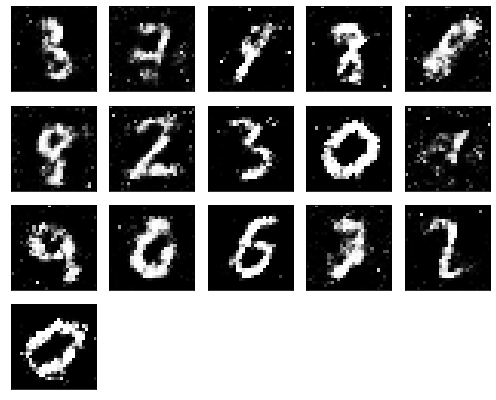

Epochs nb. 7601
discriminator loss: 0.6288948059082031
generator loss : 0.9371467232704163

Epochs nb. 7602
discriminator loss: 0.5656461715698242
generator loss : 0.8216469287872314

Epochs nb. 7603
discriminator loss: 0.6383856534957886
generator loss : 1.0667332410812378

Epochs nb. 7604
discriminator loss: 0.5948507785797119
generator loss : 1.0032597780227661

Epochs nb. 7605
discriminator loss: 0.48752108216285706
generator loss : 1.0313646793365479

Epochs nb. 7606
discriminator loss: 0.6103641390800476
generator loss : 0.9992360472679138

Epochs nb. 7607
discriminator loss: 0.5904837846755981
generator loss : 1.1237292289733887

Epochs nb. 7608
discriminator loss: 0.4707551896572113
generator loss : 0.9967741966247559

Epochs nb. 7609
discriminator loss: 0.6803010106086731
generator loss : 1.1059036254882812

Epochs nb. 7610
discriminator loss: 0.5020067095756531
generator loss : 1.0533334016799927



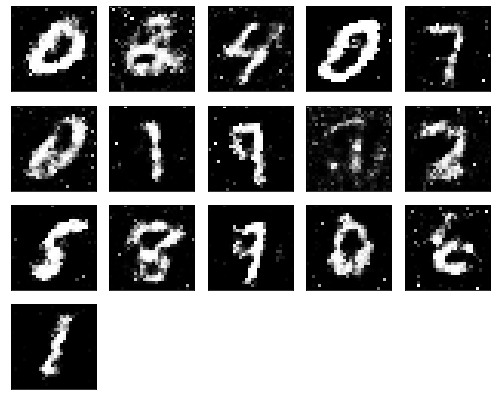

Epochs nb. 7611
discriminator loss: 0.6099076271057129
generator loss : 1.0043280124664307

Epochs nb. 7612
discriminator loss: 0.5847286581993103
generator loss : 0.9916983842849731

Epochs nb. 7613
discriminator loss: 0.5983272790908813
generator loss : 0.9415084719657898

Epochs nb. 7614
discriminator loss: 0.5338045358657837
generator loss : 1.042694330215454

Epochs nb. 7615
discriminator loss: 0.6017887592315674
generator loss : 0.9286612272262573

Epochs nb. 7616
discriminator loss: 0.5564932823181152
generator loss : 0.8625510931015015

Epochs nb. 7617
discriminator loss: 0.7535609006881714
generator loss : 0.7015395164489746

Epochs nb. 7618
discriminator loss: 0.5312758684158325
generator loss : 1.095506191253662

Epochs nb. 7619
discriminator loss: 0.6117944717407227
generator loss : 0.8154963254928589

Epochs nb. 7620
discriminator loss: 0.5113086700439453
generator loss : 1.014627456665039



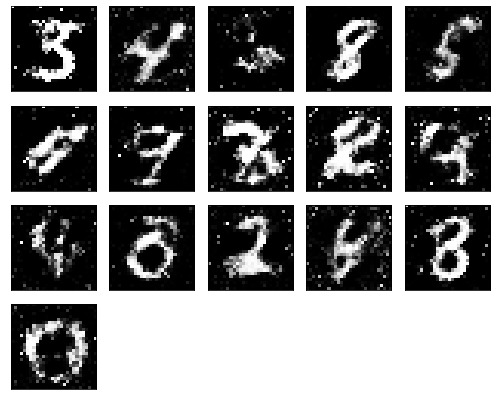

Epochs nb. 7621
discriminator loss: 0.5260564684867859
generator loss : 0.9561818838119507

Epochs nb. 7622
discriminator loss: 0.5361592769622803
generator loss : 0.958885669708252

Epochs nb. 7623
discriminator loss: 0.5860880017280579
generator loss : 0.8546321988105774

Epochs nb. 7624
discriminator loss: 0.48522108793258667
generator loss : 0.7268890142440796

Epochs nb. 7625
discriminator loss: 0.6201215982437134
generator loss : 1.0887501239776611

Epochs nb. 7626
discriminator loss: 0.5873405337333679
generator loss : 0.9060555100440979

Epochs nb. 7627
discriminator loss: 0.6756764650344849
generator loss : 0.8495568037033081

Epochs nb. 7628
discriminator loss: 0.630100667476654
generator loss : 0.9513335227966309

Epochs nb. 7629
discriminator loss: 0.58798748254776
generator loss : 1.114955186843872

Epochs nb. 7630
discriminator loss: 0.6539592742919922
generator loss : 1.0859966278076172



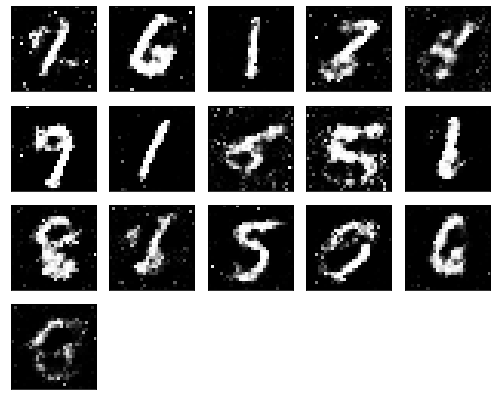

Epochs nb. 7631
discriminator loss: 0.6082098484039307
generator loss : 0.9191285371780396

Epochs nb. 7632
discriminator loss: 0.5551809668540955
generator loss : 1.0713269710540771

Epochs nb. 7633
discriminator loss: 0.5668518543243408
generator loss : 0.8337152600288391

Epochs nb. 7634
discriminator loss: 0.7072742581367493
generator loss : 1.0972470045089722

Epochs nb. 7635
discriminator loss: 0.6278458833694458
generator loss : 0.9569820761680603

Epochs nb. 7636
discriminator loss: 0.5575821399688721
generator loss : 1.0457686185836792

Epochs nb. 7637
discriminator loss: 0.702445387840271
generator loss : 0.923183023929596

Epochs nb. 7638
discriminator loss: 0.5461828112602234
generator loss : 1.0533866882324219

Epochs nb. 7639
discriminator loss: 0.5856395959854126
generator loss : 1.085261583328247

Epochs nb. 7640
discriminator loss: 0.6945053339004517
generator loss : 1.094398021697998



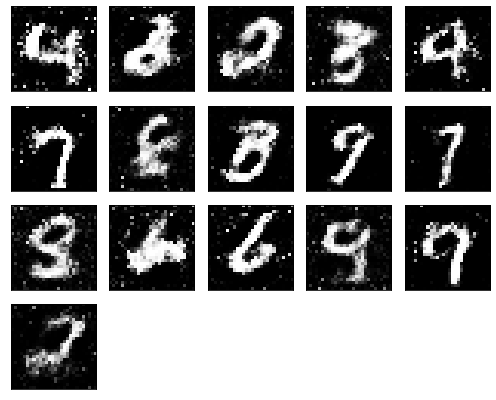

Epochs nb. 7641
discriminator loss: 0.7306480407714844
generator loss : 1.0184296369552612

Epochs nb. 7642
discriminator loss: 0.6339230537414551
generator loss : 1.0142672061920166

Epochs nb. 7643
discriminator loss: 0.5125309228897095
generator loss : 0.7976155877113342

Epochs nb. 7644
discriminator loss: 0.6962000131607056
generator loss : 0.9481534957885742

Epochs nb. 7645
discriminator loss: 0.5848224759101868
generator loss : 0.8912593722343445

Epochs nb. 7646
discriminator loss: 0.7133907079696655
generator loss : 0.973325252532959

Epochs nb. 7647
discriminator loss: 0.6088860034942627
generator loss : 0.9900363683700562

Epochs nb. 7648
discriminator loss: 0.6643276810646057
generator loss : 0.9908826947212219

Epochs nb. 7649
discriminator loss: 0.6258013248443604
generator loss : 1.1315357685089111

Epochs nb. 7650
discriminator loss: 0.43908631801605225
generator loss : 1.0845978260040283



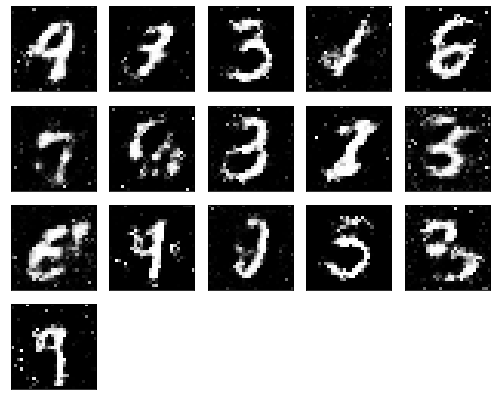

Epochs nb. 7651
discriminator loss: 0.6344848275184631
generator loss : 1.0536272525787354

Epochs nb. 7652
discriminator loss: 0.6619833707809448
generator loss : 0.8962904214859009

Epochs nb. 7653
discriminator loss: 0.6355071067810059
generator loss : 1.0536563396453857

Epochs nb. 7654
discriminator loss: 0.5643097162246704
generator loss : 0.9893665313720703

Epochs nb. 7655
discriminator loss: 0.626221239566803
generator loss : 1.0569121837615967

Epochs nb. 7656
discriminator loss: 0.5545465350151062
generator loss : 0.9873342514038086

Epochs nb. 7657
discriminator loss: 0.5823425650596619
generator loss : 1.0157921314239502

Epochs nb. 7658
discriminator loss: 0.7283912897109985
generator loss : 1.0552210807800293

Epochs nb. 7659
discriminator loss: 0.6598283052444458
generator loss : 0.8175246715545654

Epochs nb. 7660
discriminator loss: 0.553863525390625
generator loss : 1.1723432540893555



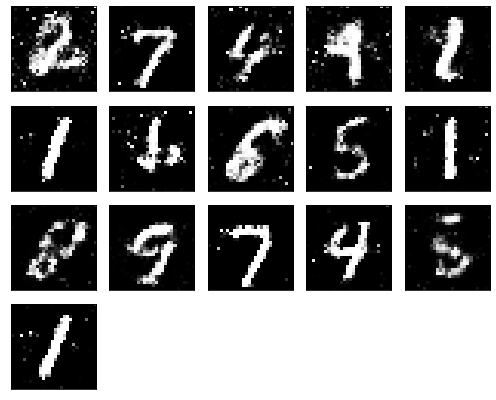

Epochs nb. 7661
discriminator loss: 0.4281497001647949
generator loss : 1.1134748458862305

Epochs nb. 7662
discriminator loss: 0.7729937434196472
generator loss : 1.1380444765090942

Epochs nb. 7663
discriminator loss: 0.5071659684181213
generator loss : 1.2182037830352783

Epochs nb. 7664
discriminator loss: 0.6181042790412903
generator loss : 0.9199753403663635

Epochs nb. 7665
discriminator loss: 0.6377277374267578
generator loss : 1.0275777578353882

Epochs nb. 7666
discriminator loss: 0.6514405012130737
generator loss : 1.0106596946716309

Epochs nb. 7667
discriminator loss: 0.7295808792114258
generator loss : 1.1124507188796997

Epochs nb. 7668
discriminator loss: 0.773926854133606
generator loss : 0.9732738733291626

Epochs nb. 7669
discriminator loss: 0.6429994106292725
generator loss : 1.1181174516677856

Epochs nb. 7670
discriminator loss: 0.5558533072471619
generator loss : 1.235358476638794



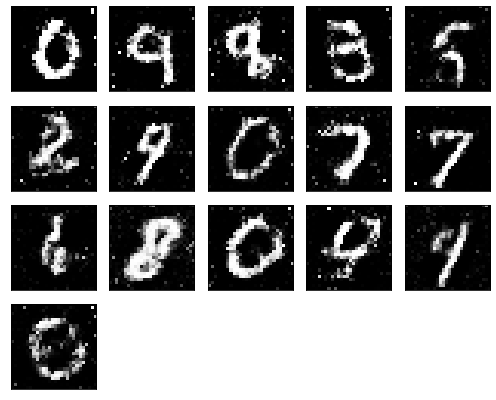

Epochs nb. 7671
discriminator loss: 0.6329200267791748
generator loss : 0.8635227680206299

Epochs nb. 7672
discriminator loss: 0.5662431716918945
generator loss : 0.7879100441932678

Epochs nb. 7673
discriminator loss: 0.5196073055267334
generator loss : 1.0544562339782715

Epochs nb. 7674
discriminator loss: 0.5811113715171814
generator loss : 0.8022640347480774

Epochs nb. 7675
discriminator loss: 0.6003014445304871
generator loss : 1.013920545578003

Epochs nb. 7676
discriminator loss: 0.6492407321929932
generator loss : 0.7688174843788147

Epochs nb. 7677
discriminator loss: 0.6691420674324036
generator loss : 1.0134119987487793

Epochs nb. 7678
discriminator loss: 0.6525604128837585
generator loss : 0.9574618339538574

Epochs nb. 7679
discriminator loss: 0.6714321374893188
generator loss : 0.8122824430465698

Epochs nb. 7680
discriminator loss: 0.6272579431533813
generator loss : 0.9497839212417603



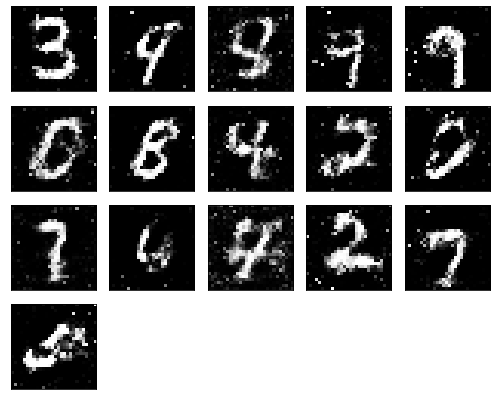

Epochs nb. 7681
discriminator loss: 0.6525062918663025
generator loss : 1.0474495887756348

Epochs nb. 7682
discriminator loss: 0.6329659819602966
generator loss : 0.9554049372673035

Epochs nb. 7683
discriminator loss: 0.6671750545501709
generator loss : 0.9615212678909302

Epochs nb. 7684
discriminator loss: 0.5908840894699097
generator loss : 0.9623008966445923

Epochs nb. 7685
discriminator loss: 0.7262944579124451
generator loss : 0.9812201857566833

Epochs nb. 7686
discriminator loss: 0.662467360496521
generator loss : 1.0761888027191162

Epochs nb. 7687
discriminator loss: 0.5793012380599976
generator loss : 1.030829906463623

Epochs nb. 7688
discriminator loss: 0.5686471462249756
generator loss : 1.0794689655303955

Epochs nb. 7689
discriminator loss: 0.4525543451309204
generator loss : 0.9559051990509033

Epochs nb. 7690
discriminator loss: 0.5486001968383789
generator loss : 1.0030442476272583



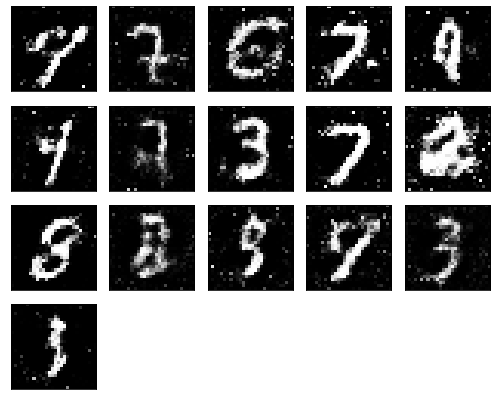

Epochs nb. 7691
discriminator loss: 0.5208879113197327
generator loss : 1.0674749612808228

Epochs nb. 7692
discriminator loss: 0.6843248605728149
generator loss : 0.9596564769744873

Epochs nb. 7693
discriminator loss: 0.5838139653205872
generator loss : 0.8351895213127136

Epochs nb. 7694
discriminator loss: 0.64238440990448
generator loss : 0.966577410697937

Epochs nb. 7695
discriminator loss: 0.65043044090271
generator loss : 0.759739100933075

Epochs nb. 7696
discriminator loss: 0.6304203867912292
generator loss : 0.9247137904167175

Epochs nb. 7697
discriminator loss: 0.49716246128082275
generator loss : 0.9132851362228394

Epochs nb. 7698
discriminator loss: 0.6499040126800537
generator loss : 0.8815897703170776

Epochs nb. 7699
discriminator loss: 0.45521050691604614
generator loss : 0.9729946255683899

Epochs nb. 7700
discriminator loss: 0.6157745122909546
generator loss : 0.9749224781990051



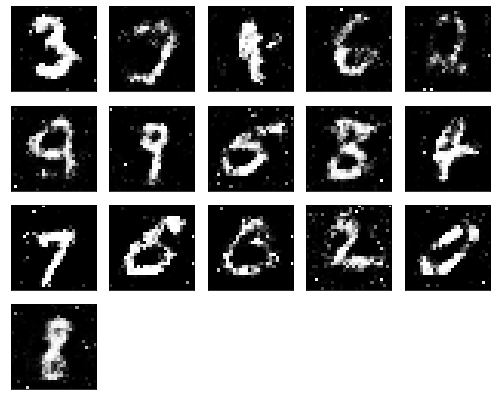

Epochs nb. 7701
discriminator loss: 0.538153886795044
generator loss : 0.9885765910148621

Epochs nb. 7702
discriminator loss: 0.6416816115379333
generator loss : 0.9629358649253845

Epochs nb. 7703
discriminator loss: 0.6332356929779053
generator loss : 0.9647371172904968

Epochs nb. 7704
discriminator loss: 0.5069434642791748
generator loss : 1.088754415512085

Epochs nb. 7705
discriminator loss: 0.5433509945869446
generator loss : 0.9723840951919556

Epochs nb. 7706
discriminator loss: 0.5087637305259705
generator loss : 0.899908185005188

Epochs nb. 7707
discriminator loss: 0.6388830542564392
generator loss : 1.0070253610610962

Epochs nb. 7708
discriminator loss: 0.5632106065750122
generator loss : 1.1575038433074951

Epochs nb. 7709
discriminator loss: 0.5468900203704834
generator loss : 1.172273874282837

Epochs nb. 7710
discriminator loss: 0.5943119525909424
generator loss : 1.006800889968872



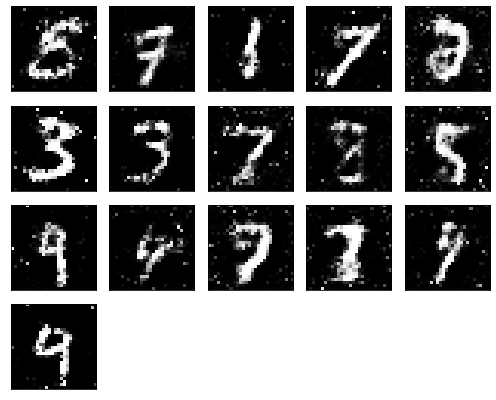

Epochs nb. 7711
discriminator loss: 0.6152000427246094
generator loss : 1.2549976110458374

Epochs nb. 7712
discriminator loss: 0.7382882237434387
generator loss : 1.2711119651794434

Epochs nb. 7713
discriminator loss: 0.703508734703064
generator loss : 0.8628053665161133

Epochs nb. 7714
discriminator loss: 0.6351860165596008
generator loss : 0.8905981183052063

Epochs nb. 7715
discriminator loss: 0.5736913681030273
generator loss : 1.0280269384384155

Epochs nb. 7716
discriminator loss: 0.47969967126846313
generator loss : 0.9246760606765747

Epochs nb. 7717
discriminator loss: 0.6338560581207275
generator loss : 0.9986853003501892

Epochs nb. 7718
discriminator loss: 0.6529135704040527
generator loss : 0.9526268839836121

Epochs nb. 7719
discriminator loss: 0.5624703168869019
generator loss : 0.8851416110992432

Epochs nb. 7720
discriminator loss: 0.5102038383483887
generator loss : 0.8287041783332825



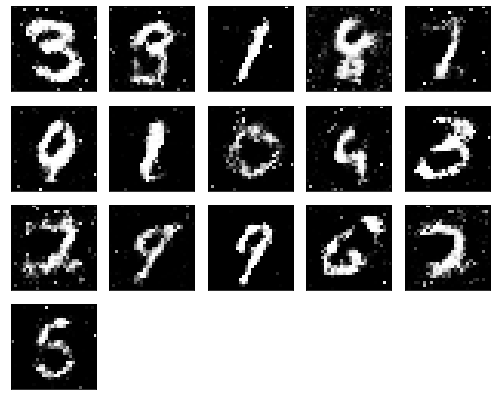

Epochs nb. 7721
discriminator loss: 0.6888545751571655
generator loss : 1.0179450511932373

Epochs nb. 7722
discriminator loss: 0.5806546211242676
generator loss : 0.9096260666847229

Epochs nb. 7723
discriminator loss: 0.5955150127410889
generator loss : 0.7895386219024658

Epochs nb. 7724
discriminator loss: 0.49518054723739624
generator loss : 0.9506241083145142

Epochs nb. 7725
discriminator loss: 0.539720892906189
generator loss : 1.1944491863250732

Epochs nb. 7726
discriminator loss: 0.6812671422958374
generator loss : 1.0387287139892578

Epochs nb. 7727
discriminator loss: 0.49282827973365784
generator loss : 0.9262515306472778

Epochs nb. 7728
discriminator loss: 0.5627573728561401
generator loss : 1.1455332040786743

Epochs nb. 7729
discriminator loss: 0.7227627038955688
generator loss : 1.1453070640563965

Epochs nb. 7730
discriminator loss: 0.6907203793525696
generator loss : 1.0156893730163574



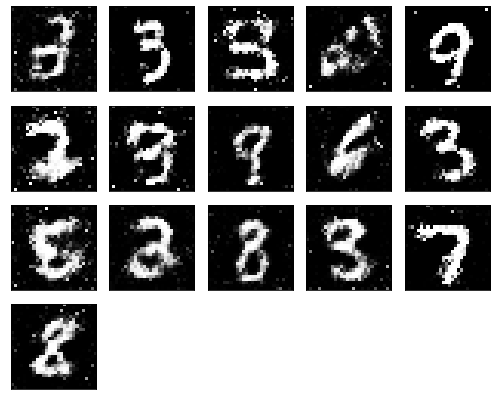

Epochs nb. 7731
discriminator loss: 0.6305220127105713
generator loss : 1.207594394683838

Epochs nb. 7732
discriminator loss: 0.7375157475471497
generator loss : 1.1806349754333496

Epochs nb. 7733
discriminator loss: 0.6741873025894165
generator loss : 0.890961766242981

Epochs nb. 7734
discriminator loss: 0.579089879989624
generator loss : 1.0857667922973633

Epochs nb. 7735
discriminator loss: 0.6567479968070984
generator loss : 1.0116649866104126

Epochs nb. 7736
discriminator loss: 0.5785534381866455
generator loss : 1.1620385646820068

Epochs nb. 7737
discriminator loss: 0.5526304244995117
generator loss : 0.9917581081390381

Epochs nb. 7738
discriminator loss: 0.6146330833435059
generator loss : 0.9126112461090088

Epochs nb. 7739
discriminator loss: 0.5801721811294556
generator loss : 0.8833507299423218

Epochs nb. 7740
discriminator loss: 0.5496311187744141
generator loss : 0.8776253461837769



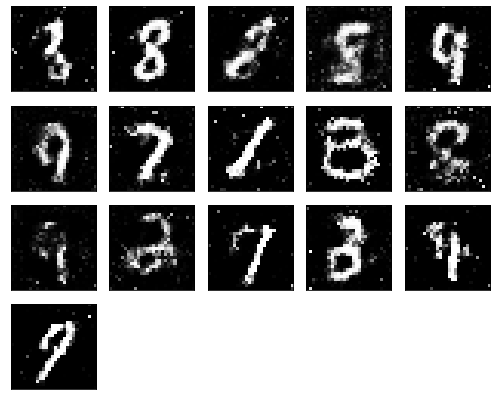

Epochs nb. 7741
discriminator loss: 0.5277748703956604
generator loss : 0.8453824520111084

Epochs nb. 7742
discriminator loss: 0.5704480409622192
generator loss : 0.9262032508850098

Epochs nb. 7743
discriminator loss: 0.6552120447158813
generator loss : 0.9643923044204712

Epochs nb. 7744
discriminator loss: 0.5605682134628296
generator loss : 0.9861594438552856

Epochs nb. 7745
discriminator loss: 0.5640684962272644
generator loss : 0.881247878074646

Epochs nb. 7746
discriminator loss: 0.5053399801254272
generator loss : 1.0023903846740723

Epochs nb. 7747
discriminator loss: 0.5923660397529602
generator loss : 1.110167384147644

Epochs nb. 7748
discriminator loss: 0.6753402352333069
generator loss : 1.0357389450073242

Epochs nb. 7749
discriminator loss: 0.5576632022857666
generator loss : 1.0366700887680054

Epochs nb. 7750
discriminator loss: 0.591569185256958
generator loss : 1.0115220546722412



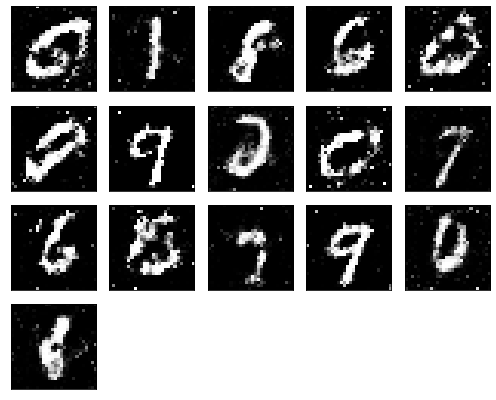

Epochs nb. 7751
discriminator loss: 0.574673056602478
generator loss : 0.9611240029335022

Epochs nb. 7752
discriminator loss: 0.5545306205749512
generator loss : 0.8217380046844482

Epochs nb. 7753
discriminator loss: 0.5848959684371948
generator loss : 1.068141222000122

Epochs nb. 7754
discriminator loss: 0.6653597354888916
generator loss : 1.0815917253494263

Epochs nb. 7755
discriminator loss: 0.6566314101219177
generator loss : 0.9725465774536133

Epochs nb. 7756
discriminator loss: 0.6537413597106934
generator loss : 0.9674906730651855

Epochs nb. 7757
discriminator loss: 0.46623098850250244
generator loss : 0.8987468481063843

Epochs nb. 7758
discriminator loss: 0.7022067308425903
generator loss : 1.1073461771011353

Epochs nb. 7759
discriminator loss: 0.5588013529777527
generator loss : 0.8908836245536804

Epochs nb. 7760
discriminator loss: 0.4779090881347656
generator loss : 0.9583564400672913



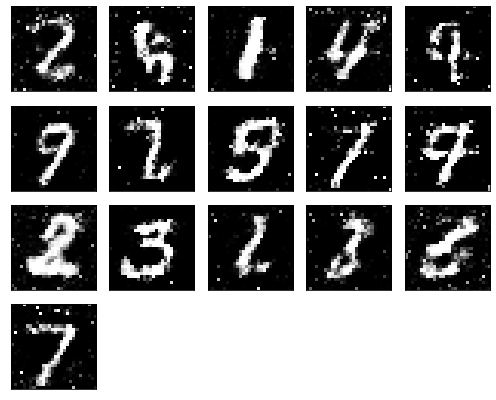

Epochs nb. 7761
discriminator loss: 0.5917941927909851
generator loss : 0.9760889410972595

Epochs nb. 7762
discriminator loss: 0.6182048320770264
generator loss : 1.0831317901611328

Epochs nb. 7763
discriminator loss: 0.6426246166229248
generator loss : 0.922751784324646

Epochs nb. 7764
discriminator loss: 0.608731746673584
generator loss : 1.142719030380249

Epochs nb. 7765
discriminator loss: 0.7151724100112915
generator loss : 1.0192108154296875

Epochs nb. 7766
discriminator loss: 0.5402953624725342
generator loss : 1.1552178859710693

Epochs nb. 7767
discriminator loss: 0.5194944143295288
generator loss : 1.1872234344482422

Epochs nb. 7768
discriminator loss: 0.49825817346572876
generator loss : 0.8317278027534485

Epochs nb. 7769
discriminator loss: 0.5040445327758789
generator loss : 1.1794557571411133

Epochs nb. 7770
discriminator loss: 0.6410483121871948
generator loss : 0.8303329944610596



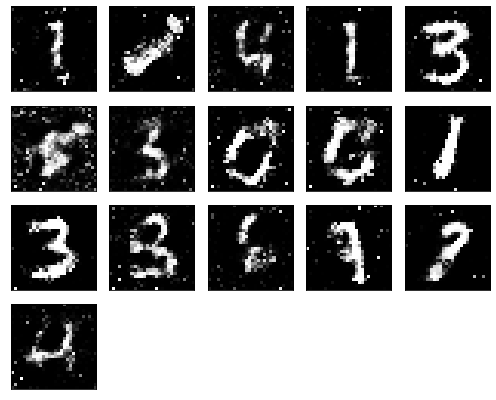

Epochs nb. 7771
discriminator loss: 0.4816841185092926
generator loss : 1.1438064575195312

Epochs nb. 7772
discriminator loss: 0.6792503595352173
generator loss : 1.1218024492263794

Epochs nb. 7773
discriminator loss: 0.7267788052558899
generator loss : 0.9212860465049744

Epochs nb. 7774
discriminator loss: 0.5050839781761169
generator loss : 0.9481018781661987

Epochs nb. 7775
discriminator loss: 0.5488836765289307
generator loss : 0.8588927984237671

Epochs nb. 7776
discriminator loss: 0.60394287109375
generator loss : 0.9357587695121765

Epochs nb. 7777
discriminator loss: 0.5879097580909729
generator loss : 1.0257899761199951

Epochs nb. 7778
discriminator loss: 0.5557562112808228
generator loss : 0.8491145372390747

Epochs nb. 7779
discriminator loss: 0.6576243042945862
generator loss : 1.0377408266067505

Epochs nb. 7780
discriminator loss: 0.5704900026321411
generator loss : 1.1379276514053345



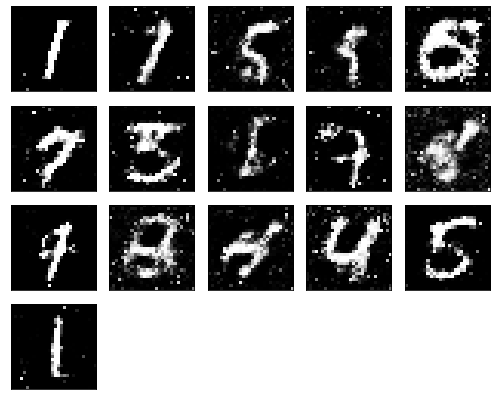

Epochs nb. 7781
discriminator loss: 0.6442892551422119
generator loss : 1.2236652374267578

Epochs nb. 7782
discriminator loss: 0.5329000949859619
generator loss : 1.0905041694641113

Epochs nb. 7783
discriminator loss: 0.5519041419029236
generator loss : 1.1705102920532227

Epochs nb. 7784
discriminator loss: 0.7770758867263794
generator loss : 1.0474509000778198

Epochs nb. 7785
discriminator loss: 0.6269034147262573
generator loss : 0.8170632123947144

Epochs nb. 7786
discriminator loss: 0.7279990911483765
generator loss : 0.9034868478775024

Epochs nb. 7787
discriminator loss: 0.5093892812728882
generator loss : 0.9102458357810974

Epochs nb. 7788
discriminator loss: 0.6081269383430481
generator loss : 0.9148561954498291

Epochs nb. 7789
discriminator loss: 0.6309951543807983
generator loss : 0.8742111921310425

Epochs nb. 7790
discriminator loss: 0.5980546474456787
generator loss : 0.8998622298240662



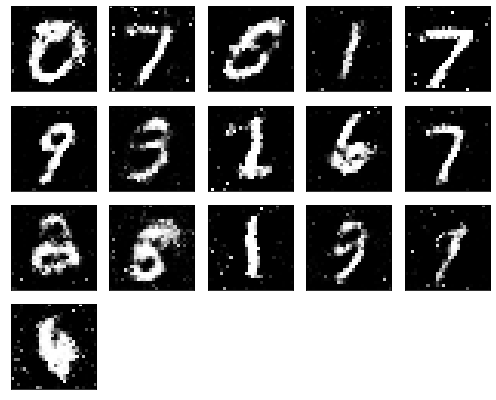

Epochs nb. 7791
discriminator loss: 0.7158255577087402
generator loss : 0.9296227693557739

Epochs nb. 7792
discriminator loss: 0.5834597945213318
generator loss : 0.8724038600921631

Epochs nb. 7793
discriminator loss: 0.861562192440033
generator loss : 1.0626481771469116

Epochs nb. 7794
discriminator loss: 0.6915221214294434
generator loss : 0.999930739402771

Epochs nb. 7795
discriminator loss: 0.5454667806625366
generator loss : 0.9843463897705078

Epochs nb. 7796
discriminator loss: 0.4593263864517212
generator loss : 0.9832189679145813

Epochs nb. 7797
discriminator loss: 0.6178529858589172
generator loss : 1.1865339279174805

Epochs nb. 7798
discriminator loss: 0.6043207049369812
generator loss : 1.2938706874847412

Epochs nb. 7799
discriminator loss: 0.6287276744842529
generator loss : 0.9972736835479736

Epochs nb. 7800
discriminator loss: 0.6351061463356018
generator loss : 0.8434916734695435



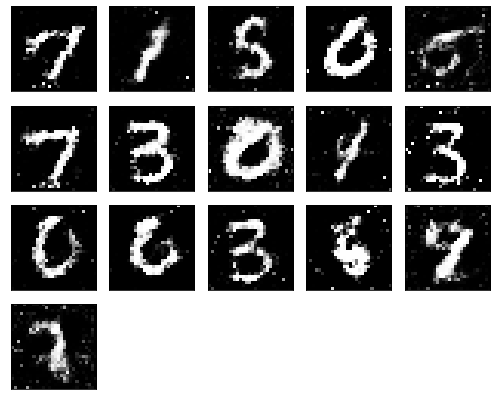

Epochs nb. 7801
discriminator loss: 0.5087630748748779
generator loss : 0.9837321639060974

Epochs nb. 7802
discriminator loss: 0.5789939165115356
generator loss : 1.0297110080718994

Epochs nb. 7803
discriminator loss: 0.6923812627792358
generator loss : 1.0105820894241333

Epochs nb. 7804
discriminator loss: 0.673965573310852
generator loss : 1.0143554210662842

Epochs nb. 7805
discriminator loss: 0.47331345081329346
generator loss : 0.9761508703231812

Epochs nb. 7806
discriminator loss: 0.6802328824996948
generator loss : 1.0307044982910156

Epochs nb. 7807
discriminator loss: 0.6231964826583862
generator loss : 1.045467734336853

Epochs nb. 7808
discriminator loss: 0.4654499292373657
generator loss : 0.7984790802001953

Epochs nb. 7809
discriminator loss: 0.5310752391815186
generator loss : 0.9875575304031372

Epochs nb. 7810
discriminator loss: 0.7194892168045044
generator loss : 0.9757822751998901



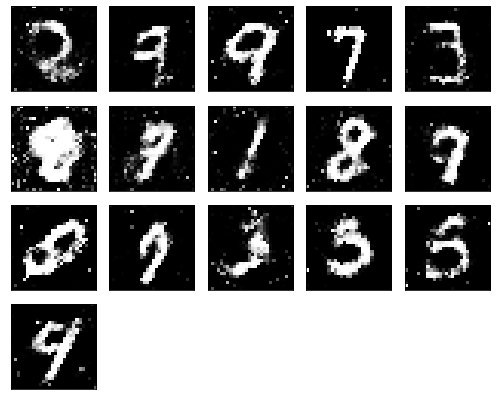

Epochs nb. 7811
discriminator loss: 0.5819780826568604
generator loss : 0.8855758905410767

Epochs nb. 7812
discriminator loss: 0.64105623960495
generator loss : 0.9765532612800598

Epochs nb. 7813
discriminator loss: 0.5427627563476562
generator loss : 1.1270031929016113

Epochs nb. 7814
discriminator loss: 0.5953297019004822
generator loss : 1.242829442024231

Epochs nb. 7815
discriminator loss: 0.4398980736732483
generator loss : 1.2079788446426392

Epochs nb. 7816
discriminator loss: 0.5867765545845032
generator loss : 1.0768921375274658

Epochs nb. 7817
discriminator loss: 0.4563862979412079
generator loss : 0.9476388692855835

Epochs nb. 7818
discriminator loss: 0.5900142192840576
generator loss : 1.0499359369277954

Epochs nb. 7819
discriminator loss: 0.616673469543457
generator loss : 1.046269416809082

Epochs nb. 7820
discriminator loss: 0.5669358372688293
generator loss : 1.0388493537902832



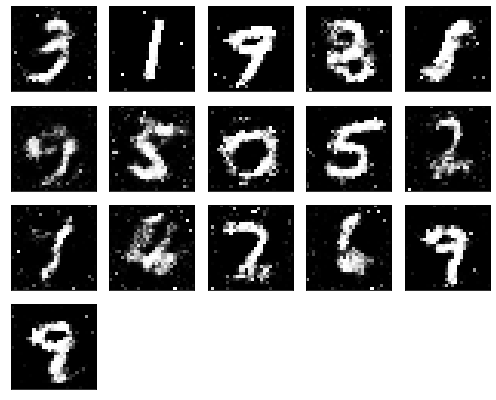

Epochs nb. 7821
discriminator loss: 0.5956979990005493
generator loss : 0.9240045547485352

Epochs nb. 7822
discriminator loss: 0.5083550214767456
generator loss : 0.9337700605392456

Epochs nb. 7823
discriminator loss: 0.565256655216217
generator loss : 1.032676339149475

Epochs nb. 7824
discriminator loss: 0.4427635669708252
generator loss : 1.0309176445007324

Epochs nb. 7825
discriminator loss: 0.5946122407913208
generator loss : 0.7565983533859253

Epochs nb. 7826
discriminator loss: 0.5415056943893433
generator loss : 1.0036354064941406

Epochs nb. 7827
discriminator loss: 0.5966625213623047
generator loss : 1.2052481174468994

Epochs nb. 7828
discriminator loss: 0.5875809192657471
generator loss : 0.9144904017448425

Epochs nb. 7829
discriminator loss: 0.6355833411216736
generator loss : 1.0060153007507324

Epochs nb. 7830
discriminator loss: 0.5265559554100037
generator loss : 0.8309246301651001



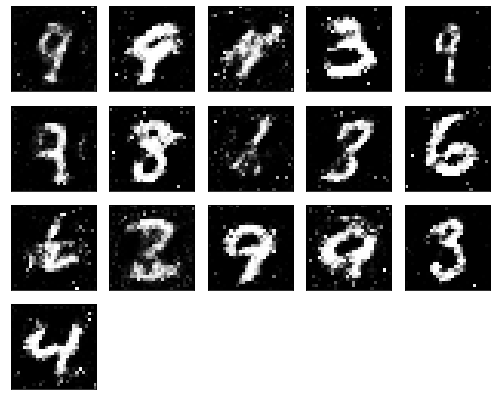

Epochs nb. 7831
discriminator loss: 0.5249537229537964
generator loss : 1.126803994178772

Epochs nb. 7832
discriminator loss: 0.8347506523132324
generator loss : 0.9885844588279724

Epochs nb. 7833
discriminator loss: 0.527947187423706
generator loss : 1.0386073589324951

Epochs nb. 7834
discriminator loss: 0.5474489331245422
generator loss : 0.9418878555297852

Epochs nb. 7835
discriminator loss: 0.48794350028038025
generator loss : 1.008434772491455

Epochs nb. 7836
discriminator loss: 0.6611770987510681
generator loss : 1.0611087083816528

Epochs nb. 7837
discriminator loss: 0.5172789692878723
generator loss : 1.1589959859848022

Epochs nb. 7838
discriminator loss: 0.5808922052383423
generator loss : 1.0733885765075684

Epochs nb. 7839
discriminator loss: 0.5848932266235352
generator loss : 0.9735996723175049

Epochs nb. 7840
discriminator loss: 0.5785698890686035
generator loss : 0.973041832447052



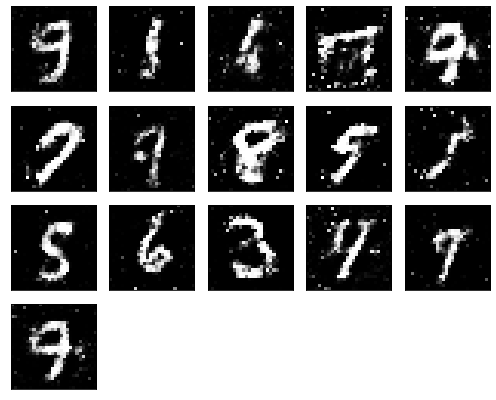

Epochs nb. 7841
discriminator loss: 0.5937584638595581
generator loss : 0.879409909248352

Epochs nb. 7842
discriminator loss: 0.5781723260879517
generator loss : 1.01258385181427

Epochs nb. 7843
discriminator loss: 0.552048921585083
generator loss : 0.9570704698562622

Epochs nb. 7844
discriminator loss: 0.48273536562919617
generator loss : 1.057140827178955

Epochs nb. 7845
discriminator loss: 0.6289530992507935
generator loss : 1.0666570663452148

Epochs nb. 7846
discriminator loss: 0.4602919816970825
generator loss : 1.262202262878418

Epochs nb. 7847
discriminator loss: 0.6314409971237183
generator loss : 1.2279152870178223

Epochs nb. 7848
discriminator loss: 0.6281898021697998
generator loss : 0.9116127490997314

Epochs nb. 7849
discriminator loss: 0.476240873336792
generator loss : 1.1655467748641968

Epochs nb. 7850
discriminator loss: 0.5311561226844788
generator loss : 0.9583607912063599



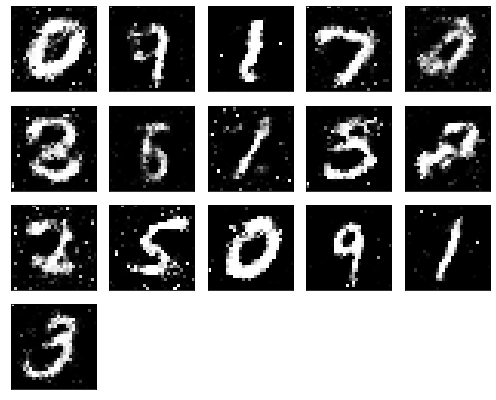

Epochs nb. 7851
discriminator loss: 0.5648030042648315
generator loss : 0.8741470575332642

Epochs nb. 7852
discriminator loss: 0.5771559476852417
generator loss : 1.0739084482192993

Epochs nb. 7853
discriminator loss: 0.6129322648048401
generator loss : 1.035876750946045

Epochs nb. 7854
discriminator loss: 0.6909807920455933
generator loss : 1.0228097438812256

Epochs nb. 7855
discriminator loss: 0.5690865516662598
generator loss : 1.2857589721679688

Epochs nb. 7856
discriminator loss: 0.5508233308792114
generator loss : 1.0774633884429932

Epochs nb. 7857
discriminator loss: 0.8396706581115723
generator loss : 0.9156836867332458

Epochs nb. 7858
discriminator loss: 0.6302900910377502
generator loss : 1.0427699089050293

Epochs nb. 7859
discriminator loss: 0.4188084900379181
generator loss : 0.8208581209182739

Epochs nb. 7860
discriminator loss: 0.5911000967025757
generator loss : 1.072460651397705



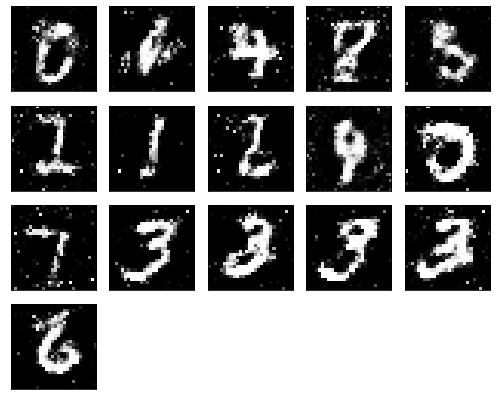

Epochs nb. 7861
discriminator loss: 0.5736992955207825
generator loss : 0.9248223900794983

Epochs nb. 7862
discriminator loss: 0.654868483543396
generator loss : 1.2304744720458984

Epochs nb. 7863
discriminator loss: 0.6241214275360107
generator loss : 1.0110706090927124

Epochs nb. 7864
discriminator loss: 0.5935595035552979
generator loss : 0.9175436496734619

Epochs nb. 7865
discriminator loss: 0.5531635880470276
generator loss : 0.8629888296127319

Epochs nb. 7866
discriminator loss: 0.5989689230918884
generator loss : 0.9704315066337585

Epochs nb. 7867
discriminator loss: 0.501725435256958
generator loss : 1.1606330871582031

Epochs nb. 7868
discriminator loss: 0.5634337067604065
generator loss : 1.116044044494629

Epochs nb. 7869
discriminator loss: 0.5951682329177856
generator loss : 0.9794577956199646

Epochs nb. 7870
discriminator loss: 0.6485169529914856
generator loss : 1.0635223388671875



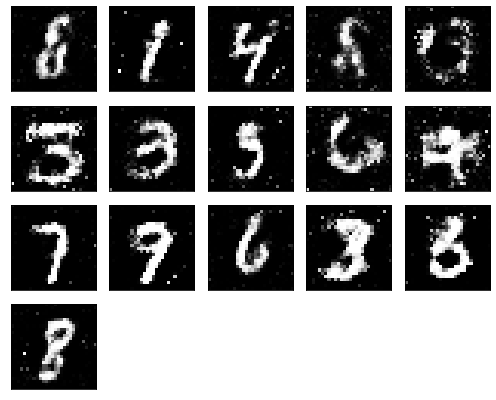

Epochs nb. 7871
discriminator loss: 0.491586834192276
generator loss : 0.9857986569404602

Epochs nb. 7872
discriminator loss: 0.7000705003738403
generator loss : 0.9388766288757324

Epochs nb. 7873
discriminator loss: 0.5566452741622925
generator loss : 0.9736155271530151

Epochs nb. 7874
discriminator loss: 0.4682743549346924
generator loss : 0.8549202680587769

Epochs nb. 7875
discriminator loss: 0.6150870323181152
generator loss : 0.9863079786300659

Epochs nb. 7876
discriminator loss: 0.5306183695793152
generator loss : 0.9687954187393188

Epochs nb. 7877
discriminator loss: 0.6495018005371094
generator loss : 1.0378265380859375

Epochs nb. 7878
discriminator loss: 0.506217360496521
generator loss : 0.9632412791252136

Epochs nb. 7879
discriminator loss: 0.5989766716957092
generator loss : 1.0150504112243652

Epochs nb. 7880
discriminator loss: 0.660430908203125
generator loss : 0.9647029042243958



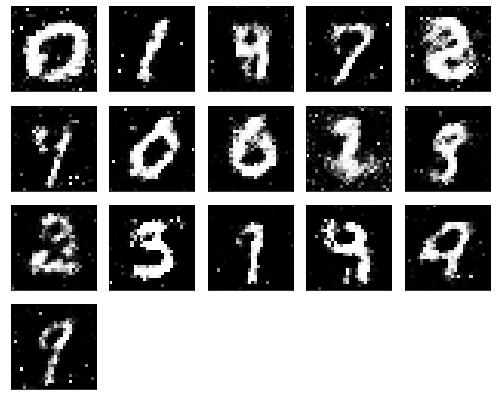

Epochs nb. 7881
discriminator loss: 0.5991279482841492
generator loss : 1.0219796895980835

Epochs nb. 7882
discriminator loss: 0.7746632695198059
generator loss : 0.9715483784675598

Epochs nb. 7883
discriminator loss: 0.6727230548858643
generator loss : 0.8354972004890442

Epochs nb. 7884
discriminator loss: 0.5208881497383118
generator loss : 0.9075184464454651

Epochs nb. 7885
discriminator loss: 0.6066306829452515
generator loss : 1.001539945602417

Epochs nb. 7886
discriminator loss: 0.6307945251464844
generator loss : 1.038009524345398

Epochs nb. 7887
discriminator loss: 0.629304051399231
generator loss : 1.255307912826538

Epochs nb. 7888
discriminator loss: 0.5942935347557068
generator loss : 1.0162839889526367

Epochs nb. 7889
discriminator loss: 0.611324667930603
generator loss : 0.6837761402130127

Epochs nb. 7890
discriminator loss: 0.6704879999160767
generator loss : 0.8789544701576233



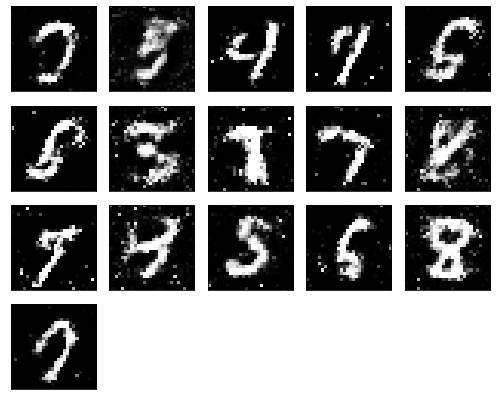

Epochs nb. 7891
discriminator loss: 0.6427625417709351
generator loss : 1.0839409828186035

Epochs nb. 7892
discriminator loss: 0.6102055311203003
generator loss : 1.0584423542022705

Epochs nb. 7893
discriminator loss: 0.5433570146560669
generator loss : 0.9617035388946533

Epochs nb. 7894
discriminator loss: 0.6468534469604492
generator loss : 1.0013409852981567

Epochs nb. 7895
discriminator loss: 0.6387569308280945
generator loss : 1.1809382438659668

Epochs nb. 7896
discriminator loss: 0.506473183631897
generator loss : 0.9685004949569702

Epochs nb. 7897
discriminator loss: 0.6599433422088623
generator loss : 0.9508888721466064

Epochs nb. 7898
discriminator loss: 0.5714370012283325
generator loss : 1.0989429950714111

Epochs nb. 7899
discriminator loss: 0.5046764612197876
generator loss : 0.9516966342926025

Epochs nb. 7900
discriminator loss: 0.5185716152191162
generator loss : 0.9430781602859497



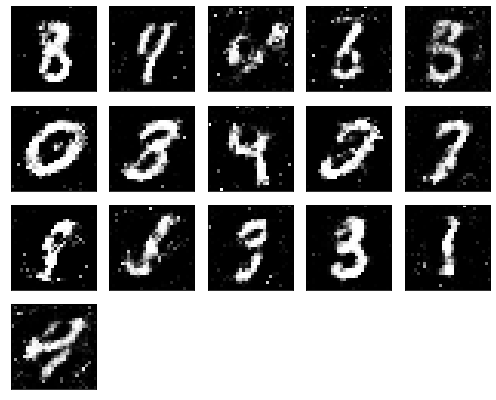

Epochs nb. 7901
discriminator loss: 0.6082159876823425
generator loss : 0.8015878200531006

Epochs nb. 7902
discriminator loss: 0.4689604640007019
generator loss : 0.9815870523452759

Epochs nb. 7903
discriminator loss: 0.5074402093887329
generator loss : 0.9111617803573608

Epochs nb. 7904
discriminator loss: 0.5852382183074951
generator loss : 1.0005223751068115

Epochs nb. 7905
discriminator loss: 0.5931475162506104
generator loss : 0.8335922360420227

Epochs nb. 7906
discriminator loss: 0.5685760974884033
generator loss : 1.085796594619751

Epochs nb. 7907
discriminator loss: 0.5591857433319092
generator loss : 1.2304878234863281

Epochs nb. 7908
discriminator loss: 0.6616991758346558
generator loss : 1.0622942447662354

Epochs nb. 7909
discriminator loss: 0.5367641448974609
generator loss : 0.9025745391845703

Epochs nb. 7910
discriminator loss: 0.6350572109222412
generator loss : 0.8055880069732666



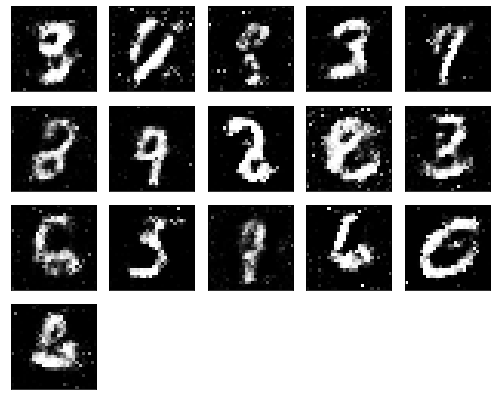

Epochs nb. 7911
discriminator loss: 0.7393344640731812
generator loss : 0.8983017206192017

Epochs nb. 7912
discriminator loss: 0.6098700761795044
generator loss : 0.860238790512085

Epochs nb. 7913
discriminator loss: 0.5833208560943604
generator loss : 1.1524907350540161

Epochs nb. 7914
discriminator loss: 0.4943980574607849
generator loss : 0.9014438390731812

Epochs nb. 7915
discriminator loss: 0.723145604133606
generator loss : 0.9804982542991638

Epochs nb. 7916
discriminator loss: 0.737942099571228
generator loss : 0.8863117694854736

Epochs nb. 7917
discriminator loss: 0.5316483974456787
generator loss : 1.2588856220245361

Epochs nb. 7918
discriminator loss: 0.5341829061508179
generator loss : 0.9755818247795105

Epochs nb. 7919
discriminator loss: 0.6394437551498413
generator loss : 1.1991016864776611

Epochs nb. 7920
discriminator loss: 0.7539467811584473
generator loss : 0.8513189554214478



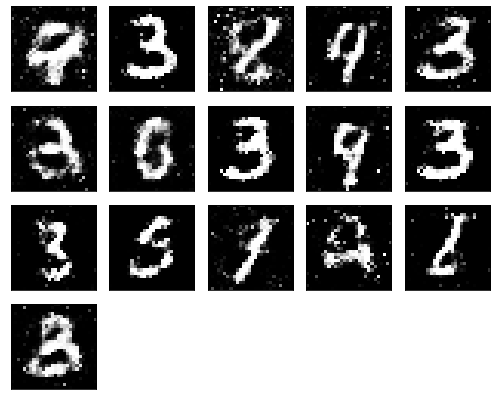

Epochs nb. 7921
discriminator loss: 0.5579606294631958
generator loss : 0.7602814435958862

Epochs nb. 7922
discriminator loss: 0.568873941898346
generator loss : 0.7883908748626709

Epochs nb. 7923
discriminator loss: 0.582446277141571
generator loss : 0.9432657957077026

Epochs nb. 7924
discriminator loss: 0.56722491979599
generator loss : 0.9932871460914612

Epochs nb. 7925
discriminator loss: 0.48945051431655884
generator loss : 1.06529700756073

Epochs nb. 7926
discriminator loss: 0.7882582545280457
generator loss : 0.9380176663398743

Epochs nb. 7927
discriminator loss: 0.561761736869812
generator loss : 0.8527017831802368

Epochs nb. 7928
discriminator loss: 0.5111871957778931
generator loss : 0.9643450379371643

Epochs nb. 7929
discriminator loss: 0.6325650215148926
generator loss : 0.7858558893203735

Epochs nb. 7930
discriminator loss: 0.7208799123764038
generator loss : 0.9805790185928345



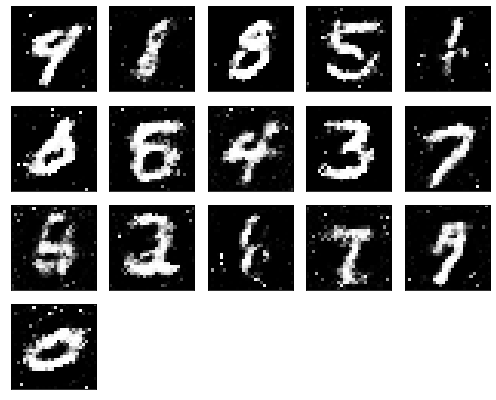

Epochs nb. 7931
discriminator loss: 0.510242223739624
generator loss : 0.9737304449081421

Epochs nb. 7932
discriminator loss: 0.6020325422286987
generator loss : 0.8386346101760864

Epochs nb. 7933
discriminator loss: 0.6659159064292908
generator loss : 0.8728091716766357

Epochs nb. 7934
discriminator loss: 0.6328702569007874
generator loss : 0.9678804874420166

Epochs nb. 7935
discriminator loss: 0.5908182859420776
generator loss : 1.068717360496521

Epochs nb. 7936
discriminator loss: 0.6996296644210815
generator loss : 0.9190313816070557

Epochs nb. 7937
discriminator loss: 0.5051435828208923
generator loss : 0.9037388563156128

Epochs nb. 7938
discriminator loss: 0.5808705687522888
generator loss : 0.96979159116745

Epochs nb. 7939
discriminator loss: 0.702386736869812
generator loss : 1.094483733177185

Epochs nb. 7940
discriminator loss: 0.6380558013916016
generator loss : 1.0271879434585571



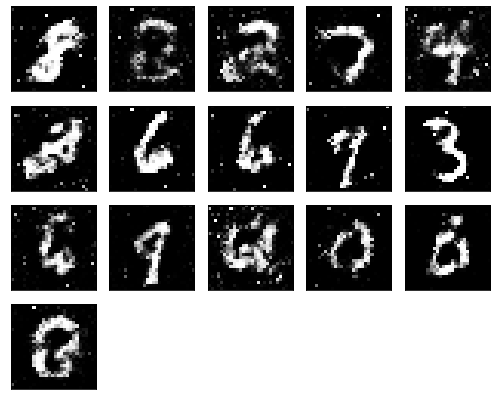

Epochs nb. 7941
discriminator loss: 0.7897430062294006
generator loss : 0.9557700157165527

Epochs nb. 7942
discriminator loss: 0.6080037951469421
generator loss : 0.9980641007423401

Epochs nb. 7943
discriminator loss: 0.5972403287887573
generator loss : 0.8972373604774475

Epochs nb. 7944
discriminator loss: 0.5103452801704407
generator loss : 1.0765199661254883

Epochs nb. 7945
discriminator loss: 0.59217369556427
generator loss : 0.9757592678070068

Epochs nb. 7946
discriminator loss: 0.5769600868225098
generator loss : 0.9359112977981567

Epochs nb. 7947
discriminator loss: 0.6395793557167053
generator loss : 1.0306791067123413

Epochs nb. 7948
discriminator loss: 0.5523263216018677
generator loss : 1.2112805843353271

Epochs nb. 7949
discriminator loss: 0.5681675672531128
generator loss : 1.1908307075500488

Epochs nb. 7950
discriminator loss: 0.7265154123306274
generator loss : 1.0946944952011108



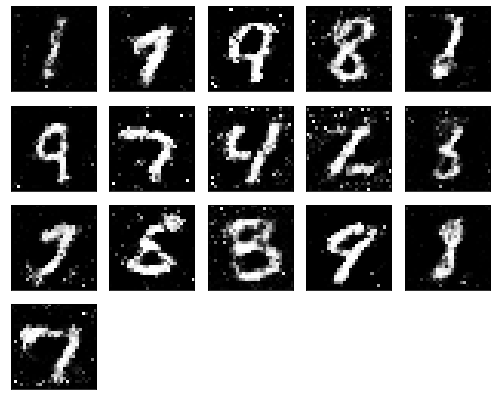

Epochs nb. 7951
discriminator loss: 0.5238367319107056
generator loss : 1.0112714767456055

Epochs nb. 7952
discriminator loss: 0.6364150047302246
generator loss : 1.1153583526611328

Epochs nb. 7953
discriminator loss: 0.6021284461021423
generator loss : 0.9072352051734924

Epochs nb. 7954
discriminator loss: 0.7906455993652344
generator loss : 1.0530438423156738

Epochs nb. 7955
discriminator loss: 0.7564107179641724
generator loss : 0.9858165383338928

Epochs nb. 7956
discriminator loss: 0.7323981523513794
generator loss : 0.9361822605133057

Epochs nb. 7957
discriminator loss: 0.7417829632759094
generator loss : 0.8733867406845093

Epochs nb. 7958
discriminator loss: 0.6389288306236267
generator loss : 1.0053036212921143

Epochs nb. 7959
discriminator loss: 0.6628777980804443
generator loss : 0.9998258352279663

Epochs nb. 7960
discriminator loss: 0.5866467952728271
generator loss : 1.014005184173584



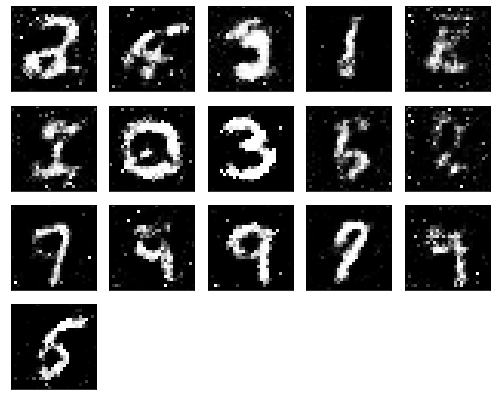

Epochs nb. 7961
discriminator loss: 0.5777055025100708
generator loss : 0.9392332434654236

Epochs nb. 7962
discriminator loss: 0.6956520080566406
generator loss : 0.9848774075508118

Epochs nb. 7963
discriminator loss: 0.6568323373794556
generator loss : 1.140411138534546

Epochs nb. 7964
discriminator loss: 0.4811425805091858
generator loss : 0.9216159582138062

Epochs nb. 7965
discriminator loss: 0.6248456239700317
generator loss : 0.9722729921340942

Epochs nb. 7966
discriminator loss: 0.6206028461456299
generator loss : 0.9178223609924316

Epochs nb. 7967
discriminator loss: 0.6950660943984985
generator loss : 1.0104528665542603

Epochs nb. 7968
discriminator loss: 0.6005260348320007
generator loss : 0.9568227529525757

Epochs nb. 7969
discriminator loss: 0.7184766530990601
generator loss : 1.0474518537521362

Epochs nb. 7970
discriminator loss: 0.5101346373558044
generator loss : 1.011928915977478



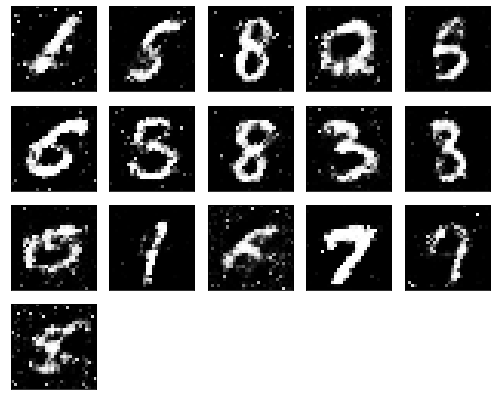

Epochs nb. 7971
discriminator loss: 0.5379398465156555
generator loss : 0.9312089085578918

Epochs nb. 7972
discriminator loss: 0.666468620300293
generator loss : 1.0530213117599487

Epochs nb. 7973
discriminator loss: 0.6390208601951599
generator loss : 0.9072304964065552

Epochs nb. 7974
discriminator loss: 0.55619877576828
generator loss : 1.011997103691101

Epochs nb. 7975
discriminator loss: 0.540235161781311
generator loss : 0.979913592338562

Epochs nb. 7976
discriminator loss: 0.7122859954833984
generator loss : 1.0898873805999756

Epochs nb. 7977
discriminator loss: 0.6253547668457031
generator loss : 0.8337275981903076

Epochs nb. 7978
discriminator loss: 0.5163546800613403
generator loss : 1.0182569026947021

Epochs nb. 7979
discriminator loss: 0.5023750066757202
generator loss : 0.9386028051376343

Epochs nb. 7980
discriminator loss: 0.5793067216873169
generator loss : 0.9346243143081665



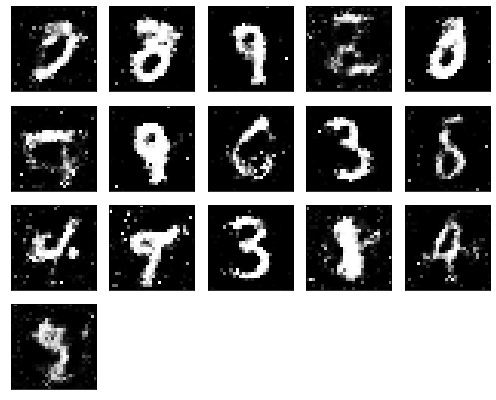

Epochs nb. 7981
discriminator loss: 0.5466825366020203
generator loss : 0.909591794013977

Epochs nb. 7982
discriminator loss: 0.6233623027801514
generator loss : 0.9582718014717102

Epochs nb. 7983
discriminator loss: 0.6266693472862244
generator loss : 1.0057340860366821

Epochs nb. 7984
discriminator loss: 0.6266313791275024
generator loss : 0.8388309478759766

Epochs nb. 7985
discriminator loss: 0.6980151534080505
generator loss : 1.128909707069397

Epochs nb. 7986
discriminator loss: 0.5669550895690918
generator loss : 1.16158926486969

Epochs nb. 7987
discriminator loss: 0.5186581611633301
generator loss : 1.3179734945297241

Epochs nb. 7988
discriminator loss: 0.5741756558418274
generator loss : 0.9679806232452393

Epochs nb. 7989
discriminator loss: 0.6612792015075684
generator loss : 0.8992980718612671

Epochs nb. 7990
discriminator loss: 0.599624752998352
generator loss : 0.9439088702201843



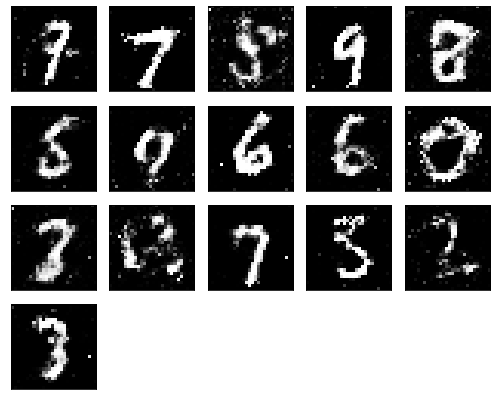

Epochs nb. 7991
discriminator loss: 0.6417279243469238
generator loss : 1.1111881732940674

Epochs nb. 7992
discriminator loss: 0.5910353660583496
generator loss : 1.004478931427002

Epochs nb. 7993
discriminator loss: 0.7052850127220154
generator loss : 0.8773640990257263

Epochs nb. 7994
discriminator loss: 0.6304215788841248
generator loss : 0.9320162534713745

Epochs nb. 7995
discriminator loss: 0.5708792209625244
generator loss : 0.9522743225097656

Epochs nb. 7996
discriminator loss: 0.5395684242248535
generator loss : 0.9360789060592651

Epochs nb. 7997
discriminator loss: 0.5543466210365295
generator loss : 0.9655513763427734

Epochs nb. 7998
discriminator loss: 0.5493476390838623
generator loss : 0.9707474112510681

Epochs nb. 7999
discriminator loss: 0.5676760673522949
generator loss : 1.0132602453231812

Epochs nb. 8000
discriminator loss: 0.5940096378326416
generator loss : 0.8532545566558838



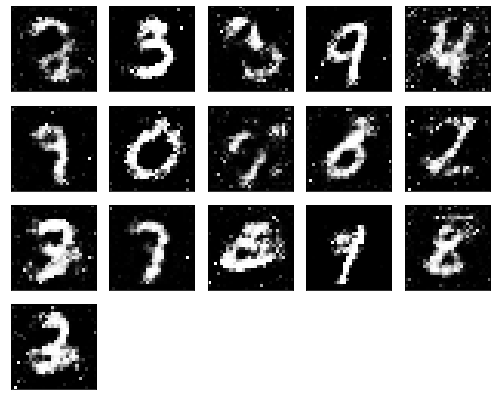

Epochs nb. 8001
discriminator loss: 0.5149429440498352
generator loss : 1.1103203296661377

Epochs nb. 8002
discriminator loss: 0.6201280951499939
generator loss : 0.9104357361793518

Epochs nb. 8003
discriminator loss: 0.6852474212646484
generator loss : 0.9626476168632507

Epochs nb. 8004
discriminator loss: 0.5894420146942139
generator loss : 0.9626555442810059

Epochs nb. 8005
discriminator loss: 0.5487560033798218
generator loss : 1.0019162893295288

Epochs nb. 8006
discriminator loss: 0.5848250389099121
generator loss : 0.7952077984809875

Epochs nb. 8007
discriminator loss: 0.5766986012458801
generator loss : 1.1179568767547607

Epochs nb. 8008
discriminator loss: 0.5563805103302002
generator loss : 1.1432015895843506

Epochs nb. 8009
discriminator loss: 0.4731588363647461
generator loss : 0.9146213531494141

Epochs nb. 8010
discriminator loss: 0.6105104684829712
generator loss : 1.0824167728424072



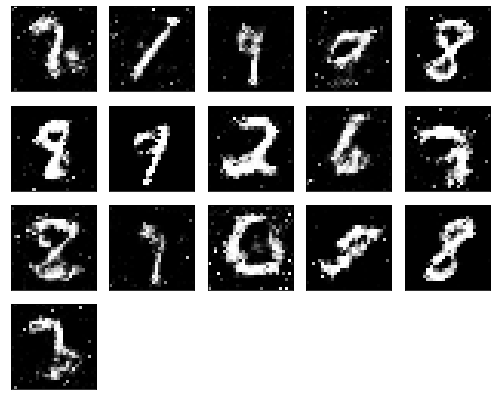

Epochs nb. 8011
discriminator loss: 0.6649243831634521
generator loss : 1.0535601377487183

Epochs nb. 8012
discriminator loss: 0.6980889439582825
generator loss : 0.9882866144180298

Epochs nb. 8013
discriminator loss: 0.5780848264694214
generator loss : 1.0982589721679688

Epochs nb. 8014
discriminator loss: 0.5884127616882324
generator loss : 0.9380151033401489

Epochs nb. 8015
discriminator loss: 0.5995193719863892
generator loss : 0.9803630709648132

Epochs nb. 8016
discriminator loss: 0.5720692873001099
generator loss : 0.9716812372207642

Epochs nb. 8017
discriminator loss: 0.5705034732818604
generator loss : 0.9521129131317139

Epochs nb. 8018
discriminator loss: 0.5774068236351013
generator loss : 1.016417384147644

Epochs nb. 8019
discriminator loss: 0.7109838724136353
generator loss : 1.2066638469696045

Epochs nb. 8020
discriminator loss: 0.5819014310836792
generator loss : 1.0124173164367676



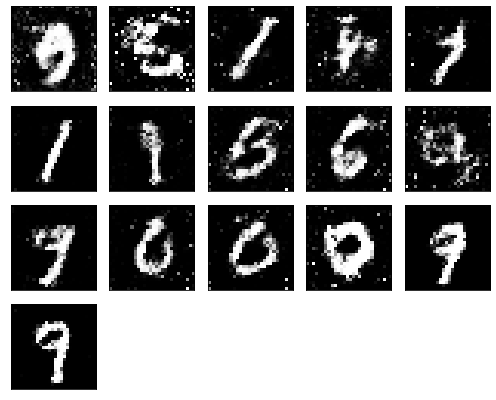

Epochs nb. 8021
discriminator loss: 0.6109537482261658
generator loss : 1.0519671440124512

Epochs nb. 8022
discriminator loss: 0.613375186920166
generator loss : 0.9951342344284058

Epochs nb. 8023
discriminator loss: 0.6210016012191772
generator loss : 1.1692935228347778

Epochs nb. 8024
discriminator loss: 0.6789457201957703
generator loss : 1.0884997844696045

Epochs nb. 8025
discriminator loss: 0.5046203136444092
generator loss : 1.0322023630142212

Epochs nb. 8026
discriminator loss: 0.5487075448036194
generator loss : 0.9363871812820435

Epochs nb. 8027
discriminator loss: 0.649519145488739
generator loss : 0.9701186418533325

Epochs nb. 8028
discriminator loss: 0.8113642930984497
generator loss : 1.0217461585998535

Epochs nb. 8029
discriminator loss: 0.5756337642669678
generator loss : 1.0187983512878418

Epochs nb. 8030
discriminator loss: 0.5081791877746582
generator loss : 0.7785290479660034



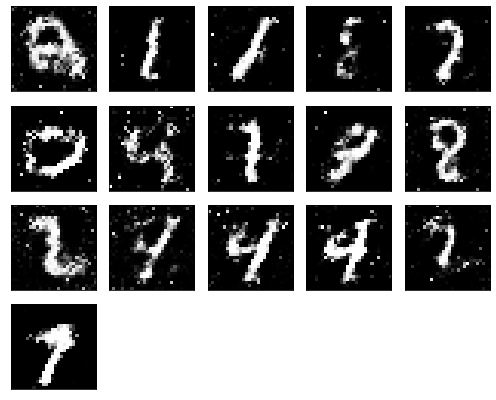

Epochs nb. 8031
discriminator loss: 0.5713988542556763
generator loss : 1.0374138355255127

Epochs nb. 8032
discriminator loss: 0.6793102025985718
generator loss : 0.9344968199729919

Epochs nb. 8033
discriminator loss: 0.6480826735496521
generator loss : 0.8445332050323486

Epochs nb. 8034
discriminator loss: 0.566897988319397
generator loss : 1.0529420375823975

Epochs nb. 8035
discriminator loss: 0.6422984600067139
generator loss : 0.8921898603439331

Epochs nb. 8036
discriminator loss: 0.5262271165847778
generator loss : 0.8898162245750427

Epochs nb. 8037
discriminator loss: 0.6013685464859009
generator loss : 0.9402763843536377

Epochs nb. 8038
discriminator loss: 0.5182123184204102
generator loss : 1.0167299509048462

Epochs nb. 8039
discriminator loss: 0.6351747512817383
generator loss : 0.849094033241272

Epochs nb. 8040
discriminator loss: 0.5545946955680847
generator loss : 0.9203214645385742



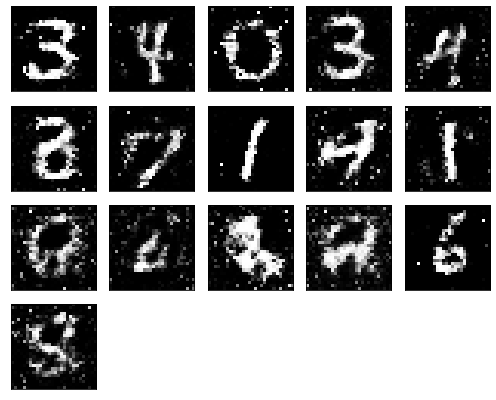

Epochs nb. 8041
discriminator loss: 0.68056321144104
generator loss : 0.8797415494918823

Epochs nb. 8042
discriminator loss: 0.5728342533111572
generator loss : 0.9637346863746643

Epochs nb. 8043
discriminator loss: 0.7590144872665405
generator loss : 1.0457110404968262

Epochs nb. 8044
discriminator loss: 0.5524927377700806
generator loss : 0.9900522232055664

Epochs nb. 8045
discriminator loss: 0.49886152148246765
generator loss : 1.042301058769226

Epochs nb. 8046
discriminator loss: 0.5538115501403809
generator loss : 1.0768749713897705

Epochs nb. 8047
discriminator loss: 0.5420078635215759
generator loss : 1.2026617527008057

Epochs nb. 8048
discriminator loss: 0.5917153358459473
generator loss : 1.1202387809753418

Epochs nb. 8049
discriminator loss: 0.558638334274292
generator loss : 0.7453963756561279

Epochs nb. 8050
discriminator loss: 0.5217703580856323
generator loss : 0.7811974287033081



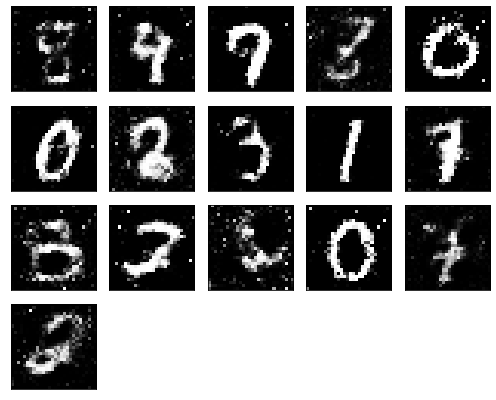

Epochs nb. 8051
discriminator loss: 0.47696855664253235
generator loss : 1.0301834344863892

Epochs nb. 8052
discriminator loss: 0.5597145557403564
generator loss : 0.8682876825332642

Epochs nb. 8053
discriminator loss: 0.4509009122848511
generator loss : 1.0474791526794434

Epochs nb. 8054
discriminator loss: 0.485636830329895
generator loss : 1.0201880931854248

Epochs nb. 8055
discriminator loss: 0.5157809853553772
generator loss : 1.2382471561431885

Epochs nb. 8056
discriminator loss: 0.48003172874450684
generator loss : 0.9972375631332397

Epochs nb. 8057
discriminator loss: 0.6090540885925293
generator loss : 1.1818312406539917

Epochs nb. 8058
discriminator loss: 0.4777955412864685
generator loss : 0.8776090145111084

Epochs nb. 8059
discriminator loss: 0.7149976491928101
generator loss : 1.1413040161132812

Epochs nb. 8060
discriminator loss: 0.5778100490570068
generator loss : 1.1009712219238281



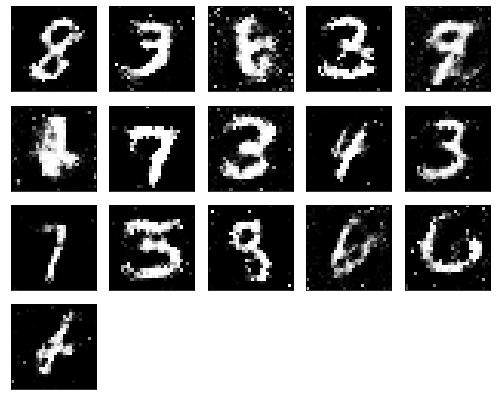

Epochs nb. 8061
discriminator loss: 0.5632326602935791
generator loss : 0.9885815978050232

Epochs nb. 8062
discriminator loss: 0.5848813056945801
generator loss : 0.9492687582969666

Epochs nb. 8063
discriminator loss: 0.5473461151123047
generator loss : 0.8330292701721191

Epochs nb. 8064
discriminator loss: 0.6560775637626648
generator loss : 1.1867341995239258

Epochs nb. 8065
discriminator loss: 0.5151817798614502
generator loss : 0.8609515428543091

Epochs nb. 8066
discriminator loss: 0.5267961025238037
generator loss : 1.1077954769134521

Epochs nb. 8067
discriminator loss: 0.5925741195678711
generator loss : 0.8364768028259277

Epochs nb. 8068
discriminator loss: 0.5807573199272156
generator loss : 1.0048609972000122

Epochs nb. 8069
discriminator loss: 0.4981490969657898
generator loss : 1.028602957725525

Epochs nb. 8070
discriminator loss: 0.5691432952880859
generator loss : 1.0675479173660278



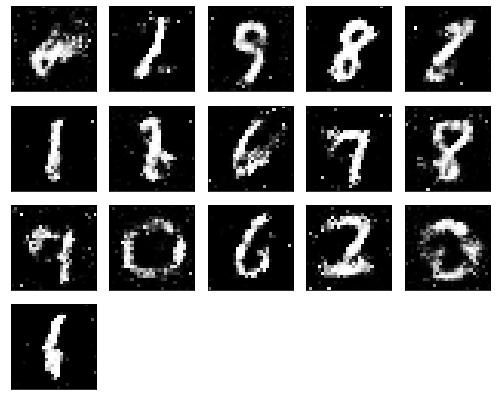

Epochs nb. 8071
discriminator loss: 0.5883665084838867
generator loss : 1.0435376167297363

Epochs nb. 8072
discriminator loss: 0.547899067401886
generator loss : 1.1745164394378662

Epochs nb. 8073
discriminator loss: 0.48778611421585083
generator loss : 1.2113090753555298

Epochs nb. 8074
discriminator loss: 0.6872051954269409
generator loss : 0.8790392875671387

Epochs nb. 8075
discriminator loss: 0.5458767414093018
generator loss : 0.8583314418792725

Epochs nb. 8076
discriminator loss: 0.5805674195289612
generator loss : 1.0621325969696045

Epochs nb. 8077
discriminator loss: 0.5948562026023865
generator loss : 1.0083098411560059

Epochs nb. 8078
discriminator loss: 0.6293834447860718
generator loss : 0.9802253246307373

Epochs nb. 8079
discriminator loss: 0.5961397886276245
generator loss : 1.0120179653167725

Epochs nb. 8080
discriminator loss: 0.592719316482544
generator loss : 0.9138491749763489



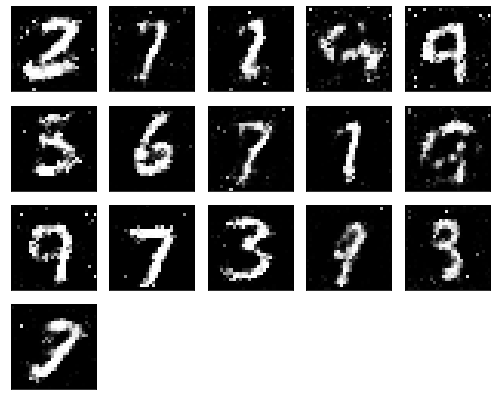

Epochs nb. 8081
discriminator loss: 0.6268712282180786
generator loss : 0.9615574479103088

Epochs nb. 8082
discriminator loss: 0.5277338027954102
generator loss : 1.142883062362671

Epochs nb. 8083
discriminator loss: 0.6838580965995789
generator loss : 0.9196086525917053

Epochs nb. 8084
discriminator loss: 0.5696629881858826
generator loss : 0.9547573328018188

Epochs nb. 8085
discriminator loss: 0.5966998338699341
generator loss : 0.9567698240280151

Epochs nb. 8086
discriminator loss: 0.6801992654800415
generator loss : 0.9356322288513184

Epochs nb. 8087
discriminator loss: 0.5360084772109985
generator loss : 1.0720455646514893

Epochs nb. 8088
discriminator loss: 0.4216225743293762
generator loss : 1.100825548171997

Epochs nb. 8089
discriminator loss: 0.46594446897506714
generator loss : 0.9452121257781982

Epochs nb. 8090
discriminator loss: 0.4909670054912567
generator loss : 0.9909025430679321



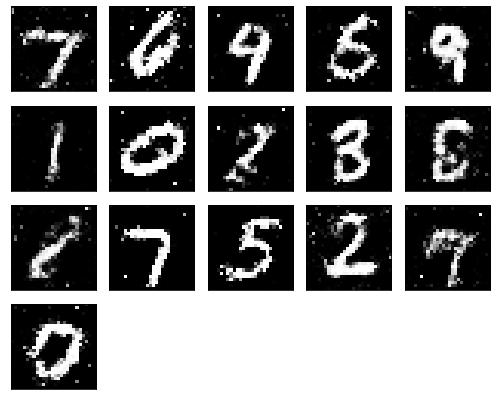

Epochs nb. 8091
discriminator loss: 0.5491621494293213
generator loss : 0.8624171018600464

Epochs nb. 8092
discriminator loss: 0.6190176010131836
generator loss : 0.815559983253479

Epochs nb. 8093
discriminator loss: 0.5649755597114563
generator loss : 1.0466419458389282

Epochs nb. 8094
discriminator loss: 0.4975569248199463
generator loss : 1.0384351015090942

Epochs nb. 8095
discriminator loss: 0.6236386299133301
generator loss : 1.0018240213394165

Epochs nb. 8096
discriminator loss: 0.5720909237861633
generator loss : 1.0697760581970215

Epochs nb. 8097
discriminator loss: 0.7498723268508911
generator loss : 1.1778757572174072

Epochs nb. 8098
discriminator loss: 0.5790137648582458
generator loss : 0.9592372179031372

Epochs nb. 8099
discriminator loss: 0.6077153086662292
generator loss : 1.0716540813446045

Epochs nb. 8100
discriminator loss: 0.5912047624588013
generator loss : 0.9622457027435303



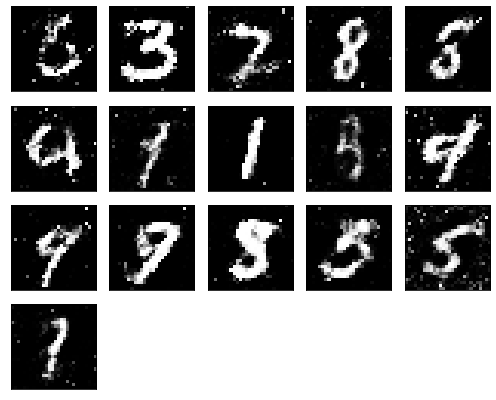

Epochs nb. 8101
discriminator loss: 0.606650173664093
generator loss : 0.8591283559799194

Epochs nb. 8102
discriminator loss: 0.7219620943069458
generator loss : 1.195257544517517

Epochs nb. 8103
discriminator loss: 0.7110341191291809
generator loss : 1.192403793334961

Epochs nb. 8104
discriminator loss: 0.634007453918457
generator loss : 1.2038099765777588

Epochs nb. 8105
discriminator loss: 0.62311851978302
generator loss : 1.1084187030792236

Epochs nb. 8106
discriminator loss: 0.5238792896270752
generator loss : 1.1580958366394043

Epochs nb. 8107
discriminator loss: 0.5281026363372803
generator loss : 1.0687278509140015

Epochs nb. 8108
discriminator loss: 0.721824049949646
generator loss : 1.230878472328186

Epochs nb. 8109
discriminator loss: 0.5142804384231567
generator loss : 1.0157291889190674

Epochs nb. 8110
discriminator loss: 0.7439469695091248
generator loss : 1.0167014598846436



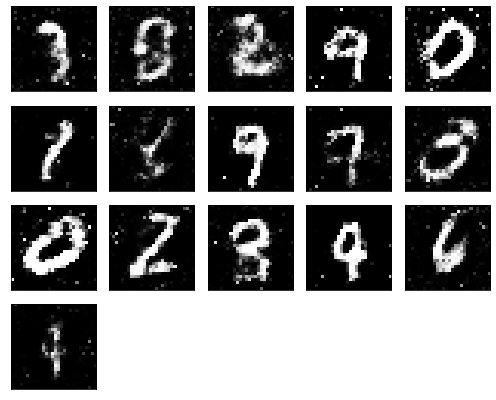

Epochs nb. 8111
discriminator loss: 0.627516508102417
generator loss : 1.1204599142074585

Epochs nb. 8112
discriminator loss: 0.6399049758911133
generator loss : 1.0017406940460205

Epochs nb. 8113
discriminator loss: 0.5468447208404541
generator loss : 1.012350082397461

Epochs nb. 8114
discriminator loss: 0.5899866819381714
generator loss : 0.9823794960975647

Epochs nb. 8115
discriminator loss: 0.6627274751663208
generator loss : 1.0339312553405762

Epochs nb. 8116
discriminator loss: 0.5860899686813354
generator loss : 1.150275707244873

Epochs nb. 8117
discriminator loss: 0.566352128982544
generator loss : 1.0239989757537842

Epochs nb. 8118
discriminator loss: 0.5853270888328552
generator loss : 1.0420384407043457

Epochs nb. 8119
discriminator loss: 0.63168865442276
generator loss : 0.958663821220398

Epochs nb. 8120
discriminator loss: 0.5748195052146912
generator loss : 1.0599654912948608



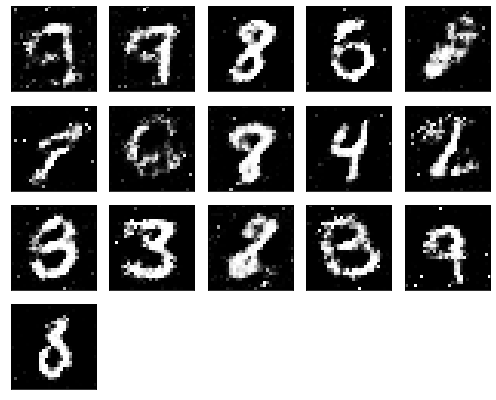

Epochs nb. 8121
discriminator loss: 0.6684563159942627
generator loss : 1.097820520401001

Epochs nb. 8122
discriminator loss: 0.6579183340072632
generator loss : 1.1402783393859863

Epochs nb. 8123
discriminator loss: 0.654949426651001
generator loss : 1.2629165649414062

Epochs nb. 8124
discriminator loss: 0.6358393430709839
generator loss : 1.0623918771743774

Epochs nb. 8125
discriminator loss: 0.5243125557899475
generator loss : 0.9013254642486572

Epochs nb. 8126
discriminator loss: 0.5300856232643127
generator loss : 1.005678415298462

Epochs nb. 8127
discriminator loss: 0.7145445346832275
generator loss : 1.0707120895385742

Epochs nb. 8128
discriminator loss: 0.4710128903388977
generator loss : 1.1444534063339233

Epochs nb. 8129
discriminator loss: 0.5086365938186646
generator loss : 1.0149319171905518

Epochs nb. 8130
discriminator loss: 0.5072904229164124
generator loss : 1.03477942943573



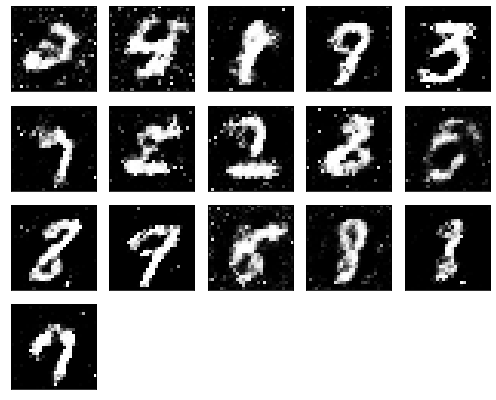

Epochs nb. 8131
discriminator loss: 0.6615650653839111
generator loss : 1.0728397369384766

Epochs nb. 8132
discriminator loss: 0.6010620594024658
generator loss : 1.0282646417617798

Epochs nb. 8133
discriminator loss: 0.6646173000335693
generator loss : 0.9215095043182373

Epochs nb. 8134
discriminator loss: 0.622871458530426
generator loss : 0.9798905253410339

Epochs nb. 8135
discriminator loss: 0.7169526815414429
generator loss : 1.0515148639678955

Epochs nb. 8136
discriminator loss: 0.5974923372268677
generator loss : 1.0704649686813354

Epochs nb. 8137
discriminator loss: 0.49990856647491455
generator loss : 1.151353120803833

Epochs nb. 8138
discriminator loss: 0.8094708919525146
generator loss : 1.0571192502975464

Epochs nb. 8139
discriminator loss: 0.5622537136077881
generator loss : 0.8455454111099243

Epochs nb. 8140
discriminator loss: 0.7494720220565796
generator loss : 1.126420497894287



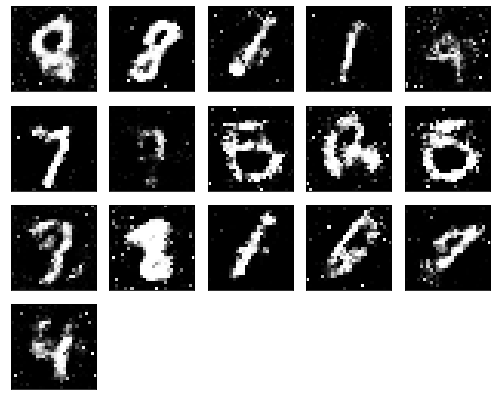

Epochs nb. 8141
discriminator loss: 0.6428678631782532
generator loss : 1.0477670431137085

Epochs nb. 8142
discriminator loss: 0.6681941747665405
generator loss : 0.8204150199890137

Epochs nb. 8143
discriminator loss: 0.5773283243179321
generator loss : 1.0325486660003662

Epochs nb. 8144
discriminator loss: 0.5196765661239624
generator loss : 0.9291367530822754

Epochs nb. 8145
discriminator loss: 0.636868953704834
generator loss : 0.9460583329200745

Epochs nb. 8146
discriminator loss: 0.5663542747497559
generator loss : 1.0454312562942505

Epochs nb. 8147
discriminator loss: 0.6010557413101196
generator loss : 1.0420206785202026

Epochs nb. 8148
discriminator loss: 0.5319216251373291
generator loss : 0.892462968826294

Epochs nb. 8149
discriminator loss: 0.6675863265991211
generator loss : 0.8894526958465576

Epochs nb. 8150
discriminator loss: 0.7700903415679932
generator loss : 1.014941692352295



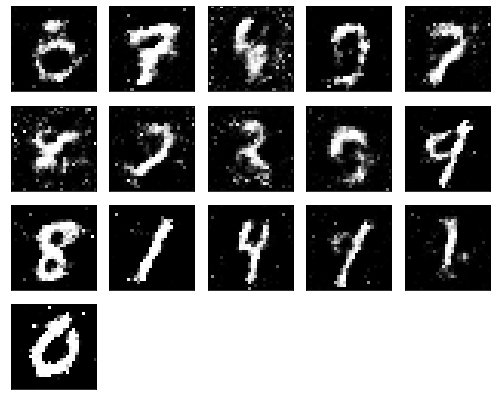

Epochs nb. 8151
discriminator loss: 0.6167100667953491
generator loss : 0.9448344111442566

Epochs nb. 8152
discriminator loss: 0.5476883053779602
generator loss : 0.8525964617729187

Epochs nb. 8153
discriminator loss: 0.6630085706710815
generator loss : 1.0645235776901245

Epochs nb. 8154
discriminator loss: 0.5521920919418335
generator loss : 0.8300806283950806

Epochs nb. 8155
discriminator loss: 0.49852514266967773
generator loss : 0.946174681186676

Epochs nb. 8156
discriminator loss: 0.6807594299316406
generator loss : 1.1695778369903564

Epochs nb. 8157
discriminator loss: 0.472772479057312
generator loss : 1.2173666954040527

Epochs nb. 8158
discriminator loss: 0.5800409317016602
generator loss : 1.1311259269714355

Epochs nb. 8159
discriminator loss: 0.751237154006958
generator loss : 1.0290606021881104

Epochs nb. 8160
discriminator loss: 0.5662537813186646
generator loss : 1.0036345720291138



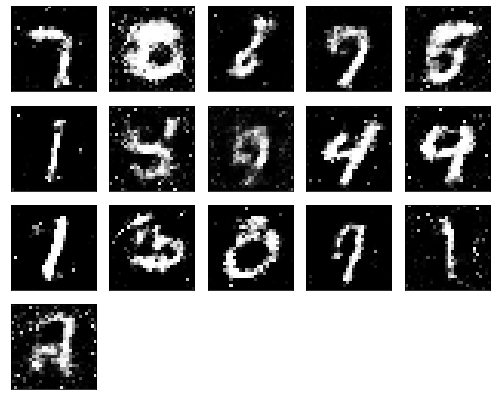

Epochs nb. 8161
discriminator loss: 0.7094391584396362
generator loss : 0.7859035134315491

Epochs nb. 8162
discriminator loss: 0.6303335428237915
generator loss : 1.256305456161499

Epochs nb. 8163
discriminator loss: 0.5669548511505127
generator loss : 0.958897590637207

Epochs nb. 8164
discriminator loss: 0.5012394189834595
generator loss : 1.0098536014556885

Epochs nb. 8165
discriminator loss: 0.6179859638214111
generator loss : 0.8884690999984741

Epochs nb. 8166
discriminator loss: 0.5199735164642334
generator loss : 1.0172991752624512

Epochs nb. 8167
discriminator loss: 0.5484100580215454
generator loss : 1.1016404628753662

Epochs nb. 8168
discriminator loss: 0.6237002015113831
generator loss : 0.9649840593338013

Epochs nb. 8169
discriminator loss: 0.5801026225090027
generator loss : 1.0810731649398804

Epochs nb. 8170
discriminator loss: 0.497955322265625
generator loss : 1.0454033613204956



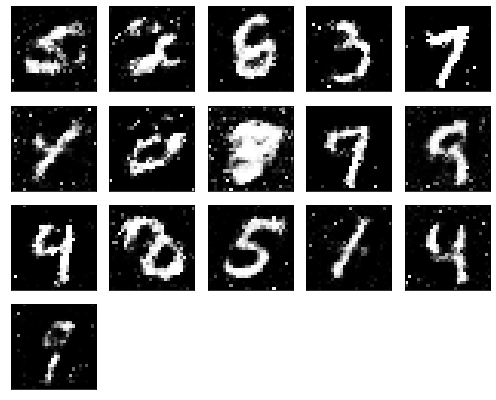

Epochs nb. 8171
discriminator loss: 0.7879899144172668
generator loss : 1.0912063121795654

Epochs nb. 8172
discriminator loss: 0.475338339805603
generator loss : 0.9921708106994629

Epochs nb. 8173
discriminator loss: 0.6372727751731873
generator loss : 1.0337331295013428

Epochs nb. 8174
discriminator loss: 0.6771917343139648
generator loss : 1.0430045127868652

Epochs nb. 8175
discriminator loss: 0.48258328437805176
generator loss : 1.0158709287643433

Epochs nb. 8176
discriminator loss: 0.6756037473678589
generator loss : 0.9327569007873535

Epochs nb. 8177
discriminator loss: 0.5056373476982117
generator loss : 0.9847677946090698

Epochs nb. 8178
discriminator loss: 0.5616692304611206
generator loss : 1.0788347721099854

Epochs nb. 8179
discriminator loss: 0.6215656995773315
generator loss : 1.0123752355575562

Epochs nb. 8180
discriminator loss: 0.6029574275016785
generator loss : 1.1685452461242676



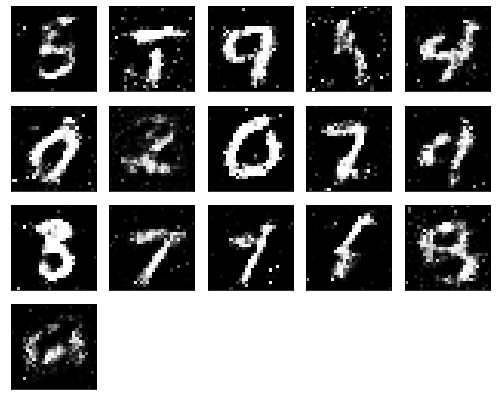

Epochs nb. 8181
discriminator loss: 0.5323002338409424
generator loss : 1.1387262344360352

Epochs nb. 8182
discriminator loss: 0.5744072198867798
generator loss : 1.2042255401611328

Epochs nb. 8183
discriminator loss: 0.5236602425575256
generator loss : 0.932571530342102

Epochs nb. 8184
discriminator loss: 0.5923304557800293
generator loss : 1.1539547443389893

Epochs nb. 8185
discriminator loss: 0.7674436569213867
generator loss : 1.0286953449249268

Epochs nb. 8186
discriminator loss: 0.5592694878578186
generator loss : 1.0375349521636963

Epochs nb. 8187
discriminator loss: 0.6837769746780396
generator loss : 0.949410080909729

Epochs nb. 8188
discriminator loss: 0.6959503889083862
generator loss : 1.116493582725525

Epochs nb. 8189
discriminator loss: 0.5764381885528564
generator loss : 1.1663182973861694

Epochs nb. 8190
discriminator loss: 0.5466427803039551
generator loss : 0.9770922660827637



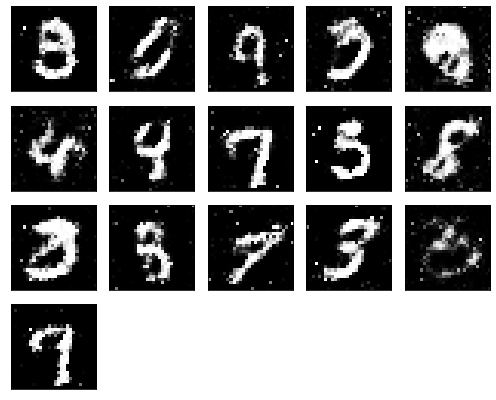

Epochs nb. 8191
discriminator loss: 0.5488535165786743
generator loss : 1.0185028314590454

Epochs nb. 8192
discriminator loss: 0.7041381001472473
generator loss : 1.0804543495178223

Epochs nb. 8193
discriminator loss: 0.504033625125885
generator loss : 0.9078112840652466

Epochs nb. 8194
discriminator loss: 0.5514837503433228
generator loss : 0.9710596799850464

Epochs nb. 8195
discriminator loss: 0.7200974822044373
generator loss : 0.9688525199890137

Epochs nb. 8196
discriminator loss: 0.6177407503128052
generator loss : 0.8370743989944458

Epochs nb. 8197
discriminator loss: 0.5622791051864624
generator loss : 1.084522008895874

Epochs nb. 8198
discriminator loss: 0.5506151914596558
generator loss : 1.0226280689239502

Epochs nb. 8199
discriminator loss: 0.6820755004882812
generator loss : 1.0898091793060303

Epochs nb. 8200
discriminator loss: 0.5589196681976318
generator loss : 1.0626819133758545



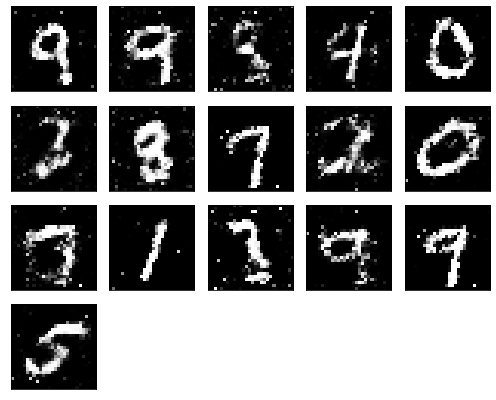

Epochs nb. 8201
discriminator loss: 0.714533805847168
generator loss : 0.9410050511360168

Epochs nb. 8202
discriminator loss: 0.651523232460022
generator loss : 0.7532296180725098

Epochs nb. 8203
discriminator loss: 0.6876991987228394
generator loss : 0.9471980929374695

Epochs nb. 8204
discriminator loss: 0.6780937910079956
generator loss : 0.856310248374939

Epochs nb. 8205
discriminator loss: 0.6187117099761963
generator loss : 0.8562414646148682

Epochs nb. 8206
discriminator loss: 0.6572345495223999
generator loss : 0.8841586112976074

Epochs nb. 8207
discriminator loss: 0.6153029799461365
generator loss : 1.0341663360595703

Epochs nb. 8208
discriminator loss: 0.567248523235321
generator loss : 1.1448503732681274

Epochs nb. 8209
discriminator loss: 0.6871578693389893
generator loss : 1.0617094039916992

Epochs nb. 8210
discriminator loss: 0.7037085890769958
generator loss : 0.904387354850769



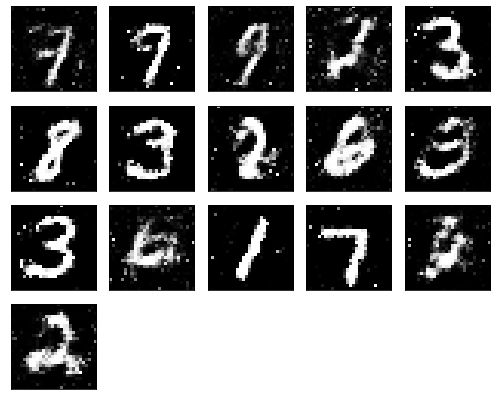

Epochs nb. 8211
discriminator loss: 0.6461004018783569
generator loss : 1.0422372817993164

Epochs nb. 8212
discriminator loss: 0.5974562168121338
generator loss : 1.0705690383911133

Epochs nb. 8213
discriminator loss: 0.5547462701797485
generator loss : 0.9349467158317566

Epochs nb. 8214
discriminator loss: 0.6212481260299683
generator loss : 1.0063904523849487

Epochs nb. 8215
discriminator loss: 0.6284254789352417
generator loss : 0.9341967105865479

Epochs nb. 8216
discriminator loss: 0.6960098743438721
generator loss : 1.2025924921035767

Epochs nb. 8217
discriminator loss: 0.5639742612838745
generator loss : 0.9793275594711304

Epochs nb. 8218
discriminator loss: 0.5647690296173096
generator loss : 0.8510802388191223

Epochs nb. 8219
discriminator loss: 0.5024778842926025
generator loss : 1.1184837818145752

Epochs nb. 8220
discriminator loss: 0.510665237903595
generator loss : 1.2184028625488281



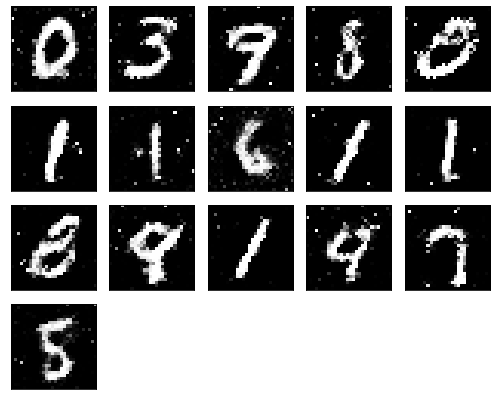

Epochs nb. 8221
discriminator loss: 0.7305437326431274
generator loss : 1.046748161315918

Epochs nb. 8222
discriminator loss: 0.6764675378799438
generator loss : 1.0797009468078613

Epochs nb. 8223
discriminator loss: 0.554161548614502
generator loss : 0.9453691244125366

Epochs nb. 8224
discriminator loss: 0.5724692940711975
generator loss : 0.9791992902755737

Epochs nb. 8225
discriminator loss: 0.588973343372345
generator loss : 1.174727439880371

Epochs nb. 8226
discriminator loss: 0.5602396726608276
generator loss : 1.2010340690612793

Epochs nb. 8227
discriminator loss: 0.6652919054031372
generator loss : 1.0513863563537598

Epochs nb. 8228
discriminator loss: 0.7090649604797363
generator loss : 0.9346939921379089

Epochs nb. 8229
discriminator loss: 0.5100866556167603
generator loss : 0.9656380414962769

Epochs nb. 8230
discriminator loss: 0.6311748027801514
generator loss : 1.0050601959228516



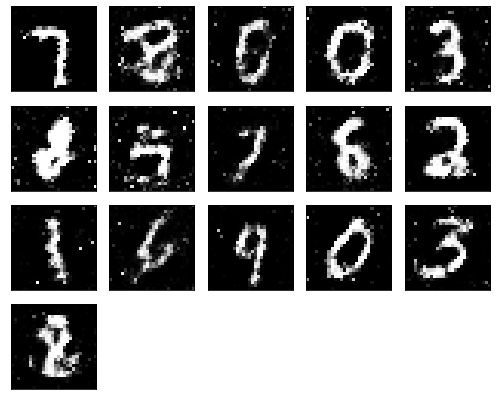

Epochs nb. 8231
discriminator loss: 0.717204749584198
generator loss : 1.1167222261428833

Epochs nb. 8232
discriminator loss: 0.6202064752578735
generator loss : 0.916903555393219

Epochs nb. 8233
discriminator loss: 0.7311912178993225
generator loss : 1.0165019035339355

Epochs nb. 8234
discriminator loss: 0.5996718406677246
generator loss : 0.9946827292442322

Epochs nb. 8235
discriminator loss: 0.4815242290496826
generator loss : 1.1682857275009155

Epochs nb. 8236
discriminator loss: 0.5679969191551208
generator loss : 1.142752766609192

Epochs nb. 8237
discriminator loss: 0.6196818351745605
generator loss : 1.0365495681762695

Epochs nb. 8238
discriminator loss: 0.6307141780853271
generator loss : 1.3101102113723755

Epochs nb. 8239
discriminator loss: 0.6193176507949829
generator loss : 1.0680263042449951

Epochs nb. 8240
discriminator loss: 0.4712662398815155
generator loss : 0.9621826410293579



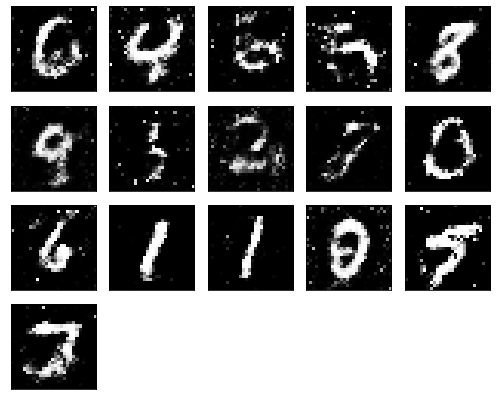

Epochs nb. 8241
discriminator loss: 0.5479353070259094
generator loss : 1.15461266040802

Epochs nb. 8242
discriminator loss: 0.680027425289154
generator loss : 0.8472414016723633

Epochs nb. 8243
discriminator loss: 0.5613899827003479
generator loss : 0.9438841938972473

Epochs nb. 8244
discriminator loss: 0.6250377893447876
generator loss : 1.1541404724121094

Epochs nb. 8245
discriminator loss: 0.6646764874458313
generator loss : 1.167180061340332

Epochs nb. 8246
discriminator loss: 0.5741972327232361
generator loss : 1.1920685768127441

Epochs nb. 8247
discriminator loss: 0.5769752860069275
generator loss : 1.071861743927002

Epochs nb. 8248
discriminator loss: 0.7067685127258301
generator loss : 1.012744665145874

Epochs nb. 8249
discriminator loss: 0.6577719449996948
generator loss : 1.1436742544174194

Epochs nb. 8250
discriminator loss: 0.4812106788158417
generator loss : 1.0931241512298584



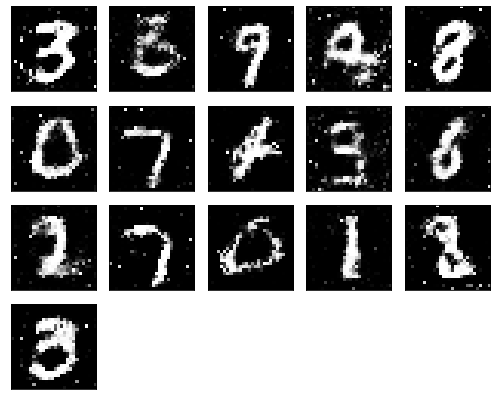

Epochs nb. 8251
discriminator loss: 0.5565981864929199
generator loss : 0.95943284034729

Epochs nb. 8252
discriminator loss: 0.5927118062973022
generator loss : 0.9124947786331177

Epochs nb. 8253
discriminator loss: 0.7920290231704712
generator loss : 0.8144670724868774

Epochs nb. 8254
discriminator loss: 0.6326054334640503
generator loss : 0.8943620920181274

Epochs nb. 8255
discriminator loss: 0.46778449416160583
generator loss : 0.9135818481445312

Epochs nb. 8256
discriminator loss: 0.6436372995376587
generator loss : 0.96397465467453

Epochs nb. 8257
discriminator loss: 0.5011052489280701
generator loss : 1.0686801671981812

Epochs nb. 8258
discriminator loss: 0.5568234324455261
generator loss : 1.177207112312317

Epochs nb. 8259
discriminator loss: 0.7623029947280884
generator loss : 0.9371119737625122

Epochs nb. 8260
discriminator loss: 0.5802611112594604
generator loss : 0.8399301171302795



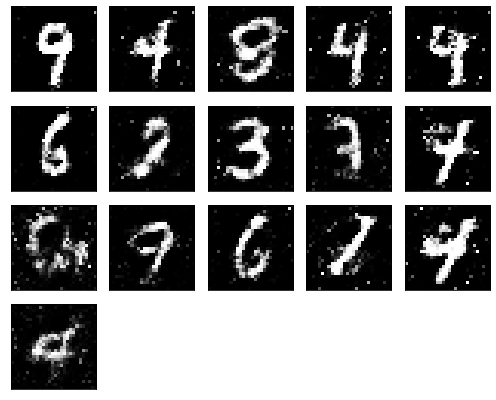

Epochs nb. 8261
discriminator loss: 0.5839171409606934
generator loss : 1.0075063705444336

Epochs nb. 8262
discriminator loss: 0.5317508578300476
generator loss : 1.012055516242981

Epochs nb. 8263
discriminator loss: 0.5486076474189758
generator loss : 0.810591459274292

Epochs nb. 8264
discriminator loss: 0.567040741443634
generator loss : 0.995880126953125

Epochs nb. 8265
discriminator loss: 0.640742301940918
generator loss : 0.9143726825714111

Epochs nb. 8266
discriminator loss: 0.5270307064056396
generator loss : 1.0535964965820312

Epochs nb. 8267
discriminator loss: 0.7765995264053345
generator loss : 0.950829267501831

Epochs nb. 8268
discriminator loss: 0.5879713892936707
generator loss : 0.9101985692977905

Epochs nb. 8269
discriminator loss: 0.6100074648857117
generator loss : 0.9927254319190979

Epochs nb. 8270
discriminator loss: 0.7737467288970947
generator loss : 0.8902335166931152



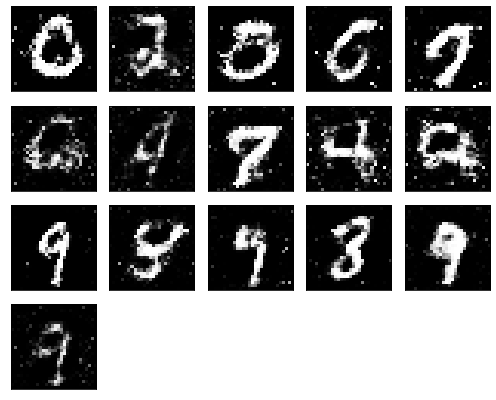

Epochs nb. 8271
discriminator loss: 0.6379112601280212
generator loss : 1.0145937204360962

Epochs nb. 8272
discriminator loss: 0.6460359692573547
generator loss : 1.0995761156082153

Epochs nb. 8273
discriminator loss: 0.5788154602050781
generator loss : 0.9915933012962341

Epochs nb. 8274
discriminator loss: 0.4979061484336853
generator loss : 1.2581100463867188

Epochs nb. 8275
discriminator loss: 0.530226469039917
generator loss : 0.9786825180053711

Epochs nb. 8276
discriminator loss: 0.6586519479751587
generator loss : 0.9453688263893127

Epochs nb. 8277
discriminator loss: 0.5431994199752808
generator loss : 1.0359876155853271

Epochs nb. 8278
discriminator loss: 0.4831417202949524
generator loss : 0.8414814472198486

Epochs nb. 8279
discriminator loss: 0.6377578973770142
generator loss : 0.9017385244369507

Epochs nb. 8280
discriminator loss: 0.46070924401283264
generator loss : 1.0791139602661133



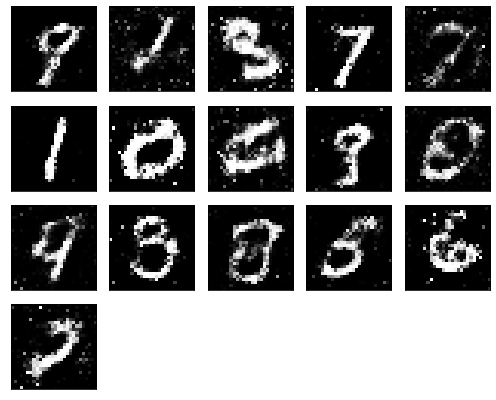

Epochs nb. 8281
discriminator loss: 0.7748276591300964
generator loss : 1.0986508131027222

Epochs nb. 8282
discriminator loss: 0.5335956811904907
generator loss : 0.9538812637329102

Epochs nb. 8283
discriminator loss: 0.6743846535682678
generator loss : 0.9658661484718323

Epochs nb. 8284
discriminator loss: 0.46338778734207153
generator loss : 0.8303780555725098

Epochs nb. 8285
discriminator loss: 0.6134977340698242
generator loss : 1.0149577856063843

Epochs nb. 8286
discriminator loss: 0.600924015045166
generator loss : 0.9210817813873291

Epochs nb. 8287
discriminator loss: 0.5499807000160217
generator loss : 0.9738081693649292

Epochs nb. 8288
discriminator loss: 0.64468914270401
generator loss : 0.9399272799491882

Epochs nb. 8289
discriminator loss: 0.6424773931503296
generator loss : 1.0603418350219727

Epochs nb. 8290
discriminator loss: 0.5344603061676025
generator loss : 1.0555254220962524



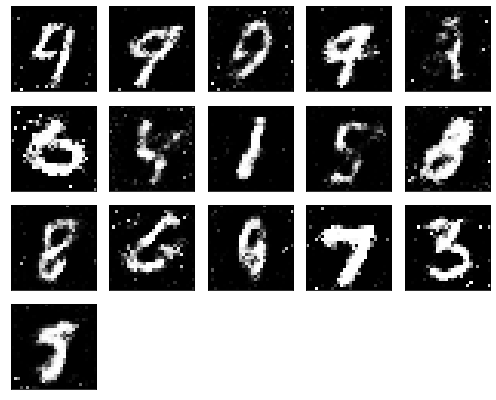

Epochs nb. 8291
discriminator loss: 0.7342617511749268
generator loss : 1.1111242771148682

Epochs nb. 8292
discriminator loss: 0.5781619548797607
generator loss : 0.8500818014144897

Epochs nb. 8293
discriminator loss: 0.6534215211868286
generator loss : 0.9785716533660889

Epochs nb. 8294
discriminator loss: 0.6869438886642456
generator loss : 1.0243812799453735

Epochs nb. 8295
discriminator loss: 0.39592278003692627
generator loss : 0.9024166464805603

Epochs nb. 8296
discriminator loss: 0.7513166666030884
generator loss : 0.983392059803009

Epochs nb. 8297
discriminator loss: 0.6484668850898743
generator loss : 0.9071930646896362

Epochs nb. 8298
discriminator loss: 0.6377806663513184
generator loss : 1.1371839046478271

Epochs nb. 8299
discriminator loss: 0.6394973397254944
generator loss : 1.0543134212493896

Epochs nb. 8300
discriminator loss: 0.5626635551452637
generator loss : 1.0272958278656006



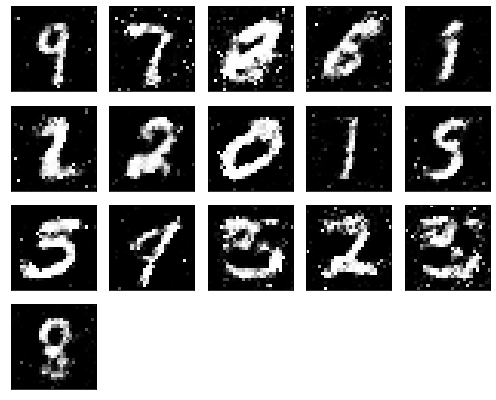

Epochs nb. 8301
discriminator loss: 0.497795045375824
generator loss : 0.9909639358520508

Epochs nb. 8302
discriminator loss: 0.5532951354980469
generator loss : 0.9883649945259094

Epochs nb. 8303
discriminator loss: 0.6008137464523315
generator loss : 0.9443651437759399

Epochs nb. 8304
discriminator loss: 0.6274884939193726
generator loss : 0.9580731987953186

Epochs nb. 8305
discriminator loss: 0.5956549644470215
generator loss : 0.956585168838501

Epochs nb. 8306
discriminator loss: 0.6863416433334351
generator loss : 0.9206036329269409

Epochs nb. 8307
discriminator loss: 0.6256909370422363
generator loss : 1.4641854763031006

Epochs nb. 8308
discriminator loss: 0.6442146301269531
generator loss : 1.294124960899353

Epochs nb. 8309
discriminator loss: 0.5561160445213318
generator loss : 0.999318540096283

Epochs nb. 8310
discriminator loss: 0.5609487295150757
generator loss : 0.9827449917793274



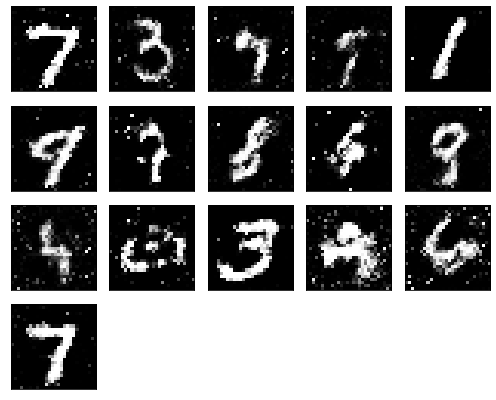

Epochs nb. 8311
discriminator loss: 0.5682448744773865
generator loss : 0.8783718347549438

Epochs nb. 8312
discriminator loss: 0.6509597301483154
generator loss : 0.7796643972396851

Epochs nb. 8313
discriminator loss: 0.5700292587280273
generator loss : 1.0648174285888672

Epochs nb. 8314
discriminator loss: 0.4886026978492737
generator loss : 0.896896243095398

Epochs nb. 8315
discriminator loss: 0.5582787990570068
generator loss : 1.0459996461868286

Epochs nb. 8316
discriminator loss: 0.5927362442016602
generator loss : 1.2367148399353027

Epochs nb. 8317
discriminator loss: 0.7116628885269165
generator loss : 1.019940972328186

Epochs nb. 8318
discriminator loss: 0.6611859798431396
generator loss : 0.9363691806793213

Epochs nb. 8319
discriminator loss: 0.6078543663024902
generator loss : 1.1064555644989014

Epochs nb. 8320
discriminator loss: 0.7176406383514404
generator loss : 1.0778721570968628



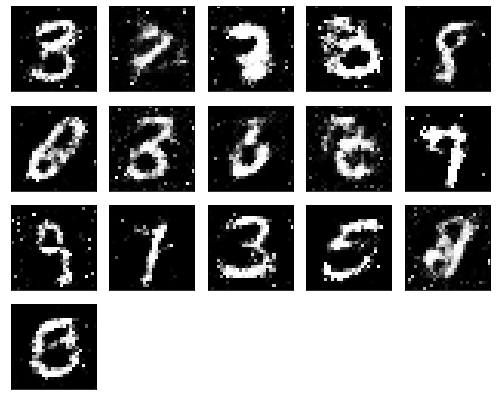

Epochs nb. 8321
discriminator loss: 0.7285747528076172
generator loss : 1.035334825515747

Epochs nb. 8322
discriminator loss: 0.5838302969932556
generator loss : 0.949748694896698

Epochs nb. 8323
discriminator loss: 0.5791946053504944
generator loss : 1.0533933639526367

Epochs nb. 8324
discriminator loss: 0.4519537687301636
generator loss : 1.1094565391540527

Epochs nb. 8325
discriminator loss: 0.48012250661849976
generator loss : 1.0087947845458984

Epochs nb. 8326
discriminator loss: 0.5118608474731445
generator loss : 1.078172206878662

Epochs nb. 8327
discriminator loss: 0.7961223125457764
generator loss : 1.0001941919326782

Epochs nb. 8328
discriminator loss: 0.49094441533088684
generator loss : 0.9242649078369141

Epochs nb. 8329
discriminator loss: 0.699028730392456
generator loss : 0.962357759475708

Epochs nb. 8330
discriminator loss: 0.6191216111183167
generator loss : 1.038030743598938



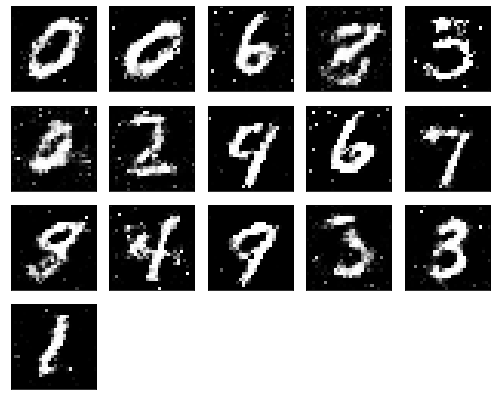

Epochs nb. 8331
discriminator loss: 0.5289245247840881
generator loss : 0.921420156955719

Epochs nb. 8332
discriminator loss: 0.3997616767883301
generator loss : 0.9369179606437683

Epochs nb. 8333
discriminator loss: 0.5660287737846375
generator loss : 1.092586636543274

Epochs nb. 8334
discriminator loss: 0.7616385221481323
generator loss : 1.0667763948440552

Epochs nb. 8335
discriminator loss: 0.5186362862586975
generator loss : 0.9762968420982361

Epochs nb. 8336
discriminator loss: 0.6024501323699951
generator loss : 0.8980082273483276

Epochs nb. 8337
discriminator loss: 0.5323537588119507
generator loss : 1.0444656610488892

Epochs nb. 8338
discriminator loss: 0.5228499174118042
generator loss : 1.1055269241333008

Epochs nb. 8339
discriminator loss: 0.602557897567749
generator loss : 1.0506269931793213

Epochs nb. 8340
discriminator loss: 0.6498363614082336
generator loss : 1.0568296909332275



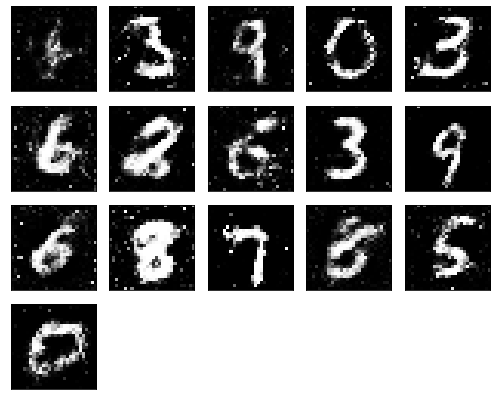

Epochs nb. 8341
discriminator loss: 0.6781163215637207
generator loss : 0.9498345255851746

Epochs nb. 8342
discriminator loss: 0.6585865020751953
generator loss : 0.8797231912612915

Epochs nb. 8343
discriminator loss: 0.6157079339027405
generator loss : 0.7749236226081848

Epochs nb. 8344
discriminator loss: 0.6544692516326904
generator loss : 0.8801356554031372

Epochs nb. 8345
discriminator loss: 0.6567012667655945
generator loss : 0.8054060339927673

Epochs nb. 8346
discriminator loss: 0.573529064655304
generator loss : 0.6708530783653259

Epochs nb. 8347
discriminator loss: 0.6620964407920837
generator loss : 0.9750911593437195

Epochs nb. 8348
discriminator loss: 0.6571322083473206
generator loss : 0.9855259656906128

Epochs nb. 8349
discriminator loss: 0.4987107217311859
generator loss : 0.973129153251648

Epochs nb. 8350
discriminator loss: 0.5586345791816711
generator loss : 0.9155094623565674



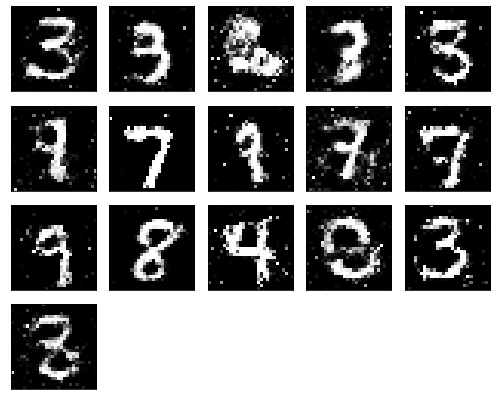

Epochs nb. 8351
discriminator loss: 0.6331444978713989
generator loss : 0.9357694387435913

Epochs nb. 8352
discriminator loss: 0.6008135080337524
generator loss : 1.0924289226531982

Epochs nb. 8353
discriminator loss: 0.5534653663635254
generator loss : 0.8390491604804993

Epochs nb. 8354
discriminator loss: 0.6403680443763733
generator loss : 1.1160914897918701

Epochs nb. 8355
discriminator loss: 0.6199098825454712
generator loss : 0.9316977262496948

Epochs nb. 8356
discriminator loss: 0.559746503829956
generator loss : 1.0077749490737915

Epochs nb. 8357
discriminator loss: 0.6802101135253906
generator loss : 0.9803829193115234

Epochs nb. 8358
discriminator loss: 0.5487935543060303
generator loss : 1.0708404779434204

Epochs nb. 8359
discriminator loss: 0.6114956140518188
generator loss : 1.2222388982772827

Epochs nb. 8360
discriminator loss: 0.6322737336158752
generator loss : 0.9484224915504456



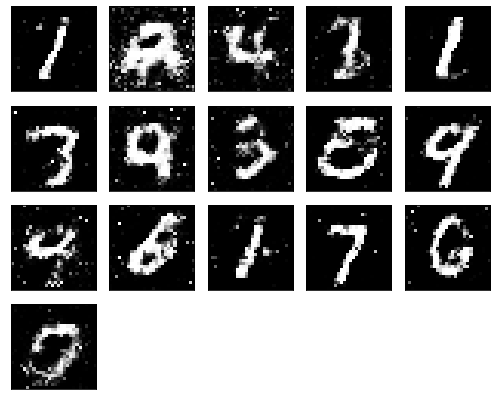

Epochs nb. 8361
discriminator loss: 0.6534576416015625
generator loss : 1.0427680015563965

Epochs nb. 8362
discriminator loss: 0.4918003976345062
generator loss : 0.9347690343856812

Epochs nb. 8363
discriminator loss: 0.6778201460838318
generator loss : 0.9345909357070923

Epochs nb. 8364
discriminator loss: 0.48086783289909363
generator loss : 1.2732460498809814

Epochs nb. 8365
discriminator loss: 0.5022578239440918
generator loss : 0.893179178237915

Epochs nb. 8366
discriminator loss: 0.617350161075592
generator loss : 0.9456002116203308

Epochs nb. 8367
discriminator loss: 0.4789053499698639
generator loss : 0.8219636678695679

Epochs nb. 8368
discriminator loss: 0.644234836101532
generator loss : 1.011960744857788

Epochs nb. 8369
discriminator loss: 0.6211143136024475
generator loss : 1.1428961753845215

Epochs nb. 8370
discriminator loss: 0.5727851390838623
generator loss : 1.3239965438842773



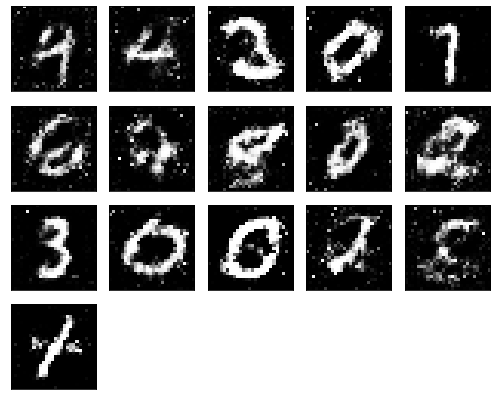

Epochs nb. 8371
discriminator loss: 0.4894387125968933
generator loss : 1.1027988195419312

Epochs nb. 8372
discriminator loss: 0.5704835653305054
generator loss : 0.9857490658760071

Epochs nb. 8373
discriminator loss: 0.633577287197113
generator loss : 1.1035258769989014

Epochs nb. 8374
discriminator loss: 0.5987951755523682
generator loss : 1.0857070684432983

Epochs nb. 8375
discriminator loss: 0.5615670680999756
generator loss : 1.1457957029342651

Epochs nb. 8376
discriminator loss: 0.5729389190673828
generator loss : 1.1542469263076782

Epochs nb. 8377
discriminator loss: 0.516333818435669
generator loss : 1.17432701587677

Epochs nb. 8378
discriminator loss: 0.5503703355789185
generator loss : 0.8889555335044861

Epochs nb. 8379
discriminator loss: 0.5871489644050598
generator loss : 1.2126283645629883

Epochs nb. 8380
discriminator loss: 0.6608231067657471
generator loss : 0.8921918869018555



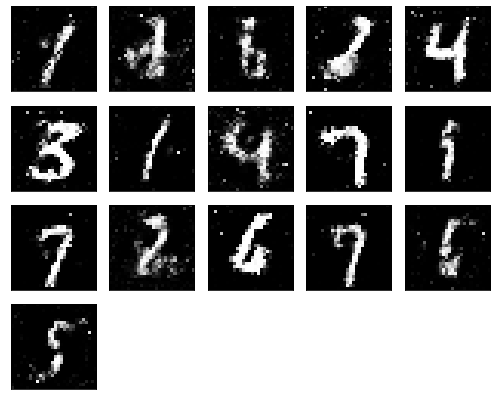

Epochs nb. 8381
discriminator loss: 0.6382400393486023
generator loss : 0.8761868476867676

Epochs nb. 8382
discriminator loss: 0.5432180166244507
generator loss : 1.1006357669830322

Epochs nb. 8383
discriminator loss: 0.6080129146575928
generator loss : 0.8538777828216553

Epochs nb. 8384
discriminator loss: 0.5176663398742676
generator loss : 0.9559828639030457

Epochs nb. 8385
discriminator loss: 0.5858627557754517
generator loss : 1.085710883140564

Epochs nb. 8386
discriminator loss: 0.5321412086486816
generator loss : 0.9980289340019226

Epochs nb. 8387
discriminator loss: 0.6454299688339233
generator loss : 1.0777442455291748

Epochs nb. 8388
discriminator loss: 0.7033821940422058
generator loss : 1.1798679828643799

Epochs nb. 8389
discriminator loss: 0.6713024377822876
generator loss : 0.9544879198074341

Epochs nb. 8390
discriminator loss: 0.6539280414581299
generator loss : 0.9370259046554565



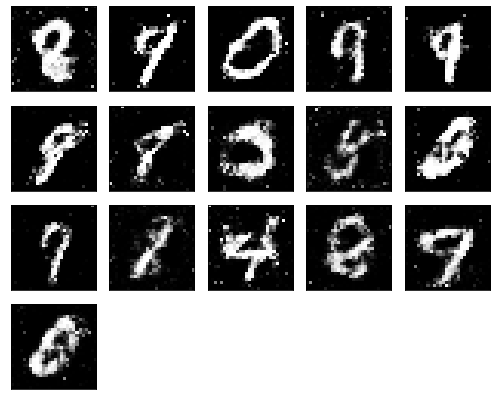

Epochs nb. 8391
discriminator loss: 0.5092712640762329
generator loss : 1.1445972919464111

Epochs nb. 8392
discriminator loss: 0.5656261444091797
generator loss : 1.0106914043426514

Epochs nb. 8393
discriminator loss: 0.8248909711837769
generator loss : 0.9439097046852112

Epochs nb. 8394
discriminator loss: 0.4980326294898987
generator loss : 0.9515525698661804

Epochs nb. 8395
discriminator loss: 0.5343217849731445
generator loss : 1.0943291187286377

Epochs nb. 8396
discriminator loss: 0.6009616255760193
generator loss : 0.9921447038650513

Epochs nb. 8397
discriminator loss: 0.5701632499694824
generator loss : 0.8920837640762329

Epochs nb. 8398
discriminator loss: 0.5932143926620483
generator loss : 1.324352502822876

Epochs nb. 8399
discriminator loss: 0.5914973020553589
generator loss : 1.054080843925476

Epochs nb. 8400
discriminator loss: 0.6758118271827698
generator loss : 1.1560449600219727



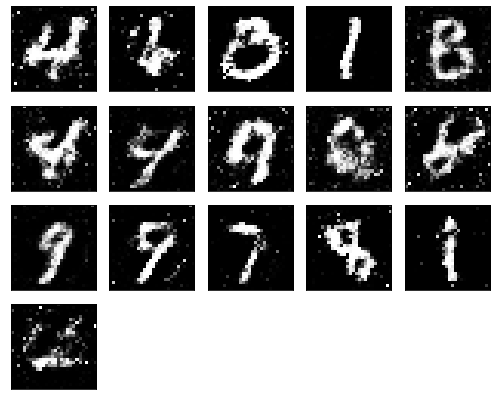

Epochs nb. 8401
discriminator loss: 0.6333268284797668
generator loss : 0.9300478100776672

Epochs nb. 8402
discriminator loss: 0.5778856873512268
generator loss : 0.9680182933807373

Epochs nb. 8403
discriminator loss: 0.6240546703338623
generator loss : 0.9788988828659058

Epochs nb. 8404
discriminator loss: 0.528731107711792
generator loss : 0.8669185638427734

Epochs nb. 8405
discriminator loss: 0.7709814310073853
generator loss : 0.8948532342910767

Epochs nb. 8406
discriminator loss: 0.5786758065223694
generator loss : 1.02798330783844

Epochs nb. 8407
discriminator loss: 0.6837859153747559
generator loss : 0.9985928535461426

Epochs nb. 8408
discriminator loss: 0.6754292845726013
generator loss : 1.1841731071472168

Epochs nb. 8409
discriminator loss: 0.6510756611824036
generator loss : 0.981946587562561

Epochs nb. 8410
discriminator loss: 0.604751706123352
generator loss : 0.8984311819076538



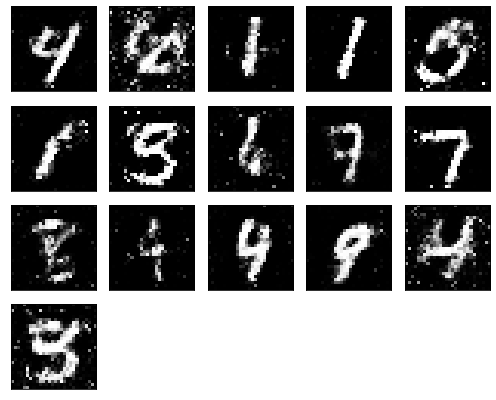

Epochs nb. 8411
discriminator loss: 0.6002411842346191
generator loss : 1.1775883436203003

Epochs nb. 8412
discriminator loss: 0.6099961400032043
generator loss : 0.9076417684555054

Epochs nb. 8413
discriminator loss: 0.6021021008491516
generator loss : 1.1233471632003784

Epochs nb. 8414
discriminator loss: 0.649886965751648
generator loss : 1.0178217887878418

Epochs nb. 8415
discriminator loss: 0.5064228773117065
generator loss : 0.7325628995895386

Epochs nb. 8416
discriminator loss: 0.5425930023193359
generator loss : 0.8443927764892578

Epochs nb. 8417
discriminator loss: 0.6161054968833923
generator loss : 0.9546002149581909

Epochs nb. 8418
discriminator loss: 0.6219899654388428
generator loss : 0.9665827751159668

Epochs nb. 8419
discriminator loss: 0.6884324550628662
generator loss : 0.9127211570739746

Epochs nb. 8420
discriminator loss: 0.7369273900985718
generator loss : 1.0048454999923706



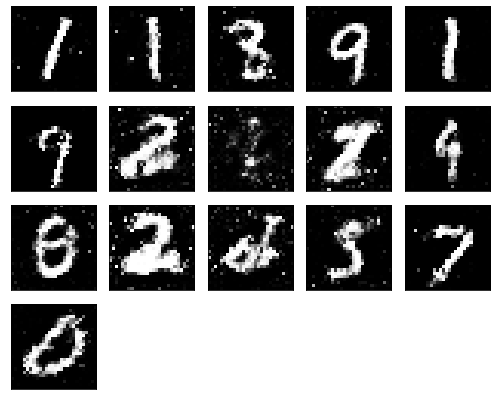

Epochs nb. 8421
discriminator loss: 0.5275305509567261
generator loss : 1.204059362411499

Epochs nb. 8422
discriminator loss: 0.542961835861206
generator loss : 0.9207345247268677

Epochs nb. 8423
discriminator loss: 0.6759048700332642
generator loss : 0.951046884059906

Epochs nb. 8424
discriminator loss: 0.5783293843269348
generator loss : 0.9898591041564941

Epochs nb. 8425
discriminator loss: 0.6201591491699219
generator loss : 0.9969626069068909

Epochs nb. 8426
discriminator loss: 0.655641496181488
generator loss : 1.0720185041427612

Epochs nb. 8427
discriminator loss: 0.7135053277015686
generator loss : 0.9610157012939453

Epochs nb. 8428
discriminator loss: 0.640017569065094
generator loss : 0.8855135440826416

Epochs nb. 8429
discriminator loss: 0.5861365795135498
generator loss : 0.9156728982925415

Epochs nb. 8430
discriminator loss: 0.5773372054100037
generator loss : 0.8825060129165649



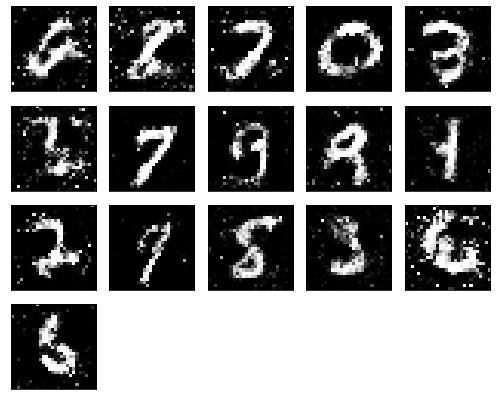

Epochs nb. 8431
discriminator loss: 0.5354099869728088
generator loss : 1.0244457721710205

Epochs nb. 8432
discriminator loss: 0.5946990251541138
generator loss : 1.0534968376159668

Epochs nb. 8433
discriminator loss: 0.7881472110748291
generator loss : 1.1707381010055542

Epochs nb. 8434
discriminator loss: 0.6042190790176392
generator loss : 1.1437702178955078

Epochs nb. 8435
discriminator loss: 0.49837684631347656
generator loss : 1.2338619232177734

Epochs nb. 8436
discriminator loss: 0.5044682025909424
generator loss : 1.0201597213745117

Epochs nb. 8437
discriminator loss: 0.6345667839050293
generator loss : 1.069600224494934

Epochs nb. 8438
discriminator loss: 0.6589431166648865
generator loss : 1.0670863389968872

Epochs nb. 8439
discriminator loss: 0.5547084808349609
generator loss : 1.1702392101287842

Epochs nb. 8440
discriminator loss: 0.678518533706665
generator loss : 1.1142818927764893



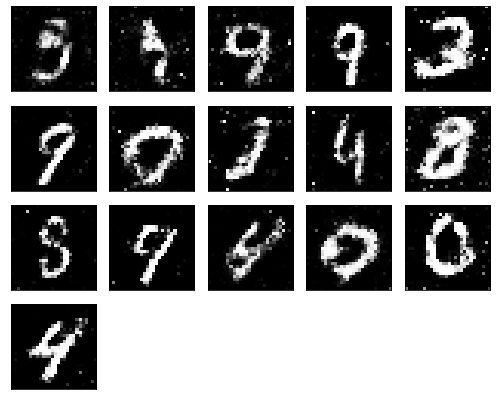

Epochs nb. 8441
discriminator loss: 0.5253055095672607
generator loss : 1.0473262071609497

Epochs nb. 8442
discriminator loss: 0.5825572609901428
generator loss : 1.1257473230361938

Epochs nb. 8443
discriminator loss: 0.7326422333717346
generator loss : 0.8531670570373535

Epochs nb. 8444
discriminator loss: 0.6273608207702637
generator loss : 0.8686762452125549

Epochs nb. 8445
discriminator loss: 0.6228835582733154
generator loss : 0.9966447353363037

Epochs nb. 8446
discriminator loss: 0.6162911653518677
generator loss : 1.2762973308563232

Epochs nb. 8447
discriminator loss: 0.6766058802604675
generator loss : 1.060949683189392

Epochs nb. 8448
discriminator loss: 0.485508531332016
generator loss : 0.9915713667869568

Epochs nb. 8449
discriminator loss: 0.49055975675582886
generator loss : 0.8878662586212158

Epochs nb. 8450
discriminator loss: 0.6074064373970032
generator loss : 0.8601056337356567



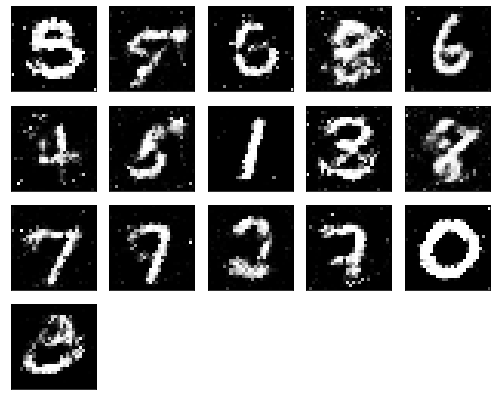

Epochs nb. 8451
discriminator loss: 0.6106551885604858
generator loss : 0.8150022029876709

Epochs nb. 8452
discriminator loss: 0.7164766788482666
generator loss : 0.8610261678695679

Epochs nb. 8453
discriminator loss: 0.5526214241981506
generator loss : 0.98720383644104

Epochs nb. 8454
discriminator loss: 0.6088535785675049
generator loss : 1.092868685722351

Epochs nb. 8455
discriminator loss: 0.48371899127960205
generator loss : 1.176396369934082

Epochs nb. 8456
discriminator loss: 0.5828472375869751
generator loss : 1.1290698051452637

Epochs nb. 8457
discriminator loss: 0.5946664214134216
generator loss : 1.0361735820770264

Epochs nb. 8458
discriminator loss: 0.7100614309310913
generator loss : 0.9486556053161621

Epochs nb. 8459
discriminator loss: 0.5353066325187683
generator loss : 0.9732645750045776

Epochs nb. 8460
discriminator loss: 0.5550770163536072
generator loss : 0.8789880275726318



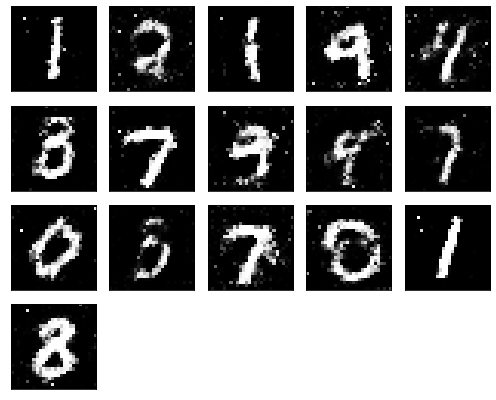

Epochs nb. 8461
discriminator loss: 0.6224690079689026
generator loss : 1.0642495155334473

Epochs nb. 8462
discriminator loss: 0.5999369621276855
generator loss : 1.1851959228515625

Epochs nb. 8463
discriminator loss: 0.6060916781425476
generator loss : 1.1323847770690918

Epochs nb. 8464
discriminator loss: 0.5030521750450134
generator loss : 0.9106253385543823

Epochs nb. 8465
discriminator loss: 0.5023393630981445
generator loss : 0.9185937643051147

Epochs nb. 8466
discriminator loss: 0.6498967409133911
generator loss : 0.9642261862754822

Epochs nb. 8467
discriminator loss: 0.736518144607544
generator loss : 1.0069067478179932

Epochs nb. 8468
discriminator loss: 0.6269857883453369
generator loss : 0.8628445267677307

Epochs nb. 8469
discriminator loss: 0.6127868890762329
generator loss : 0.8694205284118652

Epochs nb. 8470
discriminator loss: 0.6142581701278687
generator loss : 0.9985659122467041



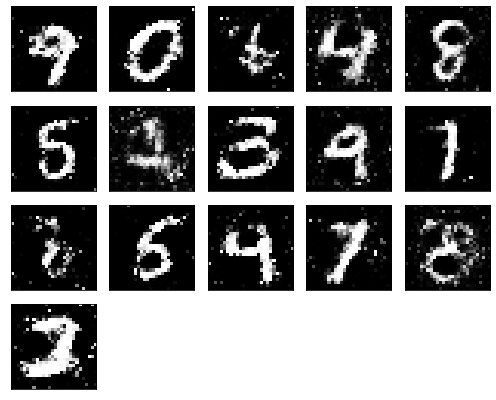

Epochs nb. 8471
discriminator loss: 0.5878163576126099
generator loss : 0.9500827789306641

Epochs nb. 8472
discriminator loss: 0.5571268200874329
generator loss : 0.8694238662719727

Epochs nb. 8473
discriminator loss: 0.5584100484848022
generator loss : 0.9315506219863892

Epochs nb. 8474
discriminator loss: 0.5292457342147827
generator loss : 1.0173852443695068

Epochs nb. 8475
discriminator loss: 0.5697199702262878
generator loss : 1.1732014417648315

Epochs nb. 8476
discriminator loss: 0.6039187908172607
generator loss : 1.169541835784912

Epochs nb. 8477
discriminator loss: 0.6292072534561157
generator loss : 1.2097654342651367

Epochs nb. 8478
discriminator loss: 0.717584490776062
generator loss : 1.2558649778366089

Epochs nb. 8479
discriminator loss: 0.6624938249588013
generator loss : 1.1335344314575195

Epochs nb. 8480
discriminator loss: 0.5222572684288025
generator loss : 0.8382601141929626



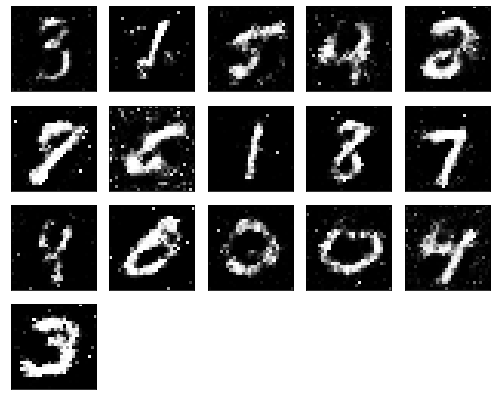

Epochs nb. 8481
discriminator loss: 0.5884560346603394
generator loss : 1.003520131111145

Epochs nb. 8482
discriminator loss: 0.6283966302871704
generator loss : 0.994651198387146

Epochs nb. 8483
discriminator loss: 0.6976734399795532
generator loss : 1.0988578796386719

Epochs nb. 8484
discriminator loss: 0.5139552354812622
generator loss : 0.9830207824707031

Epochs nb. 8485
discriminator loss: 0.8090729713439941
generator loss : 1.031358003616333

Epochs nb. 8486
discriminator loss: 0.5305412411689758
generator loss : 0.9661444425582886

Epochs nb. 8487
discriminator loss: 0.520283043384552
generator loss : 1.0463860034942627

Epochs nb. 8488
discriminator loss: 0.584226131439209
generator loss : 1.005979061126709

Epochs nb. 8489
discriminator loss: 0.6524636745452881
generator loss : 1.0352228879928589

Epochs nb. 8490
discriminator loss: 0.6221455335617065
generator loss : 0.823988139629364



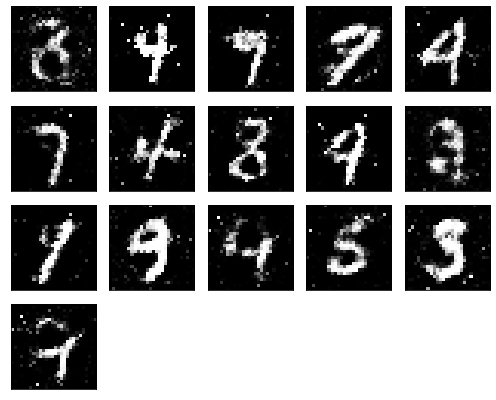

Epochs nb. 8491
discriminator loss: 0.5561930537223816
generator loss : 0.8691203594207764

Epochs nb. 8492
discriminator loss: 0.5965943932533264
generator loss : 0.754928469657898

Epochs nb. 8493
discriminator loss: 0.6672439575195312
generator loss : 0.8451163172721863

Epochs nb. 8494
discriminator loss: 0.5931694507598877
generator loss : 1.146677017211914

Epochs nb. 8495
discriminator loss: 0.6080664992332458
generator loss : 0.9801715016365051

Epochs nb. 8496
discriminator loss: 0.7042744755744934
generator loss : 0.9187878966331482

Epochs nb. 8497
discriminator loss: 0.5661516189575195
generator loss : 1.208146095275879

Epochs nb. 8498
discriminator loss: 0.7070085406303406
generator loss : 0.993878960609436

Epochs nb. 8499
discriminator loss: 0.5400853157043457
generator loss : 0.84346604347229

Epochs nb. 8500
discriminator loss: 0.5797213315963745
generator loss : 0.8325648903846741



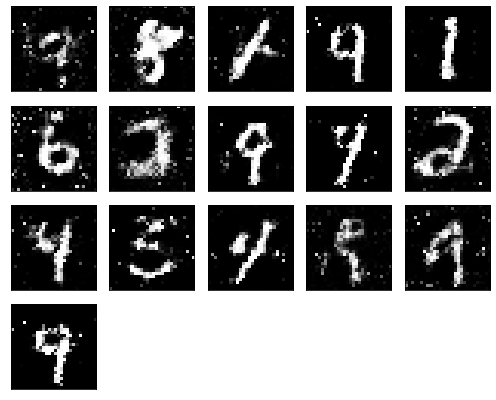

Epochs nb. 8501
discriminator loss: 0.5025970935821533
generator loss : 1.056255578994751

Epochs nb. 8502
discriminator loss: 0.6058014035224915
generator loss : 1.0562357902526855

Epochs nb. 8503
discriminator loss: 0.5540721416473389
generator loss : 1.0885686874389648

Epochs nb. 8504
discriminator loss: 0.713384211063385
generator loss : 1.0966401100158691

Epochs nb. 8505
discriminator loss: 0.6146761178970337
generator loss : 0.9054206609725952

Epochs nb. 8506
discriminator loss: 0.5577259659767151
generator loss : 0.8856568932533264

Epochs nb. 8507
discriminator loss: 0.5845850706100464
generator loss : 1.2142789363861084

Epochs nb. 8508
discriminator loss: 0.5226466655731201
generator loss : 1.2161813974380493

Epochs nb. 8509
discriminator loss: 0.5452596545219421
generator loss : 1.0465009212493896

Epochs nb. 8510
discriminator loss: 0.8666026592254639
generator loss : 0.9235442280769348



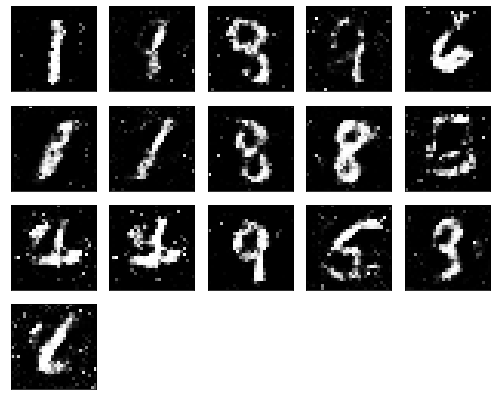

Epochs nb. 8511
discriminator loss: 0.5342280864715576
generator loss : 0.9818524718284607

Epochs nb. 8512
discriminator loss: 0.6464213132858276
generator loss : 0.9711345434188843

Epochs nb. 8513
discriminator loss: 0.6453675031661987
generator loss : 1.0173460245132446

Epochs nb. 8514
discriminator loss: 0.5481507778167725
generator loss : 1.1071691513061523

Epochs nb. 8515
discriminator loss: 0.5781608819961548
generator loss : 1.0940444469451904

Epochs nb. 8516
discriminator loss: 0.6852210760116577
generator loss : 1.2534011602401733

Epochs nb. 8517
discriminator loss: 0.4990096688270569
generator loss : 1.0001294612884521

Epochs nb. 8518
discriminator loss: 0.6437451839447021
generator loss : 1.1289335489273071

Epochs nb. 8519
discriminator loss: 0.700438916683197
generator loss : 0.8607801795005798

Epochs nb. 8520
discriminator loss: 0.6791301369667053
generator loss : 1.1384215354919434



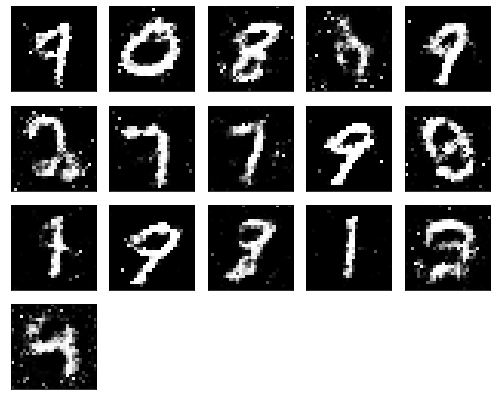

Epochs nb. 8521
discriminator loss: 0.7506837844848633
generator loss : 0.9578791856765747

Epochs nb. 8522
discriminator loss: 0.6733361482620239
generator loss : 1.1029318571090698

Epochs nb. 8523
discriminator loss: 0.49159032106399536
generator loss : 0.8534336090087891

Epochs nb. 8524
discriminator loss: 0.48251450061798096
generator loss : 0.8961840867996216

Epochs nb. 8525
discriminator loss: 0.6771011352539062
generator loss : 0.9673696160316467

Epochs nb. 8526
discriminator loss: 0.4981360137462616
generator loss : 0.9191589951515198

Epochs nb. 8527
discriminator loss: 0.6107533574104309
generator loss : 0.961071789264679

Epochs nb. 8528
discriminator loss: 0.5832510590553284
generator loss : 1.0198867321014404

Epochs nb. 8529
discriminator loss: 0.5319817662239075
generator loss : 0.9309202432632446

Epochs nb. 8530
discriminator loss: 0.5322211980819702
generator loss : 1.0634980201721191



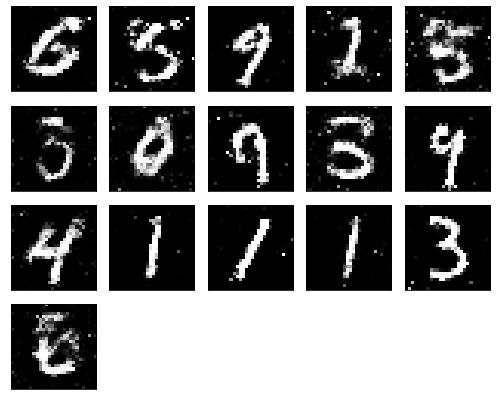

Epochs nb. 8531
discriminator loss: 0.48532286286354065
generator loss : 0.9266142845153809

Epochs nb. 8532
discriminator loss: 0.5620243549346924
generator loss : 1.0363757610321045

Epochs nb. 8533
discriminator loss: 0.637840747833252
generator loss : 0.9540859460830688

Epochs nb. 8534
discriminator loss: 0.6705462336540222
generator loss : 0.9695966243743896

Epochs nb. 8535
discriminator loss: 0.5673432350158691
generator loss : 0.8966819047927856

Epochs nb. 8536
discriminator loss: 0.618255615234375
generator loss : 1.022444486618042

Epochs nb. 8537
discriminator loss: 0.6579509973526001
generator loss : 0.9398481845855713

Epochs nb. 8538
discriminator loss: 0.6845279932022095
generator loss : 1.0540969371795654

Epochs nb. 8539
discriminator loss: 0.5180757641792297
generator loss : 0.9848659634590149

Epochs nb. 8540
discriminator loss: 0.5598282814025879
generator loss : 1.0933854579925537



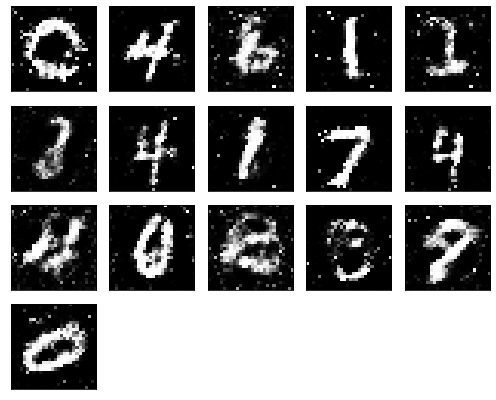

Epochs nb. 8541
discriminator loss: 0.48106443881988525
generator loss : 1.217324137687683

Epochs nb. 8542
discriminator loss: 0.4780225157737732
generator loss : 1.1384620666503906

Epochs nb. 8543
discriminator loss: 0.6483626365661621
generator loss : 0.9618199467658997

Epochs nb. 8544
discriminator loss: 0.662085771560669
generator loss : 0.970182478427887

Epochs nb. 8545
discriminator loss: 0.5432873964309692
generator loss : 0.9469387531280518

Epochs nb. 8546
discriminator loss: 0.47764521837234497
generator loss : 0.7178549766540527

Epochs nb. 8547
discriminator loss: 0.7684707641601562
generator loss : 1.0394411087036133

Epochs nb. 8548
discriminator loss: 0.634674072265625
generator loss : 0.997887909412384

Epochs nb. 8549
discriminator loss: 0.6608321666717529
generator loss : 0.9774883985519409

Epochs nb. 8550
discriminator loss: 0.71634441614151
generator loss : 0.7758140563964844



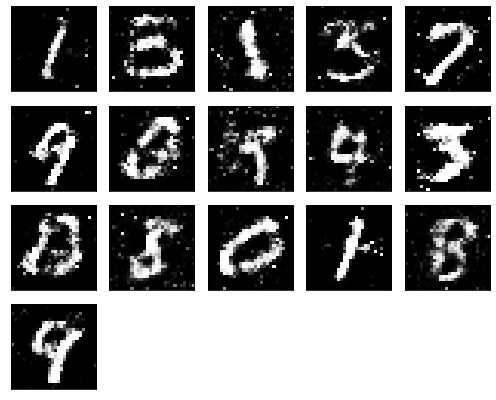

Epochs nb. 8551
discriminator loss: 0.6003882884979248
generator loss : 1.2409459352493286

Epochs nb. 8552
discriminator loss: 0.5977777242660522
generator loss : 1.1866117715835571

Epochs nb. 8553
discriminator loss: 0.6190817356109619
generator loss : 1.1883766651153564

Epochs nb. 8554
discriminator loss: 0.5725569725036621
generator loss : 1.0139234066009521

Epochs nb. 8555
discriminator loss: 0.5368207693099976
generator loss : 1.0230342149734497

Epochs nb. 8556
discriminator loss: 0.5891669988632202
generator loss : 0.9487025737762451

Epochs nb. 8557
discriminator loss: 0.5927987098693848
generator loss : 1.041529655456543

Epochs nb. 8558
discriminator loss: 0.5495282411575317
generator loss : 1.0672013759613037

Epochs nb. 8559
discriminator loss: 0.5773125290870667
generator loss : 0.8759239912033081

Epochs nb. 8560
discriminator loss: 0.7080703377723694
generator loss : 1.0055761337280273



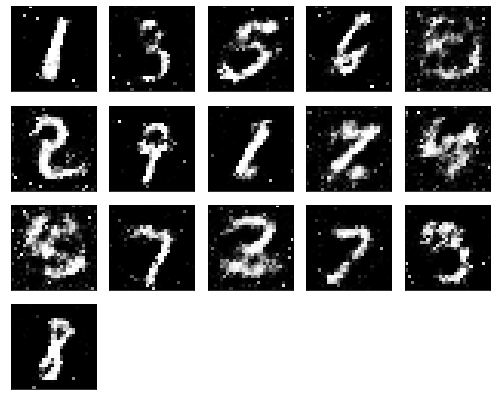

Epochs nb. 8561
discriminator loss: 0.5868460536003113
generator loss : 1.1168105602264404

Epochs nb. 8562
discriminator loss: 0.5069090127944946
generator loss : 0.9428980350494385

Epochs nb. 8563
discriminator loss: 0.5969222784042358
generator loss : 1.3800723552703857

Epochs nb. 8564
discriminator loss: 0.5584428310394287
generator loss : 1.1670105457305908

Epochs nb. 8565
discriminator loss: 0.6023846864700317
generator loss : 0.9072673320770264

Epochs nb. 8566
discriminator loss: 0.5303769707679749
generator loss : 0.8293637633323669

Epochs nb. 8567
discriminator loss: 0.5571122169494629
generator loss : 0.7526283860206604

Epochs nb. 8568
discriminator loss: 0.5929975509643555
generator loss : 0.9203450679779053

Epochs nb. 8569
discriminator loss: 0.5491805672645569
generator loss : 1.2605607509613037

Epochs nb. 8570
discriminator loss: 0.6783452033996582
generator loss : 1.1071372032165527



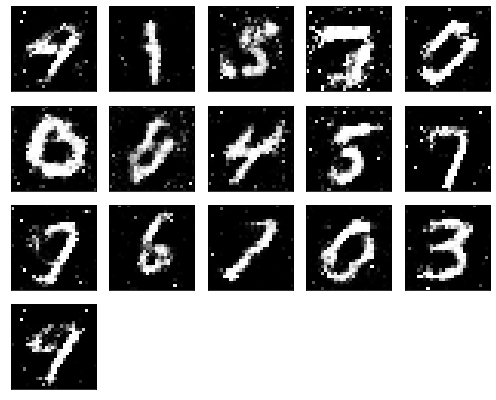

Epochs nb. 8571
discriminator loss: 0.6467782855033875
generator loss : 1.1625781059265137

Epochs nb. 8572
discriminator loss: 0.6559818983078003
generator loss : 1.2240667343139648

Epochs nb. 8573
discriminator loss: 0.5653916001319885
generator loss : 1.112924575805664

Epochs nb. 8574
discriminator loss: 0.6446753740310669
generator loss : 0.9908360838890076

Epochs nb. 8575
discriminator loss: 0.5318270921707153
generator loss : 0.9792587161064148

Epochs nb. 8576
discriminator loss: 0.5853684544563293
generator loss : 0.9427918791770935

Epochs nb. 8577
discriminator loss: 0.6246288418769836
generator loss : 0.8720097541809082

Epochs nb. 8578
discriminator loss: 0.4978732466697693
generator loss : 0.9201765060424805

Epochs nb. 8579
discriminator loss: 0.5475834608078003
generator loss : 1.0873624086380005

Epochs nb. 8580
discriminator loss: 0.5306104421615601
generator loss : 1.153566598892212



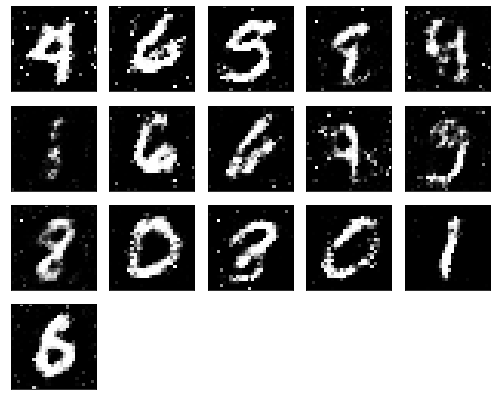

Epochs nb. 8581
discriminator loss: 0.759628415107727
generator loss : 1.124530553817749

Epochs nb. 8582
discriminator loss: 0.560457706451416
generator loss : 1.0475918054580688

Epochs nb. 8583
discriminator loss: 0.6527111530303955
generator loss : 1.0100517272949219

Epochs nb. 8584
discriminator loss: 0.5615177154541016
generator loss : 1.1151158809661865

Epochs nb. 8585
discriminator loss: 0.48370692133903503
generator loss : 0.9366593360900879

Epochs nb. 8586
discriminator loss: 0.4767266511917114
generator loss : 1.0113999843597412

Epochs nb. 8587
discriminator loss: 0.6012285351753235
generator loss : 0.9995156526565552

Epochs nb. 8588
discriminator loss: 0.6142463088035583
generator loss : 0.9814132452011108

Epochs nb. 8589
discriminator loss: 0.6134548187255859
generator loss : 0.7746169567108154

Epochs nb. 8590
discriminator loss: 0.6260299682617188
generator loss : 1.0289905071258545



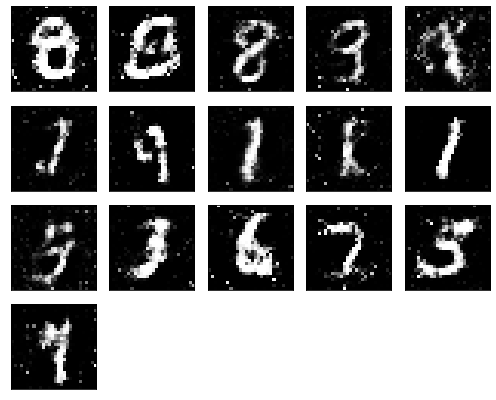

Epochs nb. 8591
discriminator loss: 0.5505650639533997
generator loss : 0.9743350744247437

Epochs nb. 8592
discriminator loss: 0.5255756974220276
generator loss : 0.9970043301582336

Epochs nb. 8593
discriminator loss: 0.8357438445091248
generator loss : 0.9715081453323364

Epochs nb. 8594
discriminator loss: 0.5301758050918579
generator loss : 1.0743647813796997

Epochs nb. 8595
discriminator loss: 0.6819158792495728
generator loss : 0.9280740022659302

Epochs nb. 8596
discriminator loss: 0.5802570581436157
generator loss : 0.8216553926467896

Epochs nb. 8597
discriminator loss: 0.634679913520813
generator loss : 0.9863879680633545

Epochs nb. 8598
discriminator loss: 0.49783456325531006
generator loss : 1.0177233219146729

Epochs nb. 8599
discriminator loss: 0.7872536182403564
generator loss : 0.9918723702430725

Epochs nb. 8600
discriminator loss: 0.6736828088760376
generator loss : 1.125914454460144



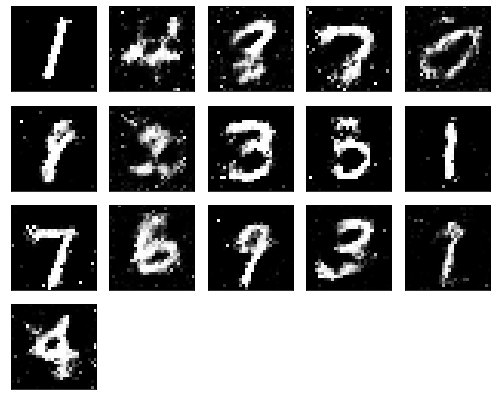

Epochs nb. 8601
discriminator loss: 0.6695807576179504
generator loss : 1.0959398746490479

Epochs nb. 8602
discriminator loss: 0.6671308279037476
generator loss : 0.9484843015670776

Epochs nb. 8603
discriminator loss: 0.5641921758651733
generator loss : 1.0023508071899414

Epochs nb. 8604
discriminator loss: 0.6923236846923828
generator loss : 1.173858880996704

Epochs nb. 8605
discriminator loss: 0.5211960077285767
generator loss : 1.0934779644012451

Epochs nb. 8606
discriminator loss: 0.7119178771972656
generator loss : 1.0889071226119995

Epochs nb. 8607
discriminator loss: 0.6207567453384399
generator loss : 1.0898123979568481

Epochs nb. 8608
discriminator loss: 0.7422395944595337
generator loss : 1.0188522338867188

Epochs nb. 8609
discriminator loss: 0.49514609575271606
generator loss : 1.0719561576843262

Epochs nb. 8610
discriminator loss: 0.6125329732894897
generator loss : 0.9269647002220154



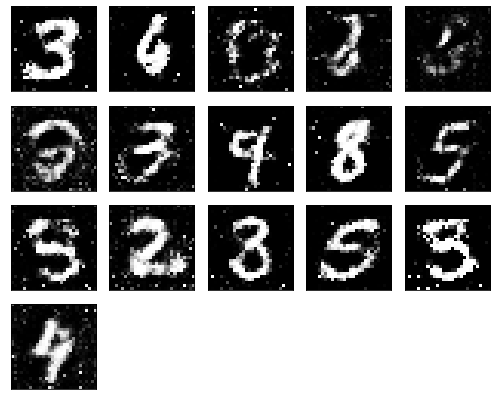

Epochs nb. 8611
discriminator loss: 0.6027095317840576
generator loss : 0.9126129746437073

Epochs nb. 8612
discriminator loss: 0.6936344504356384
generator loss : 0.9640296101570129

Epochs nb. 8613
discriminator loss: 0.605937123298645
generator loss : 1.2631452083587646

Epochs nb. 8614
discriminator loss: 0.6360541582107544
generator loss : 0.9676564931869507

Epochs nb. 8615
discriminator loss: 0.5847060680389404
generator loss : 0.9506155848503113

Epochs nb. 8616
discriminator loss: 0.6496310830116272
generator loss : 0.8661065101623535

Epochs nb. 8617
discriminator loss: 0.5137020349502563
generator loss : 1.213252305984497

Epochs nb. 8618
discriminator loss: 0.768318235874176
generator loss : 0.9511522054672241

Epochs nb. 8619
discriminator loss: 0.6364154815673828
generator loss : 0.9207424521446228

Epochs nb. 8620
discriminator loss: 0.7253513336181641
generator loss : 0.9451563358306885



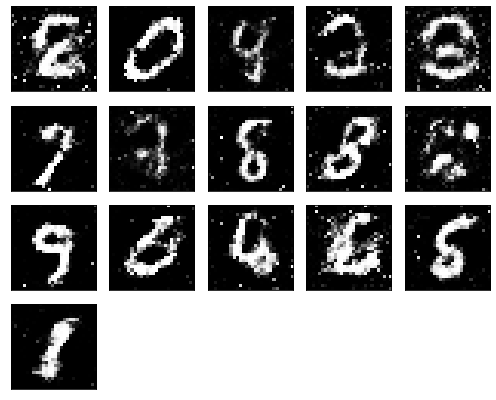

Epochs nb. 8621
discriminator loss: 0.591831624507904
generator loss : 0.8719038367271423

Epochs nb. 8622
discriminator loss: 0.5510866641998291
generator loss : 1.0956964492797852

Epochs nb. 8623
discriminator loss: 0.5494250059127808
generator loss : 0.887811005115509

Epochs nb. 8624
discriminator loss: 0.5309363603591919
generator loss : 1.0717358589172363

Epochs nb. 8625
discriminator loss: 0.5761837959289551
generator loss : 1.0594775676727295

Epochs nb. 8626
discriminator loss: 0.7121328711509705
generator loss : 0.8630317449569702

Epochs nb. 8627
discriminator loss: 0.664864182472229
generator loss : 1.0419530868530273

Epochs nb. 8628
discriminator loss: 0.6567120552062988
generator loss : 0.8492239713668823

Epochs nb. 8629
discriminator loss: 0.7292388677597046
generator loss : 0.7135802507400513

Epochs nb. 8630
discriminator loss: 0.8086272478103638
generator loss : 0.8637247085571289



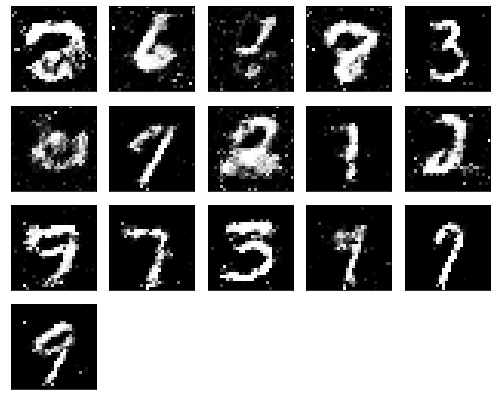

Epochs nb. 8631
discriminator loss: 0.5247711539268494
generator loss : 1.0804288387298584

Epochs nb. 8632
discriminator loss: 0.6625667214393616
generator loss : 0.9972335696220398

Epochs nb. 8633
discriminator loss: 0.48358139395713806
generator loss : 1.2656972408294678

Epochs nb. 8634
discriminator loss: 0.5413246750831604
generator loss : 1.0220543146133423

Epochs nb. 8635
discriminator loss: 0.5596872568130493
generator loss : 0.963615894317627

Epochs nb. 8636
discriminator loss: 0.7945624589920044
generator loss : 0.9781873226165771

Epochs nb. 8637
discriminator loss: 0.48742935061454773
generator loss : 0.955357551574707

Epochs nb. 8638
discriminator loss: 0.6959700584411621
generator loss : 0.9000293016433716

Epochs nb. 8639
discriminator loss: 0.7255197763442993
generator loss : 0.8290512561798096

Epochs nb. 8640
discriminator loss: 0.732384204864502
generator loss : 1.0858540534973145



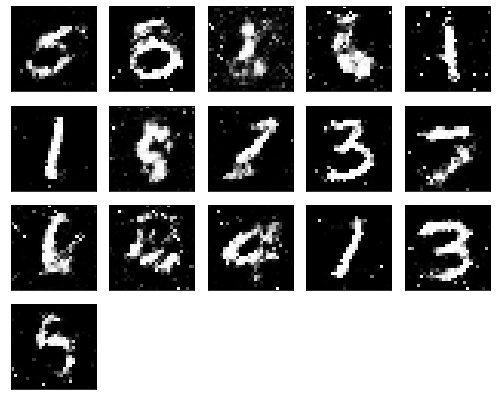

Epochs nb. 8641
discriminator loss: 0.5059527158737183
generator loss : 1.103806972503662

Epochs nb. 8642
discriminator loss: 0.6295149326324463
generator loss : 0.8829283714294434

Epochs nb. 8643
discriminator loss: 0.5454623699188232
generator loss : 0.8869239091873169

Epochs nb. 8644
discriminator loss: 0.5827497243881226
generator loss : 0.7146453857421875

Epochs nb. 8645
discriminator loss: 0.5247336030006409
generator loss : 0.864879846572876

Epochs nb. 8646
discriminator loss: 0.5518084168434143
generator loss : 1.0083438158035278

Epochs nb. 8647
discriminator loss: 0.5141148567199707
generator loss : 0.9219753742218018

Epochs nb. 8648
discriminator loss: 0.6219199895858765
generator loss : 0.9005684852600098

Epochs nb. 8649
discriminator loss: 0.5367900729179382
generator loss : 0.8207941055297852

Epochs nb. 8650
discriminator loss: 0.4614555239677429
generator loss : 0.8679620027542114



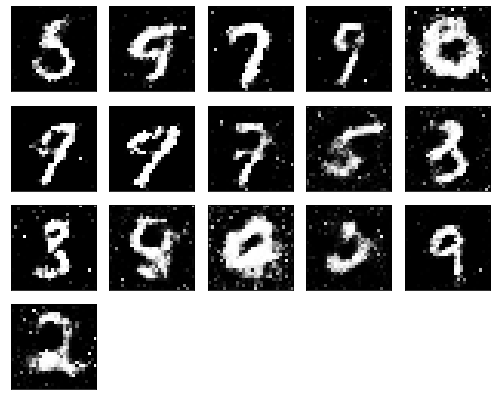

Epochs nb. 8651
discriminator loss: 0.583692729473114
generator loss : 0.9345471858978271

Epochs nb. 8652
discriminator loss: 0.8096315860748291
generator loss : 0.8628702163696289

Epochs nb. 8653
discriminator loss: 0.6156731843948364
generator loss : 1.016499638557434

Epochs nb. 8654
discriminator loss: 0.6335674524307251
generator loss : 0.9405978918075562

Epochs nb. 8655
discriminator loss: 0.547896146774292
generator loss : 1.0852832794189453

Epochs nb. 8656
discriminator loss: 0.4697722792625427
generator loss : 1.2663097381591797

Epochs nb. 8657
discriminator loss: 0.6412758827209473
generator loss : 1.1178945302963257

Epochs nb. 8658
discriminator loss: 0.4528491497039795
generator loss : 0.9939056634902954

Epochs nb. 8659
discriminator loss: 0.472369909286499
generator loss : 1.026113510131836

Epochs nb. 8660
discriminator loss: 0.6805467009544373
generator loss : 1.11468505859375



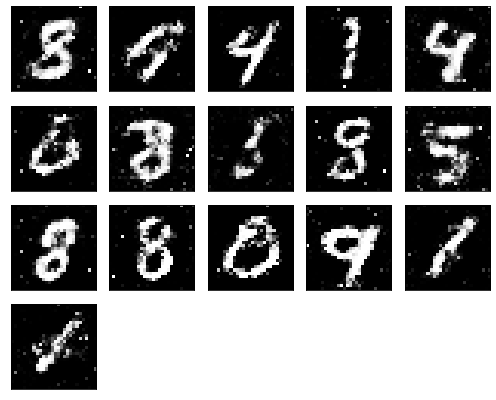

Epochs nb. 8661
discriminator loss: 0.6797598004341125
generator loss : 1.2751662731170654

Epochs nb. 8662
discriminator loss: 0.6170406341552734
generator loss : 1.2362334728240967

Epochs nb. 8663
discriminator loss: 0.6763144135475159
generator loss : 1.2658679485321045

Epochs nb. 8664
discriminator loss: 0.6074069738388062
generator loss : 0.9946596026420593

Epochs nb. 8665
discriminator loss: 0.6169245839118958
generator loss : 0.895632803440094

Epochs nb. 8666
discriminator loss: 0.6659630537033081
generator loss : 0.9551540613174438

Epochs nb. 8667
discriminator loss: 0.749055027961731
generator loss : 1.0216412544250488

Epochs nb. 8668
discriminator loss: 0.6504669785499573
generator loss : 1.2079904079437256

Epochs nb. 8669
discriminator loss: 0.4789884686470032
generator loss : 1.1599063873291016

Epochs nb. 8670
discriminator loss: 0.4596749544143677
generator loss : 1.0058419704437256



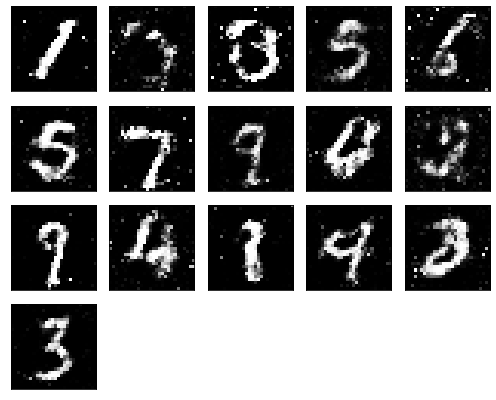

Epochs nb. 8671
discriminator loss: 0.7539603114128113
generator loss : 1.084652304649353

Epochs nb. 8672
discriminator loss: 0.5935637354850769
generator loss : 1.0892603397369385

Epochs nb. 8673
discriminator loss: 0.5387942790985107
generator loss : 0.8188034296035767

Epochs nb. 8674
discriminator loss: 0.41428977251052856
generator loss : 0.9672830700874329

Epochs nb. 8675
discriminator loss: 0.5727881789207458
generator loss : 0.9219000339508057

Epochs nb. 8676
discriminator loss: 0.6735156774520874
generator loss : 1.0648270845413208

Epochs nb. 8677
discriminator loss: 0.5479127764701843
generator loss : 0.9924982190132141

Epochs nb. 8678
discriminator loss: 0.5170831084251404
generator loss : 1.1474827527999878

Epochs nb. 8679
discriminator loss: 0.7073632478713989
generator loss : 1.1176506280899048

Epochs nb. 8680
discriminator loss: 0.6480207443237305
generator loss : 1.1104865074157715



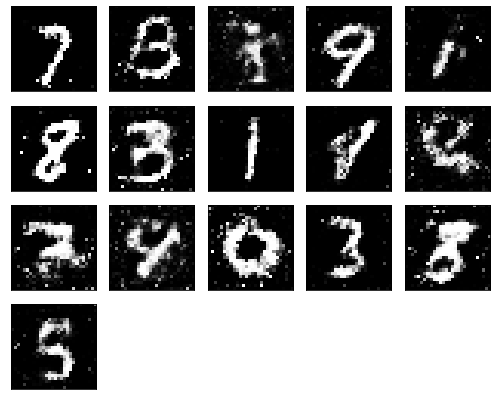

Epochs nb. 8681
discriminator loss: 0.7664202451705933
generator loss : 1.0100740194320679

Epochs nb. 8682
discriminator loss: 0.6196793913841248
generator loss : 0.8065453171730042

Epochs nb. 8683
discriminator loss: 0.5708304643630981
generator loss : 0.8388625979423523

Epochs nb. 8684
discriminator loss: 0.5853029489517212
generator loss : 0.9231549501419067

Epochs nb. 8685
discriminator loss: 0.5732102394104004
generator loss : 0.9991612434387207

Epochs nb. 8686
discriminator loss: 0.6264918446540833
generator loss : 0.9403144121170044

Epochs nb. 8687
discriminator loss: 0.7753734588623047
generator loss : 1.063515067100525

Epochs nb. 8688
discriminator loss: 0.6937565803527832
generator loss : 0.8785761594772339

Epochs nb. 8689
discriminator loss: 0.7727817893028259
generator loss : 0.8461419939994812

Epochs nb. 8690
discriminator loss: 0.49506768584251404
generator loss : 0.7484110593795776



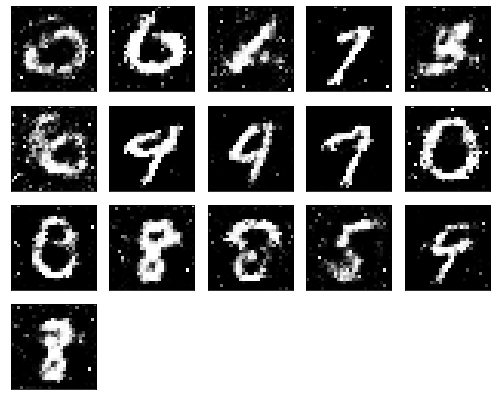

Epochs nb. 8691
discriminator loss: 0.6642391085624695
generator loss : 1.1589447259902954

Epochs nb. 8692
discriminator loss: 0.4391421973705292
generator loss : 0.8496183156967163

Epochs nb. 8693
discriminator loss: 0.6811264753341675
generator loss : 1.2933590412139893

Epochs nb. 8694
discriminator loss: 0.6150256991386414
generator loss : 1.1468119621276855

Epochs nb. 8695
discriminator loss: 0.5919418334960938
generator loss : 1.0797646045684814

Epochs nb. 8696
discriminator loss: 0.5408474206924438
generator loss : 0.9912359714508057

Epochs nb. 8697
discriminator loss: 0.5710737705230713
generator loss : 0.9965196251869202

Epochs nb. 8698
discriminator loss: 0.6389726400375366
generator loss : 0.9055520296096802

Epochs nb. 8699
discriminator loss: 0.5404964089393616
generator loss : 1.0775516033172607

Epochs nb. 8700
discriminator loss: 0.5052628517150879
generator loss : 0.9494679570198059



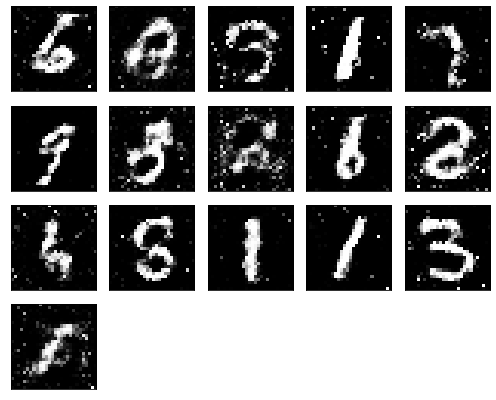

Epochs nb. 8701
discriminator loss: 0.5363456010818481
generator loss : 0.8593229055404663

Epochs nb. 8702
discriminator loss: 0.6412475109100342
generator loss : 0.9146982431411743

Epochs nb. 8703
discriminator loss: 0.5744618773460388
generator loss : 1.002702236175537

Epochs nb. 8704
discriminator loss: 0.5263015031814575
generator loss : 1.085416316986084

Epochs nb. 8705
discriminator loss: 0.6474771499633789
generator loss : 0.9689834117889404

Epochs nb. 8706
discriminator loss: 0.543022096157074
generator loss : 0.8528046011924744

Epochs nb. 8707
discriminator loss: 0.5245232582092285
generator loss : 0.9372114539146423

Epochs nb. 8708
discriminator loss: 0.5950524210929871
generator loss : 1.1443241834640503

Epochs nb. 8709
discriminator loss: 0.6411079168319702
generator loss : 0.9004192352294922

Epochs nb. 8710
discriminator loss: 0.7200772762298584
generator loss : 1.0438814163208008



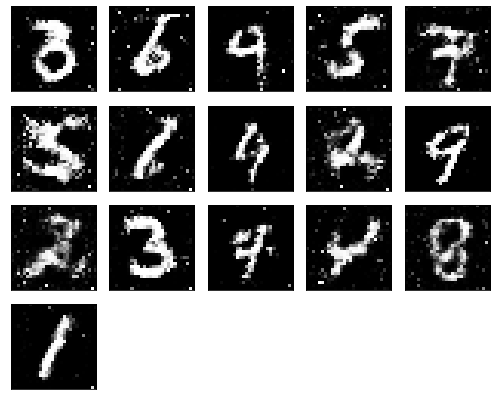

Epochs nb. 8711
discriminator loss: 0.5520848631858826
generator loss : 1.0541150569915771

Epochs nb. 8712
discriminator loss: 0.6615886092185974
generator loss : 0.9815179109573364

Epochs nb. 8713
discriminator loss: 0.6234320402145386
generator loss : 0.9827365279197693

Epochs nb. 8714
discriminator loss: 0.7302851676940918
generator loss : 1.1352993249893188

Epochs nb. 8715
discriminator loss: 0.5166308879852295
generator loss : 0.8995687961578369

Epochs nb. 8716
discriminator loss: 0.5642961859703064
generator loss : 1.0586283206939697

Epochs nb. 8717
discriminator loss: 0.582238495349884
generator loss : 0.8803591728210449

Epochs nb. 8718
discriminator loss: 0.5467429161071777
generator loss : 1.0387067794799805

Epochs nb. 8719
discriminator loss: 0.561622142791748
generator loss : 0.9705173373222351

Epochs nb. 8720
discriminator loss: 0.5087224245071411
generator loss : 0.9336622953414917



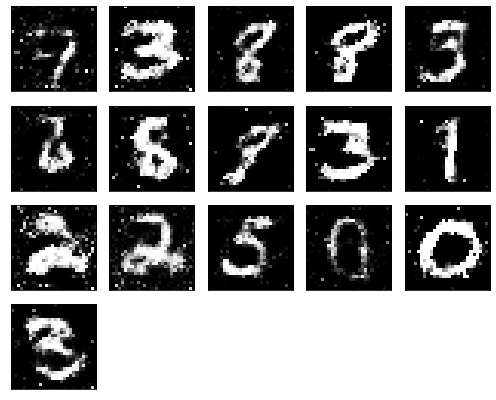

Epochs nb. 8721
discriminator loss: 0.6454079151153564
generator loss : 1.038989543914795

Epochs nb. 8722
discriminator loss: 0.6993085145950317
generator loss : 0.8782504796981812

Epochs nb. 8723
discriminator loss: 0.638923704624176
generator loss : 0.835873007774353

Epochs nb. 8724
discriminator loss: 0.532604455947876
generator loss : 0.9382846355438232

Epochs nb. 8725
discriminator loss: 0.48455196619033813
generator loss : 0.765450119972229

Epochs nb. 8726
discriminator loss: 0.6817399263381958
generator loss : 1.022141456604004

Epochs nb. 8727
discriminator loss: 0.5927616357803345
generator loss : 0.9931927919387817

Epochs nb. 8728
discriminator loss: 0.6848419308662415
generator loss : 0.9109046459197998

Epochs nb. 8729
discriminator loss: 0.48937228322029114
generator loss : 1.172324538230896

Epochs nb. 8730
discriminator loss: 0.5706828832626343
generator loss : 0.9829062223434448



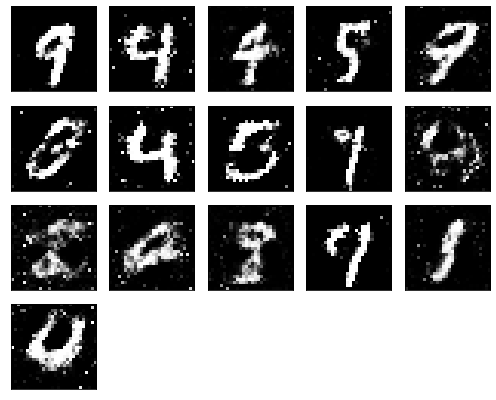

Epochs nb. 8731
discriminator loss: 0.5877697467803955
generator loss : 0.942603588104248

Epochs nb. 8732
discriminator loss: 0.5227969288825989
generator loss : 0.8972070217132568

Epochs nb. 8733
discriminator loss: 0.6415607929229736
generator loss : 1.1148654222488403

Epochs nb. 8734
discriminator loss: 0.7035999298095703
generator loss : 1.0124619007110596

Epochs nb. 8735
discriminator loss: 0.5828948020935059
generator loss : 0.9615792036056519

Epochs nb. 8736
discriminator loss: 0.5124177932739258
generator loss : 0.9768670201301575

Epochs nb. 8737
discriminator loss: 0.7480918169021606
generator loss : 0.9612513780593872

Epochs nb. 8738
discriminator loss: 0.6761386394500732
generator loss : 0.9854670763015747

Epochs nb. 8739
discriminator loss: 0.5936122536659241
generator loss : 0.9395475387573242

Epochs nb. 8740
discriminator loss: 0.5776567459106445
generator loss : 0.980767011642456



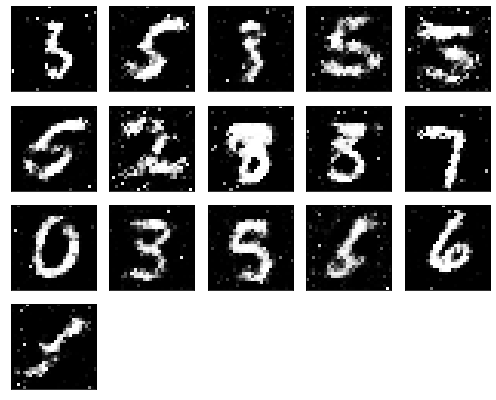

Epochs nb. 8741
discriminator loss: 0.40215975046157837
generator loss : 1.0828092098236084

Epochs nb. 8742
discriminator loss: 0.7441278100013733
generator loss : 0.9547301530838013

Epochs nb. 8743
discriminator loss: 0.571218729019165
generator loss : 0.7481071949005127

Epochs nb. 8744
discriminator loss: 0.6710174679756165
generator loss : 0.8191489577293396

Epochs nb. 8745
discriminator loss: 0.4851919412612915
generator loss : 1.028676152229309

Epochs nb. 8746
discriminator loss: 0.7420338988304138
generator loss : 1.1635956764221191

Epochs nb. 8747
discriminator loss: 0.5519821047782898
generator loss : 1.1130577325820923

Epochs nb. 8748
discriminator loss: 0.5964143872261047
generator loss : 1.1621298789978027

Epochs nb. 8749
discriminator loss: 0.5333685874938965
generator loss : 1.0071980953216553

Epochs nb. 8750
discriminator loss: 0.5852928161621094
generator loss : 1.0130081176757812



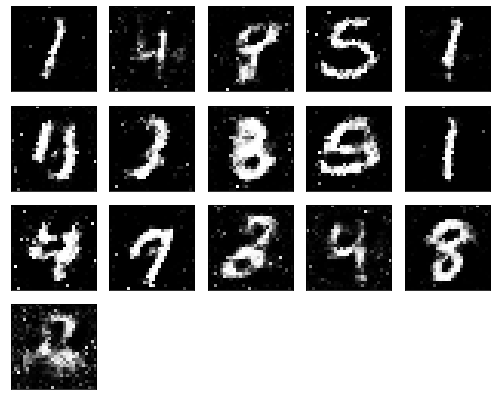

Epochs nb. 8751
discriminator loss: 0.5187108516693115
generator loss : 1.0392749309539795

Epochs nb. 8752
discriminator loss: 0.5883702635765076
generator loss : 0.9452479481697083

Epochs nb. 8753
discriminator loss: 0.6504599452018738
generator loss : 1.0460460186004639

Epochs nb. 8754
discriminator loss: 0.4967080056667328
generator loss : 1.0760661363601685

Epochs nb. 8755
discriminator loss: 0.6447422504425049
generator loss : 0.9205938577651978

Epochs nb. 8756
discriminator loss: 0.6502736806869507
generator loss : 0.8642387390136719

Epochs nb. 8757
discriminator loss: 0.6330026984214783
generator loss : 0.8685070872306824

Epochs nb. 8758
discriminator loss: 0.5418171882629395
generator loss : 1.0773701667785645

Epochs nb. 8759
discriminator loss: 0.5879572629928589
generator loss : 1.154388427734375

Epochs nb. 8760
discriminator loss: 0.6188780069351196
generator loss : 1.0071673393249512



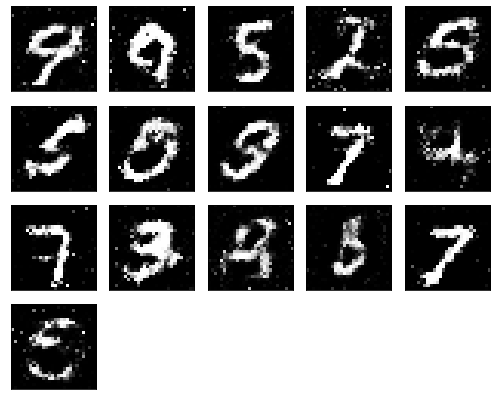

Epochs nb. 8761
discriminator loss: 0.538239598274231
generator loss : 0.9910290241241455

Epochs nb. 8762
discriminator loss: 0.6245609521865845
generator loss : 0.8158853650093079

Epochs nb. 8763
discriminator loss: 0.5186547040939331
generator loss : 1.057344913482666

Epochs nb. 8764
discriminator loss: 0.6565472483634949
generator loss : 0.7548403143882751

Epochs nb. 8765
discriminator loss: 0.5937619209289551
generator loss : 1.0395262241363525

Epochs nb. 8766
discriminator loss: 0.47987669706344604
generator loss : 0.871610701084137

Epochs nb. 8767
discriminator loss: 0.6592739820480347
generator loss : 0.8064020276069641

Epochs nb. 8768
discriminator loss: 0.5361104011535645
generator loss : 1.0258764028549194

Epochs nb. 8769
discriminator loss: 0.5287813544273376
generator loss : 0.9555842876434326

Epochs nb. 8770
discriminator loss: 0.5992016792297363
generator loss : 1.0652207136154175



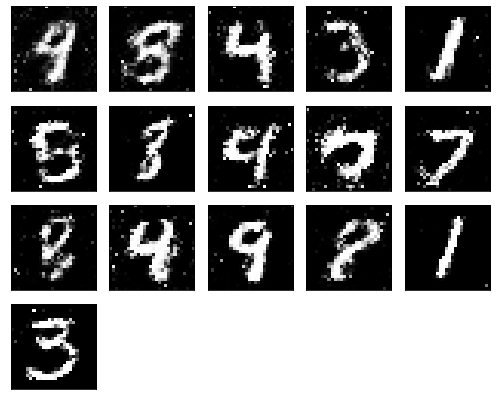

Epochs nb. 8771
discriminator loss: 0.49698588252067566
generator loss : 0.9962326288223267

Epochs nb. 8772
discriminator loss: 0.7604982852935791
generator loss : 1.0754151344299316

Epochs nb. 8773
discriminator loss: 0.6247427463531494
generator loss : 0.919811487197876

Epochs nb. 8774
discriminator loss: 0.548882007598877
generator loss : 0.8453310132026672

Epochs nb. 8775
discriminator loss: 0.801480770111084
generator loss : 0.922347903251648

Epochs nb. 8776
discriminator loss: 0.6331390142440796
generator loss : 0.9674068689346313

Epochs nb. 8777
discriminator loss: 0.6343581676483154
generator loss : 1.0300694704055786

Epochs nb. 8778
discriminator loss: 0.6932934522628784
generator loss : 0.8982418775558472

Epochs nb. 8779
discriminator loss: 0.7314910292625427
generator loss : 1.0464636087417603

Epochs nb. 8780
discriminator loss: 0.5471855401992798
generator loss : 1.079406499862671



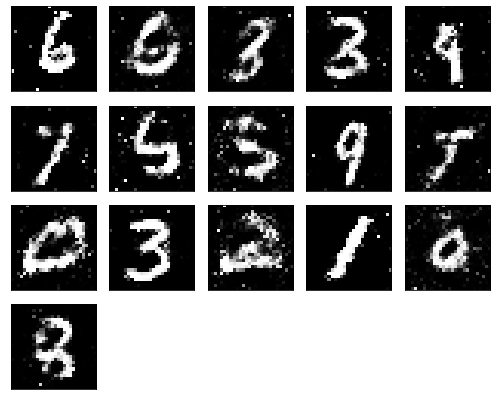

Epochs nb. 8781
discriminator loss: 0.6808534860610962
generator loss : 1.1485484838485718

Epochs nb. 8782
discriminator loss: 0.48073336482048035
generator loss : 0.9022759199142456

Epochs nb. 8783
discriminator loss: 0.5385265350341797
generator loss : 0.9390169382095337

Epochs nb. 8784
discriminator loss: 0.6604223251342773
generator loss : 1.014219880104065

Epochs nb. 8785
discriminator loss: 0.5221657752990723
generator loss : 1.137277603149414

Epochs nb. 8786
discriminator loss: 0.4068964123725891
generator loss : 1.1455206871032715

Epochs nb. 8787
discriminator loss: 0.6250126957893372
generator loss : 1.1000815629959106

Epochs nb. 8788
discriminator loss: 0.7273074388504028
generator loss : 1.090646743774414

Epochs nb. 8789
discriminator loss: 0.6525662541389465
generator loss : 0.9273256063461304

Epochs nb. 8790
discriminator loss: 0.6526707410812378
generator loss : 0.911152720451355



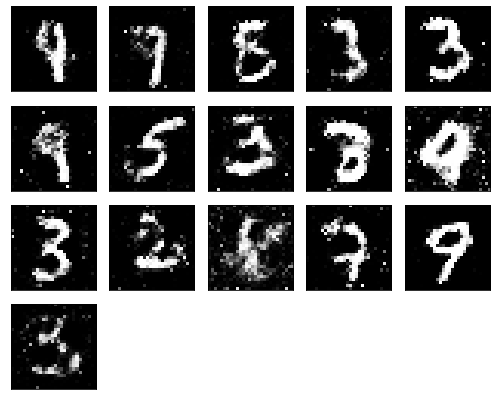

Epochs nb. 8791
discriminator loss: 0.6613767743110657
generator loss : 0.9226627349853516

Epochs nb. 8792
discriminator loss: 0.5509620308876038
generator loss : 0.913169264793396

Epochs nb. 8793
discriminator loss: 0.586582362651825
generator loss : 0.9430075287818909

Epochs nb. 8794
discriminator loss: 0.7044963240623474
generator loss : 1.0222376585006714

Epochs nb. 8795
discriminator loss: 0.6546076536178589
generator loss : 1.1355247497558594

Epochs nb. 8796
discriminator loss: 0.5303665399551392
generator loss : 1.0190584659576416

Epochs nb. 8797
discriminator loss: 0.5023345351219177
generator loss : 0.8523757457733154

Epochs nb. 8798
discriminator loss: 0.6515483856201172
generator loss : 1.452388048171997

Epochs nb. 8799
discriminator loss: 0.6599794626235962
generator loss : 1.147995114326477

Epochs nb. 8800
discriminator loss: 0.672333300113678
generator loss : 1.1839691400527954



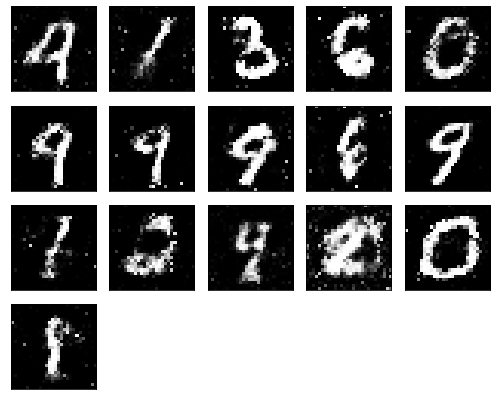

Epochs nb. 8801
discriminator loss: 0.5877296924591064
generator loss : 1.1301020383834839

Epochs nb. 8802
discriminator loss: 0.5374946594238281
generator loss : 1.0054047107696533

Epochs nb. 8803
discriminator loss: 0.6511304378509521
generator loss : 0.9484171271324158

Epochs nb. 8804
discriminator loss: 0.6694245934486389
generator loss : 1.0989811420440674

Epochs nb. 8805
discriminator loss: 0.6014367341995239
generator loss : 1.1437183618545532

Epochs nb. 8806
discriminator loss: 0.6588201522827148
generator loss : 0.999579668045044

Epochs nb. 8807
discriminator loss: 0.7784862518310547
generator loss : 1.20879328250885

Epochs nb. 8808
discriminator loss: 0.5759455561637878
generator loss : 1.0761187076568604

Epochs nb. 8809
discriminator loss: 0.5353678464889526
generator loss : 1.211038589477539

Epochs nb. 8810
discriminator loss: 0.5827405452728271
generator loss : 1.211795449256897



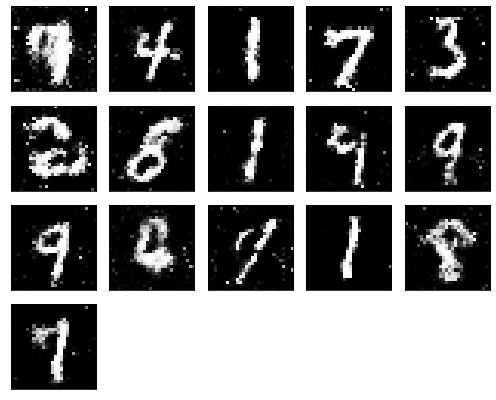

Epochs nb. 8811
discriminator loss: 0.4875737130641937
generator loss : 1.00816011428833

Epochs nb. 8812
discriminator loss: 0.558320164680481
generator loss : 1.149061918258667

Epochs nb. 8813
discriminator loss: 0.6834520101547241
generator loss : 1.124727487564087

Epochs nb. 8814
discriminator loss: 0.6339437961578369
generator loss : 1.0846712589263916

Epochs nb. 8815
discriminator loss: 0.5175605416297913
generator loss : 1.0112698078155518

Epochs nb. 8816
discriminator loss: 0.5191751718521118
generator loss : 0.8566734790802002

Epochs nb. 8817
discriminator loss: 0.5699343085289001
generator loss : 0.8023028373718262

Epochs nb. 8818
discriminator loss: 0.6723152995109558
generator loss : 0.9803478717803955

Epochs nb. 8819
discriminator loss: 0.7165998220443726
generator loss : 1.144087791442871

Epochs nb. 8820
discriminator loss: 0.7316301465034485
generator loss : 1.023837924003601



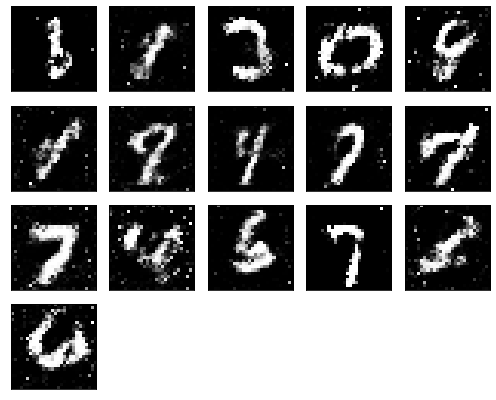

Epochs nb. 8821
discriminator loss: 0.6280443668365479
generator loss : 0.9919059872627258

Epochs nb. 8822
discriminator loss: 0.5628170967102051
generator loss : 1.1616066694259644

Epochs nb. 8823
discriminator loss: 0.5573925971984863
generator loss : 0.9356753826141357

Epochs nb. 8824
discriminator loss: 0.615210771560669
generator loss : 1.1142125129699707

Epochs nb. 8825
discriminator loss: 0.6167618036270142
generator loss : 1.047320008277893

Epochs nb. 8826
discriminator loss: 0.5301645398139954
generator loss : 0.9429320096969604

Epochs nb. 8827
discriminator loss: 0.5734894275665283
generator loss : 0.9490818381309509

Epochs nb. 8828
discriminator loss: 0.5710517764091492
generator loss : 1.027329921722412

Epochs nb. 8829
discriminator loss: 0.5901573896408081
generator loss : 1.0941413640975952

Epochs nb. 8830
discriminator loss: 0.6724022030830383
generator loss : 1.0264854431152344



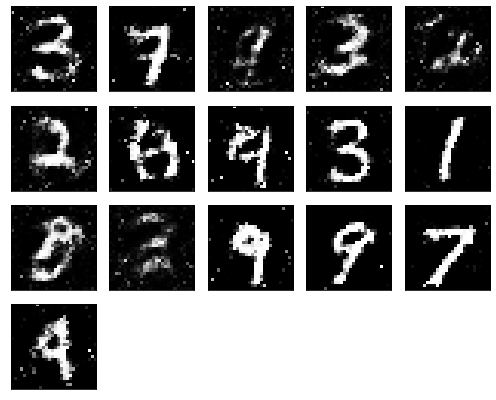

Epochs nb. 8831
discriminator loss: 0.6375782489776611
generator loss : 0.8764694929122925

Epochs nb. 8832
discriminator loss: 0.6381868124008179
generator loss : 0.8887779116630554

Epochs nb. 8833
discriminator loss: 0.626664400100708
generator loss : 0.8848252296447754

Epochs nb. 8834
discriminator loss: 0.6070821285247803
generator loss : 0.962740957736969

Epochs nb. 8835
discriminator loss: 0.8315910696983337
generator loss : 1.143534779548645

Epochs nb. 8836
discriminator loss: 0.551389217376709
generator loss : 1.0148133039474487

Epochs nb. 8837
discriminator loss: 0.4894406795501709
generator loss : 1.1486637592315674

Epochs nb. 8838
discriminator loss: 0.569135844707489
generator loss : 1.101433277130127

Epochs nb. 8839
discriminator loss: 0.616934597492218
generator loss : 0.9523844122886658

Epochs nb. 8840
discriminator loss: 0.6079394817352295
generator loss : 0.9562082290649414



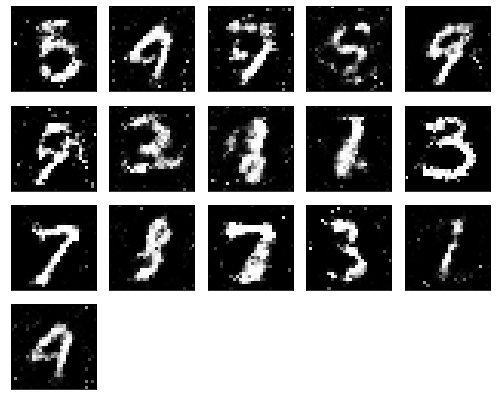

Epochs nb. 8841
discriminator loss: 0.5918862223625183
generator loss : 0.989520788192749

Epochs nb. 8842
discriminator loss: 0.6361867189407349
generator loss : 1.027345895767212

Epochs nb. 8843
discriminator loss: 0.6690117120742798
generator loss : 1.0375797748565674

Epochs nb. 8844
discriminator loss: 0.5559920072555542
generator loss : 0.9921407103538513

Epochs nb. 8845
discriminator loss: 0.7789804935455322
generator loss : 0.9870415925979614

Epochs nb. 8846
discriminator loss: 0.6746940016746521
generator loss : 1.0814127922058105

Epochs nb. 8847
discriminator loss: 0.6345547437667847
generator loss : 1.3028939962387085

Epochs nb. 8848
discriminator loss: 0.6170085668563843
generator loss : 1.1415090560913086

Epochs nb. 8849
discriminator loss: 0.5987585783004761
generator loss : 1.0926239490509033

Epochs nb. 8850
discriminator loss: 0.6396212577819824
generator loss : 0.897864580154419



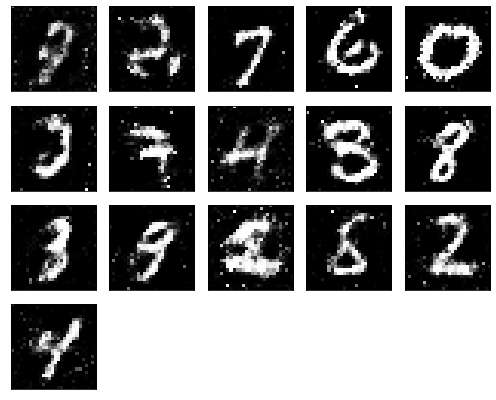

Epochs nb. 8851
discriminator loss: 0.6166341304779053
generator loss : 1.0106240510940552

Epochs nb. 8852
discriminator loss: 0.664985716342926
generator loss : 1.073483943939209

Epochs nb. 8853
discriminator loss: 0.6913259029388428
generator loss : 1.0702875852584839

Epochs nb. 8854
discriminator loss: 0.5379377603530884
generator loss : 1.212134838104248

Epochs nb. 8855
discriminator loss: 0.5783485770225525
generator loss : 1.03638756275177

Epochs nb. 8856
discriminator loss: 0.6032713651657104
generator loss : 1.1138653755187988

Epochs nb. 8857
discriminator loss: 0.5557228326797485
generator loss : 0.8813279867172241

Epochs nb. 8858
discriminator loss: 0.6054114103317261
generator loss : 0.9942911863327026

Epochs nb. 8859
discriminator loss: 0.5631672739982605
generator loss : 0.9847321510314941

Epochs nb. 8860
discriminator loss: 0.6134023666381836
generator loss : 1.0175617933273315



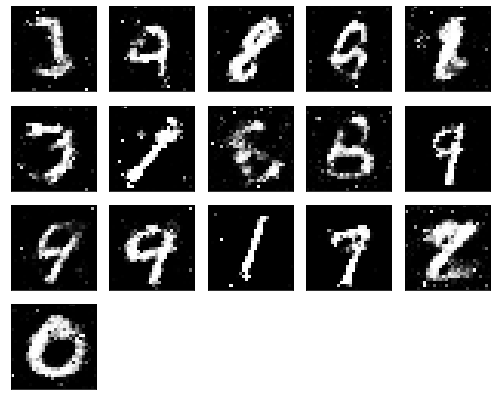

Epochs nb. 8861
discriminator loss: 0.5599576234817505
generator loss : 0.9291967749595642

Epochs nb. 8862
discriminator loss: 0.6444952487945557
generator loss : 1.0881943702697754

Epochs nb. 8863
discriminator loss: 0.5791822671890259
generator loss : 1.1874895095825195

Epochs nb. 8864
discriminator loss: 0.715095043182373
generator loss : 0.867812991142273

Epochs nb. 8865
discriminator loss: 0.5745900273323059
generator loss : 0.8649880886077881

Epochs nb. 8866
discriminator loss: 0.6129811406135559
generator loss : 0.7726229429244995

Epochs nb. 8867
discriminator loss: 0.4973702132701874
generator loss : 0.8853251338005066

Epochs nb. 8868
discriminator loss: 0.55434250831604
generator loss : 0.8794068098068237

Epochs nb. 8869
discriminator loss: 0.4380326271057129
generator loss : 1.138738989830017

Epochs nb. 8870
discriminator loss: 0.7167246341705322
generator loss : 1.0456990003585815



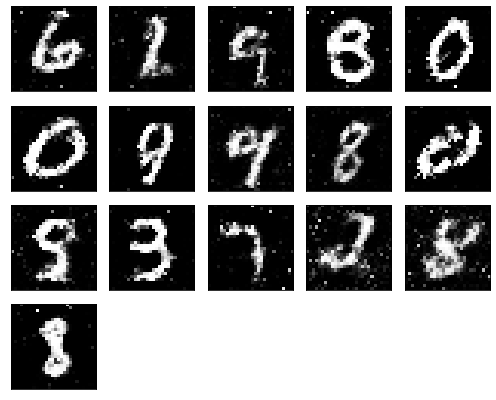

Epochs nb. 8871
discriminator loss: 0.667486846446991
generator loss : 0.8141357898712158

Epochs nb. 8872
discriminator loss: 0.5164906978607178
generator loss : 0.966086745262146

Epochs nb. 8873
discriminator loss: 0.6918278336524963
generator loss : 0.9551291465759277

Epochs nb. 8874
discriminator loss: 0.5481671094894409
generator loss : 0.8833730816841125

Epochs nb. 8875
discriminator loss: 0.6292842030525208
generator loss : 1.1017742156982422

Epochs nb. 8876
discriminator loss: 0.6027392745018005
generator loss : 1.0009664297103882

Epochs nb. 8877
discriminator loss: 0.6595892906188965
generator loss : 1.0349833965301514

Epochs nb. 8878
discriminator loss: 0.6417529582977295
generator loss : 1.007999300956726

Epochs nb. 8879
discriminator loss: 0.5327363610267639
generator loss : 0.831994354724884

Epochs nb. 8880
discriminator loss: 0.7021682262420654
generator loss : 0.9458131790161133



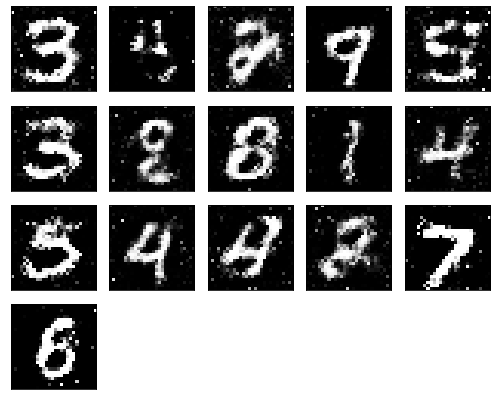

Epochs nb. 8881
discriminator loss: 0.5732861757278442
generator loss : 0.9524715542793274

Epochs nb. 8882
discriminator loss: 0.5698530673980713
generator loss : 0.9646997451782227

Epochs nb. 8883
discriminator loss: 0.5586122870445251
generator loss : 0.8864359259605408

Epochs nb. 8884
discriminator loss: 0.5564358234405518
generator loss : 1.0671420097351074

Epochs nb. 8885
discriminator loss: 0.5852518677711487
generator loss : 1.3055269718170166

Epochs nb. 8886
discriminator loss: 0.5786064863204956
generator loss : 1.0343198776245117

Epochs nb. 8887
discriminator loss: 0.49317026138305664
generator loss : 1.3498247861862183

Epochs nb. 8888
discriminator loss: 0.5185137987136841
generator loss : 1.1957180500030518

Epochs nb. 8889
discriminator loss: 0.7271798253059387
generator loss : 0.9422368407249451

Epochs nb. 8890
discriminator loss: 0.5731979608535767
generator loss : 1.0881106853485107



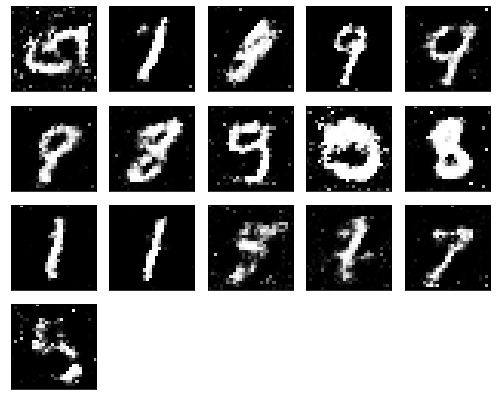

Epochs nb. 8891
discriminator loss: 0.5618881583213806
generator loss : 0.9663931727409363

Epochs nb. 8892
discriminator loss: 0.5545158386230469
generator loss : 0.9321190714836121

Epochs nb. 8893
discriminator loss: 0.5402342081069946
generator loss : 0.9918344020843506

Epochs nb. 8894
discriminator loss: 0.5232532024383545
generator loss : 1.1828031539916992

Epochs nb. 8895
discriminator loss: 0.6520986557006836
generator loss : 1.185018539428711

Epochs nb. 8896
discriminator loss: 0.7035329341888428
generator loss : 0.8336749076843262

Epochs nb. 8897
discriminator loss: 0.4933011531829834
generator loss : 1.0887515544891357

Epochs nb. 8898
discriminator loss: 0.618488073348999
generator loss : 1.0647714138031006

Epochs nb. 8899
discriminator loss: 0.5099921226501465
generator loss : 0.9762769937515259

Epochs nb. 8900
discriminator loss: 0.5993791222572327
generator loss : 1.0198729038238525



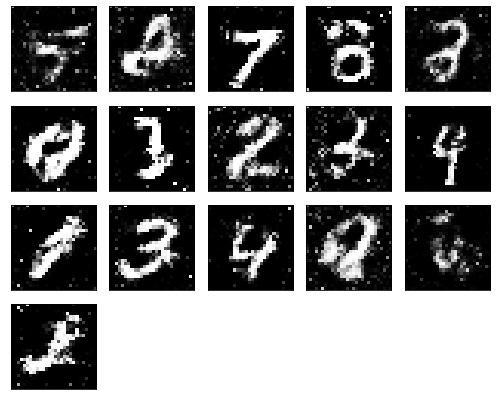

Epochs nb. 8901
discriminator loss: 0.6091611385345459
generator loss : 1.1957640647888184

Epochs nb. 8902
discriminator loss: 0.586161732673645
generator loss : 0.9949923157691956

Epochs nb. 8903
discriminator loss: 0.5863993167877197
generator loss : 0.9300632476806641

Epochs nb. 8904
discriminator loss: 0.5253863334655762
generator loss : 0.8632410764694214

Epochs nb. 8905
discriminator loss: 0.5821482539176941
generator loss : 0.9919204115867615

Epochs nb. 8906
discriminator loss: 0.6419497132301331
generator loss : 1.0609169006347656

Epochs nb. 8907
discriminator loss: 0.5465062260627747
generator loss : 0.9903621673583984

Epochs nb. 8908
discriminator loss: 0.7580164074897766
generator loss : 1.0960524082183838

Epochs nb. 8909
discriminator loss: 0.7061660289764404
generator loss : 1.0570632219314575

Epochs nb. 8910
discriminator loss: 0.6329343318939209
generator loss : 1.0395176410675049



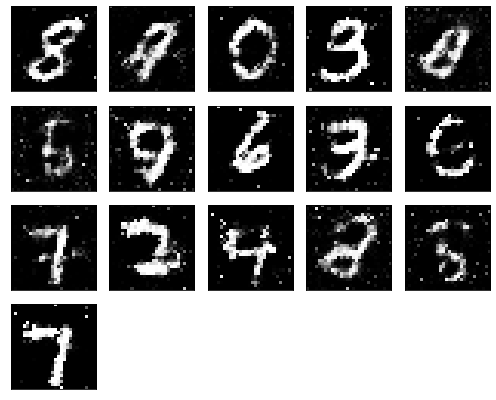

Epochs nb. 8911
discriminator loss: 0.7623037099838257
generator loss : 0.8814938068389893

Epochs nb. 8912
discriminator loss: 0.7331563234329224
generator loss : 1.0436933040618896

Epochs nb. 8913
discriminator loss: 0.6483593583106995
generator loss : 0.9983329772949219

Epochs nb. 8914
discriminator loss: 0.48632651567459106
generator loss : 0.8907312154769897

Epochs nb. 8915
discriminator loss: 0.6373181939125061
generator loss : 1.0424413681030273

Epochs nb. 8916
discriminator loss: 0.5881547927856445
generator loss : 1.0053681135177612

Epochs nb. 8917
discriminator loss: 0.7452282905578613
generator loss : 0.8687248229980469

Epochs nb. 8918
discriminator loss: 0.6407639384269714
generator loss : 0.7773332595825195

Epochs nb. 8919
discriminator loss: 0.5700490474700928
generator loss : 0.9936233758926392

Epochs nb. 8920
discriminator loss: 0.7031110525131226
generator loss : 1.2318894863128662



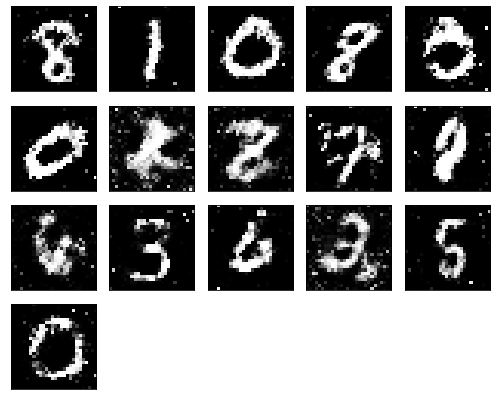

Epochs nb. 8921
discriminator loss: 0.5233225226402283
generator loss : 1.0398375988006592

Epochs nb. 8922
discriminator loss: 0.6871691942214966
generator loss : 0.9724134206771851

Epochs nb. 8923
discriminator loss: 0.6120216250419617
generator loss : 0.8721269965171814

Epochs nb. 8924
discriminator loss: 0.5319209098815918
generator loss : 0.8482142090797424

Epochs nb. 8925
discriminator loss: 0.6830959916114807
generator loss : 1.053713083267212

Epochs nb. 8926
discriminator loss: 0.7441917061805725
generator loss : 1.0385375022888184

Epochs nb. 8927
discriminator loss: 0.5711444616317749
generator loss : 0.9835565090179443

Epochs nb. 8928
discriminator loss: 0.6486409902572632
generator loss : 0.9798247218132019

Epochs nb. 8929
discriminator loss: 0.5104085803031921
generator loss : 0.8714643716812134

Epochs nb. 8930
discriminator loss: 0.5786030292510986
generator loss : 1.0865458250045776



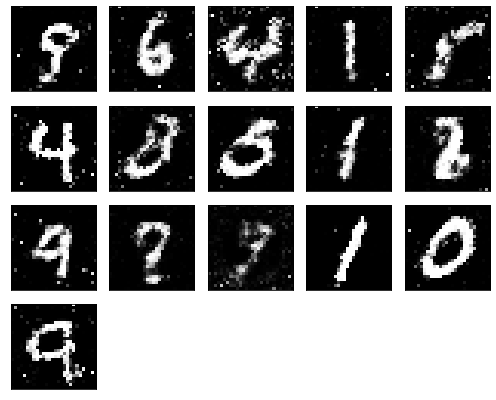

Epochs nb. 8931
discriminator loss: 0.5508801341056824
generator loss : 0.8142764568328857

Epochs nb. 8932
discriminator loss: 0.7526400685310364
generator loss : 0.991257905960083

Epochs nb. 8933
discriminator loss: 0.7197415828704834
generator loss : 0.9636327624320984

Epochs nb. 8934
discriminator loss: 0.5383445620536804
generator loss : 0.9846020936965942

Epochs nb. 8935
discriminator loss: 0.5906999707221985
generator loss : 1.057803988456726

Epochs nb. 8936
discriminator loss: 0.5597482323646545
generator loss : 1.0421947240829468

Epochs nb. 8937
discriminator loss: 0.5103168487548828
generator loss : 1.0969586372375488

Epochs nb. 8938
discriminator loss: 0.5071592330932617
generator loss : 1.183821678161621

Epochs nb. 8939
discriminator loss: 0.4745607078075409
generator loss : 0.9118500351905823

Epochs nb. 8940
discriminator loss: 0.5563704967498779
generator loss : 1.112278938293457



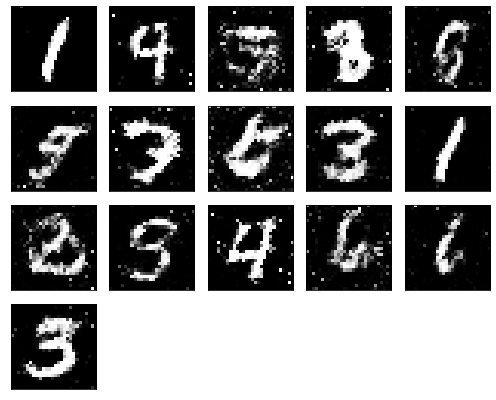

Epochs nb. 8941
discriminator loss: 0.6104666590690613
generator loss : 0.9856574535369873

Epochs nb. 8942
discriminator loss: 0.571802020072937
generator loss : 0.988957405090332

Epochs nb. 8943
discriminator loss: 0.5030551552772522
generator loss : 1.0414484739303589

Epochs nb. 8944
discriminator loss: 0.6088336706161499
generator loss : 0.9313303232192993

Epochs nb. 8945
discriminator loss: 0.702409565448761
generator loss : 0.9081484079360962

Epochs nb. 8946
discriminator loss: 0.6404571533203125
generator loss : 1.1723681688308716

Epochs nb. 8947
discriminator loss: 0.5495349764823914
generator loss : 0.9670817852020264

Epochs nb. 8948
discriminator loss: 0.5924433469772339
generator loss : 1.0192792415618896

Epochs nb. 8949
discriminator loss: 0.6597984433174133
generator loss : 0.9708993434906006

Epochs nb. 8950
discriminator loss: 0.8069784641265869
generator loss : 0.8426797389984131



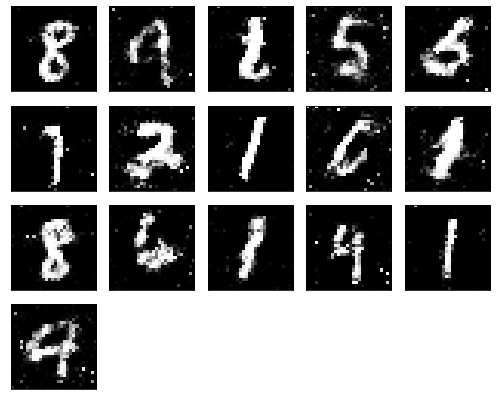

Epochs nb. 8951
discriminator loss: 0.552438497543335
generator loss : 0.9542850852012634

Epochs nb. 8952
discriminator loss: 0.6303770542144775
generator loss : 0.8705025911331177

Epochs nb. 8953
discriminator loss: 0.5553348064422607
generator loss : 1.039442539215088

Epochs nb. 8954
discriminator loss: 0.4547072649002075
generator loss : 1.00948166847229

Epochs nb. 8955
discriminator loss: 0.4280935227870941
generator loss : 1.149199366569519

Epochs nb. 8956
discriminator loss: 0.5565358400344849
generator loss : 1.0738939046859741

Epochs nb. 8957
discriminator loss: 0.6068203449249268
generator loss : 0.9254635572433472

Epochs nb. 8958
discriminator loss: 0.542214572429657
generator loss : 1.0674799680709839

Epochs nb. 8959
discriminator loss: 0.5656660795211792
generator loss : 1.2832385301589966

Epochs nb. 8960
discriminator loss: 0.6105844378471375
generator loss : 1.0965962409973145



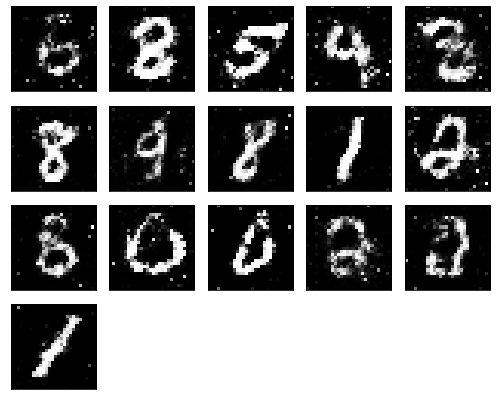

Epochs nb. 8961
discriminator loss: 0.7327671051025391
generator loss : 0.9792889356613159

Epochs nb. 8962
discriminator loss: 0.6449497938156128
generator loss : 1.0304585695266724

Epochs nb. 8963
discriminator loss: 0.5508595108985901
generator loss : 0.9685701727867126

Epochs nb. 8964
discriminator loss: 0.4907662868499756
generator loss : 0.9457070827484131

Epochs nb. 8965
discriminator loss: 0.6007920503616333
generator loss : 1.0919907093048096

Epochs nb. 8966
discriminator loss: 0.6380845308303833
generator loss : 0.9819281101226807

Epochs nb. 8967
discriminator loss: 0.583274245262146
generator loss : 0.9867382645606995

Epochs nb. 8968
discriminator loss: 0.6962159872055054
generator loss : 0.8150367736816406

Epochs nb. 8969
discriminator loss: 0.5986855030059814
generator loss : 0.7750210762023926

Epochs nb. 8970
discriminator loss: 0.5738403797149658
generator loss : 1.0766228437423706



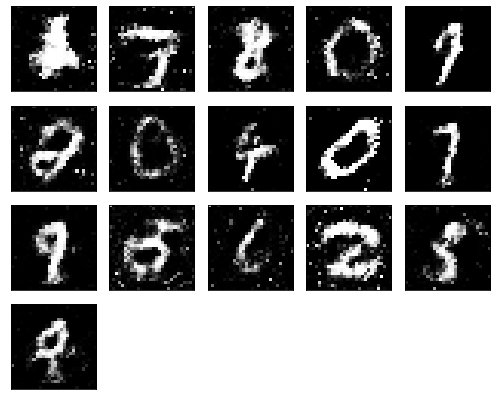

Epochs nb. 8971
discriminator loss: 0.7642455101013184
generator loss : 1.0677968263626099

Epochs nb. 8972
discriminator loss: 0.6314787268638611
generator loss : 0.8966052532196045

Epochs nb. 8973
discriminator loss: 0.7443147897720337
generator loss : 1.0875475406646729

Epochs nb. 8974
discriminator loss: 0.6941081881523132
generator loss : 1.2710168361663818

Epochs nb. 8975
discriminator loss: 0.5698740482330322
generator loss : 1.219260334968567

Epochs nb. 8976
discriminator loss: 0.6418785452842712
generator loss : 1.1113202571868896

Epochs nb. 8977
discriminator loss: 0.5942041873931885
generator loss : 1.0658214092254639

Epochs nb. 8978
discriminator loss: 0.6197901964187622
generator loss : 0.9054239392280579

Epochs nb. 8979
discriminator loss: 0.5690116882324219
generator loss : 1.1375470161437988

Epochs nb. 8980
discriminator loss: 0.5673263669013977
generator loss : 0.8627163171768188



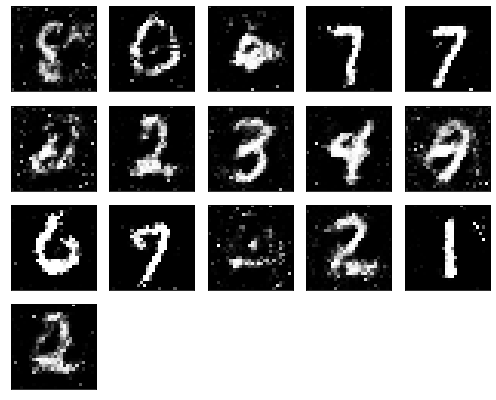

Epochs nb. 8981
discriminator loss: 0.5820796489715576
generator loss : 1.0715551376342773

Epochs nb. 8982
discriminator loss: 0.6354867815971375
generator loss : 0.8625184893608093

Epochs nb. 8983
discriminator loss: 0.494415283203125
generator loss : 1.164386510848999

Epochs nb. 8984
discriminator loss: 0.6777610778808594
generator loss : 0.880113959312439

Epochs nb. 8985
discriminator loss: 0.49022549390792847
generator loss : 0.9798775911331177

Epochs nb. 8986
discriminator loss: 0.6908873319625854
generator loss : 1.103172779083252

Epochs nb. 8987
discriminator loss: 0.5677576065063477
generator loss : 0.9262932538986206

Epochs nb. 8988
discriminator loss: 0.566180408000946
generator loss : 0.9558053016662598

Epochs nb. 8989
discriminator loss: 0.6759718656539917
generator loss : 1.2718671560287476

Epochs nb. 8990
discriminator loss: 0.688251256942749
generator loss : 1.0892239809036255



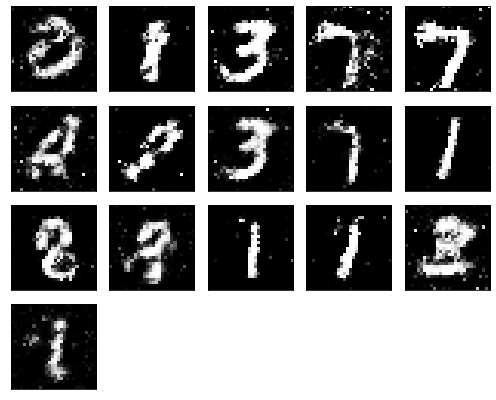

Epochs nb. 8991
discriminator loss: 0.6118203401565552
generator loss : 0.9796592593193054

Epochs nb. 8992
discriminator loss: 0.5100592374801636
generator loss : 0.9542542099952698

Epochs nb. 8993
discriminator loss: 0.49950331449508667
generator loss : 1.0502440929412842

Epochs nb. 8994
discriminator loss: 0.432004451751709
generator loss : 0.935447096824646

Epochs nb. 8995
discriminator loss: 0.6936953663825989
generator loss : 0.9620854258537292

Epochs nb. 8996
discriminator loss: 0.6833223104476929
generator loss : 0.9199343919754028

Epochs nb. 8997
discriminator loss: 0.561732828617096
generator loss : 1.0057411193847656

Epochs nb. 8998
discriminator loss: 0.8327468633651733
generator loss : 1.3702712059020996

Epochs nb. 8999
discriminator loss: 0.6935251951217651
generator loss : 1.0374715328216553

Epochs nb. 9000
discriminator loss: 0.4633951187133789
generator loss : 1.1845847368240356



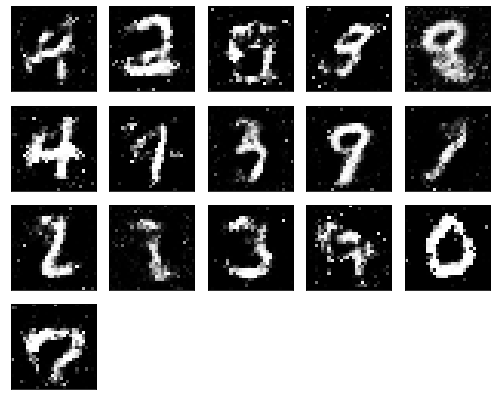

Epochs nb. 9001
discriminator loss: 0.5498589277267456
generator loss : 1.1124180555343628

Epochs nb. 9002
discriminator loss: 0.44112616777420044
generator loss : 1.0412994623184204

Epochs nb. 9003
discriminator loss: 0.6049412488937378
generator loss : 0.9215830564498901

Epochs nb. 9004
discriminator loss: 0.630591630935669
generator loss : 1.2407853603363037

Epochs nb. 9005
discriminator loss: 0.611027181148529
generator loss : 1.0135612487792969

Epochs nb. 9006
discriminator loss: 0.5769636631011963
generator loss : 1.0769857168197632

Epochs nb. 9007
discriminator loss: 0.5504438877105713
generator loss : 0.9407167434692383

Epochs nb. 9008
discriminator loss: 0.4808819890022278
generator loss : 0.9302367568016052

Epochs nb. 9009
discriminator loss: 0.539106547832489
generator loss : 0.9704191088676453

Epochs nb. 9010
discriminator loss: 0.7047487497329712
generator loss : 0.8737369179725647



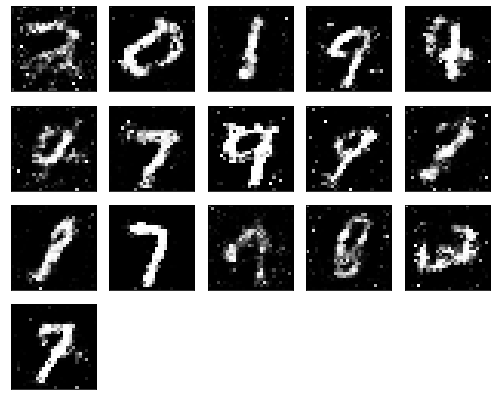

Epochs nb. 9011
discriminator loss: 0.5847801566123962
generator loss : 0.9727085828781128

Epochs nb. 9012
discriminator loss: 0.585466206073761
generator loss : 0.8838961720466614

Epochs nb. 9013
discriminator loss: 0.652589738368988
generator loss : 1.0229945182800293

Epochs nb. 9014
discriminator loss: 0.5977705717086792
generator loss : 1.1478155851364136

Epochs nb. 9015
discriminator loss: 0.7472335696220398
generator loss : 1.338817834854126

Epochs nb. 9016
discriminator loss: 0.5337284803390503
generator loss : 1.0527302026748657

Epochs nb. 9017
discriminator loss: 0.5127780437469482
generator loss : 1.2533981800079346

Epochs nb. 9018
discriminator loss: 0.6773110032081604
generator loss : 1.0733603239059448

Epochs nb. 9019
discriminator loss: 0.7256773710250854
generator loss : 0.8871378898620605

Epochs nb. 9020
discriminator loss: 0.6720167398452759
generator loss : 0.9285388588905334



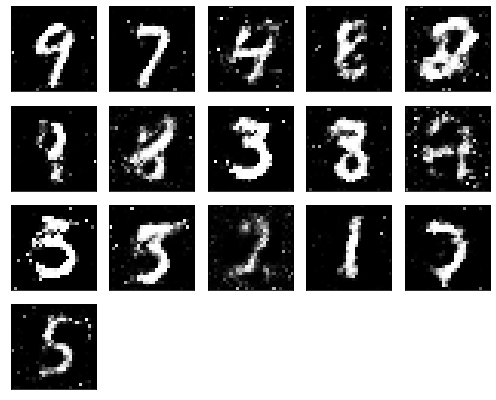

Epochs nb. 9021
discriminator loss: 0.5825543403625488
generator loss : 0.9370973706245422

Epochs nb. 9022
discriminator loss: 0.6473524570465088
generator loss : 0.8145784139633179

Epochs nb. 9023
discriminator loss: 0.7122287750244141
generator loss : 1.2224383354187012

Epochs nb. 9024
discriminator loss: 0.6829336285591125
generator loss : 0.9075340032577515

Epochs nb. 9025
discriminator loss: 0.5712980628013611
generator loss : 0.9227730631828308

Epochs nb. 9026
discriminator loss: 0.5357468724250793
generator loss : 0.8458250164985657

Epochs nb. 9027
discriminator loss: 0.48683613538742065
generator loss : 0.7485712170600891

Epochs nb. 9028
discriminator loss: 0.552348256111145
generator loss : 0.9995447397232056

Epochs nb. 9029
discriminator loss: 0.6806355118751526
generator loss : 1.160013198852539

Epochs nb. 9030
discriminator loss: 0.7666267156600952
generator loss : 1.1828327178955078



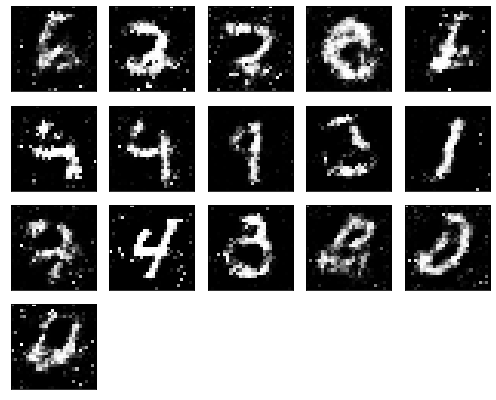

Epochs nb. 9031
discriminator loss: 0.6510442495346069
generator loss : 1.1517258882522583

Epochs nb. 9032
discriminator loss: 0.5616102814674377
generator loss : 1.0703473091125488

Epochs nb. 9033
discriminator loss: 0.6178429126739502
generator loss : 0.9168087244033813

Epochs nb. 9034
discriminator loss: 0.5346601009368896
generator loss : 0.8355765342712402

Epochs nb. 9035
discriminator loss: 0.5741291046142578
generator loss : 0.910481333732605

Epochs nb. 9036
discriminator loss: 0.5287418365478516
generator loss : 0.8942998647689819

Epochs nb. 9037
discriminator loss: 0.5317498445510864
generator loss : 1.1765410900115967

Epochs nb. 9038
discriminator loss: 0.5092272162437439
generator loss : 1.1616432666778564

Epochs nb. 9039
discriminator loss: 0.6006351113319397
generator loss : 1.0842232704162598

Epochs nb. 9040
discriminator loss: 0.6461769342422485
generator loss : 1.064102292060852



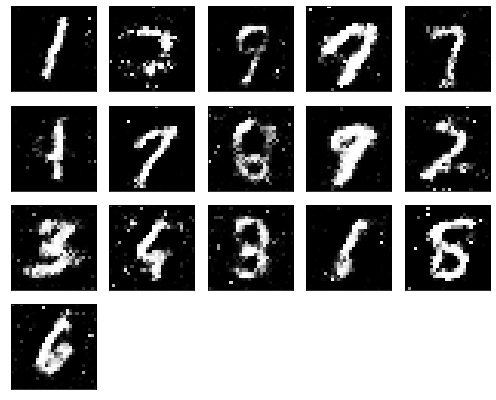

Epochs nb. 9041
discriminator loss: 0.6012945771217346
generator loss : 1.032921552658081

Epochs nb. 9042
discriminator loss: 0.6172125339508057
generator loss : 0.9703243970870972

Epochs nb. 9043
discriminator loss: 0.656477153301239
generator loss : 1.1786444187164307

Epochs nb. 9044
discriminator loss: 0.5704612731933594
generator loss : 1.1675546169281006

Epochs nb. 9045
discriminator loss: 0.5374379754066467
generator loss : 0.9413071274757385

Epochs nb. 9046
discriminator loss: 0.6250466108322144
generator loss : 1.1000546216964722

Epochs nb. 9047
discriminator loss: 0.5491332411766052
generator loss : 0.9905636310577393

Epochs nb. 9048
discriminator loss: 0.5579782128334045
generator loss : 1.1268154382705688

Epochs nb. 9049
discriminator loss: 0.5622440576553345
generator loss : 0.9482691287994385

Epochs nb. 9050
discriminator loss: 0.60817551612854
generator loss : 1.0174990892410278



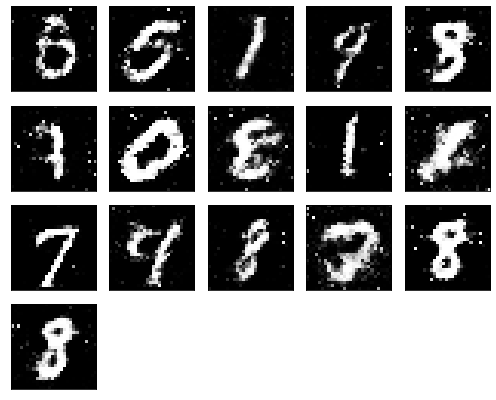

Epochs nb. 9051
discriminator loss: 0.6451696753501892
generator loss : 0.9088314771652222

Epochs nb. 9052
discriminator loss: 0.4952969551086426
generator loss : 1.104579210281372

Epochs nb. 9053
discriminator loss: 0.496292382478714
generator loss : 1.0084491968154907

Epochs nb. 9054
discriminator loss: 0.6309157609939575
generator loss : 1.1184518337249756

Epochs nb. 9055
discriminator loss: 0.6187659502029419
generator loss : 0.9887453317642212

Epochs nb. 9056
discriminator loss: 0.4382747709751129
generator loss : 0.9545726776123047

Epochs nb. 9057
discriminator loss: 0.5408099889755249
generator loss : 1.0177417993545532

Epochs nb. 9058
discriminator loss: 0.5618984699249268
generator loss : 0.9761824607849121

Epochs nb. 9059
discriminator loss: 0.7177178859710693
generator loss : 0.8222810626029968

Epochs nb. 9060
discriminator loss: 0.6177506446838379
generator loss : 0.8818368315696716



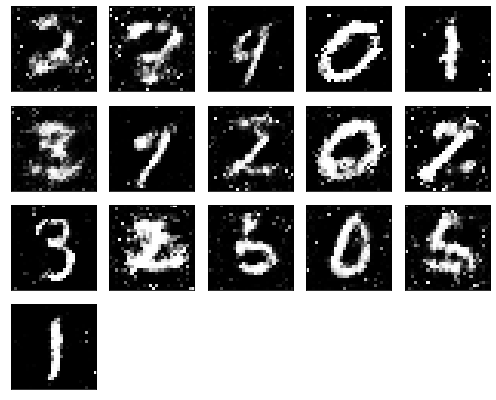

Epochs nb. 9061
discriminator loss: 0.7023981809616089
generator loss : 0.9788590669631958

Epochs nb. 9062
discriminator loss: 0.532916784286499
generator loss : 0.8923815488815308

Epochs nb. 9063
discriminator loss: 0.5226463675498962
generator loss : 1.0866509675979614

Epochs nb. 9064
discriminator loss: 0.792466938495636
generator loss : 1.2005265951156616

Epochs nb. 9065
discriminator loss: 0.5542807579040527
generator loss : 1.2060965299606323

Epochs nb. 9066
discriminator loss: 0.6735395193099976
generator loss : 1.0580906867980957

Epochs nb. 9067
discriminator loss: 0.5107495784759521
generator loss : 0.9588077068328857

Epochs nb. 9068
discriminator loss: 0.6347014904022217
generator loss : 0.7718757390975952

Epochs nb. 9069
discriminator loss: 0.4876381456851959
generator loss : 0.8114643096923828

Epochs nb. 9070
discriminator loss: 0.6538122892379761
generator loss : 0.9321168661117554



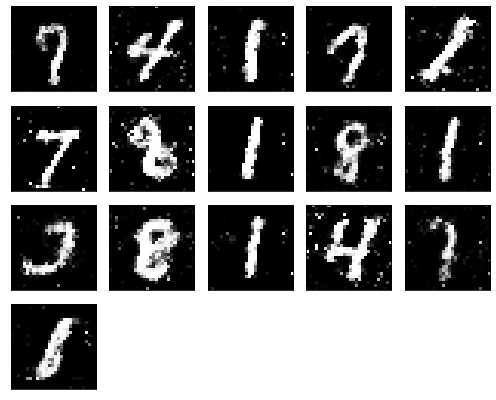

Epochs nb. 9071
discriminator loss: 0.5079259872436523
generator loss : 0.9239286184310913

Epochs nb. 9072
discriminator loss: 0.566507875919342
generator loss : 1.0094786882400513

Epochs nb. 9073
discriminator loss: 0.5938897132873535
generator loss : 1.057706594467163

Epochs nb. 9074
discriminator loss: 0.7295899391174316
generator loss : 1.200609564781189

Epochs nb. 9075
discriminator loss: 0.7102435827255249
generator loss : 1.0380855798721313

Epochs nb. 9076
discriminator loss: 0.6814877986907959
generator loss : 0.9032454490661621

Epochs nb. 9077
discriminator loss: 0.608256459236145
generator loss : 1.0248745679855347

Epochs nb. 9078
discriminator loss: 0.5899240970611572
generator loss : 0.9651494026184082

Epochs nb. 9079
discriminator loss: 0.6210278272628784
generator loss : 1.0990445613861084

Epochs nb. 9080
discriminator loss: 0.5798219442367554
generator loss : 1.0687341690063477



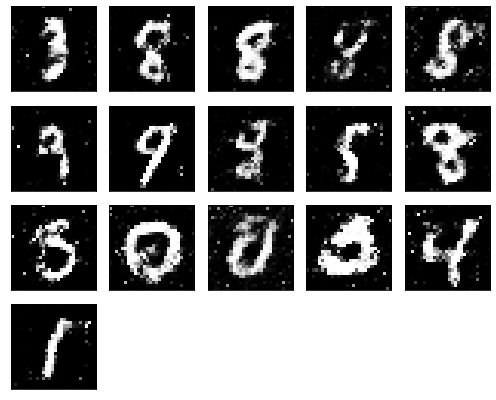

Epochs nb. 9081
discriminator loss: 0.5186617374420166
generator loss : 1.0411946773529053

Epochs nb. 9082
discriminator loss: 0.5398209095001221
generator loss : 0.9374392032623291

Epochs nb. 9083
discriminator loss: 0.5635351538658142
generator loss : 1.0189934968948364

Epochs nb. 9084
discriminator loss: 0.7219340801239014
generator loss : 1.0773930549621582

Epochs nb. 9085
discriminator loss: 0.5130466222763062
generator loss : 1.0624134540557861

Epochs nb. 9086
discriminator loss: 0.6186063885688782
generator loss : 1.013845443725586

Epochs nb. 9087
discriminator loss: 0.4860456585884094
generator loss : 1.2907485961914062

Epochs nb. 9088
discriminator loss: 0.6927227973937988
generator loss : 1.0965209007263184

Epochs nb. 9089
discriminator loss: 0.5637134313583374
generator loss : 1.2874066829681396

Epochs nb. 9090
discriminator loss: 0.5122473239898682
generator loss : 1.0782971382141113



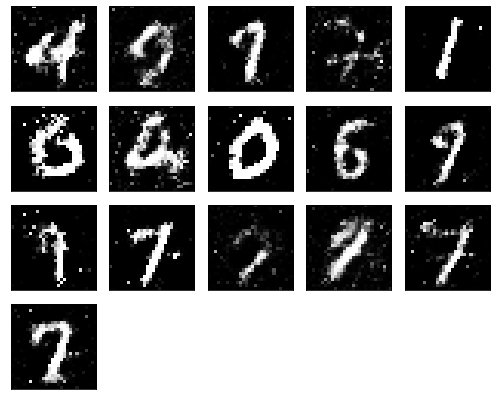

Epochs nb. 9091
discriminator loss: 0.6253789663314819
generator loss : 1.096980094909668

Epochs nb. 9092
discriminator loss: 0.5917248725891113
generator loss : 1.2831542491912842

Epochs nb. 9093
discriminator loss: 0.8051967620849609
generator loss : 1.092761754989624

Epochs nb. 9094
discriminator loss: 0.5618678331375122
generator loss : 1.1074267625808716

Epochs nb. 9095
discriminator loss: 0.5964341163635254
generator loss : 1.1297664642333984

Epochs nb. 9096
discriminator loss: 0.6144241094589233
generator loss : 1.0867434740066528

Epochs nb. 9097
discriminator loss: 0.4592054784297943
generator loss : 1.1245903968811035

Epochs nb. 9098
discriminator loss: 0.6335666179656982
generator loss : 1.0290002822875977

Epochs nb. 9099
discriminator loss: 0.599404513835907
generator loss : 0.9608124494552612

Epochs nb. 9100
discriminator loss: 0.6808422803878784
generator loss : 1.1038174629211426



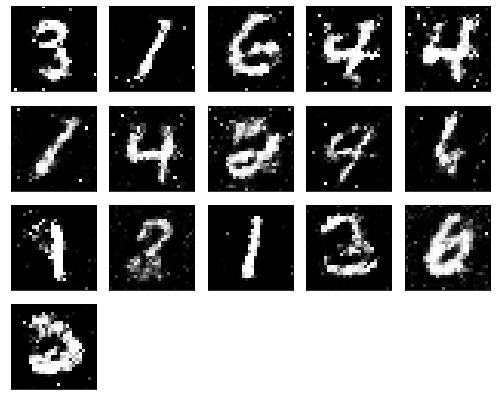

Epochs nb. 9101
discriminator loss: 0.6722727417945862
generator loss : 1.1044971942901611

Epochs nb. 9102
discriminator loss: 0.6375483274459839
generator loss : 0.966475784778595

Epochs nb. 9103
discriminator loss: 0.6141219139099121
generator loss : 0.8344597816467285

Epochs nb. 9104
discriminator loss: 0.5654133558273315
generator loss : 0.9043869376182556

Epochs nb. 9105
discriminator loss: 0.606200098991394
generator loss : 1.0916249752044678

Epochs nb. 9106
discriminator loss: 0.5941784381866455
generator loss : 0.8055237531661987

Epochs nb. 9107
discriminator loss: 0.5727517604827881
generator loss : 0.9046600461006165

Epochs nb. 9108
discriminator loss: 0.6992742419242859
generator loss : 0.9949279427528381

Epochs nb. 9109
discriminator loss: 0.6477917432785034
generator loss : 1.0140905380249023

Epochs nb. 9110
discriminator loss: 0.6375595331192017
generator loss : 1.1411094665527344



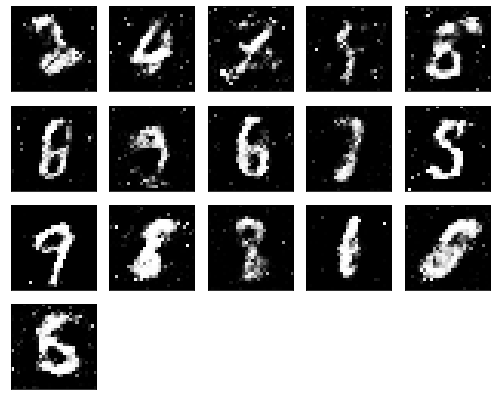

Epochs nb. 9111
discriminator loss: 0.5870863199234009
generator loss : 1.1925058364868164

Epochs nb. 9112
discriminator loss: 0.5579455494880676
generator loss : 1.1040685176849365

Epochs nb. 9113
discriminator loss: 0.6059467196464539
generator loss : 0.9770663976669312

Epochs nb. 9114
discriminator loss: 0.6803613305091858
generator loss : 1.133251428604126

Epochs nb. 9115
discriminator loss: 0.474065899848938
generator loss : 0.9080187678337097

Epochs nb. 9116
discriminator loss: 0.6330810189247131
generator loss : 0.8013638257980347

Epochs nb. 9117
discriminator loss: 0.6397767066955566
generator loss : 1.0978152751922607

Epochs nb. 9118
discriminator loss: 0.674554705619812
generator loss : 0.9507153034210205

Epochs nb. 9119
discriminator loss: 0.6193942427635193
generator loss : 1.1008509397506714

Epochs nb. 9120
discriminator loss: 0.5222573280334473
generator loss : 0.8236820697784424



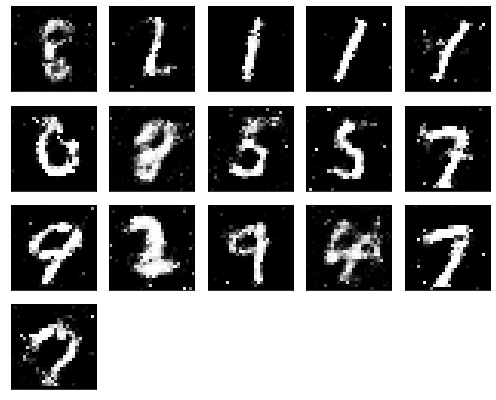

Epochs nb. 9121
discriminator loss: 0.6052210330963135
generator loss : 1.037626028060913

Epochs nb. 9122
discriminator loss: 0.6452865600585938
generator loss : 0.9318031072616577

Epochs nb. 9123
discriminator loss: 0.6468425989151001
generator loss : 1.0688583850860596

Epochs nb. 9124
discriminator loss: 0.6375843286514282
generator loss : 0.9457160234451294

Epochs nb. 9125
discriminator loss: 0.5701830983161926
generator loss : 0.8513760566711426

Epochs nb. 9126
discriminator loss: 0.688484251499176
generator loss : 0.8543380498886108

Epochs nb. 9127
discriminator loss: 0.48670411109924316
generator loss : 0.9048711657524109

Epochs nb. 9128
discriminator loss: 0.7010420560836792
generator loss : 0.7877393960952759

Epochs nb. 9129
discriminator loss: 0.5625695586204529
generator loss : 0.8274214267730713

Epochs nb. 9130
discriminator loss: 0.5784586071968079
generator loss : 0.900833010673523



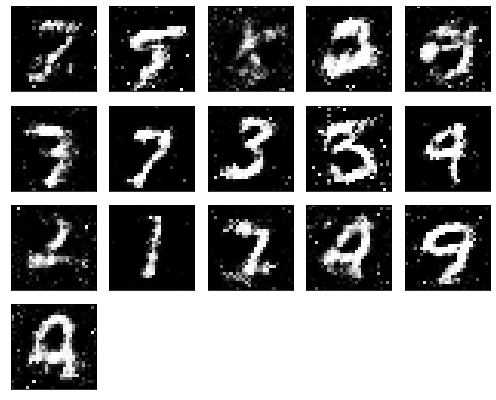

Epochs nb. 9131
discriminator loss: 0.643794059753418
generator loss : 0.9713823795318604

Epochs nb. 9132
discriminator loss: 0.5875224471092224
generator loss : 0.993992805480957

Epochs nb. 9133
discriminator loss: 0.6544696092605591
generator loss : 0.901303231716156

Epochs nb. 9134
discriminator loss: 0.6447704434394836
generator loss : 1.1445231437683105

Epochs nb. 9135
discriminator loss: 0.5797716379165649
generator loss : 0.9469286203384399

Epochs nb. 9136
discriminator loss: 0.5578727722167969
generator loss : 0.8812044858932495

Epochs nb. 9137
discriminator loss: 0.6237847805023193
generator loss : 0.9942792057991028

Epochs nb. 9138
discriminator loss: 0.5427875518798828
generator loss : 1.1721596717834473

Epochs nb. 9139
discriminator loss: 0.643747091293335
generator loss : 0.9807409644126892

Epochs nb. 9140
discriminator loss: 0.727387011051178
generator loss : 0.9072732329368591



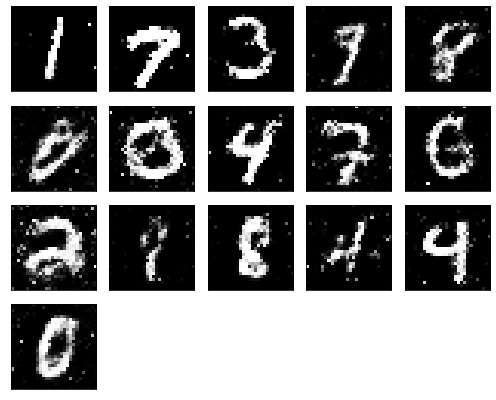

Epochs nb. 9141
discriminator loss: 0.6481619477272034
generator loss : 1.0478429794311523

Epochs nb. 9142
discriminator loss: 0.5286824107170105
generator loss : 0.9517558217048645

Epochs nb. 9143
discriminator loss: 0.5796148777008057
generator loss : 0.9582250118255615

Epochs nb. 9144
discriminator loss: 0.5944715738296509
generator loss : 0.9770713448524475

Epochs nb. 9145
discriminator loss: 0.605832576751709
generator loss : 0.8334654569625854

Epochs nb. 9146
discriminator loss: 0.6637401580810547
generator loss : 0.8663469552993774

Epochs nb. 9147
discriminator loss: 0.5168488025665283
generator loss : 0.8961524963378906

Epochs nb. 9148
discriminator loss: 0.5908176302909851
generator loss : 1.0367341041564941

Epochs nb. 9149
discriminator loss: 0.5982060432434082
generator loss : 0.9420202374458313

Epochs nb. 9150
discriminator loss: 0.6047630310058594
generator loss : 0.8938109874725342



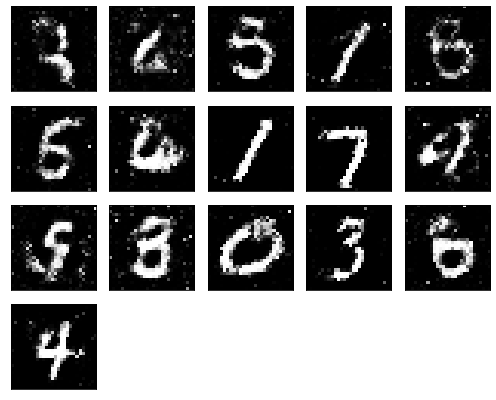

Epochs nb. 9151
discriminator loss: 0.6393969058990479
generator loss : 1.1569762229919434

Epochs nb. 9152
discriminator loss: 0.5160185694694519
generator loss : 1.137437105178833

Epochs nb. 9153
discriminator loss: 0.5837514400482178
generator loss : 1.0753982067108154

Epochs nb. 9154
discriminator loss: 0.5474878549575806
generator loss : 0.9776219129562378

Epochs nb. 9155
discriminator loss: 0.5338045358657837
generator loss : 1.2154757976531982

Epochs nb. 9156
discriminator loss: 0.5358872413635254
generator loss : 0.9569958448410034

Epochs nb. 9157
discriminator loss: 0.49159473180770874
generator loss : 0.8803322911262512

Epochs nb. 9158
discriminator loss: 0.468111515045166
generator loss : 1.1046489477157593

Epochs nb. 9159
discriminator loss: 0.8547686338424683
generator loss : 0.9547150135040283

Epochs nb. 9160
discriminator loss: 0.45685362815856934
generator loss : 0.9370793104171753



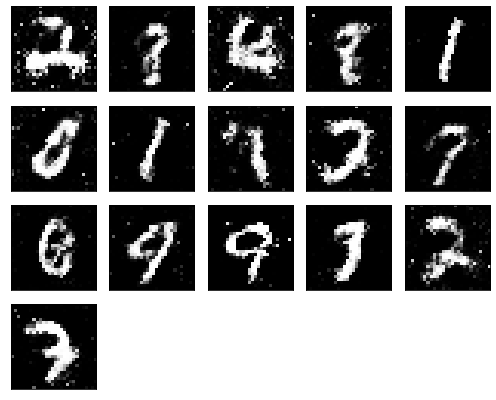

Epochs nb. 9161
discriminator loss: 0.44258660078048706
generator loss : 1.0869414806365967

Epochs nb. 9162
discriminator loss: 0.6382575035095215
generator loss : 0.8963285088539124

Epochs nb. 9163
discriminator loss: 0.7105817794799805
generator loss : 0.8994616270065308

Epochs nb. 9164
discriminator loss: 0.6509755253791809
generator loss : 0.974076509475708

Epochs nb. 9165
discriminator loss: 0.5568701028823853
generator loss : 0.9748461246490479

Epochs nb. 9166
discriminator loss: 0.48776909708976746
generator loss : 0.9670321941375732

Epochs nb. 9167
discriminator loss: 0.5583511590957642
generator loss : 0.8616374731063843

Epochs nb. 9168
discriminator loss: 0.4081955552101135
generator loss : 0.955617368221283

Epochs nb. 9169
discriminator loss: 0.7862045764923096
generator loss : 0.9287772178649902

Epochs nb. 9170
discriminator loss: 0.603493332862854
generator loss : 1.161133050918579



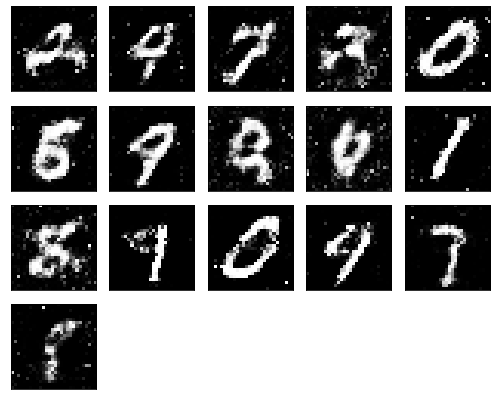

Epochs nb. 9171
discriminator loss: 0.5891284942626953
generator loss : 1.0094573497772217

Epochs nb. 9172
discriminator loss: 0.5317298769950867
generator loss : 0.8651946783065796

Epochs nb. 9173
discriminator loss: 0.49979251623153687
generator loss : 0.8487586379051208

Epochs nb. 9174
discriminator loss: 0.5474263429641724
generator loss : 1.1015625

Epochs nb. 9175
discriminator loss: 0.6228693723678589
generator loss : 0.9387601017951965

Epochs nb. 9176
discriminator loss: 0.6264578700065613
generator loss : 1.0011601448059082

Epochs nb. 9177
discriminator loss: 0.6233149766921997
generator loss : 1.0276384353637695

Epochs nb. 9178
discriminator loss: 0.5472917556762695
generator loss : 0.9348572492599487

Epochs nb. 9179
discriminator loss: 0.5866335034370422
generator loss : 1.0352191925048828

Epochs nb. 9180
discriminator loss: 0.6308269500732422
generator loss : 0.9818122982978821



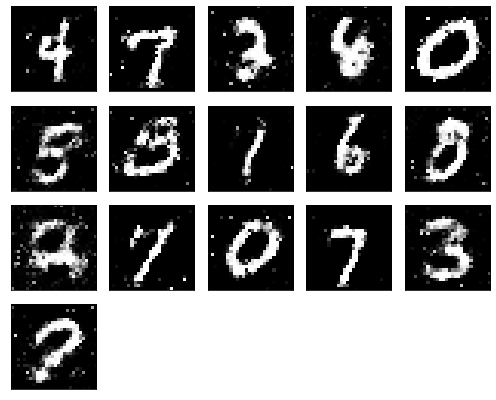

Epochs nb. 9181
discriminator loss: 0.7040495276451111
generator loss : 0.8586441278457642

Epochs nb. 9182
discriminator loss: 0.6510592699050903
generator loss : 0.9911676645278931

Epochs nb. 9183
discriminator loss: 0.6119629144668579
generator loss : 0.9115885496139526

Epochs nb. 9184
discriminator loss: 0.8260512351989746
generator loss : 1.2611626386642456

Epochs nb. 9185
discriminator loss: 0.5243504047393799
generator loss : 1.0052241086959839

Epochs nb. 9186
discriminator loss: 0.5227603912353516
generator loss : 0.9660807847976685

Epochs nb. 9187
discriminator loss: 0.6361864805221558
generator loss : 0.9927613139152527

Epochs nb. 9188
discriminator loss: 0.6160838007926941
generator loss : 1.1134488582611084

Epochs nb. 9189
discriminator loss: 0.7155343890190125
generator loss : 0.94051194190979

Epochs nb. 9190
discriminator loss: 0.6031584739685059
generator loss : 1.0059294700622559



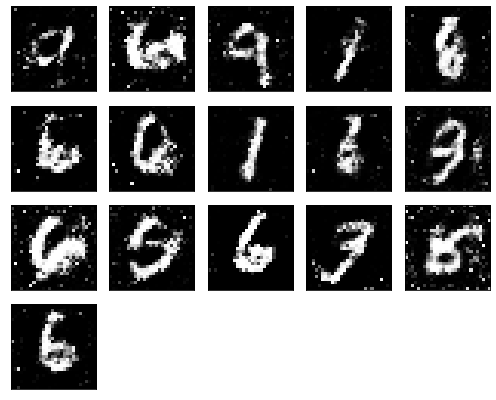

Epochs nb. 9191
discriminator loss: 0.5004299283027649
generator loss : 0.9910119771957397

Epochs nb. 9192
discriminator loss: 0.7355829477310181
generator loss : 1.158166766166687

Epochs nb. 9193
discriminator loss: 0.6760452389717102
generator loss : 0.9584989547729492

Epochs nb. 9194
discriminator loss: 0.5370718240737915
generator loss : 1.225208044052124

Epochs nb. 9195
discriminator loss: 0.5001006722450256
generator loss : 0.9441752433776855

Epochs nb. 9196
discriminator loss: 0.5629953742027283
generator loss : 1.0035382509231567

Epochs nb. 9197
discriminator loss: 0.6786899566650391
generator loss : 0.9694497585296631

Epochs nb. 9198
discriminator loss: 0.514502763748169
generator loss : 1.129591464996338

Epochs nb. 9199
discriminator loss: 0.6652793288230896
generator loss : 1.0606848001480103

Epochs nb. 9200
discriminator loss: 0.5937195420265198
generator loss : 0.9302992224693298



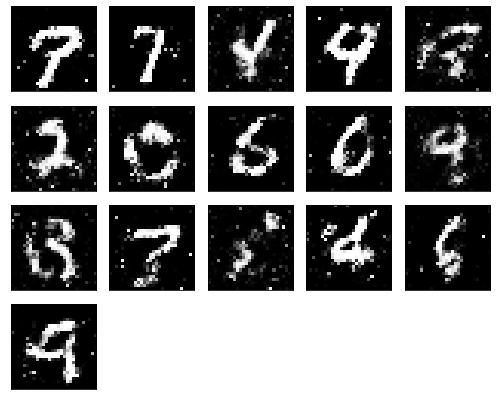

Epochs nb. 9201
discriminator loss: 0.7042047381401062
generator loss : 0.973081111907959

Epochs nb. 9202
discriminator loss: 0.7426067590713501
generator loss : 0.9545173645019531

Epochs nb. 9203
discriminator loss: 0.7388622760772705
generator loss : 0.8400042653083801

Epochs nb. 9204
discriminator loss: 0.4907847046852112
generator loss : 0.9328515529632568

Epochs nb. 9205
discriminator loss: 0.615888774394989
generator loss : 0.9298341274261475

Epochs nb. 9206
discriminator loss: 0.5734351873397827
generator loss : 0.8407777547836304

Epochs nb. 9207
discriminator loss: 0.5823660492897034
generator loss : 0.9897128343582153

Epochs nb. 9208
discriminator loss: 0.6537349224090576
generator loss : 0.9847975969314575

Epochs nb. 9209
discriminator loss: 0.6235417127609253
generator loss : 0.8651496767997742

Epochs nb. 9210
discriminator loss: 0.6089659333229065
generator loss : 0.9774876832962036



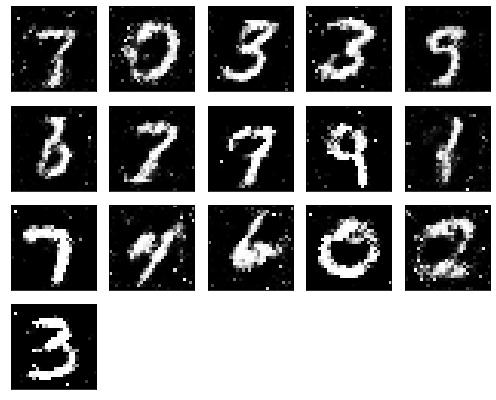

Epochs nb. 9211
discriminator loss: 0.5098819136619568
generator loss : 0.8103550672531128

Epochs nb. 9212
discriminator loss: 0.6436619162559509
generator loss : 0.9569405317306519

Epochs nb. 9213
discriminator loss: 0.5966023206710815
generator loss : 1.1842880249023438

Epochs nb. 9214
discriminator loss: 0.6287828683853149
generator loss : 0.923256516456604

Epochs nb. 9215
discriminator loss: 0.7263467907905579
generator loss : 0.8296040296554565

Epochs nb. 9216
discriminator loss: 0.5783944129943848
generator loss : 1.1042201519012451

Epochs nb. 9217
discriminator loss: 0.5468131303787231
generator loss : 1.134390115737915

Epochs nb. 9218
discriminator loss: 0.6630775332450867
generator loss : 1.0015575885772705

Epochs nb. 9219
discriminator loss: 0.776047945022583
generator loss : 1.2591941356658936

Epochs nb. 9220
discriminator loss: 0.5962890982627869
generator loss : 0.9346381425857544



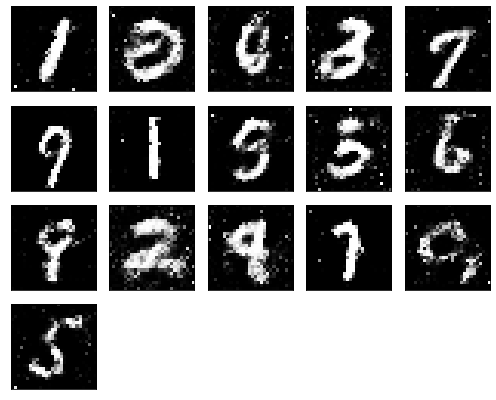

Epochs nb. 9221
discriminator loss: 0.7352895736694336
generator loss : 1.1744000911712646

Epochs nb. 9222
discriminator loss: 0.5587193965911865
generator loss : 1.145554780960083

Epochs nb. 9223
discriminator loss: 0.5013009309768677
generator loss : 0.9512239694595337

Epochs nb. 9224
discriminator loss: 0.6328024864196777
generator loss : 1.0452485084533691

Epochs nb. 9225
discriminator loss: 0.5974506139755249
generator loss : 0.9729447364807129

Epochs nb. 9226
discriminator loss: 0.6262109279632568
generator loss : 0.978866696357727

Epochs nb. 9227
discriminator loss: 0.5028033256530762
generator loss : 1.068682312965393

Epochs nb. 9228
discriminator loss: 0.5555762648582458
generator loss : 1.0380215644836426

Epochs nb. 9229
discriminator loss: 0.6738162040710449
generator loss : 0.9727450609207153

Epochs nb. 9230
discriminator loss: 0.6452536582946777
generator loss : 0.9244127869606018



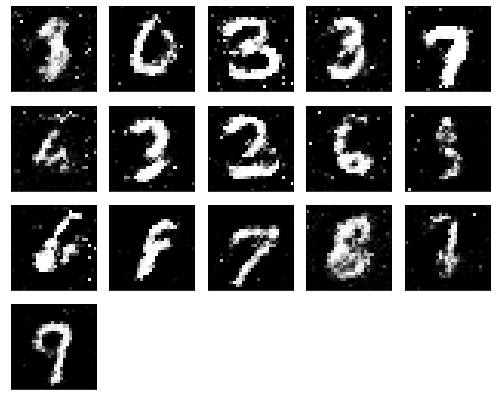

Epochs nb. 9231
discriminator loss: 0.6124239563941956
generator loss : 1.0458190441131592

Epochs nb. 9232
discriminator loss: 0.671429455280304
generator loss : 1.407859206199646

Epochs nb. 9233
discriminator loss: 0.7073589563369751
generator loss : 1.2726163864135742

Epochs nb. 9234
discriminator loss: 0.5512468218803406
generator loss : 1.1441802978515625

Epochs nb. 9235
discriminator loss: 0.5297213792800903
generator loss : 0.9353158473968506

Epochs nb. 9236
discriminator loss: 0.5186758041381836
generator loss : 1.0168927907943726

Epochs nb. 9237
discriminator loss: 0.5043891668319702
generator loss : 1.0840582847595215

Epochs nb. 9238
discriminator loss: 0.6430016756057739
generator loss : 1.2369043827056885

Epochs nb. 9239
discriminator loss: 0.5921230316162109
generator loss : 1.0375351905822754

Epochs nb. 9240
discriminator loss: 0.630985677242279
generator loss : 0.9064561724662781



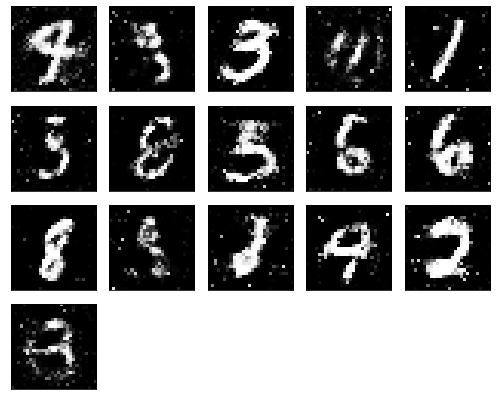

Epochs nb. 9241
discriminator loss: 0.6905542612075806
generator loss : 0.9163066148757935

Epochs nb. 9242
discriminator loss: 0.6084462404251099
generator loss : 1.1207008361816406

Epochs nb. 9243
discriminator loss: 0.6687978506088257
generator loss : 1.1187926530838013

Epochs nb. 9244
discriminator loss: 0.47723475098609924
generator loss : 1.1117024421691895

Epochs nb. 9245
discriminator loss: 0.5894173979759216
generator loss : 1.1717793941497803

Epochs nb. 9246
discriminator loss: 0.556260883808136
generator loss : 1.153285026550293

Epochs nb. 9247
discriminator loss: 0.5742099285125732
generator loss : 1.0759508609771729

Epochs nb. 9248
discriminator loss: 0.6277607679367065
generator loss : 1.034121036529541

Epochs nb. 9249
discriminator loss: 0.5592383146286011
generator loss : 1.0576164722442627

Epochs nb. 9250
discriminator loss: 0.6318153142929077
generator loss : 1.0667444467544556



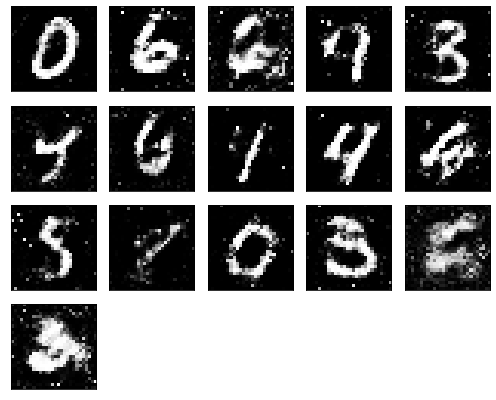

Epochs nb. 9251
discriminator loss: 0.5177825093269348
generator loss : 1.0480320453643799

Epochs nb. 9252
discriminator loss: 0.6524204611778259
generator loss : 1.1686604022979736

Epochs nb. 9253
discriminator loss: 0.6656395196914673
generator loss : 1.0718129873275757

Epochs nb. 9254
discriminator loss: 0.5133453607559204
generator loss : 1.0112528800964355

Epochs nb. 9255
discriminator loss: 0.7880527973175049
generator loss : 0.9463741779327393

Epochs nb. 9256
discriminator loss: 0.5846768617630005
generator loss : 1.0762969255447388

Epochs nb. 9257
discriminator loss: 0.689847469329834
generator loss : 0.9186364412307739

Epochs nb. 9258
discriminator loss: 0.5801624059677124
generator loss : 0.7915210127830505

Epochs nb. 9259
discriminator loss: 0.5149023532867432
generator loss : 0.8981380462646484

Epochs nb. 9260
discriminator loss: 0.49605196714401245
generator loss : 1.0466612577438354



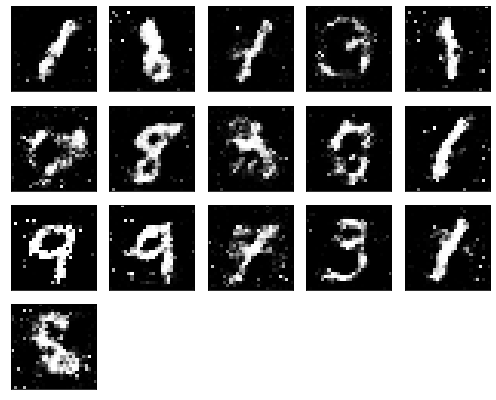

Epochs nb. 9261
discriminator loss: 0.6360350847244263
generator loss : 1.15171480178833

Epochs nb. 9262
discriminator loss: 0.5523208975791931
generator loss : 1.1612536907196045

Epochs nb. 9263
discriminator loss: 0.6556161046028137
generator loss : 1.0801901817321777

Epochs nb. 9264
discriminator loss: 0.561841607093811
generator loss : 1.2275967597961426

Epochs nb. 9265
discriminator loss: 0.6249037384986877
generator loss : 1.3092414140701294

Epochs nb. 9266
discriminator loss: 0.5628926753997803
generator loss : 0.9814283847808838

Epochs nb. 9267
discriminator loss: 0.6079186201095581
generator loss : 1.049842357635498

Epochs nb. 9268
discriminator loss: 0.5480867028236389
generator loss : 0.9214727878570557

Epochs nb. 9269
discriminator loss: 0.5173822045326233
generator loss : 1.0498924255371094

Epochs nb. 9270
discriminator loss: 0.5642204284667969
generator loss : 1.282607913017273



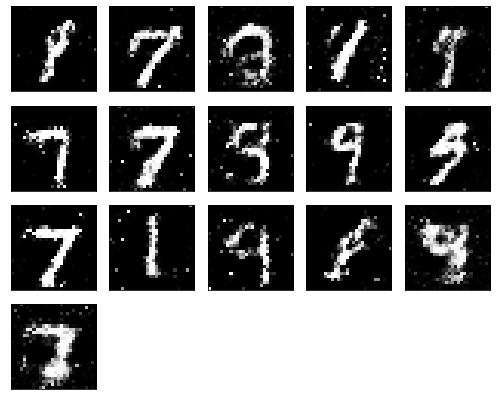

Epochs nb. 9271
discriminator loss: 0.6539560556411743
generator loss : 1.0618743896484375

Epochs nb. 9272
discriminator loss: 0.5512626767158508
generator loss : 0.8868518471717834

Epochs nb. 9273
discriminator loss: 0.6515084505081177
generator loss : 0.9830659031867981

Epochs nb. 9274
discriminator loss: 0.5331921577453613
generator loss : 0.92349773645401

Epochs nb. 9275
discriminator loss: 0.7118973135948181
generator loss : 0.884732723236084

Epochs nb. 9276
discriminator loss: 0.7021004557609558
generator loss : 0.7241491675376892

Epochs nb. 9277
discriminator loss: 0.5645407438278198
generator loss : 0.914649486541748

Epochs nb. 9278
discriminator loss: 0.680347204208374
generator loss : 1.199182152748108

Epochs nb. 9279
discriminator loss: 0.6294463276863098
generator loss : 0.9829302430152893

Epochs nb. 9280
discriminator loss: 0.5822221040725708
generator loss : 1.044677495956421



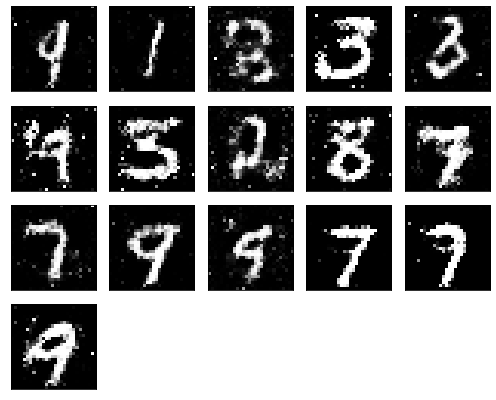

Epochs nb. 9281
discriminator loss: 0.6695057153701782
generator loss : 1.099106788635254

Epochs nb. 9282
discriminator loss: 0.6540984511375427
generator loss : 1.0745264291763306

Epochs nb. 9283
discriminator loss: 0.6128600239753723
generator loss : 1.063724160194397

Epochs nb. 9284
discriminator loss: 0.6117010116577148
generator loss : 0.7491204142570496

Epochs nb. 9285
discriminator loss: 0.45632803440093994
generator loss : 0.8027420043945312

Epochs nb. 9286
discriminator loss: 0.7752491235733032
generator loss : 1.1490139961242676

Epochs nb. 9287
discriminator loss: 0.6392745971679688
generator loss : 0.8319481611251831

Epochs nb. 9288
discriminator loss: 0.5108978748321533
generator loss : 0.9868563413619995

Epochs nb. 9289
discriminator loss: 0.6579821705818176
generator loss : 0.8650729656219482

Epochs nb. 9290
discriminator loss: 0.7405723929405212
generator loss : 1.0625401735305786



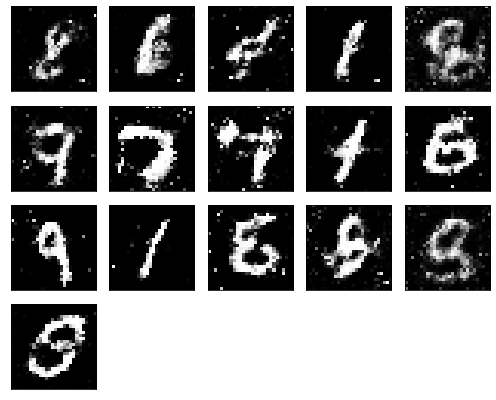

Epochs nb. 9291
discriminator loss: 0.5728594660758972
generator loss : 1.0100905895233154

Epochs nb. 9292
discriminator loss: 0.6079638004302979
generator loss : 1.0749115943908691

Epochs nb. 9293
discriminator loss: 0.825781524181366
generator loss : 1.1158101558685303

Epochs nb. 9294
discriminator loss: 0.6461619138717651
generator loss : 1.0718399286270142

Epochs nb. 9295
discriminator loss: 0.6498310565948486
generator loss : 0.9798822402954102

Epochs nb. 9296
discriminator loss: 0.6381564140319824
generator loss : 1.012160062789917

Epochs nb. 9297
discriminator loss: 0.5380389094352722
generator loss : 0.9350386261940002

Epochs nb. 9298
discriminator loss: 0.6406680941581726
generator loss : 1.0446159839630127

Epochs nb. 9299
discriminator loss: 0.6277732849121094
generator loss : 1.1702773571014404

Epochs nb. 9300
discriminator loss: 0.6353790760040283
generator loss : 1.1653196811676025



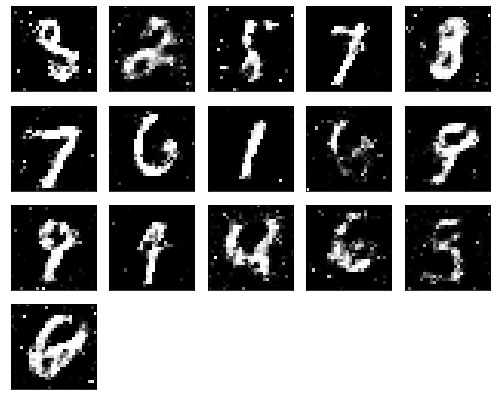

Epochs nb. 9301
discriminator loss: 0.5794001817703247
generator loss : 0.9567931890487671

Epochs nb. 9302
discriminator loss: 0.646681547164917
generator loss : 0.8459053635597229

Epochs nb. 9303
discriminator loss: 0.5060037970542908
generator loss : 0.9913513660430908

Epochs nb. 9304
discriminator loss: 0.5568210482597351
generator loss : 1.0588926076889038

Epochs nb. 9305
discriminator loss: 0.5246192216873169
generator loss : 0.9468855857849121

Epochs nb. 9306
discriminator loss: 0.6854161024093628
generator loss : 0.9669328331947327

Epochs nb. 9307
discriminator loss: 0.5416507124900818
generator loss : 0.964668869972229

Epochs nb. 9308
discriminator loss: 0.5131908059120178
generator loss : 0.8774864673614502

Epochs nb. 9309
discriminator loss: 0.6898333430290222
generator loss : 1.224774718284607

Epochs nb. 9310
discriminator loss: 0.6333684921264648
generator loss : 1.0686064958572388



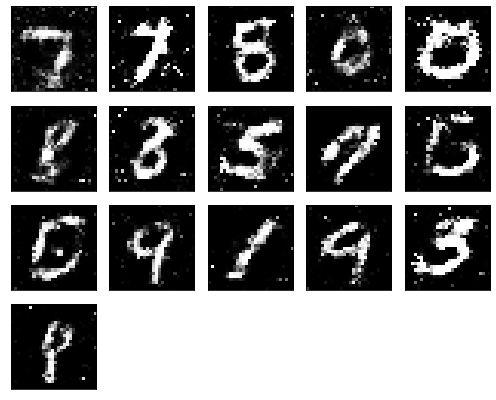

Epochs nb. 9311
discriminator loss: 0.5754920840263367
generator loss : 0.8414669632911682

Epochs nb. 9312
discriminator loss: 0.7193602919578552
generator loss : 1.0208942890167236

Epochs nb. 9313
discriminator loss: 0.6415197849273682
generator loss : 0.9978042244911194

Epochs nb. 9314
discriminator loss: 0.6024447679519653
generator loss : 1.0071659088134766

Epochs nb. 9315
discriminator loss: 0.5520403385162354
generator loss : 0.9822040796279907

Epochs nb. 9316
discriminator loss: 0.5521935224533081
generator loss : 1.0375508069992065

Epochs nb. 9317
discriminator loss: 0.5845605134963989
generator loss : 0.7890167236328125

Epochs nb. 9318
discriminator loss: 0.542717695236206
generator loss : 0.9707990884780884

Epochs nb. 9319
discriminator loss: 0.6729305982589722
generator loss : 1.1035547256469727

Epochs nb. 9320
discriminator loss: 0.550956130027771
generator loss : 1.0843790769577026



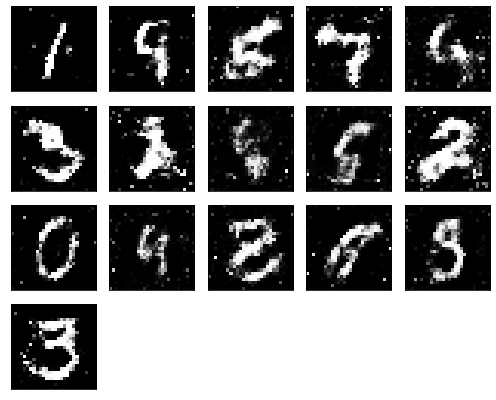

Epochs nb. 9321
discriminator loss: 0.739399790763855
generator loss : 1.1144973039627075

Epochs nb. 9322
discriminator loss: 0.613724946975708
generator loss : 1.1339819431304932

Epochs nb. 9323
discriminator loss: 0.5790455341339111
generator loss : 0.9655618071556091

Epochs nb. 9324
discriminator loss: 0.5232594609260559
generator loss : 1.104303002357483

Epochs nb. 9325
discriminator loss: 0.6249628067016602
generator loss : 0.8496756553649902

Epochs nb. 9326
discriminator loss: 0.5116534233093262
generator loss : 1.023085594177246

Epochs nb. 9327
discriminator loss: 0.4835739731788635
generator loss : 0.917100191116333

Epochs nb. 9328
discriminator loss: 0.7640299797058105
generator loss : 1.1202313899993896

Epochs nb. 9329
discriminator loss: 0.6988019347190857
generator loss : 0.9907122850418091

Epochs nb. 9330
discriminator loss: 0.8184370994567871
generator loss : 0.813903272151947



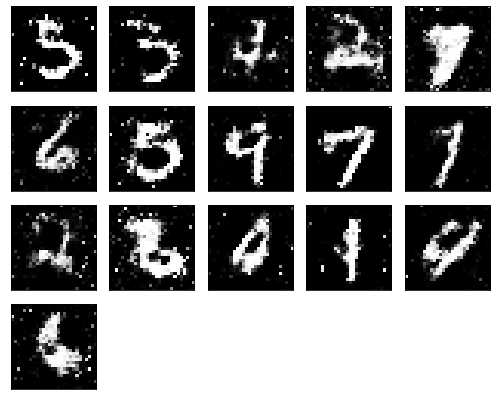

Epochs nb. 9331
discriminator loss: 0.6218408346176147
generator loss : 0.8217132687568665

Epochs nb. 9332
discriminator loss: 0.5186928510665894
generator loss : 0.8550095558166504

Epochs nb. 9333
discriminator loss: 0.6773174405097961
generator loss : 1.0227057933807373

Epochs nb. 9334
discriminator loss: 0.61409592628479
generator loss : 1.042518138885498

Epochs nb. 9335
discriminator loss: 0.5876047015190125
generator loss : 0.9072614908218384

Epochs nb. 9336
discriminator loss: 0.6693936586380005
generator loss : 0.837531566619873

Epochs nb. 9337
discriminator loss: 0.5591009259223938
generator loss : 1.0529460906982422

Epochs nb. 9338
discriminator loss: 0.6328250765800476
generator loss : 0.7545548677444458

Epochs nb. 9339
discriminator loss: 0.5558275580406189
generator loss : 1.1164393424987793

Epochs nb. 9340
discriminator loss: 0.6869475245475769
generator loss : 1.0688213109970093



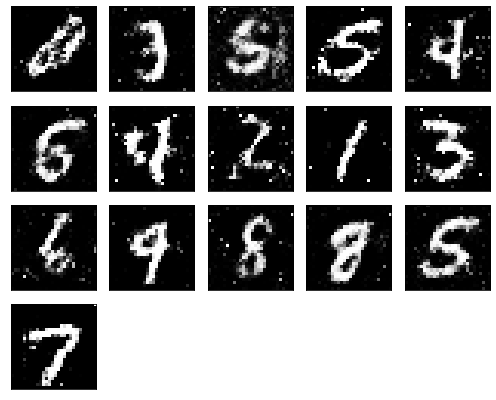

Epochs nb. 9341
discriminator loss: 0.6337511539459229
generator loss : 0.8786811232566833

Epochs nb. 9342
discriminator loss: 0.5482662320137024
generator loss : 0.8603311777114868

Epochs nb. 9343
discriminator loss: 0.48037466406822205
generator loss : 1.0079436302185059

Epochs nb. 9344
discriminator loss: 0.6058849096298218
generator loss : 0.8833657503128052

Epochs nb. 9345
discriminator loss: 0.6223711967468262
generator loss : 1.0132931470870972

Epochs nb. 9346
discriminator loss: 0.515766441822052
generator loss : 0.9121016263961792

Epochs nb. 9347
discriminator loss: 0.5859507322311401
generator loss : 0.849608302116394

Epochs nb. 9348
discriminator loss: 0.6375471949577332
generator loss : 0.8322327136993408

Epochs nb. 9349
discriminator loss: 0.5623852610588074
generator loss : 0.7895780801773071

Epochs nb. 9350
discriminator loss: 0.6467466354370117
generator loss : 0.8711328506469727



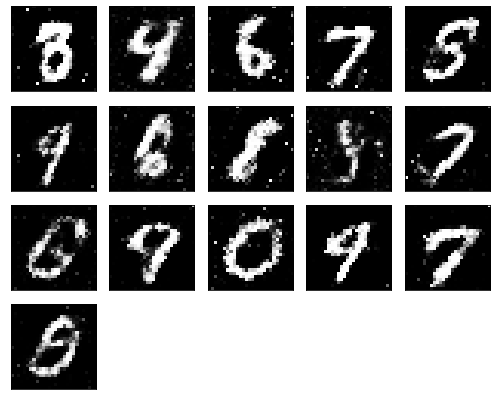

Epochs nb. 9351
discriminator loss: 0.6078580617904663
generator loss : 1.0535078048706055

Epochs nb. 9352
discriminator loss: 0.6735423803329468
generator loss : 1.0159528255462646

Epochs nb. 9353
discriminator loss: 0.5156612992286682
generator loss : 0.8624221682548523

Epochs nb. 9354
discriminator loss: 0.629910409450531
generator loss : 1.0198638439178467

Epochs nb. 9355
discriminator loss: 0.5757833123207092
generator loss : 0.9217703938484192

Epochs nb. 9356
discriminator loss: 0.5753185749053955
generator loss : 0.8863965272903442

Epochs nb. 9357
discriminator loss: 0.5501074194908142
generator loss : 0.9263293743133545

Epochs nb. 9358
discriminator loss: 0.5993987321853638
generator loss : 0.9933013319969177

Epochs nb. 9359
discriminator loss: 0.565147340297699
generator loss : 0.9732192754745483

Epochs nb. 9360
discriminator loss: 0.5904222130775452
generator loss : 0.9751314520835876



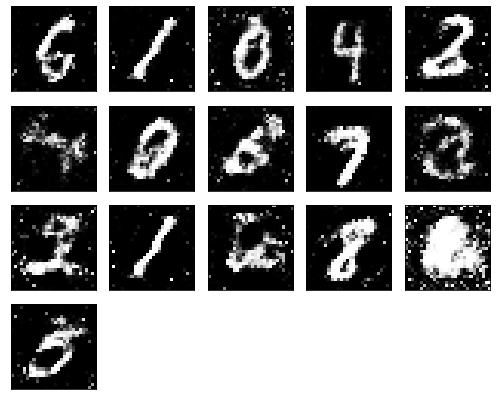

Epochs nb. 9361
discriminator loss: 0.5280231833457947
generator loss : 1.0271642208099365

Epochs nb. 9362
discriminator loss: 0.7406002283096313
generator loss : 0.8852155804634094

Epochs nb. 9363
discriminator loss: 0.504580020904541
generator loss : 1.0492689609527588

Epochs nb. 9364
discriminator loss: 0.5315777063369751
generator loss : 1.1505632400512695

Epochs nb. 9365
discriminator loss: 0.7106898427009583
generator loss : 1.03313148021698

Epochs nb. 9366
discriminator loss: 0.4815024435520172
generator loss : 0.9761162996292114

Epochs nb. 9367
discriminator loss: 0.5903547406196594
generator loss : 0.7712548971176147

Epochs nb. 9368
discriminator loss: 0.7270132899284363
generator loss : 0.9739763736724854

Epochs nb. 9369
discriminator loss: 0.5512067079544067
generator loss : 1.1165740489959717

Epochs nb. 9370
discriminator loss: 0.5889299511909485
generator loss : 1.091555118560791



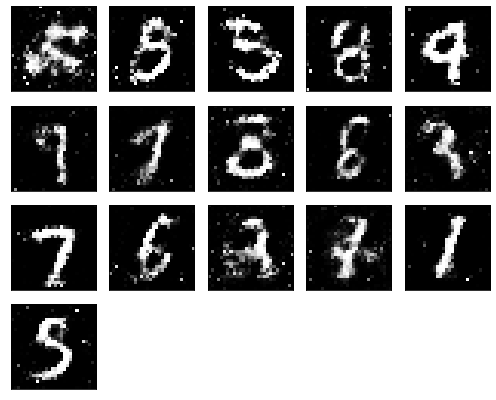

Epochs nb. 9371
discriminator loss: 0.6102982759475708
generator loss : 0.9812588691711426

Epochs nb. 9372
discriminator loss: 0.5086130499839783
generator loss : 1.0410997867584229

Epochs nb. 9373
discriminator loss: 0.5646365284919739
generator loss : 1.1257750988006592

Epochs nb. 9374
discriminator loss: 0.7246674299240112
generator loss : 1.0882083177566528

Epochs nb. 9375
discriminator loss: 0.5299270153045654
generator loss : 1.0658174753189087

Epochs nb. 9376
discriminator loss: 0.5815021395683289
generator loss : 1.060559630393982

Epochs nb. 9377
discriminator loss: 0.6338988542556763
generator loss : 0.9871869683265686

Epochs nb. 9378
discriminator loss: 0.5493553876876831
generator loss : 1.0518656969070435

Epochs nb. 9379
discriminator loss: 0.5961604118347168
generator loss : 0.9722623229026794

Epochs nb. 9380
discriminator loss: 0.5398345589637756
generator loss : 0.873237669467926



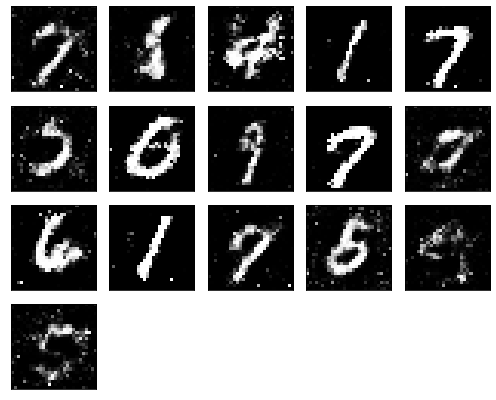

Epochs nb. 9381
discriminator loss: 0.5492787957191467
generator loss : 0.8734936714172363

Epochs nb. 9382
discriminator loss: 0.5973280668258667
generator loss : 0.8744389414787292

Epochs nb. 9383
discriminator loss: 0.7695519924163818
generator loss : 0.9022709131240845

Epochs nb. 9384
discriminator loss: 0.47391191124916077
generator loss : 0.9820535182952881

Epochs nb. 9385
discriminator loss: 0.6421084403991699
generator loss : 0.9840383529663086

Epochs nb. 9386
discriminator loss: 0.6029012203216553
generator loss : 0.9058595895767212

Epochs nb. 9387
discriminator loss: 0.6829943656921387
generator loss : 0.7955734133720398

Epochs nb. 9388
discriminator loss: 0.49927374720573425
generator loss : 0.8973473310470581

Epochs nb. 9389
discriminator loss: 0.5489200353622437
generator loss : 1.084913730621338

Epochs nb. 9390
discriminator loss: 0.6416672468185425
generator loss : 1.1835771799087524



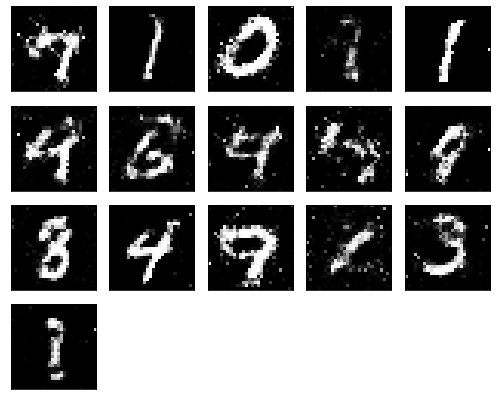

Epochs nb. 9391
discriminator loss: 0.5895883440971375
generator loss : 1.0627251863479614

Epochs nb. 9392
discriminator loss: 0.7138743996620178
generator loss : 1.0477460622787476

Epochs nb. 9393
discriminator loss: 0.6452569365501404
generator loss : 1.0426843166351318

Epochs nb. 9394
discriminator loss: 0.6379246711730957
generator loss : 1.0320512056350708

Epochs nb. 9395
discriminator loss: 0.6247513890266418
generator loss : 1.0180509090423584

Epochs nb. 9396
discriminator loss: 0.7870228290557861
generator loss : 1.0778669118881226

Epochs nb. 9397
discriminator loss: 0.5674310922622681
generator loss : 0.9244120717048645

Epochs nb. 9398
discriminator loss: 0.7435029745101929
generator loss : 0.955960214138031

Epochs nb. 9399
discriminator loss: 0.5885776281356812
generator loss : 1.03702974319458

Epochs nb. 9400
discriminator loss: 0.6300317049026489
generator loss : 1.2059097290039062



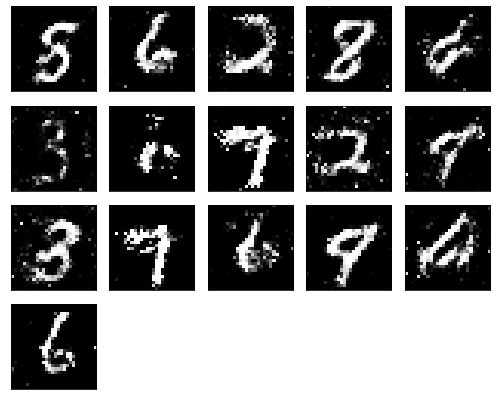

Epochs nb. 9401
discriminator loss: 0.5533824563026428
generator loss : 1.010570764541626

Epochs nb. 9402
discriminator loss: 0.6289709806442261
generator loss : 0.8555524349212646

Epochs nb. 9403
discriminator loss: 0.6100382804870605
generator loss : 1.1176364421844482

Epochs nb. 9404
discriminator loss: 0.7269662022590637
generator loss : 0.9267914891242981

Epochs nb. 9405
discriminator loss: 0.5295515060424805
generator loss : 0.9267345666885376

Epochs nb. 9406
discriminator loss: 0.5534039735794067
generator loss : 0.9067021608352661

Epochs nb. 9407
discriminator loss: 0.47283071279525757
generator loss : 1.104529857635498

Epochs nb. 9408
discriminator loss: 0.5925124883651733
generator loss : 1.004775047302246

Epochs nb. 9409
discriminator loss: 0.5101779699325562
generator loss : 0.9667375087738037

Epochs nb. 9410
discriminator loss: 0.6114333868026733
generator loss : 1.0048010349273682



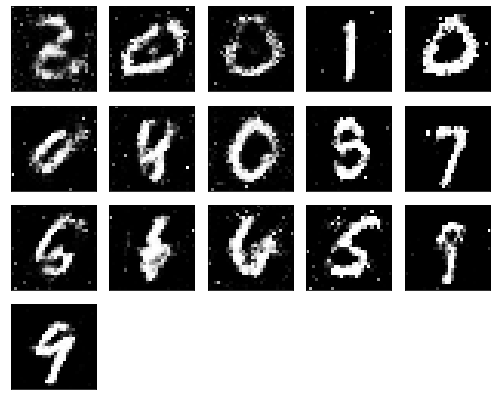

Epochs nb. 9411
discriminator loss: 0.6844108700752258
generator loss : 0.9718669652938843

Epochs nb. 9412
discriminator loss: 0.5300354361534119
generator loss : 0.8342046141624451

Epochs nb. 9413
discriminator loss: 0.6975931525230408
generator loss : 0.7496880292892456

Epochs nb. 9414
discriminator loss: 0.5791711211204529
generator loss : 0.953637421131134

Epochs nb. 9415
discriminator loss: 0.4674229025840759
generator loss : 0.9386710524559021

Epochs nb. 9416
discriminator loss: 0.636823832988739
generator loss : 0.9189870953559875

Epochs nb. 9417
discriminator loss: 0.5257498025894165
generator loss : 0.9633619785308838

Epochs nb. 9418
discriminator loss: 0.5845704078674316
generator loss : 1.0221647024154663

Epochs nb. 9419
discriminator loss: 0.5314276814460754
generator loss : 1.0462448596954346

Epochs nb. 9420
discriminator loss: 0.5325372219085693
generator loss : 0.9492738246917725



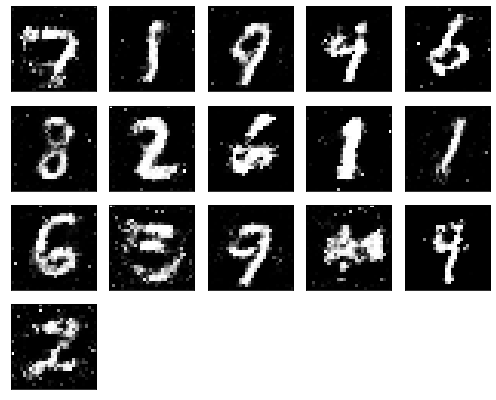

Epochs nb. 9421
discriminator loss: 0.6161654591560364
generator loss : 0.9577894806861877

Epochs nb. 9422
discriminator loss: 0.5099296569824219
generator loss : 0.8731200695037842

Epochs nb. 9423
discriminator loss: 0.6184378862380981
generator loss : 0.8782059550285339

Epochs nb. 9424
discriminator loss: 0.5305249094963074
generator loss : 0.8901609182357788

Epochs nb. 9425
discriminator loss: 0.5390831232070923
generator loss : 0.7974463701248169

Epochs nb. 9426
discriminator loss: 0.6800980567932129
generator loss : 1.0331422090530396

Epochs nb. 9427
discriminator loss: 0.6332473754882812
generator loss : 1.0127174854278564

Epochs nb. 9428
discriminator loss: 0.6070966720581055
generator loss : 1.0205997228622437

Epochs nb. 9429
discriminator loss: 0.75629723072052
generator loss : 1.1134164333343506

Epochs nb. 9430
discriminator loss: 0.5769939422607422
generator loss : 0.7170991897583008



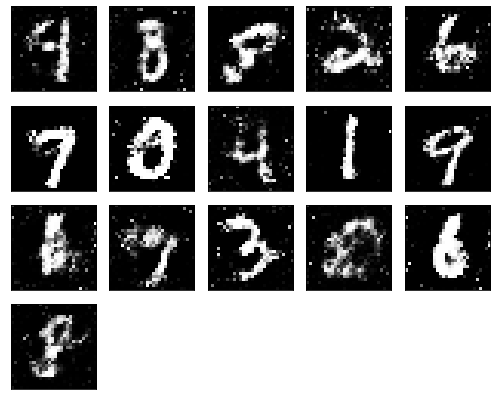

Epochs nb. 9431
discriminator loss: 0.5868738889694214
generator loss : 0.906264066696167

Epochs nb. 9432
discriminator loss: 0.5145315527915955
generator loss : 0.9678953289985657

Epochs nb. 9433
discriminator loss: 0.5941282510757446
generator loss : 1.0923941135406494

Epochs nb. 9434
discriminator loss: 0.6228047609329224
generator loss : 0.7685924172401428

Epochs nb. 9435
discriminator loss: 0.47543013095855713
generator loss : 0.8798417448997498

Epochs nb. 9436
discriminator loss: 0.7025671005249023
generator loss : 0.828240156173706

Epochs nb. 9437
discriminator loss: 0.6068490743637085
generator loss : 0.9223182201385498

Epochs nb. 9438
discriminator loss: 0.6600325703620911
generator loss : 0.8712384104728699

Epochs nb. 9439
discriminator loss: 0.5816488862037659
generator loss : 1.0243467092514038

Epochs nb. 9440
discriminator loss: 0.4799897074699402
generator loss : 1.0602068901062012



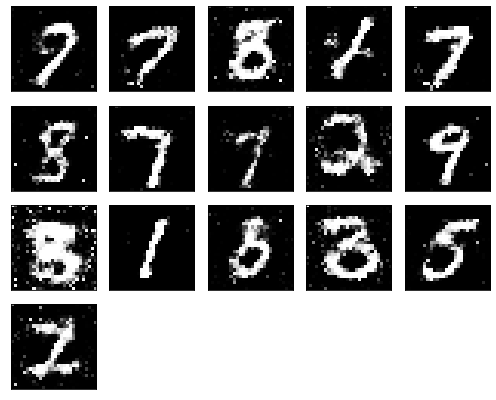

Epochs nb. 9441
discriminator loss: 0.5787398815155029
generator loss : 0.827196478843689

Epochs nb. 9442
discriminator loss: 0.6731163263320923
generator loss : 1.0448486804962158

Epochs nb. 9443
discriminator loss: 0.4952445328235626
generator loss : 1.0477102994918823

Epochs nb. 9444
discriminator loss: 0.562873125076294
generator loss : 0.9159813523292542

Epochs nb. 9445
discriminator loss: 0.6458135843276978
generator loss : 1.0013515949249268

Epochs nb. 9446
discriminator loss: 0.6675148010253906
generator loss : 0.878864049911499

Epochs nb. 9447
discriminator loss: 0.5401219129562378
generator loss : 0.9468925595283508

Epochs nb. 9448
discriminator loss: 0.6239224672317505
generator loss : 0.9419578313827515

Epochs nb. 9449
discriminator loss: 0.515525221824646
generator loss : 0.8838299512863159

Epochs nb. 9450
discriminator loss: 0.6280413269996643
generator loss : 1.0018482208251953



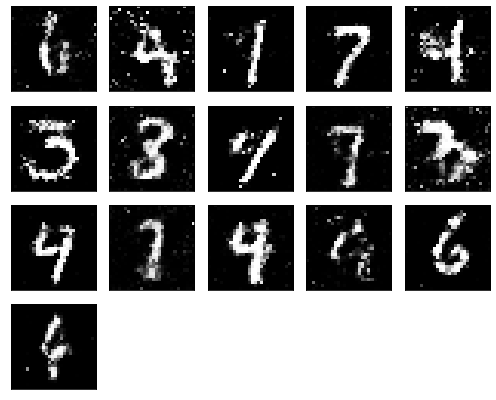

Epochs nb. 9451
discriminator loss: 0.6044158935546875
generator loss : 0.9352847337722778

Epochs nb. 9452
discriminator loss: 0.6795089244842529
generator loss : 1.2105834484100342

Epochs nb. 9453
discriminator loss: 0.5441470146179199
generator loss : 0.8741880655288696

Epochs nb. 9454
discriminator loss: 0.6612100005149841
generator loss : 1.0873911380767822

Epochs nb. 9455
discriminator loss: 0.6104046106338501
generator loss : 1.064415454864502

Epochs nb. 9456
discriminator loss: 0.5849107503890991
generator loss : 0.8799929618835449

Epochs nb. 9457
discriminator loss: 0.5147440433502197
generator loss : 0.8582271933555603

Epochs nb. 9458
discriminator loss: 0.6290273666381836
generator loss : 1.0612080097198486

Epochs nb. 9459
discriminator loss: 0.5707401037216187
generator loss : 1.2509444952011108

Epochs nb. 9460
discriminator loss: 0.7146216630935669
generator loss : 1.0420269966125488



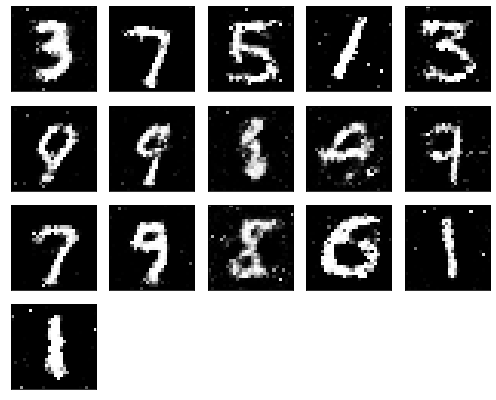

Epochs nb. 9461
discriminator loss: 0.6648116707801819
generator loss : 0.9601811766624451

Epochs nb. 9462
discriminator loss: 0.4365208148956299
generator loss : 0.8942487835884094

Epochs nb. 9463
discriminator loss: 0.6142535209655762
generator loss : 1.1565581560134888

Epochs nb. 9464
discriminator loss: 0.5372408628463745
generator loss : 0.8283728361129761

Epochs nb. 9465
discriminator loss: 0.5353106260299683
generator loss : 1.162164330482483

Epochs nb. 9466
discriminator loss: 0.5038033723831177
generator loss : 1.1062300205230713

Epochs nb. 9467
discriminator loss: 0.6128159761428833
generator loss : 1.0910824537277222

Epochs nb. 9468
discriminator loss: 0.5205152034759521
generator loss : 0.8975763320922852

Epochs nb. 9469
discriminator loss: 0.5291413068771362
generator loss : 1.2314610481262207

Epochs nb. 9470
discriminator loss: 0.7305208444595337
generator loss : 1.0099074840545654



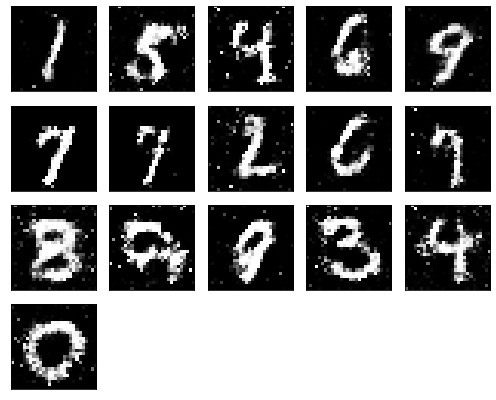

Epochs nb. 9471
discriminator loss: 0.4911501407623291
generator loss : 1.1705451011657715

Epochs nb. 9472
discriminator loss: 0.5464260578155518
generator loss : 0.9582869410514832

Epochs nb. 9473
discriminator loss: 0.5163812041282654
generator loss : 0.8935317993164062

Epochs nb. 9474
discriminator loss: 0.6092019081115723
generator loss : 0.8372232913970947

Epochs nb. 9475
discriminator loss: 0.6032955646514893
generator loss : 0.9464083909988403

Epochs nb. 9476
discriminator loss: 0.5601493120193481
generator loss : 0.9488366842269897

Epochs nb. 9477
discriminator loss: 0.8426865339279175
generator loss : 0.8540744781494141

Epochs nb. 9478
discriminator loss: 0.5066124796867371
generator loss : 0.8772910833358765

Epochs nb. 9479
discriminator loss: 0.6806246042251587
generator loss : 1.103086233139038

Epochs nb. 9480
discriminator loss: 0.5797721147537231
generator loss : 1.133612871170044



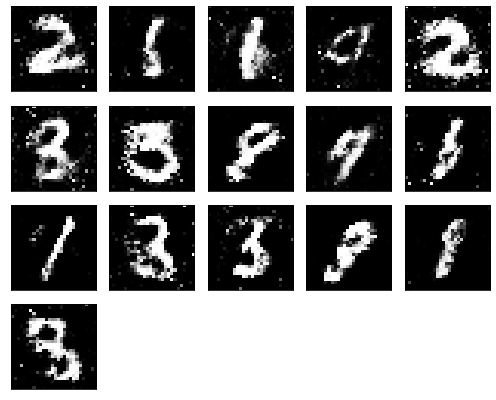

Epochs nb. 9481
discriminator loss: 0.5286405086517334
generator loss : 1.1540539264678955

Epochs nb. 9482
discriminator loss: 0.6562161445617676
generator loss : 1.0216624736785889

Epochs nb. 9483
discriminator loss: 0.6684764623641968
generator loss : 0.9841461181640625

Epochs nb. 9484
discriminator loss: 0.5650342702865601
generator loss : 0.9697116613388062

Epochs nb. 9485
discriminator loss: 0.6079317331314087
generator loss : 0.8680221438407898

Epochs nb. 9486
discriminator loss: 0.5897985696792603
generator loss : 0.9849971532821655

Epochs nb. 9487
discriminator loss: 0.6306367516517639
generator loss : 1.0952651500701904

Epochs nb. 9488
discriminator loss: 0.630956768989563
generator loss : 1.136725664138794

Epochs nb. 9489
discriminator loss: 0.5918613076210022
generator loss : 0.9793063998222351

Epochs nb. 9490
discriminator loss: 0.6537562608718872
generator loss : 0.850487232208252



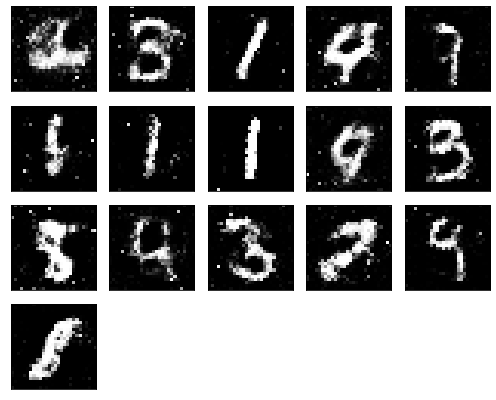

Epochs nb. 9491
discriminator loss: 0.6942976117134094
generator loss : 1.0639512538909912

Epochs nb. 9492
discriminator loss: 0.558988094329834
generator loss : 1.2685679197311401

Epochs nb. 9493
discriminator loss: 0.6141006946563721
generator loss : 1.0954694747924805

Epochs nb. 9494
discriminator loss: 0.6219760179519653
generator loss : 1.1086704730987549

Epochs nb. 9495
discriminator loss: 0.6387335062026978
generator loss : 0.9906589984893799

Epochs nb. 9496
discriminator loss: 0.6556007862091064
generator loss : 1.0278074741363525

Epochs nb. 9497
discriminator loss: 0.4775475859642029
generator loss : 0.8107579946517944

Epochs nb. 9498
discriminator loss: 0.6553025245666504
generator loss : 0.9136196970939636

Epochs nb. 9499
discriminator loss: 0.5515928864479065
generator loss : 1.1815965175628662

Epochs nb. 9500
discriminator loss: 0.5611047744750977
generator loss : 1.0722620487213135



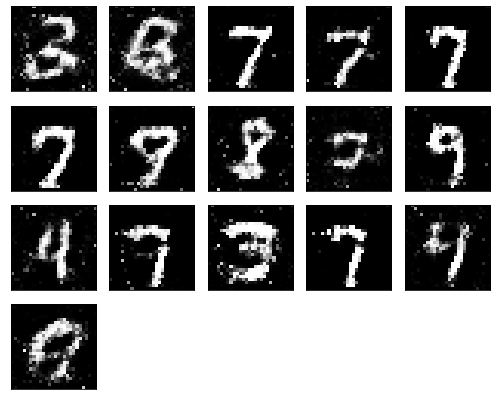

Epochs nb. 9501
discriminator loss: 0.701117753982544
generator loss : 1.0541462898254395

Epochs nb. 9502
discriminator loss: 0.566688597202301
generator loss : 1.0810480117797852

Epochs nb. 9503
discriminator loss: 0.6746723055839539
generator loss : 1.1180641651153564

Epochs nb. 9504
discriminator loss: 0.7116559743881226
generator loss : 1.0684022903442383

Epochs nb. 9505
discriminator loss: 0.7292031049728394
generator loss : 0.9301581382751465

Epochs nb. 9506
discriminator loss: 0.5499578714370728
generator loss : 0.9069963097572327

Epochs nb. 9507
discriminator loss: 0.5599356293678284
generator loss : 0.9532871842384338

Epochs nb. 9508
discriminator loss: 0.7413285970687866
generator loss : 1.0158966779708862

Epochs nb. 9509
discriminator loss: 0.7665647864341736
generator loss : 0.7660067677497864

Epochs nb. 9510
discriminator loss: 0.621955394744873
generator loss : 1.0290721654891968



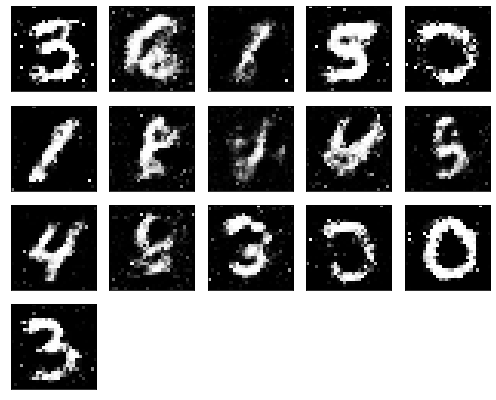

Epochs nb. 9511
discriminator loss: 0.5813960433006287
generator loss : 0.9468496441841125

Epochs nb. 9512
discriminator loss: 0.6655464768409729
generator loss : 1.4107065200805664

Epochs nb. 9513
discriminator loss: 0.6414605379104614
generator loss : 0.9011982679367065

Epochs nb. 9514
discriminator loss: 0.5792750716209412
generator loss : 0.9894570112228394

Epochs nb. 9515
discriminator loss: 0.651787519454956
generator loss : 1.0382434129714966

Epochs nb. 9516
discriminator loss: 0.5571242570877075
generator loss : 0.9955238699913025

Epochs nb. 9517
discriminator loss: 0.6631600260734558
generator loss : 0.9636141657829285

Epochs nb. 9518
discriminator loss: 0.5524905920028687
generator loss : 0.9442248940467834

Epochs nb. 9519
discriminator loss: 0.5579030513763428
generator loss : 0.9674582481384277

Epochs nb. 9520
discriminator loss: 0.4679264426231384
generator loss : 0.9818174242973328



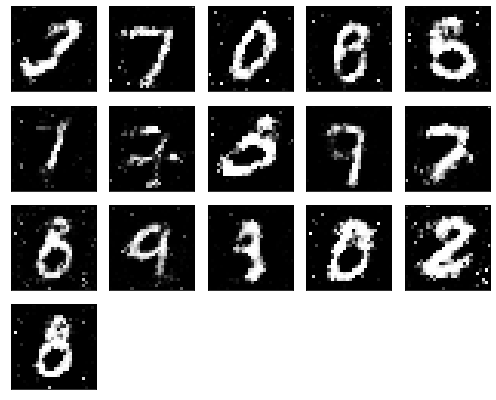

Epochs nb. 9521
discriminator loss: 0.5279119610786438
generator loss : 0.8133318424224854

Epochs nb. 9522
discriminator loss: 0.4695281982421875
generator loss : 1.1653412580490112

Epochs nb. 9523
discriminator loss: 0.6153762936592102
generator loss : 1.0616782903671265

Epochs nb. 9524
discriminator loss: 0.5938987135887146
generator loss : 1.1264843940734863

Epochs nb. 9525
discriminator loss: 0.646347165107727
generator loss : 0.975740909576416

Epochs nb. 9526
discriminator loss: 0.6129977703094482
generator loss : 1.0938199758529663

Epochs nb. 9527
discriminator loss: 0.6084082126617432
generator loss : 1.1799914836883545

Epochs nb. 9528
discriminator loss: 0.638155460357666
generator loss : 0.8905977010726929

Epochs nb. 9529
discriminator loss: 0.6174337863922119
generator loss : 0.9888474941253662

Epochs nb. 9530
discriminator loss: 0.5315060615539551
generator loss : 0.9798530340194702



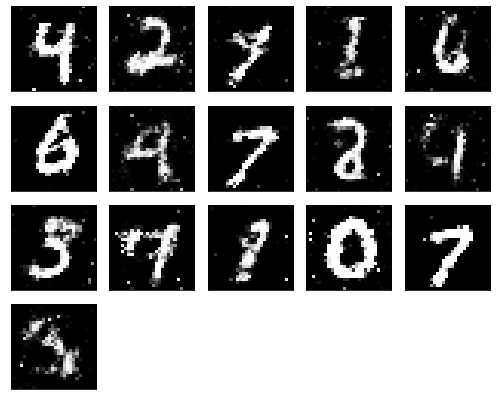

Epochs nb. 9531
discriminator loss: 0.6122647523880005
generator loss : 0.9517412185668945

Epochs nb. 9532
discriminator loss: 0.5969383120536804
generator loss : 0.9864393472671509

Epochs nb. 9533
discriminator loss: 0.6065572500228882
generator loss : 0.9502084255218506

Epochs nb. 9534
discriminator loss: 0.587675154209137
generator loss : 1.081597089767456

Epochs nb. 9535
discriminator loss: 0.6880943775177002
generator loss : 1.2011358737945557

Epochs nb. 9536
discriminator loss: 0.546709418296814
generator loss : 1.0258021354675293

Epochs nb. 9537
discriminator loss: 0.5848603248596191
generator loss : 1.1130207777023315

Epochs nb. 9538
discriminator loss: 0.6603741645812988
generator loss : 1.0382983684539795

Epochs nb. 9539
discriminator loss: 0.5588315725326538
generator loss : 1.0206315517425537

Epochs nb. 9540
discriminator loss: 0.5557900667190552
generator loss : 0.8920618295669556



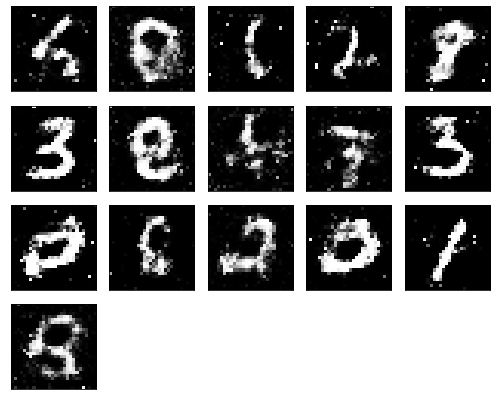

Epochs nb. 9541
discriminator loss: 0.5486843585968018
generator loss : 1.004271149635315

Epochs nb. 9542
discriminator loss: 0.6364055871963501
generator loss : 0.9535685777664185

Epochs nb. 9543
discriminator loss: 0.560427188873291
generator loss : 1.070393443107605

Epochs nb. 9544
discriminator loss: 0.5295538902282715
generator loss : 0.9339812397956848

Epochs nb. 9545
discriminator loss: 0.6703962683677673
generator loss : 1.0663495063781738

Epochs nb. 9546
discriminator loss: 0.7542521357536316
generator loss : 0.7743937969207764

Epochs nb. 9547
discriminator loss: 0.5703714489936829
generator loss : 0.857961893081665

Epochs nb. 9548
discriminator loss: 0.5960699319839478
generator loss : 0.9263365864753723

Epochs nb. 9549
discriminator loss: 0.5857839584350586
generator loss : 0.9586111307144165

Epochs nb. 9550
discriminator loss: 0.5067218542098999
generator loss : 1.0009584426879883



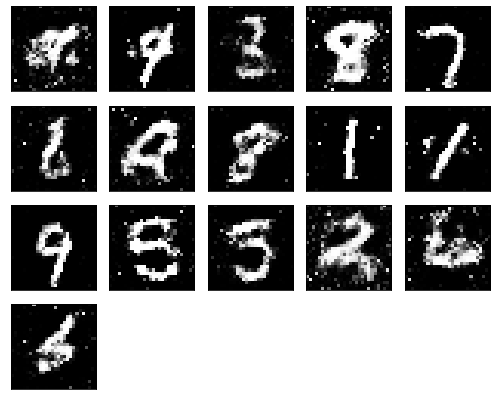

Epochs nb. 9551
discriminator loss: 0.47966423630714417
generator loss : 0.964131236076355

Epochs nb. 9552
discriminator loss: 0.6872814893722534
generator loss : 1.0639443397521973

Epochs nb. 9553
discriminator loss: 0.5706131458282471
generator loss : 0.8802133202552795

Epochs nb. 9554
discriminator loss: 0.5012074112892151
generator loss : 1.0199419260025024

Epochs nb. 9555
discriminator loss: 0.6193699836730957
generator loss : 1.087148904800415

Epochs nb. 9556
discriminator loss: 0.5363340973854065
generator loss : 0.9014774560928345

Epochs nb. 9557
discriminator loss: 0.5128464102745056
generator loss : 1.1241682767868042

Epochs nb. 9558
discriminator loss: 0.5906486511230469
generator loss : 1.1062051057815552

Epochs nb. 9559
discriminator loss: 0.5169165134429932
generator loss : 0.7859900593757629

Epochs nb. 9560
discriminator loss: 0.5328240394592285
generator loss : 0.9783009886741638



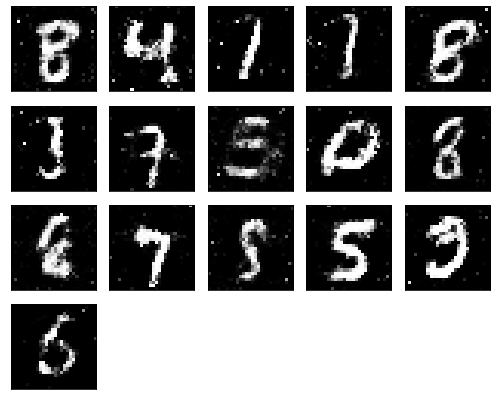

Epochs nb. 9561
discriminator loss: 0.5928319096565247
generator loss : 0.8308671116828918

Epochs nb. 9562
discriminator loss: 0.565514087677002
generator loss : 1.0872445106506348

Epochs nb. 9563
discriminator loss: 0.5323681235313416
generator loss : 0.9941847920417786

Epochs nb. 9564
discriminator loss: 0.5549516677856445
generator loss : 1.151129961013794

Epochs nb. 9565
discriminator loss: 0.5515738725662231
generator loss : 0.9907638430595398

Epochs nb. 9566
discriminator loss: 0.6798675060272217
generator loss : 1.0111533403396606

Epochs nb. 9567
discriminator loss: 0.5104440450668335
generator loss : 1.0543458461761475

Epochs nb. 9568
discriminator loss: 0.4842224419116974
generator loss : 1.1165354251861572

Epochs nb. 9569
discriminator loss: 0.5627777576446533
generator loss : 0.9867513179779053

Epochs nb. 9570
discriminator loss: 0.6278318166732788
generator loss : 0.9461549520492554



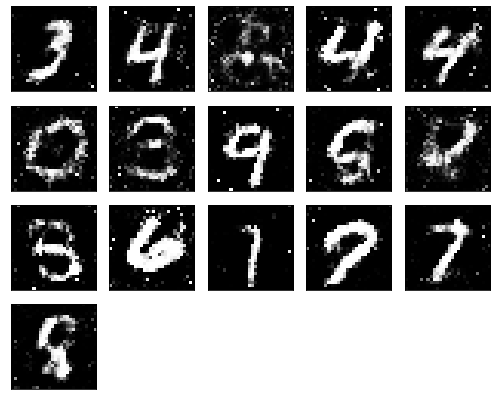

Epochs nb. 9571
discriminator loss: 0.5569205284118652
generator loss : 1.1551792621612549

Epochs nb. 9572
discriminator loss: 0.6882623434066772
generator loss : 1.3078902959823608

Epochs nb. 9573
discriminator loss: 0.8120695352554321
generator loss : 1.1554179191589355

Epochs nb. 9574
discriminator loss: 0.45955681800842285
generator loss : 1.0963013172149658

Epochs nb. 9575
discriminator loss: 0.6990361213684082
generator loss : 0.8740679621696472

Epochs nb. 9576
discriminator loss: 0.570604681968689
generator loss : 1.1141170263290405

Epochs nb. 9577
discriminator loss: 0.6926928758621216
generator loss : 1.0310604572296143

Epochs nb. 9578
discriminator loss: 0.6422572731971741
generator loss : 1.0295617580413818

Epochs nb. 9579
discriminator loss: 0.5697488784790039
generator loss : 0.9399927854537964

Epochs nb. 9580
discriminator loss: 0.6157779097557068
generator loss : 1.009920358657837



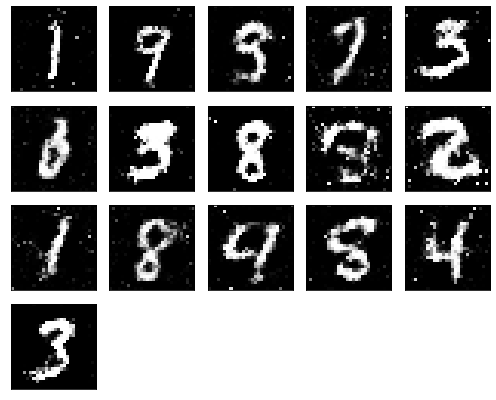

Epochs nb. 9581
discriminator loss: 0.6755046844482422
generator loss : 0.8815008401870728

Epochs nb. 9582
discriminator loss: 0.5794990062713623
generator loss : 0.9441602826118469

Epochs nb. 9583
discriminator loss: 0.5944616198539734
generator loss : 1.2173832654953003

Epochs nb. 9584
discriminator loss: 0.603742241859436
generator loss : 0.9514923691749573

Epochs nb. 9585
discriminator loss: 0.6857274770736694
generator loss : 1.0281654596328735

Epochs nb. 9586
discriminator loss: 0.6193106174468994
generator loss : 0.9872362017631531

Epochs nb. 9587
discriminator loss: 0.5657826662063599
generator loss : 0.8841655254364014

Epochs nb. 9588
discriminator loss: 0.6354876756668091
generator loss : 1.0602433681488037

Epochs nb. 9589
discriminator loss: 0.6351083517074585
generator loss : 1.103468656539917

Epochs nb. 9590
discriminator loss: 0.4798137843608856
generator loss : 0.8779303431510925



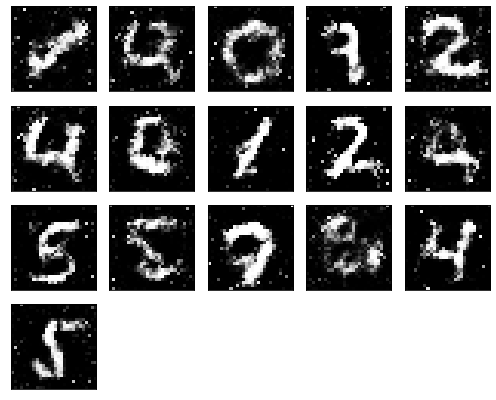

Epochs nb. 9591
discriminator loss: 0.6277907490730286
generator loss : 1.1693353652954102

Epochs nb. 9592
discriminator loss: 0.5597896575927734
generator loss : 0.9788224697113037

Epochs nb. 9593
discriminator loss: 0.4995100796222687
generator loss : 1.06423020362854

Epochs nb. 9594
discriminator loss: 0.8099738359451294
generator loss : 1.0680134296417236

Epochs nb. 9595
discriminator loss: 0.703636646270752
generator loss : 0.9803690910339355

Epochs nb. 9596
discriminator loss: 0.5725502967834473
generator loss : 0.8209716081619263

Epochs nb. 9597
discriminator loss: 0.8563780784606934
generator loss : 0.9505909085273743

Epochs nb. 9598
discriminator loss: 0.6658950448036194
generator loss : 1.098902940750122

Epochs nb. 9599
discriminator loss: 0.6410338282585144
generator loss : 0.9929181337356567

Epochs nb. 9600
discriminator loss: 0.6649214625358582
generator loss : 1.150113582611084



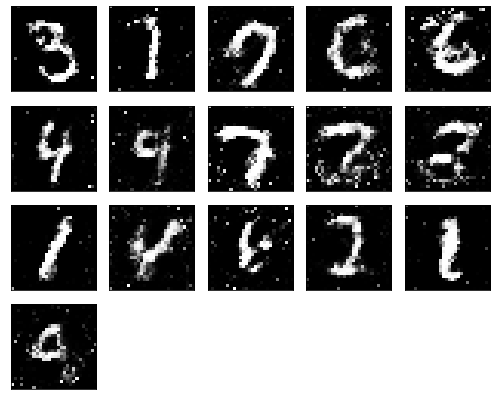

Epochs nb. 9601
discriminator loss: 0.5090072154998779
generator loss : 1.0126800537109375

Epochs nb. 9602
discriminator loss: 0.5472038984298706
generator loss : 1.0664794445037842

Epochs nb. 9603
discriminator loss: 0.5160354375839233
generator loss : 1.1458789110183716

Epochs nb. 9604
discriminator loss: 0.6509677171707153
generator loss : 0.981765866279602

Epochs nb. 9605
discriminator loss: 0.5189502239227295
generator loss : 0.8822117447853088

Epochs nb. 9606
discriminator loss: 0.5976545810699463
generator loss : 1.0231883525848389

Epochs nb. 9607
discriminator loss: 0.762812614440918
generator loss : 1.2210018634796143

Epochs nb. 9608
discriminator loss: 0.5725667476654053
generator loss : 1.1880791187286377

Epochs nb. 9609
discriminator loss: 0.6146667003631592
generator loss : 0.9831185340881348

Epochs nb. 9610
discriminator loss: 0.5916967988014221
generator loss : 1.0289480686187744



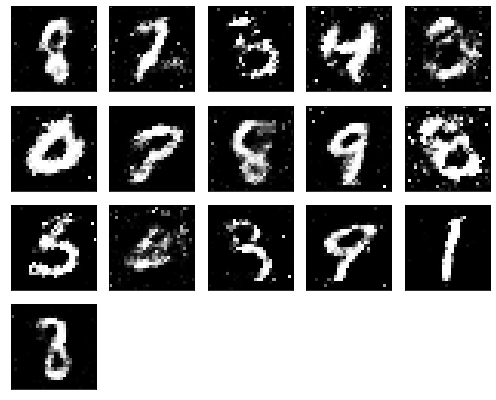

Epochs nb. 9611
discriminator loss: 0.54897141456604
generator loss : 0.8769842982292175

Epochs nb. 9612
discriminator loss: 0.5632709264755249
generator loss : 0.8790414929389954

Epochs nb. 9613
discriminator loss: 0.5072654485702515
generator loss : 0.9367874264717102

Epochs nb. 9614
discriminator loss: 0.6515915989875793
generator loss : 0.8404685258865356

Epochs nb. 9615
discriminator loss: 0.6729062795639038
generator loss : 0.9931358695030212

Epochs nb. 9616
discriminator loss: 0.5840227603912354
generator loss : 0.9686778783798218

Epochs nb. 9617
discriminator loss: 0.6762703657150269
generator loss : 1.1346991062164307

Epochs nb. 9618
discriminator loss: 0.6012725830078125
generator loss : 1.1542459726333618

Epochs nb. 9619
discriminator loss: 0.6164940595626831
generator loss : 1.1499626636505127

Epochs nb. 9620
discriminator loss: 0.63331139087677
generator loss : 0.8312119841575623



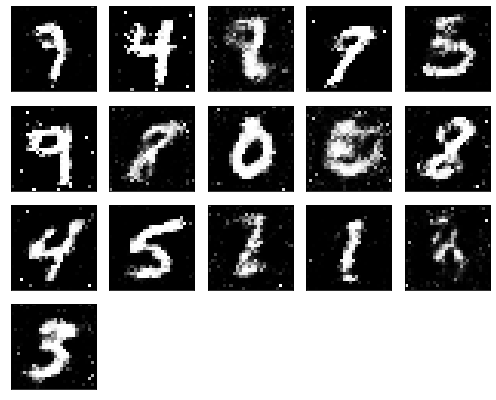

Epochs nb. 9621
discriminator loss: 0.5463842749595642
generator loss : 0.9780760407447815

Epochs nb. 9622
discriminator loss: 0.6236658096313477
generator loss : 0.9533858895301819

Epochs nb. 9623
discriminator loss: 0.4400191605091095
generator loss : 1.0325915813446045

Epochs nb. 9624
discriminator loss: 0.5705695748329163
generator loss : 0.8814284801483154

Epochs nb. 9625
discriminator loss: 0.6431562900543213
generator loss : 0.879663348197937

Epochs nb. 9626
discriminator loss: 0.5288752317428589
generator loss : 0.9301491975784302

Epochs nb. 9627
discriminator loss: 0.5667058229446411
generator loss : 0.8801561594009399

Epochs nb. 9628
discriminator loss: 0.4905228614807129
generator loss : 0.8516932725906372

Epochs nb. 9629
discriminator loss: 0.528153657913208
generator loss : 0.8766424655914307

Epochs nb. 9630
discriminator loss: 0.6008182764053345
generator loss : 1.0429277420043945



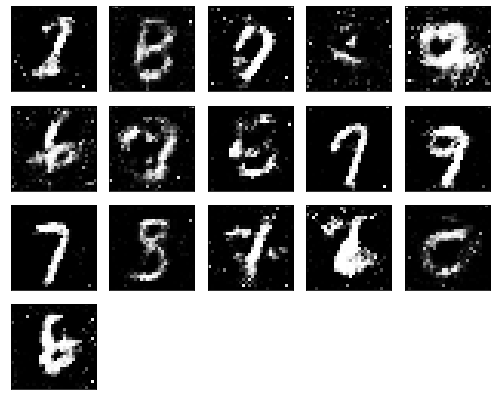

Epochs nb. 9631
discriminator loss: 0.6790550947189331
generator loss : 0.9569078683853149

Epochs nb. 9632
discriminator loss: 0.6848691701889038
generator loss : 1.108527421951294

Epochs nb. 9633
discriminator loss: 0.5182815194129944
generator loss : 0.8372631072998047

Epochs nb. 9634
discriminator loss: 0.8624804019927979
generator loss : 0.9993376731872559

Epochs nb. 9635
discriminator loss: 0.6835142374038696
generator loss : 1.0420572757720947

Epochs nb. 9636
discriminator loss: 0.7305828332901001
generator loss : 1.0693168640136719

Epochs nb. 9637
discriminator loss: 0.5145913362503052
generator loss : 0.8502267599105835

Epochs nb. 9638
discriminator loss: 0.5644508600234985
generator loss : 1.1902631521224976

Epochs nb. 9639
discriminator loss: 0.6367130875587463
generator loss : 0.8405296206474304

Epochs nb. 9640
discriminator loss: 0.6741076707839966
generator loss : 0.7943300604820251



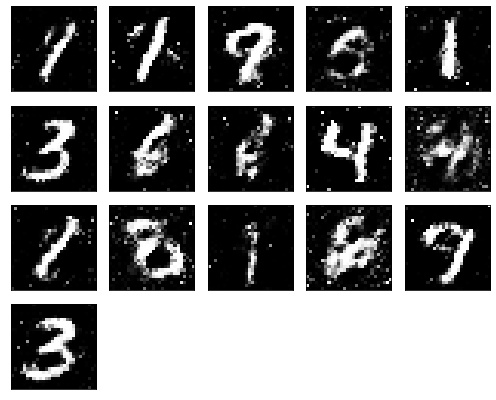

Epochs nb. 9641
discriminator loss: 0.6180577278137207
generator loss : 0.9394868612289429

Epochs nb. 9642
discriminator loss: 0.6537036895751953
generator loss : 0.9171307682991028

Epochs nb. 9643
discriminator loss: 0.5951555967330933
generator loss : 1.0289591550827026

Epochs nb. 9644
discriminator loss: 0.732113242149353
generator loss : 0.9712942838668823

Epochs nb. 9645
discriminator loss: 0.6858969330787659
generator loss : 1.0503060817718506

Epochs nb. 9646
discriminator loss: 0.5536324977874756
generator loss : 1.0379012823104858

Epochs nb. 9647
discriminator loss: 0.6990594863891602
generator loss : 1.0637538433074951

Epochs nb. 9648
discriminator loss: 0.5612229704856873
generator loss : 0.9618163108825684

Epochs nb. 9649
discriminator loss: 0.66336590051651
generator loss : 0.8255482912063599

Epochs nb. 9650
discriminator loss: 0.6755207180976868
generator loss : 0.9874119758605957



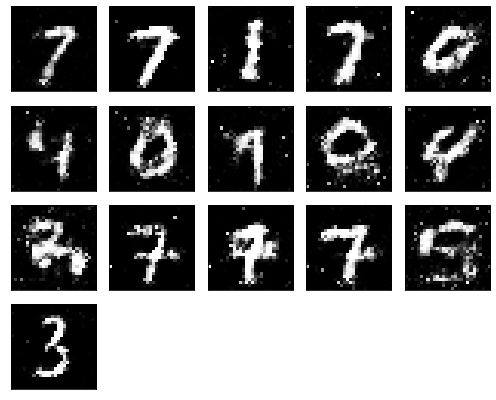

Epochs nb. 9651
discriminator loss: 0.6269222497940063
generator loss : 0.9417722225189209

Epochs nb. 9652
discriminator loss: 0.5149792432785034
generator loss : 0.9988446235656738

Epochs nb. 9653
discriminator loss: 0.5848743915557861
generator loss : 1.091653823852539

Epochs nb. 9654
discriminator loss: 0.6640226244926453
generator loss : 1.102449655532837

Epochs nb. 9655
discriminator loss: 0.6008586883544922
generator loss : 1.0518224239349365

Epochs nb. 9656
discriminator loss: 0.526003360748291
generator loss : 0.810573399066925

Epochs nb. 9657
discriminator loss: 0.5701711177825928
generator loss : 1.0575549602508545

Epochs nb. 9658
discriminator loss: 0.5592747330665588
generator loss : 1.015733242034912

Epochs nb. 9659
discriminator loss: 0.6602108478546143
generator loss : 0.9556061029434204

Epochs nb. 9660
discriminator loss: 0.5775054693222046
generator loss : 0.9172901511192322



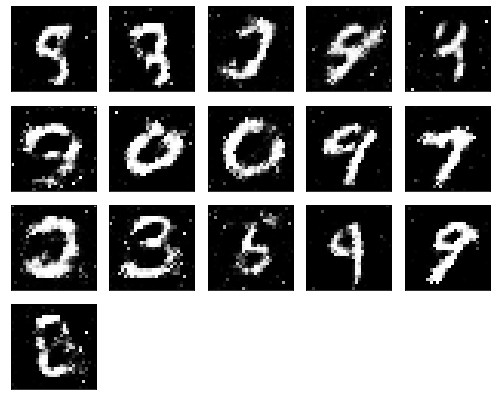

Epochs nb. 9661
discriminator loss: 0.5756957530975342
generator loss : 1.1498677730560303

Epochs nb. 9662
discriminator loss: 0.4465004801750183
generator loss : 1.0288076400756836

Epochs nb. 9663
discriminator loss: 0.7274376153945923
generator loss : 1.1198451519012451

Epochs nb. 9664
discriminator loss: 0.5350300073623657
generator loss : 0.8618990778923035

Epochs nb. 9665
discriminator loss: 0.661686897277832
generator loss : 1.0098998546600342

Epochs nb. 9666
discriminator loss: 0.5855912566184998
generator loss : 1.088173270225525

Epochs nb. 9667
discriminator loss: 0.5929685831069946
generator loss : 0.9086615443229675

Epochs nb. 9668
discriminator loss: 0.7551326751708984
generator loss : 1.0831576585769653

Epochs nb. 9669
discriminator loss: 0.5862646102905273
generator loss : 0.9105486869812012

Epochs nb. 9670
discriminator loss: 0.7128258943557739
generator loss : 0.8913960456848145



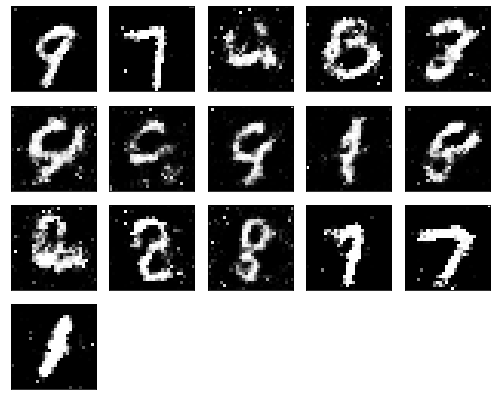

Epochs nb. 9671
discriminator loss: 0.5946367979049683
generator loss : 0.8332399129867554

Epochs nb. 9672
discriminator loss: 0.6206857562065125
generator loss : 0.9861651659011841

Epochs nb. 9673
discriminator loss: 0.7013344168663025
generator loss : 0.9165345430374146

Epochs nb. 9674
discriminator loss: 0.5581362843513489
generator loss : 1.1293628215789795

Epochs nb. 9675
discriminator loss: 0.5711294412612915
generator loss : 0.8677701354026794

Epochs nb. 9676
discriminator loss: 0.5779646635055542
generator loss : 1.0667471885681152

Epochs nb. 9677
discriminator loss: 0.5688928961753845
generator loss : 1.0267448425292969

Epochs nb. 9678
discriminator loss: 0.6077523827552795
generator loss : 1.0615800619125366

Epochs nb. 9679
discriminator loss: 0.6604872941970825
generator loss : 0.9427918195724487

Epochs nb. 9680
discriminator loss: 0.6193109154701233
generator loss : 0.9197670221328735



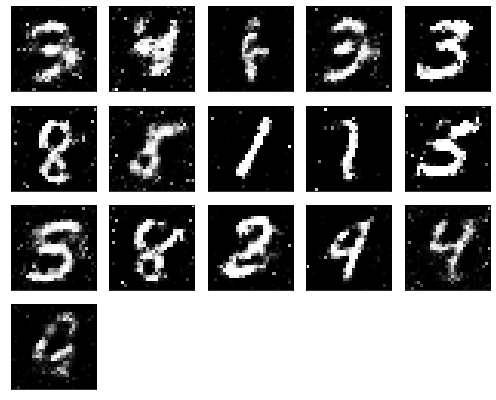

Epochs nb. 9681
discriminator loss: 0.6234370470046997
generator loss : 1.156660556793213

Epochs nb. 9682
discriminator loss: 0.5483348369598389
generator loss : 0.9016261100769043

Epochs nb. 9683
discriminator loss: 0.6857227087020874
generator loss : 0.9374204277992249

Epochs nb. 9684
discriminator loss: 0.5839288830757141
generator loss : 0.9708436131477356

Epochs nb. 9685
discriminator loss: 0.7804552912712097
generator loss : 0.82880699634552

Epochs nb. 9686
discriminator loss: 0.5982419848442078
generator loss : 1.1838839054107666

Epochs nb. 9687
discriminator loss: 0.7441617250442505
generator loss : 1.103299617767334

Epochs nb. 9688
discriminator loss: 0.7387950420379639
generator loss : 0.9366457462310791

Epochs nb. 9689
discriminator loss: 0.6109342575073242
generator loss : 1.1931183338165283

Epochs nb. 9690
discriminator loss: 0.7360141277313232
generator loss : 1.1218042373657227



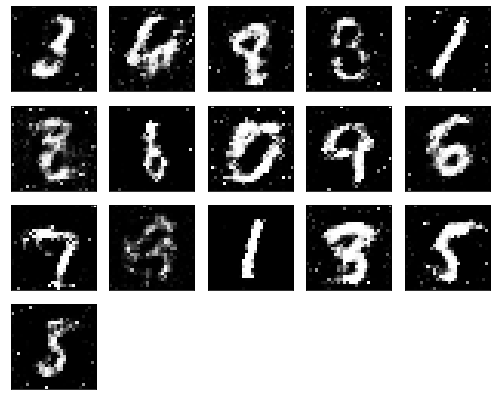

Epochs nb. 9691
discriminator loss: 0.5449374914169312
generator loss : 0.898743748664856

Epochs nb. 9692
discriminator loss: 0.5486506223678589
generator loss : 0.9716149568557739

Epochs nb. 9693
discriminator loss: 0.5374465584754944
generator loss : 0.9456146955490112

Epochs nb. 9694
discriminator loss: 0.6195399761199951
generator loss : 0.9727237820625305

Epochs nb. 9695
discriminator loss: 0.5942434668540955
generator loss : 0.9771596193313599

Epochs nb. 9696
discriminator loss: 0.6139262318611145
generator loss : 0.9670743346214294

Epochs nb. 9697
discriminator loss: 0.667434811592102
generator loss : 1.0612173080444336

Epochs nb. 9698
discriminator loss: 0.6406877040863037
generator loss : 0.8361221551895142

Epochs nb. 9699
discriminator loss: 0.5539675951004028
generator loss : 1.0378999710083008

Epochs nb. 9700
discriminator loss: 0.5536805391311646
generator loss : 1.0894184112548828



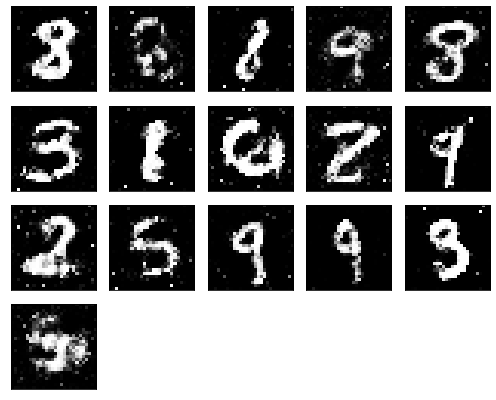

Epochs nb. 9701
discriminator loss: 0.6530141830444336
generator loss : 1.178056240081787

Epochs nb. 9702
discriminator loss: 0.7742807865142822
generator loss : 0.8795169591903687

Epochs nb. 9703
discriminator loss: 0.566118597984314
generator loss : 0.9757700562477112

Epochs nb. 9704
discriminator loss: 0.5390215516090393
generator loss : 0.7947361469268799

Epochs nb. 9705
discriminator loss: 0.4915040135383606
generator loss : 0.9274827837944031

Epochs nb. 9706
discriminator loss: 0.48765647411346436
generator loss : 0.9430928826332092

Epochs nb. 9707
discriminator loss: 0.5749490857124329
generator loss : 0.8192492723464966

Epochs nb. 9708
discriminator loss: 0.5861634016036987
generator loss : 1.1459605693817139

Epochs nb. 9709
discriminator loss: 0.6734386682510376
generator loss : 1.1314924955368042

Epochs nb. 9710
discriminator loss: 0.5688184499740601
generator loss : 0.9424595832824707



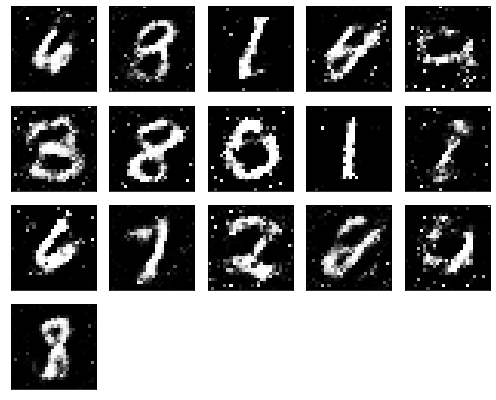

Epochs nb. 9711
discriminator loss: 0.5491172075271606
generator loss : 1.0300601720809937

Epochs nb. 9712
discriminator loss: 0.6260766983032227
generator loss : 0.8739128112792969

Epochs nb. 9713
discriminator loss: 0.6458297371864319
generator loss : 0.934289813041687

Epochs nb. 9714
discriminator loss: 0.5289648771286011
generator loss : 0.9730173945426941

Epochs nb. 9715
discriminator loss: 0.4723266363143921
generator loss : 0.8995106816291809

Epochs nb. 9716
discriminator loss: 0.6176460981369019
generator loss : 0.9452993273735046

Epochs nb. 9717
discriminator loss: 0.6793835163116455
generator loss : 1.0350029468536377

Epochs nb. 9718
discriminator loss: 0.5706005096435547
generator loss : 1.085660457611084

Epochs nb. 9719
discriminator loss: 0.5486329197883606
generator loss : 0.9200353622436523

Epochs nb. 9720
discriminator loss: 0.4628821611404419
generator loss : 0.7607808709144592



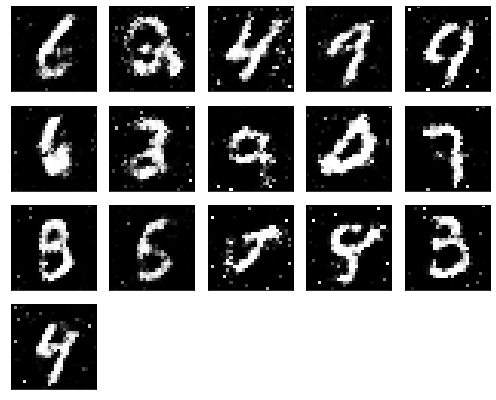

Epochs nb. 9721
discriminator loss: 0.5265690684318542
generator loss : 1.0873619318008423

Epochs nb. 9722
discriminator loss: 0.5405853390693665
generator loss : 0.9839150905609131

Epochs nb. 9723
discriminator loss: 0.6607004404067993
generator loss : 1.151084065437317

Epochs nb. 9724
discriminator loss: 0.814748227596283
generator loss : 1.0457093715667725

Epochs nb. 9725
discriminator loss: 0.5855558514595032
generator loss : 0.9152485132217407

Epochs nb. 9726
discriminator loss: 0.6174229383468628
generator loss : 0.9469494223594666

Epochs nb. 9727
discriminator loss: 0.6481480598449707
generator loss : 1.0052763223648071

Epochs nb. 9728
discriminator loss: 0.5756957530975342
generator loss : 0.9560805559158325

Epochs nb. 9729
discriminator loss: 0.80522221326828
generator loss : 1.0101728439331055

Epochs nb. 9730
discriminator loss: 0.6106227040290833
generator loss : 1.0211446285247803



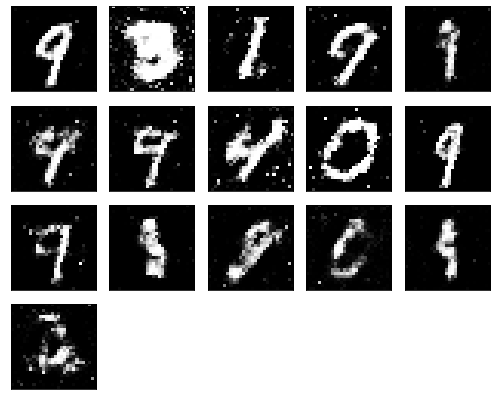

Epochs nb. 9731
discriminator loss: 0.6287558078765869
generator loss : 0.9613739252090454

Epochs nb. 9732
discriminator loss: 0.6559258699417114
generator loss : 0.8553997874259949

Epochs nb. 9733
discriminator loss: 0.5697039365768433
generator loss : 0.8680750131607056

Epochs nb. 9734
discriminator loss: 0.6211247444152832
generator loss : 0.9977627992630005

Epochs nb. 9735
discriminator loss: 0.5838255882263184
generator loss : 1.1002511978149414

Epochs nb. 9736
discriminator loss: 0.5942622423171997
generator loss : 1.2560193538665771

Epochs nb. 9737
discriminator loss: 0.5703747868537903
generator loss : 0.9062151908874512

Epochs nb. 9738
discriminator loss: 0.5204211473464966
generator loss : 1.0076611042022705

Epochs nb. 9739
discriminator loss: 0.5333936214447021
generator loss : 1.0477755069732666

Epochs nb. 9740
discriminator loss: 0.5550915002822876
generator loss : 0.832901120185852



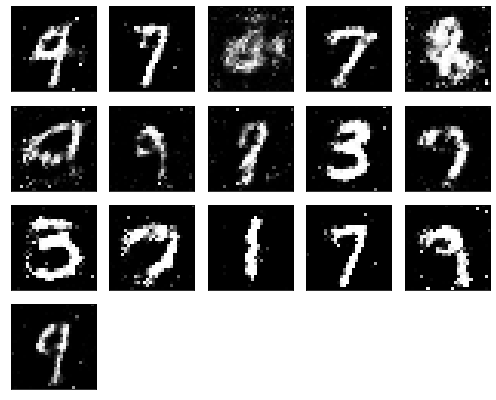

Epochs nb. 9741
discriminator loss: 0.5892858505249023
generator loss : 0.8149871826171875

Epochs nb. 9742
discriminator loss: 0.4802675247192383
generator loss : 1.114492654800415

Epochs nb. 9743
discriminator loss: 0.6615018844604492
generator loss : 1.1655640602111816

Epochs nb. 9744
discriminator loss: 0.4846784770488739
generator loss : 1.188441276550293

Epochs nb. 9745
discriminator loss: 0.6179022789001465
generator loss : 0.9168511629104614

Epochs nb. 9746
discriminator loss: 0.6894170045852661
generator loss : 1.0264030694961548

Epochs nb. 9747
discriminator loss: 0.639534592628479
generator loss : 0.8882092237472534

Epochs nb. 9748
discriminator loss: 0.627723753452301
generator loss : 0.9551260471343994

Epochs nb. 9749
discriminator loss: 0.49414435029029846
generator loss : 0.898038387298584

Epochs nb. 9750
discriminator loss: 0.6209940314292908
generator loss : 0.7631518840789795



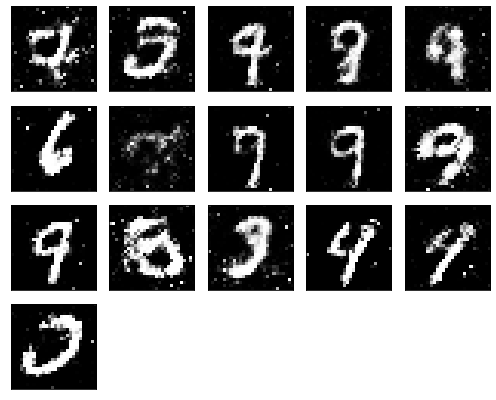

Epochs nb. 9751
discriminator loss: 0.5750097632408142
generator loss : 0.8318965435028076

Epochs nb. 9752
discriminator loss: 0.5925772786140442
generator loss : 0.7736591100692749

Epochs nb. 9753
discriminator loss: 0.6021310091018677
generator loss : 1.1516802310943604

Epochs nb. 9754
discriminator loss: 0.526715874671936
generator loss : 1.0633176565170288

Epochs nb. 9755
discriminator loss: 0.5827754735946655
generator loss : 1.2198362350463867

Epochs nb. 9756
discriminator loss: 0.5315724611282349
generator loss : 0.9050049781799316

Epochs nb. 9757
discriminator loss: 0.7783430814743042
generator loss : 0.8708248734474182

Epochs nb. 9758
discriminator loss: 0.6834372282028198
generator loss : 1.1212388277053833

Epochs nb. 9759
discriminator loss: 0.643433153629303
generator loss : 0.9176532626152039

Epochs nb. 9760
discriminator loss: 0.679476261138916
generator loss : 1.069679856300354



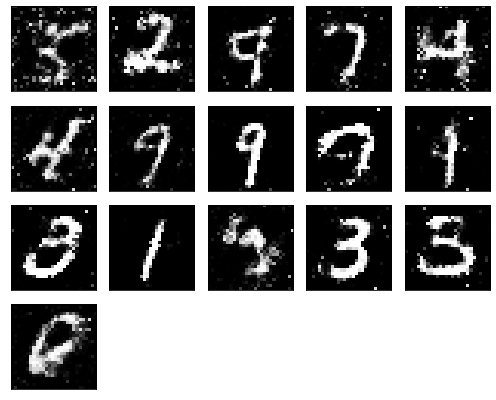

Epochs nb. 9761
discriminator loss: 0.5223479270935059
generator loss : 1.1678574085235596

Epochs nb. 9762
discriminator loss: 0.5848995447158813
generator loss : 1.194044589996338

Epochs nb. 9763
discriminator loss: 0.5949934124946594
generator loss : 1.0578484535217285

Epochs nb. 9764
discriminator loss: 0.6498090624809265
generator loss : 1.1198233366012573

Epochs nb. 9765
discriminator loss: 0.5650716423988342
generator loss : 1.1302506923675537

Epochs nb. 9766
discriminator loss: 0.5383944511413574
generator loss : 1.0345087051391602

Epochs nb. 9767
discriminator loss: 0.48025715351104736
generator loss : 1.0053396224975586

Epochs nb. 9768
discriminator loss: 0.5628311634063721
generator loss : 1.0526096820831299

Epochs nb. 9769
discriminator loss: 0.7555207014083862
generator loss : 1.039353609085083

Epochs nb. 9770
discriminator loss: 0.6246708035469055
generator loss : 0.9645617008209229



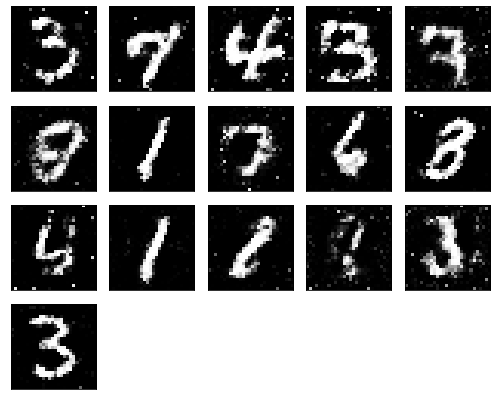

Epochs nb. 9771
discriminator loss: 0.5865170955657959
generator loss : 0.9596374034881592

Epochs nb. 9772
discriminator loss: 0.5326577425003052
generator loss : 1.1369285583496094

Epochs nb. 9773
discriminator loss: 0.6059719920158386
generator loss : 1.1018375158309937

Epochs nb. 9774
discriminator loss: 0.5361800193786621
generator loss : 1.0037004947662354

Epochs nb. 9775
discriminator loss: 0.5057430863380432
generator loss : 0.9510610103607178

Epochs nb. 9776
discriminator loss: 0.49391889572143555
generator loss : 1.172918677330017

Epochs nb. 9777
discriminator loss: 0.5730006694793701
generator loss : 0.9953470230102539

Epochs nb. 9778
discriminator loss: 0.45305365324020386
generator loss : 1.0698413848876953

Epochs nb. 9779
discriminator loss: 0.5399923324584961
generator loss : 0.983544647693634

Epochs nb. 9780
discriminator loss: 0.585782527923584
generator loss : 1.107505202293396



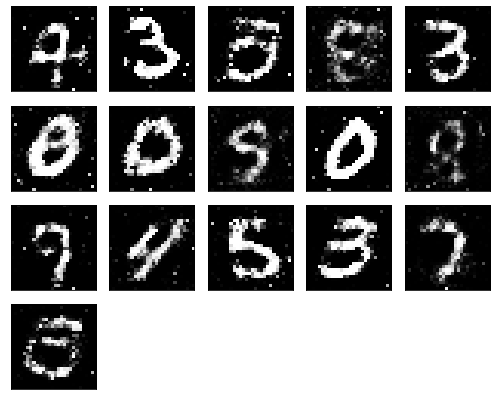

Epochs nb. 9781
discriminator loss: 0.6598690748214722
generator loss : 1.1738871335983276

Epochs nb. 9782
discriminator loss: 0.5122942328453064
generator loss : 1.1814370155334473

Epochs nb. 9783
discriminator loss: 0.5202511548995972
generator loss : 1.171783208847046

Epochs nb. 9784
discriminator loss: 0.6418317556381226
generator loss : 1.2915377616882324

Epochs nb. 9785
discriminator loss: 0.6577760577201843
generator loss : 1.0564898252487183

Epochs nb. 9786
discriminator loss: 0.5494625568389893
generator loss : 1.047339677810669

Epochs nb. 9787
discriminator loss: 0.5948621034622192
generator loss : 1.0693756341934204

Epochs nb. 9788
discriminator loss: 0.5159807205200195
generator loss : 1.1224908828735352

Epochs nb. 9789
discriminator loss: 0.5727299451828003
generator loss : 1.0315757989883423

Epochs nb. 9790
discriminator loss: 0.6072098016738892
generator loss : 0.9777613282203674



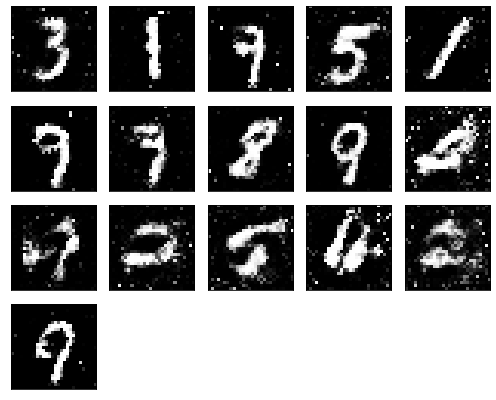

Epochs nb. 9791
discriminator loss: 0.6808472275733948
generator loss : 0.9012738466262817

Epochs nb. 9792
discriminator loss: 0.7879250049591064
generator loss : 1.0366160869598389

Epochs nb. 9793
discriminator loss: 0.6940738558769226
generator loss : 1.0579807758331299

Epochs nb. 9794
discriminator loss: 0.4899362325668335
generator loss : 0.9760100841522217

Epochs nb. 9795
discriminator loss: 0.6276941895484924
generator loss : 1.106835126876831

Epochs nb. 9796
discriminator loss: 0.6361246705055237
generator loss : 1.057071328163147

Epochs nb. 9797
discriminator loss: 0.5780256390571594
generator loss : 1.0428075790405273

Epochs nb. 9798
discriminator loss: 0.518467903137207
generator loss : 0.9702039957046509

Epochs nb. 9799
discriminator loss: 0.5457658171653748
generator loss : 0.8184045553207397

Epochs nb. 9800
discriminator loss: 0.6379153728485107
generator loss : 0.8626611828804016



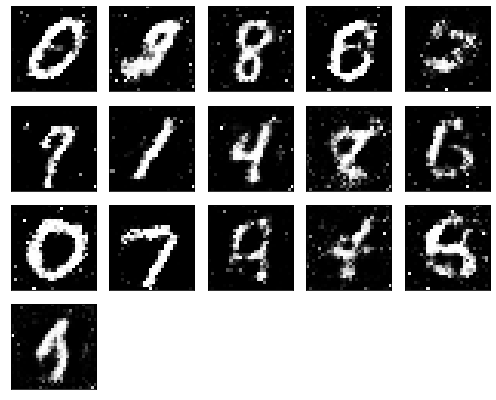

Epochs nb. 9801
discriminator loss: 0.5524041652679443
generator loss : 1.0076977014541626

Epochs nb. 9802
discriminator loss: 0.4706103205680847
generator loss : 0.9016976356506348

Epochs nb. 9803
discriminator loss: 0.5318900346755981
generator loss : 1.0003310441970825

Epochs nb. 9804
discriminator loss: 0.6959352493286133
generator loss : 0.9520505666732788

Epochs nb. 9805
discriminator loss: 0.6804333925247192
generator loss : 1.0318937301635742

Epochs nb. 9806
discriminator loss: 0.5964725017547607
generator loss : 0.8315523862838745

Epochs nb. 9807
discriminator loss: 0.6483070850372314
generator loss : 1.0095641613006592

Epochs nb. 9808
discriminator loss: 0.6880171895027161
generator loss : 0.9154212474822998

Epochs nb. 9809
discriminator loss: 0.6062104105949402
generator loss : 1.1142518520355225

Epochs nb. 9810
discriminator loss: 0.6633926630020142
generator loss : 0.9500988721847534



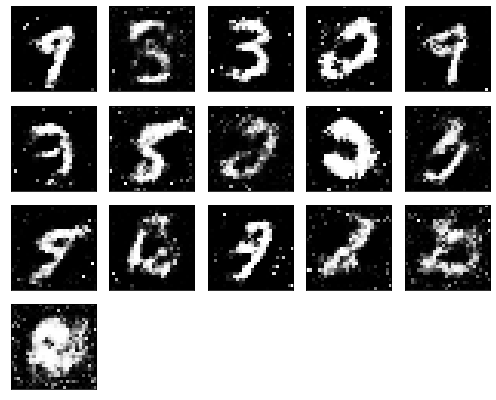

Epochs nb. 9811
discriminator loss: 0.5297942757606506
generator loss : 1.1153535842895508

Epochs nb. 9812
discriminator loss: 0.5406167507171631
generator loss : 0.9527218341827393

Epochs nb. 9813
discriminator loss: 0.6261316537857056
generator loss : 1.0816253423690796

Epochs nb. 9814
discriminator loss: 0.568515419960022
generator loss : 1.1215797662734985

Epochs nb. 9815
discriminator loss: 0.6173821687698364
generator loss : 1.0109844207763672

Epochs nb. 9816
discriminator loss: 0.4586687684059143
generator loss : 0.9261026978492737

Epochs nb. 9817
discriminator loss: 0.49174684286117554
generator loss : 0.928009033203125

Epochs nb. 9818
discriminator loss: 0.5872108340263367
generator loss : 0.9773895740509033

Epochs nb. 9819
discriminator loss: 0.5726795196533203
generator loss : 0.9852204322814941

Epochs nb. 9820
discriminator loss: 0.5778294205665588
generator loss : 0.9483798146247864



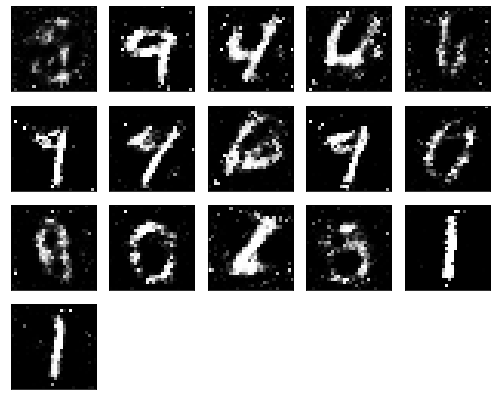

Epochs nb. 9821
discriminator loss: 0.5745276808738708
generator loss : 1.2219390869140625

Epochs nb. 9822
discriminator loss: 0.5609414577484131
generator loss : 0.8813655972480774

Epochs nb. 9823
discriminator loss: 0.6801281571388245
generator loss : 0.927798330783844

Epochs nb. 9824
discriminator loss: 0.6043189764022827
generator loss : 0.9156265258789062

Epochs nb. 9825
discriminator loss: 0.652162492275238
generator loss : 0.9674344658851624

Epochs nb. 9826
discriminator loss: 0.6314818263053894
generator loss : 0.8082324862480164

Epochs nb. 9827
discriminator loss: 0.5314995050430298
generator loss : 0.9378244280815125

Epochs nb. 9828
discriminator loss: 0.5602319240570068
generator loss : 1.07648503780365

Epochs nb. 9829
discriminator loss: 0.5624492168426514
generator loss : 0.915902853012085

Epochs nb. 9830
discriminator loss: 0.5995202660560608
generator loss : 1.0844709873199463



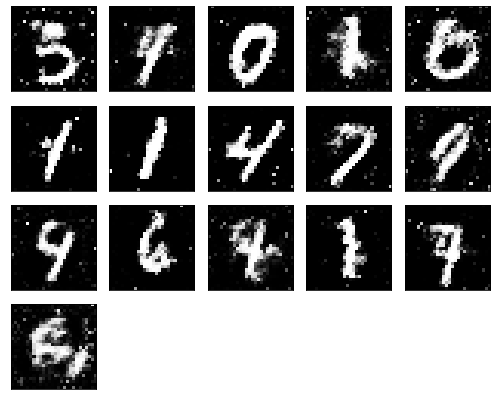

Epochs nb. 9831
discriminator loss: 0.5951166152954102
generator loss : 1.2350537776947021

Epochs nb. 9832
discriminator loss: 0.5613983869552612
generator loss : 1.2598240375518799

Epochs nb. 9833
discriminator loss: 0.7376755475997925
generator loss : 0.8444837331771851

Epochs nb. 9834
discriminator loss: 0.5283763408660889
generator loss : 0.9100763201713562

Epochs nb. 9835
discriminator loss: 0.6574472784996033
generator loss : 0.9944026470184326

Epochs nb. 9836
discriminator loss: 0.6217516660690308
generator loss : 1.0719249248504639

Epochs nb. 9837
discriminator loss: 0.7207061052322388
generator loss : 1.1151132583618164

Epochs nb. 9838
discriminator loss: 0.5824050903320312
generator loss : 0.8612611889839172

Epochs nb. 9839
discriminator loss: 0.4914497137069702
generator loss : 0.9975031018257141

Epochs nb. 9840
discriminator loss: 0.6155369281768799
generator loss : 0.7564316987991333



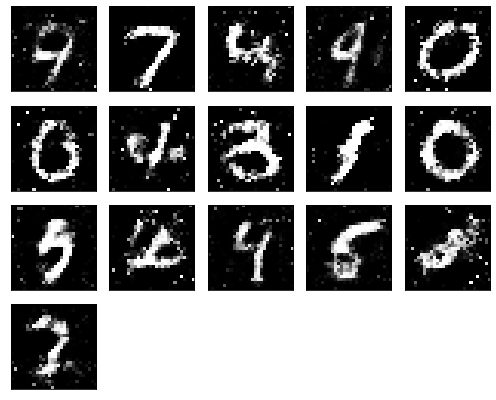

Epochs nb. 9841
discriminator loss: 0.579303503036499
generator loss : 1.0803017616271973

Epochs nb. 9842
discriminator loss: 0.533909261226654
generator loss : 0.9786269068717957

Epochs nb. 9843
discriminator loss: 0.5928056240081787
generator loss : 1.0474544763565063

Epochs nb. 9844
discriminator loss: 0.6271719932556152
generator loss : 1.1191514730453491

Epochs nb. 9845
discriminator loss: 0.573776364326477
generator loss : 1.1777522563934326

Epochs nb. 9846
discriminator loss: 0.5946295857429504
generator loss : 1.0224158763885498

Epochs nb. 9847
discriminator loss: 0.4946337938308716
generator loss : 0.9663397669792175

Epochs nb. 9848
discriminator loss: 0.6456930041313171
generator loss : 0.8511358499526978

Epochs nb. 9849
discriminator loss: 0.7123361825942993
generator loss : 1.0953654050827026

Epochs nb. 9850
discriminator loss: 0.5210551619529724
generator loss : 1.1685330867767334



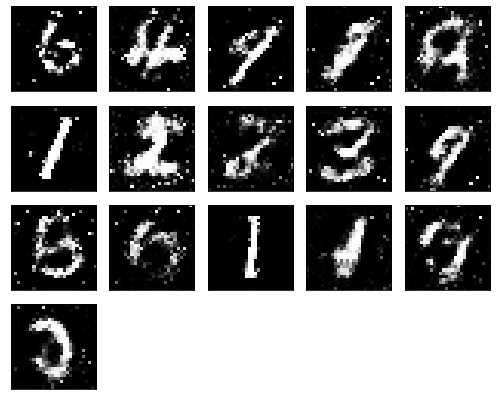

Epochs nb. 9851
discriminator loss: 0.6416234374046326
generator loss : 1.3061864376068115

Epochs nb. 9852
discriminator loss: 0.578792154788971
generator loss : 1.173387050628662

Epochs nb. 9853
discriminator loss: 0.5972037315368652
generator loss : 0.9104791879653931

Epochs nb. 9854
discriminator loss: 0.7251276969909668
generator loss : 1.0552432537078857

Epochs nb. 9855
discriminator loss: 0.5499523878097534
generator loss : 1.1377108097076416

Epochs nb. 9856
discriminator loss: 0.6632816195487976
generator loss : 1.1265121698379517

Epochs nb. 9857
discriminator loss: 0.4787469506263733
generator loss : 1.1245100498199463

Epochs nb. 9858
discriminator loss: 0.6259581446647644
generator loss : 0.929749608039856

Epochs nb. 9859
discriminator loss: 0.4843195080757141
generator loss : 0.856526255607605

Epochs nb. 9860
discriminator loss: 0.5256821513175964
generator loss : 0.9830461740493774



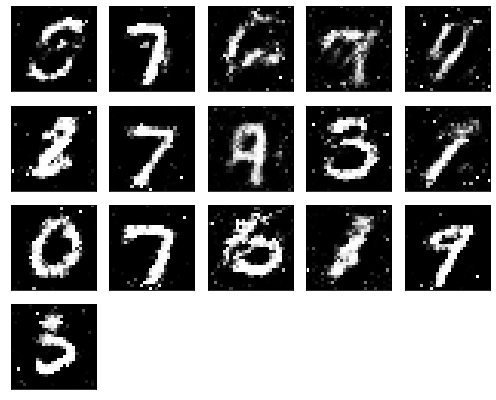

Epochs nb. 9861
discriminator loss: 0.5794371366500854
generator loss : 0.982221782207489

Epochs nb. 9862
discriminator loss: 0.627558171749115
generator loss : 1.030103325843811

Epochs nb. 9863
discriminator loss: 0.6784694194793701
generator loss : 0.9727615118026733

Epochs nb. 9864
discriminator loss: 0.6861238479614258
generator loss : 1.0087225437164307

Epochs nb. 9865
discriminator loss: 0.6242793202400208
generator loss : 0.9273816347122192

Epochs nb. 9866
discriminator loss: 0.6661350727081299
generator loss : 0.9074987173080444

Epochs nb. 9867
discriminator loss: 0.6856958866119385
generator loss : 1.122395634651184

Epochs nb. 9868
discriminator loss: 0.5833389759063721
generator loss : 1.0275311470031738

Epochs nb. 9869
discriminator loss: 0.5549055337905884
generator loss : 0.9814589619636536

Epochs nb. 9870
discriminator loss: 0.6092724800109863
generator loss : 0.9111531972885132



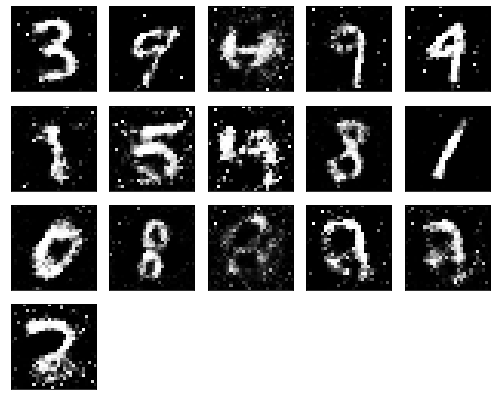

Epochs nb. 9871
discriminator loss: 0.6254763603210449
generator loss : 1.025717854499817

Epochs nb. 9872
discriminator loss: 0.4699629843235016
generator loss : 0.9244482517242432

Epochs nb. 9873
discriminator loss: 0.4745487868785858
generator loss : 0.9197547435760498

Epochs nb. 9874
discriminator loss: 0.5511036515235901
generator loss : 1.0276235342025757

Epochs nb. 9875
discriminator loss: 0.7121455073356628
generator loss : 1.1187762022018433

Epochs nb. 9876
discriminator loss: 0.5646733641624451
generator loss : 0.9641228914260864

Epochs nb. 9877
discriminator loss: 0.6301516890525818
generator loss : 0.9318599700927734

Epochs nb. 9878
discriminator loss: 0.5272930860519409
generator loss : 0.9009923934936523

Epochs nb. 9879
discriminator loss: 0.5917211174964905
generator loss : 1.0767712593078613

Epochs nb. 9880
discriminator loss: 0.5435510873794556
generator loss : 0.966783344745636



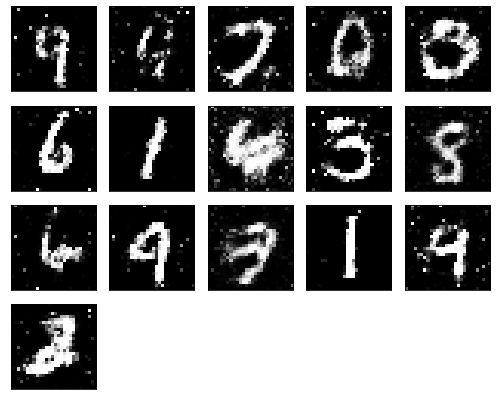

Epochs nb. 9881
discriminator loss: 0.7561461925506592
generator loss : 0.9111318588256836

Epochs nb. 9882
discriminator loss: 0.7561475038528442
generator loss : 1.0922291278839111

Epochs nb. 9883
discriminator loss: 0.6509357690811157
generator loss : 0.9736770391464233

Epochs nb. 9884
discriminator loss: 0.47178730368614197
generator loss : 0.8272783160209656

Epochs nb. 9885
discriminator loss: 0.6883700489997864
generator loss : 0.8757063150405884

Epochs nb. 9886
discriminator loss: 0.6377794742584229
generator loss : 1.0850951671600342

Epochs nb. 9887
discriminator loss: 0.6200935244560242
generator loss : 1.1759843826293945

Epochs nb. 9888
discriminator loss: 0.63994300365448
generator loss : 1.0092942714691162

Epochs nb. 9889
discriminator loss: 0.6153879761695862
generator loss : 1.0493990182876587

Epochs nb. 9890
discriminator loss: 0.5628784894943237
generator loss : 1.0613853931427002



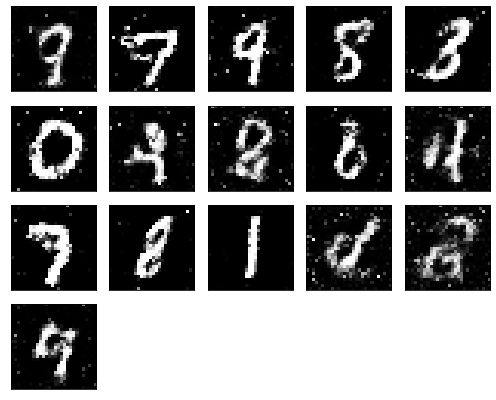

Epochs nb. 9891
discriminator loss: 0.6433954238891602
generator loss : 1.0332279205322266

Epochs nb. 9892
discriminator loss: 0.6345434188842773
generator loss : 1.046968698501587

Epochs nb. 9893
discriminator loss: 0.6086554527282715
generator loss : 1.242567539215088

Epochs nb. 9894
discriminator loss: 0.5708537101745605
generator loss : 1.0403424501419067

Epochs nb. 9895
discriminator loss: 0.542700469493866
generator loss : 1.261481761932373

Epochs nb. 9896
discriminator loss: 0.6124947667121887
generator loss : 1.1333060264587402

Epochs nb. 9897
discriminator loss: 0.5107429027557373
generator loss : 0.9991343021392822

Epochs nb. 9898
discriminator loss: 0.5094063878059387
generator loss : 0.9130522012710571

Epochs nb. 9899
discriminator loss: 0.7376615405082703
generator loss : 1.1237759590148926

Epochs nb. 9900
discriminator loss: 0.5770633220672607
generator loss : 0.8438702821731567



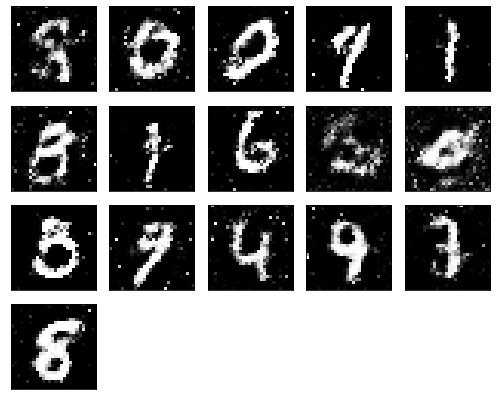

Epochs nb. 9901
discriminator loss: 0.5309555530548096
generator loss : 0.984674870967865

Epochs nb. 9902
discriminator loss: 0.6214104890823364
generator loss : 1.0036554336547852

Epochs nb. 9903
discriminator loss: 0.5619386434555054
generator loss : 1.0044257640838623

Epochs nb. 9904
discriminator loss: 0.5077579021453857
generator loss : 1.0513511896133423

Epochs nb. 9905
discriminator loss: 0.5782283544540405
generator loss : 0.9657105207443237

Epochs nb. 9906
discriminator loss: 0.6365284323692322
generator loss : 0.8846566081047058

Epochs nb. 9907
discriminator loss: 0.5558307766914368
generator loss : 0.9033526182174683

Epochs nb. 9908
discriminator loss: 0.706769585609436
generator loss : 0.7956130504608154

Epochs nb. 9909
discriminator loss: 0.6698218584060669
generator loss : 0.9222718477249146

Epochs nb. 9910
discriminator loss: 0.7226566672325134
generator loss : 0.96916663646698



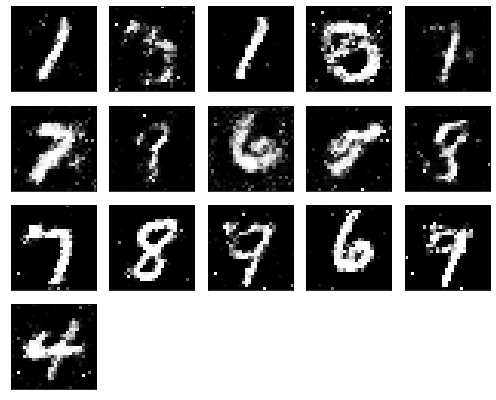

Epochs nb. 9911
discriminator loss: 0.47045010328292847
generator loss : 1.0440059900283813

Epochs nb. 9912
discriminator loss: 0.5222009420394897
generator loss : 1.0884222984313965

Epochs nb. 9913
discriminator loss: 0.7915463447570801
generator loss : 0.8688297271728516

Epochs nb. 9914
discriminator loss: 0.7614090442657471
generator loss : 1.1324450969696045

Epochs nb. 9915
discriminator loss: 0.7122958898544312
generator loss : 0.9503254294395447

Epochs nb. 9916
discriminator loss: 0.49602100253105164
generator loss : 0.9857109785079956

Epochs nb. 9917
discriminator loss: 0.7415067553520203
generator loss : 1.024293065071106

Epochs nb. 9918
discriminator loss: 0.4946722984313965
generator loss : 0.948190450668335

Epochs nb. 9919
discriminator loss: 0.657483696937561
generator loss : 0.9836598634719849

Epochs nb. 9920
discriminator loss: 0.5744296312332153
generator loss : 1.2191941738128662



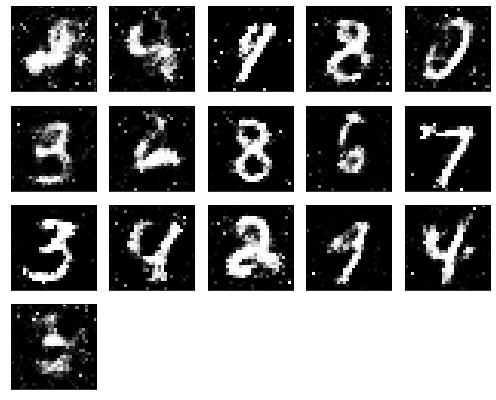

Epochs nb. 9921
discriminator loss: 0.5322548151016235
generator loss : 1.0791316032409668

Epochs nb. 9922
discriminator loss: 0.6177978515625
generator loss : 1.1108276844024658

Epochs nb. 9923
discriminator loss: 0.6184536218643188
generator loss : 0.9758186936378479

Epochs nb. 9924
discriminator loss: 0.6492602825164795
generator loss : 1.0706439018249512

Epochs nb. 9925
discriminator loss: 0.46129655838012695
generator loss : 0.9205315113067627

Epochs nb. 9926
discriminator loss: 0.5989093780517578
generator loss : 1.1693633794784546

Epochs nb. 9927
discriminator loss: 0.5652797222137451
generator loss : 1.0208244323730469

Epochs nb. 9928
discriminator loss: 0.6478517651557922
generator loss : 0.9636259078979492

Epochs nb. 9929
discriminator loss: 0.585861086845398
generator loss : 1.0969330072402954

Epochs nb. 9930
discriminator loss: 0.5842384696006775
generator loss : 1.0599894523620605



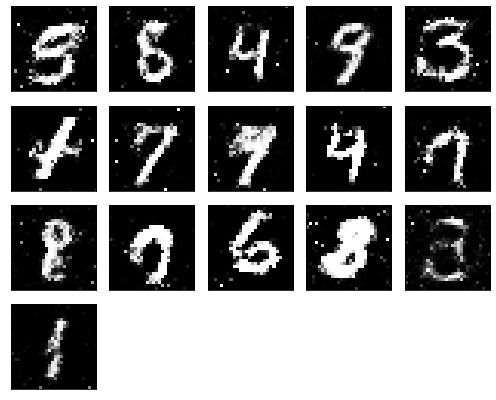

Epochs nb. 9931
discriminator loss: 0.583030104637146
generator loss : 1.1330288648605347

Epochs nb. 9932
discriminator loss: 0.626338541507721
generator loss : 0.8020153641700745

Epochs nb. 9933
discriminator loss: 0.6683915257453918
generator loss : 1.0412132740020752

Epochs nb. 9934
discriminator loss: 0.5597069263458252
generator loss : 1.2483913898468018

Epochs nb. 9935
discriminator loss: 0.6385796070098877
generator loss : 1.2416443824768066

Epochs nb. 9936
discriminator loss: 0.6154670119285583
generator loss : 1.098456621170044

Epochs nb. 9937
discriminator loss: 0.7308785915374756
generator loss : 1.1561918258666992

Epochs nb. 9938
discriminator loss: 0.4663200378417969
generator loss : 1.0902940034866333

Epochs nb. 9939
discriminator loss: 0.7056337594985962
generator loss : 0.9349322319030762

Epochs nb. 9940
discriminator loss: 0.6601437330245972
generator loss : 0.8588632345199585



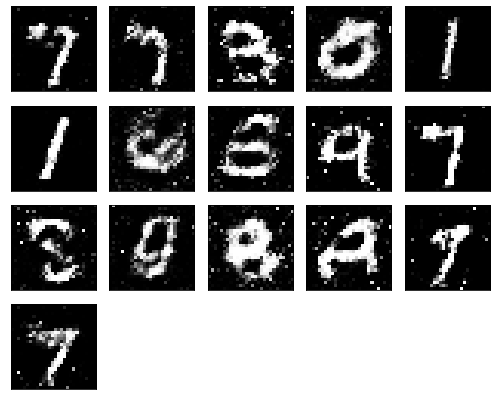

Epochs nb. 9941
discriminator loss: 0.5543399453163147
generator loss : 0.9643846750259399

Epochs nb. 9942
discriminator loss: 0.6703605651855469
generator loss : 0.9346208572387695

Epochs nb. 9943
discriminator loss: 0.5985717177391052
generator loss : 1.0177942514419556

Epochs nb. 9944
discriminator loss: 0.740744948387146
generator loss : 0.9659196734428406

Epochs nb. 9945
discriminator loss: 0.5124117136001587
generator loss : 1.0040874481201172

Epochs nb. 9946
discriminator loss: 0.49625784158706665
generator loss : 1.1087040901184082

Epochs nb. 9947
discriminator loss: 0.5172605514526367
generator loss : 1.0491403341293335

Epochs nb. 9948
discriminator loss: 0.6712381839752197
generator loss : 0.8140510320663452

Epochs nb. 9949
discriminator loss: 0.49383583664894104
generator loss : 0.9872711300849915

Epochs nb. 9950
discriminator loss: 0.5894150733947754
generator loss : 0.7848652601242065



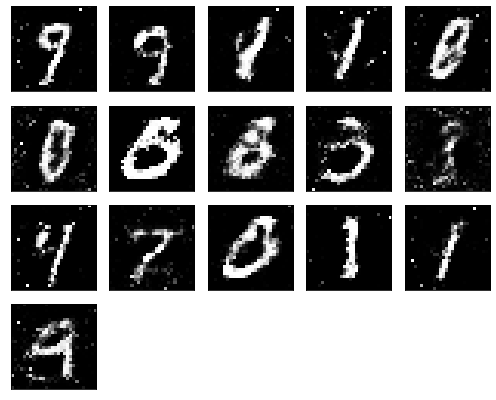

Epochs nb. 9951
discriminator loss: 0.6700741052627563
generator loss : 1.1917753219604492

Epochs nb. 9952
discriminator loss: 0.5804874300956726
generator loss : 0.8438818454742432

Epochs nb. 9953
discriminator loss: 0.6815369129180908
generator loss : 0.7895423173904419

Epochs nb. 9954
discriminator loss: 0.5523419380187988
generator loss : 0.8560168743133545

Epochs nb. 9955
discriminator loss: 0.6951850652694702
generator loss : 0.8892103433609009

Epochs nb. 9956
discriminator loss: 0.6373894214630127
generator loss : 0.9169910550117493

Epochs nb. 9957
discriminator loss: 0.676658034324646
generator loss : 0.7867349982261658

Epochs nb. 9958
discriminator loss: 0.539815366268158
generator loss : 0.9531420469284058

Epochs nb. 9959
discriminator loss: 0.6491647362709045
generator loss : 0.9858301877975464

Epochs nb. 9960
discriminator loss: 0.5526993274688721
generator loss : 1.046873927116394



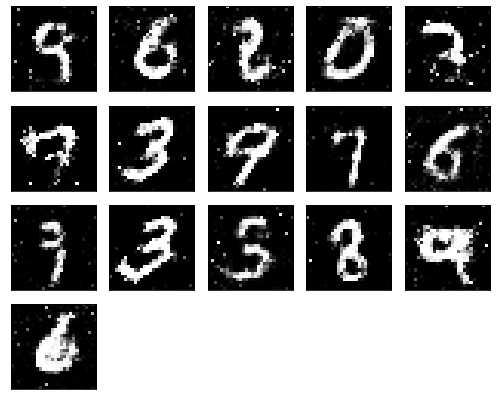

Epochs nb. 9961
discriminator loss: 0.5511806011199951
generator loss : 0.970781683921814

Epochs nb. 9962
discriminator loss: 0.5855715274810791
generator loss : 1.0826969146728516

Epochs nb. 9963
discriminator loss: 0.5469048023223877
generator loss : 0.843181312084198

Epochs nb. 9964
discriminator loss: 0.4868620038032532
generator loss : 0.9780926704406738

Epochs nb. 9965
discriminator loss: 0.589810848236084
generator loss : 0.9187271595001221

Epochs nb. 9966
discriminator loss: 0.5215572118759155
generator loss : 1.0944223403930664

Epochs nb. 9967
discriminator loss: 0.620743989944458
generator loss : 1.1460459232330322

Epochs nb. 9968
discriminator loss: 0.6397291421890259
generator loss : 1.1869035959243774

Epochs nb. 9969
discriminator loss: 0.5123155117034912
generator loss : 1.1670897006988525

Epochs nb. 9970
discriminator loss: 0.6647544503211975
generator loss : 1.1441431045532227



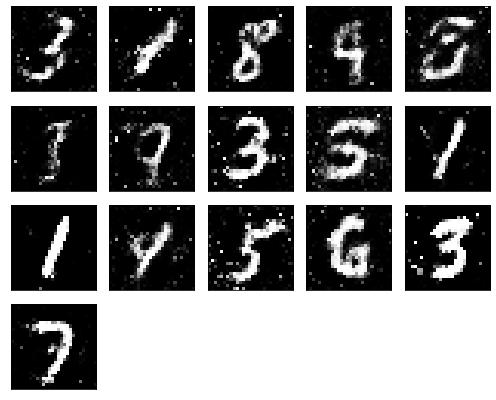

Epochs nb. 9971
discriminator loss: 0.7298047542572021
generator loss : 1.0263264179229736

Epochs nb. 9972
discriminator loss: 0.662123441696167
generator loss : 1.2134056091308594

Epochs nb. 9973
discriminator loss: 0.38288167119026184
generator loss : 1.0866475105285645

Epochs nb. 9974
discriminator loss: 0.48664477467536926
generator loss : 1.0780500173568726

Epochs nb. 9975
discriminator loss: 0.6846403479576111
generator loss : 1.2525620460510254

Epochs nb. 9976
discriminator loss: 0.7176206707954407
generator loss : 1.0830166339874268

Epochs nb. 9977
discriminator loss: 0.6542841196060181
generator loss : 0.9453448057174683

Epochs nb. 9978
discriminator loss: 0.5691745281219482
generator loss : 1.2307089567184448

Epochs nb. 9979
discriminator loss: 0.4831595718860626
generator loss : 0.8627254962921143

Epochs nb. 9980
discriminator loss: 0.6664276123046875
generator loss : 1.0461323261260986



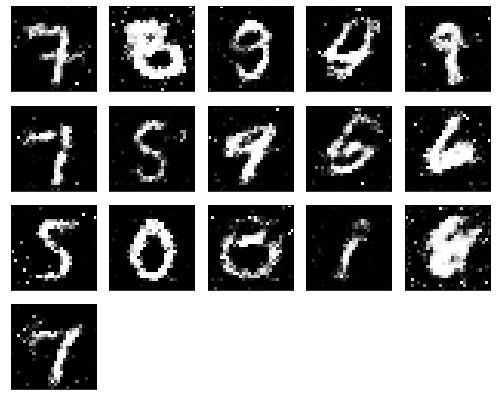

Epochs nb. 9981
discriminator loss: 0.5498635768890381
generator loss : 1.043964147567749

Epochs nb. 9982
discriminator loss: 0.6542452573776245
generator loss : 0.9885473847389221

Epochs nb. 9983
discriminator loss: 0.5274452567100525
generator loss : 1.0981651544570923

Epochs nb. 9984
discriminator loss: 0.5527092218399048
generator loss : 1.038501501083374

Epochs nb. 9985
discriminator loss: 0.571622371673584
generator loss : 0.943355917930603

Epochs nb. 9986
discriminator loss: 0.693163275718689
generator loss : 1.0230704545974731

Epochs nb. 9987
discriminator loss: 0.5675692558288574
generator loss : 1.0155284404754639

Epochs nb. 9988
discriminator loss: 0.5829842686653137
generator loss : 1.0984623432159424

Epochs nb. 9989
discriminator loss: 0.6433237791061401
generator loss : 0.9355172514915466

Epochs nb. 9990
discriminator loss: 0.5055220127105713
generator loss : 0.8020362854003906



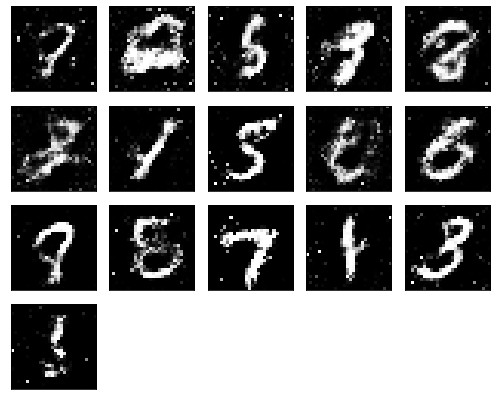

Epochs nb. 9991
discriminator loss: 0.6288013458251953
generator loss : 0.744952917098999

Epochs nb. 9992
discriminator loss: 0.48607832193374634
generator loss : 0.9367185235023499

Epochs nb. 9993
discriminator loss: 0.5347506999969482
generator loss : 1.0667145252227783

Epochs nb. 9994
discriminator loss: 0.670499861240387
generator loss : 1.0792646408081055

Epochs nb. 9995
discriminator loss: 0.5730283260345459
generator loss : 1.0014300346374512

Epochs nb. 9996
discriminator loss: 0.5258290767669678
generator loss : 1.0779227018356323

Epochs nb. 9997
discriminator loss: 0.6102038621902466
generator loss : 1.1657673120498657

Epochs nb. 9998
discriminator loss: 0.5937848687171936
generator loss : 1.1495375633239746

Epochs nb. 9999
discriminator loss: 0.7365019917488098
generator loss : 1.0504953861236572

Epochs nb. 10000
discriminator loss: 0.6150792837142944
generator loss : 0.9538272619247437



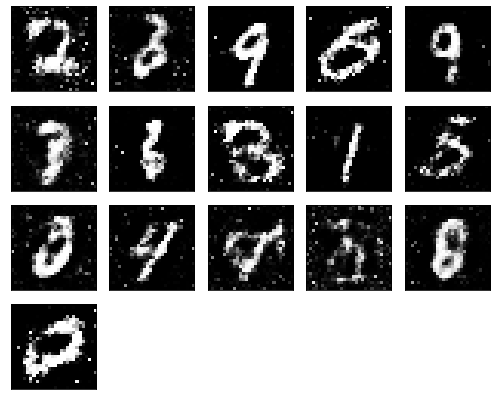

In [31]:
### training
## create the labels vector
labels_one = np.ones((batch_size, 1))
labels_zero = np.zeros((batch_size, 1))


for i in range(1, epochs + 1):
  print("Epochs nb. {}".format(i))
  
  # ----------
  # train discriminator
  # ----------

  ## generate random input noise (batch_size number of input noise vector)
  input_noise = np.random.normal(0, 1, size=[batch_size, noise_size])

  ## generate images
  generated_images = generator.predict(input_noise)

  ## get random images from the set (train_data)
  real_images = get_random_img(train_data, batch_size)
  real_images = np.reshape(real_images, (real_images.shape[0], 784))

  # train on batch and get the loss
  discriminator.trainable = True
  fake_loss = discriminator.train_on_batch(generated_images, labels_zero)
  real_loss = discriminator.train_on_batch(real_images, labels_one)
  d_loss = 0.5 * np.add(fake_loss, real_loss)

  # ----------
  # train the generator
  # ----------
  discriminator.trainable = False

  input_noise = np.random.normal(0, 1, size=[batch_size, noise_size])

  g_loss = gan.train_on_batch(input_noise, labels_one)

  print("discriminator loss: {}".format(d_loss[0]))
  print("generator loss : {}".format(g_loss))
  print()
  ## plot the images every 20 epochs
  if (i % 10 == 0):
    plot_generated_img(i, generator, batch_size, noise_size) ## pass the generator model as a parameter
